In [45]:
A = np.array([[1,2,3,4], [2,15,13,18], [12, 15, 21, 30]])
A = pd.DataFrame(A)
data.head()

,R&D Spend,Administration,Profit
0,165349.20,136897.80,192261.83
1,162597.70,151377.59,191792.06
2,153441.51,101145.55,191050.39
3,144372.41,118671.85,182901.99
4,142107.34,91391.77,166187.94


In [79]:
import warnings 
warnings.filterwarnings('ignore')

import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

#hiperparameters
n_iter = 80000  
alpha = 0.00000000000000001


#importing sklearn for data preparation
from sklearn.model_selection import train_test_split
#dataset = pd.read_csv("Fish.csv")
#dataset.drop(labels = ["Length2", "Length3"], axis = 1, inplace = True)
dataset = data

def data_process():      
    X = dataset.iloc[:,:-1].values
    y = dataset.iloc[:, -1].values
    X, y = np.array(X), np.array(y)# x and y converted to numpy arrays
    #reshape y
    y = np.reshape(y, (len(y), 1))
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 1/3, random_state = 0)
    #add a ones column to X_train y X_test for fitting betas shape
    X_train = np.concatenate((np.ones((len(X_train),1)), X_train), axis = 1)
    X_test = np.concatenate((np.ones((len(X_test),1)), X_test), axis = 1)
    #print(X_train, X_test, y_train, y_test)
    return X_train, X_test, y_train, y_test

    
#Hipotesis
def hipothesis( betas, X):
    return np.dot(X, betas)

#Cost/Error each iteration
def costo( h, y):
    m = len(y) 
    sub = h -y
    cost = np.sum(sub**2)/ (2 * m)
    return cost 

#Betas update with gradient descent
def theta_update( h, betas, X, y):
    m = len(y)
    loss = h -y
    betas = betas - (alpha/m) * np.dot(X.T,loss)  
    return betas

#error metrics
def MSE( betas_final, X, y): #Mean-square error for training or test set
    return np.sum((hipothesis(betas_final, X) - y)**2) / len(y)

# R-square metric
def r2( bf, X, y):
    SStot = np.sum((y - np.mean(y))**2)
    SSres = np.sum((hipothesis(bf,X) - y)**2)
    print(SSres, SStot)
    r2 = np.round( 1 - (SSres / SStot), decimals= 2)
    return r2



#Main loop
def regressor():
    J = [] #save cost of each iteration
    theta = [] #save the betas of each iteration
    X_train, X_test, y_train, y_test = data_process()
    m = len(y_train)
    #betas = np.ones((X_train.shape[1],1))
    betas = np.array([[0], [0], [0]])
    betas_final =  np.zeros((X_train.shape[1],1))

    for i in range(n_iter):
    #hipotesis
        h = hipothesis(betas, X_train) 
        #print("Hipotesis", i, ":", h) 
    #costo and appending it to J
        print("Costo", i, ":",np.round(costo(h, y_train), decimals = 2)) 
    #updating thetas
        print("Beta inicial iterac.", i, ":", betas)
        betas = theta_update(h, betas, X_train, y_train)
        theta.append(betas)
        cost = costo(h, y_train)
        print("Costo actualizado iterac", i,":", cost)
        print("Beta actualizado iterac.", i, ":", betas)
        J.append(cost)
    betas_final = betas
    return betas_final, theta, J, X_train, X_test, y_train, y_test 
        

betas_final,  J, theta, X_train, X_test, y_train, y_test  = regressor()


print("Final result for", n_iter, "iterations:")
print("Y_Mean Cost:", costo(np.mean(y_train), y_train))
#print("Minimum cost:", np.min(J))
print("Iteration of minimum:", np.argmin(J))
print("MSE for training set :", np.round(MSE(betas_final, X_train, y_train), decimals = 2))
print("MSE for test set :", np.round(MSE(betas_final, X_test, y_test), decimals = 2))
print("R2 Training Set:", r2(betas_final, X_train, y_train))
print("R2 Test Set:", r2(betas_final, X_test, y_test))

#testeo con sklearn
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()
lin_reg.fit(X_train,y_train)
y_pred = lin_reg.predict(X_test)
print("betas:", lin_reg.coef_)
print("beta0:", lin_reg.intercept_)
from sklearn.metrics import r2_score
print("R2_scoreee:", r2_score(y_test,y_pred))




Costo 0 : 7897731486.91
Beta inicial iterac. 0 : [[0]
 [0]
 [0]]
Costo actualizado iterac 0 : 7897731486.914845
Beta actualizado iterac. 0 : [[1.18672340e-12]
 [1.14721032e-07]
 [1.48883998e-07]]
Costo 1 : 7897727954.18
Beta inicial iterac. 1 : [[1.18672340e-12]
 [1.14721032e-07]
 [1.48883998e-07]]
Costo actualizado iterac 1 : 7897727954.179239
Beta actualizado iterac. 1 : [[2.37344653e-12]
 [2.29442040e-07]
 [2.97767961e-07]]
Costo 2 : 7897724421.45
Beta inicial iterac. 2 : [[2.37344653e-12]
 [2.29442040e-07]
 [2.97767961e-07]]
Costo actualizado iterac 2 : 7897724421.445235
Beta actualizado iterac. 2 : [[3.56016938e-12]
 [3.44163022e-07]
 [4.46651890e-07]]
Costo 3 : 7897720888.71
Beta inicial iterac. 3 : [[3.56016938e-12]
 [3.44163022e-07]
 [4.46651890e-07]]
Costo actualizado iterac 3 : 7897720888.712835
Beta actualizado iterac. 3 : [[4.74689196e-12]
 [4.58883978e-07]
 [5.95535785e-07]]
Costo 4 : 7897717355.98
Beta inicial iterac. 4 : [[4.74689196e-12]
 [4.58883978e-07]
 [5.95535785e-

 [1.04217969e-05]]
Costo 70 : 7897484199.29
Beta inicial iterac. 70 : [[8.30699723e-11]
 [8.03041119e-06]
 [1.04217969e-05]]
Costo actualizado iterac 70 : 7897484199.294682
Beta actualizado iterac. 70 : [[8.42566764e-11]
 [8.14513045e-06]
 [1.05706785e-05]]
Costo 71 : 7897480666.67
Beta inicial iterac. 71 : [[8.42566764e-11]
 [8.14513045e-06]
 [1.05706785e-05]]
Costo actualizado iterac 71 : 7897480666.671316
Beta actualizado iterac. 71 : [[8.54433803e-11]
 [8.25984969e-06]
 [1.07195600e-05]]
Costo 72 : 7897477134.05
Beta inicial iterac. 72 : [[8.54433803e-11]
 [8.25984969e-06]
 [1.07195600e-05]]
Costo actualizado iterac 72 : 7897477134.049553
Beta actualizado iterac. 72 : [[8.66300838e-11]
 [8.37456890e-06]
 [1.08684415e-05]]
Costo 73 : 7897473601.43
Beta inicial iterac. 73 : [[8.66300838e-11]
 [8.37456890e-06]
 [1.08684415e-05]]
Costo actualizado iterac 73 : 7897473601.429394
Beta actualizado iterac. 73 : [[8.78167871e-11]
 [8.48928809e-06]
 [1.10173230e-05]]
Costo 74 : 7897470068.81


Beta actualizado iterac. 125 : [[1.49524977e-10]
 [1.44546509e-05]
 [1.87591131e-05]]
Costo 126 : 7897286374.86
Beta inicial iterac. 126 : [[1.49524977e-10]
 [1.44546509e-05]
 [1.87591131e-05]]
Costo actualizado iterac 126 : 7897286374.855433
Beta actualizado iterac. 126 : [[1.50711666e-10]
 [1.45693688e-05]
 [1.89079928e-05]]
Costo 127 : 7897282842.32
Beta inicial iterac. 127 : [[1.50711666e-10]
 [1.45693688e-05]
 [1.89079928e-05]]
Costo actualizado iterac 127 : 7897282842.321859
Beta actualizado iterac. 127 : [[1.51898354e-10]
 [1.46840866e-05]
 [1.90568724e-05]]
Costo 128 : 7897279309.79
Beta inicial iterac. 128 : [[1.51898354e-10]
 [1.46840866e-05]
 [1.90568724e-05]]
Costo actualizado iterac 128 : 7897279309.789888
Beta actualizado iterac. 128 : [[1.53085043e-10]
 [1.47988044e-05]
 [1.92057520e-05]]
Costo 129 : 7897275777.26
Beta inicial iterac. 129 : [[1.53085043e-10]
 [1.47988044e-05]
 [1.92057520e-05]]
Costo actualizado iterac 129 : 7897275777.25952
Beta actualizado iterac. 129 

Costo actualizado iterac 173 : 7897120347.510628
Beta actualizado iterac. 173 : [[2.06485722e-10]
 [1.99610790e-05]
 [2.59052985e-05]]
Costo 174 : 7897116815.05
Beta inicial iterac. 174 : [[2.06485722e-10]
 [1.99610790e-05]
 [2.59052985e-05]]
Costo actualizado iterac 174 : 7897116815.052412
Beta actualizado iterac. 174 : [[2.07672397e-10]
 [2.00757956e-05]
 [2.60541765e-05]]
Costo 175 : 7897113282.6
Beta inicial iterac. 175 : [[2.07672397e-10]
 [2.00757956e-05]
 [2.60541765e-05]]
Costo actualizado iterac 175 : 7897113282.595797
Beta actualizado iterac. 175 : [[2.08859073e-10]
 [2.01905122e-05]
 [2.62030545e-05]]
Costo 176 : 7897109750.14
Beta inicial iterac. 176 : [[2.08859073e-10]
 [2.01905122e-05]
 [2.62030545e-05]]
Costo actualizado iterac 176 : 7897109750.140786
Beta actualizado iterac. 176 : [[2.10045747e-10]
 [2.03052288e-05]
 [2.63519324e-05]]
Costo 177 : 7897106217.69
Beta inicial iterac. 177 : [[2.10045747e-10]
 [2.03052288e-05]
 [2.63519324e-05]]
Costo actualizado iterac 177 

Beta actualizado iterac. 233 : [[2.77685759e-10]
 [2.68440321e-05]
 [3.48379188e-05]]
Costo 234 : 7896904870.49
Beta inicial iterac. 234 : [[2.77685759e-10]
 [2.68440321e-05]
 [3.48379188e-05]]
Costo actualizado iterac 234 : 7896904870.493466
Beta actualizado iterac. 234 : [[2.78872418e-10]
 [2.69587472e-05]
 [3.49867948e-05]]
Costo 235 : 7896901338.13
Beta inicial iterac. 235 : [[2.78872418e-10]
 [2.69587472e-05]
 [3.49867948e-05]]
Costo actualizado iterac 235 : 7896901338.133052
Beta actualizado iterac. 235 : [[2.80059077e-10]
 [2.70734623e-05]
 [3.51356707e-05]]
Costo 236 : 7896897805.77
Beta inicial iterac. 236 : [[2.80059077e-10]
 [2.70734623e-05]
 [3.51356707e-05]]
Costo actualizado iterac 236 : 7896897805.77424
Beta actualizado iterac. 236 : [[2.81245735e-10]
 [2.71881774e-05]
 [3.52845466e-05]]
Costo 237 : 7896894273.42
Beta inicial iterac. 237 : [[2.81245735e-10]
 [2.71881774e-05]
 [3.52845466e-05]]
Costo actualizado iterac 237 : 7896894273.417032
Beta actualizado iterac. 237 

Costo actualizado iterac 295 : 7896689399.442192
Beta actualizado iterac. 295 : [[3.51258088e-10]
 [3.39563213e-05]
 [4.40681632e-05]]
Costo 296 : 7896685867.18
Beta inicial iterac. 296 : [[3.51258088e-10]
 [3.39563213e-05]
 [4.40681632e-05]]
Costo actualizado iterac 296 : 7896685867.179578
Beta actualizado iterac. 296 : [[3.52444730e-10]
 [3.40710349e-05]
 [4.42170370e-05]]
Costo 297 : 7896682334.92
Beta inicial iterac. 297 : [[3.52444730e-10]
 [3.40710349e-05]
 [4.42170370e-05]]
Costo actualizado iterac 297 : 7896682334.918567
Beta actualizado iterac. 297 : [[3.53631372e-10]
 [3.41857484e-05]
 [4.43659108e-05]]
Costo 298 : 7896678802.66
Beta inicial iterac. 298 : [[3.53631372e-10]
 [3.41857484e-05]
 [4.43659108e-05]]
Costo actualizado iterac 298 : 7896678802.659159
Beta actualizado iterac. 298 : [[3.54818013e-10]
 [3.43004619e-05]
 [4.45147846e-05]]
Costo 299 : 7896675270.4
Beta inicial iterac. 299 : [[3.54818013e-10]
 [3.43004619e-05]
 [4.45147846e-05]]
Costo actualizado iterac 299 

Costo 354 : 7896480998.69
Beta inicial iterac. 354 : [[4.20082856e-10]
 [4.06096652e-05]
 [5.27027884e-05]]
Costo actualizado iterac 354 : 7896480998.691087
Beta actualizado iterac. 354 : [[4.21269482e-10]
 [4.07243773e-05]
 [5.28516602e-05]]
Costo 355 : 7896477466.52
Beta inicial iterac. 355 : [[4.21269482e-10]
 [4.07243773e-05]
 [5.28516602e-05]]
Costo actualizado iterac 355 : 7896477466.523062
Beta actualizado iterac. 355 : [[4.22456107e-10]
 [4.08390893e-05]
 [5.30005320e-05]]
Costo 356 : 7896473934.36
Beta inicial iterac. 356 : [[4.22456107e-10]
 [4.08390893e-05]
 [5.30005320e-05]]
Costo actualizado iterac 356 : 7896473934.356644
Beta actualizado iterac. 356 : [[4.23642733e-10]
 [4.09538013e-05]
 [5.31494038e-05]]
Costo 357 : 7896470402.19
Beta inicial iterac. 357 : [[4.23642733e-10]
 [4.09538013e-05]
 [5.31494038e-05]]
Costo actualizado iterac 357 : 7896470402.191826
Beta actualizado iterac. 357 : [[4.24829358e-10]
 [4.10685133e-05]
 [5.32982755e-05]]
Costo 358 : 7896466870.03
Be

Costo 415 : 7896265539.38
Beta inicial iterac. 415 : [[4.92466525e-10]
 [4.76070557e-05]
 [6.17839075e-05]]
Costo actualizado iterac 415 : 7896265539.375507
Beta actualizado iterac. 415 : [[4.93653134e-10]
 [4.77217662e-05]
 [6.19327772e-05]]
Costo 416 : 7896262007.31
Beta inicial iterac. 416 : [[4.93653134e-10]
 [4.77217662e-05]
 [6.19327772e-05]]
Costo actualizado iterac 416 : 7896262007.305279
Beta actualizado iterac. 416 : [[4.94839742e-10]
 [4.78364768e-05]
 [6.20816469e-05]]
Costo 417 : 7896258475.24
Beta inicial iterac. 417 : [[4.94839742e-10]
 [4.78364768e-05]
 [6.20816469e-05]]
Costo actualizado iterac 417 : 7896258475.236653
Beta actualizado iterac. 417 : [[4.96026351e-10]
 [4.79511872e-05]
 [6.22305166e-05]]
Costo 418 : 7896254943.17
Beta inicial iterac. 418 : [[4.96026351e-10]
 [4.79511872e-05]
 [6.22305166e-05]]
Costo actualizado iterac 418 : 7896254943.16963
Beta actualizado iterac. 418 : [[4.97212959e-10]
 [4.80658977e-05]
 [6.23793862e-05]]
Costo 419 : 7896251411.1
Beta

Beta inicial iterac. 481 : [[5.70782125e-10]
 [5.51778968e-05]
 [7.16092365e-05]]
Costo actualizado iterac 481 : 7896032426.179174
Beta actualizado iterac. 481 : [[5.71968716e-10]
 [5.52926057e-05]
 [7.17581040e-05]]
Costo 482 : 7896028894.21
Beta inicial iterac. 482 : [[5.71968716e-10]
 [5.52926057e-05]
 [7.17581040e-05]]
Costo actualizado iterac 482 : 7896028894.214753
Beta actualizado iterac. 482 : [[5.73155307e-10]
 [5.54073146e-05]
 [7.19069714e-05]]
Costo 483 : 7896025362.25
Beta inicial iterac. 483 : [[5.73155307e-10]
 [5.54073146e-05]
 [7.19069714e-05]]
Costo actualizado iterac 483 : 7896025362.251936
Beta actualizado iterac. 483 : [[5.74341897e-10]
 [5.55220234e-05]
 [7.20558388e-05]]
Costo 484 : 7896021830.29
Beta inicial iterac. 484 : [[5.74341897e-10]
 [5.55220234e-05]
 [7.20558388e-05]]
Costo actualizado iterac 484 : 7896021830.290721
Beta actualizado iterac. 484 : [[5.75528487e-10]
 [5.56367322e-05]
 [7.22047062e-05]]
Costo 485 : 7896018298.33
Beta inicial iterac. 485 : [

Costo actualizado iterac 540 : 7895824043.02125
Beta actualizado iterac. 540 : [[6.41977084e-10]
 [6.20603841e-05]
 [8.05412240e-05]]
Costo 541 : 7895820511.15
Beta inicial iterac. 541 : [[6.41977084e-10]
 [6.20603841e-05]
 [8.05412240e-05]]
Costo actualizado iterac 541 : 7895820511.151411
Beta actualizado iterac. 541 : [[6.43163658e-10]
 [6.21750914e-05]
 [8.06900894e-05]]
Costo 542 : 7895816979.28
Beta inicial iterac. 542 : [[6.43163658e-10]
 [6.21750914e-05]
 [8.06900894e-05]]
Costo actualizado iterac 542 : 7895816979.283176
Beta actualizado iterac. 542 : [[6.44350232e-10]
 [6.22897988e-05]
 [8.08389548e-05]]
Costo 543 : 7895813447.42
Beta inicial iterac. 543 : [[6.44350232e-10]
 [6.22897988e-05]
 [8.08389548e-05]]
Costo actualizado iterac 543 : 7895813447.416544
Beta actualizado iterac. 543 : [[6.45536806e-10]
 [6.24045061e-05]
 [8.09878201e-05]]
Costo 544 : 7895809915.55
Beta inicial iterac. 544 : [[6.45536806e-10]
 [6.24045061e-05]
 [8.09878201e-05]]
Costo actualizado iterac 544 

 [9.11105828e-05]]
Costo 612 : 7895569752.49
Beta inicial iterac. 612 : [[7.26223169e-10]
 [7.02045431e-05]
 [9.11105828e-05]]
Costo actualizado iterac 612 : 7895569752.490331
Beta actualizado iterac. 612 : [[7.27409724e-10]
 [7.03192486e-05]
 [9.12594457e-05]]
Costo 613 : 7895566220.74
Beta inicial iterac. 613 : [[7.27409724e-10]
 [7.03192486e-05]
 [9.12594457e-05]]
Costo actualizado iterac 613 : 7895566220.735911
Beta actualizado iterac. 613 : [[7.28596278e-10]
 [7.04339541e-05]
 [9.14083087e-05]]
Costo 614 : 7895562688.98
Beta inicial iterac. 614 : [[7.28596278e-10]
 [7.04339541e-05]
 [9.14083087e-05]]
Costo actualizado iterac 614 : 7895562688.983096
Beta actualizado iterac. 614 : [[7.29782832e-10]
 [7.05486596e-05]
 [9.15571716e-05]]
Costo 615 : 7895559157.23
Beta inicial iterac. 615 : [[7.29782832e-10]
 [7.05486596e-05]
 [9.15571716e-05]]
Costo actualizado iterac 615 : 7895559157.231885
Beta actualizado iterac. 615 : [[7.30969386e-10]
 [7.06633651e-05]
 [9.17060344e-05]]
Costo 616

Costo 678 : 7895336660.14
Beta inicial iterac. 678 : [[8.04535185e-10]
 [7.77750554e-05]
 [1.00935465e-04]]
Costo actualizado iterac 678 : 7895336660.137182
Beta actualizado iterac. 678 : [[8.05721721e-10]
 [7.78897593e-05]
 [1.01084326e-04]]
Costo 679 : 7895333128.49
Beta inicial iterac. 679 : [[8.05721721e-10]
 [7.78897593e-05]
 [1.01084326e-04]]
Costo actualizado iterac 679 : 7895333128.488563
Beta actualizado iterac. 679 : [[8.06908257e-10]
 [7.80044631e-05]
 [1.01233187e-04]]
Costo 680 : 7895329596.84
Beta inicial iterac. 680 : [[8.06908257e-10]
 [7.80044631e-05]
 [1.01233187e-04]]
Costo actualizado iterac 680 : 7895329596.841546
Beta actualizado iterac. 680 : [[8.08094793e-10]
 [7.81191670e-05]
 [1.01382047e-04]]
Costo 681 : 7895326065.2
Beta inicial iterac. 681 : [[8.08094793e-10]
 [7.81191670e-05]
 [1.01382047e-04]]
Costo actualizado iterac 681 : 7895326065.196132
Beta actualizado iterac. 681 : [[8.09281329e-10]
 [7.82338708e-05]
 [1.01530908e-04]]
Costo 682 : 7895322533.55
Bet

Beta inicial iterac. 739 : [[8.76913404e-10]
 [8.47719461e-05]
 [1.10015905e-04]]
Costo actualizado iterac 739 : 7895121232.504783
Beta actualizado iterac. 739 : [[8.78099924e-10]
 [8.48866484e-05]
 [1.10164764e-04]]
Costo 740 : 7895117700.95
Beta inicial iterac. 740 : [[8.78099924e-10]
 [8.48866484e-05]
 [1.10164764e-04]]
Costo actualizado iterac 740 : 7895117700.953946
Beta actualizado iterac. 740 : [[8.79286443e-10]
 [8.50013507e-05]
 [1.10313622e-04]]
Costo 741 : 7895114169.4
Beta inicial iterac. 741 : [[8.79286443e-10]
 [8.50013507e-05]
 [1.10313622e-04]]
Costo actualizado iterac 741 : 7895114169.404708
Beta actualizado iterac. 741 : [[8.80472962e-10]
 [8.51160530e-05]
 [1.10462481e-04]]
Costo 742 : 7895110637.86
Beta inicial iterac. 742 : [[8.80472962e-10]
 [8.51160530e-05]
 [1.10462481e-04]]
Costo actualizado iterac 742 : 7895110637.857073
Beta actualizado iterac. 742 : [[8.81659481e-10]
 [8.52307553e-05]
 [1.10611339e-04]]
Costo 743 : 7895107106.31
Beta inicial iterac. 743 : [[

Costo 801 : 7894902279.38
Beta inicial iterac. 801 : [[9.50477100e-10]
 [9.18834435e-05]
 [1.19245074e-04]]
Costo actualizado iterac 801 : 7894902279.383844
Beta actualizado iterac. 801 : [[9.51663603e-10]
 [9.19981442e-05]
 [1.19393930e-04]]
Costo 802 : 7894898747.93
Beta inicial iterac. 802 : [[9.51663603e-10]
 [9.19981442e-05]
 [1.19393930e-04]]
Costo actualizado iterac 802 : 7894898747.932385
Beta actualizado iterac. 802 : [[9.52850105e-10]
 [9.21128450e-05]
 [1.19542787e-04]]
Costo 803 : 7894895216.48
Beta inicial iterac. 803 : [[9.52850105e-10]
 [9.21128450e-05]
 [1.19542787e-04]]
Costo actualizado iterac 803 : 7894895216.482529
Beta actualizado iterac. 803 : [[9.54036607e-10]
 [9.22275457e-05]
 [1.19691643e-04]]
Costo 804 : 7894891685.03
Beta inicial iterac. 804 : [[9.54036607e-10]
 [9.22275457e-05]
 [1.19691643e-04]]
Costo actualizado iterac 804 : 7894891685.034275
Beta actualizado iterac. 804 : [[9.55223109e-10]
 [9.23422464e-05]
 [1.19840500e-04]]
Costo 805 : 7894888153.59
Be

Beta inicial iterac. 888 : [[1.05370179e-09]
 [1.01862316e-04]
 [1.32195459e-04]]
Costo actualizado iterac 888 : 7894595049.103231
Beta actualizado iterac. 888 : [[1.05488827e-09]
 [1.01977015e-04]
 [1.32344312e-04]]
Costo 889 : 7894591517.79
Beta inicial iterac. 889 : [[1.05488827e-09]
 [1.01977015e-04]
 [1.32344312e-04]]
Costo actualizado iterac 889 : 7894591517.791223
Beta actualizado iterac. 889 : [[1.05607475e-09]
 [1.02091713e-04]
 [1.32493166e-04]]
Costo 890 : 7894587986.48
Beta inicial iterac. 890 : [[1.05607475e-09]
 [1.02091713e-04]
 [1.32493166e-04]]
Costo actualizado iterac 890 : 7894587986.480813
Beta actualizado iterac. 890 : [[1.05726123e-09]
 [1.02206412e-04]
 [1.32642019e-04]]
Costo 891 : 7894584455.17
Beta inicial iterac. 891 : [[1.05726123e-09]
 [1.02206412e-04]
 [1.32642019e-04]]
Costo actualizado iterac 891 : 7894584455.1720085
Beta actualizado iterac. 891 : [[1.05844770e-09]
 [1.02321110e-04]
 [1.32790873e-04]]
Costo 892 : 7894580923.86
Beta inicial iterac. 892 : 

Costo actualizado iterac 925 : 7894464391.62632
Beta actualizado iterac. 925 : [[1.09878778e-09]
 [1.06220844e-04]
 [1.37851867e-04]]
Costo 926 : 7894460860.37
Beta inicial iterac. 926 : [[1.09878778e-09]
 [1.06220844e-04]
 [1.37851867e-04]]
Costo actualizado iterac 926 : 7894460860.373612
Beta actualizado iterac. 926 : [[1.09997425e-09]
 [1.06335542e-04]
 [1.38000720e-04]]
Costo 927 : 7894457329.12
Beta inicial iterac. 927 : [[1.09997425e-09]
 [1.06335542e-04]
 [1.38000720e-04]]
Costo actualizado iterac 927 : 7894457329.12251
Beta actualizado iterac. 927 : [[1.10116072e-09]
 [1.06450239e-04]
 [1.38149572e-04]]
Costo 928 : 7894453797.87
Beta inicial iterac. 928 : [[1.10116072e-09]
 [1.06450239e-04]
 [1.38149572e-04]]
Costo actualizado iterac 928 : 7894453797.873011
Beta actualizado iterac. 928 : [[1.10234719e-09]
 [1.06564937e-04]
 [1.38298424e-04]]
Costo 929 : 7894450266.63
Beta inicial iterac. 929 : [[1.10234719e-09]
 [1.06564937e-04]
 [1.38298424e-04]]
Costo actualizado iterac 929 :

 [1.49462235e-04]]
Costo 1004 : 7894185427.6
Beta inicial iterac. 1004 : [[1.19133146e-09]
 [1.15167182e-04]
 [1.49462235e-04]]
Costo actualizado iterac 1004 : 7894185427.600681
Beta actualizado iterac. 1004 : [[1.19251791e-09]
 [1.15281878e-04]
 [1.49611084e-04]]
Costo 1005 : 7894181896.47
Beta inicial iterac. 1005 : [[1.19251791e-09]
 [1.15281878e-04]
 [1.49611084e-04]]
Costo actualizado iterac 1005 : 7894181896.474593
Beta actualizado iterac. 1005 : [[1.19370436e-09]
 [1.15396573e-04]
 [1.49759934e-04]]
Costo 1006 : 7894178365.35
Beta inicial iterac. 1006 : [[1.19370436e-09]
 [1.15396573e-04]
 [1.49759934e-04]]
Costo actualizado iterac 1006 : 7894178365.350108
Beta actualizado iterac. 1006 : [[1.19489080e-09]
 [1.15511269e-04]
 [1.49908783e-04]]
Costo 1007 : 7894174834.23
Beta inicial iterac. 1007 : [[1.19489080e-09]
 [1.15511269e-04]
 [1.49908783e-04]]
Costo actualizado iterac 1007 : 7894174834.227225
Beta actualizado iterac. 1007 : [[1.19607725e-09]
 [1.15625965e-04]
 [1.50057632e

Beta inicial iterac. 1064 : [[1.26251777e-09]
 [1.22048876e-04]
 [1.58393144e-04]]
Costo actualizado iterac 1064 : 7893973562.872256
Beta actualizado iterac. 1064 : [[1.26370420e-09]
 [1.22163570e-04]
 [1.58541991e-04]]
Costo 1065 : 7893970031.84
Beta inicial iterac. 1065 : [[1.26370420e-09]
 [1.22163570e-04]
 [1.58541991e-04]]
Costo actualizado iterac 1065 : 7893970031.842332
Beta actualizado iterac. 1065 : [[1.26489063e-09]
 [1.22278264e-04]
 [1.58690839e-04]]
Costo 1066 : 7893966500.81
Beta inicial iterac. 1066 : [[1.26489063e-09]
 [1.22278264e-04]
 [1.58690839e-04]]
Costo actualizado iterac 1066 : 7893966500.814012
Beta actualizado iterac. 1066 : [[1.26607706e-09]
 [1.22392958e-04]
 [1.58839686e-04]]
Costo 1067 : 7893962969.79
Beta inicial iterac. 1067 : [[1.26607706e-09]
 [1.22392958e-04]
 [1.58839686e-04]]
Costo actualizado iterac 1067 : 7893962969.787292
Beta actualizado iterac. 1067 : [[1.26726349e-09]
 [1.22507652e-04]
 [1.58988534e-04]]
Costo 1068 : 7893959438.76
Beta inicial

Costo 1123 : 7893765234.85
Beta inicial iterac. 1123 : [[1.33251667e-09]
 [1.28815786e-04]
 [1.67175084e-04]]
Costo actualizado iterac 1123 : 7893765234.848914
Beta actualizado iterac. 1123 : [[1.33370309e-09]
 [1.28930478e-04]
 [1.67323930e-04]]
Costo 1124 : 7893761703.91
Beta inicial iterac. 1124 : [[1.33370309e-09]
 [1.28930478e-04]
 [1.67323930e-04]]
Costo actualizado iterac 1124 : 7893761703.9135475
Beta actualizado iterac. 1124 : [[1.33488950e-09]
 [1.29045171e-04]
 [1.67472775e-04]]
Costo 1125 : 7893758172.98
Beta inicial iterac. 1125 : [[1.33488950e-09]
 [1.29045171e-04]
 [1.67472775e-04]]
Costo actualizado iterac 1125 : 7893758172.979784
Beta actualizado iterac. 1125 : [[1.33607591e-09]
 [1.29159864e-04]
 [1.67621621e-04]]
Costo 1126 : 7893754642.05
Beta inicial iterac. 1126 : [[1.33607591e-09]
 [1.29159864e-04]
 [1.67621621e-04]]
Costo actualizado iterac 1126 : 7893754642.047623
Beta actualizado iterac. 1126 : [[1.33726233e-09]
 [1.29274556e-04]
 [1.67770466e-04]]
Costo 1127 

Costo actualizado iterac 1185 : 7893546319.886792
Beta actualizado iterac. 1185 : [[1.40726020e-09]
 [1.36041372e-04]
 [1.76552279e-04]]
Costo 1186 : 7893542789.05
Beta inicial iterac. 1186 : [[1.40726020e-09]
 [1.36041372e-04]
 [1.76552279e-04]]
Costo actualizado iterac 1186 : 7893542789.050787
Beta actualizado iterac. 1186 : [[1.40844660e-09]
 [1.36156063e-04]
 [1.76701122e-04]]
Costo 1187 : 7893539258.22
Beta inicial iterac. 1187 : [[1.40844660e-09]
 [1.36156063e-04]
 [1.76701122e-04]]
Costo actualizado iterac 1187 : 7893539258.216388
Beta actualizado iterac. 1187 : [[1.40963299e-09]
 [1.36270754e-04]
 [1.76849965e-04]]
Costo 1188 : 7893535727.38
Beta inicial iterac. 1188 : [[1.40963299e-09]
 [1.36270754e-04]
 [1.76849965e-04]]
Costo actualizado iterac 1188 : 7893535727.38359
Beta actualizado iterac. 1188 : [[1.41081939e-09]
 [1.36385445e-04]
 [1.76998808e-04]]
Costo 1189 : 7893532196.55
Beta inicial iterac. 1189 : [[1.41081939e-09]
 [1.36385445e-04]
 [1.76998808e-04]]
Costo actuali

Costo actualizado iterac 1247 : 7893327411.085102
Beta actualizado iterac. 1247 : [[1.48081626e-09]
 [1.43152169e-04]
 [1.85780495e-04]]
Costo 1248 : 7893323880.35
Beta inicial iterac. 1248 : [[1.48081626e-09]
 [1.43152169e-04]
 [1.85780495e-04]]
Costo actualizado iterac 1248 : 7893323880.348461
Beta actualizado iterac. 1248 : [[1.48200264e-09]
 [1.43266858e-04]
 [1.85929336e-04]]
Costo 1249 : 7893320349.61
Beta inicial iterac. 1249 : [[1.48200264e-09]
 [1.43266858e-04]
 [1.85929336e-04]]
Costo actualizado iterac 1249 : 7893320349.61342
Beta actualizado iterac. 1249 : [[1.48318901e-09]
 [1.43381548e-04]
 [1.86078177e-04]]
Costo 1250 : 7893316818.88
Beta inicial iterac. 1250 : [[1.48318901e-09]
 [1.43381548e-04]
 [1.86078177e-04]]
Costo actualizado iterac 1250 : 7893316818.879983
Beta actualizado iterac. 1250 : [[1.48437539e-09]
 [1.43496237e-04]
 [1.86227018e-04]]
Costo 1251 : 7893313288.15
Beta inicial iterac. 1251 : [[1.48437539e-09]
 [1.43496237e-04]
 [1.86227018e-04]]
Costo actuali

Costo 1309 : 7893108508.44
Beta inicial iterac. 1309 : [[1.55318489e-09]
 [1.50148180e-04]
 [1.94859741e-04]]
Costo actualizado iterac 1309 : 7893108508.443676
Beta actualizado iterac. 1309 : [[1.55437125e-09]
 [1.50262868e-04]
 [1.95008580e-04]]
Costo 1310 : 7893104977.81
Beta inicial iterac. 1310 : [[1.55437125e-09]
 [1.50262868e-04]
 [1.95008580e-04]]
Costo actualizado iterac 1310 : 7893104977.806392
Beta actualizado iterac. 1310 : [[1.55555761e-09]
 [1.50377556e-04]
 [1.95157419e-04]]
Costo 1311 : 7893101447.17
Beta inicial iterac. 1311 : [[1.55555761e-09]
 [1.50377556e-04]
 [1.95157419e-04]]
Costo actualizado iterac 1311 : 7893101447.17071
Beta actualizado iterac. 1311 : [[1.55674398e-09]
 [1.50492244e-04]
 [1.95306258e-04]]
Costo 1312 : 7893097916.54
Beta inicial iterac. 1312 : [[1.55674398e-09]
 [1.50492244e-04]
 [1.95306258e-04]]
Costo actualizado iterac 1312 : 7893097916.53663
Beta actualizado iterac. 1312 : [[1.55793034e-09]
 [1.50606932e-04]
 [1.95455097e-04]]
Costo 1313 : 7

 [2.03641185e-04]]
Costo actualizado iterac 1368 : 7892900203.585744
Beta actualizado iterac. 1368 : [[1.62436615e-09]
 [1.57029411e-04]
 [2.03790022e-04]]
Costo 1369 : 7892896673.04
Beta inicial iterac. 1369 : [[1.62436615e-09]
 [1.57029411e-04]
 [2.03790022e-04]]
Costo actualizado iterac 1369 : 7892896673.043005
Beta actualizado iterac. 1369 : [[1.62555250e-09]
 [1.57144098e-04]
 [2.03938859e-04]]
Costo 1370 : 7892893142.5
Beta inicial iterac. 1370 : [[1.62555250e-09]
 [1.57144098e-04]
 [2.03938859e-04]]
Costo actualizado iterac 1370 : 7892893142.501871
Beta actualizado iterac. 1370 : [[1.62673884e-09]
 [1.57258784e-04]
 [2.04087696e-04]]
Costo 1371 : 7892889611.96
Beta inicial iterac. 1371 : [[1.62673884e-09]
 [1.57258784e-04]
 [2.04087696e-04]]
Costo actualizado iterac 1371 : 7892889611.962339
Beta actualizado iterac. 1371 : [[1.62792519e-09]
 [1.57373470e-04]
 [2.04236532e-04]]
Costo 1372 : 7892886081.42
Beta inicial iterac. 1372 : [[1.62792519e-09]
 [1.57373470e-04]
 [2.04236532e

Costo actualizado iterac 1428 : 7892688373.8578415
Beta actualizado iterac. 1428 : [[1.69554642e-09]
 [1.63910551e-04]
 [2.12720179e-04]]
Costo 1429 : 7892684843.41
Beta inicial iterac. 1429 : [[1.69554642e-09]
 [1.63910551e-04]
 [2.12720179e-04]]
Costo actualizado iterac 1429 : 7892684843.411252
Beta actualizado iterac. 1429 : [[1.69673275e-09]
 [1.64025236e-04]
 [2.12869014e-04]]
Costo 1430 : 7892681312.97
Beta inicial iterac. 1430 : [[1.69673275e-09]
 [1.64025236e-04]
 [2.12869014e-04]]
Costo actualizado iterac 1430 : 7892681312.966263
Beta actualizado iterac. 1430 : [[1.69791908e-09]
 [1.64139921e-04]
 [2.13017849e-04]]
Costo 1431 : 7892677782.52
Beta inicial iterac. 1431 : [[1.69791908e-09]
 [1.64139921e-04]
 [2.13017849e-04]]
Costo actualizado iterac 1431 : 7892677782.522879
Beta actualizado iterac. 1431 : [[1.69910541e-09]
 [1.64254606e-04]
 [2.13166683e-04]]
Costo 1432 : 7892674252.08
Beta inicial iterac. 1432 : [[1.69910541e-09]
 [1.64254606e-04]
 [2.13166683e-04]]
Costo actua

Beta inicial iterac. 1476 : [[1.75130361e-09]
 [1.69300714e-04]
 [2.19715382e-04]]
Costo actualizado iterac 1476 : 7892518914.229037
Beta actualizado iterac. 1476 : [[1.75248992e-09]
 [1.69415397e-04]
 [2.19864216e-04]]
Costo 1477 : 7892515383.86
Beta inicial iterac. 1477 : [[1.75248992e-09]
 [1.69415397e-04]
 [2.19864216e-04]]
Costo actualizado iterac 1477 : 7892515383.859361
Beta actualizado iterac. 1477 : [[1.75367624e-09]
 [1.69530081e-04]
 [2.20013049e-04]]
Costo 1478 : 7892511853.49
Beta inicial iterac. 1478 : [[1.75367624e-09]
 [1.69530081e-04]
 [2.20013049e-04]]
Costo actualizado iterac 1478 : 7892511853.49129
Beta actualizado iterac. 1478 : [[1.75486255e-09]
 [1.69644765e-04]
 [2.20161882e-04]]
Costo 1479 : 7892508323.12
Beta inicial iterac. 1479 : [[1.75486255e-09]
 [1.69644765e-04]
 [2.20161882e-04]]
Costo actualizado iterac 1479 : 7892508323.12482
Beta actualizado iterac. 1479 : [[1.75604887e-09]
 [1.69759448e-04]
 [2.20310715e-04]]
Costo 1480 : 7892504792.76
Beta inicial i

Beta actualizado iterac. 1528 : [[1.81417800e-09]
 [1.75378915e-04]
 [2.27603499e-04]]
Costo 1529 : 7892331806.84
Beta inicial iterac. 1529 : [[1.81417800e-09]
 [1.75378915e-04]
 [2.27603499e-04]]
Costo actualizado iterac 1529 : 7892331806.84438
Beta actualizado iterac. 1529 : [[1.81536430e-09]
 [1.75493598e-04]
 [2.27752331e-04]]
Costo 1530 : 7892328276.56
Beta inicial iterac. 1530 : [[1.81536430e-09]
 [1.75493598e-04]
 [2.27752331e-04]]
Costo actualizado iterac 1530 : 7892328276.559632
Beta actualizado iterac. 1530 : [[1.81655060e-09]
 [1.75608280e-04]
 [2.27901162e-04]]
Costo 1531 : 7892324746.28
Beta inicial iterac. 1531 : [[1.81655060e-09]
 [1.75608280e-04]
 [2.27901162e-04]]
Costo actualizado iterac 1531 : 7892324746.276486
Beta actualizado iterac. 1531 : [[1.81773690e-09]
 [1.75722962e-04]
 [2.28049994e-04]]
Costo 1532 : 7892321215.99
Beta inicial iterac. 1532 : [[1.81773690e-09]
 [1.75722962e-04]
 [2.28049994e-04]]
Costo actualizado iterac 1532 : 7892321215.994943
Beta actualiz

Costo 1582 : 7892144703.96
Beta inicial iterac. 1582 : [[1.87705162e-09]
 [1.81457046e-04]
 [2.35491520e-04]]
Costo actualizado iterac 1582 : 7892144703.960755
Beta actualizado iterac. 1582 : [[1.87823790e-09]
 [1.81571727e-04]
 [2.35640350e-04]]
Costo 1583 : 7892141173.76
Beta inicial iterac. 1583 : [[1.87823790e-09]
 [1.81571727e-04]
 [2.35640350e-04]]
Costo actualizado iterac 1583 : 7892141173.76093
Beta actualizado iterac. 1583 : [[1.87942419e-09]
 [1.81686408e-04]
 [2.35789179e-04]]
Costo 1584 : 7892137643.56
Beta inicial iterac. 1584 : [[1.87942419e-09]
 [1.81686408e-04]
 [2.35789179e-04]]
Costo actualizado iterac 1584 : 7892137643.562708
Beta actualizado iterac. 1584 : [[1.88061048e-09]
 [1.81801089e-04]
 [2.35938009e-04]]
Costo 1585 : 7892134113.37
Beta inicial iterac. 1585 : [[1.88061048e-09]
 [1.81801089e-04]
 [2.35938009e-04]]
Costo actualizado iterac 1585 : 7892134113.366089
Beta actualizado iterac. 1585 : [[1.88179676e-09]
 [1.81915770e-04]
 [2.36086838e-04]]
Costo 1586 : 

Costo 1631 : 7891971726.05
Beta inicial iterac. 1631 : [[1.93517937e-09]
 [1.87076386e-04]
 [2.42784132e-04]]
Costo actualizado iterac 1631 : 7891971726.053681
Beta actualizado iterac. 1631 : [[1.93636564e-09]
 [1.87191066e-04]
 [2.42932960e-04]]
Costo 1632 : 7891968195.93
Beta inicial iterac. 1632 : [[1.93636564e-09]
 [1.87191066e-04]
 [2.42932960e-04]]
Costo actualizado iterac 1632 : 7891968195.932371
Beta actualizado iterac. 1632 : [[1.93755191e-09]
 [1.87305746e-04]
 [2.43081788e-04]]
Costo 1633 : 7891964665.81
Beta inicial iterac. 1633 : [[1.93755191e-09]
 [1.87305746e-04]
 [2.43081788e-04]]
Costo actualizado iterac 1633 : 7891964665.812661
Beta actualizado iterac. 1633 : [[1.93873819e-09]
 [1.87420426e-04]
 [2.43230616e-04]]
Costo 1634 : 7891961135.69
Beta inicial iterac. 1634 : [[1.93873819e-09]
 [1.87420426e-04]
 [2.43230616e-04]]
Costo actualizado iterac 1634 : 7891961135.694556
Beta actualizado iterac. 1634 : [[1.93992446e-09]
 [1.87535105e-04]
 [2.43379444e-04]]
Costo 1635 :

Beta actualizado iterac. 1690 : [[2.00635530e-09]
 [1.93957129e-04]
 [2.51713750e-04]]
Costo 1691 : 7891759921.61
Beta inicial iterac. 1691 : [[2.00635530e-09]
 [1.93957129e-04]
 [2.51713750e-04]]
Costo actualizado iterac 1691 : 7891759921.61102
Beta actualizado iterac. 1691 : [[2.00754156e-09]
 [1.94071807e-04]
 [2.51862575e-04]]
Costo 1692 : 7891756391.59
Beta inicial iterac. 1692 : [[2.00754156e-09]
 [1.94071807e-04]
 [2.51862575e-04]]
Costo actualizado iterac 1692 : 7891756391.585844
Beta actualizado iterac. 1692 : [[2.00872782e-09]
 [1.94186485e-04]
 [2.52011401e-04]]
Costo 1693 : 7891752861.56
Beta inicial iterac. 1693 : [[2.00872782e-09]
 [1.94186485e-04]
 [2.52011401e-04]]
Costo actualizado iterac 1693 : 7891752861.56227
Beta actualizado iterac. 1693 : [[2.00991407e-09]
 [1.94301163e-04]
 [2.52160227e-04]]
Costo 1694 : 7891749331.54
Beta inicial iterac. 1694 : [[2.00991407e-09]
 [1.94301163e-04]
 [2.52160227e-04]]
Costo actualizado iterac 1694 : 7891749331.5403
Beta actualizado

Costo actualizado iterac 1753 : 7891541063.0799465
Beta actualizado iterac. 1753 : [[2.08108897e-09]
 [2.01181810e-04]
 [2.61089715e-04]]
Costo 1754 : 7891537533.15
Beta inicial iterac. 1754 : [[2.08108897e-09]
 [2.01181810e-04]
 [2.61089715e-04]]
Costo actualizado iterac 1754 : 7891537533.154108
Beta actualizado iterac. 1754 : [[2.08227521e-09]
 [2.01296487e-04]
 [2.61238538e-04]]
Costo 1755 : 7891534003.23
Beta inicial iterac. 1755 : [[2.08227521e-09]
 [2.01296487e-04]
 [2.61238538e-04]]
Costo actualizado iterac 1755 : 7891534003.229872
Beta actualizado iterac. 1755 : [[2.08346145e-09]
 [2.01411164e-04]
 [2.61387362e-04]]
Costo 1756 : 7891530473.31
Beta inicial iterac. 1756 : [[2.08346145e-09]
 [2.01411164e-04]
 [2.61387362e-04]]
Costo actualizado iterac 1756 : 7891530473.307239
Beta actualizado iterac. 1756 : [[2.08464769e-09]
 [2.01525840e-04]
 [2.61536186e-04]]
Costo 1757 : 7891526943.39
Beta inicial iterac. 1757 : [[2.08464769e-09]
 [2.01525840e-04]
 [2.61536186e-04]]
Costo actua

Costo 1839 : 7891237495.31
Beta inicial iterac. 1839 : [[2.18191837e-09]
 [2.10929238e-04]
 [2.73739610e-04]]
Costo actualizado iterac 1839 : 7891237495.313834
Beta actualizado iterac. 1839 : [[2.18310459e-09]
 [2.11043912e-04]
 [2.73888431e-04]]
Costo 1840 : 7891233965.53
Beta inicial iterac. 1840 : [[2.18310459e-09]
 [2.11043912e-04]
 [2.73888431e-04]]
Costo actualizado iterac 1840 : 7891233965.525784
Beta actualizado iterac. 1840 : [[2.18429080e-09]
 [2.11158587e-04]
 [2.74037252e-04]]
Costo 1841 : 7891230435.74
Beta inicial iterac. 1841 : [[2.18429080e-09]
 [2.11158587e-04]
 [2.74037252e-04]]
Costo actualizado iterac 1841 : 7891230435.739334
Beta actualizado iterac. 1841 : [[2.18547702e-09]
 [2.11273261e-04]
 [2.74186072e-04]]
Costo 1842 : 7891226905.95
Beta inicial iterac. 1842 : [[2.18547702e-09]
 [2.11273261e-04]
 [2.74186072e-04]]
Costo actualizado iterac 1842 : 7891226905.954487
Beta actualizado iterac. 1842 : [[2.18666323e-09]
 [2.11387935e-04]
 [2.74334893e-04]]
Costo 1843 :

Beta inicial iterac. 1901 : [[2.25546326e-09]
 [2.18039010e-04]
 [2.82966436e-04]]
Costo actualizado iterac 1901 : 7891018651.484237
Beta actualizado iterac. 1901 : [[2.25664946e-09]
 [2.18153683e-04]
 [2.83115255e-04]]
Costo 1902 : 7891015121.8
Beta inicial iterac. 1902 : [[2.25664946e-09]
 [2.18153683e-04]
 [2.83115255e-04]]
Costo actualizado iterac 1902 : 7891015121.795517
Beta actualizado iterac. 1902 : [[2.25783566e-09]
 [2.18268356e-04]
 [2.83264073e-04]]
Costo 1903 : 7891011592.11
Beta inicial iterac. 1903 : [[2.25783566e-09]
 [2.18268356e-04]
 [2.83264073e-04]]
Costo actualizado iterac 1903 : 7891011592.108397
Beta actualizado iterac. 1903 : [[2.25902186e-09]
 [2.18383029e-04]
 [2.83412892e-04]]
Costo 1904 : 7891008062.42
Beta inicial iterac. 1904 : [[2.25902186e-09]
 [2.18383029e-04]
 [2.83412892e-04]]
Costo actualizado iterac 1904 : 7891008062.422881
Beta actualizado iterac. 1904 : [[2.26020806e-09]
 [2.18497702e-04]
 [2.83561711e-04]]
Costo 1905 : 7891004532.74
Beta inicial 

 [2.91597864e-04]]
Costo actualizado iterac 1959 : 7890813932.186662
Beta actualizado iterac. 1959 : [[2.32544855e-09]
 [2.24804672e-04]
 [2.91746680e-04]]
Costo 1960 : 7890810402.59
Beta inicial iterac. 1960 : [[2.32544855e-09]
 [2.24804672e-04]
 [2.91746680e-04]]
Costo actualizado iterac 1960 : 7890810402.590861
Beta actualizado iterac. 1960 : [[2.32663474e-09]
 [2.24919343e-04]
 [2.91895497e-04]]
Costo 1961 : 7890806873.0
Beta inicial iterac. 1961 : [[2.32663474e-09]
 [2.24919343e-04]
 [2.91895497e-04]]
Costo actualizado iterac 1961 : 7890806872.996663
Beta actualizado iterac. 1961 : [[2.32782092e-09]
 [2.25034015e-04]
 [2.92044314e-04]]
Costo 1962 : 7890803343.4
Beta inicial iterac. 1962 : [[2.32782092e-09]
 [2.25034015e-04]
 [2.92044314e-04]]
Costo actualizado iterac 1962 : 7890803343.404065
Beta actualizado iterac. 1962 : [[2.32900710e-09]
 [2.25148686e-04]
 [2.92193130e-04]]
Costo 1963 : 7890799813.81
Beta inicial iterac. 1963 : [[2.32900710e-09]
 [2.25148686e-04]
 [2.92193130e-

Beta inicial iterac. 2021 : [[2.39780521e-09]
 [2.31799585e-04]
 [3.00824434e-04]]
Costo actualizado iterac 2021 : 7890595100.276452
Beta actualizado iterac. 2021 : [[2.39899138e-09]
 [2.31914255e-04]
 [3.00973249e-04]]
Costo 2022 : 7890591570.78
Beta inicial iterac. 2022 : [[2.39899138e-09]
 [2.31914255e-04]
 [3.00973249e-04]]
Costo actualizado iterac 2022 : 7890591570.779979
Beta actualizado iterac. 2022 : [[2.40017755e-09]
 [2.32028925e-04]
 [3.01122063e-04]]
Costo 2023 : 7890588041.29
Beta inicial iterac. 2023 : [[2.40017755e-09]
 [2.32028925e-04]
 [3.01122063e-04]]
Costo actualizado iterac 2023 : 7890588041.285105
Beta actualizado iterac. 2023 : [[2.40136371e-09]
 [2.32143595e-04]
 [3.01270878e-04]]
Costo 2024 : 7890584511.79
Beta inicial iterac. 2024 : [[2.40136371e-09]
 [2.32143595e-04]
 [3.01270878e-04]]
Costo actualizado iterac 2024 : 7890584511.791834
Beta actualizado iterac. 2024 : [[2.40254988e-09]
 [2.32258265e-04]
 [3.01419692e-04]]
Costo 2025 : 7890580982.3
Beta inicial 

Beta actualizado iterac. 2092 : [[2.48320848e-09]
 [2.40055755e-04]
 [3.11538996e-04]]
Costo 2093 : 7890340980.62
Beta inicial iterac. 2093 : [[2.48320848e-09]
 [2.40055755e-04]
 [3.11538996e-04]]
Costo actualizado iterac 2093 : 7890340980.624904
Beta actualizado iterac. 2093 : [[2.48439462e-09]
 [2.40170423e-04]
 [3.11687808e-04]]
Costo 2094 : 7890337451.24
Beta inicial iterac. 2094 : [[2.48439462e-09]
 [2.40170423e-04]
 [3.11687808e-04]]
Costo actualizado iterac 2094 : 7890337451.24377
Beta actualizado iterac. 2094 : [[2.48558077e-09]
 [2.40285091e-04]
 [3.11836620e-04]]
Costo 2095 : 7890333921.86
Beta inicial iterac. 2095 : [[2.48558077e-09]
 [2.40285091e-04]
 [3.11836620e-04]]
Costo actualizado iterac 2095 : 7890333921.864239
Beta actualizado iterac. 2095 : [[2.48676692e-09]
 [2.40399759e-04]
 [3.11985432e-04]]
Costo 2096 : 7890330392.49
Beta inicial iterac. 2096 : [[2.48676692e-09]
 [2.40399759e-04]
 [3.11985432e-04]]
Costo actualizado iterac 2096 : 7890330392.486311
Beta actualiz

Costo actualizado iterac 2142 : 7890168042.8332615
Beta actualizado iterac. 2142 : [[2.54251546e-09]
 [2.45789129e-04]
 [3.18979558e-04]]
Costo 2143 : 7890164513.53
Beta inicial iterac. 2143 : [[2.54251546e-09]
 [2.45789129e-04]
 [3.18979558e-04]]
Costo actualizado iterac 2143 : 7890164513.5306225
Beta actualizado iterac. 2143 : [[2.54370159e-09]
 [2.45903796e-04]
 [3.19128369e-04]]
Costo 2144 : 7890160984.23
Beta inicial iterac. 2144 : [[2.54370159e-09]
 [2.45903796e-04]
 [3.19128369e-04]]
Costo actualizado iterac 2144 : 7890160984.229588
Beta actualizado iterac. 2144 : [[2.54488772e-09]
 [2.46018463e-04]
 [3.19277179e-04]]
Costo 2145 : 7890157454.93
Beta inicial iterac. 2145 : [[2.54488772e-09]
 [2.46018463e-04]
 [3.19277179e-04]]
Costo actualizado iterac 2145 : 7890157454.930152
Beta actualizado iterac. 2145 : [[2.54607386e-09]
 [2.46133130e-04]
 [3.19425989e-04]]
Costo 2146 : 7890153925.63
Beta inicial iterac. 2146 : [[2.54607386e-09]
 [2.46133130e-04]
 [3.19425989e-04]]
Costo actu

Costo actualizado iterac 2190 : 7889998638.113563
Beta actualizado iterac. 2190 : [[2.59944951e-09]
 [2.51293109e-04]
 [3.26122418e-04]]
Costo 2191 : 7889995108.89
Beta inicial iterac. 2191 : [[2.59944951e-09]
 [2.51293109e-04]
 [3.26122418e-04]]
Costo actualizado iterac 2191 : 7889995108.887817
Beta actualizado iterac. 2191 : [[2.60063563e-09]
 [2.51407775e-04]
 [3.26271227e-04]]
Costo 2192 : 7889991579.66
Beta inicial iterac. 2192 : [[2.60063563e-09]
 [2.51407775e-04]
 [3.26271227e-04]]
Costo actualizado iterac 2192 : 7889991579.663671
Beta actualizado iterac. 2192 : [[2.60182175e-09]
 [2.51522441e-04]
 [3.26420035e-04]]
Costo 2193 : 7889988050.44
Beta inicial iterac. 2193 : [[2.60182175e-09]
 [2.51522441e-04]
 [3.26420035e-04]]
Costo actualizado iterac 2193 : 7889988050.441128
Beta actualizado iterac. 2193 : [[2.60300787e-09]
 [2.51637106e-04]
 [3.26568844e-04]]
Costo 2194 : 7889984521.22
Beta inicial iterac. 2194 : [[2.60300787e-09]
 [2.51637106e-04]
 [3.26568844e-04]]
Costo actual

Costo actualizado iterac 2242 : 7889815120.4987755
Beta actualizado iterac. 2242 : [[2.66112736e-09]
 [2.57255688e-04]
 [3.33860427e-04]]
Costo 2243 : 7889811591.36
Beta inicial iterac. 2243 : [[2.66112736e-09]
 [2.57255688e-04]
 [3.33860427e-04]]
Costo actualizado iterac 2243 : 7889811591.356325
Beta actualizado iterac. 2243 : [[2.66231346e-09]
 [2.57370353e-04]
 [3.34009234e-04]]
Costo 2244 : 7889808062.22
Beta inicial iterac. 2244 : [[2.66231346e-09]
 [2.57370353e-04]
 [3.34009234e-04]]
Costo actualizado iterac 2244 : 7889808062.215476
Beta actualizado iterac. 2244 : [[2.66349957e-09]
 [2.57485017e-04]
 [3.34158040e-04]]
Costo 2245 : 7889804533.08
Beta inicial iterac. 2245 : [[2.66349957e-09]
 [2.57485017e-04]
 [3.34158040e-04]]
Costo actualizado iterac 2245 : 7889804533.076227
Beta actualizado iterac. 2245 : [[2.66468567e-09]
 [2.57599681e-04]
 [3.34306847e-04]]
Costo 2246 : 7889801003.94
Beta inicial iterac. 2246 : [[2.66468567e-09]
 [2.57599681e-04]
 [3.34306847e-04]]
Costo actua

Costo actualizado iterac 2295 : 7889628078.15621
Beta actualizado iterac. 2295 : [[2.72399054e-09]
 [2.63332862e-04]
 [3.41747148e-04]]
Costo 2296 : 7889624549.1
Beta inicial iterac. 2296 : [[2.72399054e-09]
 [2.63332862e-04]
 [3.41747148e-04]]
Costo actualizado iterac 2296 : 7889624549.098657
Beta actualizado iterac. 2296 : [[2.72517663e-09]
 [2.63447525e-04]
 [3.41895953e-04]]
Costo 2297 : 7889621020.04
Beta inicial iterac. 2297 : [[2.72517663e-09]
 [2.63447525e-04]
 [3.41895953e-04]]
Costo actualizado iterac 2297 : 7889621020.042704
Beta actualizado iterac. 2297 : [[2.72636272e-09]
 [2.63562188e-04]
 [3.42044758e-04]]
Costo 2298 : 7889617490.99
Beta inicial iterac. 2298 : [[2.72636272e-09]
 [2.63562188e-04]
 [3.42044758e-04]]
Costo actualizado iterac 2298 : 7889617490.988353
Beta actualizado iterac. 2298 : [[2.72754881e-09]
 [2.63676851e-04]
 [3.42193563e-04]]
Costo 2299 : 7889613961.94
Beta inicial iterac. 2299 : [[2.72754881e-09]
 [2.63676851e-04]
 [3.42193563e-04]]
Costo actualiz

 [3.48889755e-04]]
Costo 2344 : 7889455156.22
Beta inicial iterac. 2344 : [[2.78092257e-09]
 [2.68836656e-04]
 [3.48889755e-04]]
Costo actualizado iterac 2344 : 7889455156.219765
Beta actualizado iterac. 2344 : [[2.78210865e-09]
 [2.68951318e-04]
 [3.49038558e-04]]
Costo 2345 : 7889451627.24
Beta inicial iterac. 2345 : [[2.78210865e-09]
 [2.68951318e-04]
 [3.49038558e-04]]
Costo actualizado iterac 2345 : 7889451627.240698
Beta actualizado iterac. 2345 : [[2.78329473e-09]
 [2.69065980e-04]
 [3.49187362e-04]]
Costo 2346 : 7889448098.26
Beta inicial iterac. 2346 : [[2.78329473e-09]
 [2.69065980e-04]
 [3.49187362e-04]]
Costo actualizado iterac 2346 : 7889448098.263233
Beta actualizado iterac. 2346 : [[2.78448081e-09]
 [2.69180642e-04]
 [3.49336165e-04]]
Costo 2347 : 7889444569.29
Beta inicial iterac. 2347 : [[2.78448081e-09]
 [2.69180642e-04]
 [3.49336165e-04]]
Costo actualizado iterac 2347 : 7889444569.287371
Beta actualizado iterac. 2347 : [[2.78566688e-09]
 [2.69295303e-04]
 [3.49484969

 [3.56329887e-04]]
Costo 2394 : 7889278709.23
Beta inicial iterac. 2394 : [[2.84022610e-09]
 [2.74569713e-04]
 [3.56329887e-04]]
Costo actualizado iterac 2394 : 7889278709.228583
Beta actualizado iterac. 2394 : [[2.84141216e-09]
 [2.74684374e-04]
 [3.56478689e-04]]
Costo 2395 : 7889275180.33
Beta inicial iterac. 2395 : [[2.84141216e-09]
 [2.74684374e-04]
 [3.56478689e-04]]
Costo actualizado iterac 2395 : 7889275180.329603
Beta actualizado iterac. 2395 : [[2.84259822e-09]
 [2.74799034e-04]
 [3.56627490e-04]]
Costo 2396 : 7889271651.43
Beta inicial iterac. 2396 : [[2.84259822e-09]
 [2.74799034e-04]
 [3.56627490e-04]]
Costo actualizado iterac 2396 : 7889271651.432225
Beta actualizado iterac. 2396 : [[2.84378429e-09]
 [2.74913695e-04]
 [3.56776292e-04]]
Costo 2397 : 7889268122.54
Beta inicial iterac. 2397 : [[2.84378429e-09]
 [2.74913695e-04]
 [3.56776292e-04]]
Costo actualizado iterac 2397 : 7889268122.536449
Beta actualizado iterac. 2397 : [[2.84497035e-09]
 [2.75028355e-04]
 [3.56925094

Costo 2439 : 7889119910.36
Beta inicial iterac. 2439 : [[2.89359868e-09]
 [2.79729411e-04]
 [3.63025932e-04]]
Costo actualizado iterac 2439 : 7889119910.36022
Beta actualizado iterac. 2439 : [[2.89478473e-09]
 [2.79844070e-04]
 [3.63174732e-04]]
Costo 2440 : 7889116381.53
Beta inicial iterac. 2440 : [[2.89478473e-09]
 [2.79844070e-04]
 [3.63174732e-04]]
Costo actualizado iterac 2440 : 7889116381.533318
Beta actualizado iterac. 2440 : [[2.89597078e-09]
 [2.79958729e-04]
 [3.63323533e-04]]
Costo 2441 : 7889112852.71
Beta inicial iterac. 2441 : [[2.89597078e-09]
 [2.79958729e-04]
 [3.63323533e-04]]
Costo actualizado iterac 2441 : 7889112852.708018
Beta actualizado iterac. 2441 : [[2.89715683e-09]
 [2.80073389e-04]
 [3.63472333e-04]]
Costo 2442 : 7889109323.88
Beta inicial iterac. 2442 : [[2.89715683e-09]
 [2.80073389e-04]
 [3.63472333e-04]]
Costo actualizado iterac 2442 : 7889109323.88432
Beta actualizado iterac. 2442 : [[2.89834288e-09]
 [2.80188048e-04]
 [3.63621133e-04]]
Costo 2443 : 7

Costo actualizado iterac 2488 : 7888946999.7256
Beta actualizado iterac. 2488 : [[2.95290089e-09]
 [2.85462348e-04]
 [3.70465901e-04]]
Costo 2489 : 7888943470.98
Beta inicial iterac. 2489 : [[2.95290089e-09]
 [2.85462348e-04]
 [3.70465901e-04]]
Costo actualizado iterac 2489 : 7888943470.977181
Beta actualizado iterac. 2489 : [[2.95408693e-09]
 [2.85577006e-04]
 [3.70614699e-04]]
Costo 2490 : 7888939942.23
Beta inicial iterac. 2490 : [[2.95408693e-09]
 [2.85577006e-04]
 [3.70614699e-04]]
Costo actualizado iterac 2490 : 7888939942.230363
Beta actualizado iterac. 2490 : [[2.95527297e-09]
 [2.85691664e-04]
 [3.70763498e-04]]
Costo 2491 : 7888936413.49
Beta inicial iterac. 2491 : [[2.95527297e-09]
 [2.85691664e-04]
 [3.70763498e-04]]
Costo actualizado iterac 2491 : 7888936413.485147
Beta actualizado iterac. 2491 : [[2.95645900e-09]
 [2.85806322e-04]
 [3.70912296e-04]]
Costo 2492 : 7888932884.74
Beta inicial iterac. 2492 : [[2.95645900e-09]
 [2.85806322e-04]
 [3.70912296e-04]]
Costo actualiz

 [3.77608190e-04]]
Costo 2537 : 7888774092.94
Beta inicial iterac. 2537 : [[3.00983037e-09]
 [2.90965908e-04]
 [3.77608190e-04]]
Costo actualizado iterac 2537 : 7888774092.936575
Beta actualizado iterac. 2537 : [[3.01101639e-09]
 [2.91080565e-04]
 [3.77756987e-04]]
Costo 2538 : 7888770564.27
Beta inicial iterac. 2538 : [[3.01101639e-09]
 [2.91080565e-04]
 [3.77756987e-04]]
Costo actualizado iterac 2538 : 7888770564.266637
Beta actualizado iterac. 2538 : [[3.01220242e-09]
 [2.91195221e-04]
 [3.77905784e-04]]
Costo 2539 : 7888767035.6
Beta inicial iterac. 2539 : [[3.01220242e-09]
 [2.91195221e-04]
 [3.77905784e-04]]
Costo actualizado iterac 2539 : 7888767035.598298
Beta actualizado iterac. 2539 : [[3.01338844e-09]
 [2.91309878e-04]
 [3.78054581e-04]]
Costo 2540 : 7888763506.93
Beta inicial iterac. 2540 : [[3.01338844e-09]
 [2.91309878e-04]
 [3.78054581e-04]]
Costo actualizado iterac 2540 : 7888763506.931561
Beta actualizado iterac. 2540 : [[3.01457446e-09]
 [2.91424535e-04]
 [3.78203377e

 [3.84899195e-04]]
Costo actualizado iterac 2586 : 7888601189.9930525
Beta actualizado iterac. 2586 : [[3.06913123e-09]
 [2.96698721e-04]
 [3.85047991e-04]]
Costo 2587 : 7888597661.4
Beta inicial iterac. 2587 : [[3.06913123e-09]
 [2.96698721e-04]
 [3.85047991e-04]]
Costo actualizado iterac 2587 : 7888597661.401593
Beta actualizado iterac. 2587 : [[3.07031724e-09]
 [2.96813376e-04]
 [3.85196786e-04]]
Costo 2588 : 7888594132.81
Beta inicial iterac. 2588 : [[3.07031724e-09]
 [2.96813376e-04]
 [3.85196786e-04]]
Costo actualizado iterac 2588 : 7888594132.811734
Beta actualizado iterac. 2588 : [[3.07150325e-09]
 [2.96928032e-04]
 [3.85345581e-04]]
Costo 2589 : 7888590604.22
Beta inicial iterac. 2589 : [[3.07150325e-09]
 [2.96928032e-04]
 [3.85345581e-04]]
Costo actualizado iterac 2589 : 7888590604.223477
Beta actualizado iterac. 2589 : [[3.07268926e-09]
 [2.97042688e-04]
 [3.85494376e-04]]
Costo 2590 : 7888587075.64
Beta inicial iterac. 2590 : [[3.07268926e-09]
 [2.97042688e-04]
 [3.85494376

Costo actualizado iterac 2636 : 7888424762.38197
Beta actualizado iterac. 2636 : [[3.12843141e-09]
 [3.02431471e-04]
 [3.92487705e-04]]
Costo 2637 : 7888421233.87
Beta inicial iterac. 2637 : [[3.12843141e-09]
 [3.02431471e-04]
 [3.92487705e-04]]
Costo actualizado iterac 2637 : 7888421233.870589
Beta actualizado iterac. 2637 : [[3.12961740e-09]
 [3.02546125e-04]
 [3.92636499e-04]]
Costo 2638 : 7888417705.36
Beta inicial iterac. 2638 : [[3.12961740e-09]
 [3.02546125e-04]
 [3.92636499e-04]]
Costo actualizado iterac 2638 : 7888417705.360809
Beta actualizado iterac. 2638 : [[3.13080340e-09]
 [3.02660779e-04]
 [3.92785292e-04]]
Costo 2639 : 7888414176.85
Beta inicial iterac. 2639 : [[3.13080340e-09]
 [3.02660779e-04]
 [3.92785292e-04]]
Costo actualizado iterac 2639 : 7888414176.85263
Beta actualizado iterac. 2639 : [[3.13198940e-09]
 [3.02775434e-04]
 [3.92934085e-04]]
Costo 2640 : 7888410648.35
Beta inicial iterac. 2640 : [[3.13198940e-09]
 [3.02775434e-04]
 [3.92934085e-04]]
Costo actualiz

Beta actualizado iterac. 2688 : [[3.19010286e-09]
 [3.08393464e-04]
 [4.00224917e-04]]
Costo 2689 : 7888237753.49
Beta inicial iterac. 2689 : [[3.19010286e-09]
 [3.08393464e-04]
 [4.00224917e-04]]
Costo actualizado iterac 2689 : 7888237753.485665
Beta actualizado iterac. 2689 : [[3.19128884e-09]
 [3.08508117e-04]
 [4.00373709e-04]]
Costo 2690 : 7888234225.06
Beta inicial iterac. 2690 : [[3.19128884e-09]
 [3.08508117e-04]
 [4.00373709e-04]]
Costo actualizado iterac 2690 : 7888234225.059166
Beta actualizado iterac. 2690 : [[3.19247482e-09]
 [3.08622770e-04]
 [4.00522501e-04]]
Costo 2691 : 7888230696.63
Beta inicial iterac. 2691 : [[3.19247482e-09]
 [3.08622770e-04]
 [4.00522501e-04]]
Costo actualizado iterac 2691 : 7888230696.634267
Beta actualizado iterac. 2691 : [[3.19366080e-09]
 [3.08737423e-04]
 [4.00671292e-04]]
Costo 2692 : 7888227168.21
Beta inicial iterac. 2692 : [[3.19366080e-09]
 [3.08737423e-04]
 [4.00671292e-04]]
Costo actualizado iterac 2692 : 7888227168.210968
Beta actuali

 [4.07813247e-04]]
Costo 2740 : 7888057805.78
Beta inicial iterac. 2740 : [[3.25058759e-09]
 [3.14240736e-04]
 [4.07813247e-04]]
Costo actualizado iterac 2740 : 7888057805.776065
Beta actualizado iterac. 2740 : [[3.25177356e-09]
 [3.14355388e-04]
 [4.07962037e-04]]
Costo 2741 : 7888054277.43
Beta inicial iterac. 2741 : [[3.25177356e-09]
 [3.14355388e-04]
 [4.07962037e-04]]
Costo actualizado iterac 2741 : 7888054277.431242
Beta actualizado iterac. 2741 : [[3.25295953e-09]
 [3.14470040e-04]
 [4.08110827e-04]]
Costo 2742 : 7888050749.09
Beta inicial iterac. 2742 : [[3.25295953e-09]
 [3.14470040e-04]
 [4.08110827e-04]]
Costo actualizado iterac 2742 : 7888050749.088018
Beta actualizado iterac. 2742 : [[3.25414550e-09]
 [3.14584691e-04]
 [4.08259616e-04]]
Costo 2743 : 7888047220.75
Beta inicial iterac. 2743 : [[3.25414550e-09]
 [3.14584691e-04]
 [4.08259616e-04]]
Costo actualizado iterac 2743 : 7888047220.746399
Beta actualizado iterac. 2743 : [[3.25533147e-09]
 [3.14699343e-04]
 [4.08408406

Costo actualizado iterac 2796 : 7887860220.93218
Beta actualizado iterac. 2796 : [[3.31818733e-09]
 [3.20775846e-04]
 [4.16294215e-04]]
Costo 2797 : 7887856692.68
Beta inicial iterac. 2797 : [[3.31818733e-09]
 [3.20775846e-04]
 [4.16294215e-04]]
Costo actualizado iterac 2797 : 7887856692.677039
Beta actualizado iterac. 2797 : [[3.31937329e-09]
 [3.20890496e-04]
 [4.16443003e-04]]
Costo 2798 : 7887853164.42
Beta inicial iterac. 2798 : [[3.31937329e-09]
 [3.20890496e-04]
 [4.16443003e-04]]
Costo actualizado iterac 2798 : 7887853164.423497
Beta actualizado iterac. 2798 : [[3.32055924e-09]
 [3.21005146e-04]
 [4.16591791e-04]]
Costo 2799 : 7887849636.17
Beta inicial iterac. 2799 : [[3.32055924e-09]
 [3.21005146e-04]
 [4.16591791e-04]]
Costo actualizado iterac 2799 : 7887849636.171558
Beta actualizado iterac. 2799 : [[3.32174519e-09]
 [3.21119797e-04]
 [4.16740579e-04]]
Costo 2800 : 7887846107.92
Beta inicial iterac. 2800 : [[3.32174519e-09]
 [3.21119797e-04]
 [4.16740579e-04]]
Costo actuali

Costo actualizado iterac 2856 : 7887648528.458163
Beta actualizado iterac. 2856 : [[3.38934399e-09]
 [3.27654819e-04]
 [4.25221430e-04]]
Costo 2857 : 7887645000.3
Beta inicial iterac. 2857 : [[3.38934399e-09]
 [3.27654819e-04]
 [4.25221430e-04]]
Costo actualizado iterac 2857 : 7887645000.299106
Beta actualizado iterac. 2857 : [[3.39052992e-09]
 [3.27769468e-04]
 [4.25370216e-04]]
Costo 2858 : 7887641472.14
Beta inicial iterac. 2858 : [[3.39052992e-09]
 [3.27769468e-04]
 [4.25370216e-04]]
Costo actualizado iterac 2858 : 7887641472.141651
Beta actualizado iterac. 2858 : [[3.39171586e-09]
 [3.27884117e-04]
 [4.25519002e-04]]
Costo 2859 : 7887637943.99
Beta inicial iterac. 2859 : [[3.39171586e-09]
 [3.27884117e-04]
 [4.25519002e-04]]
Costo actualizado iterac 2859 : 7887637943.985796
Beta actualizado iterac. 2859 : [[3.39290180e-09]
 [3.27998766e-04]
 [4.25667787e-04]]
Costo 2860 : 7887634415.83
Beta inicial iterac. 2860 : [[3.39290180e-09]
 [3.27998766e-04]
 [4.25667787e-04]]
Costo actuali

Costo actualizado iterac 2903 : 7887482706.713565
Beta actualizado iterac. 2903 : [[3.44508268e-09]
 [3.33043285e-04]
 [4.32214328e-04]]
Costo 2904 : 7887479178.63
Beta inicial iterac. 2904 : [[3.44508268e-09]
 [3.33043285e-04]
 [4.32214328e-04]]
Costo actualizado iterac 2904 : 7887479178.629773
Beta actualizado iterac. 2904 : [[3.44626860e-09]
 [3.33157933e-04]
 [4.32363113e-04]]
Costo 2905 : 7887475650.55
Beta inicial iterac. 2905 : [[3.44626860e-09]
 [3.33157933e-04]
 [4.32363113e-04]]
Costo actualizado iterac 2905 : 7887475650.547582
Beta actualizado iterac. 2905 : [[3.44745452e-09]
 [3.33272581e-04]
 [4.32511897e-04]]
Costo 2906 : 7887472122.47
Beta inicial iterac. 2906 : [[3.44745452e-09]
 [3.33272581e-04]
 [4.32511897e-04]]
Costo actualizado iterac 2906 : 7887472122.466991
Beta actualizado iterac. 2906 : [[3.44864044e-09]
 [3.33387228e-04]
 [4.32660681e-04]]
Costo 2907 : 7887468594.39
Beta inicial iterac. 2907 : [[3.44864044e-09]
 [3.33387228e-04]
 [4.32660681e-04]]
Costo actual

Costo 2950 : 7887316888.51
Beta inicial iterac. 2950 : [[3.49963484e-09]
 [3.38317049e-04]
 [4.39058368e-04]]
Costo actualizado iterac 2950 : 7887316888.506372
Beta actualizado iterac. 2950 : [[3.50082075e-09]
 [3.38431695e-04]
 [4.39207151e-04]]
Costo 2951 : 7887313360.5
Beta inicial iterac. 2951 : [[3.50082075e-09]
 [3.38431695e-04]
 [4.39207151e-04]]
Costo actualizado iterac 2951 : 7887313360.497843
Beta actualizado iterac. 2951 : [[3.50200666e-09]
 [3.38546342e-04]
 [4.39355934e-04]]
Costo 2952 : 7887309832.49
Beta inicial iterac. 2952 : [[3.50200666e-09]
 [3.38546342e-04]
 [4.39355934e-04]]
Costo actualizado iterac 2952 : 7887309832.490916
Beta actualizado iterac. 2952 : [[3.50319257e-09]
 [3.38660988e-04]
 [4.39504716e-04]]
Costo 2953 : 7887306304.49
Beta inicial iterac. 2953 : [[3.50319257e-09]
 [3.38660988e-04]
 [4.39504716e-04]]
Costo actualizado iterac 2953 : 7887306304.485589
Beta actualizado iterac. 2953 : [[3.50437848e-09]
 [3.38775635e-04]
 [4.39653499e-04]]
Costo 2954 : 

 [4.46646241e-04]]
Costo actualizado iterac 3001 : 7887136962.113049
Beta actualizado iterac. 3001 : [[3.56130181e-09]
 [3.44278630e-04]
 [4.46795022e-04]]
Costo 3002 : 7887133434.19
Beta inicial iterac. 3002 : [[3.56130181e-09]
 [3.44278630e-04]
 [4.46795022e-04]]
Costo actualizado iterac 3002 : 7887133434.186186
Beta actualizado iterac. 3002 : [[3.56248770e-09]
 [3.44393276e-04]
 [4.46943802e-04]]
Costo 3003 : 7887129906.26
Beta inicial iterac. 3003 : [[3.56248770e-09]
 [3.44393276e-04]
 [4.46943802e-04]]
Costo actualizado iterac 3003 : 7887129906.260924
Beta actualizado iterac. 3003 : [[3.56367360e-09]
 [3.44507921e-04]
 [4.47092583e-04]]
Costo 3004 : 7887126378.34
Beta inicial iterac. 3004 : [[3.56367360e-09]
 [3.44507921e-04]
 [4.47092583e-04]]
Costo actualizado iterac 3004 : 7887126378.337264
Beta actualizado iterac. 3004 : [[3.56485949e-09]
 [3.44622566e-04]
 [4.47241364e-04]]
Costo 3005 : 7887122850.42
Beta inicial iterac. 3005 : [[3.56485949e-09]
 [3.44622566e-04]
 [4.47241364

Costo actualizado iterac 3036 : 7887013485.625614
Beta actualizado iterac. 3036 : [[3.60280800e-09]
 [3.48291195e-04]
 [4.52002332e-04]]
Costo 3037 : 7887009957.75
Beta inicial iterac. 3037 : [[3.60280800e-09]
 [3.48291195e-04]
 [4.52002332e-04]]
Costo actualizado iterac 3037 : 7887009957.754796
Beta actualizado iterac. 3037 : [[3.60399389e-09]
 [3.48405839e-04]
 [4.52151112e-04]]
Costo 3038 : 7887006429.89
Beta inicial iterac. 3038 : [[3.60399389e-09]
 [3.48405839e-04]
 [4.52151112e-04]]
Costo actualizado iterac 3038 : 7887006429.885579
Beta actualizado iterac. 3038 : [[3.60517977e-09]
 [3.48520483e-04]
 [4.52299891e-04]]
Costo 3039 : 7887002902.02
Beta inicial iterac. 3039 : [[3.60517977e-09]
 [3.48520483e-04]
 [4.52299891e-04]]
Costo actualizado iterac 3039 : 7887002902.017965
Beta actualizado iterac. 3039 : [[3.60636566e-09]
 [3.48635128e-04]
 [4.52448671e-04]]
Costo 3040 : 7886999374.15
Beta inicial iterac. 3040 : [[3.60636566e-09]
 [3.48635128e-04]
 [4.52448671e-04]]
Costo actual

Costo actualizado iterac 3127 : 7886692455.938255
Beta actualizado iterac. 3127 : [[3.71072252e-09]
 [3.58723717e-04]
 [4.65541143e-04]]
Costo 3128 : 7886688928.21
Beta inicial iterac. 3128 : [[3.71072252e-09]
 [3.58723717e-04]
 [4.65541143e-04]]
Costo actualizado iterac 3128 : 7886688928.213149
Beta actualizado iterac. 3128 : [[3.71190838e-09]
 [3.58838359e-04]
 [4.65689919e-04]]
Costo 3129 : 7886685400.49
Beta inicial iterac. 3129 : [[3.71190838e-09]
 [3.58838359e-04]
 [4.65689919e-04]]
Costo actualizado iterac 3129 : 7886685400.489645
Beta actualizado iterac. 3129 : [[3.71309424e-09]
 [3.58953001e-04]
 [4.65838696e-04]]
Costo 3130 : 7886681872.77
Beta inicial iterac. 3130 : [[3.71309424e-09]
 [3.58953001e-04]
 [4.65838696e-04]]
Costo actualizado iterac 3130 : 7886681872.767741
Beta actualizado iterac. 3130 : [[3.71428010e-09]
 [3.59067643e-04]
 [4.65987472e-04]]
Costo 3131 : 7886678345.05
Beta inicial iterac. 3131 : [[3.71428010e-09]
 [3.59067643e-04]
 [4.65987472e-04]]
Costo actual

 [4.74467675e-04]]
Costo 3188 : 7886477267.64
Beta inicial iterac. 3188 : [[3.78187370e-09]
 [3.65602189e-04]
 [4.74467675e-04]]
Costo actualizado iterac 3188 : 7886477267.6369505
Beta actualizado iterac. 3188 : [[3.78305954e-09]
 [3.65716830e-04]
 [4.74616450e-04]]
Costo 3189 : 7886473740.01
Beta inicial iterac. 3189 : [[3.78305954e-09]
 [3.65716830e-04]
 [4.74616450e-04]]
Costo actualizado iterac 3189 : 7886473740.009517
Beta actualizado iterac. 3189 : [[3.78424539e-09]
 [3.65831470e-04]
 [4.74765224e-04]]
Costo 3190 : 7886470212.38
Beta inicial iterac. 3190 : [[3.78424539e-09]
 [3.65831470e-04]
 [4.74765224e-04]]
Costo actualizado iterac 3190 : 7886470212.383682
Beta actualizado iterac. 3190 : [[3.78543123e-09]
 [3.65946110e-04]
 [4.74913999e-04]]
Costo 3191 : 7886466684.76
Beta inicial iterac. 3191 : [[3.78543123e-09]
 [3.65946110e-04]
 [4.74913999e-04]]
Costo actualizado iterac 3191 : 7886466684.75945
Beta actualizado iterac. 3191 : [[3.78661708e-09]
 [3.66060751e-04]
 [4.75062773

Costo actualizado iterac 3236 : 7886307943.326186
Beta actualizado iterac. 3236 : [[3.83997976e-09]
 [3.71219540e-04]
 [4.81757585e-04]]
Costo 3237 : 7886304415.78
Beta inicial iterac. 3237 : [[3.83997976e-09]
 [3.71219540e-04]
 [4.81757585e-04]]
Costo actualizado iterac 3237 : 7886304415.775608
Beta actualizado iterac. 3237 : [[3.84116559e-09]
 [3.71334180e-04]
 [4.81906358e-04]]
Costo 3238 : 7886300888.23
Beta inicial iterac. 3238 : [[3.84116559e-09]
 [3.71334180e-04]
 [4.81906358e-04]]
Costo actualizado iterac 3238 : 7886300888.226628
Beta actualizado iterac. 3238 : [[3.84235142e-09]
 [3.71448819e-04]
 [4.82055131e-04]]
Costo 3239 : 7886297360.68
Beta inicial iterac. 3239 : [[3.84235142e-09]
 [3.71448819e-04]
 [4.82055131e-04]]
Costo actualizado iterac 3239 : 7886297360.679251
Beta actualizado iterac. 3239 : [[3.84353725e-09]
 [3.71563458e-04]
 [4.82203904e-04]]
Costo 3240 : 7886293833.13
Beta inicial iterac. 3240 : [[3.84353725e-09]
 [3.71563458e-04]
 [4.82203904e-04]]
Costo actual

Costo actualizado iterac 3283 : 7886142150.17973
Beta actualizado iterac. 3283 : [[3.89571353e-09]
 [3.76607555e-04]
 [4.88749870e-04]]
Costo 3284 : 7886138622.7
Beta inicial iterac. 3284 : [[3.89571353e-09]
 [3.76607555e-04]
 [4.88749870e-04]]
Costo actualizado iterac 3284 : 7886138622.704404
Beta actualizado iterac. 3284 : [[3.89689934e-09]
 [3.76722193e-04]
 [4.88898642e-04]]
Costo 3285 : 7886135095.23
Beta inicial iterac. 3285 : [[3.89689934e-09]
 [3.76722193e-04]
 [4.88898642e-04]]
Costo actualizado iterac 3285 : 7886135095.230674
Beta actualizado iterac. 3285 : [[3.89808516e-09]
 [3.76836831e-04]
 [4.89047413e-04]]
Costo 3286 : 7886131567.76
Beta inicial iterac. 3286 : [[3.89808516e-09]
 [3.76836831e-04]
 [4.89047413e-04]]
Costo actualizado iterac 3286 : 7886131567.758549
Beta actualizado iterac. 3286 : [[3.89927098e-09]
 [3.76951469e-04]
 [4.89196184e-04]]
Costo 3287 : 7886128040.29
Beta inicial iterac. 3287 : [[3.89927098e-09]
 [3.76951469e-04]
 [4.89196184e-04]]
Costo actualiz

Costo actualizado iterac 3338 : 7885948141.414273
Beta actualizado iterac. 3338 : [[3.96093312e-09]
 [3.82912607e-04]
 [4.96932236e-04]]
Costo 3339 : 7885944614.03
Beta inicial iterac. 3339 : [[3.96093312e-09]
 [3.82912607e-04]
 [4.96932236e-04]]
Costo actualizado iterac 3339 : 7885944614.027005
Beta actualizado iterac. 3339 : [[3.96211892e-09]
 [3.83027244e-04]
 [4.97081005e-04]]
Costo 3340 : 7885941086.64
Beta inicial iterac. 3340 : [[3.96211892e-09]
 [3.83027244e-04]
 [4.97081005e-04]]
Costo actualizado iterac 3340 : 7885941086.641336
Beta actualizado iterac. 3340 : [[3.96330472e-09]
 [3.83141880e-04]
 [4.97229774e-04]]
Costo 3341 : 7885937559.26
Beta inicial iterac. 3341 : [[3.96330472e-09]
 [3.83141880e-04]
 [4.97229774e-04]]
Costo actualizado iterac 3341 : 7885937559.257269
Beta actualizado iterac. 3341 : [[3.96449052e-09]
 [3.83256517e-04]
 [4.97378543e-04]]
Costo 3342 : 7885934031.87
Beta inicial iterac. 3342 : [[3.96449052e-09]
 [3.83256517e-04]
 [4.97378543e-04]]
Costo actual

Costo actualizado iterac 3388 : 7885771774.012059
Beta actualizado iterac. 3388 : [[4.02022293e-09]
 [3.88644407e-04]
 [5.04370659e-04]]
Costo 3389 : 7885768246.7
Beta inicial iterac. 3389 : [[4.02022293e-09]
 [3.88644407e-04]
 [5.04370659e-04]]
Costo actualizado iterac 3389 : 7885768246.704841
Beta actualizado iterac. 3389 : [[4.02140872e-09]
 [3.88759042e-04]
 [5.04519427e-04]]
Costo 3390 : 7885764719.4
Beta inicial iterac. 3390 : [[4.02140872e-09]
 [3.88759042e-04]
 [5.04519427e-04]]
Costo actualizado iterac 3390 : 7885764719.399223
Beta actualizado iterac. 3390 : [[4.02259451e-09]
 [3.88873677e-04]
 [5.04668194e-04]]
Costo 3391 : 7885761192.1
Beta inicial iterac. 3391 : [[4.02259451e-09]
 [3.88873677e-04]
 [5.04668194e-04]]
Costo actualizado iterac 3391 : 7885761192.095207
Beta actualizado iterac. 3391 : [[4.02378030e-09]
 [3.88988313e-04]
 [5.04816962e-04]]
Costo 3392 : 7885757664.79
Beta inicial iterac. 3392 : [[4.02378030e-09]
 [3.88988313e-04]
 [5.04816962e-04]]
Costo actualiza

 [5.12404060e-04]]
Costo actualizado iterac 3443 : 7885577774.492531
Beta actualizado iterac. 3443 : [[4.08544093e-09]
 [3.94949313e-04]
 [5.12552826e-04]]
Costo 3444 : 7885574247.27
Beta inicial iterac. 3444 : [[4.08544093e-09]
 [3.94949313e-04]
 [5.12552826e-04]]
Costo actualizado iterac 3444 : 7885574247.273366
Beta actualizado iterac. 3444 : [[4.08662670e-09]
 [3.95063947e-04]
 [5.12701592e-04]]
Costo 3445 : 7885570720.06
Beta inicial iterac. 3445 : [[4.08662670e-09]
 [3.95063947e-04]
 [5.12701592e-04]]
Costo actualizado iterac 3445 : 7885570720.055803
Beta actualizado iterac. 3445 : [[4.08781248e-09]
 [3.95178581e-04]
 [5.12850357e-04]]
Costo 3446 : 7885567192.84
Beta inicial iterac. 3446 : [[4.08781248e-09]
 [3.95178581e-04]
 [5.12850357e-04]]
Costo actualizado iterac 3446 : 7885567192.839841
Beta actualizado iterac. 3446 : [[4.08899825e-09]
 [3.95293215e-04]
 [5.12999123e-04]]
Costo 3447 : 7885563665.63
Beta inicial iterac. 3447 : [[4.08899825e-09]
 [3.95293215e-04]
 [5.12999123

Costo 3489 : 7885415524.07
Beta inicial iterac. 3489 : [[4.13880049e-09]
 [4.00107816e-04]
 [5.19247249e-04]]
Costo actualizado iterac 3489 : 7885415524.067978
Beta actualizado iterac. 3489 : [[4.13998625e-09]
 [4.00222449e-04]
 [5.19396013e-04]]
Costo 3490 : 7885411996.92
Beta inicial iterac. 3490 : [[4.13998625e-09]
 [4.00222449e-04]
 [5.19396013e-04]]
Costo actualizado iterac 3490 : 7885411996.922459
Beta actualizado iterac. 3490 : [[4.14117201e-09]
 [4.00337082e-04]
 [5.19544777e-04]]
Costo 3491 : 7885408469.78
Beta inicial iterac. 3491 : [[4.14117201e-09]
 [4.00337082e-04]
 [5.19544777e-04]]
Costo actualizado iterac 3491 : 7885408469.778539
Beta actualizado iterac. 3491 : [[4.14235777e-09]
 [4.00451715e-04]
 [5.19693541e-04]]
Costo 3492 : 7885404942.64
Beta inicial iterac. 3492 : [[4.14235777e-09]
 [4.00451715e-04]
 [5.19693541e-04]]
Costo actualizado iterac 3492 : 7885404942.63622
Beta actualizado iterac. 3492 : [[4.14354353e-09]
 [4.00566347e-04]
 [5.19842305e-04]]
Costo 3493 : 

Costo actualizado iterac 3532 : 7885263858.256244
Beta actualizado iterac. 3532 : [[4.19097374e-09]
 [4.05151636e-04]
 [5.25792840e-04]]
Costo 3533 : 7885260331.18
Beta inicial iterac. 3533 : [[4.19097374e-09]
 [4.05151636e-04]
 [5.25792840e-04]]
Costo actualizado iterac 3533 : 7885260331.179562
Beta actualizado iterac. 3533 : [[4.19215949e-09]
 [4.05266268e-04]
 [5.25941602e-04]]
Costo 3534 : 7885256804.1
Beta inicial iterac. 3534 : [[4.19215949e-09]
 [4.05266268e-04]
 [5.25941602e-04]]
Costo actualizado iterac 3534 : 7885256804.104484
Beta actualizado iterac. 3534 : [[4.19334524e-09]
 [4.05380900e-04]
 [5.26090365e-04]]
Costo 3535 : 7885253277.03
Beta inicial iterac. 3535 : [[4.19334524e-09]
 [4.05380900e-04]
 [5.26090365e-04]]
Costo actualizado iterac 3535 : 7885253277.031004
Beta actualizado iterac. 3535 : [[4.19453099e-09]
 [4.05495531e-04]
 [5.26239127e-04]]
Costo 3536 : 7885249749.96
Beta inicial iterac. 3536 : [[4.19453099e-09]
 [4.05495531e-04]
 [5.26239127e-04]]
Costo actuali

Costo actualizado iterac 3581 : 7885091033.3815365
Beta actualizado iterac. 3581 : [[4.24907515e-09]
 [4.10768560e-04]
 [5.33082169e-04]]
Costo 3582 : 7885087506.38
Beta inicial iterac. 3582 : [[4.24907515e-09]
 [4.10768560e-04]
 [5.33082169e-04]]
Costo actualizado iterac 3582 : 7885087506.383299
Beta actualizado iterac. 3582 : [[4.25026088e-09]
 [4.10883191e-04]
 [5.33230930e-04]]
Costo 3583 : 7885083979.39
Beta inicial iterac. 3583 : [[4.25026088e-09]
 [4.10883191e-04]
 [5.33230930e-04]]
Costo actualizado iterac 3583 : 7885083979.386663
Beta actualizado iterac. 3583 : [[4.25144662e-09]
 [4.10997821e-04]
 [5.33379691e-04]]
Costo 3584 : 7885080452.39
Beta inicial iterac. 3584 : [[4.25144662e-09]
 [4.10997821e-04]
 [5.33379691e-04]]
Costo actualizado iterac 3584 : 7885080452.391626
Beta actualizado iterac. 3584 : [[4.25263235e-09]
 [4.11112452e-04]
 [5.33528452e-04]]
Costo 3585 : 7885076925.4
Beta inicial iterac. 3585 : [[4.25263235e-09]
 [4.11112452e-04]
 [5.33528452e-04]]
Costo actual

Beta actualizado iterac. 3636 : [[4.31429022e-09]
 [4.17073198e-04]
 [5.41263971e-04]]
Costo 3637 : 7884893523.95
Beta inicial iterac. 3637 : [[4.31429022e-09]
 [4.17073198e-04]
 [5.41263971e-04]]
Costo actualizado iterac 3637 : 7884893523.94556
Beta actualizado iterac. 3637 : [[4.31547594e-09]
 [4.17187827e-04]
 [5.41412731e-04]]
Costo 3638 : 7884889997.04
Beta inicial iterac. 3638 : [[4.31547594e-09]
 [4.17187827e-04]
 [5.41412731e-04]]
Costo actualizado iterac 3638 : 7884889997.036971
Beta actualizado iterac. 3638 : [[4.31666166e-09]
 [4.17302457e-04]
 [5.41561490e-04]]
Costo 3639 : 7884886470.13
Beta inicial iterac. 3639 : [[4.31666166e-09]
 [4.17302457e-04]
 [5.41561490e-04]]
Costo actualizado iterac 3639 : 7884886470.129983
Beta actualizado iterac. 3639 : [[4.31784738e-09]
 [4.17417086e-04]
 [5.41710249e-04]]
Costo 3640 : 7884882943.22
Beta inicial iterac. 3640 : [[4.31784738e-09]
 [4.17417086e-04]
 [5.41710249e-04]]
Costo actualizado iterac 3640 : 7884882943.224595
Beta actualiz

Costo 3687 : 7884717180.48
Beta inicial iterac. 3687 : [[4.37357593e-09]
 [4.22804621e-04]
 [5.48701884e-04]]
Costo actualizado iterac 3687 : 7884717180.477064
Beta actualizado iterac. 3687 : [[4.37476163e-09]
 [4.22919249e-04]
 [5.48850641e-04]]
Costo 3688 : 7884713653.65
Beta inicial iterac. 3688 : [[4.37476163e-09]
 [4.22919249e-04]
 [5.48850641e-04]]
Costo actualizado iterac 3688 : 7884713653.648514
Beta actualizado iterac. 3688 : [[4.37594734e-09]
 [4.23033877e-04]
 [5.48999398e-04]]
Costo 3689 : 7884710126.82
Beta inicial iterac. 3689 : [[4.37594734e-09]
 [4.23033877e-04]
 [5.48999398e-04]]
Costo actualizado iterac 3689 : 7884710126.821565
Beta actualizado iterac. 3689 : [[4.37713305e-09]
 [4.23148505e-04]
 [5.49148156e-04]]
Costo 3690 : 7884706600.0
Beta inicial iterac. 3690 : [[4.37713305e-09]
 [4.23148505e-04]
 [5.49148156e-04]]
Costo actualizado iterac 3690 : 7884706599.996217
Beta actualizado iterac. 3690 : [[4.37831875e-09]
 [4.23263132e-04]
 [5.49296913e-04]]
Costo 3691 : 

Costo actualizado iterac 3723 : 7884590215.657775
Beta actualizado iterac. 3723 : [[4.41744691e-09]
 [4.27045834e-04]
 [5.54205883e-04]]
Costo 3724 : 7884586688.89
Beta inicial iterac. 3724 : [[4.41744691e-09]
 [4.27045834e-04]
 [5.54205883e-04]]
Costo actualizado iterac 3724 : 7884586688.886853
Beta actualizado iterac. 3724 : [[4.41863260e-09]
 [4.27160460e-04]
 [5.54354639e-04]]
Costo 3725 : 7884583162.12
Beta inicial iterac. 3725 : [[4.41863260e-09]
 [4.27160460e-04]
 [5.54354639e-04]]
Costo actualizado iterac 3725 : 7884583162.117534
Beta actualizado iterac. 3725 : [[4.41981830e-09]
 [4.27275087e-04]
 [5.54503395e-04]]
Costo 3726 : 7884579635.35
Beta inicial iterac. 3726 : [[4.41981830e-09]
 [4.27275087e-04]
 [5.54503395e-04]]
Costo actualizado iterac 3726 : 7884579635.349812
Beta actualizado iterac. 3726 : [[4.42100400e-09]
 [4.27389714e-04]
 [5.54652151e-04]]
Costo 3727 : 7884576108.58
Beta inicial iterac. 3727 : [[4.42100400e-09]
 [4.27389714e-04]
 [5.54652151e-04]]
Costo actual

Costo actualizado iterac 3770 : 7884424459.154881
Beta actualizado iterac. 3770 : [[4.47317437e-09]
 [4.32433270e-04]
 [5.61197383e-04]]
Costo 3771 : 7884420932.46
Beta inicial iterac. 3771 : [[4.47317437e-09]
 [4.32433270e-04]
 [5.61197383e-04]]
Costo actualizado iterac 3771 : 7884420932.459192
Beta actualizado iterac. 3771 : [[4.47436005e-09]
 [4.32547895e-04]
 [5.61346137e-04]]
Costo 3772 : 7884417405.77
Beta inicial iterac. 3772 : [[4.47436005e-09]
 [4.32547895e-04]
 [5.61346137e-04]]
Costo actualizado iterac 3772 : 7884417405.765106
Beta actualizado iterac. 3772 : [[4.47554573e-09]
 [4.32662521e-04]
 [5.61494891e-04]]
Costo 3773 : 7884413879.07
Beta inicial iterac. 3773 : [[4.47554573e-09]
 [4.32662521e-04]
 [5.61494891e-04]]
Costo actualizado iterac 3773 : 7884413879.072622
Beta actualizado iterac. 3773 : [[4.47673142e-09]
 [4.32777147e-04]
 [5.61643646e-04]]
Costo 3774 : 7884410352.38
Beta inicial iterac. 3774 : [[4.47673142e-09]
 [4.32777147e-04]
 [5.61643646e-04]]
Costo actual

 [5.68932570e-04]]
Costo 3823 : 7884237546.49
Beta inicial iterac. 3823 : [[4.53482957e-09]
 [4.38393772e-04]
 [5.68932570e-04]]
Costo actualizado iterac 3823 : 7884237546.48929
Beta actualizado iterac. 3823 : [[4.53601524e-09]
 [4.38508396e-04]
 [5.69081323e-04]]
Costo 3824 : 7884234019.88
Beta inicial iterac. 3824 : [[4.53601524e-09]
 [4.38508396e-04]
 [5.69081323e-04]]
Costo actualizado iterac 3824 : 7884234019.87844
Beta actualizado iterac. 3824 : [[4.53720091e-09]
 [4.38623021e-04]
 [5.69230075e-04]]
Costo 3825 : 7884230493.27
Beta inicial iterac. 3825 : [[4.53720091e-09]
 [4.38623021e-04]
 [5.69230075e-04]]
Costo actualizado iterac 3825 : 7884230493.269194
Beta actualizado iterac. 3825 : [[4.53838657e-09]
 [4.38737645e-04]
 [5.69378828e-04]]
Costo 3826 : 7884226966.66
Beta inicial iterac. 3826 : [[4.53838657e-09]
 [4.38737645e-04]
 [5.69378828e-04]]
Costo actualizado iterac 3826 : 7884226966.661545
Beta actualizado iterac. 3826 : [[4.53957224e-09]
 [4.38852269e-04]
 [5.69527581e-

Beta inicial iterac. 3870 : [[4.59055574e-09]
 [4.43781090e-04]
 [5.75923910e-04]]
Costo actualizado iterac 3870 : 7884071797.509735
Beta actualizado iterac. 3870 : [[4.59174140e-09]
 [4.43895714e-04]
 [5.76072661e-04]]
Costo 3871 : 7884068270.97
Beta inicial iterac. 3871 : [[4.59174140e-09]
 [4.43895714e-04]
 [5.76072661e-04]]
Costo actualizado iterac 3871 : 7884068270.974119
Beta actualizado iterac. 3871 : [[4.59292706e-09]
 [4.44010337e-04]
 [5.76221412e-04]]
Costo 3872 : 7884064744.44
Beta inicial iterac. 3872 : [[4.59292706e-09]
 [4.44010337e-04]
 [5.76221412e-04]]
Costo actualizado iterac 3872 : 7884064744.440102
Beta actualizado iterac. 3872 : [[4.59411271e-09]
 [4.44124960e-04]
 [5.76370163e-04]]
Costo 3873 : 7884061217.91
Beta inicial iterac. 3873 : [[4.59411271e-09]
 [4.44124960e-04]
 [5.76370163e-04]]
Costo actualizado iterac 3873 : 7884061217.907687
Beta actualizado iterac. 3873 : [[4.59529837e-09]
 [4.44239583e-04]
 [5.76518914e-04]]
Costo 3874 : 7884057691.38
Beta inicial

Costo actualizado iterac 3915 : 7883913104.9916115
Beta actualizado iterac. 3915 : [[4.64509567e-09]
 [4.49053731e-04]
 [5.82766424e-04]]
Costo 3916 : 7883909578.53
Beta inicial iterac. 3916 : [[4.64509567e-09]
 [4.49053731e-04]
 [5.82766424e-04]]
Costo actualizado iterac 3916 : 7883909578.528023
Beta actualizado iterac. 3916 : [[4.64628131e-09]
 [4.49168353e-04]
 [5.82915173e-04]]
Costo 3917 : 7883906052.07
Beta inicial iterac. 3917 : [[4.64628131e-09]
 [4.49168353e-04]
 [5.82915173e-04]]
Costo actualizado iterac 3917 : 7883906052.066033
Beta actualizado iterac. 3917 : [[4.64746695e-09]
 [4.49282975e-04]
 [5.83063923e-04]]
Costo 3918 : 7883902525.61
Beta inicial iterac. 3918 : [[4.64746695e-09]
 [4.49282975e-04]
 [5.83063923e-04]]
Costo actualizado iterac 3918 : 7883902525.605648
Beta actualizado iterac. 3918 : [[4.64865260e-09]
 [4.49397597e-04]
 [5.83212672e-04]]
Costo 3919 : 7883898999.15
Beta inicial iterac. 3919 : [[4.64865260e-09]
 [4.49397597e-04]
 [5.83212672e-04]]
Costo actua

Costo actualizado iterac 3966 : 7883733257.389395
Beta actualizado iterac. 3966 : [[4.70556316e-09]
 [4.54899422e-04]
 [5.90352605e-04]]
Costo 3967 : 7883729731.01
Beta inicial iterac. 3967 : [[4.70556316e-09]
 [4.54899422e-04]
 [5.90352605e-04]]
Costo actualizado iterac 3967 : 7883729731.007439
Beta actualizado iterac. 3967 : [[4.70674879e-09]
 [4.55014043e-04]
 [5.90501353e-04]]
Costo 3968 : 7883726204.63
Beta inicial iterac. 3968 : [[4.70674879e-09]
 [4.55014043e-04]
 [5.90501353e-04]]
Costo actualizado iterac 3968 : 7883726204.627082
Beta actualizado iterac. 3968 : [[4.70793442e-09]
 [4.55128664e-04]
 [5.90650100e-04]]
Costo 3969 : 7883722678.25
Beta inicial iterac. 3969 : [[4.70793442e-09]
 [4.55128664e-04]
 [5.90650100e-04]]
Costo actualizado iterac 3969 : 7883722678.248325
Beta actualizado iterac. 3969 : [[4.70912005e-09]
 [4.55243284e-04]
 [5.90798848e-04]]
Costo 3970 : 7883719151.87
Beta inicial iterac. 3970 : [[4.70912005e-09]
 [4.55243284e-04]
 [5.90798848e-04]]
Costo actual

Costo 4020 : 7883542835.05
Beta inicial iterac. 4020 : [[4.76840117e-09]
 [4.60974286e-04]
 [5.98236188e-04]]
Costo actualizado iterac 4020 : 7883542835.054126
Beta actualizado iterac. 4020 : [[4.76958679e-09]
 [4.61088906e-04]
 [5.98384934e-04]]
Costo 4021 : 7883539308.76
Beta inicial iterac. 4021 : [[4.76958679e-09]
 [4.61088906e-04]
 [5.98384934e-04]]
Costo actualizado iterac 4021 : 7883539308.758598
Beta actualizado iterac. 4021 : [[4.77077240e-09]
 [4.61203525e-04]
 [5.98533680e-04]]
Costo 4022 : 7883535782.46
Beta inicial iterac. 4022 : [[4.77077240e-09]
 [4.61203525e-04]
 [5.98533680e-04]]
Costo actualizado iterac 4022 : 7883535782.464674
Beta actualizado iterac. 4022 : [[4.77195802e-09]
 [4.61318145e-04]
 [5.98682426e-04]]
Costo 4023 : 7883532256.17
Beta inicial iterac. 4023 : [[4.77195802e-09]
 [4.61318145e-04]
 [5.98682426e-04]]
Costo actualizado iterac 4023 : 7883532256.17235
Beta actualizado iterac. 4023 : [[4.77314363e-09]
 [4.61432764e-04]
 [5.98831172e-04]]
Costo 4024 : 

Costo 4076 : 7883345364.97
Beta inicial iterac. 4076 : [[4.83479521e-09]
 [4.67392934e-04]
 [6.06565908e-04]]
Costo actualizado iterac 4076 : 7883345364.969462
Beta actualizado iterac. 4076 : [[4.83598081e-09]
 [4.67507552e-04]
 [6.06714652e-04]]
Costo 4077 : 7883341838.76
Beta inicial iterac. 4077 : [[4.83598081e-09]
 [4.67507552e-04]
 [6.06714652e-04]]
Costo actualizado iterac 4077 : 7883341838.763563
Beta actualizado iterac. 4077 : [[4.83716641e-09]
 [4.67622170e-04]
 [6.06863396e-04]]
Costo 4078 : 7883338312.56
Beta inicial iterac. 4078 : [[4.83716641e-09]
 [4.67622170e-04]
 [6.06863396e-04]]
Costo actualizado iterac 4078 : 7883338312.559268
Beta actualizado iterac. 4078 : [[4.83835201e-09]
 [4.67736788e-04]
 [6.07012140e-04]]
Costo 4079 : 7883334786.36
Beta inicial iterac. 4079 : [[4.83835201e-09]
 [4.67736788e-04]
 [6.07012140e-04]]
Costo actualizado iterac 4079 : 7883334786.356571
Beta actualizado iterac. 4079 : [[4.83953760e-09]
 [4.67851406e-04]
 [6.07160884e-04]]
Costo 4080 :

Costo 4125 : 7883172582.76
Beta inicial iterac. 4125 : [[4.89288928e-09]
 [4.73009185e-04]
 [6.13854324e-04]]
Costo actualizado iterac 4125 : 7883172582.762691
Beta actualizado iterac. 4125 : [[4.89407487e-09]
 [4.73123802e-04]
 [6.14003066e-04]]
Costo 4126 : 7883169056.64
Beta inicial iterac. 4126 : [[4.89407487e-09]
 [4.73123802e-04]
 [6.14003066e-04]]
Costo actualizado iterac 4126 : 7883169056.635219
Beta actualizado iterac. 4126 : [[4.89526045e-09]
 [4.73238419e-04]
 [6.14151809e-04]]
Costo 4127 : 7883165530.51
Beta inicial iterac. 4127 : [[4.89526045e-09]
 [4.73238419e-04]
 [6.14151809e-04]]
Costo actualizado iterac 4127 : 7883165530.509346
Beta actualizado iterac. 4127 : [[4.89644604e-09]
 [4.73353035e-04]
 [6.14300551e-04]]
Costo 4128 : 7883162004.39
Beta inicial iterac. 4128 : [[4.89644604e-09]
 [4.73353035e-04]
 [6.14300551e-04]]
Costo actualizado iterac 4128 : 7883162004.385074
Beta actualizado iterac. 4128 : [[4.89763162e-09]
 [4.73467652e-04]
 [6.14449293e-04]]
Costo 4129 :

 [6.21886361e-04]]
Costo 4179 : 7882982174.17
Beta inicial iterac. 4179 : [[4.95691055e-09]
 [4.79198453e-04]
 [6.21886361e-04]]
Costo actualizado iterac 4179 : 7882982174.169406
Beta actualizado iterac. 4179 : [[4.95809613e-09]
 [4.79313069e-04]
 [6.22035101e-04]]
Costo 4180 : 7882978648.13
Beta inicial iterac. 4180 : [[4.95809613e-09]
 [4.79313069e-04]
 [6.22035101e-04]]
Costo actualizado iterac 4180 : 7882978648.128358
Beta actualizado iterac. 4180 : [[4.95928170e-09]
 [4.79427684e-04]
 [6.22183842e-04]]
Costo 4181 : 7882975122.09
Beta inicial iterac. 4181 : [[4.95928170e-09]
 [4.79427684e-04]
 [6.22183842e-04]]
Costo actualizado iterac 4181 : 7882975122.088908
Beta actualizado iterac. 4181 : [[4.96046727e-09]
 [4.79542299e-04]
 [6.22332582e-04]]
Costo 4182 : 7882971596.05
Beta inicial iterac. 4182 : [[4.96046727e-09]
 [4.79542299e-04]
 [6.22332582e-04]]
Costo actualizado iterac 4182 : 7882971596.05106
Beta actualizado iterac. 4182 : [[4.96165284e-09]
 [4.79656915e-04]
 [6.22481322e

Beta actualizado iterac. 4232 : [[5.02093103e-09]
 [4.85387648e-04]
 [6.29918297e-04]]
Costo 4233 : 7882791770.24
Beta inicial iterac. 4233 : [[5.02093103e-09]
 [4.85387648e-04]
 [6.29918297e-04]]
Costo actualizado iterac 4233 : 7882791770.242982
Beta actualizado iterac. 4233 : [[5.02211658e-09]
 [4.85502262e-04]
 [6.30067036e-04]]
Costo 4234 : 7882788244.29
Beta inicial iterac. 4234 : [[5.02211658e-09]
 [4.85502262e-04]
 [6.30067036e-04]]
Costo actualizado iterac 4234 : 7882788244.288356
Beta actualizado iterac. 4234 : [[5.02330214e-09]
 [4.85616876e-04]
 [6.30215774e-04]]
Costo 4235 : 7882784718.34
Beta inicial iterac. 4235 : [[5.02330214e-09]
 [4.85616876e-04]
 [6.30215774e-04]]
Costo actualizado iterac 4235 : 7882784718.33533
Beta actualizado iterac. 4235 : [[5.02448769e-09]
 [4.85731490e-04]
 [6.30364513e-04]]
Costo 4236 : 7882781192.38
Beta inicial iterac. 4236 : [[5.02448769e-09]
 [4.85731490e-04]
 [6.30364513e-04]]
Costo actualizado iterac 4236 : 7882781192.383904
Beta actualiz

Costo 4283 : 7882615474.47
Beta inicial iterac. 4283 : [[5.08020852e-09]
 [4.91118318e-04]
 [6.37355186e-04]]
Costo actualizado iterac 4283 : 7882615474.472136
Beta actualizado iterac. 4283 : [[5.08139407e-09]
 [4.91232930e-04]
 [6.37503923e-04]]
Costo 4284 : 7882611948.6
Beta inicial iterac. 4284 : [[5.08139407e-09]
 [4.91232930e-04]
 [6.37503923e-04]]
Costo actualizado iterac 4284 : 7882611948.5975275
Beta actualizado iterac. 4284 : [[5.08257961e-09]
 [4.91347543e-04]
 [6.37652660e-04]]
Costo 4285 : 7882608422.72
Beta inicial iterac. 4285 : [[5.08257961e-09]
 [4.91347543e-04]
 [6.37652660e-04]]
Costo actualizado iterac 4285 : 7882608422.724522
Beta actualizado iterac. 4285 : [[5.08376515e-09]
 [4.91462156e-04]
 [6.37801397e-04]]
Costo 4286 : 7882604896.85
Beta inicial iterac. 4286 : [[5.08376515e-09]
 [4.91462156e-04]
 [6.37801397e-04]]
Costo actualizado iterac 4286 : 7882604896.853114
Beta actualizado iterac. 4286 : [[5.08495069e-09]
 [4.91576769e-04]
 [6.37950134e-04]]
Costo 4287 :

Beta inicial iterac. 4335 : [[5.14185639e-09]
 [4.97078147e-04]
 [6.45089460e-04]]
Costo actualizado iterac 4335 : 7882432131.114604
Beta actualizado iterac. 4335 : [[5.14304192e-09]
 [4.97192759e-04]
 [6.45238195e-04]]
Costo 4336 : 7882428605.32
Beta inicial iterac. 4336 : [[5.14304192e-09]
 [4.97192759e-04]
 [6.45238195e-04]]
Costo actualizado iterac 4336 : 7882428605.323213
Beta actualizado iterac. 4336 : [[5.14422745e-09]
 [4.97307370e-04]
 [6.45386930e-04]]
Costo 4337 : 7882425079.53
Beta inicial iterac. 4337 : [[5.14422745e-09]
 [4.97307370e-04]
 [6.45386930e-04]]
Costo actualizado iterac 4337 : 7882425079.533423
Beta actualizado iterac. 4337 : [[5.14541297e-09]
 [4.97421982e-04]
 [6.45535665e-04]]
Costo 4338 : 7882421553.75
Beta inicial iterac. 4338 : [[5.14541297e-09]
 [4.97421982e-04]
 [6.45535665e-04]]
Costo actualizado iterac 4338 : 7882421553.7452345
Beta actualizado iterac. 4338 : [[5.14659850e-09]
 [4.97536593e-04]
 [6.45684400e-04]]
Costo 4339 : 7882418027.96
Beta inicia

Costo actualizado iterac 4377 : 7882284049.254094
Beta actualizado iterac. 4377 : [[5.19283387e-09]
 [5.02006416e-04]
 [6.51485039e-04]]
Costo 4378 : 7882280523.53
Beta inicial iterac. 4378 : [[5.19283387e-09]
 [5.02006416e-04]
 [6.51485039e-04]]
Costo actualizado iterac 4378 : 7882280523.529916
Beta actualizado iterac. 4378 : [[5.19401939e-09]
 [5.02121027e-04]
 [6.51633773e-04]]
Costo 4379 : 7882276997.81
Beta inicial iterac. 4379 : [[5.19401939e-09]
 [5.02121027e-04]
 [6.51633773e-04]]
Costo actualizado iterac 4379 : 7882276997.807339
Beta actualizado iterac. 4379 : [[5.19520490e-09]
 [5.02235637e-04]
 [6.51782506e-04]]
Costo 4380 : 7882273472.09
Beta inicial iterac. 4380 : [[5.19520490e-09]
 [5.02235637e-04]
 [6.51782506e-04]]
Costo actualizado iterac 4380 : 7882273472.086363
Beta actualizado iterac. 4380 : [[5.19639042e-09]
 [5.02350247e-04]
 [6.51931240e-04]]
Costo 4381 : 7882269946.37
Beta inicial iterac. 4381 : [[5.19639042e-09]
 [5.02350247e-04]
 [6.51931240e-04]]
Costo actual

Beta actualizado iterac. 4422 : [[5.24618185e-09]
 [5.07163857e-04]
 [6.58178019e-04]]
Costo 4423 : 7882121867.6
Beta inicial iterac. 4423 : [[5.24618185e-09]
 [5.07163857e-04]
 [6.58178019e-04]]
Costo actualizado iterac 4423 : 7882121867.598232
Beta actualizado iterac. 4423 : [[5.24736736e-09]
 [5.07278466e-04]
 [6.58326751e-04]]
Costo 4424 : 7882118341.95
Beta inicial iterac. 4424 : [[5.24736736e-09]
 [5.07278466e-04]
 [6.58326751e-04]]
Costo actualizado iterac 4424 : 7882118341.947667
Beta actualizado iterac. 4424 : [[5.24855286e-09]
 [5.07393076e-04]
 [6.58475483e-04]]
Costo 4425 : 7882114816.3
Beta inicial iterac. 4425 : [[5.24855286e-09]
 [5.07393076e-04]
 [6.58475483e-04]]
Costo actualizado iterac 4425 : 7882114816.298702
Beta actualizado iterac. 4425 : [[5.24973836e-09]
 [5.07507685e-04]
 [6.58624215e-04]]
Costo 4426 : 7882111290.65
Beta inicial iterac. 4426 : [[5.24973836e-09]
 [5.07507685e-04]
 [6.58624215e-04]]
Costo actualizado iterac 4426 : 7882111290.65134
Beta actualizad

Beta inicial iterac. 4479 : [[5.31256967e-09]
 [5.13581934e-04]
 [6.66506964e-04]]
Costo actualizado iterac 4479 : 7881924433.630987
Beta actualizado iterac. 4479 : [[5.31375516e-09]
 [5.13696542e-04]
 [6.66655694e-04]]
Costo 4480 : 7881920908.07
Beta inicial iterac. 4480 : [[5.31375516e-09]
 [5.13696542e-04]
 [6.66655694e-04]]
Costo actualizado iterac 4480 : 7881920908.070035
Beta actualizado iterac. 4480 : [[5.31494065e-09]
 [5.13811150e-04]
 [6.66804424e-04]]
Costo 4481 : 7881917382.51
Beta inicial iterac. 4481 : [[5.31494065e-09]
 [5.13811150e-04]
 [6.66804424e-04]]
Costo actualizado iterac 4481 : 7881917382.510683
Beta actualizado iterac. 4481 : [[5.31612614e-09]
 [5.13925758e-04]
 [6.66953154e-04]]
Costo 4482 : 7881913856.95
Beta inicial iterac. 4482 : [[5.31612614e-09]
 [5.13925758e-04]
 [6.66953154e-04]]
Costo actualizado iterac 4482 : 7881913856.952931
Beta actualizado iterac. 4482 : [[5.31731163e-09]
 [5.14040365e-04]
 [6.67101884e-04]]
Costo 4483 : 7881910331.4
Beta inicial 

Beta actualizado iterac. 4543 : [[5.38962588e-09]
 [5.21031389e-04]
 [6.76174354e-04]]
Costo 4544 : 7881695275.5
Beta inicial iterac. 4544 : [[5.38962588e-09]
 [5.21031389e-04]
 [6.76174354e-04]]
Costo actualizado iterac 4544 : 7881695275.497556
Beta actualizado iterac. 4544 : [[5.39081135e-09]
 [5.21145995e-04]
 [6.76323082e-04]]
Costo 4545 : 7881691750.04
Beta inicial iterac. 4545 : [[5.39081135e-09]
 [5.21145995e-04]
 [6.76323082e-04]]
Costo actualizado iterac 4545 : 7881691750.040617
Beta actualizado iterac. 4545 : [[5.39199682e-09]
 [5.21260601e-04]
 [6.76471810e-04]]
Costo 4546 : 7881688224.59
Beta inicial iterac. 4546 : [[5.39199682e-09]
 [5.21260601e-04]
 [6.76471810e-04]]
Costo actualizado iterac 4546 : 7881688224.585278
Beta actualizado iterac. 4546 : [[5.39318229e-09]
 [5.21375207e-04]
 [6.76620538e-04]]
Costo 4547 : 7881684699.13
Beta inicial iterac. 4547 : [[5.39318229e-09]
 [5.21375207e-04]
 [6.76620538e-04]]
Costo actualizado iterac 4547 : 7881684699.131539
Beta actualiz

Costo actualizado iterac 4597 : 7881508428.4848
Beta actualizado iterac. 4597 : [[5.45364092e-09]
 [5.27220085e-04]
 [6.84205614e-04]]
Costo 4598 : 7881504903.11
Beta inicial iterac. 4598 : [[5.45364092e-09]
 [5.27220085e-04]
 [6.84205614e-04]]
Costo actualizado iterac 4598 : 7881504903.112668
Beta actualizado iterac. 4598 : [[5.45482638e-09]
 [5.27334690e-04]
 [6.84354340e-04]]
Costo 4599 : 7881501377.74
Beta inicial iterac. 4599 : [[5.45482638e-09]
 [5.27334690e-04]
 [6.84354340e-04]]
Costo actualizado iterac 4599 : 7881501377.742139
Beta actualizado iterac. 4599 : [[5.45601183e-09]
 [5.27449295e-04]
 [6.84503066e-04]]
Costo 4600 : 7881497852.37
Beta inicial iterac. 4600 : [[5.45601183e-09]
 [5.27449295e-04]
 [6.84503066e-04]]
Costo actualizado iterac 4600 : 7881497852.373208
Beta actualizado iterac. 4600 : [[5.45719729e-09]
 [5.27563899e-04]
 [6.84651792e-04]]
Costo 4601 : 7881494327.01
Beta inicial iterac. 4601 : [[5.45719729e-09]
 [5.27563899e-04]
 [6.84651792e-04]]
Costo actualiz

Beta actualizado iterac. 4645 : [[5.51054250e-09]
 [5.32721087e-04]
 [6.91344428e-04]]
Costo 4646 : 7881335687.13
Beta inicial iterac. 4646 : [[5.51054250e-09]
 [5.32721087e-04]
 [6.91344428e-04]]
Costo actualizado iterac 4646 : 7881335687.132112
Beta actualizado iterac. 4646 : [[5.51172795e-09]
 [5.32835690e-04]
 [6.91493152e-04]]
Costo 4647 : 7881332161.84
Beta inicial iterac. 4647 : [[5.51172795e-09]
 [5.32835690e-04]
 [6.91493152e-04]]
Costo actualizado iterac 4647 : 7881332161.838385
Beta actualizado iterac. 4647 : [[5.51291339e-09]
 [5.32950294e-04]
 [6.91641876e-04]]
Costo 4648 : 7881328636.55
Beta inicial iterac. 4648 : [[5.51291339e-09]
 [5.32950294e-04]
 [6.91641876e-04]]
Costo actualizado iterac 4648 : 7881328636.546259
Beta actualizado iterac. 4648 : [[5.51409883e-09]
 [5.33064897e-04]
 [6.91790601e-04]]
Costo 4649 : 7881325111.26
Beta inicial iterac. 4649 : [[5.51409883e-09]
 [5.33064897e-04]
 [6.91790601e-04]]
Costo actualizado iterac 4649 : 7881325111.2557335
Beta actual

Costo actualizado iterac 4706 : 7881124172.340706
Beta actualizado iterac. 4706 : [[5.58285402e-09]
 [5.39711859e-04]
 [7.00416556e-04]]
Costo 4707 : 7881120647.14
Beta inicial iterac. 4707 : [[5.58285402e-09]
 [5.39711859e-04]
 [7.00416556e-04]]
Costo actualizado iterac 4707 : 7881120647.142985
Beta actualizado iterac. 4707 : [[5.58403945e-09]
 [5.39826461e-04]
 [7.00565278e-04]]
Costo 4708 : 7881117121.95
Beta inicial iterac. 4708 : [[5.58403945e-09]
 [5.39826461e-04]
 [7.00565278e-04]]
Costo actualizado iterac 4708 : 7881117121.946864
Beta actualizado iterac. 4708 : [[5.58522487e-09]
 [5.39941063e-04]
 [7.00714001e-04]]
Costo 4709 : 7881113596.75
Beta inicial iterac. 4709 : [[5.58522487e-09]
 [5.39941063e-04]
 [7.00714001e-04]]
Costo actualizado iterac 4709 : 7881113596.752343
Beta actualizado iterac. 4709 : [[5.58641030e-09]
 [5.40055665e-04]
 [7.00862723e-04]]
Costo 4710 : 7881110071.56
Beta inicial iterac. 4710 : [[5.58641030e-09]
 [5.40055665e-04]
 [7.00862723e-04]]
Costo actual

 [7.07852631e-04]]
Costo actualizado iterac 4757 : 7880944389.296962
Beta actualizado iterac. 4757 : [[5.64331040e-09]
 [5.45556531e-04]
 [7.08001352e-04]]
Costo 4758 : 7880940864.18
Beta inicial iterac. 4758 : [[5.64331040e-09]
 [5.45556531e-04]
 [7.08001352e-04]]
Costo actualizado iterac 4758 : 7880940864.180843
Beta actualizado iterac. 4758 : [[5.64449581e-09]
 [5.45671131e-04]
 [7.08150073e-04]]
Costo 4759 : 7880937339.07
Beta inicial iterac. 4759 : [[5.64449581e-09]
 [5.45671131e-04]
 [7.08150073e-04]]
Costo actualizado iterac 4759 : 7880937339.066321
Beta actualizado iterac. 4759 : [[5.64568122e-09]
 [5.45785732e-04]
 [7.08298793e-04]]
Costo 4760 : 7880933813.95
Beta inicial iterac. 4760 : [[5.64568122e-09]
 [5.45785732e-04]
 [7.08298793e-04]]
Costo actualizado iterac 4760 : 7880933813.953401
Beta actualizado iterac. 4760 : [[5.64686664e-09]
 [5.45900333e-04]
 [7.08447514e-04]]
Costo 4761 : 7880930288.84
Beta inicial iterac. 4761 : [[5.64686664e-09]
 [5.45900333e-04]
 [7.08447514

Costo 4814 : 7880743460.23
Beta inicial iterac. 4814 : [[5.70969305e-09]
 [5.51974134e-04]
 [7.16329653e-04]]
Costo actualizado iterac 4814 : 7880743460.2317295
Beta actualizado iterac. 4814 : [[5.71087845e-09]
 [5.52088733e-04]
 [7.16478372e-04]]
Costo 4815 : 7880739935.21
Beta inicial iterac. 4815 : [[5.71087845e-09]
 [5.52088733e-04]
 [7.16478372e-04]]
Costo actualizado iterac 4815 : 7880739935.20681
Beta actualizado iterac. 4815 : [[5.71206385e-09]
 [5.52203332e-04]
 [7.16627090e-04]]
Costo 4816 : 7880736410.18
Beta inicial iterac. 4816 : [[5.71206385e-09]
 [5.52203332e-04]
 [7.16627090e-04]]
Costo actualizado iterac 4816 : 7880736410.183488
Beta actualizado iterac. 4816 : [[5.71324924e-09]
 [5.52317932e-04]
 [7.16775809e-04]]
Costo 4817 : 7880732885.16
Beta inicial iterac. 4817 : [[5.71324924e-09]
 [5.52317932e-04]
 [7.16775809e-04]]
Costo actualizado iterac 4817 : 7880732885.161769
Beta actualizado iterac. 4817 : [[5.71443464e-09]
 [5.52432531e-04]
 [7.16924527e-04]]
Costo 4818 :

Beta inicial iterac. 4868 : [[5.77370408e-09]
 [5.58162462e-04]
 [7.24360412e-04]]
Costo actualizado iterac 4868 : 7880553111.175574
Beta actualizado iterac. 4868 : [[5.77488946e-09]
 [5.58277060e-04]
 [7.24509129e-04]]
Costo 4869 : 7880549586.24
Beta inicial iterac. 4869 : [[5.77488946e-09]
 [5.58277060e-04]
 [7.24509129e-04]]
Costo actualizado iterac 4869 : 7880549586.237053
Beta actualizado iterac. 4869 : [[5.77607484e-09]
 [5.58391658e-04]
 [7.24657846e-04]]
Costo 4870 : 7880546061.3
Beta inicial iterac. 4870 : [[5.77607484e-09]
 [5.58391658e-04]
 [7.24657846e-04]]
Costo actualizado iterac 4870 : 7880546061.300129
Beta actualizado iterac. 4870 : [[5.77726022e-09]
 [5.58506256e-04]
 [7.24806563e-04]]
Costo 4871 : 7880542536.36
Beta inicial iterac. 4871 : [[5.77726022e-09]
 [5.58506256e-04]
 [7.24806563e-04]]
Costo actualizado iterac 4871 : 7880542536.364806
Beta actualizado iterac. 4871 : [[5.77844560e-09]
 [5.58620853e-04]
 [7.24955280e-04]]
Costo 4872 : 7880539011.43
Beta inicial 

Costo actualizado iterac 4918 : 7880376866.2093315
Beta actualizado iterac. 4918 : [[5.83415820e-09]
 [5.64006926e-04]
 [7.31944927e-04]]
Costo 4919 : 7880373341.35
Beta inicial iterac. 4919 : [[5.83415820e-09]
 [5.64006926e-04]
 [7.31944927e-04]]
Costo actualizado iterac 4919 : 7880373341.350804
Beta actualizado iterac. 4919 : [[5.83534356e-09]
 [5.64121523e-04]
 [7.32093642e-04]]
Costo 4920 : 7880369816.49
Beta inicial iterac. 4920 : [[5.83534356e-09]
 [5.64121523e-04]
 [7.32093642e-04]]
Costo actualizado iterac 4920 : 7880369816.493876
Beta actualizado iterac. 4920 : [[5.83652893e-09]
 [5.64236119e-04]
 [7.32242357e-04]]
Costo 4921 : 7880366291.64
Beta inicial iterac. 4921 : [[5.83652893e-09]
 [5.64236119e-04]
 [7.32242357e-04]]
Costo actualizado iterac 4921 : 7880366291.63855
Beta actualizado iterac. 4921 : [[5.83771430e-09]
 [5.64350716e-04]
 [7.32391072e-04]]
Costo 4922 : 7880362766.78
Beta inicial iterac. 4922 : [[5.83771430e-09]
 [5.64350716e-04]
 [7.32391072e-04]]
Costo actual

 [7.39083212e-04]]
Costo 4967 : 7880204150.02
Beta inicial iterac. 4967 : [[5.89105554e-09]
 [5.69507538e-04]
 [7.39083212e-04]]
Costo actualizado iterac 4967 : 7880204150.022963
Beta actualizado iterac. 4967 : [[5.89224089e-09]
 [5.69622134e-04]
 [7.39231925e-04]]
Costo 4968 : 7880200625.24
Beta inicial iterac. 4968 : [[5.89224089e-09]
 [5.69622134e-04]
 [7.39231925e-04]]
Costo actualizado iterac 4968 : 7880200625.242829
Beta actualizado iterac. 4968 : [[5.89342625e-09]
 [5.69736729e-04]
 [7.39380638e-04]]
Costo 4969 : 7880197100.46
Beta inicial iterac. 4969 : [[5.89342625e-09]
 [5.69736729e-04]
 [7.39380638e-04]]
Costo actualizado iterac 4969 : 7880197100.464298
Beta actualizado iterac. 4969 : [[5.89461160e-09]
 [5.69851325e-04]
 [7.39529352e-04]]
Costo 4970 : 7880193575.69
Beta inicial iterac. 4970 : [[5.89461160e-09]
 [5.69851325e-04]
 [7.39529352e-04]]
Costo actualizado iterac 4970 : 7880193575.687362
Beta actualizado iterac. 4970 : [[5.89579695e-09]
 [5.69965920e-04]
 [7.39678065

Costo actualizado iterac 5013 : 7880042011.79268
Beta actualizado iterac. 5013 : [[5.94676690e-09]
 [5.74893498e-04]
 [7.46072706e-04]]
Costo 5014 : 7880038487.09
Beta inicial iterac. 5014 : [[5.94676690e-09]
 [5.74893498e-04]
 [7.46072706e-04]]
Costo actualizado iterac 5014 : 7880038487.08614
Beta actualizado iterac. 5014 : [[5.94795224e-09]
 [5.75008092e-04]
 [7.46221417e-04]]
Costo 5015 : 7880034962.38
Beta inicial iterac. 5015 : [[5.94795224e-09]
 [5.75008092e-04]
 [7.46221417e-04]]
Costo actualizado iterac 5015 : 7880034962.3812
Beta actualizado iterac. 5015 : [[5.94913758e-09]
 [5.75122687e-04]
 [7.46370129e-04]]
Costo 5016 : 7880031437.68
Beta inicial iterac. 5016 : [[5.94913758e-09]
 [5.75122687e-04]
 [7.46370129e-04]]
Costo actualizado iterac 5016 : 7880031437.677859
Beta actualizado iterac. 5016 : [[5.95032293e-09]
 [5.75237281e-04]
 [7.46518841e-04]]
Costo 5017 : 7880027912.98
Beta inicial iterac. 5017 : [[5.95032293e-09]
 [5.75237281e-04]
 [7.46518841e-04]]
Costo actualizad

Costo 5064 : 7879862253.8
Beta inicial iterac. 5064 : [[6.00603364e-09]
 [5.80623181e-04]
 [7.53508254e-04]]
Costo actualizado iterac 5064 : 7879862253.798885
Beta actualizado iterac. 5064 : [[6.00721897e-09]
 [5.80737774e-04]
 [7.53656964e-04]]
Costo 5065 : 7879858729.17
Beta inicial iterac. 5065 : [[6.00721897e-09]
 [5.80737774e-04]
 [7.53656964e-04]]
Costo actualizado iterac 5065 : 7879858729.173934
Beta actualizado iterac. 5065 : [[6.00840430e-09]
 [5.80852367e-04]
 [7.53805674e-04]]
Costo 5066 : 7879855204.55
Beta inicial iterac. 5066 : [[6.00840430e-09]
 [5.80852367e-04]
 [7.53805674e-04]]
Costo actualizado iterac 5066 : 7879855204.550585
Beta actualizado iterac. 5066 : [[6.00958962e-09]
 [5.80966960e-04]
 [7.53954385e-04]]
Costo 5067 : 7879851679.93
Beta inicial iterac. 5067 : [[6.00958962e-09]
 [5.80966960e-04]
 [7.53954385e-04]]
Costo actualizado iterac 5067 : 7879851679.928834
Beta actualizado iterac. 5067 : [[6.01077495e-09]
 [5.81081553e-04]
 [7.54103095e-04]]
Costo 5068 : 

Costo actualizado iterac 5118 : 7879671926.340858
Beta actualizado iterac. 5118 : [[6.07122626e-09]
 [5.86925760e-04]
 [7.61687259e-04]]
Costo 5119 : 7879668401.8
Beta inicial iterac. 5119 : [[6.07122626e-09]
 [5.86925760e-04]
 [7.61687259e-04]]
Costo actualizado iterac 5119 : 7879668401.802295
Beta actualizado iterac. 5119 : [[6.07241157e-09]
 [5.87040351e-04]
 [7.61835967e-04]]
Costo 5120 : 7879664877.27
Beta inicial iterac. 5120 : [[6.07241157e-09]
 [5.87040351e-04]
 [7.61835967e-04]]
Costo actualizado iterac 5120 : 7879664877.265331
Beta actualizado iterac. 5120 : [[6.07359689e-09]
 [5.87154943e-04]
 [7.61984675e-04]]
Costo 5121 : 7879661352.73
Beta inicial iterac. 5121 : [[6.07359689e-09]
 [5.87154943e-04]
 [7.61984675e-04]]
Costo actualizado iterac 5121 : 7879661352.729967
Beta actualizado iterac. 5121 : [[6.07478220e-09]
 [5.87269535e-04]
 [7.62133383e-04]]
Costo 5122 : 7879657828.2
Beta inicial iterac. 5122 : [[6.07478220e-09]
 [5.87269535e-04]
 [7.62133383e-04]]
Costo actualiz

 [7.69271334e-04]]
Costo actualizado iterac 5170 : 7879488652.456855
Beta actualizado iterac. 5170 : [[6.13286215e-09]
 [5.92884491e-04]
 [7.69420040e-04]]
Costo 5171 : 7879485128.0
Beta inicial iterac. 5171 : [[6.13286215e-09]
 [5.92884491e-04]
 [7.69420040e-04]]
Costo actualizado iterac 5171 : 7879485128.001478
Beta actualizado iterac. 5171 : [[6.13404745e-09]
 [5.92999081e-04]
 [7.69568747e-04]]
Costo 5172 : 7879481603.55
Beta inicial iterac. 5172 : [[6.13404745e-09]
 [5.92999081e-04]
 [7.69568747e-04]]
Costo actualizado iterac 5172 : 7879481603.547702
Beta actualizado iterac. 5172 : [[6.13523275e-09]
 [5.93113672e-04]
 [7.69717453e-04]]
Costo 5173 : 7879478079.1
Beta inicial iterac. 5173 : [[6.13523275e-09]
 [5.93113672e-04]
 [7.69717453e-04]]
Costo actualizado iterac 5173 : 7879478079.095524
Beta actualizado iterac. 5173 : [[6.13641805e-09]
 [5.93228262e-04]
 [7.69866159e-04]]
Costo 5174 : 7879474554.64
Beta inicial iterac. 5174 : [[6.13641805e-09]
 [5.93228262e-04]
 [7.69866159e-

Costo 5219 : 7879315956.02
Beta inicial iterac. 5219 : [[6.18975616e-09]
 [5.98384798e-04]
 [7.76557910e-04]]
Costo actualizado iterac 5219 : 7879315956.024654
Beta actualizado iterac. 5219 : [[6.19094145e-09]
 [5.98499387e-04]
 [7.76706615e-04]]
Costo 5220 : 7879312431.65
Beta inicial iterac. 5220 : [[6.19094145e-09]
 [5.98499387e-04]
 [7.76706615e-04]]
Costo actualizado iterac 5220 : 7879312431.647663
Beta actualizado iterac. 5220 : [[6.19212673e-09]
 [5.98613976e-04]
 [7.76855320e-04]]
Costo 5221 : 7879308907.27
Beta inicial iterac. 5221 : [[6.19212673e-09]
 [5.98613976e-04]
 [7.76855320e-04]]
Costo actualizado iterac 5221 : 7879308907.27227
Beta actualizado iterac. 5221 : [[6.19331202e-09]
 [5.98728565e-04]
 [7.77004024e-04]]
Costo 5222 : 7879305382.9
Beta inicial iterac. 5222 : [[6.19331202e-09]
 [5.98728565e-04]
 [7.77004024e-04]]
Costo actualizado iterac 5222 : 7879305382.8984785
Beta actualizado iterac. 5222 : [[6.19449730e-09]
 [5.98843154e-04]
 [7.77152729e-04]]
Costo 5223 : 

Beta actualizado iterac. 5268 : [[6.24902008e-09]
 [6.04114222e-04]
 [7.83993107e-04]]
Costo 5269 : 7879139739.13
Beta inicial iterac. 5269 : [[6.24902008e-09]
 [6.04114222e-04]
 [7.83993107e-04]]
Costo actualizado iterac 5269 : 7879139739.134669
Beta actualizado iterac. 5269 : [[6.25020535e-09]
 [6.04228810e-04]
 [7.84141810e-04]]
Costo 5270 : 7879136214.84
Beta inicial iterac. 5270 : [[6.25020535e-09]
 [6.04228810e-04]
 [7.84141810e-04]]
Costo actualizado iterac 5270 : 7879136214.837661
Beta actualizado iterac. 5270 : [[6.25139062e-09]
 [6.04343398e-04]
 [7.84290513e-04]]
Costo 5271 : 7879132690.54
Beta inicial iterac. 5271 : [[6.25139062e-09]
 [6.04343398e-04]
 [7.84290513e-04]]
Costo actualizado iterac 5271 : 7879132690.5422535
Beta actualizado iterac. 5271 : [[6.25257589e-09]
 [6.04457985e-04]
 [7.84439216e-04]]
Costo 5272 : 7879129166.25
Beta inicial iterac. 5272 : [[6.25257589e-09]
 [6.04457985e-04]
 [7.84439216e-04]]
Costo actualizado iterac 5272 : 7879129166.248443
Beta actual

Costo actualizado iterac 5319 : 7878963526.243787
Beta actualizado iterac. 5319 : [[6.30946857e-09]
 [6.09958170e-04]
 [7.91576919e-04]]
Costo 5320 : 7878960002.03
Beta inicial iterac. 5320 : [[6.30946857e-09]
 [6.09958170e-04]
 [7.91576919e-04]]
Costo actualizado iterac 5320 : 7878960002.02676
Beta actualizado iterac. 5320 : [[6.31065382e-09]
 [6.10072756e-04]
 [7.91725621e-04]]
Costo 5321 : 7878956477.81
Beta inicial iterac. 5321 : [[6.31065382e-09]
 [6.10072756e-04]
 [7.91725621e-04]]
Costo actualizado iterac 5321 : 7878956477.811333
Beta actualizado iterac. 5321 : [[6.31183908e-09]
 [6.10187343e-04]
 [7.91874322e-04]]
Costo 5322 : 7878952953.6
Beta inicial iterac. 5322 : [[6.31183908e-09]
 [6.10187343e-04]
 [7.91874322e-04]]
Costo actualizado iterac 5322 : 7878952953.597504
Beta actualizado iterac. 5322 : [[6.31302434e-09]
 [6.10301929e-04]
 [7.92023023e-04]]
Costo 5323 : 7878949429.39
Beta inicial iterac. 5323 : [[6.31302434e-09]
 [6.10301929e-04]
 [7.92023023e-04]]
Costo actualiz

Costo actualizado iterac 5378 : 7878755600.176071
Beta actualizado iterac. 5378 : [[6.37939827e-09]
 [6.16718733e-04]
 [8.00350238e-04]]
Costo 5379 : 7878752076.05
Beta inicial iterac. 5379 : [[6.37939827e-09]
 [6.16718733e-04]
 [8.00350238e-04]]
Costo actualizado iterac 5379 : 7878752076.053417
Beta actualizado iterac. 5379 : [[6.38058352e-09]
 [6.16833318e-04]
 [8.00498937e-04]]
Costo 5380 : 7878748551.93
Beta inicial iterac. 5380 : [[6.38058352e-09]
 [6.16833318e-04]
 [8.00498937e-04]]
Costo actualizado iterac 5380 : 7878748551.932365
Beta actualizado iterac. 5380 : [[6.38176876e-09]
 [6.16947903e-04]
 [8.00647637e-04]]
Costo 5381 : 7878745027.81
Beta inicial iterac. 5381 : [[6.38176876e-09]
 [6.16947903e-04]
 [8.00647637e-04]]
Costo actualizado iterac 5381 : 7878745027.812914
Beta actualizado iterac. 5381 : [[6.38295400e-09]
 [6.17062488e-04]
 [8.00796336e-04]]
Costo 5382 : 7878741503.7
Beta inicial iterac. 5382 : [[6.38295400e-09]
 [6.17062488e-04]
 [8.00796336e-04]]
Costo actuali

Costo 5426 : 7878586444.09
Beta inicial iterac. 5426 : [[6.43510431e-09]
 [6.22104204e-04]
 [8.07339068e-04]]
Costo actualizado iterac 5426 : 7878586444.093067
Beta actualizado iterac. 5426 : [[6.43628953e-09]
 [6.22218787e-04]
 [8.07487765e-04]]
Costo 5427 : 7878582920.05
Beta inicial iterac. 5427 : [[6.43628953e-09]
 [6.22218787e-04]
 [8.07487765e-04]]
Costo actualizado iterac 5427 : 7878582920.047194
Beta actualizado iterac. 5427 : [[6.43747476e-09]
 [6.22333371e-04]
 [8.07636463e-04]]
Costo 5428 : 7878579396.0
Beta inicial iterac. 5428 : [[6.43747476e-09]
 [6.22333371e-04]
 [8.07636463e-04]]
Costo actualizado iterac 5428 : 7878579396.002918
Beta actualizado iterac. 5428 : [[6.43865999e-09]
 [6.22447955e-04]
 [8.07785160e-04]]
Costo 5429 : 7878575871.96
Beta inicial iterac. 5429 : [[6.43865999e-09]
 [6.22447955e-04]
 [8.07785160e-04]]
Costo actualizado iterac 5429 : 7878575871.960242
Beta actualizado iterac. 5429 : [[6.43984522e-09]
 [6.22562539e-04]
 [8.07933858e-04]]
Costo 5430 : 

 [8.15071301e-04]]
Costo 5478 : 7878403195.83
Beta inicial iterac. 5478 : [[6.49673580e-09]
 [6.28062531e-04]
 [8.15071301e-04]]
Costo actualizado iterac 5478 : 7878403195.828581
Beta actualizado iterac. 5478 : [[6.49792101e-09]
 [6.28177114e-04]
 [8.15219997e-04]]
Costo 5479 : 7878399671.87
Beta inicial iterac. 5479 : [[6.49792101e-09]
 [6.28177114e-04]
 [8.15219997e-04]]
Costo actualizado iterac 5479 : 7878399671.86588
Beta actualizado iterac. 5479 : [[6.49910623e-09]
 [6.28291697e-04]
 [8.15368693e-04]]
Costo 5480 : 7878396147.9
Beta inicial iterac. 5480 : [[6.49910623e-09]
 [6.28291697e-04]
 [8.15368693e-04]]
Costo actualizado iterac 5480 : 7878396147.90478
Beta actualizado iterac. 5480 : [[6.50029144e-09]
 [6.28406279e-04]
 [8.15517389e-04]]
Costo 5481 : 7878392623.95
Beta inicial iterac. 5481 : [[6.50029144e-09]
 [6.28406279e-04]
 [8.15517389e-04]]
Costo actualizado iterac 5481 : 7878392623.94528
Beta actualizado iterac. 5481 : [[6.50147665e-09]
 [6.28520862e-04]
 [8.15666084e-04

Beta actualizado iterac. 5524 : [[6.55244055e-09]
 [6.33447885e-04]
 [8.22059971e-04]]
Costo 5525 : 7878237571.31
Beta inicial iterac. 5525 : [[6.55244055e-09]
 [6.33447885e-04]
 [8.22059971e-04]]
Costo actualizado iterac 5525 : 7878237571.31074
Beta actualizado iterac. 5525 : [[6.55362575e-09]
 [6.33562466e-04]
 [8.22208665e-04]]
Costo 5526 : 7878234047.42
Beta inicial iterac. 5526 : [[6.55362575e-09]
 [6.33562466e-04]
 [8.22208665e-04]]
Costo actualizado iterac 5526 : 7878234047.423215
Beta actualizado iterac. 5526 : [[6.55481095e-09]
 [6.33677047e-04]
 [8.22357359e-04]]
Costo 5527 : 7878230523.54
Beta inicial iterac. 5527 : [[6.55481095e-09]
 [6.33677047e-04]
 [8.22357359e-04]]
Costo actualizado iterac 5527 : 7878230523.537292
Beta actualizado iterac. 5527 : [[6.55599615e-09]
 [6.33791629e-04]
 [8.22506054e-04]]
Costo 5528 : 7878226999.65
Beta inicial iterac. 5528 : [[6.55599615e-09]
 [6.33791629e-04]
 [8.22506054e-04]]
Costo actualizado iterac 5528 : 7878226999.652966
Beta actualiz

Costo 5578 : 7878050807.48
Beta inicial iterac. 5578 : [[6.61525581e-09]
 [6.39520662e-04]
 [8.29940720e-04]]
Costo actualizado iterac 5578 : 7878050807.475985
Beta actualizado iterac. 5578 : [[6.61644100e-09]
 [6.39635242e-04]
 [8.30089413e-04]]
Costo 5579 : 7878047283.67
Beta inicial iterac. 5579 : [[6.61644100e-09]
 [6.39635242e-04]
 [8.30089413e-04]]
Costo actualizado iterac 5579 : 7878047283.67323
Beta actualizado iterac. 5579 : [[6.61762619e-09]
 [6.39749823e-04]
 [8.30238105e-04]]
Costo 5580 : 7878043759.87
Beta inicial iterac. 5580 : [[6.61762619e-09]
 [6.39749823e-04]
 [8.30238105e-04]]
Costo actualizado iterac 5580 : 7878043759.872075
Beta actualizado iterac. 5580 : [[6.61881137e-09]
 [6.39864402e-04]
 [8.30386798e-04]]
Costo 5581 : 7878040236.07
Beta inicial iterac. 5581 : [[6.61881137e-09]
 [6.39864402e-04]
 [8.30386798e-04]]
Costo actualizado iterac 5581 : 7878040236.072519
Beta actualizado iterac. 5581 : [[6.61999656e-09]
 [6.39978982e-04]
 [8.30535490e-04]]
Costo 5582 : 

Costo 5637 : 7877842905.85
Beta inicial iterac. 5637 : [[6.68518133e-09]
 [6.46280841e-04]
 [8.38713517e-04]]
Costo actualizado iterac 5637 : 7877842905.850061
Beta actualizado iterac. 5637 : [[6.68636650e-09]
 [6.46395420e-04]
 [8.38862207e-04]]
Costo 5638 : 7877839382.14
Beta inicial iterac. 5638 : [[6.68636650e-09]
 [6.46395420e-04]
 [8.38862207e-04]]
Costo actualizado iterac 5638 : 7877839382.141673
Beta actualizado iterac. 5638 : [[6.68755167e-09]
 [6.46509998e-04]
 [8.39010898e-04]]
Costo 5639 : 7877835858.43
Beta inicial iterac. 5639 : [[6.68755167e-09]
 [6.46509998e-04]
 [8.39010898e-04]]
Costo actualizado iterac 5639 : 7877835858.434881
Beta actualizado iterac. 5639 : [[6.68873684e-09]
 [6.46624577e-04]
 [8.39159588e-04]]
Costo 5640 : 7877832334.73
Beta inicial iterac. 5640 : [[6.68873684e-09]
 [6.46624577e-04]
 [8.39159588e-04]]
Costo actualizado iterac 5640 : 7877832334.7296915
Beta actualizado iterac. 5640 : [[6.68992201e-09]
 [6.46739155e-04]
 [8.39308278e-04]]
Costo 5641 

Costo actualizado iterac 5690 : 7877656151.509317
Beta actualizado iterac. 5690 : [[6.74918011e-09]
 [6.52468046e-04]
 [8.46742751e-04]]
Costo 5691 : 7877652627.89
Beta inicial iterac. 5691 : [[6.74918011e-09]
 [6.52468046e-04]
 [8.46742751e-04]]
Costo actualizado iterac 5691 : 7877652627.885693
Beta actualizado iterac. 5691 : [[6.75036527e-09]
 [6.52582624e-04]
 [8.46891440e-04]]
Costo 5692 : 7877649104.26
Beta inicial iterac. 5692 : [[6.75036527e-09]
 [6.52582624e-04]
 [8.46891440e-04]]
Costo actualizado iterac 5692 : 7877649104.263669
Beta actualizado iterac. 5692 : [[6.75155042e-09]
 [6.52697201e-04]
 [8.47040128e-04]]
Costo 5693 : 7877645580.64
Beta inicial iterac. 5693 : [[6.75155042e-09]
 [6.52697201e-04]
 [8.47040128e-04]]
Costo actualizado iterac 5693 : 7877645580.643241
Beta actualizado iterac. 5693 : [[6.75273558e-09]
 [6.52811778e-04]
 [8.47188817e-04]]
Costo 5694 : 7877642057.02
Beta inicial iterac. 5694 : [[6.75273558e-09]
 [6.52811778e-04]
 [8.47188817e-04]]
Costo actual

Costo actualizado iterac 5739 : 7877483495.832539
Beta actualizado iterac. 5739 : [[6.80725239e-09]
 [6.58082299e-04]
 [8.54028451e-04]]
Costo 5740 : 7877479972.29
Beta inicial iterac. 5740 : [[6.80725239e-09]
 [6.58082299e-04]
 [8.54028451e-04]]
Costo actualizado iterac 5740 : 7877479972.287281
Beta actualizado iterac. 5740 : [[6.80843753e-09]
 [6.58196875e-04]
 [8.54177138e-04]]
Costo 5741 : 7877476448.74
Beta inicial iterac. 5741 : [[6.80843753e-09]
 [6.58196875e-04]
 [8.54177138e-04]]
Costo actualizado iterac 5741 : 7877476448.743622
Beta actualizado iterac. 5741 : [[6.80962267e-09]
 [6.58311450e-04]
 [8.54325825e-04]]
Costo 5742 : 7877472925.2
Beta inicial iterac. 5742 : [[6.80962267e-09]
 [6.58311450e-04]
 [8.54325825e-04]]
Costo actualizado iterac 5742 : 7877472925.201562
Beta actualizado iterac. 5742 : [[6.81080781e-09]
 [6.58426026e-04]
 [8.54474512e-04]]
Costo 5743 : 7877469401.66
Beta inicial iterac. 5743 : [[6.81080781e-09]
 [6.58426026e-04]
 [8.54474512e-04]]
Costo actuali

Costo actualizado iterac 5796 : 7877282656.305315
Beta actualizado iterac. 5796 : [[6.87480502e-09]
 [6.64613087e-04]
 [8.62503550e-04]]
Costo 5797 : 7877279132.85
Beta inicial iterac. 5797 : [[6.87480502e-09]
 [6.64613087e-04]
 [8.62503550e-04]]
Costo actualizado iterac 5797 : 7877279132.851216
Beta actualizado iterac. 5797 : [[6.87599015e-09]
 [6.64727661e-04]
 [8.62652235e-04]]
Costo 5798 : 7877275609.4
Beta inicial iterac. 5798 : [[6.87599015e-09]
 [6.64727661e-04]
 [8.62652235e-04]]
Costo actualizado iterac 5798 : 7877275609.398718
Beta actualizado iterac. 5798 : [[6.87717527e-09]
 [6.64842236e-04]
 [8.62800919e-04]]
Costo 5799 : 7877272085.95
Beta inicial iterac. 5799 : [[6.87717527e-09]
 [6.64842236e-04]
 [8.62800919e-04]]
Costo actualizado iterac 5799 : 7877272085.947817
Beta actualizado iterac. 5799 : [[6.87836040e-09]
 [6.64956810e-04]
 [8.62949604e-04]]
Costo 5800 : 7877268562.5
Beta inicial iterac. 5800 : [[6.87836040e-09]
 [6.64956810e-04]
 [8.62949604e-04]]
Costo actualiz

Beta inicial iterac. 5842 : [[6.92813542e-09]
 [6.69768915e-04]
 [8.69194338e-04]]
Costo actualizado iterac 5842 : 7877120579.071996
Beta actualizado iterac. 5842 : [[6.92932053e-09]
 [6.69883488e-04]
 [8.69343022e-04]]
Costo 5843 : 7877117055.69
Beta inicial iterac. 5843 : [[6.92932053e-09]
 [6.69883488e-04]
 [8.69343022e-04]]
Costo actualizado iterac 5843 : 7877117055.691462
Beta actualizado iterac. 5843 : [[6.93050564e-09]
 [6.69998061e-04]
 [8.69491705e-04]]
Costo 5844 : 7877113532.31
Beta inicial iterac. 5844 : [[6.93050564e-09]
 [6.69998061e-04]
 [8.69491705e-04]]
Costo actualizado iterac 5844 : 7877113532.312527
Beta actualizado iterac. 5844 : [[6.93169076e-09]
 [6.70112635e-04]
 [8.69640388e-04]]
Costo 5845 : 7877110008.94
Beta inicial iterac. 5845 : [[6.93169076e-09]
 [6.70112635e-04]
 [8.69640388e-04]]
Costo actualizado iterac 5845 : 7877110008.935192
Beta actualizado iterac. 5845 : [[6.93287587e-09]
 [6.70227208e-04]
 [8.69789072e-04]]
Costo 5846 : 7877106485.56
Beta inicial

Costo 5888 : 7876958505.22
Beta inicial iterac. 5888 : [[6.98265035e-09]
 [6.75039263e-04]
 [8.76033739e-04]]
Costo actualizado iterac 5888 : 7876958505.222635
Beta actualizado iterac. 5888 : [[6.98383545e-09]
 [6.75153835e-04]
 [8.76182421e-04]]
Costo 5889 : 7876954981.92
Beta inicial iterac. 5889 : [[6.98383545e-09]
 [6.75153835e-04]
 [8.76182421e-04]]
Costo actualizado iterac 5889 : 7876954981.915666
Beta actualizado iterac. 5889 : [[6.98502055e-09]
 [6.75268408e-04]
 [8.76331103e-04]]
Costo 5890 : 7876951458.61
Beta inicial iterac. 5890 : [[6.98502055e-09]
 [6.75268408e-04]
 [8.76331103e-04]]
Costo actualizado iterac 5890 : 7876951458.610294
Beta actualizado iterac. 5890 : [[6.98620565e-09]
 [6.75382980e-04]
 [8.76479784e-04]]
Costo 5891 : 7876947935.31
Beta inicial iterac. 5891 : [[6.98620565e-09]
 [6.75382980e-04]
 [8.76479784e-04]]
Costo actualizado iterac 5891 : 7876947935.306523
Beta actualizado iterac. 5891 : [[6.98739075e-09]
 [6.75497552e-04]
 [8.76628466e-04]]
Costo 5892 :

 [8.81832305e-04]]
Costo actualizado iterac 5927 : 7876821097.435798
Beta actualizado iterac. 5927 : [[7.03005417e-09]
 [6.79622132e-04]
 [8.81980985e-04]]
Costo 5928 : 7876817574.19
Beta inicial iterac. 5928 : [[7.03005417e-09]
 [6.79622132e-04]
 [8.81980985e-04]]
Costo actualizado iterac 5928 : 7876817574.1911955
Beta actualizado iterac. 5928 : [[7.03123926e-09]
 [6.79736703e-04]
 [8.82129666e-04]]
Costo 5929 : 7876814050.95
Beta inicial iterac. 5929 : [[7.03123926e-09]
 [6.79736703e-04]
 [8.82129666e-04]]
Costo actualizado iterac 5929 : 7876814050.948193
Beta actualizado iterac. 5929 : [[7.03242435e-09]
 [6.79851274e-04]
 [8.82278346e-04]]
Costo 5930 : 7876810527.71
Beta inicial iterac. 5930 : [[7.03242435e-09]
 [6.79851274e-04]
 [8.82278346e-04]]
Costo actualizado iterac 5930 : 7876810527.706788
Beta actualizado iterac. 5930 : [[7.03360944e-09]
 [6.79965845e-04]
 [8.82427026e-04]]
Costo 5931 : 7876807004.47
Beta inicial iterac. 5931 : [[7.03360944e-09]
 [6.79965845e-04]
 [8.8242702

Costo actualizado iterac 5977 : 7876644937.164651
Beta actualizado iterac. 5977 : [[7.08930833e-09]
 [6.85350660e-04]
 [8.89414965e-04]]
Costo 5978 : 7876641414.0
Beta inicial iterac. 5978 : [[7.08930833e-09]
 [6.85350660e-04]
 [8.89414965e-04]]
Costo actualizado iterac 5978 : 7876641414.000006
Beta actualizado iterac. 5978 : [[7.09049340e-09]
 [6.85465230e-04]
 [8.89563644e-04]]
Costo 5979 : 7876637890.84
Beta inicial iterac. 5979 : [[7.09049340e-09]
 [6.85465230e-04]
 [8.89563644e-04]]
Costo actualizado iterac 5979 : 7876637890.836961
Beta actualizado iterac. 5979 : [[7.09167848e-09]
 [6.85579800e-04]
 [8.89712323e-04]]
Costo 5980 : 7876634367.68
Beta inicial iterac. 5980 : [[7.09167848e-09]
 [6.85579800e-04]
 [8.89712323e-04]]
Costo actualizado iterac 5980 : 7876634367.675513
Beta actualizado iterac. 5980 : [[7.09286355e-09]
 [6.85694370e-04]
 [8.89861002e-04]]
Costo 5981 : 7876630844.52
Beta inicial iterac. 5981 : [[7.09286355e-09]
 [6.85694370e-04]
 [8.89861002e-04]]
Costo actuali

Beta inicial iterac. 6029 : [[7.14974685e-09]
 [6.91193695e-04]
 [8.96997537e-04]]
Costo actualizado iterac 6029 : 7876461734.72354
Beta actualizado iterac. 6029 : [[7.15093192e-09]
 [6.91308263e-04]
 [8.97146214e-04]]
Costo 6030 : 7876458211.64
Beta inicial iterac. 6030 : [[7.15093192e-09]
 [6.91308263e-04]
 [8.97146214e-04]]
Costo actualizado iterac 6030 : 7876458211.64205
Beta actualizado iterac. 6030 : [[7.15211698e-09]
 [6.91422832e-04]
 [8.97294891e-04]]
Costo 6031 : 7876454688.56
Beta inicial iterac. 6031 : [[7.15211698e-09]
 [6.91422832e-04]
 [8.97294891e-04]]
Costo actualizado iterac 6031 : 7876454688.562157
Beta actualizado iterac. 6031 : [[7.15330204e-09]
 [6.91537400e-04]
 [8.97443568e-04]]
Costo 6032 : 7876451165.48
Beta inicial iterac. 6032 : [[7.15330204e-09]
 [6.91537400e-04]
 [8.97443568e-04]]
Costo actualizado iterac 6032 : 7876451165.483865
Beta actualizado iterac. 6032 : [[7.15448710e-09]
 [6.91651969e-04]
 [8.97592245e-04]]
Costo 6033 : 7876447642.41
Beta inicial i

Costo actualizado iterac 6076 : 7876296151.622051
Beta actualizado iterac. 6076 : [[7.20662952e-09]
 [6.96692961e-04]
 [9.04133994e-04]]
Costo 6077 : 7876292628.62
Beta inicial iterac. 6077 : [[7.20662952e-09]
 [6.96692961e-04]
 [9.04133994e-04]]
Costo actualizado iterac 6077 : 7876292628.615718
Beta actualizado iterac. 6077 : [[7.20781457e-09]
 [6.96807528e-04]
 [9.04282669e-04]]
Costo 6078 : 7876289105.61
Beta inicial iterac. 6078 : [[7.20781457e-09]
 [6.96807528e-04]
 [9.04282669e-04]]
Costo actualizado iterac 6078 : 7876289105.610982
Beta actualizado iterac. 6078 : [[7.20899962e-09]
 [6.96922096e-04]
 [9.04431344e-04]]
Costo 6079 : 7876285582.61
Beta inicial iterac. 6079 : [[7.20899962e-09]
 [6.96922096e-04]
 [9.04431344e-04]]
Costo actualizado iterac 6079 : 7876285582.607844
Beta actualizado iterac. 6079 : [[7.21018467e-09]
 [6.97036663e-04]
 [9.04580019e-04]]
Costo 6080 : 7876282059.61
Beta inicial iterac. 6080 : [[7.21018467e-09]
 [6.97036663e-04]
 [9.04580019e-04]]
Costo actual

Beta actualizado iterac. 6123 : [[7.26232652e-09]
 [7.02077603e-04]
 [9.11121697e-04]]
Costo 6124 : 7876127049.12
Beta inicial iterac. 6124 : [[7.26232652e-09]
 [7.02077603e-04]
 [9.11121697e-04]]
Costo actualizado iterac 6124 : 7876127049.121695
Beta actualizado iterac. 6124 : [[7.26351155e-09]
 [7.02192169e-04]
 [9.11270371e-04]]
Costo 6125 : 7876123526.19
Beta inicial iterac. 6125 : [[7.26351155e-09]
 [7.02192169e-04]
 [9.11270371e-04]]
Costo actualizado iterac 6125 : 7876123526.192116
Beta actualizado iterac. 6125 : [[7.26469659e-09]
 [7.02306735e-04]
 [9.11419045e-04]]
Costo 6126 : 7876120003.26
Beta inicial iterac. 6126 : [[7.26469659e-09]
 [7.02306735e-04]
 [9.11419045e-04]]
Costo actualizado iterac 6126 : 7876120003.2641325
Beta actualizado iterac. 6126 : [[7.26588162e-09]
 [7.02421301e-04]
 [9.11567718e-04]]
Costo 6127 : 7876116480.34
Beta inicial iterac. 6127 : [[7.26588162e-09]
 [7.02421301e-04]
 [9.11567718e-04]]
Costo actualizado iterac 6127 : 7876116480.3377495
Beta actua

Costo 6185 : 7875912153.34
Beta inicial iterac. 6185 : [[7.33461320e-09]
 [7.09066097e-04]
 [9.20190732e-04]]
Costo actualizado iterac 6185 : 7875912153.343426
Beta actualizado iterac. 6185 : [[7.33579822e-09]
 [7.09180662e-04]
 [9.20339403e-04]]
Costo 6186 : 7875908630.51
Beta inicial iterac. 6186 : [[7.33579822e-09]
 [7.09180662e-04]
 [9.20339403e-04]]
Costo actualizado iterac 6186 : 7875908630.511384
Beta actualizado iterac. 6186 : [[7.33698324e-09]
 [7.09295227e-04]
 [9.20488075e-04]]
Costo 6187 : 7875905107.68
Beta inicial iterac. 6187 : [[7.33698324e-09]
 [7.09295227e-04]
 [9.20488075e-04]]
Costo actualizado iterac 6187 : 7875905107.68094
Beta actualizado iterac. 6187 : [[7.33816826e-09]
 [7.09409791e-04]
 [9.20636746e-04]]
Costo 6188 : 7875901584.85
Beta inicial iterac. 6188 : [[7.33816826e-09]
 [7.09409791e-04]
 [9.20636746e-04]]
Costo actualizado iterac 6188 : 7875901584.852097
Beta actualizado iterac. 6188 : [[7.33935328e-09]
 [7.09524356e-04]
 [9.20785418e-04]]
Costo 6189 : 

Costo 6232 : 7875746581.97
Beta inicial iterac. 6232 : [[7.39030880e-09]
 [7.14450611e-04]
 [9.27178261e-04]]
Costo actualizado iterac 6232 : 7875746581.96592
Beta actualizado iterac. 6232 : [[7.39149381e-09]
 [7.14565174e-04]
 [9.27326931e-04]]
Costo 6233 : 7875743059.21
Beta inicial iterac. 6233 : [[7.39149381e-09]
 [7.14565174e-04]
 [9.27326931e-04]]
Costo actualizado iterac 6233 : 7875743059.209027
Beta actualizado iterac. 6233 : [[7.39267881e-09]
 [7.14679738e-04]
 [9.27475601e-04]]
Costo 6234 : 7875739536.45
Beta inicial iterac. 6234 : [[7.39267881e-09]
 [7.14679738e-04]
 [9.27475601e-04]]
Costo actualizado iterac 6234 : 7875739536.453735
Beta actualizado iterac. 6234 : [[7.39386382e-09]
 [7.14794301e-04]
 [9.27624271e-04]]
Costo 6235 : 7875736013.7
Beta inicial iterac. 6235 : [[7.39386382e-09]
 [7.14794301e-04]
 [9.27624271e-04]]
Costo actualizado iterac 6235 : 7875736013.700043
Beta actualizado iterac. 6235 : [[7.39504882e-09]
 [7.14908865e-04]
 [9.27772941e-04]]
Costo 6236 : 7

 [9.35206393e-04]]
Costo actualizado iterac 6286 : 7875556355.38186
Beta actualizado iterac. 6286 : [[7.45548373e-09]
 [7.20751567e-04]
 [9.35355061e-04]]
Costo 6287 : 7875552832.71
Beta inicial iterac. 6287 : [[7.45548373e-09]
 [7.20751567e-04]
 [9.35355061e-04]]
Costo actualizado iterac 6287 : 7875552832.71131
Beta actualizado iterac. 6287 : [[7.45666872e-09]
 [7.20866129e-04]
 [9.35503729e-04]]
Costo 6288 : 7875549310.04
Beta inicial iterac. 6288 : [[7.45666872e-09]
 [7.20866129e-04]
 [9.35503729e-04]]
Costo actualizado iterac 6288 : 7875549310.042358
Beta actualizado iterac. 6288 : [[7.45785371e-09]
 [7.20980691e-04]
 [9.35652397e-04]]
Costo 6289 : 7875545787.38
Beta inicial iterac. 6289 : [[7.45785371e-09]
 [7.20980691e-04]
 [9.35652397e-04]]
Costo actualizado iterac 6289 : 7875545787.375006
Beta actualizado iterac. 6289 : [[7.45903870e-09]
 [7.21095253e-04]
 [9.35801065e-04]]
Costo 6290 : 7875542264.71
Beta inicial iterac. 6290 : [[7.45903870e-09]
 [7.21095253e-04]
 [9.35801065e-

 [9.42937092e-04]]
Costo actualizado iterac 6338 : 7875373178.633415
Beta actualizado iterac. 6338 : [[7.51710289e-09]
 [7.26708764e-04]
 [9.43085758e-04]]
Costo 6339 : 7875369656.05
Beta inicial iterac. 6339 : [[7.51710289e-09]
 [7.26708764e-04]
 [9.43085758e-04]]
Costo actualizado iterac 6339 : 7875369656.046007
Beta actualizado iterac. 6339 : [[7.51828787e-09]
 [7.26823325e-04]
 [9.43234425e-04]]
Costo 6340 : 7875366133.46
Beta inicial iterac. 6340 : [[7.51828787e-09]
 [7.26823325e-04]
 [9.43234425e-04]]
Costo actualizado iterac 6340 : 7875366133.460198
Beta actualizado iterac. 6340 : [[7.51947285e-09]
 [7.26937885e-04]
 [9.43383091e-04]]
Costo 6341 : 7875362610.88
Beta inicial iterac. 6341 : [[7.51947285e-09]
 [7.26937885e-04]
 [9.43383091e-04]]
Costo actualizado iterac 6341 : 7875362610.875988
Beta actualizado iterac. 6341 : [[7.52065782e-09]
 [7.27052446e-04]
 [9.43531757e-04]]
Costo 6342 : 7875359088.29
Beta inicial iterac. 6342 : [[7.52065782e-09]
 [7.27052446e-04]
 [9.43531757

 [9.50073040e-04]]
Costo actualizado iterac 6386 : 7875204096.241359
Beta actualizado iterac. 6386 : [[7.57398146e-09]
 [7.32207654e-04]
 [9.50221704e-04]]
Costo 6387 : 7875200573.73
Beta inicial iterac. 6387 : [[7.57398146e-09]
 [7.32207654e-04]
 [9.50221704e-04]]
Costo actualizado iterac 6387 : 7875200573.730698
Beta actualizado iterac. 6387 : [[7.57516643e-09]
 [7.32322214e-04]
 [9.50370369e-04]]
Costo 6388 : 7875197051.22
Beta inicial iterac. 6388 : [[7.57516643e-09]
 [7.32322214e-04]
 [9.50370369e-04]]
Costo actualizado iterac 6388 : 7875197051.221633
Beta actualizado iterac. 6388 : [[7.57635139e-09]
 [7.32436773e-04]
 [9.50519034e-04]]
Costo 6389 : 7875193528.71
Beta inicial iterac. 6389 : [[7.57635139e-09]
 [7.32436773e-04]
 [9.50519034e-04]]
Costo actualizado iterac 6389 : 7875193528.714167
Beta actualizado iterac. 6389 : [[7.57753635e-09]
 [7.32551333e-04]
 [9.50667698e-04]]
Costo 6390 : 7875190006.21
Beta inicial iterac. 6390 : [[7.57753635e-09]
 [7.32551333e-04]
 [9.50667698

Costo 6434 : 7875035017.53
Beta inicial iterac. 6434 : [[7.62967445e-09]
 [7.37591928e-04]
 [9.57208908e-04]]
Costo actualizado iterac 6434 : 7875035017.533007
Beta actualizado iterac. 6434 : [[7.63085940e-09]
 [7.37706486e-04]
 [9.57357571e-04]]
Costo 6435 : 7875031495.1
Beta inicial iterac. 6435 : [[7.63085940e-09]
 [7.37706486e-04]
 [9.57357571e-04]]
Costo actualizado iterac 6435 : 7875031495.099089
Beta actualizado iterac. 6435 : [[7.63204435e-09]
 [7.37821045e-04]
 [9.57506234e-04]]
Costo 6436 : 7875027972.67
Beta inicial iterac. 6436 : [[7.63204435e-09]
 [7.37821045e-04]
 [9.57506234e-04]]
Costo actualizado iterac 6436 : 7875027972.666768
Beta actualizado iterac. 6436 : [[7.63322930e-09]
 [7.37935603e-04]
 [9.57654897e-04]]
Costo 6437 : 7875024450.24
Beta inicial iterac. 6437 : [[7.63322930e-09]
 [7.37935603e-04]
 [9.57654897e-04]]
Costo actualizado iterac 6437 : 7875024450.236045
Beta actualizado iterac. 6437 : [[7.63441425e-09]
 [7.38050162e-04]
 [9.57803560e-04]]
Costo 6438 : 

Costo 6489 : 7874841286.04
Beta inicial iterac. 6489 : [[7.69484631e-09]
 [7.43892603e-04]
 [9.65385327e-04]]
Costo actualizado iterac 6489 : 7874841286.041605
Beta actualizado iterac. 6489 : [[7.69603125e-09]
 [7.44007160e-04]
 [9.65533988e-04]]
Costo 6490 : 7874837763.7
Beta inicial iterac. 6490 : [[7.69603125e-09]
 [7.44007160e-04]
 [9.65533988e-04]]
Costo actualizado iterac 6490 : 7874837763.695618
Beta actualizado iterac. 6490 : [[7.69721618e-09]
 [7.44121717e-04]
 [9.65682649e-04]]
Costo 6491 : 7874834241.35
Beta inicial iterac. 6491 : [[7.69721618e-09]
 [7.44121717e-04]
 [9.65682649e-04]]
Costo actualizado iterac 6491 : 7874834241.351228
Beta actualizado iterac. 6491 : [[7.69840112e-09]
 [7.44236274e-04]
 [9.65831310e-04]]
Costo 6492 : 7874830719.01
Beta inicial iterac. 6492 : [[7.69840112e-09]
 [7.44236274e-04]
 [9.65831310e-04]]
Costo actualizado iterac 6492 : 7874830719.00844
Beta actualizado iterac. 6492 : [[7.69958605e-09]
 [7.44350831e-04]
 [9.65979972e-04]]
Costo 6493 : 7

Costo actualizado iterac 6536 : 7874675737.508445
Beta actualizado iterac. 6536 : [[7.75172290e-09]
 [7.49391312e-04]
 [9.72521026e-04]]
Costo 6537 : 7874672215.24
Beta inicial iterac. 6537 : [[7.75172290e-09]
 [7.49391312e-04]
 [9.72521026e-04]]
Costo actualizado iterac 6537 : 7874672215.237598
Beta actualizado iterac. 6537 : [[7.75290782e-09]
 [7.49505868e-04]
 [9.72669685e-04]]
Costo 6538 : 7874668692.97
Beta inicial iterac. 6538 : [[7.75290782e-09]
 [7.49505868e-04]
 [9.72669685e-04]]
Costo actualizado iterac 6538 : 7874668692.968351
Beta actualizado iterac. 6538 : [[7.75409274e-09]
 [7.49620423e-04]
 [9.72818345e-04]]
Costo 6539 : 7874665170.7
Beta inicial iterac. 6539 : [[7.75409274e-09]
 [7.49620423e-04]
 [9.72818345e-04]]
Costo actualizado iterac 6539 : 7874665170.7007
Beta actualizado iterac. 6539 : [[7.75527767e-09]
 [7.49734979e-04]
 [9.72967004e-04]]
Costo 6540 : 7874661648.43
Beta inicial iterac. 6540 : [[7.75527767e-09]
 [7.49734979e-04]
 [9.72967004e-04]]
Costo actualiza

Beta inicial iterac. 6583 : [[7.80622903e-09]
 [7.54660853e-04]
 [9.79359330e-04]]
Costo actualizado iterac 6583 : 7874510192.50686
Beta actualizado iterac. 6583 : [[7.80741394e-09]
 [7.54775408e-04]
 [9.79507988e-04]]
Costo 6584 : 7874506670.31
Beta inicial iterac. 6584 : [[7.80741394e-09]
 [7.54775408e-04]
 [9.79507988e-04]]
Costo actualizado iterac 6584 : 7874506670.311151
Beta actualizado iterac. 6584 : [[7.80859885e-09]
 [7.54889962e-04]
 [9.79656646e-04]]
Costo 6585 : 7874503148.12
Beta inicial iterac. 6585 : [[7.80859885e-09]
 [7.54889962e-04]
 [9.79656646e-04]]
Costo actualizado iterac 6585 : 7874503148.117043
Beta actualizado iterac. 6585 : [[7.80978376e-09]
 [7.55004517e-04]
 [9.79805304e-04]]
Costo 6586 : 7874499625.92
Beta inicial iterac. 6586 : [[7.80978376e-09]
 [7.55004517e-04]
 [9.79805304e-04]]
Costo actualizado iterac 6586 : 7874499625.924532
Beta actualizado iterac. 6586 : [[7.81096867e-09]
 [7.55119071e-04]
 [9.79953961e-04]]
Costo 6587 : 7874496103.73
Beta inicial 

Beta inicial iterac. 6632 : [[7.86428927e-09]
 [7.60274001e-04]
 [9.86643530e-04]]
Costo actualizado iterac 6632 : 7874337606.797233
Beta actualizado iterac. 6632 : [[7.86547417e-09]
 [7.60388555e-04]
 [9.86792186e-04]]
Costo 6633 : 7874334084.68
Beta inicial iterac. 6633 : [[7.86547417e-09]
 [7.60388555e-04]
 [9.86792186e-04]]
Costo actualizado iterac 6633 : 7874334084.67986
Beta actualizado iterac. 6633 : [[7.86665907e-09]
 [7.60503108e-04]
 [9.86940843e-04]]
Costo 6634 : 7874330562.56
Beta inicial iterac. 6634 : [[7.86665907e-09]
 [7.60503108e-04]
 [9.86940843e-04]]
Costo actualizado iterac 6634 : 7874330562.564085
Beta actualizado iterac. 6634 : [[7.86784396e-09]
 [7.60617661e-04]
 [9.87089499e-04]]
Costo 6635 : 7874327040.45
Beta inicial iterac. 6635 : [[7.86784396e-09]
 [7.60617661e-04]
 [9.87089499e-04]]
Costo actualizado iterac 6635 : 7874327040.449909
Beta actualizado iterac. 6635 : [[7.86902886e-09]
 [7.60732215e-04]
 [9.87238155e-04]]
Costo 6636 : 7874323518.34
Beta inicial 

Costo actualizado iterac 6679 : 7874172069.0088415
Beta actualizado iterac. 6679 : [[7.92116397e-09]
 [7.65772536e-04]
 [9.93778994e-04]]
Costo 6680 : 7874168546.97
Beta inicial iterac. 6680 : [[7.92116397e-09]
 [7.65772536e-04]
 [9.93778994e-04]]
Costo actualizado iterac 6680 : 7874168546.966605
Beta actualizado iterac. 6680 : [[7.92234885e-09]
 [7.65887089e-04]
 [9.93927648e-04]]
Costo 6681 : 7874165024.93
Beta inicial iterac. 6681 : [[7.92234885e-09]
 [7.65887089e-04]
 [9.93927648e-04]]
Costo actualizado iterac 6681 : 7874165024.925966
Beta actualizado iterac. 6681 : [[7.92353374e-09]
 [7.66001641e-04]
 [9.94076303e-04]]
Costo 6682 : 7874161502.89
Beta inicial iterac. 6682 : [[7.92353374e-09]
 [7.66001641e-04]
 [9.94076303e-04]]
Costo actualizado iterac 6682 : 7874161502.886927
Beta actualizado iterac. 6682 : [[7.92471862e-09]
 [7.66116193e-04]
 [9.94224957e-04]]
Costo 6683 : 7874157980.85
Beta inicial iterac. 6683 : [[7.92471862e-09]
 [7.66116193e-04]
 [9.94224957e-04]]
Costo actua

Beta actualizado iterac. 6730 : [[7.98159264e-09]
 [7.71614666e-04]
 [1.00136034e-03]]
Costo 6731 : 7873988924.93
Beta inicial iterac. 6731 : [[7.98159264e-09]
 [7.71614666e-04]
 [1.00136034e-03]]
Costo actualizado iterac 6731 : 7873988924.932268
Beta actualizado iterac. 6731 : [[7.98277751e-09]
 [7.71729217e-04]
 [1.00150899e-03]]
Costo 6732 : 7873985402.97
Beta inicial iterac. 6732 : [[7.98277751e-09]
 [7.71729217e-04]
 [1.00150899e-03]]
Costo actualizado iterac 6732 : 7873985402.973159
Beta actualizado iterac. 6732 : [[7.98396238e-09]
 [7.71843768e-04]
 [1.00165764e-03]]
Costo 6733 : 7873981881.02
Beta inicial iterac. 6733 : [[7.98396238e-09]
 [7.71843768e-04]
 [1.00165764e-03]]
Costo actualizado iterac 6733 : 7873981881.015649
Beta actualizado iterac. 6733 : [[7.98514725e-09]
 [7.71958319e-04]
 [1.00180630e-03]]
Costo 6734 : 7873978359.06
Beta inicial iterac. 6734 : [[7.98514725e-09]
 [7.71958319e-04]
 [1.00180630e-03]]
Costo actualizado iterac 6734 : 7873978359.059734
Beta actuali

Costo 6778 : 7873823394.58
Beta inicial iterac. 6778 : [[8.03728117e-09]
 [7.76998532e-04]
 [1.00834699e-03]]
Costo actualizado iterac 6778 : 7873823394.582157
Beta actualizado iterac. 6778 : [[8.03846603e-09]
 [7.77113082e-04]
 [1.00849564e-03]]
Costo 6779 : 7873819872.7
Beta inicial iterac. 6779 : [[8.03846603e-09]
 [7.77113082e-04]
 [1.00849564e-03]]
Costo actualizado iterac 6779 : 7873819872.69818
Beta actualizado iterac. 6779 : [[8.03965088e-09]
 [7.77227631e-04]
 [1.00864429e-03]]
Costo 6780 : 7873816350.82
Beta inicial iterac. 6780 : [[8.03965088e-09]
 [7.77227631e-04]
 [1.00864429e-03]]
Costo actualizado iterac 6780 : 7873816350.815801
Beta actualizado iterac. 6780 : [[8.04083574e-09]
 [7.77342181e-04]
 [1.00879294e-03]]
Costo 6781 : 7873812828.94
Beta inicial iterac. 6781 : [[8.04083574e-09]
 [7.77342181e-04]
 [1.00879294e-03]]
Costo actualizado iterac 6781 : 7873812828.93502
Beta actualizado iterac. 6781 : [[8.04202060e-09]
 [7.77456731e-04]
 [1.00894159e-03]]
Costo 6782 : 78

Costo 6826 : 7873654345.95
Beta inicial iterac. 6826 : [[8.09415394e-09]
 [7.82496890e-04]
 [1.01548221e-03]]
Costo actualizado iterac 6826 : 7873654345.954385
Beta actualizado iterac. 6826 : [[8.09533878e-09]
 [7.82611439e-04]
 [1.01563086e-03]]
Costo 6827 : 7873650824.15
Beta inicial iterac. 6827 : [[8.09533878e-09]
 [7.82611439e-04]
 [1.01563086e-03]]
Costo actualizado iterac 6827 : 7873650824.147137
Beta actualizado iterac. 6827 : [[8.09652363e-09]
 [7.82725987e-04]
 [1.01577951e-03]]
Costo 6828 : 7873647302.34
Beta inicial iterac. 6828 : [[8.09652363e-09]
 [7.82725987e-04]
 [1.01577951e-03]]
Costo actualizado iterac 6828 : 7873647302.341488
Beta actualizado iterac. 6828 : [[8.09770847e-09]
 [7.82840536e-04]
 [1.01592816e-03]]
Costo 6829 : 7873643780.54
Beta inicial iterac. 6829 : [[8.09770847e-09]
 [7.82840536e-04]
 [1.01592816e-03]]
Costo actualizado iterac 6829 : 7873643780.537435
Beta actualizado iterac. 6829 : [[8.09889331e-09]
 [7.82955084e-04]
 [1.01607681e-03]]
Costo 6830 :

Beta actualizado iterac. 6879 : [[8.15813505e-09]
 [7.88682474e-04]
 [1.02350924e-03]]
Costo 6880 : 7873464170.65
Beta inicial iterac. 6880 : [[8.15813505e-09]
 [7.88682474e-04]
 [1.02350924e-03]]
Costo actualizado iterac 6880 : 7873464170.6504345
Beta actualizado iterac. 6880 : [[8.15931987e-09]
 [7.88797021e-04]
 [1.02365789e-03]]
Costo 6881 : 7873460648.93
Beta inicial iterac. 6881 : [[8.15931987e-09]
 [7.88797021e-04]
 [1.02365789e-03]]
Costo actualizado iterac 6881 : 7873460648.929505
Beta actualizado iterac. 6881 : [[8.16050470e-09]
 [7.88911568e-04]
 [1.02380654e-03]]
Costo 6882 : 7873457127.21
Beta inicial iterac. 6882 : [[8.16050470e-09]
 [7.88911568e-04]
 [1.02380654e-03]]
Costo actualizado iterac 6882 : 7873457127.210175
Beta actualizado iterac. 6882 : [[8.16168953e-09]
 [7.89026115e-04]
 [1.02395518e-03]]
Costo 6883 : 7873453605.49
Beta inicial iterac. 6883 : [[8.16168953e-09]
 [7.89026115e-04]
 [1.02395518e-03]]
Costo actualizado iterac 6883 : 7873453605.492443
Beta actual

Costo actualizado iterac 6934 : 7873274000.0076275
Beta actualizado iterac. 6934 : [[8.22330016e-09]
 [7.94982529e-04]
 [1.03168482e-03]]
Costo 6935 : 7873270478.37
Beta inicial iterac. 6935 : [[8.22330016e-09]
 [7.94982529e-04]
 [1.03168482e-03]]
Costo actualizado iterac 6935 : 7873270478.373016
Beta actualizado iterac. 6935 : [[8.22448497e-09]
 [7.95097075e-04]
 [1.03183346e-03]]
Costo 6936 : 7873266956.74
Beta inicial iterac. 6936 : [[8.22448497e-09]
 [7.95097075e-04]
 [1.03183346e-03]]
Costo actualizado iterac 6936 : 7873266956.74
Beta actualizado iterac. 6936 : [[8.22566978e-09]
 [7.95211621e-04]
 [1.03198211e-03]]
Costo 6937 : 7873263435.11
Beta inicial iterac. 6937 : [[8.22566978e-09]
 [7.95211621e-04]
 [1.03198211e-03]]
Costo actualizado iterac 6937 : 7873263435.108583
Beta actualizado iterac. 6937 : [[8.22685460e-09]
 [7.95326167e-04]
 [1.03213076e-03]]
Costo 6938 : 7873259913.48
Beta inicial iterac. 6938 : [[8.22685460e-09]
 [7.95326167e-04]
 [1.03213076e-03]]
Costo actualiza

Costo 6970 : 7873147222.17
Beta inicial iterac. 6970 : [[8.26476844e-09]
 [7.98991616e-04]
 [1.03688740e-03]]
Costo actualizado iterac 6970 : 7873147222.168557
Beta actualizado iterac. 6970 : [[8.26595324e-09]
 [7.99106161e-04]
 [1.03703605e-03]]
Costo 6971 : 7873143700.59
Beta inicial iterac. 6971 : [[8.26595324e-09]
 [7.99106161e-04]
 [1.03703605e-03]]
Costo actualizado iterac 6971 : 7873143700.591486
Beta actualizado iterac. 6971 : [[8.26713804e-09]
 [7.99220706e-04]
 [1.03718469e-03]]
Costo 6972 : 7873140179.02
Beta inicial iterac. 6972 : [[8.26713804e-09]
 [7.99220706e-04]
 [1.03718469e-03]]
Costo actualizado iterac 6972 : 7873140179.016015
Beta actualizado iterac. 6972 : [[8.26832284e-09]
 [7.99335250e-04]
 [1.03733334e-03]]
Costo 6973 : 7873136657.44
Beta inicial iterac. 6973 : [[8.26832284e-09]
 [7.99335250e-04]
 [1.03733334e-03]]
Costo actualizado iterac 6973 : 7873136657.4421425
Beta actualizado iterac. 6973 : [[8.26950765e-09]
 [7.99449795e-04]
 [1.03748198e-03]]
Costo 6974 

Beta inicial iterac. 7012 : [[8.31452992e-09]
 [8.03802479e-04]
 [1.04313045e-03]]
Costo actualizado iterac 7012 : 7872999317.307828
Beta actualizado iterac. 7012 : [[8.31571471e-09]
 [8.03917023e-04]
 [1.04327909e-03]]
Costo 7013 : 7872995795.8
Beta inicial iterac. 7013 : [[8.31571471e-09]
 [8.03917023e-04]
 [1.04327909e-03]]
Costo actualizado iterac 7013 : 7872995795.79789
Beta actualizado iterac. 7013 : [[8.31689950e-09]
 [8.04031567e-04]
 [1.04342774e-03]]
Costo 7014 : 7872992274.29
Beta inicial iterac. 7014 : [[8.31689950e-09]
 [8.04031567e-04]
 [1.04342774e-03]]
Costo actualizado iterac 7014 : 7872992274.289551
Beta actualizado iterac. 7014 : [[8.31808429e-09]
 [8.04146110e-04]
 [1.04357638e-03]]
Costo 7015 : 7872988752.78
Beta inicial iterac. 7015 : [[8.31808429e-09]
 [8.04146110e-04]
 [1.04357638e-03]]
Costo actualizado iterac 7015 : 7872988752.78281
Beta actualizado iterac. 7015 : [[8.31926908e-09]
 [8.04260654e-04]
 [1.04372502e-03]]
Costo 7016 : 7872985231.28
Beta inicial it

Beta inicial iterac. 7064 : [[8.37613871e-09]
 [8.09758724e-04]
 [1.05085986e-03]]
Costo actualizado iterac 7064 : 7872816200.910492
Beta actualizado iterac. 7064 : [[8.37732348e-09]
 [8.09873266e-04]
 [1.05100850e-03]]
Costo 7065 : 7872812679.48
Beta inicial iterac. 7065 : [[8.37732348e-09]
 [8.09873266e-04]
 [1.05100850e-03]]
Costo actualizado iterac 7065 : 7872812679.483668
Beta actualizado iterac. 7065 : [[8.37850826e-09]
 [8.09987809e-04]
 [1.05115714e-03]]
Costo 7066 : 7872809158.06
Beta inicial iterac. 7066 : [[8.37850826e-09]
 [8.09987809e-04]
 [1.05115714e-03]]
Costo actualizado iterac 7066 : 7872809158.058444
Beta actualizado iterac. 7066 : [[8.37969304e-09]
 [8.10102351e-04]
 [1.05130578e-03]]
Costo 7067 : 7872805636.63
Beta inicial iterac. 7067 : [[8.37969304e-09]
 [8.10102351e-04]
 [1.05130578e-03]]
Costo actualizado iterac 7067 : 7872805636.634817
Beta actualizado iterac. 7067 : [[8.38087781e-09]
 [8.10216894e-04]
 [1.05145442e-03]]
Costo 7068 : 7872802115.21
Beta inicial

Beta inicial iterac. 7120 : [[8.44248580e-09]
 [8.16173065e-04]
 [1.05918372e-03]]
Costo actualizado iterac 7120 : 7872619003.469808
Beta actualizado iterac. 7120 : [[8.44367056e-09]
 [8.16287606e-04]
 [1.05933236e-03]]
Costo 7121 : 7872615482.13
Beta inicial iterac. 7121 : [[8.44367056e-09]
 [8.16287606e-04]
 [1.05933236e-03]]
Costo actualizado iterac 7121 : 7872615482.13249
Beta actualizado iterac. 7121 : [[8.44485532e-09]
 [8.16402147e-04]
 [1.05948100e-03]]
Costo 7122 : 7872611960.8
Beta inicial iterac. 7122 : [[8.44485532e-09]
 [8.16402147e-04]
 [1.05948100e-03]]
Costo actualizado iterac 7122 : 7872611960.796771
Beta actualizado iterac. 7122 : [[8.44604008e-09]
 [8.16516688e-04]
 [1.05962964e-03]]
Costo 7123 : 7872608439.46
Beta inicial iterac. 7123 : [[8.44604008e-09]
 [8.16516688e-04]
 [1.05962964e-03]]
Costo actualizado iterac 7123 : 7872608439.46265
Beta actualizado iterac. 7123 : [[8.44722484e-09]
 [8.16631229e-04]
 [1.05977828e-03]]
Costo 7124 : 7872604918.13
Beta inicial it

Beta inicial iterac. 7180 : [[8.51357101e-09]
 [8.23045486e-04]
 [1.06810204e-03]]
Costo actualizado iterac 7180 : 7872407726.059717
Beta actualizado iterac. 7180 : [[8.51475575e-09]
 [8.23160025e-04]
 [1.06825067e-03]]
Costo 7181 : 7872404204.82
Beta inicial iterac. 7181 : [[8.51475575e-09]
 [8.23160025e-04]
 [1.06825067e-03]]
Costo actualizado iterac 7181 : 7872404204.818295
Beta actualizado iterac. 7181 : [[8.51594050e-09]
 [8.23274565e-04]
 [1.06839931e-03]]
Costo 7182 : 7872400683.58
Beta inicial iterac. 7182 : [[8.51594050e-09]
 [8.23274565e-04]
 [1.06839931e-03]]
Costo actualizado iterac 7182 : 7872400683.578472
Beta actualizado iterac. 7182 : [[8.51712524e-09]
 [8.23389104e-04]
 [1.06854795e-03]]
Costo 7183 : 7872397162.34
Beta inicial iterac. 7183 : [[8.51712524e-09]
 [8.23389104e-04]
 [1.06854795e-03]]
Costo actualizado iterac 7183 : 7872397162.340248
Beta actualizado iterac. 7183 : [[8.51830999e-09]
 [8.23503644e-04]
 [1.06869659e-03]]
Costo 7184 : 7872393641.1
Beta inicial 

Costo 7231 : 7872228144.79
Beta inicial iterac. 7231 : [[8.57399266e-09]
 [8.28886972e-04]
 [1.07568251e-03]]
Costo actualizado iterac 7231 : 7872228144.785003
Beta actualizado iterac. 7231 : [[8.57517739e-09]
 [8.29001510e-04]
 [1.07583114e-03]]
Costo 7232 : 7872224623.63
Beta inicial iterac. 7232 : [[8.57517739e-09]
 [8.29001510e-04]
 [1.07583114e-03]]
Costo actualizado iterac 7232 : 7872224623.625091
Beta actualizado iterac. 7232 : [[8.57636212e-09]
 [8.29116048e-04]
 [1.07597978e-03]]
Costo 7233 : 7872221102.47
Beta inicial iterac. 7233 : [[8.57636212e-09]
 [8.29116048e-04]
 [1.07597978e-03]]
Costo actualizado iterac 7233 : 7872221102.466778
Beta actualizado iterac. 7233 : [[8.57754685e-09]
 [8.29230586e-04]
 [1.07612841e-03]]
Costo 7234 : 7872217581.31
Beta inicial iterac. 7234 : [[8.57754685e-09]
 [8.29230586e-04]
 [1.07612841e-03]]
Costo actualizado iterac 7234 : 7872217581.310064
Beta actualizado iterac. 7234 : [[8.57873158e-09]
 [8.29345125e-04]
 [1.07627705e-03]]
Costo 7235 :

Costo actualizado iterac 7281 : 7872052088.747251
Beta actualizado iterac. 7281 : [[8.63441359e-09]
 [8.34728392e-04]
 [1.08326288e-03]]
Costo 7282 : 7872048567.67
Beta inicial iterac. 7282 : [[8.63441359e-09]
 [8.34728392e-04]
 [1.08326288e-03]]
Costo actualizado iterac 7282 : 7872048567.667249
Beta actualizado iterac. 7282 : [[8.63559831e-09]
 [8.34842929e-04]
 [1.08341152e-03]]
Costo 7283 : 7872045046.59
Beta inicial iterac. 7283 : [[8.63559831e-09]
 [8.34842929e-04]
 [1.08341152e-03]]
Costo actualizado iterac 7283 : 7872045046.588846
Beta actualizado iterac. 7283 : [[8.63678302e-09]
 [8.34957466e-04]
 [1.08356015e-03]]
Costo 7284 : 7872041525.51
Beta inicial iterac. 7284 : [[8.63678302e-09]
 [8.34957466e-04]
 [1.08356015e-03]]
Costo actualizado iterac 7284 : 7872041525.512041
Beta actualizado iterac. 7284 : [[8.63796774e-09]
 [8.35072003e-04]
 [1.08370879e-03]]
Costo 7285 : 7872038004.44
Beta inicial iterac. 7285 : [[8.63796774e-09]
 [8.35072003e-04]
 [1.08370879e-03]]
Costo actual

Beta inicial iterac. 7329 : [[8.69009499e-09]
 [8.40111603e-04]
 [1.09024865e-03]]
Costo actualizado iterac 7329 : 7871883078.7099285
Beta actualizado iterac. 7329 : [[8.69127970e-09]
 [8.40226139e-04]
 [1.09039728e-03]]
Costo 7330 : 7871879557.71
Beta inicial iterac. 7330 : [[8.69127970e-09]
 [8.40226139e-04]
 [1.09039728e-03]]
Costo actualizado iterac 7330 : 7871879557.706639
Beta actualizado iterac. 7330 : [[8.69246440e-09]
 [8.40340675e-04]
 [1.09054591e-03]]
Costo 7331 : 7871876036.7
Beta inicial iterac. 7331 : [[8.69246440e-09]
 [8.40340675e-04]
 [1.09054591e-03]]
Costo actualizado iterac 7331 : 7871876036.704949
Beta actualizado iterac. 7331 : [[8.69364910e-09]
 [8.40455211e-04]
 [1.09069454e-03]]
Costo 7332 : 7871872515.7
Beta inicial iterac. 7332 : [[8.69364910e-09]
 [8.40455211e-04]
 [1.09069454e-03]]
Costo actualizado iterac 7332 : 7871872515.704855
Beta actualizado iterac. 7332 : [[8.69483381e-09]
 [8.40569747e-04]
 [1.09084317e-03]]
Costo 7333 : 7871868994.71
Beta inicial 

Costo 7379 : 7871707030.5
Beta inicial iterac. 7379 : [[8.74932986e-09]
 [8.45838363e-04]
 [1.09768022e-03]]
Costo actualizado iterac 7379 : 7871707030.503175
Beta actualizado iterac. 7379 : [[8.75051455e-09]
 [8.45952898e-04]
 [1.09782885e-03]]
Costo 7380 : 7871703509.58
Beta inicial iterac. 7380 : [[8.75051455e-09]
 [8.45952898e-04]
 [1.09782885e-03]]
Costo actualizado iterac 7380 : 7871703509.579792
Beta actualizado iterac. 7380 : [[8.75169924e-09]
 [8.46067432e-04]
 [1.09797748e-03]]
Costo 7381 : 7871699988.66
Beta inicial iterac. 7381 : [[8.75169924e-09]
 [8.46067432e-04]
 [1.09797748e-03]]
Costo actualizado iterac 7381 : 7871699988.658009
Beta actualizado iterac. 7381 : [[8.75288393e-09]
 [8.46181967e-04]
 [1.09812611e-03]]
Costo 7382 : 7871696467.74
Beta inicial iterac. 7382 : [[8.75288393e-09]
 [8.46181967e-04]
 [1.09812611e-03]]
Costo actualizado iterac 7382 : 7871696467.737821
Beta actualizado iterac. 7382 : [[8.75406862e-09]
 [8.46296501e-04]
 [1.09827475e-03]]
Costo 7383 : 

Costo actualizado iterac 7422 : 7871555632.240788
Beta actualizado iterac. 7422 : [[8.80145597e-09]
 [8.50877859e-04]
 [1.10421994e-03]]
Costo 7423 : 7871552111.39
Beta inicial iterac. 7423 : [[8.80145597e-09]
 [8.50877859e-04]
 [1.10421994e-03]]
Costo actualizado iterac 7423 : 7871552111.386124
Beta actualizado iterac. 7423 : [[8.80264065e-09]
 [8.50992393e-04]
 [1.10436857e-03]]
Costo 7424 : 7871548590.53
Beta inicial iterac. 7424 : [[8.80264065e-09]
 [8.50992393e-04]
 [1.10436857e-03]]
Costo actualizado iterac 7424 : 7871548590.533058
Beta actualizado iterac. 7424 : [[8.80382533e-09]
 [8.51106926e-04]
 [1.10451720e-03]]
Costo 7425 : 7871545069.68
Beta inicial iterac. 7425 : [[8.80382533e-09]
 [8.51106926e-04]
 [1.10451720e-03]]
Costo actualizado iterac 7425 : 7871545069.681588
Beta actualizado iterac. 7425 : [[8.80501001e-09]
 [8.51221459e-04]
 [1.10466583e-03]]
Costo 7426 : 7871541548.83
Beta inicial iterac. 7426 : [[8.80501001e-09]
 [8.51221459e-04]
 [1.10466583e-03]]
Costo actual

Beta actualizado iterac. 7465 : [[8.85239689e-09]
 [8.55802774e-04]
 [1.11061096e-03]]
Costo 7466 : 7871400716.15
Beta inicial iterac. 7466 : [[8.85239689e-09]
 [8.55802774e-04]
 [1.11061096e-03]]
Costo actualizado iterac 7466 : 7871400716.147301
Beta actualizado iterac. 7466 : [[8.85358155e-09]
 [8.55917307e-04]
 [1.11075959e-03]]
Costo 7467 : 7871397195.36
Beta inicial iterac. 7467 : [[8.85358155e-09]
 [8.55917307e-04]
 [1.11075959e-03]]
Costo actualizado iterac 7467 : 7871397195.362951
Beta actualizado iterac. 7467 : [[8.85476622e-09]
 [8.56031839e-04]
 [1.11090822e-03]]
Costo 7468 : 7871393674.58
Beta inicial iterac. 7468 : [[8.85476622e-09]
 [8.56031839e-04]
 [1.11090822e-03]]
Costo actualizado iterac 7468 : 7871393674.580198
Beta actualizado iterac. 7468 : [[8.85595089e-09]
 [8.56146371e-04]
 [1.11105685e-03]]
Costo 7469 : 7871390153.8
Beta inicial iterac. 7469 : [[8.85595089e-09]
 [8.56146371e-04]
 [1.11105685e-03]]
Costo actualizado iterac 7469 : 7871390153.799046
Beta actualiz

Costo 7516 : 7871224678.89
Beta inicial iterac. 7516 : [[8.91162987e-09]
 [8.61529361e-04]
 [1.11804230e-03]]
Costo actualizado iterac 7516 : 7871224678.887379
Beta actualizado iterac. 7516 : [[8.91281452e-09]
 [8.61643892e-04]
 [1.11819093e-03]]
Costo 7517 : 7871221158.18
Beta inicial iterac. 7517 : [[8.91281452e-09]
 [8.61643892e-04]
 [1.11819093e-03]]
Costo actualizado iterac 7517 : 7871221158.182931
Beta actualizado iterac. 7517 : [[8.91399917e-09]
 [8.61758423e-04]
 [1.11833956e-03]]
Costo 7518 : 7871217637.48
Beta inicial iterac. 7518 : [[8.91399917e-09]
 [8.61758423e-04]
 [1.11833956e-03]]
Costo actualizado iterac 7518 : 7871217637.480079
Beta actualizado iterac. 7518 : [[8.91518383e-09]
 [8.61872954e-04]
 [1.11848818e-03]]
Costo 7519 : 7871214116.78
Beta inicial iterac. 7519 : [[8.91518383e-09]
 [8.61872954e-04]
 [1.11848818e-03]]
Costo actualizado iterac 7519 : 7871214116.778826
Beta actualizado iterac. 7519 : [[8.91636848e-09]
 [8.61987485e-04]
 [1.11863681e-03]]
Costo 7520 :

Costo 7565 : 7871052166.25
Beta inicial iterac. 7565 : [[8.96967752e-09]
 [8.67141354e-04]
 [1.12532494e-03]]
Costo actualizado iterac 7565 : 7871052166.248628
Beta actualizado iterac. 7565 : [[8.97086216e-09]
 [8.67255884e-04]
 [1.12547356e-03]]
Costo 7566 : 7871048645.62
Beta inicial iterac. 7566 : [[8.97086216e-09]
 [8.67255884e-04]
 [1.12547356e-03]]
Costo actualizado iterac 7566 : 7871048645.622481
Beta actualizado iterac. 7566 : [[8.97204680e-09]
 [8.67370414e-04]
 [1.12562219e-03]]
Costo 7567 : 7871045125.0
Beta inicial iterac. 7567 : [[8.97204680e-09]
 [8.67370414e-04]
 [1.12562219e-03]]
Costo actualizado iterac 7567 : 7871045124.9979315
Beta actualizado iterac. 7567 : [[8.97323144e-09]
 [8.67484944e-04]
 [1.12577081e-03]]
Costo 7568 : 7871041604.37
Beta inicial iterac. 7568 : [[8.97323144e-09]
 [8.67484944e-04]
 [1.12577081e-03]]
Costo actualizado iterac 7568 : 7871041604.374979
Beta actualizado iterac. 7568 : [[8.97441608e-09]
 [8.67599474e-04]
 [1.12591943e-03]]
Costo 7569 :

Beta actualizado iterac. 7615 : [[9.03009377e-09]
 [8.72982345e-04]
 [1.13290473e-03]]
Costo 7616 : 7870872616.35
Beta inicial iterac. 7616 : [[9.03009377e-09]
 [8.72982345e-04]
 [1.13290473e-03]]
Costo actualizado iterac 7616 : 7870872616.352515
Beta actualizado iterac. 7616 : [[9.03127839e-09]
 [8.73096873e-04]
 [1.13305335e-03]]
Costo 7617 : 7870869095.81
Beta inicial iterac. 7617 : [[9.03127839e-09]
 [8.73096873e-04]
 [1.13305335e-03]]
Costo actualizado iterac 7617 : 7870869095.807865
Beta actualizado iterac. 7617 : [[9.03246302e-09]
 [8.73211402e-04]
 [1.13320198e-03]]
Costo 7618 : 7870865575.26
Beta inicial iterac. 7618 : [[9.03246302e-09]
 [8.73211402e-04]
 [1.13320198e-03]]
Costo actualizado iterac 7618 : 7870865575.2648115
Beta actualizado iterac. 7618 : [[9.03364764e-09]
 [8.73325930e-04]
 [1.13335060e-03]]
Costo 7619 : 7870862054.72
Beta inicial iterac. 7619 : [[9.03364764e-09]
 [8.73325930e-04]
 [1.13335060e-03]]
Costo actualizado iterac 7619 : 7870862054.723355
Beta actual

Costo 7676 : 7870661386.5
Beta inicial iterac. 7676 : [[9.10117078e-09]
 [8.79854014e-04]
 [1.14182202e-03]]
Costo actualizado iterac 7676 : 7870661386.501745
Beta actualizado iterac. 7676 : [[9.10235539e-09]
 [8.79968541e-04]
 [1.14197064e-03]]
Costo 7677 : 7870657866.05
Beta inicial iterac. 7677 : [[9.10235539e-09]
 [8.79968541e-04]
 [1.14197064e-03]]
Costo actualizado iterac 7677 : 7870657866.052966
Beta actualizado iterac. 7677 : [[9.10354000e-09]
 [8.80083068e-04]
 [1.14211926e-03]]
Costo 7678 : 7870654345.61
Beta inicial iterac. 7678 : [[9.10354000e-09]
 [8.80083068e-04]
 [1.14211926e-03]]
Costo actualizado iterac 7678 : 7870654345.605788
Beta actualizado iterac. 7678 : [[9.10472461e-09]
 [8.80197595e-04]
 [1.14226788e-03]]
Costo 7679 : 7870650825.16
Beta inicial iterac. 7679 : [[9.10472461e-09]
 [8.80197595e-04]
 [1.14226788e-03]]
Costo actualizado iterac 7679 : 7870650825.160208
Beta actualizado iterac. 7679 : [[9.10590922e-09]
 [8.80312122e-04]
 [1.14241650e-03]]
Costo 7680 : 

Costo actualizado iterac 7729 : 7870474804.918457
Beta actualizado iterac. 7729 : [[9.16513925e-09]
 [8.86038438e-04]
 [1.14984748e-03]]
Costo 7730 : 7870471284.55
Beta inicial iterac. 7730 : [[9.16513925e-09]
 [8.86038438e-04]
 [1.14984748e-03]]
Costo actualizado iterac 7730 : 7870471284.554368
Beta actualizado iterac. 7730 : [[9.16632385e-09]
 [8.86152964e-04]
 [1.14999610e-03]]
Costo 7731 : 7870467764.19
Beta inicial iterac. 7731 : [[9.16632385e-09]
 [8.86152964e-04]
 [1.14999610e-03]]
Costo actualizado iterac 7731 : 7870467764.191878
Beta actualizado iterac. 7731 : [[9.16750844e-09]
 [8.86267489e-04]
 [1.15014472e-03]]
Costo 7732 : 7870464243.83
Beta inicial iterac. 7732 : [[9.16750844e-09]
 [8.86267489e-04]
 [1.15014472e-03]]
Costo actualizado iterac 7732 : 7870464243.830984
Beta actualizado iterac. 7732 : [[9.16869303e-09]
 [8.86382015e-04]
 [1.15029334e-03]]
Costo 7733 : 7870460723.47
Beta inicial iterac. 7733 : [[9.16869303e-09]
 [8.86382015e-04]
 [1.15029334e-03]]
Costo actual

 [1.15787284e-03]]
Costo 7784 : 7870281187.27
Beta inicial iterac. 7784 : [[9.22910692e-09]
 [8.92222789e-04]
 [1.15787284e-03]]
Costo actualizado iterac 7784 : 7870281187.266337
Beta actualizado iterac. 7784 : [[9.23029150e-09]
 [8.92337313e-04]
 [1.15802145e-03]]
Costo 7785 : 7870277666.99
Beta inicial iterac. 7785 : [[9.23029150e-09]
 [8.92337313e-04]
 [1.15802145e-03]]
Costo actualizado iterac 7785 : 7870277666.9901285
Beta actualizado iterac. 7785 : [[9.23147608e-09]
 [8.92451838e-04]
 [1.15817007e-03]]
Costo 7786 : 7870274146.72
Beta inicial iterac. 7786 : [[9.23147608e-09]
 [8.92451838e-04]
 [1.15817007e-03]]
Costo actualizado iterac 7786 : 7870274146.715518
Beta actualizado iterac. 7786 : [[9.23266065e-09]
 [8.92566362e-04]
 [1.15831869e-03]]
Costo 7787 : 7870270626.44
Beta inicial iterac. 7787 : [[9.23266065e-09]
 [8.92566362e-04]
 [1.15831869e-03]]
Costo actualizado iterac 7787 : 7870270626.442506
Beta actualizado iterac. 7787 : [[9.23384523e-09]
 [8.92680886e-04]
 [1.1584673

Costo actualizado iterac 7829 : 7870122776.418784
Beta actualizado iterac. 7829 : [[9.28359726e-09]
 [8.97490882e-04]
 [1.16470917e-03]]
Costo 7830 : 7870119256.21
Beta inicial iterac. 7830 : [[9.28359726e-09]
 [8.97490882e-04]
 [1.16470917e-03]]
Costo actualizado iterac 7830 : 7870119256.214476
Beta actualizado iterac. 7830 : [[9.28478183e-09]
 [8.97605405e-04]
 [1.16485779e-03]]
Costo 7831 : 7870115736.01
Beta inicial iterac. 7831 : [[9.28478183e-09]
 [8.97605405e-04]
 [1.16485779e-03]]
Costo actualizado iterac 7831 : 7870115736.0117655
Beta actualizado iterac. 7831 : [[9.28596639e-09]
 [8.97719928e-04]
 [1.16500640e-03]]
Costo 7832 : 7870112215.81
Beta inicial iterac. 7832 : [[9.28596639e-09]
 [8.97719928e-04]
 [1.16500640e-03]]
Costo actualizado iterac 7832 : 7870112215.810656
Beta actualizado iterac. 7832 : [[9.28715096e-09]
 [8.97834451e-04]
 [1.16515502e-03]]
Costo 7833 : 7870108695.61
Beta inicial iterac. 7833 : [[9.28715096e-09]
 [8.97834451e-04]
 [1.16515502e-03]]
Costo actua

Beta actualizado iterac. 7876 : [[9.33927157e-09]
 [9.02873443e-04]
 [1.17169405e-03]]
Costo 7877 : 7869953808.41
Beta inicial iterac. 7877 : [[9.33927157e-09]
 [9.02873443e-04]
 [1.17169405e-03]]
Costo actualizado iterac 7877 : 7869953808.414309
Beta actualizado iterac. 7877 : [[9.34045613e-09]
 [9.02987965e-04]
 [1.17184266e-03]]
Costo 7878 : 7869950288.29
Beta inicial iterac. 7878 : [[9.34045613e-09]
 [9.02987965e-04]
 [1.17184266e-03]]
Costo actualizado iterac 7878 : 7869950288.286693
Beta actualizado iterac. 7878 : [[9.34164068e-09]
 [9.03102487e-04]
 [1.17199128e-03]]
Costo 7879 : 7869946768.16
Beta inicial iterac. 7879 : [[9.34164068e-09]
 [9.03102487e-04]
 [1.17199128e-03]]
Costo actualizado iterac 7879 : 7869946768.160677
Beta actualizado iterac. 7879 : [[9.34282523e-09]
 [9.03217009e-04]
 [1.17213989e-03]]
Costo 7880 : 7869943248.04
Beta inicial iterac. 7880 : [[9.34282523e-09]
 [9.03217009e-04]
 [1.17213989e-03]]
Costo actualizado iterac 7880 : 7869943248.036259
Beta actuali

Costo actualizado iterac 7924 : 7869788364.143566
Beta actualizado iterac. 7924 : [[9.39612982e-09]
 [9.08370469e-04]
 [1.17882746e-03]]
Costo 7925 : 7869784844.09
Beta inicial iterac. 7925 : [[9.39612982e-09]
 [9.08370469e-04]
 [1.17882746e-03]]
Costo actualizado iterac 7925 : 7869784844.091044
Beta actualizado iterac. 7925 : [[9.39731436e-09]
 [9.08484990e-04]
 [1.17897608e-03]]
Costo 7926 : 7869781324.04
Beta inicial iterac. 7926 : [[9.39731436e-09]
 [9.08484990e-04]
 [1.17897608e-03]]
Costo actualizado iterac 7926 : 7869781324.040121
Beta actualizado iterac. 7926 : [[9.39849890e-09]
 [9.08599510e-04]
 [1.17912469e-03]]
Costo 7927 : 7869777803.99
Beta inicial iterac. 7927 : [[9.39849890e-09]
 [9.08599510e-04]
 [1.17912469e-03]]
Costo actualizado iterac 7927 : 7869777803.990794
Beta actualizado iterac. 7927 : [[9.39968344e-09]
 [9.08714031e-04]
 [1.17927330e-03]]
Costo 7928 : 7869774283.94
Beta inicial iterac. 7928 : [[9.39968344e-09]
 [9.08714031e-04]
 [1.17927330e-03]]
Costo actual

 [1.18581219e-03]]
Costo actualizado iterac 7972 : 7869619403.424743
Beta actualizado iterac. 7972 : [[9.45298743e-09]
 [9.13867437e-04]
 [1.18596080e-03]]
Costo 7973 : 7869615883.45
Beta inicial iterac. 7973 : [[9.45298743e-09]
 [9.13867437e-04]
 [1.18596080e-03]]
Costo actualizado iterac 7973 : 7869615883.448911
Beta actualizado iterac. 7973 : [[9.45417195e-09]
 [9.13981957e-04]
 [1.18610941e-03]]
Costo 7974 : 7869612363.47
Beta inicial iterac. 7974 : [[9.45417195e-09]
 [9.13981957e-04]
 [1.18610941e-03]]
Costo actualizado iterac 7974 : 7869612363.474677
Beta actualizado iterac. 7974 : [[9.45535648e-09]
 [9.14096476e-04]
 [1.18625802e-03]]
Costo 7975 : 7869608843.5
Beta inicial iterac. 7975 : [[9.45535648e-09]
 [9.14096476e-04]
 [1.18625802e-03]]
Costo actualizado iterac 7975 : 7869608843.502038
Beta actualizado iterac. 7975 : [[9.45654101e-09]
 [9.14210996e-04]
 [1.18640663e-03]]
Costo 7976 : 7869605323.53
Beta inicial iterac. 7976 : [[9.45654101e-09]
 [9.14210996e-04]
 [1.18640663e

Costo actualizado iterac 8018 : 7869457486.190054
Beta actualizado iterac. 8018 : [[9.50747538e-09]
 [9.19135310e-04]
 [1.19279684e-03]]
Costo 8019 : 7869453966.29
Beta inicial iterac. 8019 : [[9.50747538e-09]
 [9.19135310e-04]
 [1.19279684e-03]]
Costo actualizado iterac 8019 : 7869453966.287713
Beta actualizado iterac. 8019 : [[9.50865989e-09]
 [9.19249829e-04]
 [1.19294544e-03]]
Costo 8020 : 7869450446.39
Beta inicial iterac. 8020 : [[9.50865989e-09]
 [9.19249829e-04]
 [1.19294544e-03]]
Costo actualizado iterac 8020 : 7869450446.3869705
Beta actualizado iterac. 8020 : [[9.50984440e-09]
 [9.19364347e-04]
 [1.19309405e-03]]
Costo 8021 : 7869446926.49
Beta inicial iterac. 8021 : [[9.50984440e-09]
 [9.19364347e-04]
 [1.19309405e-03]]
Costo actualizado iterac 8021 : 7869446926.487826
Beta actualizado iterac. 8021 : [[9.51102892e-09]
 [9.19478865e-04]
 [1.19324266e-03]]
Costo 8022 : 7869443406.59
Beta inicial iterac. 8022 : [[9.51102892e-09]
 [9.19478865e-04]
 [1.19324266e-03]]
Costo actua

Costo actualizado iterac 8068 : 7869281493.030173
Beta actualizado iterac. 8068 : [[9.56670075e-09]
 [9.24861199e-04]
 [1.20022723e-03]]
Costo 8069 : 7869277973.21
Beta inicial iterac. 8069 : [[9.56670075e-09]
 [9.24861199e-04]
 [1.20022723e-03]]
Costo actualizado iterac 8069 : 7869277973.207714
Beta actualizado iterac. 8069 : [[9.56788525e-09]
 [9.24975716e-04]
 [1.20037584e-03]]
Costo 8070 : 7869274453.39
Beta inicial iterac. 8070 : [[9.56788525e-09]
 [9.24975716e-04]
 [1.20037584e-03]]
Costo actualizado iterac 8070 : 7869274453.386853
Beta actualizado iterac. 8070 : [[9.56906975e-09]
 [9.25090233e-04]
 [1.20052444e-03]]
Costo 8071 : 7869270933.57
Beta inicial iterac. 8071 : [[9.56906975e-09]
 [9.25090233e-04]
 [1.20052444e-03]]
Costo actualizado iterac 8071 : 7869270933.567591
Beta actualizado iterac. 8071 : [[9.57025425e-09]
 [9.25204750e-04]
 [1.20067305e-03]]
Costo 8072 : 7869267413.75
Beta inicial iterac. 8072 : [[9.57025425e-09]
 [9.25204750e-04]
 [1.20067305e-03]]
Costo actual

Costo actualizado iterac 8118 : 7869105503.864317
Beta actualizado iterac. 8118 : [[9.62592543e-09]
 [9.30587024e-04]
 [1.20765754e-03]]
Costo 8119 : 7869101984.12
Beta inicial iterac. 8119 : [[9.62592543e-09]
 [9.30587024e-04]
 [1.20765754e-03]]
Costo actualizado iterac 8119 : 7869101984.121736
Beta actualizado iterac. 8119 : [[9.62710992e-09]
 [9.30701540e-04]
 [1.20780614e-03]]
Costo 8120 : 7869098464.38
Beta inicial iterac. 8120 : [[9.62710992e-09]
 [9.30701540e-04]
 [1.20780614e-03]]
Costo actualizado iterac 8120 : 7869098464.380755
Beta actualizado iterac. 8120 : [[9.62829440e-09]
 [9.30816056e-04]
 [1.20795475e-03]]
Costo 8121 : 7869094944.64
Beta inicial iterac. 8121 : [[9.62829440e-09]
 [9.30816056e-04]
 [1.20795475e-03]]
Costo actualizado iterac 8121 : 7869094944.641373
Beta actualizado iterac. 8121 : [[9.62947889e-09]
 [9.30930571e-04]
 [1.20810335e-03]]
Costo 8122 : 7869091424.9
Beta inicial iterac. 8122 : [[9.62947889e-09]
 [9.30930571e-04]
 [1.20810335e-03]]
Costo actuali

Costo actualizado iterac 8169 : 7868925999.029689
Beta actualizado iterac. 8169 : [[9.68633390e-09]
 [9.36427301e-04]
 [1.21523636e-03]]
Costo 8170 : 7868922479.37
Beta inicial iterac. 8170 : [[9.68633390e-09]
 [9.36427301e-04]
 [1.21523636e-03]]
Costo actualizado iterac 8170 : 7868922479.368587
Beta actualizado iterac. 8170 : [[9.68751837e-09]
 [9.36541815e-04]
 [1.21538497e-03]]
Costo 8171 : 7868918959.71
Beta inicial iterac. 8171 : [[9.68751837e-09]
 [9.36541815e-04]
 [1.21538497e-03]]
Costo actualizado iterac 8171 : 7868918959.70908
Beta actualizado iterac. 8171 : [[9.68870284e-09]
 [9.36656330e-04]
 [1.21553357e-03]]
Costo 8172 : 7868915440.05
Beta inicial iterac. 8172 : [[9.68870284e-09]
 [9.36656330e-04]
 [1.21553357e-03]]
Costo actualizado iterac 8172 : 7868915440.051171
Beta actualizado iterac. 8172 : [[9.68988731e-09]
 [9.36770844e-04]
 [1.21568217e-03]]
Costo 8173 : 7868911920.39
Beta inicial iterac. 8173 : [[9.68988731e-09]
 [9.36770844e-04]
 [1.21568217e-03]]
Costo actuali

 [1.22222069e-03]]
Costo actualizado iterac 8217 : 7868757057.098729
Beta actualizado iterac. 8217 : [[9.74318827e-09]
 [9.41923972e-04]
 [1.22236929e-03]]
Costo 8218 : 7868753537.51
Beta inicial iterac. 8218 : [[9.74318827e-09]
 [9.41923972e-04]
 [1.22236929e-03]]
Costo actualizado iterac 8218 : 7868753537.514305
Beta actualizado iterac. 8218 : [[9.74437273e-09]
 [9.42038485e-04]
 [1.22251790e-03]]
Costo 8219 : 7868750017.93
Beta inicial iterac. 8219 : [[9.74437273e-09]
 [9.42038485e-04]
 [1.22251790e-03]]
Costo actualizado iterac 8219 : 7868750017.931482
Beta actualizado iterac. 8219 : [[9.74555719e-09]
 [9.42152999e-04]
 [1.22266650e-03]]
Costo 8220 : 7868746498.35
Beta inicial iterac. 8220 : [[9.74555719e-09]
 [9.42152999e-04]
 [1.22266650e-03]]
Costo actualizado iterac 8220 : 7868746498.350255
Beta actualizado iterac. 8220 : [[9.74674165e-09]
 [9.42267512e-04]
 [1.22281510e-03]]
Costo 8221 : 7868742978.77
Beta inicial iterac. 8221 : [[9.74674165e-09]
 [9.42267512e-04]
 [1.22281510

 [1.22965075e-03]]
Costo actualizado iterac 8267 : 7868581079.834522
Beta actualizado iterac. 8267 : [[9.80241090e-09]
 [9.47649609e-04]
 [1.22979935e-03]]
Costo 8268 : 7868577560.33
Beta inicial iterac. 8268 : [[9.80241090e-09]
 [9.47649609e-04]
 [1.22979935e-03]]
Costo actualizado iterac 8268 : 7868577560.329974
Beta actualizado iterac. 8268 : [[9.80359535e-09]
 [9.47764121e-04]
 [1.22994795e-03]]
Costo 8269 : 7868574040.83
Beta inicial iterac. 8269 : [[9.80359535e-09]
 [9.47764121e-04]
 [1.22994795e-03]]
Costo actualizado iterac 8269 : 7868574040.827023
Beta actualizado iterac. 8269 : [[9.80477979e-09]
 [9.47878633e-04]
 [1.23009655e-03]]
Costo 8270 : 7868570521.33
Beta inicial iterac. 8270 : [[9.80477979e-09]
 [9.47878633e-04]
 [1.23009655e-03]]
Costo actualizado iterac 8270 : 7868570521.32567
Beta actualizado iterac. 8270 : [[9.80596424e-09]
 [9.47993145e-04]
 [1.23024515e-03]]
Costo 8271 : 7868567001.83
Beta inicial iterac. 8271 : [[9.80596424e-09]
 [9.47993145e-04]
 [1.23024515e

Costo actualizado iterac 8315 : 7868412145.418121
Beta actualizado iterac. 8315 : [[9.85926398e-09]
 [9.53146162e-04]
 [1.23693212e-03]]
Costo 8316 : 7868408625.99
Beta inicial iterac. 8316 : [[9.85926398e-09]
 [9.53146162e-04]
 [1.23693212e-03]]
Costo actualizado iterac 8316 : 7868408625.990252
Beta actualizado iterac. 8316 : [[9.86044841e-09]
 [9.53260672e-04]
 [1.23708072e-03]]
Costo 8317 : 7868405106.56
Beta inicial iterac. 8317 : [[9.86044841e-09]
 [9.53260672e-04]
 [1.23708072e-03]]
Costo actualizado iterac 8317 : 7868405106.563976
Beta actualizado iterac. 8317 : [[9.86163284e-09]
 [9.53375183e-04]
 [1.23722931e-03]]
Costo 8318 : 7868401587.14
Beta inicial iterac. 8318 : [[9.86163284e-09]
 [9.53375183e-04]
 [1.23722931e-03]]
Costo actualizado iterac 8318 : 7868401587.139302
Beta actualizado iterac. 8318 : [[9.86281728e-09]
 [9.53489694e-04]
 [1.23737791e-03]]
Costo 8319 : 7868398067.72
Beta inicial iterac. 8319 : [[9.86281728e-09]
 [9.53489694e-04]
 [1.23737791e-03]]
Costo actual

Beta actualizado iterac. 8363 : [[9.91611642e-09]
 [9.58642656e-04]
 [1.24406481e-03]]
Costo 8364 : 7868239695.33
Beta inicial iterac. 8364 : [[9.91611642e-09]
 [9.58642656e-04]
 [1.24406481e-03]]
Costo actualizado iterac 8364 : 7868239695.331005
Beta actualizado iterac. 8364 : [[9.91730084e-09]
 [9.58757165e-04]
 [1.24421340e-03]]
Costo 8365 : 7868236175.98
Beta inicial iterac. 8365 : [[9.91730084e-09]
 [9.58757165e-04]
 [1.24421340e-03]]
Costo actualizado iterac 8365 : 7868236175.981407
Beta actualizado iterac. 8365 : [[9.91848526e-09]
 [9.58871675e-04]
 [1.24436200e-03]]
Costo 8366 : 7868232656.63
Beta inicial iterac. 8366 : [[9.91848526e-09]
 [9.58871675e-04]
 [1.24436200e-03]]
Costo actualizado iterac 8366 : 7868232656.633408
Beta actualizado iterac. 8366 : [[9.91966968e-09]
 [9.58986185e-04]
 [1.24451060e-03]]
Costo 8367 : 7868229137.29
Beta inicial iterac. 8367 : [[9.91966968e-09]
 [9.58986185e-04]
 [1.24451060e-03]]
Costo actualizado iterac 8367 : 7868229137.2870035
Beta actual

Costo actualizado iterac 8417 : 7868053172.003511
Beta actualizado iterac. 8417 : [[9.98007467e-09]
 [9.64826142e-04]
 [1.25208899e-03]]
Costo 8418 : 7868049652.74
Beta inicial iterac. 8418 : [[9.98007467e-09]
 [9.64826142e-04]
 [1.25208899e-03]]
Costo actualizado iterac 8418 : 7868049652.738575
Beta actualizado iterac. 8418 : [[9.98125907e-09]
 [9.64940650e-04]
 [1.25223759e-03]]
Costo 8419 : 7868046133.48
Beta inicial iterac. 8419 : [[9.98125907e-09]
 [9.64940650e-04]
 [1.25223759e-03]]
Costo actualizado iterac 8419 : 7868046133.475236
Beta actualizado iterac. 8419 : [[9.98244348e-09]
 [9.65055159e-04]
 [1.25238618e-03]]
Costo 8420 : 7868042614.21
Beta inicial iterac. 8420 : [[9.98244348e-09]
 [9.65055159e-04]
 [1.25238618e-03]]
Costo actualizado iterac 8420 : 7868042614.213493
Beta actualizado iterac. 8420 : [[9.98362788e-09]
 [9.65169667e-04]
 [1.25253478e-03]]
Costo 8421 : 7868039094.95
Beta inicial iterac. 8421 : [[9.98362788e-09]
 [9.65169667e-04]
 [1.25253478e-03]]
Costo actual

Beta actualizado iterac. 8467 : [[1.00392945e-08]
 [9.70551527e-04]
 [1.25951870e-03]]
Costo 8468 : 7867873691.53
Beta inicial iterac. 8468 : [[1.00392945e-08]
 [9.70551527e-04]
 [1.25951870e-03]]
Costo actualizado iterac 8468 : 7867873691.528341
Beta actualizado iterac. 8468 : [[1.00404789e-08]
 [9.70666034e-04]
 [1.25966729e-03]]
Costo 8469 : 7867870172.34
Beta inicial iterac. 8469 : [[1.00404789e-08]
 [9.70666034e-04]
 [1.25966729e-03]]
Costo actualizado iterac 8469 : 7867870172.344868
Beta actualizado iterac. 8469 : [[1.00416633e-08]
 [9.70780541e-04]
 [1.25981589e-03]]
Costo 8470 : 7867866653.16
Beta inicial iterac. 8470 : [[1.00416633e-08]
 [9.70780541e-04]
 [1.25981589e-03]]
Costo actualizado iterac 8470 : 7867866653.1629925
Beta actualizado iterac. 8470 : [[1.00428477e-08]
 [9.70895048e-04]
 [1.25996448e-03]]
Costo 8471 : 7867863133.98
Beta inicial iterac. 8471 : [[1.00428477e-08]
 [9.70895048e-04]
 [1.25996448e-03]]
Costo actualizado iterac 8471 : 7867863133.982712
Beta actual

Beta actualizado iterac. 8524 : [[1.01068044e-08]
 [9.77078389e-04]
 [1.26798846e-03]]
Costo 8525 : 7867673100.62
Beta inicial iterac. 8525 : [[1.01068044e-08]
 [9.77078389e-04]
 [1.26798846e-03]]
Costo actualizado iterac 8525 : 7867673100.619689
Beta actualizado iterac. 8525 : [[1.01079887e-08]
 [9.77192894e-04]
 [1.26813706e-03]]
Costo 8526 : 7867669581.53
Beta inicial iterac. 8526 : [[1.01079887e-08]
 [9.77192894e-04]
 [1.26813706e-03]]
Costo actualizado iterac 8526 : 7867669581.527265
Beta actualizado iterac. 8526 : [[1.01091731e-08]
 [9.77307400e-04]
 [1.26828565e-03]]
Costo 8527 : 7867666062.44
Beta inicial iterac. 8527 : [[1.01091731e-08]
 [9.77307400e-04]
 [1.26828565e-03]]
Costo actualizado iterac 8527 : 7867666062.436434
Beta actualizado iterac. 8527 : [[1.01103575e-08]
 [9.77421905e-04]
 [1.26843424e-03]]
Costo 8528 : 7867662543.35
Beta inicial iterac. 8528 : [[1.01103575e-08]
 [9.77421905e-04]
 [1.26843424e-03]]
Costo actualizado iterac 8528 : 7867662543.347201
Beta actuali

Costo 8585 : 7867461957.9
Beta inicial iterac. 8585 : [[1.01778664e-08]
 [9.83948681e-04]
 [1.27690389e-03]]
Costo actualizado iterac 8585 : 7867461957.901238
Beta actualizado iterac. 8585 : [[1.01790507e-08]
 [9.84063185e-04]
 [1.27705247e-03]]
Costo 8586 : 7867458438.9
Beta inicial iterac. 8586 : [[1.01790507e-08]
 [9.84063185e-04]
 [1.27705247e-03]]
Costo actualizado iterac 8586 : 7867458438.904646
Beta actualizado iterac. 8586 : [[1.01802351e-08]
 [9.84177689e-04]
 [1.27720106e-03]]
Costo 8587 : 7867454919.91
Beta inicial iterac. 8587 : [[1.01802351e-08]
 [9.84177689e-04]
 [1.27720106e-03]]
Costo actualizado iterac 8587 : 7867454919.909652
Beta actualizado iterac. 8587 : [[1.01814194e-08]
 [9.84292193e-04]
 [1.27734965e-03]]
Costo 8588 : 7867451400.92
Beta inicial iterac. 8588 : [[1.01814194e-08]
 [9.84292193e-04]
 [1.27734965e-03]]
Costo actualizado iterac 8588 : 7867451400.916256
Beta actualizado iterac. 8588 : [[1.01826038e-08]
 [9.84406697e-04]
 [1.27749824e-03]]
Costo 8589 : 7

Costo 8637 : 7867278972.2
Beta inicial iterac. 8637 : [[1.02394526e-08]
 [9.89902860e-04]
 [1.28463048e-03]]
Costo actualizado iterac 8637 : 7867278972.196398
Beta actualizado iterac. 8637 : [[1.02406370e-08]
 [9.90017363e-04]
 [1.28477907e-03]]
Costo 8638 : 7867275453.28
Beta inicial iterac. 8638 : [[1.02406370e-08]
 [9.90017363e-04]
 [1.28477907e-03]]
Costo actualizado iterac 8638 : 7867275453.282863
Beta actualizado iterac. 8638 : [[1.02418213e-08]
 [9.90131866e-04]
 [1.28492766e-03]]
Costo 8639 : 7867271934.37
Beta inicial iterac. 8639 : [[1.02418213e-08]
 [9.90131866e-04]
 [1.28492766e-03]]
Costo actualizado iterac 8639 : 7867271934.370924
Beta actualizado iterac. 8639 : [[1.02430057e-08]
 [9.90246369e-04]
 [1.28507625e-03]]
Costo 8640 : 7867268415.46
Beta inicial iterac. 8640 : [[1.02430057e-08]
 [9.90246369e-04]
 [1.28507625e-03]]
Costo actualizado iterac 8640 : 7867268415.460583
Beta actualizado iterac. 8640 : [[1.02441900e-08]
 [9.90360871e-04]
 [1.28522483e-03]]
Costo 8641 : 

Costo 8683 : 7867117103.83
Beta inicial iterac. 8683 : [[1.02939322e-08]
 [9.95169962e-04]
 [1.29146547e-03]]
Costo actualizado iterac 8683 : 7867117103.8268175
Beta actualizado iterac. 8683 : [[1.02951165e-08]
 [9.95284464e-04]
 [1.29161406e-03]]
Costo 8684 : 7867113584.99
Beta inicial iterac. 8684 : [[1.02951165e-08]
 [9.95284464e-04]
 [1.29161406e-03]]
Costo actualizado iterac 8684 : 7867113584.986752
Beta actualizado iterac. 8684 : [[1.02963008e-08]
 [9.95398966e-04]
 [1.29176265e-03]]
Costo 8685 : 7867110066.15
Beta inicial iterac. 8685 : [[1.02963008e-08]
 [9.95398966e-04]
 [1.29176265e-03]]
Costo actualizado iterac 8685 : 7867110066.148282
Beta actualizado iterac. 8685 : [[1.02974852e-08]
 [9.95513467e-04]
 [1.29191123e-03]]
Costo 8686 : 7867106547.31
Beta inicial iterac. 8686 : [[1.02974852e-08]
 [9.95513467e-04]
 [1.29191123e-03]]
Costo actualizado iterac 8686 : 7867106547.311411
Beta actualizado iterac. 8686 : [[1.02986695e-08]
 [9.95627969e-04]
 [1.29205982e-03]]
Costo 8687 

 [1.29874614e-03]]
Costo 8732 : 7866944682.54
Beta inicial iterac. 8732 : [[1.03519641e-08]
 [1.00078051e-03]
 [1.29874614e-03]]
Costo actualizado iterac 8732 : 7866944682.541831
Beta actualizado iterac. 8732 : [[1.03531484e-08]
 [1.00089501e-03]
 [1.29889473e-03]]
Costo 8733 : 7866941163.78
Beta inicial iterac. 8733 : [[1.03531484e-08]
 [1.00089501e-03]
 [1.29889473e-03]]
Costo actualizado iterac 8733 : 7866941163.7800255
Beta actualizado iterac. 8733 : [[1.03543327e-08]
 [1.00100951e-03]
 [1.29904331e-03]]
Costo 8734 : 7866937645.02
Beta inicial iterac. 8734 : [[1.03543327e-08]
 [1.00100951e-03]
 [1.29904331e-03]]
Costo actualizado iterac 8734 : 7866937645.019817
Beta actualizado iterac. 8734 : [[1.03555171e-08]
 [1.00112401e-03]
 [1.29919190e-03]]
Costo 8735 : 7866934126.26
Beta inicial iterac. 8735 : [[1.03555171e-08]
 [1.00112401e-03]
 [1.29919190e-03]]
Costo actualizado iterac 8735 : 7866934126.261206
Beta actualizado iterac. 8735 : [[1.03567014e-08]
 [1.00123851e-03]
 [1.2993404

Costo actualizado iterac 8779 : 7866779302.463436
Beta actualizado iterac. 8779 : [[1.04088111e-08]
 [1.00627650e-03]
 [1.30587815e-03]]
Costo 8780 : 7866775783.78
Beta inicial iterac. 8780 : [[1.04088111e-08]
 [1.00627650e-03]
 [1.30587815e-03]]
Costo actualizado iterac 8780 : 7866775783.776695
Beta actualizado iterac. 8780 : [[1.04099954e-08]
 [1.00639100e-03]
 [1.30602673e-03]]
Costo 8781 : 7866772265.09
Beta inicial iterac. 8781 : [[1.04099954e-08]
 [1.00639100e-03]
 [1.30602673e-03]]
Costo actualizado iterac 8781 : 7866772265.091549
Beta actualizado iterac. 8781 : [[1.04111797e-08]
 [1.00650550e-03]
 [1.30617532e-03]]
Costo 8782 : 7866768746.41
Beta inicial iterac. 8782 : [[1.04111797e-08]
 [1.00650550e-03]
 [1.30617532e-03]]
Costo actualizado iterac 8782 : 7866768746.408002
Beta actualizado iterac. 8782 : [[1.0412364e-08]
 [1.0066200e-03]
 [1.3063239e-03]]
Costo 8783 : 7866765227.73
Beta inicial iterac. 8783 : [[1.0412364e-08]
 [1.0066200e-03]
 [1.3063239e-03]]
Costo actualizado 

Costo 8814 : 7866656149.38
Beta inicial iterac. 8814 : [[1.04490773e-08]
 [1.01016946e-03]
 [1.31092994e-03]]
Costo actualizado iterac 8814 : 7866656149.377741
Beta actualizado iterac. 8814 : [[1.04502616e-08]
 [1.01028396e-03]
 [1.31107852e-03]]
Costo 8815 : 7866652630.75
Beta inicial iterac. 8815 : [[1.04502616e-08]
 [1.01028396e-03]
 [1.31107852e-03]]
Costo actualizado iterac 8815 : 7866652630.746896
Beta actualizado iterac. 8815 : [[1.04514458e-08]
 [1.01039846e-03]
 [1.31122710e-03]]
Costo 8816 : 7866649112.12
Beta inicial iterac. 8816 : [[1.04514458e-08]
 [1.01039846e-03]
 [1.31122710e-03]]
Costo actualizado iterac 8816 : 7866649112.117651
Beta actualizado iterac. 8816 : [[1.04526301e-08]
 [1.01051296e-03]
 [1.31137568e-03]]
Costo 8817 : 7866645593.49
Beta inicial iterac. 8817 : [[1.04526301e-08]
 [1.01051296e-03]
 [1.31137568e-03]]
Costo actualizado iterac 8817 : 7866645593.490002
Beta actualizado iterac. 8817 : [[1.04538144e-08]
 [1.01062745e-03]
 [1.31152427e-03]]
Costo 8818 :

Costo actualizado iterac 8870 : 7866459108.509945
Beta actualizado iterac. 8870 : [[1.05165817e-08]
 [1.01669582e-03]
 [1.31939903e-03]]
Costo 8871 : 7866455589.97
Beta inicial iterac. 8871 : [[1.05165817e-08]
 [1.01669582e-03]
 [1.31939903e-03]]
Costo actualizado iterac 8871 : 7866455589.968534
Beta actualizado iterac. 8871 : [[1.05177659e-08]
 [1.01681032e-03]
 [1.31954761e-03]]
Costo 8872 : 7866452071.43
Beta inicial iterac. 8872 : [[1.05177659e-08]
 [1.01681032e-03]
 [1.31954761e-03]]
Costo actualizado iterac 8872 : 7866452071.428722
Beta actualizado iterac. 8872 : [[1.05189502e-08]
 [1.01692482e-03]
 [1.31969619e-03]]
Costo 8873 : 7866448552.89
Beta inicial iterac. 8873 : [[1.05189502e-08]
 [1.01692482e-03]
 [1.31969619e-03]]
Costo actualizado iterac 8873 : 7866448552.890508
Beta actualizado iterac. 8873 : [[1.05201345e-08]
 [1.01703931e-03]
 [1.31984477e-03]]
Costo 8874 : 7866445034.35
Beta inicial iterac. 8874 : [[1.05201345e-08]
 [1.01703931e-03]
 [1.31984477e-03]]
Costo actual

 [1.32667938e-03]]
Costo actualizado iterac 8920 : 7866283183.395824
Beta actualizado iterac. 8920 : [[1.05757953e-08]
 [1.02242064e-03]
 [1.32682796e-03]]
Costo 8921 : 7866279664.93
Beta inicial iterac. 8921 : [[1.05757953e-08]
 [1.02242064e-03]
 [1.32682796e-03]]
Costo actualizado iterac 8921 : 7866279664.934265
Beta actualizado iterac. 8921 : [[1.05769796e-08]
 [1.02253513e-03]
 [1.32697654e-03]]
Costo 8922 : 7866276146.47
Beta inicial iterac. 8922 : [[1.05769796e-08]
 [1.02253513e-03]
 [1.32697654e-03]]
Costo actualizado iterac 8922 : 7866276146.474304
Beta actualizado iterac. 8922 : [[1.05781638e-08]
 [1.02264963e-03]
 [1.32712512e-03]]
Costo 8923 : 7866272628.02
Beta inicial iterac. 8923 : [[1.05781638e-08]
 [1.02264963e-03]
 [1.32712512e-03]]
Costo actualizado iterac 8923 : 7866272628.015939
Beta actualizado iterac. 8923 : [[1.05793481e-08]
 [1.02276412e-03]
 [1.32727369e-03]]
Costo 8924 : 7866269109.56
Beta inicial iterac. 8924 : [[1.05793481e-08]
 [1.02276412e-03]
 [1.32727369

Costo actualizado iterac 8969 : 7866110780.657489
Beta actualizado iterac. 8969 : [[1.06338240e-08]
 [1.02803089e-03]
 [1.33410823e-03]]
Costo 8970 : 7866107262.27
Beta inicial iterac. 8970 : [[1.06338240e-08]
 [1.02803089e-03]
 [1.33410823e-03]]
Costo actualizado iterac 8970 : 7866107262.274182
Beta actualizado iterac. 8970 : [[1.06350083e-08]
 [1.02814539e-03]
 [1.33425681e-03]]
Costo 8971 : 7866103743.89
Beta inicial iterac. 8971 : [[1.06350083e-08]
 [1.02814539e-03]
 [1.33425681e-03]]
Costo actualizado iterac 8971 : 7866103743.892472
Beta actualizado iterac. 8971 : [[1.06361925e-08]
 [1.02825988e-03]
 [1.33440538e-03]]
Costo 8972 : 7866100225.51
Beta inicial iterac. 8972 : [[1.06361925e-08]
 [1.02825988e-03]
 [1.33440538e-03]]
Costo actualizado iterac 8972 : 7866100225.51236
Beta actualizado iterac. 8972 : [[1.06373768e-08]
 [1.02837438e-03]
 [1.33455396e-03]]
Costo 8973 : 7866096707.13
Beta inicial iterac. 8973 : [[1.06373768e-08]
 [1.02837438e-03]
 [1.33455396e-03]]
Costo actuali

 [1.34109127e-03]]
Costo 9017 : 7865941900.06
Beta inicial iterac. 9017 : [[1.06894836e-08]
 [1.03341210e-03]
 [1.34109127e-03]]
Costo actualizado iterac 9017 : 7865941900.0601
Beta actualizado iterac. 9017 : [[1.06906678e-08]
 [1.03352659e-03]
 [1.34123985e-03]]
Costo 9018 : 7865938381.75
Beta inicial iterac. 9018 : [[1.06906678e-08]
 [1.03352659e-03]
 [1.34123985e-03]]
Costo actualizado iterac 9018 : 7865938381.753446
Beta actualizado iterac. 9018 : [[1.06918520e-08]
 [1.03364109e-03]
 [1.34138842e-03]]
Costo 9019 : 7865934863.45
Beta inicial iterac. 9019 : [[1.06918520e-08]
 [1.03364109e-03]
 [1.34138842e-03]]
Costo actualizado iterac 9019 : 7865934863.448389
Beta actualizado iterac. 9019 : [[1.06930363e-08]
 [1.03375558e-03]
 [1.34153700e-03]]
Costo 9020 : 7865931345.14
Beta inicial iterac. 9020 : [[1.06930363e-08]
 [1.03375558e-03]
 [1.34153700e-03]]
Costo actualizado iterac 9020 : 7865931345.144927
Beta actualizado iterac. 9020 : [[1.06942205e-08]
 [1.03387007e-03]
 [1.34168557e-

Costo actualizado iterac 9066 : 7865769504.912013
Beta actualizado iterac. 9066 : [[1.07486952e-08]
 [1.03913673e-03]
 [1.34851995e-03]]
Costo 9067 : 7865765986.68
Beta inicial iterac. 9067 : [[1.07486952e-08]
 [1.03913673e-03]
 [1.34851995e-03]]
Costo actualizado iterac 9067 : 7865765986.683608
Beta actualizado iterac. 9067 : [[1.07498794e-08]
 [1.03925122e-03]
 [1.34866853e-03]]
Costo 9068 : 7865762468.46
Beta inicial iterac. 9068 : [[1.07498794e-08]
 [1.03925122e-03]
 [1.34866853e-03]]
Costo actualizado iterac 9068 : 7865762468.456797
Beta actualizado iterac. 9068 : [[1.07510637e-08]
 [1.03936571e-03]
 [1.34881710e-03]]
Costo 9069 : 7865758950.23
Beta inicial iterac. 9069 : [[1.07510637e-08]
 [1.03936571e-03]
 [1.34881710e-03]]
Costo actualizado iterac 9069 : 7865758950.231586
Beta actualizado iterac. 9069 : [[1.07522479e-08]
 [1.03948021e-03]
 [1.34896567e-03]]
Costo 9070 : 7865755432.01
Beta inicial iterac. 9070 : [[1.07522479e-08]
 [1.03948021e-03]
 [1.34896567e-03]]
Costo actual

Costo 9116 : 7865593595.45
Beta inicial iterac. 9116 : [[1.08067219e-08]
 [1.04474680e-03]
 [1.35579998e-03]]
Costo actualizado iterac 9116 : 7865593595.447887
Beta actualizado iterac. 9116 : [[1.08079062e-08]
 [1.04486130e-03]
 [1.35594855e-03]]
Costo 9117 : 7865590077.3
Beta inicial iterac. 9117 : [[1.08079062e-08]
 [1.04486130e-03]
 [1.35594855e-03]]
Costo actualizado iterac 9117 : 7865590077.299325
Beta actualizado iterac. 9117 : [[1.08090904e-08]
 [1.04497579e-03]
 [1.35609712e-03]]
Costo 9118 : 7865586559.15
Beta inicial iterac. 9118 : [[1.08090904e-08]
 [1.04497579e-03]
 [1.35609712e-03]]
Costo actualizado iterac 9118 : 7865586559.15236
Beta actualizado iterac. 9118 : [[1.08102746e-08]
 [1.04509028e-03]
 [1.35624569e-03]]
Costo 9119 : 7865583041.01
Beta inicial iterac. 9119 : [[1.08102746e-08]
 [1.04509028e-03]
 [1.35624569e-03]]
Costo actualizado iterac 9119 : 7865583041.006991
Beta actualizado iterac. 9119 : [[1.08114588e-08]
 [1.04520477e-03]
 [1.35639426e-03]]
Costo 9120 : 7

 [1.36263422e-03]]
Costo actualizado iterac 9162 : 7865431762.266738
Beta actualizado iterac. 9162 : [[1.08623796e-08]
 [1.05012784e-03]
 [1.36278278e-03]]
Costo 9163 : 7865428244.19
Beta inicial iterac. 9163 : [[1.08623796e-08]
 [1.05012784e-03]
 [1.36278278e-03]]
Costo actualizado iterac 9163 : 7865428244.19163
Beta actualizado iterac. 9163 : [[1.08635638e-08]
 [1.05024233e-03]
 [1.36293135e-03]]
Costo 9164 : 7865424726.12
Beta inicial iterac. 9164 : [[1.08635638e-08]
 [1.05024233e-03]
 [1.36293135e-03]]
Costo actualizado iterac 9164 : 7865424726.118118
Beta actualizado iterac. 9164 : [[1.08647480e-08]
 [1.05035682e-03]
 [1.36307992e-03]]
Costo 9165 : 7865421208.05
Beta inicial iterac. 9165 : [[1.08647480e-08]
 [1.05035682e-03]
 [1.36307992e-03]]
Costo actualizado iterac 9165 : 7865421208.046205
Beta actualizado iterac. 9165 : [[1.08659322e-08]
 [1.05047131e-03]
 [1.36322849e-03]]
Costo 9166 : 7865417689.98
Beta inicial iterac. 9166 : [[1.08659322e-08]
 [1.05047131e-03]
 [1.36322849e

 [1.37035978e-03]]
Costo actualizado iterac 9214 : 7865248824.478469
Beta actualizado iterac. 9214 : [[1.09239576e-08]
 [1.05608126e-03]
 [1.37050835e-03]]
Costo 9215 : 7865245306.49
Beta inicial iterac. 9215 : [[1.09239576e-08]
 [1.05608126e-03]
 [1.37050835e-03]]
Costo actualizado iterac 9215 : 7865245306.486396
Beta actualizado iterac. 9215 : [[1.09251418e-08]
 [1.05619575e-03]
 [1.37065692e-03]]
Costo 9216 : 7865241788.5
Beta inicial iterac. 9216 : [[1.09251418e-08]
 [1.05619575e-03]
 [1.37065692e-03]]
Costo actualizado iterac 9216 : 7865241788.495916
Beta actualizado iterac. 9216 : [[1.09263260e-08]
 [1.05631024e-03]
 [1.37080549e-03]]
Costo 9217 : 7865238270.51
Beta inicial iterac. 9217 : [[1.09263260e-08]
 [1.05631024e-03]
 [1.37080549e-03]]
Costo actualizado iterac 9217 : 7865238270.507035
Beta actualizado iterac. 9217 : [[1.09275102e-08]
 [1.05642473e-03]
 [1.37095406e-03]]
Costo 9218 : 7865234752.52
Beta inicial iterac. 9218 : [[1.09275102e-08]
 [1.05642473e-03]
 [1.37095406e

Costo 9273 : 7865041265.68
Beta inicial iterac. 9273 : [[1.09926399e-08]
 [1.06272153e-03]
 [1.37912522e-03]]
Costo actualizado iterac 9273 : 7865041265.678116
Beta actualizado iterac. 9273 : [[1.09938241e-08]
 [1.06283602e-03]
 [1.37927379e-03]]
Costo 9274 : 7865037747.78
Beta inicial iterac. 9274 : [[1.09938241e-08]
 [1.06283602e-03]
 [1.37927379e-03]]
Costo actualizado iterac 9274 : 7865037747.78025
Beta actualizado iterac. 9274 : [[1.09950082e-08]
 [1.06295051e-03]
 [1.37942235e-03]]
Costo 9275 : 7865034229.88
Beta inicial iterac. 9275 : [[1.09950082e-08]
 [1.06295051e-03]
 [1.37942235e-03]]
Costo actualizado iterac 9275 : 7865034229.88398
Beta actualizado iterac. 9275 : [[1.09961924e-08]
 [1.06306499e-03]
 [1.37957092e-03]]
Costo 9276 : 7865030711.99
Beta inicial iterac. 9276 : [[1.09961924e-08]
 [1.06306499e-03]
 [1.37957092e-03]]
Costo actualizado iterac 9276 : 7865030711.989307
Beta actualizado iterac. 9276 : [[1.09973766e-08]
 [1.06317948e-03]
 [1.37971949e-03]]
Costo 9277 : 7

Costo actualizado iterac 9330 : 7864840748.048108
Beta actualizado iterac. 9330 : [[1.10613212e-08]
 [1.06936172e-03]
 [1.38774198e-03]]
Costo 9331 : 7864837230.24
Beta inicial iterac. 9331 : [[1.10613212e-08]
 [1.06936172e-03]
 [1.38774198e-03]]
Costo actualizado iterac 9331 : 7864837230.241255
Beta actualizado iterac. 9331 : [[1.10625054e-08]
 [1.06947621e-03]
 [1.38789054e-03]]
Costo 9332 : 7864833712.44
Beta inicial iterac. 9332 : [[1.10625054e-08]
 [1.06947621e-03]
 [1.38789054e-03]]
Costo actualizado iterac 9332 : 7864833712.435997
Beta actualizado iterac. 9332 : [[1.10636895e-08]
 [1.06959069e-03]
 [1.38803910e-03]]
Costo 9333 : 7864830194.63
Beta inicial iterac. 9333 : [[1.10636895e-08]
 [1.06959069e-03]
 [1.38803910e-03]]
Costo actualizado iterac 9333 : 7864830194.632338
Beta actualizado iterac. 9333 : [[1.10648737e-08]
 [1.06970518e-03]
 [1.38818767e-03]]
Costo 9334 : 7864826676.83
Beta inicial iterac. 9334 : [[1.10648737e-08]
 [1.06970518e-03]
 [1.38818767e-03]]
Costo actual

Costo actualizado iterac 9388 : 7864636717.889915
Beta actualizado iterac. 9388 : [[1.11300017e-08]
 [1.07600183e-03]
 [1.39635862e-03]]
Costo 9389 : 7864633200.18
Beta inicial iterac. 9389 : [[1.11300017e-08]
 [1.07600183e-03]
 [1.39635862e-03]]
Costo actualizado iterac 9389 : 7864633200.175669
Beta actualizado iterac. 9389 : [[1.11311858e-08]
 [1.07611631e-03]
 [1.39650718e-03]]
Costo 9390 : 7864629682.46
Beta inicial iterac. 9390 : [[1.11311858e-08]
 [1.07611631e-03]
 [1.39650718e-03]]
Costo actualizado iterac 9390 : 7864629682.463019
Beta actualizado iterac. 9390 : [[1.11323699e-08]
 [1.07623079e-03]
 [1.39665574e-03]]
Costo 9391 : 7864626164.75
Beta inicial iterac. 9391 : [[1.11323699e-08]
 [1.07623079e-03]
 [1.39665574e-03]]
Costo actualizado iterac 9391 : 7864626164.751966
Beta actualizado iterac. 9391 : [[1.11335541e-08]
 [1.07634528e-03]
 [1.39680430e-03]]
Costo 9392 : 7864622647.04
Beta inicial iterac. 9392 : [[1.11335541e-08]
 [1.07634528e-03]
 [1.39680430e-03]]
Costo actual

Beta inicial iterac. 9443 : [[1.11939447e-08]
 [1.08218392e-03]
 [1.40438090e-03]]
Costo actualizado iterac 9443 : 7864443245.977365
Beta actualizado iterac. 9443 : [[1.11951288e-08]
 [1.08229840e-03]
 [1.40452946e-03]]
Costo 9444 : 7864439728.35
Beta inicial iterac. 9444 : [[1.11951288e-08]
 [1.08229840e-03]
 [1.40452946e-03]]
Costo actualizado iterac 9444 : 7864439728.350932
Beta actualizado iterac. 9444 : [[1.11963129e-08]
 [1.08241288e-03]
 [1.40467802e-03]]
Costo 9445 : 7864436210.73
Beta inicial iterac. 9445 : [[1.11963129e-08]
 [1.08241288e-03]
 [1.40467802e-03]]
Costo actualizado iterac 9445 : 7864436210.726098
Beta actualizado iterac. 9445 : [[1.11974970e-08]
 [1.08252736e-03]
 [1.40482658e-03]]
Costo 9446 : 7864432693.1
Beta inicial iterac. 9446 : [[1.11974970e-08]
 [1.08252736e-03]
 [1.40482658e-03]]
Costo actualizado iterac 9446 : 7864432693.102859
Beta actualizado iterac. 9446 : [[1.11986812e-08]
 [1.08264185e-03]
 [1.40497514e-03]]
Costo 9447 : 7864429175.48
Beta inicial 

 [1.41314588e-03]]
Costo 9502 : 7864235708.75
Beta inicial iterac. 9502 : [[1.12638074e-08]
 [1.08893834e-03]
 [1.41314588e-03]]
Costo actualizado iterac 9502 : 7864235708.749669
Beta actualizado iterac. 9502 : [[1.12649915e-08]
 [1.08905282e-03]
 [1.41329443e-03]]
Costo 9503 : 7864232191.22
Beta inicial iterac. 9503 : [[1.12649915e-08]
 [1.08905282e-03]
 [1.41329443e-03]]
Costo actualizado iterac 9503 : 7864232191.217436
Beta actualizado iterac. 9503 : [[1.12661756e-08]
 [1.08916730e-03]
 [1.41344299e-03]]
Costo 9504 : 7864228673.69
Beta inicial iterac. 9504 : [[1.12661756e-08]
 [1.08916730e-03]
 [1.41344299e-03]]
Costo actualizado iterac 9504 : 7864228673.686799
Beta actualizado iterac. 9504 : [[1.12673597e-08]
 [1.08928178e-03]
 [1.41359155e-03]]
Costo 9505 : 7864225156.16
Beta inicial iterac. 9505 : [[1.12673597e-08]
 [1.08928178e-03]
 [1.41359155e-03]]
Costo actualizado iterac 9505 : 7864225156.157761
Beta actualizado iterac. 9505 : [[1.12685438e-08]
 [1.08939626e-03]
 [1.41374011

Beta inicial iterac. 9564 : [[1.13372215e-08]
 [1.09603611e-03]
 [1.42235640e-03]]
Costo actualizado iterac 9564 : 7864017624.7703085
Beta actualizado iterac. 9564 : [[1.13384056e-08]
 [1.09615059e-03]
 [1.42250495e-03]]
Costo 9565 : 7864014107.34
Beta inicial iterac. 9565 : [[1.13384056e-08]
 [1.09615059e-03]
 [1.42250495e-03]]
Costo actualizado iterac 9565 : 7864014107.337061
Beta actualizado iterac. 9565 : [[1.13395896e-08]
 [1.09626507e-03]
 [1.42265351e-03]]
Costo 9566 : 7864010589.91
Beta inicial iterac. 9566 : [[1.13395896e-08]
 [1.09626507e-03]
 [1.42265351e-03]]
Costo actualizado iterac 9566 : 7864010589.905412
Beta actualizado iterac. 9566 : [[1.13407737e-08]
 [1.09637955e-03]
 [1.42280207e-03]]
Costo 9567 : 7864007072.48
Beta inicial iterac. 9567 : [[1.13407737e-08]
 [1.09637955e-03]
 [1.42280207e-03]]
Costo actualizado iterac 9567 : 7864007072.475357
Beta actualizado iterac. 9567 : [[1.13419578e-08]
 [1.09649403e-03]
 [1.42295062e-03]]
Costo 9568 : 7864003555.05
Beta inicia

Beta actualizado iterac. 9620 : [[1.14047141e-08]
 [1.10256139e-03]
 [1.43082402e-03]]
Costo 9621 : 7863817133.62
Beta inicial iterac. 9621 : [[1.14047141e-08]
 [1.10256139e-03]
 [1.43082402e-03]]
Costo actualizado iterac 9621 : 7863817133.623255
Beta actualizado iterac. 9621 : [[1.14058982e-08]
 [1.10267587e-03]
 [1.43097257e-03]]
Costo 9622 : 7863813616.28
Beta inicial iterac. 9622 : [[1.14058982e-08]
 [1.10267587e-03]
 [1.43097257e-03]]
Costo actualizado iterac 9622 : 7863813616.28101
Beta actualizado iterac. 9622 : [[1.14070822e-08]
 [1.10279035e-03]
 [1.43112113e-03]]
Costo 9623 : 7863810098.94
Beta inicial iterac. 9623 : [[1.14070822e-08]
 [1.10279035e-03]
 [1.43112113e-03]]
Costo actualizado iterac 9623 : 7863810098.940359
Beta actualizado iterac. 9623 : [[1.14082663e-08]
 [1.10290483e-03]
 [1.43126968e-03]]
Costo 9624 : 7863806581.6
Beta inicial iterac. 9624 : [[1.14082663e-08]
 [1.10290483e-03]
 [1.43126968e-03]]
Costo actualizado iterac 9624 : 7863806581.601306
Beta actualiza

Beta inicial iterac. 9678 : [[1.14722058e-08]
 [1.10908660e-03]
 [1.43929153e-03]]
Costo actualizado iterac 9678 : 7863616647.663176
Beta actualizado iterac. 9678 : [[1.14733899e-08]
 [1.10920107e-03]
 [1.43944008e-03]]
Costo 9679 : 7863613130.41
Beta inicial iterac. 9679 : [[1.14733899e-08]
 [1.10920107e-03]
 [1.43944008e-03]]
Costo actualizado iterac 9679 : 7863613130.411927
Beta actualizado iterac. 9679 : [[1.14745740e-08]
 [1.10931555e-03]
 [1.43958863e-03]]
Costo 9680 : 7863609613.16
Beta inicial iterac. 9680 : [[1.14745740e-08]
 [1.10931555e-03]
 [1.43958863e-03]]
Costo actualizado iterac 9680 : 7863609613.162275
Beta actualizado iterac. 9680 : [[1.14757580e-08]
 [1.10943003e-03]
 [1.43973719e-03]]
Costo 9681 : 7863606095.91
Beta inicial iterac. 9681 : [[1.14757580e-08]
 [1.10943003e-03]
 [1.43973719e-03]]
Costo actualizado iterac 9681 : 7863606095.914221
Beta actualizado iterac. 9681 : [[1.14769421e-08]
 [1.10954450e-03]
 [1.43988574e-03]]
Costo 9682 : 7863602578.67
Beta inicial

Costo 9737 : 7863409132.57
Beta inicial iterac. 9737 : [[1.15420648e-08]
 [1.11584067e-03]
 [1.44805603e-03]]
Costo actualizado iterac 9737 : 7863409132.571025
Beta actualizado iterac. 9737 : [[1.15432488e-08]
 [1.11595514e-03]
 [1.44820458e-03]]
Costo 9738 : 7863405615.41
Beta inicial iterac. 9738 : [[1.15432488e-08]
 [1.11595514e-03]
 [1.44820458e-03]]
Costo actualizado iterac 9738 : 7863405615.413966
Beta actualizado iterac. 9738 : [[1.15444328e-08]
 [1.11606962e-03]
 [1.44835313e-03]]
Costo 9739 : 7863402098.26
Beta inicial iterac. 9739 : [[1.15444328e-08]
 [1.11606962e-03]
 [1.44835313e-03]]
Costo actualizado iterac 9739 : 7863402098.258505
Beta actualizado iterac. 9739 : [[1.15456169e-08]
 [1.11618409e-03]
 [1.44850168e-03]]
Costo 9740 : 7863398581.1
Beta inicial iterac. 9740 : [[1.15456169e-08]
 [1.11618409e-03]
 [1.44850168e-03]]
Costo actualizado iterac 9740 : 7863398581.104637
Beta actualizado iterac. 9740 : [[1.15468009e-08]
 [1.11629857e-03]
 [1.44865023e-03]]
Costo 9741 : 

Beta actualizado iterac. 9794 : [[1.16107387e-08]
 [1.12248018e-03]
 [1.45667186e-03]]
Costo 9795 : 7863205140.1
Beta inicial iterac. 9795 : [[1.16107387e-08]
 [1.12248018e-03]
 [1.45667186e-03]]
Costo actualizado iterac 9795 : 7863205140.1004095
Beta actualizado iterac. 9795 : [[1.16119227e-08]
 [1.12259465e-03]
 [1.45682041e-03]]
Costo 9796 : 7863201623.04
Beta inicial iterac. 9796 : [[1.16119227e-08]
 [1.12259465e-03]
 [1.45682041e-03]]
Costo actualizado iterac 9796 : 7863201623.035942
Beta actualizado iterac. 9796 : [[1.16131068e-08]
 [1.12270912e-03]
 [1.45696896e-03]]
Costo 9797 : 7863198105.97
Beta inicial iterac. 9797 : [[1.16131068e-08]
 [1.12270912e-03]
 [1.45696896e-03]]
Costo actualizado iterac 9797 : 7863198105.97307
Beta actualizado iterac. 9797 : [[1.16142908e-08]
 [1.12282360e-03]
 [1.45711751e-03]]
Costo 9798 : 7863194588.91
Beta inicial iterac. 9798 : [[1.16142908e-08]
 [1.12282360e-03]
 [1.45711751e-03]]
Costo actualizado iterac 9798 : 7863194588.911791
Beta actualiz

Costo actualizado iterac 9853 : 7863001152.99994
Beta actualizado iterac. 9853 : [[1.16805957e-08]
 [1.12923407e-03]
 [1.46543612e-03]]
Costo 9854 : 7862997636.03
Beta inicial iterac. 9854 : [[1.16805957e-08]
 [1.12923407e-03]
 [1.46543612e-03]]
Costo actualizado iterac 9854 : 7862997636.028056
Beta actualizado iterac. 9854 : [[1.16817797e-08]
 [1.12934855e-03]
 [1.46558467e-03]]
Costo 9855 : 7862994119.06
Beta inicial iterac. 9855 : [[1.16817797e-08]
 [1.12934855e-03]
 [1.46558467e-03]]
Costo actualizado iterac 9855 : 7862994119.057773
Beta actualizado iterac. 9855 : [[1.16829638e-08]
 [1.12946302e-03]
 [1.46573322e-03]]
Costo 9856 : 7862990602.09
Beta inicial iterac. 9856 : [[1.16829638e-08]
 [1.12946302e-03]
 [1.46573322e-03]]
Costo actualizado iterac 9856 : 7862990602.089083
Beta actualizado iterac. 9856 : [[1.16841478e-08]
 [1.12957749e-03]
 [1.46588176e-03]]
Costo 9857 : 7862987085.12
Beta inicial iterac. 9857 : [[1.16841478e-08]
 [1.12957749e-03]
 [1.46588176e-03]]
Costo actuali

 [1.47420027e-03]]
Costo actualizado iterac 9913 : 7862790137.512474
Beta actualizado iterac. 9913 : [[1.17516358e-08]
 [1.13610235e-03]
 [1.47434881e-03]]
Costo 9914 : 7862786620.64
Beta inicial iterac. 9914 : [[1.17516358e-08]
 [1.13610235e-03]
 [1.47434881e-03]]
Costo actualizado iterac 9914 : 7862786620.63637
Beta actualizado iterac. 9914 : [[1.17528198e-08]
 [1.13621682e-03]
 [1.47449736e-03]]
Costo 9915 : 7862783103.76
Beta inicial iterac. 9915 : [[1.17528198e-08]
 [1.13621682e-03]
 [1.47449736e-03]]
Costo actualizado iterac 9915 : 7862783103.761863
Beta actualizado iterac. 9915 : [[1.17540038e-08]
 [1.13633129e-03]
 [1.47464590e-03]]
Costo 9916 : 7862779586.89
Beta inicial iterac. 9916 : [[1.17540038e-08]
 [1.13633129e-03]
 [1.47464590e-03]]
Costo actualizado iterac 9916 : 7862779586.88895
Beta actualizado iterac. 9916 : [[1.17551878e-08]
 [1.13644576e-03]
 [1.47479444e-03]]
Costo 9917 : 7862776070.02
Beta inicial iterac. 9917 : [[1.17551878e-08]
 [1.13644576e-03]
 [1.47479444e-

Costo 9973 : 7862579127.77
Beta inicial iterac. 9973 : [[1.18214909e-08]
 [1.14285607e-03]
 [1.48311283e-03]]
Costo actualizado iterac 9973 : 7862579127.7715845
Beta actualizado iterac. 9973 : [[1.18226749e-08]
 [1.14297054e-03]
 [1.48326137e-03]]
Costo 9974 : 7862575610.99
Beta inicial iterac. 9974 : [[1.18226749e-08]
 [1.14297054e-03]
 [1.48326137e-03]]
Costo actualizado iterac 9974 : 7862575610.991255
Beta actualizado iterac. 9974 : [[1.18238588e-08]
 [1.14308501e-03]
 [1.48340992e-03]]
Costo 9975 : 7862572094.21
Beta inicial iterac. 9975 : [[1.18238588e-08]
 [1.14308501e-03]
 [1.48340992e-03]]
Costo actualizado iterac 9975 : 7862572094.212522
Beta actualizado iterac. 9975 : [[1.18250428e-08]
 [1.14319948e-03]
 [1.48355846e-03]]
Costo 9976 : 7862568577.44
Beta inicial iterac. 9976 : [[1.18250428e-08]
 [1.14319948e-03]
 [1.48355846e-03]]
Costo actualizado iterac 9976 : 7862568577.435384
Beta actualizado iterac. 9976 : [[1.18262268e-08]
 [1.14331395e-03]
 [1.48370700e-03]]
Costo 9977 

Costo 10031 : 7862375157.15
Beta inicial iterac. 10031 : [[1.18901611e-08]
 [1.14949524e-03]
 [1.49172820e-03]]
Costo actualizado iterac 10031 : 7862375157.151018
Beta actualizado iterac. 10031 : [[1.18913450e-08]
 [1.14960970e-03]
 [1.49187674e-03]]
Costo 10032 : 7862371640.46
Beta inicial iterac. 10032 : [[1.18913450e-08]
 [1.14960970e-03]
 [1.49187674e-03]]
Costo actualizado iterac 10032 : 7862371640.463269
Beta actualizado iterac. 10032 : [[1.18925290e-08]
 [1.14972417e-03]
 [1.49202528e-03]]
Costo 10033 : 7862368123.78
Beta inicial iterac. 10033 : [[1.18925290e-08]
 [1.14972417e-03]
 [1.49202528e-03]]
Costo actualizado iterac 10033 : 7862368123.777115
Beta actualizado iterac. 10033 : [[1.18937130e-08]
 [1.14983864e-03]
 [1.49217381e-03]]
Costo 10034 : 7862364607.09
Beta inicial iterac. 10034 : [[1.18937130e-08]
 [1.14983864e-03]
 [1.49217381e-03]]
Costo actualizado iterac 10034 : 7862364607.092558
Beta actualizado iterac. 10034 : [[1.18948969e-08]
 [1.14995311e-03]
 [1.49232235e-0

Costo actualizado iterac 10087 : 7862178225.095152
Beta actualizado iterac. 10087 : [[1.19576464e-08]
 [1.15601985e-03]
 [1.50019491e-03]]
Costo 10088 : 7862174708.5
Beta inicial iterac. 10088 : [[1.19576464e-08]
 [1.15601985e-03]
 [1.50019491e-03]]
Costo actualizado iterac 10088 : 7862174708.496787
Beta actualizado iterac. 10088 : [[1.19588303e-08]
 [1.15613432e-03]
 [1.50034344e-03]]
Costo 10089 : 7862171191.9
Beta inicial iterac. 10089 : [[1.19588303e-08]
 [1.15613432e-03]
 [1.50034344e-03]]
Costo actualizado iterac 10089 : 7862171191.900022
Beta actualizado iterac. 10089 : [[1.19600143e-08]
 [1.15624878e-03]
 [1.50049198e-03]]
Costo 10090 : 7862167675.3
Beta inicial iterac. 10090 : [[1.19600143e-08]
 [1.15624878e-03]
 [1.50049198e-03]]
Costo actualizado iterac 10090 : 7862167675.304848
Beta actualizado iterac. 10090 : [[1.19611982e-08]
 [1.15636325e-03]
 [1.50064052e-03]]
Costo 10091 : 7862164158.71
Beta inicial iterac. 10091 : [[1.19611982e-08]
 [1.15636325e-03]
 [1.50064052e-03]]

Costo actualizado iterac 10143 : 7861981298.044797
Beta actualizado iterac. 10143 : [[1.20239469e-08]
 [1.16242992e-03]
 [1.50851297e-03]]
Costo 10144 : 7861977781.54
Beta inicial iterac. 10144 : [[1.20239469e-08]
 [1.16242992e-03]
 [1.50851297e-03]]
Costo actualizado iterac 10144 : 7861977781.535816
Beta actualizado iterac. 10144 : [[1.20251308e-08]
 [1.16254438e-03]
 [1.50866150e-03]]
Costo 10145 : 7861974265.03
Beta inicial iterac. 10145 : [[1.20251308e-08]
 [1.16254438e-03]
 [1.50866150e-03]]
Costo actualizado iterac 10145 : 7861974265.02843
Beta actualizado iterac. 10145 : [[1.20263147e-08]
 [1.16265884e-03]
 [1.50881004e-03]]
Costo 10146 : 7861970748.52
Beta inicial iterac. 10146 : [[1.20263147e-08]
 [1.16265884e-03]
 [1.50881004e-03]]
Costo actualizado iterac 10146 : 7861970748.52264
Beta actualizado iterac. 10146 : [[1.20274987e-08]
 [1.16277331e-03]
 [1.50895858e-03]]
Costo 10147 : 7861967232.02
Beta inicial iterac. 10147 : [[1.20274987e-08]
 [1.16277331e-03]
 [1.50895858e-03]

Beta actualizado iterac. 10196 : [[1.20866947e-08]
 [1.16849651e-03]
 [1.51638532e-03]]
Costo 10197 : 7861791408.84
Beta inicial iterac. 10197 : [[1.20866947e-08]
 [1.16849651e-03]
 [1.51638532e-03]]
Costo actualizado iterac 10197 : 7861791408.843818
Beta actualizado iterac. 10197 : [[1.20878787e-08]
 [1.16861098e-03]
 [1.51653385e-03]]
Costo 10198 : 7861787892.42
Beta inicial iterac. 10198 : [[1.20878787e-08]
 [1.16861098e-03]
 [1.51653385e-03]]
Costo actualizado iterac 10198 : 7861787892.421021
Beta actualizado iterac. 10198 : [[1.20890626e-08]
 [1.16872544e-03]
 [1.51668239e-03]]
Costo 10199 : 7861784376.0
Beta inicial iterac. 10199 : [[1.20890626e-08]
 [1.16872544e-03]
 [1.51668239e-03]]
Costo actualizado iterac 10199 : 7861784375.999827
Beta actualizado iterac. 10199 : [[1.20902465e-08]
 [1.16883990e-03]
 [1.51683092e-03]]
Costo 10200 : 7861780859.58
Beta inicial iterac. 10200 : [[1.20902465e-08]
 [1.16883990e-03]
 [1.51683092e-03]]
Costo actualizado iterac 10200 : 7861780859.5802

Beta actualizado iterac. 10247 : [[1.21470740e-08]
 [1.17433411e-03]
 [1.52396051e-03]]
Costo 10248 : 7861612073.32
Beta inicial iterac. 10248 : [[1.21470740e-08]
 [1.17433411e-03]
 [1.52396051e-03]]
Costo actualizado iterac 10248 : 7861612073.316357
Beta actualizado iterac. 10248 : [[1.21482579e-08]
 [1.17444858e-03]
 [1.52410905e-03]]
Costo 10249 : 7861608556.97
Beta inicial iterac. 10249 : [[1.21482579e-08]
 [1.17444858e-03]
 [1.52410905e-03]]
Costo actualizado iterac 10249 : 7861608556.974961
Beta actualizado iterac. 10249 : [[1.21494418e-08]
 [1.17456304e-03]
 [1.52425758e-03]]
Costo 10250 : 7861605040.64
Beta inicial iterac. 10250 : [[1.21494418e-08]
 [1.17456304e-03]
 [1.52425758e-03]]
Costo actualizado iterac 10250 : 7861605040.635164
Beta actualizado iterac. 10250 : [[1.21506257e-08]
 [1.17467750e-03]
 [1.52440611e-03]]
Costo 10251 : 7861601524.3
Beta inicial iterac. 10251 : [[1.21506257e-08]
 [1.17467750e-03]
 [1.52440611e-03]]
Costo actualizado iterac 10251 : 7861601524.2969

 [1.53153562e-03]]
Costo 10299 : 7861432741.94
Beta inicial iterac. 10299 : [[1.22074526e-08]
 [1.18017165e-03]
 [1.53153562e-03]]
Costo actualizado iterac 10299 : 7861432741.9401655
Beta actualizado iterac. 10299 : [[1.22086365e-08]
 [1.18028611e-03]
 [1.53168415e-03]]
Costo 10300 : 7861429225.68
Beta inicial iterac. 10300 : [[1.22086365e-08]
 [1.18028611e-03]
 [1.53168415e-03]]
Costo actualizado iterac 10300 : 7861429225.680168
Beta actualizado iterac. 10300 : [[1.22098204e-08]
 [1.18040057e-03]
 [1.53183268e-03]]
Costo 10301 : 7861425709.42
Beta inicial iterac. 10301 : [[1.22098204e-08]
 [1.18040057e-03]
 [1.53183268e-03]]
Costo actualizado iterac 10301 : 7861425709.421766
Beta actualizado iterac. 10301 : [[1.22110043e-08]
 [1.18051503e-03]
 [1.53198121e-03]]
Costo 10302 : 7861422193.16
Beta inicial iterac. 10302 : [[1.22110043e-08]
 [1.18051503e-03]
 [1.53198121e-03]]
Costo actualizado iterac 10302 : 7861422193.16496
Beta actualizado iterac. 10302 : [[1.22121882e-08]
 [1.18062949e-

Costo actualizado iterac 10345 : 7861270995.632106
Beta actualizado iterac. 10345 : [[1.22630950e-08]
 [1.18555128e-03]
 [1.53851651e-03]]
Costo 10346 : 7861267479.45
Beta inicial iterac. 10346 : [[1.22630950e-08]
 [1.18555128e-03]
 [1.53851651e-03]]
Costo actualizado iterac 10346 : 7861267479.445522
Beta actualizado iterac. 10346 : [[1.22642789e-08]
 [1.18566574e-03]
 [1.53866504e-03]]
Costo 10347 : 7861263963.26
Beta inicial iterac. 10347 : [[1.22642789e-08]
 [1.18566574e-03]
 [1.53866504e-03]]
Costo actualizado iterac 10347 : 7861263963.260535
Beta actualizado iterac. 10347 : [[1.22654628e-08]
 [1.18578020e-03]
 [1.53881357e-03]]
Costo 10348 : 7861260447.08
Beta inicial iterac. 10348 : [[1.22654628e-08]
 [1.18578020e-03]
 [1.53881357e-03]]
Costo actualizado iterac 10348 : 7861260447.077143
Beta actualizado iterac. 10348 : [[1.22666466e-08]
 [1.18589466e-03]
 [1.53896210e-03]]
Costo 10349 : 7861256930.9
Beta inicial iterac. 10349 : [[1.22666466e-08]
 [1.18589466e-03]
 [1.53896210e-03

Beta inicial iterac. 10403 : [[1.23305754e-08]
 [1.19207544e-03]
 [1.54698261e-03]]
Costo actualizado iterac 10403 : 7861067059.448386
Beta actualizado iterac. 10403 : [[1.23317592e-08]
 [1.19218990e-03]
 [1.54713113e-03]]
Costo 10404 : 7861063543.35
Beta inicial iterac. 10404 : [[1.23317592e-08]
 [1.19218990e-03]
 [1.54713113e-03]]
Costo actualizado iterac 10404 : 7861063543.354367
Beta actualizado iterac. 10404 : [[1.23329431e-08]
 [1.19230436e-03]
 [1.54727966e-03]]
Costo 10405 : 7861060027.26
Beta inicial iterac. 10405 : [[1.23329431e-08]
 [1.19230436e-03]
 [1.54727966e-03]]
Costo actualizado iterac 10405 : 7861060027.261945
Beta actualizado iterac. 10405 : [[1.23341270e-08]
 [1.19241882e-03]
 [1.54742819e-03]]
Costo 10406 : 7861056511.17
Beta inicial iterac. 10406 : [[1.23341270e-08]
 [1.19241882e-03]
 [1.54742819e-03]]
Costo actualizado iterac 10406 : 7861056511.171119
Beta actualizado iterac. 10406 : [[1.23353108e-08]
 [1.19253328e-03]
 [1.54757672e-03]]
Costo 10407 : 7861052995

Costo 10462 : 7860859612.63
Beta inicial iterac. 10462 : [[1.24004225e-08]
 [1.19882843e-03]
 [1.55574564e-03]]
Costo actualizado iterac 10462 : 7860859612.631871
Beta actualizado iterac. 10462 : [[1.24016064e-08]
 [1.19894289e-03]
 [1.55589417e-03]]
Costo 10463 : 7860856096.63
Beta inicial iterac. 10463 : [[1.24016064e-08]
 [1.19894289e-03]
 [1.55589417e-03]]
Costo actualizado iterac 10463 : 7860856096.632012
Beta actualizado iterac. 10463 : [[1.24027902e-08]
 [1.19905735e-03]
 [1.55604269e-03]]
Costo 10464 : 7860852580.63
Beta inicial iterac. 10464 : [[1.24027902e-08]
 [1.19905735e-03]
 [1.55604269e-03]]
Costo actualizado iterac 10464 : 7860852580.633745
Beta actualizado iterac. 10464 : [[1.24039741e-08]
 [1.19917180e-03]
 [1.55619122e-03]]
Costo 10465 : 7860849064.64
Beta inicial iterac. 10465 : [[1.24039741e-08]
 [1.19917180e-03]
 [1.55619122e-03]]
Costo actualizado iterac 10465 : 7860849064.637076
Beta actualizado iterac. 10465 : [[1.24051579e-08]
 [1.19928626e-03]
 [1.55633974e-0

Costo actualizado iterac 10518 : 7860662719.097285
Beta actualizado iterac. 10518 : [[1.24679011e-08]
 [1.20535243e-03]
 [1.56421151e-03]]
Costo 10519 : 7860659203.19
Beta inicial iterac. 10519 : [[1.24679011e-08]
 [1.20535243e-03]
 [1.56421151e-03]]
Costo actualizado iterac 10519 : 7860659203.186793
Beta actualizado iterac. 10519 : [[1.24690849e-08]
 [1.20546688e-03]
 [1.56436003e-03]]
Costo 10520 : 7860655687.28
Beta inicial iterac. 10520 : [[1.24690849e-08]
 [1.20546688e-03]
 [1.56436003e-03]]
Costo actualizado iterac 10520 : 7860655687.277895
Beta actualizado iterac. 10520 : [[1.24702687e-08]
 [1.20558134e-03]
 [1.56450855e-03]]
Costo 10521 : 7860652171.37
Beta inicial iterac. 10521 : [[1.24702687e-08]
 [1.20558134e-03]
 [1.56450855e-03]]
Costo actualizado iterac 10521 : 7860652171.370592
Beta actualizado iterac. 10521 : [[1.24714526e-08]
 [1.20569579e-03]
 [1.56465708e-03]]
Costo 10522 : 7860648655.46
Beta inicial iterac. 10522 : [[1.24714526e-08]
 [1.20569579e-03]
 [1.56465708e-0

Beta inicial iterac. 10576 : [[1.25353787e-08]
 [1.21187634e-03]
 [1.57267726e-03]]
Costo actualizado iterac 10576 : 7860458798.92657
Beta actualizado iterac. 10576 : [[1.25365626e-08]
 [1.21199079e-03]
 [1.57282579e-03]]
Costo 10577 : 7860455283.11
Beta inicial iterac. 10577 : [[1.25365626e-08]
 [1.21199079e-03]
 [1.57282579e-03]]
Costo actualizado iterac 10577 : 7860455283.108633
Beta actualizado iterac. 10577 : [[1.25377464e-08]
 [1.21210525e-03]
 [1.57297431e-03]]
Costo 10578 : 7860451767.29
Beta inicial iterac. 10578 : [[1.25377464e-08]
 [1.21210525e-03]
 [1.57297431e-03]]
Costo actualizado iterac 10578 : 7860451767.2922945
Beta actualizado iterac. 10578 : [[1.25389302e-08]
 [1.21221970e-03]
 [1.57312283e-03]]
Costo 10579 : 7860448251.48
Beta inicial iterac. 10579 : [[1.25389302e-08]
 [1.21221970e-03]
 [1.57312283e-03]]
Costo actualizado iterac 10579 : 7860448251.477548
Beta actualizado iterac. 10579 : [[1.25401140e-08]
 [1.21233415e-03]
 [1.57327135e-03]]
Costo 10580 : 7860444735

Costo actualizado iterac 10630 : 7860268947.041578
Beta actualizado iterac. 10630 : [[1.26004879e-08]
 [1.21817126e-03]
 [1.58084587e-03]]
Costo 10631 : 7860265431.31
Beta inicial iterac. 10631 : [[1.26004879e-08]
 [1.21817126e-03]
 [1.58084587e-03]]
Costo actualizado iterac 10631 : 7860265431.3098135
Beta actualizado iterac. 10631 : [[1.26016717e-08]
 [1.21828571e-03]
 [1.58099439e-03]]
Costo 10632 : 7860261915.58
Beta inicial iterac. 10632 : [[1.26016717e-08]
 [1.21828571e-03]
 [1.58099439e-03]]
Costo actualizado iterac 10632 : 7860261915.579645
Beta actualizado iterac. 10632 : [[1.26028555e-08]
 [1.21840017e-03]
 [1.58114291e-03]]
Costo 10633 : 7860258399.85
Beta inicial iterac. 10633 : [[1.26028555e-08]
 [1.21840017e-03]
 [1.58114291e-03]]
Costo actualizado iterac 10633 : 7860258399.851071
Beta actualizado iterac. 10633 : [[1.26040393e-08]
 [1.21851462e-03]
 [1.58129143e-03]]
Costo 10634 : 7860254884.12
Beta inicial iterac. 10634 : [[1.26040393e-08]
 [1.21851462e-03]
 [1.58129143e-

Costo 10687 : 7860068552.88
Beta inicial iterac. 10687 : [[1.26667800e-08]
 [1.22458056e-03]
 [1.58916289e-03]]
Costo actualizado iterac 10687 : 7860068552.877801
Beta actualizado iterac. 10687 : [[1.26679638e-08]
 [1.22469501e-03]
 [1.58931141e-03]]
Costo 10688 : 7860065037.24
Beta inicial iterac. 10688 : [[1.26679638e-08]
 [1.22469501e-03]
 [1.58931141e-03]]
Costo actualizado iterac 10688 : 7860065037.236994
Beta actualizado iterac. 10688 : [[1.26691476e-08]
 [1.22480946e-03]
 [1.58945992e-03]]
Costo 10689 : 7860061521.6
Beta inicial iterac. 10689 : [[1.26691476e-08]
 [1.22480946e-03]
 [1.58945992e-03]]
Costo actualizado iterac 10689 : 7860061521.597779
Beta actualizado iterac. 10689 : [[1.26703314e-08]
 [1.22492391e-03]
 [1.58960844e-03]]
Costo 10690 : 7860058005.96
Beta inicial iterac. 10690 : [[1.26703314e-08]
 [1.22492391e-03]
 [1.58960844e-03]]
Costo actualizado iterac 10690 : 7860058005.960163
Beta actualizado iterac. 10690 : [[1.26715152e-08]
 [1.22503837e-03]
 [1.58975696e-03

 [1.59747980e-03]]
Costo actualizado iterac 10743 : 7859871679.449934
Beta actualizado iterac. 10743 : [[1.27342551e-08]
 [1.23110423e-03]
 [1.59762832e-03]]
Costo 10744 : 7859868163.9
Beta inicial iterac. 10744 : [[1.27342551e-08]
 [1.23110423e-03]
 [1.59762832e-03]]
Costo actualizado iterac 10744 : 7859868163.898486
Beta actualizado iterac. 10744 : [[1.27354388e-08]
 [1.23121868e-03]
 [1.59777683e-03]]
Costo 10745 : 7859864648.35
Beta inicial iterac. 10745 : [[1.27354388e-08]
 [1.23121868e-03]
 [1.59777683e-03]]
Costo actualizado iterac 10745 : 7859864648.348633
Beta actualizado iterac. 10745 : [[1.27366226e-08]
 [1.23133313e-03]
 [1.59792535e-03]]
Costo 10746 : 7859861132.8
Beta inicial iterac. 10746 : [[1.27366226e-08]
 [1.23133313e-03]
 [1.59792535e-03]]
Costo actualizado iterac 10746 : 7859861132.800374
Beta actualizado iterac. 10746 : [[1.27378063e-08]
 [1.23144758e-03]
 [1.59807386e-03]]
Costo 10747 : 7859857617.25
Beta inicial iterac. 10747 : [[1.27378063e-08]
 [1.23144758e-03

Beta inicial iterac. 10801 : [[1.28017292e-08]
 [1.23762782e-03]
 [1.60609363e-03]]
Costo actualizado iterac 10801 : 7859667780.103501
Beta actualizado iterac. 10801 : [[1.28029129e-08]
 [1.23774227e-03]
 [1.60624215e-03]]
Costo 10802 : 7859664264.64
Beta inicial iterac. 10802 : [[1.28029129e-08]
 [1.23774227e-03]
 [1.60624215e-03]]
Costo actualizado iterac 10802 : 7859664264.644599
Beta actualizado iterac. 10802 : [[1.28040967e-08]
 [1.23785671e-03]
 [1.60639066e-03]]
Costo 10803 : 7859660749.19
Beta inicial iterac. 10803 : [[1.28040967e-08]
 [1.23785671e-03]
 [1.60639066e-03]]
Costo actualizado iterac 10803 : 7859660749.187292
Beta actualizado iterac. 10803 : [[1.28052804e-08]
 [1.23797116e-03]
 [1.60653917e-03]]
Costo 10804 : 7859657233.73
Beta inicial iterac. 10804 : [[1.28052804e-08]
 [1.23797116e-03]
 [1.60653917e-03]]
Costo actualizado iterac 10804 : 7859657233.731582
Beta actualizado iterac. 10804 : [[1.28064642e-08]
 [1.23808561e-03]
 [1.60668769e-03]]
Costo 10805 : 7859653718

Costo 10857 : 7859470916.86
Beta inicial iterac. 10857 : [[1.28680187e-08]
 [1.24403688e-03]
 [1.61441033e-03]]
Costo actualizado iterac 10857 : 7859470916.862255
Beta actualizado iterac. 10857 : [[1.28692024e-08]
 [1.24415132e-03]
 [1.61455884e-03]]
Costo 10858 : 7859467401.49
Beta inicial iterac. 10858 : [[1.28692024e-08]
 [1.24415132e-03]
 [1.61455884e-03]]
Costo actualizado iterac 10858 : 7859467401.492706
Beta actualizado iterac. 10858 : [[1.28703861e-08]
 [1.24426577e-03]
 [1.61470735e-03]]
Costo 10859 : 7859463886.12
Beta inicial iterac. 10859 : [[1.28703861e-08]
 [1.24426577e-03]
 [1.61470735e-03]]
Costo actualizado iterac 10859 : 7859463886.124755
Beta actualizado iterac. 10859 : [[1.28715699e-08]
 [1.24438022e-03]
 [1.61485586e-03]]
Costo 10860 : 7859460370.76
Beta inicial iterac. 10860 : [[1.28715699e-08]
 [1.24438022e-03]
 [1.61485586e-03]]
Costo actualizado iterac 10860 : 7859460370.758399
Beta actualizado iterac. 10860 : [[1.28727536e-08]
 [1.24449466e-03]
 [1.61500437e-0

Beta inicial iterac. 10914 : [[1.29354910e-08]
 [1.25056030e-03]
 [1.62287542e-03]]
Costo actualizado iterac 10914 : 7859270543.344574
Beta actualizado iterac. 10914 : [[1.29366748e-08]
 [1.25067475e-03]
 [1.62302393e-03]]
Costo 10915 : 7859267028.07
Beta inicial iterac. 10915 : [[1.29366748e-08]
 [1.25067475e-03]
 [1.62302393e-03]]
Costo actualizado iterac 10915 : 7859267028.065975
Beta actualizado iterac. 10915 : [[1.29378585e-08]
 [1.25078919e-03]
 [1.62317244e-03]]
Costo 10916 : 7859263512.79
Beta inicial iterac. 10916 : [[1.29378585e-08]
 [1.25078919e-03]
 [1.62317244e-03]]
Costo actualizado iterac 10916 : 7859263512.78897
Beta actualizado iterac. 10916 : [[1.29390422e-08]
 [1.25090364e-03]
 [1.62332095e-03]]
Costo 10917 : 7859259997.51
Beta inicial iterac. 10917 : [[1.29390422e-08]
 [1.25090364e-03]
 [1.62332095e-03]]
Costo actualizado iterac 10917 : 7859259997.51356
Beta actualizado iterac. 10917 : [[1.29402259e-08]
 [1.25101808e-03]
 [1.62346946e-03]]
Costo 10918 : 7859256482.2

 [1.63119190e-03]]
Costo actualizado iterac 10970 : 7859073690.200076
Beta actualizado iterac. 10970 : [[1.30029625e-08]
 [1.25708364e-03]
 [1.63134041e-03]]
Costo 10971 : 7859070175.01
Beta inicial iterac. 10971 : [[1.30029625e-08]
 [1.25708364e-03]
 [1.63134041e-03]]
Costo actualizado iterac 10971 : 7859070175.010824
Beta actualizado iterac. 10971 : [[1.30041462e-08]
 [1.25719809e-03]
 [1.63148892e-03]]
Costo 10972 : 7859066659.82
Beta inicial iterac. 10972 : [[1.30041462e-08]
 [1.25719809e-03]
 [1.63148892e-03]]
Costo actualizado iterac 10972 : 7859066659.823169
Beta actualizado iterac. 10972 : [[1.30053299e-08]
 [1.25731253e-03]
 [1.63163742e-03]]
Costo 10973 : 7859063144.64
Beta inicial iterac. 10973 : [[1.30053299e-08]
 [1.25731253e-03]
 [1.63163742e-03]]
Costo actualizado iterac 10973 : 7859063144.637109
Beta actualizado iterac. 10973 : [[1.30065136e-08]
 [1.25742698e-03]
 [1.63178593e-03]]
Costo 10974 : 7859059629.45
Beta inicial iterac. 10974 : [[1.30065136e-08]
 [1.25742698e-

Beta inicial iterac. 11027 : [[1.30692494e-08]
 [1.26349246e-03]
 [1.63965678e-03]]
Costo actualizado iterac 11027 : 7858873326.959176
Beta actualizado iterac. 11027 : [[1.30704331e-08]
 [1.26360691e-03]
 [1.63980528e-03]]
Costo 11028 : 7858869811.86
Beta inicial iterac. 11028 : [[1.30704331e-08]
 [1.26360691e-03]
 [1.63980528e-03]]
Costo actualizado iterac 11028 : 7858869811.8608675
Beta actualizado iterac. 11028 : [[1.30716168e-08]
 [1.26372135e-03]
 [1.63995379e-03]]
Costo 11029 : 7858866296.76
Beta inicial iterac. 11029 : [[1.30716168e-08]
 [1.26372135e-03]
 [1.63995379e-03]]
Costo actualizado iterac 11029 : 7858866296.764155
Beta actualizado iterac. 11029 : [[1.30728004e-08]
 [1.26383579e-03]
 [1.64010229e-03]]
Costo 11030 : 7858862781.67
Beta inicial iterac. 11030 : [[1.30728004e-08]
 [1.26383579e-03]
 [1.64010229e-03]]
Costo actualizado iterac 11030 : 7858862781.669038
Beta actualizado iterac. 11030 : [[1.30739841e-08]
 [1.26395023e-03]
 [1.64025080e-03]]
Costo 11031 : 785885926

Costo actualizado iterac 11084 : 7858672968.901939
Beta actualizado iterac. 11084 : [[1.31379027e-08]
 [1.27013008e-03]
 [1.64827004e-03]]
Costo 11085 : 7858669453.89
Beta inicial iterac. 11085 : [[1.31379027e-08]
 [1.27013008e-03]
 [1.64827004e-03]]
Costo actualizado iterac 11085 : 7858669453.894571
Beta actualizado iterac. 11085 : [[1.31390864e-08]
 [1.27024453e-03]
 [1.64841855e-03]]
Costo 11086 : 7858665938.89
Beta inicial iterac. 11086 : [[1.31390864e-08]
 [1.27024453e-03]
 [1.64841855e-03]]
Costo actualizado iterac 11086 : 7858665938.888798
Beta actualizado iterac. 11086 : [[1.31402701e-08]
 [1.27035897e-03]
 [1.64856705e-03]]
Costo 11087 : 7858662423.88
Beta inicial iterac. 11087 : [[1.31402701e-08]
 [1.27035897e-03]
 [1.64856705e-03]]
Costo actualizado iterac 11087 : 7858662423.884622
Beta actualizado iterac. 11087 : [[1.31414538e-08]
 [1.27047341e-03]
 [1.64871555e-03]]
Costo 11088 : 7858658908.88
Beta inicial iterac. 11088 : [[1.31414538e-08]
 [1.27047341e-03]
 [1.64871555e-0

Costo actualizado iterac 11141 : 7858472616.02823
Beta actualizado iterac. 11141 : [[1.32053715e-08]
 [1.27665318e-03]
 [1.65673469e-03]]
Costo 11142 : 7858469101.11
Beta inicial iterac. 11142 : [[1.32053715e-08]
 [1.27665318e-03]
 [1.65673469e-03]]
Costo actualizado iterac 11142 : 7858469101.1118
Beta actualizado iterac. 11142 : [[1.32065552e-08]
 [1.27676762e-03]
 [1.65688320e-03]]
Costo 11143 : 7858465586.2
Beta inicial iterac. 11143 : [[1.32065552e-08]
 [1.27676762e-03]
 [1.65688320e-03]]
Costo actualizado iterac 11143 : 7858465586.196965
Beta actualizado iterac. 11143 : [[1.32077388e-08]
 [1.27688206e-03]
 [1.65703170e-03]]
Costo 11144 : 7858462071.28
Beta inicial iterac. 11144 : [[1.32077388e-08]
 [1.27688206e-03]
 [1.65703170e-03]]
Costo actualizado iterac 11144 : 7858462071.283725
Beta actualizado iterac. 11144 : [[1.32089225e-08]
 [1.27699650e-03]
 [1.65718020e-03]]
Costo 11145 : 7858458556.37
Beta inicial iterac. 11145 : [[1.32089225e-08]
 [1.27699650e-03]
 [1.65718020e-03]]


Costo 11198 : 7858272268.34
Beta inicial iterac. 11198 : [[1.32716558e-08]
 [1.28306176e-03]
 [1.66505073e-03]]
Costo actualizado iterac 11198 : 7858272268.337914
Beta actualizado iterac. 11198 : [[1.32728394e-08]
 [1.28317620e-03]
 [1.66519923e-03]]
Costo 11199 : 7858268753.51
Beta inicial iterac. 11199 : [[1.32728394e-08]
 [1.28317620e-03]
 [1.66519923e-03]]
Costo actualizado iterac 11199 : 7858268753.512421
Beta actualizado iterac. 11199 : [[1.32740230e-08]
 [1.28329063e-03]
 [1.66534773e-03]]
Costo 11200 : 7858265238.69
Beta inicial iterac. 11200 : [[1.32740230e-08]
 [1.28329063e-03]
 [1.66534773e-03]]
Costo actualizado iterac 11200 : 7858265238.688522
Beta actualizado iterac. 11200 : [[1.32752067e-08]
 [1.28340507e-03]
 [1.66549623e-03]]
Costo 11201 : 7858261723.87
Beta inicial iterac. 11201 : [[1.32752067e-08]
 [1.28340507e-03]
 [1.66549623e-03]]
Costo actualizado iterac 11201 : 7858261723.866217
Beta actualizado iterac. 11201 : [[1.32763903e-08]
 [1.28351951e-03]
 [1.66564473e-0

Costo actualizado iterac 11253 : 7858078955.3047695
Beta actualizado iterac. 11253 : [[1.33379392e-08]
 [1.28947026e-03]
 [1.67336666e-03]]
Costo 11254 : 7858075440.57
Beta inicial iterac. 11254 : [[1.33379392e-08]
 [1.28947026e-03]
 [1.67336666e-03]]
Costo actualizado iterac 11254 : 7858075440.567017
Beta actualizado iterac. 11254 : [[1.33391228e-08]
 [1.28958469e-03]
 [1.67351516e-03]]
Costo 11255 : 7858071925.83
Beta inicial iterac. 11255 : [[1.33391228e-08]
 [1.28958469e-03]
 [1.67351516e-03]]
Costo actualizado iterac 11255 : 7858071925.830861
Beta actualizado iterac. 11255 : [[1.33403064e-08]
 [1.28969913e-03]
 [1.67366366e-03]]
Costo 11256 : 7858068411.1
Beta inicial iterac. 11256 : [[1.33403064e-08]
 [1.28969913e-03]
 [1.67366366e-03]]
Costo actualizado iterac 11256 : 7858068411.096298
Beta actualizado iterac. 11256 : [[1.33414900e-08]
 [1.28981357e-03]
 [1.67381216e-03]]
Costo 11257 : 7858064896.36
Beta inicial iterac. 11257 : [[1.33414900e-08]
 [1.28981357e-03]
 [1.67381216e-0

Costo actualizado iterac 11309 : 7857882132.447394
Beta actualizado iterac. 11309 : [[1.34042217e-08]
 [1.29587867e-03]
 [1.68168249e-03]]
Costo 11310 : 7857878617.8
Beta inicial iterac. 11310 : [[1.34042217e-08]
 [1.29587867e-03]
 [1.68168249e-03]]
Costo actualizado iterac 11310 : 7857878617.798978
Beta actualizado iterac. 11310 : [[1.34054053e-08]
 [1.29599311e-03]
 [1.68183098e-03]]
Costo 11311 : 7857875103.15
Beta inicial iterac. 11311 : [[1.34054053e-08]
 [1.29599311e-03]
 [1.68183098e-03]]
Costo actualizado iterac 11311 : 7857875103.152156
Beta actualizado iterac. 11311 : [[1.34065889e-08]
 [1.29610755e-03]
 [1.68197948e-03]]
Costo 11312 : 7857871588.51
Beta inicial iterac. 11312 : [[1.34065889e-08]
 [1.29610755e-03]
 [1.68197948e-03]]
Costo actualizado iterac 11312 : 7857871588.506929
Beta actualizado iterac. 11312 : [[1.34077725e-08]
 [1.29622198e-03]
 [1.68212798e-03]]
Costo 11313 : 7857868073.86
Beta inicial iterac. 11313 : [[1.34077725e-08]
 [1.29622198e-03]
 [1.68212798e-03

Beta inicial iterac. 11367 : [[1.34716869e-08]
 [1.30240145e-03]
 [1.69014670e-03]]
Costo actualizado iterac 11367 : 7857678285.476184
Beta actualizado iterac. 11367 : [[1.34728705e-08]
 [1.30251588e-03]
 [1.69029519e-03]]
Costo 11368 : 7857674770.92
Beta inicial iterac. 11368 : [[1.34728705e-08]
 [1.30251588e-03]
 [1.69029519e-03]]
Costo actualizado iterac 11368 : 7857674770.920291
Beta actualizado iterac. 11368 : [[1.34740541e-08]
 [1.30263032e-03]
 [1.69044369e-03]]
Costo 11369 : 7857671256.37
Beta inicial iterac. 11369 : [[1.34740541e-08]
 [1.30263032e-03]
 [1.69044369e-03]]
Costo actualizado iterac 11369 : 7857671256.365993
Beta actualizado iterac. 11369 : [[1.34752377e-08]
 [1.30274475e-03]
 [1.69059218e-03]]
Costo 11370 : 7857667741.81
Beta inicial iterac. 11370 : [[1.34752377e-08]
 [1.30274475e-03]
 [1.69059218e-03]]
Costo actualizado iterac 11370 : 7857667741.813292
Beta actualizado iterac. 11370 : [[1.34764213e-08]
 [1.30285918e-03]
 [1.69074067e-03]]
Costo 11371 : 7857664227

Costo 11424 : 7857477958.34
Beta inicial iterac. 11424 : [[1.35391513e-08]
 [1.30892414e-03]
 [1.69861080e-03]]
Costo actualizado iterac 11424 : 7857477958.336249
Beta actualizado iterac. 11424 : [[1.35403349e-08]
 [1.30903857e-03]
 [1.69875929e-03]]
Costo 11425 : 7857474443.87
Beta inicial iterac. 11425 : [[1.35403349e-08]
 [1.30903857e-03]
 [1.69875929e-03]]
Costo actualizado iterac 11425 : 7857474443.8712845
Beta actualizado iterac. 11425 : [[1.35415184e-08]
 [1.30915300e-03]
 [1.69890778e-03]]
Costo 11426 : 7857470929.41
Beta inicial iterac. 11426 : [[1.35415184e-08]
 [1.30915300e-03]
 [1.69890778e-03]]
Costo actualizado iterac 11426 : 7857470929.407913
Beta actualizado iterac. 11426 : [[1.35427020e-08]
 [1.30926744e-03]
 [1.69905627e-03]]
Costo 11427 : 7857467414.95
Beta inicial iterac. 11427 : [[1.35427020e-08]
 [1.30926744e-03]
 [1.69905627e-03]]
Costo actualizado iterac 11427 : 7857467414.946136
Beta actualizado iterac. 11427 : [[1.35438856e-08]
 [1.30938187e-03]
 [1.69920477e-

Costo 11485 : 7857263578.89
Beta inicial iterac. 11485 : [[1.36113490e-08]
 [1.31590447e-03]
 [1.70766875e-03]]
Costo actualizado iterac 11485 : 7857263578.8924465
Beta actualizado iterac. 11485 : [[1.36125326e-08]
 [1.31601890e-03]
 [1.70781724e-03]]
Costo 11486 : 7857260064.52
Beta inicial iterac. 11486 : [[1.36125326e-08]
 [1.31601890e-03]
 [1.70781724e-03]]
Costo actualizado iterac 11486 : 7857260064.524783
Beta actualizado iterac. 11486 : [[1.36137161e-08]
 [1.31613334e-03]
 [1.70796573e-03]]
Costo 11487 : 7857256550.16
Beta inicial iterac. 11487 : [[1.36137161e-08]
 [1.31613334e-03]
 [1.70796573e-03]]
Costo actualizado iterac 11487 : 7857256550.158716
Beta actualizado iterac. 11487 : [[1.36148997e-08]
 [1.31624777e-03]
 [1.70811422e-03]]
Costo 11488 : 7857253035.79
Beta inicial iterac. 11488 : [[1.36148997e-08]
 [1.31624777e-03]
 [1.70811422e-03]]
Costo actualizado iterac 11488 : 7857253035.794245
Beta actualizado iterac. 11488 : [[1.36160832e-08]
 [1.31636220e-03]
 [1.70826271e-

 [1.71613262e-03]]
Costo 11542 : 7857063262.48
Beta inicial iterac. 11542 : [[1.36788115e-08]
 [1.32242700e-03]
 [1.71613262e-03]]
Costo actualizado iterac 11542 : 7857063262.48152
Beta actualizado iterac. 11542 : [[1.36799951e-08]
 [1.32254142e-03]
 [1.71628110e-03]]
Costo 11543 : 7857059748.2
Beta inicial iterac. 11543 : [[1.36799951e-08]
 [1.32254142e-03]
 [1.71628110e-03]]
Costo actualizado iterac 11543 : 7857059748.204779
Beta actualizado iterac. 11543 : [[1.36811786e-08]
 [1.32265585e-03]
 [1.71642959e-03]]
Costo 11544 : 7857056233.93
Beta inicial iterac. 11544 : [[1.36811786e-08]
 [1.32265585e-03]
 [1.71642959e-03]]
Costo actualizado iterac 11544 : 7857056233.929633
Beta actualizado iterac. 11544 : [[1.36823621e-08]
 [1.32277028e-03]
 [1.71657808e-03]]
Costo 11545 : 7857052719.66
Beta inicial iterac. 11545 : [[1.36823621e-08]
 [1.32277028e-03]
 [1.71657808e-03]]
Costo actualizado iterac 11545 : 7857052719.656083
Beta actualizado iterac. 11545 : [[1.36835457e-08]
 [1.32288471e-03

Beta actualizado iterac. 11599 : [[1.37474567e-08]
 [1.32906386e-03]
 [1.72474486e-03]]
Costo 11600 : 7856859437.07
Beta inicial iterac. 11600 : [[1.37474567e-08]
 [1.32906386e-03]
 [1.72474486e-03]]
Costo actualizado iterac 11600 : 7856859437.067223
Beta actualizado iterac. 11600 : [[1.37486402e-08]
 [1.32917829e-03]
 [1.72489334e-03]]
Costo 11601 : 7856855922.88
Beta inicial iterac. 11601 : [[1.37486402e-08]
 [1.32917829e-03]
 [1.72489334e-03]]
Costo actualizado iterac 11601 : 7856855922.8829975
Beta actualizado iterac. 11601 : [[1.37498237e-08]
 [1.32929272e-03]
 [1.72504183e-03]]
Costo 11602 : 7856852408.7
Beta inicial iterac. 11602 : [[1.37498237e-08]
 [1.32929272e-03]
 [1.72504183e-03]]
Costo actualizado iterac 11602 : 7856852408.700365
Beta actualizado iterac. 11602 : [[1.37510072e-08]
 [1.32940715e-03]
 [1.72519032e-03]]
Costo 11603 : 7856848894.52
Beta inicial iterac. 11603 : [[1.37510072e-08]
 [1.32940715e-03]
 [1.72519032e-03]]
Costo actualizado iterac 11603 : 7856848894.519

Costo 11648 : 7856690758.02
Beta inicial iterac. 11648 : [[1.38042657e-08]
 [1.33455638e-03]
 [1.73187215e-03]]
Costo actualizado iterac 11648 : 7856690758.023546
Beta actualizado iterac. 11648 : [[1.38054492e-08]
 [1.33467081e-03]
 [1.73202063e-03]]
Costo 11649 : 7856687243.92
Beta inicial iterac. 11649 : [[1.38054492e-08]
 [1.33467081e-03]
 [1.73202063e-03]]
Costo actualizado iterac 11649 : 7856687243.915881
Beta actualizado iterac. 11649 : [[1.38066328e-08]
 [1.33478523e-03]
 [1.73216911e-03]]
Costo 11650 : 7856683729.81
Beta inicial iterac. 11650 : [[1.38066328e-08]
 [1.33478523e-03]
 [1.73216911e-03]]
Costo actualizado iterac 11650 : 7856683729.809811
Beta actualizado iterac. 11650 : [[1.38078163e-08]
 [1.33489966e-03]
 [1.73231760e-03]]
Costo 11651 : 7856680215.71
Beta inicial iterac. 11651 : [[1.38078163e-08]
 [1.33489966e-03]
 [1.73231760e-03]]
Costo actualizado iterac 11651 : 7856680215.705337
Beta actualizado iterac. 11651 : [[1.38089998e-08]
 [1.33501409e-03]
 [1.73246608e-0

Costo 11681 : 7856574793.31
Beta inicial iterac. 11681 : [[1.38433216e-08]
 [1.33833245e-03]
 [1.73677211e-03]]
Costo actualizado iterac 11681 : 7856574793.312759
Beta actualizado iterac. 11681 : [[1.38445051e-08]
 [1.33844688e-03]
 [1.73692059e-03]]
Costo 11682 : 7856571279.26
Beta inicial iterac. 11682 : [[1.38445051e-08]
 [1.33844688e-03]
 [1.73692059e-03]]
Costo actualizado iterac 11682 : 7856571279.257729
Beta actualizado iterac. 11682 : [[1.38456886e-08]
 [1.33856130e-03]
 [1.73706908e-03]]
Costo 11683 : 7856567765.2
Beta inicial iterac. 11683 : [[1.38456886e-08]
 [1.33856130e-03]
 [1.73706908e-03]]
Costo actualizado iterac 11683 : 7856567765.204295
Beta actualizado iterac. 11683 : [[1.38468721e-08]
 [1.33867573e-03]
 [1.73721756e-03]]
Costo 11684 : 7856564251.15
Beta inicial iterac. 11684 : [[1.38468721e-08]
 [1.33867573e-03]
 [1.73721756e-03]]
Costo actualizado iterac 11684 : 7856564251.152455
Beta actualizado iterac. 11684 : [[1.38480556e-08]
 [1.33879015e-03]
 [1.73736604e-03

Beta inicial iterac. 11738 : [[1.39107810e-08]
 [1.34485469e-03]
 [1.74523560e-03]]
Costo actualizado iterac 11738 : 7856374494.721627
Beta actualizado iterac. 11738 : [[1.39119645e-08]
 [1.34496911e-03]
 [1.74538408e-03]]
Costo 11739 : 7856370980.76
Beta inicial iterac. 11739 : [[1.39119645e-08]
 [1.34496911e-03]
 [1.74538408e-03]]
Costo actualizado iterac 11739 : 7856370980.757509
Beta actualizado iterac. 11739 : [[1.39131480e-08]
 [1.34508354e-03]
 [1.74553256e-03]]
Costo 11740 : 7856367466.79
Beta inicial iterac. 11740 : [[1.39131480e-08]
 [1.34508354e-03]
 [1.74553256e-03]]
Costo actualizado iterac 11740 : 7856367466.79499
Beta actualizado iterac. 11740 : [[1.39143315e-08]
 [1.34519796e-03]
 [1.74568104e-03]]
Costo 11741 : 7856363952.83
Beta inicial iterac. 11741 : [[1.39143315e-08]
 [1.34519796e-03]
 [1.74568104e-03]]
Costo actualizado iterac 11741 : 7856363952.834061
Beta actualizado iterac. 11741 : [[1.39155150e-08]
 [1.34531239e-03]
 [1.74582952e-03]]
Costo 11742 : 7856360438.

Beta inicial iterac. 11797 : [[1.39806065e-08]
 [1.35160569e-03]
 [1.75399593e-03]]
Costo actualizado iterac 11797 : 7856167173.567664
Beta actualizado iterac. 11797 : [[1.39817900e-08]
 [1.35172012e-03]
 [1.75414441e-03]]
Costo 11798 : 7856163659.7
Beta inicial iterac. 11798 : [[1.39817900e-08]
 [1.35172012e-03]
 [1.75414441e-03]]
Costo actualizado iterac 11798 : 7856163659.69765
Beta actualizado iterac. 11798 : [[1.39829735e-08]
 [1.35183454e-03]
 [1.75429289e-03]]
Costo 11799 : 7856160145.83
Beta inicial iterac. 11799 : [[1.39829735e-08]
 [1.35183454e-03]
 [1.75429289e-03]]
Costo actualizado iterac 11799 : 7856160145.829227
Beta actualizado iterac. 11799 : [[1.39841570e-08]
 [1.35194896e-03]
 [1.75444137e-03]]
Costo 11800 : 7856156631.96
Beta inicial iterac. 11800 : [[1.39841570e-08]
 [1.35194896e-03]
 [1.75444137e-03]]
Costo actualizado iterac 11800 : 7856156631.9624
Beta actualizado iterac. 11800 : [[1.39853404e-08]
 [1.35206339e-03]
 [1.75458985e-03]]
Costo 11801 : 7856153118.1
B

Beta actualizado iterac. 11854 : [[1.40492476e-08]
 [1.35824219e-03]
 [1.76260767e-03]]
Costo 11855 : 7855963371.74
Beta inicial iterac. 11855 : [[1.40492476e-08]
 [1.35824219e-03]
 [1.76260767e-03]]
Costo actualizado iterac 11855 : 7855963371.743085
Beta actualizado iterac. 11855 : [[1.40504311e-08]
 [1.35835661e-03]
 [1.76275614e-03]]
Costo 11856 : 7855959857.97
Beta inicial iterac. 11856 : [[1.40504311e-08]
 [1.35835661e-03]
 [1.76275614e-03]]
Costo actualizado iterac 11856 : 7855959857.965572
Beta actualizado iterac. 11856 : [[1.40516145e-08]
 [1.35847103e-03]
 [1.76290462e-03]]
Costo 11857 : 7855956344.19
Beta inicial iterac. 11857 : [[1.40516145e-08]
 [1.35847103e-03]
 [1.76290462e-03]]
Costo actualizado iterac 11857 : 7855956344.189655
Beta actualizado iterac. 11857 : [[1.40527980e-08]
 [1.35858545e-03]
 [1.76305310e-03]]
Costo 11858 : 7855952830.42
Beta inicial iterac. 11858 : [[1.40527980e-08]
 [1.35858545e-03]
 [1.76305310e-03]]
Costo actualizado iterac 11858 : 7855952830.415

Costo 11914 : 7855756061.6
Beta inicial iterac. 11914 : [[1.41190712e-08]
 [1.36499302e-03]
 [1.77136776e-03]]
Costo actualizado iterac 11914 : 7855756061.598616
Beta actualizado iterac. 11914 : [[1.41202547e-08]
 [1.36510744e-03]
 [1.77151624e-03]]
Costo 11915 : 7855752547.92
Beta inicial iterac. 11915 : [[1.41202547e-08]
 [1.36510744e-03]
 [1.77151624e-03]]
Costo actualizado iterac 11915 : 7855752547.9152
Beta actualizado iterac. 11915 : [[1.41214381e-08]
 [1.36522186e-03]
 [1.77166471e-03]]
Costo 11916 : 7855749034.23
Beta inicial iterac. 11916 : [[1.41214381e-08]
 [1.36522186e-03]
 [1.77166471e-03]]
Costo actualizado iterac 11916 : 7855749034.233377
Beta actualizado iterac. 11916 : [[1.41226215e-08]
 [1.36533628e-03]
 [1.77181319e-03]]
Costo 11917 : 7855745520.55
Beta inicial iterac. 11917 : [[1.41226215e-08]
 [1.36533628e-03]
 [1.77181319e-03]]
Costo actualizado iterac 11917 : 7855745520.553151
Beta actualizado iterac. 11917 : [[1.41238050e-08]
 [1.36545070e-03]
 [1.77196166e-03]]

Costo actualizado iterac 11970 : 7855559297.783262
Beta actualizado iterac. 11970 : [[1.41865270e-08]
 [1.37151492e-03]
 [1.77983079e-03]]
Costo 11971 : 7855555784.19
Beta inicial iterac. 11971 : [[1.41865270e-08]
 [1.37151492e-03]
 [1.77983079e-03]]
Costo actualizado iterac 11971 : 7855555784.189154
Beta actualizado iterac. 11971 : [[1.41877104e-08]
 [1.37162934e-03]
 [1.77997927e-03]]
Costo 11972 : 7855552270.6
Beta inicial iterac. 11972 : [[1.41877104e-08]
 [1.37162934e-03]
 [1.77997927e-03]]
Costo actualizado iterac 11972 : 7855552270.59664
Beta actualizado iterac. 11972 : [[1.41888938e-08]
 [1.37174376e-03]
 [1.78012774e-03]]
Costo 11973 : 7855548757.01
Beta inicial iterac. 11973 : [[1.41888938e-08]
 [1.37174376e-03]
 [1.78012774e-03]]
Costo actualizado iterac 11973 : 7855548757.005721
Beta actualizado iterac. 11973 : [[1.41900773e-08]
 [1.37185818e-03]
 [1.78027621e-03]]
Costo 11974 : 7855545243.42
Beta inicial iterac. 11974 : [[1.41900773e-08]
 [1.37185818e-03]
 [1.78027621e-03]

Beta inicial iterac. 12027 : [[1.42527985e-08]
 [1.37792233e-03]
 [1.78814524e-03]]
Costo actualizado iterac 12027 : 7855359025.464338
Beta actualizado iterac. 12027 : [[1.42539819e-08]
 [1.37803675e-03]
 [1.78829371e-03]]
Costo 12028 : 7855355511.96
Beta inicial iterac. 12028 : [[1.42539819e-08]
 [1.37803675e-03]
 [1.78829371e-03]]
Costo actualizado iterac 12028 : 7855355511.961131
Beta actualizado iterac. 12028 : [[1.42551653e-08]
 [1.37815116e-03]
 [1.78844218e-03]]
Costo 12029 : 7855351998.46
Beta inicial iterac. 12029 : [[1.42551653e-08]
 [1.37815116e-03]
 [1.78844218e-03]]
Costo actualizado iterac 12029 : 7855351998.459519
Beta actualizado iterac. 12029 : [[1.42563487e-08]
 [1.37826558e-03]
 [1.78859066e-03]]
Costo 12030 : 7855348484.96
Beta inicial iterac. 12030 : [[1.42563487e-08]
 [1.37826558e-03]
 [1.78859066e-03]]
Costo actualizado iterac 12030 : 7855348484.959502
Beta actualizado iterac. 12030 : [[1.42575321e-08]
 [1.37838000e-03]
 [1.78873913e-03]]
Costo 12031 : 7855344971

Costo 12082 : 7855165785.16
Beta inicial iterac. 12082 : [[1.43178857e-08]
 [1.38421524e-03]
 [1.79631111e-03]]
Costo actualizado iterac 12082 : 7855165785.156124
Beta actualizado iterac. 12082 : [[1.43190691e-08]
 [1.38432966e-03]
 [1.79645958e-03]]
Costo 12083 : 7855162271.74
Beta inicial iterac. 12083 : [[1.43190691e-08]
 [1.38432966e-03]
 [1.79645958e-03]]
Costo actualizado iterac 12083 : 7855162271.740627
Beta actualizado iterac. 12083 : [[1.43202525e-08]
 [1.38444407e-03]
 [1.79660805e-03]]
Costo 12084 : 7855158758.33
Beta inicial iterac. 12084 : [[1.43202525e-08]
 [1.38444407e-03]
 [1.79660805e-03]]
Costo actualizado iterac 12084 : 7855158758.326723
Beta actualizado iterac. 12084 : [[1.43214359e-08]
 [1.38455849e-03]
 [1.79675652e-03]]
Costo 12085 : 7855155244.91
Beta inicial iterac. 12085 : [[1.43214359e-08]
 [1.38455849e-03]
 [1.79675652e-03]]
Costo actualizado iterac 12085 : 7855155244.914416
Beta actualizado iterac. 12085 : [[1.43226193e-08]
 [1.38467290e-03]
 [1.79690499e-0

Beta actualizado iterac. 12139 : [[1.43865222e-08]
 [1.39085132e-03]
 [1.80492228e-03]]
Costo 12140 : 7854962009.69
Beta inicial iterac. 12140 : [[1.43865222e-08]
 [1.39085132e-03]
 [1.80492228e-03]]
Costo actualizado iterac 12140 : 7854962009.693289
Beta actualizado iterac. 12140 : [[1.43877056e-08]
 [1.39096573e-03]
 [1.80507075e-03]]
Costo 12141 : 7854958496.37
Beta inicial iterac. 12141 : [[1.43877056e-08]
 [1.39096573e-03]
 [1.80507075e-03]]
Costo actualizado iterac 12141 : 7854958496.370281
Beta actualizado iterac. 12141 : [[1.43888890e-08]
 [1.39108015e-03]
 [1.80521922e-03]]
Costo 12142 : 7854954983.05
Beta inicial iterac. 12142 : [[1.43888890e-08]
 [1.39108015e-03]
 [1.80521922e-03]]
Costo actualizado iterac 12142 : 7854954983.048872
Beta actualizado iterac. 12142 : [[1.43900724e-08]
 [1.39119456e-03]
 [1.80536769e-03]]
Costo 12143 : 7854951469.73
Beta inicial iterac. 12143 : [[1.43900724e-08]
 [1.39119456e-03]
 [1.80536769e-03]]
Costo actualizado iterac 12143 : 7854951469.729

Beta inicial iterac. 12197 : [[1.44539745e-08]
 [1.39737290e-03]
 [1.81338487e-03]]
Costo actualizado iterac 12197 : 7854761752.826996
Beta actualizado iterac. 12197 : [[1.44551578e-08]
 [1.39748731e-03]
 [1.81353334e-03]]
Costo 12198 : 7854758239.59
Beta inicial iterac. 12198 : [[1.44551578e-08]
 [1.39748731e-03]
 [1.81353334e-03]]
Costo actualizado iterac 12198 : 7854758239.594885
Beta actualizado iterac. 12198 : [[1.44563412e-08]
 [1.39760172e-03]
 [1.81368180e-03]]
Costo 12199 : 7854754726.36
Beta inicial iterac. 12199 : [[1.44563412e-08]
 [1.39760172e-03]
 [1.81368180e-03]]
Costo actualizado iterac 12199 : 7854754726.364367
Beta actualizado iterac. 12199 : [[1.44575246e-08]
 [1.39771614e-03]
 [1.81383027e-03]]
Costo 12200 : 7854751213.14
Beta inicial iterac. 12200 : [[1.44575246e-08]
 [1.39771614e-03]
 [1.81383027e-03]]
Costo actualizado iterac 12200 : 7854751213.135445
Beta actualizado iterac. 12200 : [[1.44587079e-08]
 [1.39783055e-03]
 [1.81397873e-03]]
Costo 12201 : 7854747699

Costo 12254 : 7854561501.14
Beta inicial iterac. 12254 : [[1.45214258e-08]
 [1.40389440e-03]
 [1.82184735e-03]]
Costo actualizado iterac 12254 : 7854561501.141612
Beta actualizado iterac. 12254 : [[1.45226092e-08]
 [1.40400881e-03]
 [1.82199581e-03]]
Costo 12255 : 7854557988.0
Beta inicial iterac. 12255 : [[1.45226092e-08]
 [1.40400881e-03]
 [1.82199581e-03]]
Costo actualizado iterac 12255 : 7854557988.00039
Beta actualizado iterac. 12255 : [[1.45237925e-08]
 [1.40412322e-03]
 [1.82214428e-03]]
Costo 12256 : 7854554474.86
Beta inicial iterac. 12256 : [[1.45237925e-08]
 [1.40412322e-03]
 [1.82214428e-03]]
Costo actualizado iterac 12256 : 7854554474.860765
Beta actualizado iterac. 12256 : [[1.45249759e-08]
 [1.40423763e-03]
 [1.82229274e-03]]
Costo 12257 : 7854550961.72
Beta inicial iterac. 12257 : [[1.45249759e-08]
 [1.40423763e-03]
 [1.82229274e-03]]
Costo actualizado iterac 12257 : 7854550961.722735
Beta actualizado iterac. 12257 : [[1.45261592e-08]
 [1.40435204e-03]
 [1.82244120e-03]

Beta actualizado iterac. 12307 : [[1.45853263e-08]
 [1.41007258e-03]
 [1.82986433e-03]]
Costo 12308 : 7854371793.8
Beta inicial iterac. 12308 : [[1.45853263e-08]
 [1.41007258e-03]
 [1.82986433e-03]]
Costo actualizado iterac 12308 : 7854371793.797558
Beta actualizado iterac. 12308 : [[1.45865096e-08]
 [1.41018699e-03]
 [1.83001279e-03]]
Costo 12309 : 7854368280.74
Beta inicial iterac. 12309 : [[1.45865096e-08]
 [1.41018699e-03]
 [1.83001279e-03]]
Costo actualizado iterac 12309 : 7854368280.742446
Beta actualizado iterac. 12309 : [[1.45876929e-08]
 [1.41030140e-03]
 [1.83016126e-03]]
Costo 12310 : 7854364767.69
Beta inicial iterac. 12310 : [[1.45876929e-08]
 [1.41030140e-03]
 [1.83016126e-03]]
Costo actualizado iterac 12310 : 7854364767.688925
Beta actualizado iterac. 12310 : [[1.45888763e-08]
 [1.41041581e-03]
 [1.83030972e-03]]
Costo 12311 : 7854361254.64
Beta inicial iterac. 12311 : [[1.45888763e-08]
 [1.41041581e-03]
 [1.83030972e-03]]
Costo actualizado iterac 12311 : 7854361254.637


 [1.83802967e-03]]
Costo actualizado iterac 12363 : 7854178578.134165
Beta actualizado iterac. 12363 : [[1.46515926e-08]
 [1.41647951e-03]
 [1.83817813e-03]]
Costo 12364 : 7854175065.17
Beta inicial iterac. 12364 : [[1.46515926e-08]
 [1.41647951e-03]
 [1.83817813e-03]]
Costo actualizado iterac 12364 : 7854175065.166749
Beta actualizado iterac. 12364 : [[1.46527759e-08]
 [1.41659392e-03]
 [1.83832659e-03]]
Costo 12365 : 7854171552.2
Beta inicial iterac. 12365 : [[1.46527759e-08]
 [1.41659392e-03]
 [1.83832659e-03]]
Costo actualizado iterac 12365 : 7854171552.200929
Beta actualizado iterac. 12365 : [[1.46539592e-08]
 [1.41670833e-03]
 [1.83847505e-03]]
Costo 12366 : 7854168039.24
Beta inicial iterac. 12366 : [[1.46539592e-08]
 [1.41670833e-03]
 [1.83847505e-03]]
Costo actualizado iterac 12366 : 7854168039.236701
Beta actualizado iterac. 12366 : [[1.46551425e-08]
 [1.41682274e-03]
 [1.83862351e-03]]
Costo 12367 : 7854164526.27
Beta inicial iterac. 12367 : [[1.46551425e-08]
 [1.41682274e-0

Costo 12421 : 7853974828.66
Beta inicial iterac. 12421 : [[1.47190413e-08]
 [1.42300077e-03]
 [1.84664029e-03]]
Costo actualizado iterac 12421 : 7853974828.659745
Beta actualizado iterac. 12421 : [[1.47202246e-08]
 [1.42311518e-03]
 [1.84678874e-03]]
Costo 12422 : 7853971315.78
Beta inicial iterac. 12422 : [[1.47202246e-08]
 [1.42311518e-03]
 [1.84678874e-03]]
Costo actualizado iterac 12422 : 7853971315.78481
Beta actualizado iterac. 12422 : [[1.47214079e-08]
 [1.42322958e-03]
 [1.84693720e-03]]
Costo 12423 : 7853967802.91
Beta inicial iterac. 12423 : [[1.47214079e-08]
 [1.42322958e-03]
 [1.84693720e-03]]
Costo actualizado iterac 12423 : 7853967802.9114685
Beta actualizado iterac. 12423 : [[1.47225912e-08]
 [1.42334399e-03]
 [1.84708566e-03]]
Costo 12424 : 7853964290.04
Beta inicial iterac. 12424 : [[1.47225912e-08]
 [1.42334399e-03]
 [1.84708566e-03]]
Costo actualizado iterac 12424 : 7853964290.039722
Beta actualizado iterac. 12424 : [[1.47237745e-08]
 [1.42345840e-03]
 [1.84723412e-0

Costo actualizado iterac 12478 : 7853774597.333125
Beta actualizado iterac. 12478 : [[1.47876724e-08]
 [1.42963635e-03]
 [1.85525078e-03]]
Costo 12479 : 7853771084.55
Beta inicial iterac. 12479 : [[1.47876724e-08]
 [1.42963635e-03]
 [1.85525078e-03]]
Costo actualizado iterac 12479 : 7853771084.549073
Beta actualizado iterac. 12479 : [[1.47888557e-08]
 [1.42975076e-03]
 [1.85539924e-03]]
Costo 12480 : 7853767571.77
Beta inicial iterac. 12480 : [[1.47888557e-08]
 [1.42975076e-03]
 [1.85539924e-03]]
Costo actualizado iterac 12480 : 7853767571.766613
Beta actualizado iterac. 12480 : [[1.47900390e-08]
 [1.42986516e-03]
 [1.85554769e-03]]
Costo 12481 : 7853764058.99
Beta inicial iterac. 12481 : [[1.47900390e-08]
 [1.42986516e-03]
 [1.85554769e-03]]
Costo actualizado iterac 12481 : 7853764058.98575
Beta actualizado iterac. 12481 : [[1.47912223e-08]
 [1.42997957e-03]
 [1.85569615e-03]]
Costo 12482 : 7853760546.21
Beta inicial iterac. 12482 : [[1.47912223e-08]
 [1.42997957e-03]
 [1.85569615e-03

Costo actualizado iterac 12533 : 7853581396.577882
Beta actualizado iterac. 12533 : [[1.48527528e-08]
 [1.43592864e-03]
 [1.86341580e-03]]
Costo 12534 : 7853577883.88
Beta inicial iterac. 12534 : [[1.48527528e-08]
 [1.43592864e-03]
 [1.86341580e-03]]
Costo actualizado iterac 12534 : 7853577883.88152
Beta actualizado iterac. 12534 : [[1.48539361e-08]
 [1.43604304e-03]
 [1.86356426e-03]]
Costo 12535 : 7853574371.19
Beta inicial iterac. 12535 : [[1.48539361e-08]
 [1.43604304e-03]
 [1.86356426e-03]]
Costo actualizado iterac 12535 : 7853574371.186753
Beta actualizado iterac. 12535 : [[1.48551193e-08]
 [1.43615744e-03]
 [1.86371271e-03]]
Costo 12536 : 7853570858.49
Beta inicial iterac. 12536 : [[1.48551193e-08]
 [1.43615744e-03]
 [1.86371271e-03]]
Costo actualizado iterac 12536 : 7853570858.493581
Beta actualizado iterac. 12536 : [[1.48563026e-08]
 [1.43627185e-03]
 [1.86386116e-03]]
Costo 12537 : 7853567345.8
Beta inicial iterac. 12537 : [[1.48563026e-08]
 [1.43627185e-03]
 [1.86386116e-03]

 [1.87187762e-03]]
Costo actualizado iterac 12591 : 7853377662.824383
Beta actualizado iterac. 12591 : [[1.49213821e-08]
 [1.44256405e-03]
 [1.87202607e-03]]
Costo 12592 : 7853374150.22
Beta inicial iterac. 12592 : [[1.49213821e-08]
 [1.44256405e-03]
 [1.87202607e-03]]
Costo actualizado iterac 12592 : 7853374150.220495
Beta actualizado iterac. 12592 : [[1.49225654e-08]
 [1.44267846e-03]
 [1.87217453e-03]]
Costo 12593 : 7853370637.62
Beta inicial iterac. 12593 : [[1.49225654e-08]
 [1.44267846e-03]
 [1.87217453e-03]]
Costo actualizado iterac 12593 : 7853370637.618199
Beta actualizado iterac. 12593 : [[1.49237486e-08]
 [1.44279286e-03]
 [1.87232298e-03]]
Costo 12594 : 7853367125.02
Beta inicial iterac. 12594 : [[1.49237486e-08]
 [1.44279286e-03]
 [1.87232298e-03]]
Costo actualizado iterac 12594 : 7853367125.017499
Beta actualizado iterac. 12594 : [[1.49249319e-08]
 [1.44290726e-03]
 [1.87247143e-03]]
Costo 12595 : 7853363612.42
Beta inicial iterac. 12595 : [[1.49249319e-08]
 [1.44290726e-

 [1.88048778e-03]]
Costo 12649 : 7853173934.43
Beta inicial iterac. 12649 : [[1.49888273e-08]
 [1.44908498e-03]
 [1.88048778e-03]]
Costo actualizado iterac 12649 : 7853173934.434216
Beta actualizado iterac. 12649 : [[1.49900105e-08]
 [1.44919938e-03]
 [1.88063623e-03]]
Costo 12650 : 7853170421.92
Beta inicial iterac. 12650 : [[1.49900105e-08]
 [1.44919938e-03]
 [1.88063623e-03]]
Costo actualizado iterac 12650 : 7853170421.922796
Beta actualizado iterac. 12650 : [[1.49911938e-08]
 [1.44931379e-03]
 [1.88078468e-03]]
Costo 12651 : 7853166909.41
Beta inicial iterac. 12651 : [[1.49911938e-08]
 [1.44931379e-03]
 [1.88078468e-03]]
Costo actualizado iterac 12651 : 7853166909.4129715
Beta actualizado iterac. 12651 : [[1.49923770e-08]
 [1.44942819e-03]
 [1.88093313e-03]]
Costo 12652 : 7853163396.9
Beta inicial iterac. 12652 : [[1.49923770e-08]
 [1.44942819e-03]
 [1.88093313e-03]]
Costo actualizado iterac 12652 : 7853163396.904739
Beta actualizado iterac. 12652 : [[1.49935602e-08]
 [1.44954259e-

Costo actualizado iterac 12707 : 7852970211.407235
Beta actualizado iterac. 12707 : [[1.50586380e-08]
 [1.45583463e-03]
 [1.88924627e-03]]
Costo 12708 : 7852966698.99
Beta inicial iterac. 12708 : [[1.50586380e-08]
 [1.45583463e-03]
 [1.88924627e-03]]
Costo actualizado iterac 12708 : 7852966698.988284
Beta actualizado iterac. 12708 : [[1.50598212e-08]
 [1.45594903e-03]
 [1.88939472e-03]]
Costo 12709 : 7852963186.57
Beta inicial iterac. 12709 : [[1.50598212e-08]
 [1.45594903e-03]
 [1.88939472e-03]]
Costo actualizado iterac 12709 : 7852963186.570929
Beta actualizado iterac. 12709 : [[1.50610044e-08]
 [1.45606343e-03]
 [1.88954317e-03]]
Costo 12710 : 7852959674.16
Beta inicial iterac. 12710 : [[1.50610044e-08]
 [1.45606343e-03]
 [1.88954317e-03]]
Costo actualizado iterac 12710 : 7852959674.155164
Beta actualizado iterac. 12710 : [[1.50621877e-08]
 [1.45617783e-03]
 [1.88969162e-03]]
Costo 12711 : 7852956161.74
Beta inicial iterac. 12711 : [[1.50621877e-08]
 [1.45617783e-03]
 [1.88969162e-0

Beta inicial iterac. 12765 : [[1.51260813e-08]
 [1.46235539e-03]
 [1.89770775e-03]]
Costo actualizado iterac 12765 : 7852766493.743305
Beta actualizado iterac. 12765 : [[1.51272645e-08]
 [1.46246979e-03]
 [1.89785620e-03]]
Costo 12766 : 7852762981.42
Beta inicial iterac. 12766 : [[1.51272645e-08]
 [1.46246979e-03]
 [1.89785620e-03]]
Costo actualizado iterac 12766 : 7852762981.416816
Beta actualizado iterac. 12766 : [[1.51284477e-08]
 [1.46258419e-03]
 [1.89800464e-03]]
Costo 12767 : 7852759469.09
Beta inicial iterac. 12767 : [[1.51284477e-08]
 [1.46258419e-03]
 [1.89800464e-03]]
Costo actualizado iterac 12767 : 7852759469.091925
Beta actualizado iterac. 12767 : [[1.51296310e-08]
 [1.46269859e-03]
 [1.89815309e-03]]
Costo 12768 : 7852755956.77
Beta inicial iterac. 12768 : [[1.51296310e-08]
 [1.46269859e-03]
 [1.89815309e-03]]
Costo actualizado iterac 12768 : 7852755956.768628
Beta actualizado iterac. 12768 : [[1.51308142e-08]
 [1.46281299e-03]
 [1.89830154e-03]]
Costo 12769 : 7852752444

Beta actualizado iterac. 12822 : [[1.51947070e-08]
 [1.46899047e-03]
 [1.90631757e-03]]
Costo 12823 : 7852562781.44
Beta inicial iterac. 12823 : [[1.51947070e-08]
 [1.46899047e-03]
 [1.90631757e-03]]
Costo actualizado iterac 12823 : 7852562781.442277
Beta actualizado iterac. 12823 : [[1.51958902e-08]
 [1.46910487e-03]
 [1.90646601e-03]]
Costo 12824 : 7852559269.21
Beta inicial iterac. 12824 : [[1.51958902e-08]
 [1.46910487e-03]
 [1.90646601e-03]]
Costo actualizado iterac 12824 : 7852559269.208254
Beta actualizado iterac. 12824 : [[1.51970734e-08]
 [1.46921927e-03]
 [1.90661445e-03]]
Costo 12825 : 7852555756.98
Beta inicial iterac. 12825 : [[1.51970734e-08]
 [1.46921927e-03]
 [1.90661445e-03]]
Costo actualizado iterac 12825 : 7852555756.975825
Beta actualizado iterac. 12825 : [[1.51982565e-08]
 [1.46933366e-03]
 [1.90676290e-03]]
Costo 12826 : 7852552244.74
Beta inicial iterac. 12826 : [[1.51982565e-08]
 [1.46933366e-03]
 [1.90676290e-03]]
Costo actualizado iterac 12826 : 7852552244.744

Beta inicial iterac. 12879 : [[1.52609653e-08]
 [1.47539668e-03]
 [1.91463038e-03]]
Costo actualizado iterac 12879 : 7852366098.791927
Beta actualizado iterac. 12879 : [[1.52621485e-08]
 [1.47551107e-03]
 [1.91477882e-03]]
Costo 12880 : 7852362586.65
Beta inicial iterac. 12880 : [[1.52621485e-08]
 [1.47551107e-03]
 [1.91477882e-03]]
Costo actualizado iterac 12880 : 7852362586.647177
Beta actualizado iterac. 12880 : [[1.52633317e-08]
 [1.47562547e-03]
 [1.91492726e-03]]
Costo 12881 : 7852359074.5
Beta inicial iterac. 12881 : [[1.52633317e-08]
 [1.47562547e-03]
 [1.91492726e-03]]
Costo actualizado iterac 12881 : 7852359074.504018
Beta actualizado iterac. 12881 : [[1.52645149e-08]
 [1.47573986e-03]
 [1.91507571e-03]]
Costo 12882 : 7852355562.36
Beta inicial iterac. 12882 : [[1.52645149e-08]
 [1.47573986e-03]
 [1.91507571e-03]]
Costo actualizado iterac 12882 : 7852355562.362454
Beta actualizado iterac. 12882 : [[1.52656980e-08]
 [1.47585426e-03]
 [1.91522415e-03]]
Costo 12883 : 7852352050.

Costo actualizado iterac 12934 : 7852172933.197823
Beta actualizado iterac. 12934 : [[1.53272228e-08]
 [1.48180280e-03]
 [1.92294308e-03]]
Costo 12935 : 7852169421.14
Beta inicial iterac. 12935 : [[1.53272228e-08]
 [1.48180280e-03]
 [1.92294308e-03]]
Costo actualizado iterac 12935 : 7852169421.140747
Beta actualizado iterac. 12935 : [[1.53284060e-08]
 [1.48191719e-03]
 [1.92309153e-03]]
Costo 12936 : 7852165909.09
Beta inicial iterac. 12936 : [[1.53284060e-08]
 [1.48191719e-03]
 [1.92309153e-03]]
Costo actualizado iterac 12936 : 7852165909.085264
Beta actualizado iterac. 12936 : [[1.53295892e-08]
 [1.48203159e-03]
 [1.92323997e-03]]
Costo 12937 : 7852162397.03
Beta inicial iterac. 12937 : [[1.53295892e-08]
 [1.48203159e-03]
 [1.92323997e-03]]
Costo actualizado iterac 12937 : 7852162397.031376
Beta actualizado iterac. 12937 : [[1.53307723e-08]
 [1.48214598e-03]
 [1.92338841e-03]]
Costo 12938 : 7852158884.98
Beta inicial iterac. 12938 : [[1.53307723e-08]
 [1.48214598e-03]
 [1.92338841e-0

 [1.93140412e-03]]
Costo actualizado iterac 12992 : 7851969236.52239
Beta actualizado iterac. 12992 : [[1.53958458e-08]
 [1.48843763e-03]
 [1.93155256e-03]]
Costo 12993 : 7851965724.56
Beta inicial iterac. 12993 : [[1.53958458e-08]
 [1.48843763e-03]
 [1.93155256e-03]]
Costo actualizado iterac 12993 : 7851965724.55777
Beta actualizado iterac. 12993 : [[1.53970289e-08]
 [1.48855202e-03]
 [1.93170100e-03]]
Costo 12994 : 7851962212.59
Beta inicial iterac. 12994 : [[1.53970289e-08]
 [1.48855202e-03]
 [1.93170100e-03]]
Costo actualizado iterac 12994 : 7851962212.594744
Beta actualizado iterac. 12994 : [[1.53982120e-08]
 [1.48866641e-03]
 [1.93184944e-03]]
Costo 12995 : 7851958700.63
Beta inicial iterac. 12995 : [[1.53982120e-08]
 [1.48866641e-03]
 [1.93184944e-03]]
Costo actualizado iterac 12995 : 7851958700.633311
Beta actualizado iterac. 12995 : [[1.53993952e-08]
 [1.48878081e-03]
 [1.93199787e-03]]
Costo 12996 : 7851955188.67
Beta inicial iterac. 12996 : [[1.53993952e-08]
 [1.48878081e-03

Costo actualizado iterac 13049 : 7851769057.083076
Beta actualizado iterac. 13049 : [[1.54632846e-08]
 [1.49495798e-03]
 [1.94001348e-03]]
Costo 13050 : 7851765545.21
Beta inicial iterac. 13050 : [[1.54632846e-08]
 [1.49495798e-03]
 [1.94001348e-03]]
Costo actualizado iterac 13050 : 7851765545.209312
Beta actualizado iterac. 13050 : [[1.54644678e-08]
 [1.49507237e-03]
 [1.94016192e-03]]
Costo 13051 : 7851762033.34
Beta inicial iterac. 13051 : [[1.54644678e-08]
 [1.49507237e-03]
 [1.94016192e-03]]
Costo actualizado iterac 13051 : 7851762033.337146
Beta actualizado iterac. 13051 : [[1.54656509e-08]
 [1.49518677e-03]
 [1.94031036e-03]]
Costo 13052 : 7851758521.47
Beta inicial iterac. 13052 : [[1.54656509e-08]
 [1.49518677e-03]
 [1.94031036e-03]]
Costo actualizado iterac 13052 : 7851758521.466574
Beta actualizado iterac. 13052 : [[1.54668340e-08]
 [1.49530116e-03]
 [1.94045879e-03]]
Costo 13053 : 7851755009.6
Beta inicial iterac. 13053 : [[1.54668340e-08]
 [1.49530116e-03]
 [1.94045879e-03

Beta inicial iterac. 13106 : [[1.55295395e-08]
 [1.50136386e-03]
 [1.94832586e-03]]
Costo actualizado iterac 13106 : 7851568882.822664
Beta actualizado iterac. 13106 : [[1.55307226e-08]
 [1.50147825e-03]
 [1.94847430e-03]]
Costo 13107 : 7851565371.04
Beta inicial iterac. 13107 : [[1.55307226e-08]
 [1.50147825e-03]
 [1.94847430e-03]]
Costo actualizado iterac 13107 : 7851565371.039761
Beta actualizado iterac. 13107 : [[1.55319057e-08]
 [1.50159264e-03]
 [1.94862273e-03]]
Costo 13108 : 7851561859.26
Beta inicial iterac. 13108 : [[1.55319057e-08]
 [1.50159264e-03]
 [1.94862273e-03]]
Costo actualizado iterac 13108 : 7851561859.258449
Beta actualizado iterac. 13108 : [[1.55330888e-08]
 [1.50170703e-03]
 [1.94877116e-03]]
Costo 13109 : 7851558347.48
Beta inicial iterac. 13109 : [[1.55330888e-08]
 [1.50170703e-03]
 [1.94877116e-03]]
Costo actualizado iterac 13109 : 7851558347.478733
Beta actualizado iterac. 13109 : [[1.55342720e-08]
 [1.50182142e-03]
 [1.94891960e-03]]
Costo 13110 : 7851554835

Beta actualizado iterac. 13163 : [[1.55981597e-08]
 [1.50799844e-03]
 [1.95693500e-03]]
Costo 13164 : 7851365202.05
Beta inicial iterac. 13164 : [[1.55981597e-08]
 [1.50799844e-03]
 [1.95693500e-03]]
Costo actualizado iterac 13164 : 7851365202.048973
Beta actualizado iterac. 13164 : [[1.55993428e-08]
 [1.50811283e-03]
 [1.95708343e-03]]
Costo 13165 : 7851361690.36
Beta inicial iterac. 13165 : [[1.55993428e-08]
 [1.50811283e-03]
 [1.95708343e-03]]
Costo actualizado iterac 13165 : 7851361690.358518
Beta actualizado iterac. 13165 : [[1.56005259e-08]
 [1.50822722e-03]
 [1.95723186e-03]]
Costo 13166 : 7851358178.67
Beta inicial iterac. 13166 : [[1.56005259e-08]
 [1.50822722e-03]
 [1.95723186e-03]]
Costo actualizado iterac 13166 : 7851358178.669655
Beta actualizado iterac. 13166 : [[1.56017090e-08]
 [1.50834161e-03]
 [1.95738029e-03]]
Costo 13167 : 7851354666.98
Beta inicial iterac. 13167 : [[1.56017090e-08]
 [1.50834161e-03]
 [1.95738029e-03]]
Costo actualizado iterac 13167 : 7851354666.982

Costo 13220 : 7851168549.84
Beta inicial iterac. 13220 : [[1.56644128e-08]
 [1.51440416e-03]
 [1.96524716e-03]]
Costo actualizado iterac 13220 : 7851168549.838019
Beta actualizado iterac. 13220 : [[1.56655959e-08]
 [1.51451855e-03]
 [1.96539559e-03]]
Costo 13221 : 7851165038.24
Beta inicial iterac. 13221 : [[1.56655959e-08]
 [1.51451855e-03]
 [1.96539559e-03]]
Costo actualizado iterac 13221 : 7851165038.236822
Beta actualizado iterac. 13221 : [[1.56667790e-08]
 [1.51463294e-03]
 [1.96554402e-03]]
Costo 13222 : 7851161526.64
Beta inicial iterac. 13222 : [[1.56667790e-08]
 [1.51463294e-03]
 [1.96554402e-03]]
Costo actualizado iterac 13222 : 7851161526.6372175
Beta actualizado iterac. 13222 : [[1.56679621e-08]
 [1.51474733e-03]
 [1.96569245e-03]]
Costo 13223 : 7851158015.04
Beta inicial iterac. 13223 : [[1.56679621e-08]
 [1.51474733e-03]
 [1.96569245e-03]]
Costo actualizado iterac 13223 : 7851158015.0392065
Beta actualizado iterac. 13223 : [[1.56691451e-08]
 [1.51486171e-03]
 [1.96584088e

Costo actualizado iterac 13277 : 7850968391.113519
Beta actualizado iterac. 13277 : [[1.57330312e-08]
 [1.52103858e-03]
 [1.97385607e-03]]
Costo 13278 : 7850964879.6
Beta inicial iterac. 13278 : [[1.57330312e-08]
 [1.52103858e-03]
 [1.97385607e-03]]
Costo actualizado iterac 13278 : 7850964879.603171
Beta actualizado iterac. 13278 : [[1.57342143e-08]
 [1.52115296e-03]
 [1.97400449e-03]]
Costo 13279 : 7850961368.09
Beta inicial iterac. 13279 : [[1.57342143e-08]
 [1.52115296e-03]
 [1.97400449e-03]]
Costo actualizado iterac 13279 : 7850961368.094416
Beta actualizado iterac. 13279 : [[1.57353973e-08]
 [1.52126735e-03]
 [1.97415292e-03]]
Costo 13280 : 7850957856.59
Beta inicial iterac. 13280 : [[1.57353973e-08]
 [1.52126735e-03]
 [1.97415292e-03]]
Costo actualizado iterac 13280 : 7850957856.587255
Beta actualizado iterac. 13280 : [[1.57365804e-08]
 [1.52138173e-03]
 [1.97430135e-03]]
Costo 13281 : 7850954345.08
Beta inicial iterac. 13281 : [[1.57365804e-08]
 [1.52138173e-03]
 [1.97430135e-03

 [1.98201958e-03]]
Costo actualizado iterac 13333 : 7850771748.988482
Beta actualizado iterac. 13333 : [[1.57992825e-08]
 [1.52744414e-03]
 [1.98216801e-03]]
Costo 13334 : 7850768237.57
Beta inicial iterac. 13334 : [[1.57992825e-08]
 [1.52744414e-03]
 [1.98216801e-03]]
Costo actualizado iterac 13334 : 7850768237.567388
Beta actualizado iterac. 13334 : [[1.58004656e-08]
 [1.52755852e-03]
 [1.98231643e-03]]
Costo 13335 : 7850764726.15
Beta inicial iterac. 13335 : [[1.58004656e-08]
 [1.52755852e-03]
 [1.98231643e-03]]
Costo actualizado iterac 13335 : 7850764726.147886
Beta actualizado iterac. 13335 : [[1.58016486e-08]
 [1.52767291e-03]
 [1.98246486e-03]]
Costo 13336 : 7850761214.73
Beta inicial iterac. 13336 : [[1.58016486e-08]
 [1.52767291e-03]
 [1.98246486e-03]]
Costo actualizado iterac 13336 : 7850761214.729979
Beta actualizado iterac. 13336 : [[1.58028317e-08]
 [1.52778729e-03]
 [1.98261329e-03]]
Costo 13337 : 7850757703.31
Beta inicial iterac. 13337 : [[1.58028317e-08]
 [1.52778729e-

Costo actualizado iterac 13370 : 7850641827.469427
Beta actualizado iterac. 13370 : [[1.58430553e-08]
 [1.53167634e-03]
 [1.98765976e-03]]
Costo 13371 : 7850638316.11
Beta inicial iterac. 13371 : [[1.58430553e-08]
 [1.53167634e-03]
 [1.98765976e-03]]
Costo actualizado iterac 13371 : 7850638316.107302
Beta actualizado iterac. 13371 : [[1.58442383e-08]
 [1.53179072e-03]
 [1.98780819e-03]]
Costo 13372 : 7850634804.75
Beta inicial iterac. 13372 : [[1.58442383e-08]
 [1.53179072e-03]
 [1.98780819e-03]]
Costo actualizado iterac 13372 : 7850634804.746771
Beta actualizado iterac. 13372 : [[1.58454214e-08]
 [1.53190511e-03]
 [1.98795662e-03]]
Costo 13373 : 7850631293.39
Beta inicial iterac. 13373 : [[1.58454214e-08]
 [1.53190511e-03]
 [1.98795662e-03]]
Costo actualizado iterac 13373 : 7850631293.387834
Beta actualizado iterac. 13373 : [[1.58466044e-08]
 [1.53201949e-03]
 [1.98810504e-03]]
Costo 13374 : 7850627782.03
Beta inicial iterac. 13374 : [[1.58466044e-08]
 [1.53201949e-03]
 [1.98810504e-0

Costo actualizado iterac 13428 : 7850438171.100645
Beta actualizado iterac. 13428 : [[1.59116713e-08]
 [1.53831053e-03]
 [1.99626837e-03]]
Costo 13429 : 7850434659.83
Beta inicial iterac. 13429 : [[1.59116713e-08]
 [1.53831053e-03]
 [1.99626837e-03]]
Costo actualizado iterac 13429 : 7850434659.830955
Beta actualizado iterac. 13429 : [[1.59128543e-08]
 [1.53842491e-03]
 [1.99641680e-03]]
Costo 13430 : 7850431148.56
Beta inicial iterac. 13430 : [[1.59128543e-08]
 [1.53842491e-03]
 [1.99641680e-03]]
Costo actualizado iterac 13430 : 7850431148.5628605
Beta actualizado iterac. 13430 : [[1.59140373e-08]
 [1.53853930e-03]
 [1.99656522e-03]]
Costo 13431 : 7850427637.3
Beta inicial iterac. 13431 : [[1.59140373e-08]
 [1.53853930e-03]
 [1.99656522e-03]]
Costo actualizado iterac 13431 : 7850427637.29636
Beta actualizado iterac. 13431 : [[1.59152203e-08]
 [1.53865368e-03]
 [1.99671364e-03]]
Costo 13432 : 7850424126.03
Beta inicial iterac. 13432 : [[1.59152203e-08]
 [1.53865368e-03]
 [1.99671364e-03

Costo actualizado iterac 13463 : 7850315277.60983
Beta actualizado iterac. 13463 : [[1.59530770e-08]
 [1.54231388e-03]
 [2.00146317e-03]]
Costo 13464 : 7850311766.4
Beta inicial iterac. 13464 : [[1.59530770e-08]
 [1.54231388e-03]
 [2.00146317e-03]]
Costo actualizado iterac 13464 : 7850311766.395922
Beta actualizado iterac. 13464 : [[1.59542600e-08]
 [1.54242826e-03]
 [2.00161159e-03]]
Costo 13465 : 7850308255.18
Beta inicial iterac. 13465 : [[1.59542600e-08]
 [1.54242826e-03]
 [2.00161159e-03]]
Costo actualizado iterac 13465 : 7850308255.183605
Beta actualizado iterac. 13465 : [[1.59554430e-08]
 [1.54254264e-03]
 [2.00176001e-03]]
Costo 13466 : 7850304743.97
Beta inicial iterac. 13466 : [[1.59554430e-08]
 [1.54254264e-03]
 [2.00176001e-03]]
Costo actualizado iterac 13466 : 7850304743.972886
Beta actualizado iterac. 13466 : [[1.59566261e-08]
 [1.54265703e-03]
 [2.00190843e-03]]
Costo 13467 : 7850301232.76
Beta inicial iterac. 13467 : [[1.59566261e-08]
 [1.54265703e-03]
 [2.00190843e-03]

 [2.00665792e-03]]
Costo actualizado iterac 13499 : 7850188874.913168
Beta actualizado iterac. 13499 : [[1.59956654e-08]
 [1.54643158e-03]
 [2.00680634e-03]]
Costo 13500 : 7850185363.76
Beta inicial iterac. 13500 : [[1.59956654e-08]
 [1.54643158e-03]
 [2.00680634e-03]]
Costo actualizado iterac 13500 : 7850185363.756634
Beta actualizado iterac. 13500 : [[1.59968484e-08]
 [1.54654596e-03]
 [2.00695476e-03]]
Costo 13501 : 7850181852.6
Beta inicial iterac. 13501 : [[1.59968484e-08]
 [1.54654596e-03]
 [2.00695476e-03]]
Costo actualizado iterac 13501 : 7850181852.601691
Beta actualizado iterac. 13501 : [[1.59980314e-08]
 [1.54666034e-03]
 [2.00710318e-03]]
Costo 13502 : 7850178341.45
Beta inicial iterac. 13502 : [[1.59980314e-08]
 [1.54666034e-03]
 [2.00710318e-03]]
Costo actualizado iterac 13502 : 7850178341.448343
Beta actualizado iterac. 13502 : [[1.59992144e-08]
 [1.54677472e-03]
 [2.00725160e-03]]
Costo 13503 : 7850174830.3
Beta inicial iterac. 13503 : [[1.59992144e-08]
 [1.54677472e-03

Beta inicial iterac. 13556 : [[1.60619134e-08]
 [1.55283683e-03]
 [2.01511786e-03]]
Costo actualizado iterac 13556 : 7849988741.534142
Beta actualizado iterac. 13556 : [[1.60630963e-08]
 [1.55295121e-03]
 [2.01526628e-03]]
Costo 13557 : 7849985230.47
Beta inicial iterac. 13557 : [[1.60630963e-08]
 [1.55295121e-03]
 [2.01526628e-03]]
Costo actualizado iterac 13557 : 7849985230.468445
Beta actualizado iterac. 13557 : [[1.60642793e-08]
 [1.55306559e-03]
 [2.01541469e-03]]
Costo 13558 : 7849981719.4
Beta inicial iterac. 13558 : [[1.60642793e-08]
 [1.55306559e-03]
 [2.01541469e-03]]
Costo actualizado iterac 13558 : 7849981719.404341
Beta actualizado iterac. 13558 : [[1.60654623e-08]
 [1.55317996e-03]
 [2.01556311e-03]]
Costo 13559 : 7849978208.34
Beta inicial iterac. 13559 : [[1.60654623e-08]
 [1.55317996e-03]
 [2.01556311e-03]]
Costo actualizado iterac 13559 : 7849978208.341832
Beta actualizado iterac. 13559 : [[1.60666453e-08]
 [1.55329434e-03]
 [2.01571153e-03]]
Costo 13560 : 7849974697.

Beta actualizado iterac. 13610 : [[1.61269775e-08]
 [1.55912762e-03]
 [2.02328085e-03]]
Costo 13611 : 7849795635.29
Beta inicial iterac. 13611 : [[1.61269775e-08]
 [1.55912762e-03]
 [2.02328085e-03]]
Costo actualizado iterac 13611 : 7849795635.287331
Beta actualizado iterac. 13611 : [[1.61281604e-08]
 [1.55924200e-03]
 [2.02342926e-03]]
Costo 13612 : 7849792124.31
Beta inicial iterac. 13612 : [[1.61281604e-08]
 [1.55924200e-03]
 [2.02342926e-03]]
Costo actualizado iterac 13612 : 7849792124.309283
Beta actualizado iterac. 13612 : [[1.61293434e-08]
 [1.55935637e-03]
 [2.02357768e-03]]
Costo 13613 : 7849788613.33
Beta inicial iterac. 13613 : [[1.61293434e-08]
 [1.55935637e-03]
 [2.02357768e-03]]
Costo actualizado iterac 13613 : 7849788613.3328285
Beta actualizado iterac. 13613 : [[1.61305264e-08]
 [1.55947075e-03]
 [2.02372610e-03]]
Costo 13614 : 7849785102.36
Beta inicial iterac. 13614 : [[1.61305264e-08]
 [1.55947075e-03]
 [2.02372610e-03]]
Costo actualizado iterac 13614 : 7849785102.35

Beta actualizado iterac. 13661 : [[1.61873089e-08]
 [1.56496083e-03]
 [2.03085007e-03]]
Costo 13662 : 7849616577.44
Beta inicial iterac. 13662 : [[1.61873089e-08]
 [1.56496083e-03]
 [2.03085007e-03]]
Costo actualizado iterac 13662 : 7849616577.438682
Beta actualizado iterac. 13662 : [[1.61884918e-08]
 [1.56507520e-03]
 [2.03099849e-03]]
Costo 13663 : 7849613066.54
Beta inicial iterac. 13663 : [[1.61884918e-08]
 [1.56507520e-03]
 [2.03099849e-03]]
Costo actualizado iterac 13663 : 7849613066.541905
Beta actualizado iterac. 13663 : [[1.61896748e-08]
 [1.56518958e-03]
 [2.03114690e-03]]
Costo 13664 : 7849609555.65
Beta inicial iterac. 13664 : [[1.61896748e-08]
 [1.56518958e-03]
 [2.03114690e-03]]
Costo actualizado iterac 13664 : 7849609555.646722
Beta actualizado iterac. 13664 : [[1.61908578e-08]
 [1.56530396e-03]
 [2.03129532e-03]]
Costo 13665 : 7849606044.75
Beta inicial iterac. 13665 : [[1.61908578e-08]
 [1.56530396e-03]
 [2.03129532e-03]]
Costo actualizado iterac 13665 : 7849606044.753

Beta inicial iterac. 13717 : [[1.62523714e-08]
 [1.57125147e-03]
 [2.03901286e-03]]
Costo actualizado iterac 13717 : 7849423480.482409
Beta actualizado iterac. 13717 : [[1.62535543e-08]
 [1.57136585e-03]
 [2.03916128e-03]]
Costo 13718 : 7849419969.67
Beta inicial iterac. 13718 : [[1.62535543e-08]
 [1.57136585e-03]
 [2.03916128e-03]]
Costo actualizado iterac 13718 : 7849419969.673277
Beta actualizado iterac. 13718 : [[1.62547373e-08]
 [1.57148022e-03]
 [2.03930969e-03]]
Costo 13719 : 7849416458.87
Beta inicial iterac. 13719 : [[1.62547373e-08]
 [1.57148022e-03]
 [2.03930969e-03]]
Costo actualizado iterac 13719 : 7849416458.865739
Beta actualizado iterac. 13719 : [[1.62559202e-08]
 [1.57159460e-03]
 [2.03945810e-03]]
Costo 13720 : 7849412948.06
Beta inicial iterac. 13720 : [[1.62559202e-08]
 [1.57159460e-03]
 [2.03945810e-03]]
Costo actualizado iterac 13720 : 7849412948.059794
Beta actualizado iterac. 13720 : [[1.62571032e-08]
 [1.57170897e-03]
 [2.03960652e-03]]
Costo 13721 : 7849409437

Beta inicial iterac. 13771 : [[1.63162501e-08]
 [1.57742766e-03]
 [2.04702714e-03]]
Costo actualizado iterac 13771 : 7849233899.069606
Beta actualizado iterac. 13771 : [[1.63174330e-08]
 [1.57754204e-03]
 [2.04717555e-03]]
Costo 13772 : 7849230388.35
Beta inicial iterac. 13772 : [[1.63174330e-08]
 [1.57754204e-03]
 [2.04717555e-03]]
Costo actualizado iterac 13772 : 7849230388.346524
Beta actualizado iterac. 13772 : [[1.63186160e-08]
 [1.57765641e-03]
 [2.04732396e-03]]
Costo 13773 : 7849226877.63
Beta inicial iterac. 13773 : [[1.63186160e-08]
 [1.57765641e-03]
 [2.04732396e-03]]
Costo actualizado iterac 13773 : 7849226877.625035
Beta actualizado iterac. 13773 : [[1.63197989e-08]
 [1.57777078e-03]
 [2.04747237e-03]]
Costo 13774 : 7849223366.91
Beta inicial iterac. 13774 : [[1.63197989e-08]
 [1.57777078e-03]
 [2.04747237e-03]]
Costo actualizado iterac 13774 : 7849223366.905139
Beta actualizado iterac. 13774 : [[1.63209818e-08]
 [1.57788516e-03]
 [2.04762078e-03]]
Costo 13775 : 7849219856

Costo actualizado iterac 13827 : 7849037301.030904
Beta actualizado iterac. 13827 : [[1.63836768e-08]
 [1.58394690e-03]
 [2.05548654e-03]]
Costo 13828 : 7849033790.4
Beta inicial iterac. 13828 : [[1.63836768e-08]
 [1.58394690e-03]
 [2.05548654e-03]]
Costo actualizado iterac 13828 : 7849033790.397055
Beta actualizado iterac. 13828 : [[1.63848597e-08]
 [1.58406127e-03]
 [2.05563495e-03]]
Costo 13829 : 7849030279.76
Beta inicial iterac. 13829 : [[1.63848597e-08]
 [1.58406127e-03]
 [2.05563495e-03]]
Costo actualizado iterac 13829 : 7849030279.764799
Beta actualizado iterac. 13829 : [[1.63860426e-08]
 [1.58417564e-03]
 [2.05578336e-03]]
Costo 13830 : 7849026769.13
Beta inicial iterac. 13830 : [[1.63860426e-08]
 [1.58417564e-03]
 [2.05578336e-03]]
Costo actualizado iterac 13830 : 7849026769.134138
Beta actualizado iterac. 13830 : [[1.63872255e-08]
 [1.58429002e-03]
 [2.05593177e-03]]
Costo 13831 : 7849023258.51
Beta inicial iterac. 13831 : [[1.63872255e-08]
 [1.58429002e-03]
 [2.05593177e-03

Costo 13885 : 7848833686.9
Beta inicial iterac. 13885 : [[1.64511026e-08]
 [1.59046605e-03]
 [2.06394584e-03]]
Costo actualizado iterac 13885 : 7848833686.901578
Beta actualizado iterac. 13885 : [[1.64522855e-08]
 [1.59058042e-03]
 [2.06409424e-03]]
Costo 13886 : 7848830176.36
Beta inicial iterac. 13886 : [[1.64522855e-08]
 [1.59058042e-03]
 [2.06409424e-03]]
Costo actualizado iterac 13886 : 7848830176.3601465
Beta actualizado iterac. 13886 : [[1.64534684e-08]
 [1.59069479e-03]
 [2.06424265e-03]]
Costo 13887 : 7848826665.82
Beta inicial iterac. 13887 : [[1.64534684e-08]
 [1.59069479e-03]
 [2.06424265e-03]]
Costo actualizado iterac 13887 : 7848826665.820308
Beta actualizado iterac. 13887 : [[1.64546513e-08]
 [1.59080916e-03]
 [2.06439106e-03]]
Costo 13888 : 7848823155.28
Beta inicial iterac. 13888 : [[1.64546513e-08]
 [1.59080916e-03]
 [2.06439106e-03]]
Costo actualizado iterac 13888 : 7848823155.2820635
Beta actualizado iterac. 13888 : [[1.64558342e-08]
 [1.59092354e-03]
 [2.06453947e-

Costo 13943 : 7848630078.13
Beta inicial iterac. 13943 : [[1.65197104e-08]
 [1.59709949e-03]
 [2.07255342e-03]]
Costo actualizado iterac 13943 : 7848630078.132428
Beta actualizado iterac. 13943 : [[1.65208932e-08]
 [1.59721386e-03]
 [2.07270183e-03]]
Costo 13944 : 7848626567.68
Beta inicial iterac. 13944 : [[1.65208932e-08]
 [1.59721386e-03]
 [2.07270183e-03]]
Costo actualizado iterac 13944 : 7848626567.6834135
Beta actualizado iterac. 13944 : [[1.65220761e-08]
 [1.59732823e-03]
 [2.07285023e-03]]
Costo 13945 : 7848623057.24
Beta inicial iterac. 13945 : [[1.65220761e-08]
 [1.59732823e-03]
 [2.07285023e-03]]
Costo actualizado iterac 13945 : 7848623057.235991
Beta actualizado iterac. 13945 : [[1.65232590e-08]
 [1.59744260e-03]
 [2.07299864e-03]]
Costo 13946 : 7848619546.79
Beta inicial iterac. 13946 : [[1.65232590e-08]
 [1.59744260e-03]
 [2.07299864e-03]]
Costo actualizado iterac 13946 : 7848619546.790162
Beta actualizado iterac. 13946 : [[1.65244419e-08]
 [1.59755697e-03]
 [2.07314705e-

Costo actualizado iterac 13997 : 7848440516.165661
Beta actualizado iterac. 13997 : [[1.65847686e-08]
 [1.60338975e-03]
 [2.08071568e-03]]
Costo 13998 : 7848437005.8
Beta inicial iterac. 13998 : [[1.65847686e-08]
 [1.60338975e-03]
 [2.08071568e-03]]
Costo actualizado iterac 13998 : 7848437005.802686
Beta actualizado iterac. 13998 : [[1.65859515e-08]
 [1.60350411e-03]
 [2.08086409e-03]]
Costo 13999 : 7848433495.44
Beta inicial iterac. 13999 : [[1.65859515e-08]
 [1.60350411e-03]
 [2.08086409e-03]]
Costo actualizado iterac 13999 : 7848433495.441303
Beta actualizado iterac. 13999 : [[1.65871343e-08]
 [1.60361848e-03]
 [2.08101249e-03]]
Costo 14000 : 7848429985.08
Beta inicial iterac. 14000 : [[1.65871343e-08]
 [1.60361848e-03]
 [2.08101249e-03]]
Costo actualizado iterac 14000 : 7848429985.081513
Beta actualizado iterac. 14000 : [[1.65883172e-08]
 [1.60373285e-03]
 [2.08116090e-03]]
Costo 14001 : 7848426474.72
Beta inicial iterac. 14001 : [[1.65883172e-08]
 [1.60373285e-03]
 [2.08116090e-03

Beta actualizado iterac. 14054 : [[1.66521917e-08]
 [1.60990866e-03]
 [2.08917465e-03]]
Costo 14055 : 7848236917.75
Beta inicial iterac. 14055 : [[1.66521917e-08]
 [1.60990866e-03]
 [2.08917465e-03]]
Costo actualizado iterac 14055 : 7848236917.746806
Beta actualizado iterac. 14055 : [[1.66533746e-08]
 [1.61002302e-03]
 [2.08932305e-03]]
Costo 14056 : 7848233407.48
Beta inicial iterac. 14056 : [[1.66533746e-08]
 [1.61002302e-03]
 [2.08932305e-03]]
Costo actualizado iterac 14056 : 7848233407.47624
Beta actualizado iterac. 14056 : [[1.66545574e-08]
 [1.61013739e-03]
 [2.08947145e-03]]
Costo 14057 : 7848229897.21
Beta inicial iterac. 14057 : [[1.66545574e-08]
 [1.61013739e-03]
 [2.08947145e-03]]
Costo actualizado iterac 14057 : 7848229897.207269
Beta actualizado iterac. 14057 : [[1.66557403e-08]
 [1.61025175e-03]
 [2.08961985e-03]]
Costo 14058 : 7848226386.94
Beta inicial iterac. 14058 : [[1.66557403e-08]
 [1.61025175e-03]
 [2.08961985e-03]]
Costo actualizado iterac 14058 : 7848226386.9398

Costo 14115 : 7848026304.33
Beta inicial iterac. 14115 : [[1.67231625e-08]
 [1.61677058e-03]
 [2.09807870e-03]]
Costo actualizado iterac 14115 : 7848026304.332996
Beta actualizado iterac. 14115 : [[1.67243453e-08]
 [1.61688494e-03]
 [2.09822710e-03]]
Costo 14116 : 7848022794.16
Beta inicial iterac. 14116 : [[1.67243453e-08]
 [1.61688494e-03]
 [2.09822710e-03]]
Costo actualizado iterac 14116 : 7848022794.158026
Beta actualizado iterac. 14116 : [[1.67255282e-08]
 [1.61699931e-03]
 [2.09837550e-03]]
Costo 14117 : 7848019283.98
Beta inicial iterac. 14117 : [[1.67255282e-08]
 [1.61699931e-03]
 [2.09837550e-03]]
Costo actualizado iterac 14117 : 7848019283.984651
Beta actualizado iterac. 14117 : [[1.67267110e-08]
 [1.61711367e-03]
 [2.09852389e-03]]
Costo 14118 : 7848015773.81
Beta inicial iterac. 14118 : [[1.67267110e-08]
 [1.61711367e-03]
 [2.09852389e-03]]
Costo actualizado iterac 14118 : 7848015773.812866
Beta actualizado iterac. 14118 : [[1.67278938e-08]
 [1.61722804e-03]
 [2.09867229e-0

Costo 14173 : 7847822716.82
Beta inicial iterac. 14173 : [[1.67917666e-08]
 [1.62340368e-03]
 [2.10668583e-03]]
Costo actualizado iterac 14173 : 7847822716.818342
Beta actualizado iterac. 14173 : [[1.67929494e-08]
 [1.62351805e-03]
 [2.10683422e-03]]
Costo 14174 : 7847819206.74
Beta inicial iterac. 14174 : [[1.67929494e-08]
 [1.62351805e-03]
 [2.10683422e-03]]
Costo actualizado iterac 14174 : 7847819206.735778
Beta actualizado iterac. 14174 : [[1.67941322e-08]
 [1.62363241e-03]
 [2.10698262e-03]]
Costo 14175 : 7847815696.65
Beta inicial iterac. 14175 : [[1.67941322e-08]
 [1.62363241e-03]
 [2.10698262e-03]]
Costo actualizado iterac 14175 : 7847815696.654807
Beta actualizado iterac. 14175 : [[1.67953151e-08]
 [1.62374677e-03]
 [2.10713102e-03]]
Costo 14176 : 7847812186.58
Beta inicial iterac. 14176 : [[1.67953151e-08]
 [1.62374677e-03]
 [2.10713102e-03]]
Costo actualizado iterac 14176 : 7847812186.57543
Beta actualizado iterac. 14176 : [[1.67964979e-08]
 [1.62386113e-03]
 [2.10727942e-03

Beta actualizado iterac. 14230 : [[1.68603698e-08]
 [1.63003670e-03]
 [2.11529284e-03]]
Costo 14231 : 7847619134.66
Beta inicial iterac. 14231 : [[1.68603698e-08]
 [1.63003670e-03]
 [2.11529284e-03]]
Costo actualizado iterac 14231 : 7847619134.663167
Beta actualizado iterac. 14231 : [[1.68615526e-08]
 [1.63015106e-03]
 [2.11544124e-03]]
Costo 14232 : 7847615624.67
Beta inicial iterac. 14232 : [[1.68615526e-08]
 [1.63015106e-03]
 [2.11544124e-03]]
Costo actualizado iterac 14232 : 7847615624.673007
Beta actualizado iterac. 14232 : [[1.68627354e-08]
 [1.63026542e-03]
 [2.11558963e-03]]
Costo 14233 : 7847612114.68
Beta inicial iterac. 14233 : [[1.68627354e-08]
 [1.63026542e-03]
 [2.11558963e-03]]
Costo actualizado iterac 14233 : 7847612114.68444
Beta actualizado iterac. 14233 : [[1.68639182e-08]
 [1.63037979e-03]
 [2.11573803e-03]]
Costo 14234 : 7847608604.7
Beta inicial iterac. 14234 : [[1.68639182e-08]
 [1.63037979e-03]
 [2.11573803e-03]]
Costo actualizado iterac 14234 : 7847608604.69746

Costo 14286 : 7847426087.57
Beta inicial iterac. 14286 : [[1.69254237e-08]
 [1.63632656e-03]
 [2.12345456e-03]]
Costo actualizado iterac 14286 : 7847426087.570165
Beta actualizado iterac. 14286 : [[1.69266065e-08]
 [1.63644092e-03]
 [2.12360295e-03]]
Costo 14287 : 7847422577.67
Beta inicial iterac. 14287 : [[1.69266065e-08]
 [1.63644092e-03]
 [2.12360295e-03]]
Costo actualizado iterac 14287 : 7847422577.667625
Beta actualizado iterac. 14287 : [[1.69277893e-08]
 [1.63655528e-03]
 [2.12375135e-03]]
Costo 14288 : 7847419067.77
Beta inicial iterac. 14288 : [[1.69277893e-08]
 [1.63655528e-03]
 [2.12375135e-03]]
Costo actualizado iterac 14288 : 7847419067.766681
Beta actualizado iterac. 14288 : [[1.69289720e-08]
 [1.63666964e-03]
 [2.12389974e-03]]
Costo 14289 : 7847415557.87
Beta inicial iterac. 14289 : [[1.69289720e-08]
 [1.63666964e-03]
 [2.12389974e-03]]
Costo actualizado iterac 14289 : 7847415557.867329
Beta actualizado iterac. 14289 : [[1.69301548e-08]
 [1.63678400e-03]
 [2.12404814e-0

Costo actualizado iterac 14342 : 7847229535.481383
Beta actualizado iterac. 14342 : [[1.69928423e-08]
 [1.64284505e-03]
 [2.13191296e-03]]
Costo 14343 : 7847226025.67
Beta inicial iterac. 14343 : [[1.69928423e-08]
 [1.64284505e-03]
 [2.13191296e-03]]
Costo actualizado iterac 14343 : 7847226025.668058
Beta actualizado iterac. 14343 : [[1.69940251e-08]
 [1.64295941e-03]
 [2.13206135e-03]]
Costo 14344 : 7847222515.86
Beta inicial iterac. 14344 : [[1.69940251e-08]
 [1.64295941e-03]
 [2.13206135e-03]]
Costo actualizado iterac 14344 : 7847222515.856326
Beta actualizado iterac. 14344 : [[1.69952078e-08]
 [1.64307377e-03]
 [2.13220974e-03]]
Costo 14345 : 7847219006.05
Beta inicial iterac. 14345 : [[1.69952078e-08]
 [1.64307377e-03]
 [2.13220974e-03]]
Costo actualizado iterac 14345 : 7847219006.0461855
Beta actualizado iterac. 14345 : [[1.69963906e-08]
 [1.64318813e-03]
 [2.13235814e-03]]
Costo 14346 : 7847215496.24
Beta inicial iterac. 14346 : [[1.69963906e-08]
 [1.64318813e-03]
 [2.13235814e-

Costo actualizado iterac 14396 : 7847040007.841462
Beta actualizado iterac. 14396 : [[1.70567117e-08]
 [1.64902039e-03]
 [2.13992608e-03]]
Costo 14397 : 7847036498.11
Beta inicial iterac. 14397 : [[1.70567117e-08]
 [1.64902039e-03]
 [2.13992608e-03]]
Costo actualizado iterac 14397 : 7847036498.1141615
Beta actualizado iterac. 14397 : [[1.70578945e-08]
 [1.64913475e-03]
 [2.14007447e-03]]
Costo 14398 : 7847032988.39
Beta inicial iterac. 14398 : [[1.70578945e-08]
 [1.64913475e-03]
 [2.14007447e-03]]
Costo actualizado iterac 14398 : 7847032988.388452
Beta actualizado iterac. 14398 : [[1.70590772e-08]
 [1.64924911e-03]
 [2.14022286e-03]]
Costo 14399 : 7847029478.66
Beta inicial iterac. 14399 : [[1.70590772e-08]
 [1.64924911e-03]
 [2.14022286e-03]]
Costo actualizado iterac 14399 : 7847029478.664338
Beta actualizado iterac. 14399 : [[1.70602600e-08]
 [1.64936346e-03]
 [2.14037125e-03]]
Costo 14400 : 7847025968.94
Beta inicial iterac. 14400 : [[1.70602600e-08]
 [1.64936346e-03]
 [2.14037125e-

Beta actualizado iterac. 14453 : [[1.71241286e-08]
 [1.65553873e-03]
 [2.14838426e-03]]
Costo 14454 : 7846836446.29
Beta inicial iterac. 14454 : [[1.71241286e-08]
 [1.65553873e-03]
 [2.14838426e-03]]
Costo actualizado iterac 14454 : 7846836446.2912445
Beta actualizado iterac. 14454 : [[1.71253113e-08]
 [1.65565308e-03]
 [2.14853265e-03]]
Costo 14455 : 7846832936.66
Beta inicial iterac. 14455 : [[1.71253113e-08]
 [1.65565308e-03]
 [2.14853265e-03]]
Costo actualizado iterac 14455 : 7846832936.656335
Beta actualizado iterac. 14455 : [[1.71264941e-08]
 [1.65576744e-03]
 [2.14868104e-03]]
Costo 14456 : 7846829427.02
Beta inicial iterac. 14456 : [[1.71264941e-08]
 [1.65576744e-03]
 [2.14868104e-03]]
Costo actualizado iterac 14456 : 7846829427.023023
Beta actualizado iterac. 14456 : [[1.71276768e-08]
 [1.65588180e-03]
 [2.14882942e-03]]
Costo 14457 : 7846825917.39
Beta inicial iterac. 14457 : [[1.71276768e-08]
 [1.65588180e-03]
 [2.14882942e-03]]
Costo actualizado iterac 14457 : 7846825917.39

Costo 14512 : 7846632890.1
Beta inicial iterac. 14512 : [[1.71927273e-08]
 [1.66217134e-03]
 [2.15699072e-03]]
Costo actualizado iterac 14512 : 7846632890.099817
Beta actualizado iterac. 14512 : [[1.71939100e-08]
 [1.66228569e-03]
 [2.15713910e-03]]
Costo 14513 : 7846629380.56
Beta inicial iterac. 14513 : [[1.71939100e-08]
 [1.66228569e-03]
 [2.15713910e-03]]
Costo actualizado iterac 14513 : 7846629380.557303
Beta actualizado iterac. 14513 : [[1.71950928e-08]
 [1.66240005e-03]
 [2.15728749e-03]]
Costo 14514 : 7846625871.02
Beta inicial iterac. 14514 : [[1.71950928e-08]
 [1.66240005e-03]
 [2.15728749e-03]]
Costo actualizado iterac 14514 : 7846625871.016381
Beta actualizado iterac. 14514 : [[1.71962755e-08]
 [1.66251440e-03]
 [2.15743588e-03]]
Costo 14515 : 7846622361.48
Beta inicial iterac. 14515 : [[1.71962755e-08]
 [1.66251440e-03]
 [2.15743588e-03]]
Costo actualizado iterac 14515 : 7846622361.477053
Beta actualizado iterac. 14515 : [[1.71974582e-08]
 [1.66262875e-03]
 [2.15758426e-03

Costo 14569 : 7846432848.72
Beta inicial iterac. 14569 : [[1.72601424e-08]
 [1.66868951e-03]
 [2.16544868e-03]]
Costo actualizado iterac 14569 : 7846432848.718766
Beta actualizado iterac. 14569 : [[1.72613251e-08]
 [1.66880386e-03]
 [2.16559706e-03]]
Costo 14570 : 7846429339.27
Beta inicial iterac. 14570 : [[1.72613251e-08]
 [1.66880386e-03]
 [2.16559706e-03]]
Costo actualizado iterac 14570 : 7846429339.267047
Beta actualizado iterac. 14570 : [[1.72625078e-08]
 [1.66891821e-03]
 [2.16574544e-03]]
Costo 14571 : 7846425829.82
Beta inicial iterac. 14571 : [[1.72625078e-08]
 [1.66891821e-03]
 [2.16574544e-03]]
Costo actualizado iterac 14571 : 7846425829.816922
Beta actualizado iterac. 14571 : [[1.72636905e-08]
 [1.66903257e-03]
 [2.16589383e-03]]
Costo 14572 : 7846422320.37
Beta inicial iterac. 14572 : [[1.72636905e-08]
 [1.66903257e-03]
 [2.16589383e-03]]
Costo actualizado iterac 14572 : 7846422320.36839
Beta actualizado iterac. 14572 : [[1.72648732e-08]
 [1.66914692e-03]
 [2.16604221e-03

Costo 14626 : 7846232812.51
Beta inicial iterac. 14626 : [[1.73275566e-08]
 [1.67520760e-03]
 [2.17390652e-03]]
Costo actualizado iterac 14626 : 7846232812.513044
Beta actualizado iterac. 14626 : [[1.73287393e-08]
 [1.67532195e-03]
 [2.17405490e-03]]
Costo 14627 : 7846229303.15
Beta inicial iterac. 14627 : [[1.73287393e-08]
 [1.67532195e-03]
 [2.17405490e-03]]
Costo actualizado iterac 14627 : 7846229303.152121
Beta actualizado iterac. 14627 : [[1.73299220e-08]
 [1.67543630e-03]
 [2.17420329e-03]]
Costo 14628 : 7846225793.79
Beta inicial iterac. 14628 : [[1.73299220e-08]
 [1.67543630e-03]
 [2.17420329e-03]]
Costo actualizado iterac 14628 : 7846225793.792789
Beta actualizado iterac. 14628 : [[1.73311046e-08]
 [1.67555065e-03]
 [2.17435167e-03]]
Costo 14629 : 7846222284.44
Beta inicial iterac. 14629 : [[1.73311046e-08]
 [1.67555065e-03]
 [2.17435167e-03]]
Costo actualizado iterac 14629 : 7846222284.435051
Beta actualizado iterac. 14629 : [[1.73322873e-08]
 [1.67566500e-03]
 [2.17450005e-0

Beta inicial iterac. 14681 : [[1.73926045e-08]
 [1.68149690e-03]
 [2.18206750e-03]]
Costo actualizado iterac 14681 : 7846039800.027567
Beta actualizado iterac. 14681 : [[1.73937872e-08]
 [1.68161125e-03]
 [2.18221588e-03]]
Costo 14682 : 7846036290.75
Beta inicial iterac. 14682 : [[1.73937872e-08]
 [1.68161125e-03]
 [2.18221588e-03]]
Costo actualizado iterac 14682 : 7846036290.754248
Beta actualizado iterac. 14682 : [[1.73949698e-08]
 [1.68172560e-03]
 [2.18236426e-03]]
Costo 14683 : 7846032781.48
Beta inicial iterac. 14683 : [[1.73949698e-08]
 [1.68172560e-03]
 [2.18236426e-03]]
Costo actualizado iterac 14683 : 7846032781.482522
Beta actualizado iterac. 14683 : [[1.73961525e-08]
 [1.68183995e-03]
 [2.18251264e-03]]
Costo 14684 : 7846029272.21
Beta inicial iterac. 14684 : [[1.73961525e-08]
 [1.68183995e-03]
 [2.18251264e-03]]
Costo actualizado iterac 14684 : 7846029272.212389
Beta actualizado iterac. 14684 : [[1.73973352e-08]
 [1.68195430e-03]
 [2.18266102e-03]]
Costo 14685 : 7846025762

Beta inicial iterac. 14736 : [[1.74576516e-08]
 [1.68778613e-03]
 [2.19022837e-03]]
Costo actualizado iterac 14736 : 7845846792.360363
Beta actualizado iterac. 14736 : [[1.74588342e-08]
 [1.68790048e-03]
 [2.19037675e-03]]
Costo 14737 : 7845843283.17
Beta inicial iterac. 14737 : [[1.74588342e-08]
 [1.68790048e-03]
 [2.19037675e-03]]
Costo actualizado iterac 14737 : 7845843283.174649
Beta actualizado iterac. 14737 : [[1.74600169e-08]
 [1.68801483e-03]
 [2.19052512e-03]]
Costo 14738 : 7845839773.99
Beta inicial iterac. 14738 : [[1.74600169e-08]
 [1.68801483e-03]
 [2.19052512e-03]]
Costo actualizado iterac 14738 : 7845839773.990528
Beta actualizado iterac. 14738 : [[1.74611996e-08]
 [1.68812918e-03]
 [2.19067350e-03]]
Costo 14739 : 7845836264.81
Beta inicial iterac. 14739 : [[1.74611996e-08]
 [1.68812918e-03]
 [2.19067350e-03]]
Costo actualizado iterac 14739 : 7845836264.807999
Beta actualizado iterac. 14739 : [[1.74623822e-08]
 [1.68824353e-03]
 [2.19082188e-03]]
Costo 14740 : 7845832755

Beta inicial iterac. 14793 : [[1.75250631e-08]
 [1.69430398e-03]
 [2.19868589e-03]]
Costo actualizado iterac 14793 : 7845646771.316685
Beta actualizado iterac. 14793 : [[1.75262458e-08]
 [1.69441833e-03]
 [2.19883426e-03]]
Costo 14794 : 7845643262.22
Beta inicial iterac. 14794 : [[1.75262458e-08]
 [1.69441833e-03]
 [2.19883426e-03]]
Costo actualizado iterac 14794 : 7845643262.221757
Beta actualizado iterac. 14794 : [[1.75274284e-08]
 [1.69453267e-03]
 [2.19898264e-03]]
Costo 14795 : 7845639753.13
Beta inicial iterac. 14795 : [[1.75274284e-08]
 [1.69453267e-03]
 [2.19898264e-03]]
Costo actualizado iterac 14795 : 7845639753.128423
Beta actualizado iterac. 14795 : [[1.75286111e-08]
 [1.69464702e-03]
 [2.19913102e-03]]
Costo 14796 : 7845636244.04
Beta inicial iterac. 14796 : [[1.75286111e-08]
 [1.69464702e-03]
 [2.19913102e-03]]
Costo actualizado iterac 14796 : 7845636244.036681
Beta actualizado iterac. 14796 : [[1.75297937e-08]
 [1.69476137e-03]
 [2.19927939e-03]]
Costo 14797 : 7845632734

Beta actualizado iterac. 14845 : [[1.75877433e-08]
 [1.70036436e-03]
 [2.20654980e-03]]
Costo 14846 : 7845460791.48
Beta inicial iterac. 14846 : [[1.75877433e-08]
 [1.70036436e-03]
 [2.20654980e-03]]
Costo actualizado iterac 14846 : 7845460791.480308
Beta actualizado iterac. 14846 : [[1.75889259e-08]
 [1.70047871e-03]
 [2.20669817e-03]]
Costo 14847 : 7845457282.47
Beta inicial iterac. 14847 : [[1.75889259e-08]
 [1.70047871e-03]
 [2.20669817e-03]]
Costo actualizado iterac 14847 : 7845457282.469795
Beta actualizado iterac. 14847 : [[1.75901085e-08]
 [1.70059305e-03]
 [2.20684655e-03]]
Costo 14848 : 7845453773.46
Beta inicial iterac. 14848 : [[1.75901085e-08]
 [1.70059305e-03]
 [2.20684655e-03]]
Costo actualizado iterac 14848 : 7845453773.460873
Beta actualizado iterac. 14848 : [[1.75912912e-08]
 [1.70070740e-03]
 [2.20699492e-03]]
Costo 14849 : 7845450264.45
Beta inicial iterac. 14849 : [[1.75912912e-08]
 [1.70070740e-03]
 [2.20699492e-03]]
Costo actualizado iterac 14849 : 7845450264.453

Beta actualizado iterac. 14902 : [[1.76551531e-08]
 [1.70688205e-03]
 [2.21500710e-03]]
Costo 14903 : 7845260780.42
Beta inicial iterac. 14903 : [[1.76551531e-08]
 [1.70688205e-03]
 [2.21500710e-03]]
Costo actualizado iterac 14903 : 7845260780.422975
Beta actualizado iterac. 14903 : [[1.76563357e-08]
 [1.70699640e-03]
 [2.21515548e-03]]
Costo 14904 : 7845257271.5
Beta inicial iterac. 14904 : [[1.76563357e-08]
 [1.70699640e-03]
 [2.21515548e-03]]
Costo actualizado iterac 14904 : 7845257271.503243
Beta actualizado iterac. 14904 : [[1.76575183e-08]
 [1.70711074e-03]
 [2.21530385e-03]]
Costo 14905 : 7845253762.59
Beta inicial iterac. 14905 : [[1.76575183e-08]
 [1.70711074e-03]
 [2.21530385e-03]]
Costo actualizado iterac 14905 : 7845253762.585105
Beta actualizado iterac. 14905 : [[1.76587010e-08]
 [1.70722509e-03]
 [2.21545222e-03]]
Costo 14906 : 7845250253.67
Beta inicial iterac. 14906 : [[1.76587010e-08]
 [1.70722509e-03]
 [2.21545222e-03]]
Costo actualizado iterac 14906 : 7845250253.6685

Beta actualizado iterac. 14956 : [[1.77190142e-08]
 [1.71305663e-03]
 [2.22301919e-03]]
Costo 14957 : 7845071301.04
Beta inicial iterac. 14957 : [[1.77190142e-08]
 [1.71305663e-03]
 [2.22301919e-03]]
Costo actualizado iterac 14957 : 7845071301.036594
Beta actualizado iterac. 14957 : [[1.77201968e-08]
 [1.71317098e-03]
 [2.22316756e-03]]
Costo 14958 : 7845067792.2
Beta inicial iterac. 14958 : [[1.77201968e-08]
 [1.71317098e-03]
 [2.22316756e-03]]
Costo actualizado iterac 14958 : 7845067792.202867
Beta actualizado iterac. 14958 : [[1.77213794e-08]
 [1.71328532e-03]
 [2.22331593e-03]]
Costo 14959 : 7845064283.37
Beta inicial iterac. 14959 : [[1.77213794e-08]
 [1.71328532e-03]
 [2.22331593e-03]]
Costo actualizado iterac 14959 : 7845064283.37073
Beta actualizado iterac. 14959 : [[1.77225620e-08]
 [1.71339966e-03]
 [2.22346430e-03]]
Costo 14960 : 7845060774.54
Beta inicial iterac. 14960 : [[1.77225620e-08]
 [1.71339966e-03]
 [2.22346430e-03]]
Costo actualizado iterac 14960 : 7845060774.54018

Beta inicial iterac. 15013 : [[1.77852397e-08]
 [1.71945982e-03]
 [2.23132791e-03]]
Costo actualizado iterac 15013 : 7844874808.800429
Beta actualizado iterac. 15013 : [[1.77864223e-08]
 [1.71957416e-03]
 [2.23147628e-03]]
Costo 15014 : 7844871300.06
Beta inicial iterac. 15014 : [[1.77864223e-08]
 [1.71957416e-03]
 [2.23147628e-03]]
Costo actualizado iterac 15014 : 7844871300.055887
Beta actualizado iterac. 15014 : [[1.77876049e-08]
 [1.71968850e-03]
 [2.23162465e-03]]
Costo 15015 : 7844867791.31
Beta inicial iterac. 15015 : [[1.77876049e-08]
 [1.71968850e-03]
 [2.23162465e-03]]
Costo actualizado iterac 15015 : 7844867791.312936
Beta actualizado iterac. 15015 : [[1.77887875e-08]
 [1.71980285e-03]
 [2.23177301e-03]]
Costo 15016 : 7844864282.57
Beta inicial iterac. 15016 : [[1.77887875e-08]
 [1.71980285e-03]
 [2.23177301e-03]]
Costo actualizado iterac 15016 : 7844864282.571579
Beta actualizado iterac. 15016 : [[1.77899701e-08]
 [1.71991719e-03]
 [2.23192138e-03]]
Costo 15017 : 7844860773

Costo 15071 : 7844671304.25
Beta inicial iterac. 15071 : [[1.78538295e-08]
 [1.72609161e-03]
 [2.23993325e-03]]
Costo actualizado iterac 15071 : 7844671304.249462
Beta actualizado iterac. 15071 : [[1.78550121e-08]
 [1.72620595e-03]
 [2.24008162e-03]]
Costo 15072 : 7844667795.6
Beta inicial iterac. 15072 : [[1.78550121e-08]
 [1.72620595e-03]
 [2.24008162e-03]]
Costo actualizado iterac 15072 : 7844667795.597288
Beta actualizado iterac. 15072 : [[1.78561947e-08]
 [1.72632029e-03]
 [2.24022999e-03]]
Costo 15073 : 7844664286.95
Beta inicial iterac. 15073 : [[1.78561947e-08]
 [1.72632029e-03]
 [2.24022999e-03]]
Costo actualizado iterac 15073 : 7844664286.946706
Beta actualizado iterac. 15073 : [[1.78573773e-08]
 [1.72643463e-03]
 [2.24037836e-03]]
Costo 15074 : 7844660778.3
Beta inicial iterac. 15074 : [[1.78573773e-08]
 [1.72643463e-03]
 [2.24037836e-03]]
Costo actualizado iterac 15074 : 7844660778.297718
Beta actualizado iterac. 15074 : [[1.78585598e-08]
 [1.72654897e-03]
 [2.24052672e-03]

 [2.24824176e-03]]
Costo 15127 : 7844474822.18
Beta inicial iterac. 15127 : [[1.79200533e-08]
 [1.73249464e-03]
 [2.24824176e-03]]
Costo actualizado iterac 15127 : 7844474822.180183
Beta actualizado iterac. 15127 : [[1.79212359e-08]
 [1.73260898e-03]
 [2.24839012e-03]]
Costo 15128 : 7844471313.62
Beta inicial iterac. 15128 : [[1.79212359e-08]
 [1.73260898e-03]
 [2.24839012e-03]]
Costo actualizado iterac 15128 : 7844471313.61719
Beta actualizado iterac. 15128 : [[1.79224184e-08]
 [1.73272332e-03]
 [2.24853849e-03]]
Costo 15129 : 7844467805.06
Beta inicial iterac. 15129 : [[1.79224184e-08]
 [1.73272332e-03]
 [2.24853849e-03]]
Costo actualizado iterac 15129 : 7844467805.05579
Beta actualizado iterac. 15129 : [[1.79236010e-08]
 [1.73283766e-03]
 [2.24868685e-03]]
Costo 15130 : 7844464296.5
Beta inicial iterac. 15130 : [[1.79236010e-08]
 [1.73283766e-03]
 [2.24868685e-03]]
Costo actualizado iterac 15130 : 7844464296.495982
Beta actualizado iterac. 15130 : [[1.79247835e-08]
 [1.73295200e-03]

Beta inicial iterac. 15174 : [[1.79756333e-08]
 [1.73786855e-03]
 [2.25521488e-03]]
Costo actualizado iterac 15174 : 7844309921.440969
Beta actualizado iterac. 15174 : [[1.79768158e-08]
 [1.73798289e-03]
 [2.25536324e-03]]
Costo 15175 : 7844306412.95
Beta inicial iterac. 15175 : [[1.79768158e-08]
 [1.73798289e-03]
 [2.25536324e-03]]
Costo actualizado iterac 15175 : 7844306412.952822
Beta actualizado iterac. 15175 : [[1.79779984e-08]
 [1.73809723e-03]
 [2.25551161e-03]]
Costo 15176 : 7844302904.47
Beta inicial iterac. 15176 : [[1.79779984e-08]
 [1.73809723e-03]
 [2.25551161e-03]]
Costo actualizado iterac 15176 : 7844302904.466266
Beta actualizado iterac. 15176 : [[1.79791809e-08]
 [1.73821156e-03]
 [2.25565997e-03]]
Costo 15177 : 7844299395.98
Beta inicial iterac. 15177 : [[1.79791809e-08]
 [1.73821156e-03]
 [2.25565997e-03]]
Costo actualizado iterac 15177 : 7844299395.981304
Beta actualizado iterac. 15177 : [[1.79803635e-08]
 [1.73832590e-03]
 [2.25580833e-03]]
Costo 15178 : 7844295887

Beta inicial iterac. 15231 : [[1.80430380e-08]
 [1.74438577e-03]
 [2.26367155e-03]]
Costo actualizado iterac 15231 : 7844109940.15814
Beta actualizado iterac. 15231 : [[1.80442205e-08]
 [1.74450011e-03]
 [2.26381991e-03]]
Costo 15232 : 7844106431.76
Beta inicial iterac. 15232 : [[1.80442205e-08]
 [1.74450011e-03]
 [2.26381991e-03]]
Costo actualizado iterac 15232 : 7844106431.760763
Beta actualizado iterac. 15232 : [[1.80454030e-08]
 [1.74461444e-03]
 [2.26396827e-03]]
Costo 15233 : 7844102923.36
Beta inicial iterac. 15233 : [[1.80454030e-08]
 [1.74461444e-03]
 [2.26396827e-03]]
Costo actualizado iterac 15233 : 7844102923.364976
Beta actualizado iterac. 15233 : [[1.80465856e-08]
 [1.74472878e-03]
 [2.26411663e-03]]
Costo 15234 : 7844099414.97
Beta inicial iterac. 15234 : [[1.80465856e-08]
 [1.74472878e-03]
 [2.26411663e-03]]
Costo actualizado iterac 15234 : 7844099414.970784
Beta actualizado iterac. 15234 : [[1.80477681e-08]
 [1.74484311e-03]
 [2.26426499e-03]]
Costo 15235 : 7844095906.

Costo 15289 : 7843906455.74
Beta inicial iterac. 15289 : [[1.81116243e-08]
 [1.75101724e-03]
 [2.27227646e-03]]
Costo actualizado iterac 15289 : 7843906455.742477
Beta actualizado iterac. 15289 : [[1.81128068e-08]
 [1.75113158e-03]
 [2.27242482e-03]]
Costo 15290 : 7843902947.44
Beta inicial iterac. 15290 : [[1.81128068e-08]
 [1.75113158e-03]
 [2.27242482e-03]]
Costo actualizado iterac 15290 : 7843902947.437459
Beta actualizado iterac. 15290 : [[1.81139893e-08]
 [1.75124591e-03]
 [2.27257318e-03]]
Costo 15291 : 7843899439.13
Beta inicial iterac. 15291 : [[1.81139893e-08]
 [1.75124591e-03]
 [2.27257318e-03]]
Costo actualizado iterac 15291 : 7843899439.134032
Beta actualizado iterac. 15291 : [[1.81151719e-08]
 [1.75136025e-03]
 [2.27272154e-03]]
Costo 15292 : 7843895930.83
Beta inicial iterac. 15292 : [[1.81151719e-08]
 [1.75136025e-03]
 [2.27272154e-03]]
Costo actualizado iterac 15292 : 7843895930.832198
Beta actualizado iterac. 15292 : [[1.81163544e-08]
 [1.75147458e-03]
 [2.27286990e-0

Beta inicial iterac. 15344 : [[1.81766622e-08]
 [1.75730563e-03]
 [2.28043619e-03]]
Costo actualizado iterac 15344 : 7843713501.331117
Beta actualizado iterac. 15344 : [[1.81778447e-08]
 [1.75741996e-03]
 [2.28058454e-03]]
Costo 15345 : 7843709993.11
Beta inicial iterac. 15345 : [[1.81778447e-08]
 [1.75741996e-03]
 [2.28058454e-03]]
Costo actualizado iterac 15345 : 7843709993.113677
Beta actualizado iterac. 15345 : [[1.81790272e-08]
 [1.75753430e-03]
 [2.28073290e-03]]
Costo 15346 : 7843706484.9
Beta inicial iterac. 15346 : [[1.81790272e-08]
 [1.75753430e-03]
 [2.28073290e-03]]
Costo actualizado iterac 15346 : 7843706484.89783
Beta actualizado iterac. 15346 : [[1.81802097e-08]
 [1.75764863e-03]
 [2.28088126e-03]]
Costo 15347 : 7843702976.68
Beta inicial iterac. 15347 : [[1.81802097e-08]
 [1.75764863e-03]
 [2.28088126e-03]]
Costo actualizado iterac 15347 : 7843702976.683577
Beta actualizado iterac. 15347 : [[1.81813922e-08]
 [1.75776296e-03]
 [2.28102962e-03]]
Costo 15348 : 7843699468.4

Costo 15404 : 7843503011.1
Beta inicial iterac. 15404 : [[1.82476117e-08]
 [1.76416560e-03]
 [2.28933759e-03]]
Costo actualizado iterac 15404 : 7843503011.103199
Beta actualizado iterac. 15404 : [[1.82487942e-08]
 [1.76427993e-03]
 [2.28948594e-03]]
Costo 15405 : 7843499502.98
Beta inicial iterac. 15405 : [[1.82487942e-08]
 [1.76427993e-03]
 [2.28948594e-03]]
Costo actualizado iterac 15405 : 7843499502.981298
Beta actualizado iterac. 15405 : [[1.82499767e-08]
 [1.76439426e-03]
 [2.28963430e-03]]
Costo 15406 : 7843495994.86
Beta inicial iterac. 15406 : [[1.82499767e-08]
 [1.76439426e-03]
 [2.28963430e-03]]
Costo actualizado iterac 15406 : 7843495994.860991
Beta actualizado iterac. 15406 : [[1.82511591e-08]
 [1.76450860e-03]
 [2.28978265e-03]]
Costo 15407 : 7843492486.74
Beta inicial iterac. 15407 : [[1.82511591e-08]
 [1.76450860e-03]
 [2.28978265e-03]]
Costo actualizado iterac 15407 : 7843492486.742275
Beta actualizado iterac. 15407 : [[1.82523416e-08]
 [1.76462293e-03]
 [2.28993101e-03

Costo actualizado iterac 15460 : 7843306558.728923
Beta actualizado iterac. 15460 : [[1.83150128e-08]
 [1.77068249e-03]
 [2.29779380e-03]]
Costo 15461 : 7843303050.7
Beta inicial iterac. 15461 : [[1.83150128e-08]
 [1.77068249e-03]
 [2.29779380e-03]]
Costo actualizado iterac 15461 : 7843303050.696189
Beta actualizado iterac. 15461 : [[1.83161953e-08]
 [1.77079682e-03]
 [2.29794216e-03]]
Costo 15462 : 7843299542.67
Beta inicial iterac. 15462 : [[1.83161953e-08]
 [1.77079682e-03]
 [2.29794216e-03]]
Costo actualizado iterac 15462 : 7843299542.66505
Beta actualizado iterac. 15462 : [[1.83173777e-08]
 [1.77091115e-03]
 [2.29809051e-03]]
Costo 15463 : 7843296034.64
Beta inicial iterac. 15463 : [[1.83173777e-08]
 [1.77091115e-03]
 [2.29809051e-03]]
Costo actualizado iterac 15463 : 7843296034.635502
Beta actualizado iterac. 15463 : [[1.83185602e-08]
 [1.77102548e-03]
 [2.29823886e-03]]
Costo 15464 : 7843292526.61
Beta inicial iterac. 15464 : [[1.83185602e-08]
 [1.77102548e-03]
 [2.29823886e-03]

Beta inicial iterac. 15517 : [[1.83812306e-08]
 [1.77708497e-03]
 [2.30610156e-03]]
Costo actualizado iterac 15517 : 7843106603.40439
Beta actualizado iterac. 15517 : [[1.83824130e-08]
 [1.77719930e-03]
 [2.30624991e-03]]
Costo 15518 : 7843103095.46
Beta inicial iterac. 15518 : [[1.83824130e-08]
 [1.77719930e-03]
 [2.30624991e-03]]
Costo actualizado iterac 15518 : 7843103095.462416
Beta actualizado iterac. 15518 : [[1.83835955e-08]
 [1.77731362e-03]
 [2.30639826e-03]]
Costo 15519 : 7843099587.52
Beta inicial iterac. 15519 : [[1.83835955e-08]
 [1.77731362e-03]
 [2.30639826e-03]]
Costo actualizado iterac 15519 : 7843099587.522033
Beta actualizado iterac. 15519 : [[1.83847779e-08]
 [1.77742795e-03]
 [2.30654661e-03]]
Costo 15520 : 7843096079.58
Beta inicial iterac. 15520 : [[1.83847779e-08]
 [1.77742795e-03]
 [2.30654661e-03]]
Costo actualizado iterac 15520 : 7843096079.583242
Beta actualizado iterac. 15520 : [[1.83859604e-08]
 [1.77754228e-03]
 [2.30669496e-03]]
Costo 15521 : 7843092571.

Costo 15572 : 7842913668.96
Beta inicial iterac. 15572 : [[1.84462650e-08]
 [1.78337304e-03]
 [2.31426085e-03]]
Costo actualizado iterac 15572 : 7842913668.960181
Beta actualizado iterac. 15572 : [[1.84474474e-08]
 [1.78348737e-03]
 [2.31440920e-03]]
Costo 15573 : 7842910161.11
Beta inicial iterac. 15573 : [[1.84474474e-08]
 [1.78348737e-03]
 [2.31440920e-03]]
Costo actualizado iterac 15573 : 7842910161.105777
Beta actualizado iterac. 15573 : [[1.84486299e-08]
 [1.78360169e-03]
 [2.31455755e-03]]
Costo 15574 : 7842906653.25
Beta inicial iterac. 15574 : [[1.84486299e-08]
 [1.78360169e-03]
 [2.31455755e-03]]
Costo actualizado iterac 15574 : 7842906653.252963
Beta actualizado iterac. 15574 : [[1.84498123e-08]
 [1.78371602e-03]
 [2.31470590e-03]]
Costo 15575 : 7842903145.4
Beta inicial iterac. 15575 : [[1.84498123e-08]
 [1.78371602e-03]
 [2.31470590e-03]]
Costo actualizado iterac 15575 : 7842903145.401743
Beta actualizado iterac. 15575 : [[1.84509948e-08]
 [1.78383035e-03]
 [2.31485425e-03

 [2.32271674e-03]]
Costo actualizado iterac 15629 : 7842713723.800219
Beta actualizado iterac. 15629 : [[1.85148459e-08]
 [1.79000401e-03]
 [2.32286509e-03]]
Costo 15630 : 7842710216.04
Beta inicial iterac. 15630 : [[1.85148459e-08]
 [1.79000401e-03]
 [2.32286509e-03]]
Costo actualizado iterac 15630 : 7842710216.036567
Beta actualizado iterac. 15630 : [[1.85160283e-08]
 [1.79011834e-03]
 [2.32301344e-03]]
Costo 15631 : 7842706708.27
Beta inicial iterac. 15631 : [[1.85160283e-08]
 [1.79011834e-03]
 [2.32301344e-03]]
Costo actualizado iterac 15631 : 7842706708.274507
Beta actualizado iterac. 15631 : [[1.85172107e-08]
 [1.79023266e-03]
 [2.32316179e-03]]
Costo 15632 : 7842703200.51
Beta inicial iterac. 15632 : [[1.85172107e-08]
 [1.79023266e-03]
 [2.32316179e-03]]
Costo actualizado iterac 15632 : 7842703200.514041
Beta actualizado iterac. 15632 : [[1.85183932e-08]
 [1.79034699e-03]
 [2.32331013e-03]]
Costo 15633 : 7842699692.76
Beta inicial iterac. 15633 : [[1.85183932e-08]
 [1.79034699e-

Beta inicial iterac. 15684 : [[1.85786962e-08]
 [1.79617760e-03]
 [2.33087583e-03]]
Costo actualizado iterac 15684 : 7842520799.163675
Beta actualizado iterac. 15684 : [[1.85798786e-08]
 [1.79629193e-03]
 [2.33102418e-03]]
Costo 15685 : 7842517291.49
Beta inicial iterac. 15685 : [[1.85798786e-08]
 [1.79629193e-03]
 [2.33102418e-03]]
Costo actualizado iterac 15685 : 7842517291.487589
Beta actualizado iterac. 15685 : [[1.85810611e-08]
 [1.79640625e-03]
 [2.33117252e-03]]
Costo 15686 : 7842513783.81
Beta inicial iterac. 15686 : [[1.85810611e-08]
 [1.79640625e-03]
 [2.33117252e-03]]
Costo actualizado iterac 15686 : 7842513783.813097
Beta actualizado iterac. 15686 : [[1.85822435e-08]
 [1.79652058e-03]
 [2.33132087e-03]]
Costo 15687 : 7842510276.14
Beta inicial iterac. 15687 : [[1.85822435e-08]
 [1.79652058e-03]
 [2.33132087e-03]]
Costo actualizado iterac 15687 : 7842510276.140196
Beta actualizado iterac. 15687 : [[1.85834259e-08]
 [1.79663490e-03]
 [2.33146921e-03]]
Costo 15688 : 7842506768

 [2.33903481e-03]]
Costo 15739 : 7842327879.34
Beta inicial iterac. 15739 : [[1.86437282e-08]
 [1.80246544e-03]
 [2.33903481e-03]]
Costo actualizado iterac 15739 : 7842327879.343216
Beta actualizado iterac. 15739 : [[1.86449106e-08]
 [1.80257976e-03]
 [2.33918316e-03]]
Costo 15740 : 7842324371.75
Beta inicial iterac. 15740 : [[1.86449106e-08]
 [1.80257976e-03]
 [2.33918316e-03]]
Costo actualizado iterac 15740 : 7842324371.754692
Beta actualizado iterac. 15740 : [[1.86460930e-08]
 [1.80269409e-03]
 [2.33933150e-03]]
Costo 15741 : 7842320864.17
Beta inicial iterac. 15741 : [[1.86460930e-08]
 [1.80269409e-03]
 [2.33933150e-03]]
Costo actualizado iterac 15741 : 7842320864.167764
Beta actualizado iterac. 15741 : [[1.86472753e-08]
 [1.80280841e-03]
 [2.33947984e-03]]
Costo 15742 : 7842317356.58
Beta inicial iterac. 15742 : [[1.86472753e-08]
 [1.80280841e-03]
 [2.33947984e-03]]
Costo actualizado iterac 15742 : 7842317356.582427
Beta actualizado iterac. 15742 : [[1.86484577e-08]
 [1.80292273e-

Beta inicial iterac. 15793 : [[1.87075769e-08]
 [1.80863888e-03]
 [2.34704535e-03]]
Costo actualizado iterac 15793 : 7842138471.841269
Beta actualizado iterac. 15793 : [[1.87087593e-08]
 [1.80875320e-03]
 [2.34719369e-03]]
Costo 15794 : 7842134964.34
Beta inicial iterac. 15794 : [[1.87087593e-08]
 [1.80875320e-03]
 [2.34719369e-03]]
Costo actualizado iterac 15794 : 7842134964.338717
Beta actualizado iterac. 15794 : [[1.87099416e-08]
 [1.80886753e-03]
 [2.34734203e-03]]
Costo 15795 : 7842131456.84
Beta inicial iterac. 15795 : [[1.87099416e-08]
 [1.80886753e-03]
 [2.34734203e-03]]
Costo actualizado iterac 15795 : 7842131456.837759
Beta actualizado iterac. 15795 : [[1.87111240e-08]
 [1.80898185e-03]
 [2.34749037e-03]]
Costo 15796 : 7842127949.34
Beta inicial iterac. 15796 : [[1.87111240e-08]
 [1.80898185e-03]
 [2.34749037e-03]]
Costo actualizado iterac 15796 : 7842127949.33839
Beta actualizado iterac. 15796 : [[1.87123064e-08]
 [1.80909617e-03]
 [2.34763872e-03]]
Costo 15797 : 7842124441.

 [2.35564915e-03]]
Costo 15851 : 7841935039.32
Beta inicial iterac. 15851 : [[1.87761543e-08]
 [1.81526953e-03]
 [2.35564915e-03]]
Costo actualizado iterac 15851 : 7841935039.324855
Beta actualizado iterac. 15851 : [[1.87773366e-08]
 [1.81538385e-03]
 [2.35579749e-03]]
Costo 15852 : 7841931531.91
Beta inicial iterac. 15852 : [[1.87773366e-08]
 [1.81538385e-03]
 [2.35579749e-03]]
Costo actualizado iterac 15852 : 7841931531.914638
Beta actualizado iterac. 15852 : [[1.87785190e-08]
 [1.81549817e-03]
 [2.35594583e-03]]
Costo 15853 : 7841928024.51
Beta inicial iterac. 15853 : [[1.87785190e-08]
 [1.81549817e-03]
 [2.35594583e-03]]
Costo actualizado iterac 15853 : 7841928024.506013
Beta actualizado iterac. 15853 : [[1.87797013e-08]
 [1.81561249e-03]
 [2.35609417e-03]]
Costo 15854 : 7841924517.1
Beta inicial iterac. 15854 : [[1.87797013e-08]
 [1.81561249e-03]
 [2.35609417e-03]]
Costo actualizado iterac 15854 : 7841924517.098982
Beta actualizado iterac. 15854 : [[1.87808837e-08]
 [1.81572681e-0

Beta actualizado iterac. 15905 : [[1.88411837e-08]
 [1.82155714e-03]
 [2.36380781e-03]]
Costo 15906 : 7841742134.13
Beta inicial iterac. 15906 : [[1.88411837e-08]
 [1.82155714e-03]
 [2.36380781e-03]]
Costo actualizado iterac 15906 : 7841742134.127035
Beta actualizado iterac. 15906 : [[1.88423660e-08]
 [1.82167146e-03]
 [2.36395615e-03]]
Costo 15907 : 7841738626.8
Beta inicial iterac. 15907 : [[1.88423660e-08]
 [1.82167146e-03]
 [2.36395615e-03]]
Costo actualizado iterac 15907 : 7841738626.804376
Beta actualizado iterac. 15907 : [[1.88435484e-08]
 [1.82178578e-03]
 [2.36410449e-03]]
Costo 15908 : 7841735119.48
Beta inicial iterac. 15908 : [[1.88435484e-08]
 [1.82178578e-03]
 [2.36410449e-03]]
Costo actualizado iterac 15908 : 7841735119.483311
Beta actualizado iterac. 15908 : [[1.88447307e-08]
 [1.82190010e-03]
 [2.36425283e-03]]
Costo 15909 : 7841731612.16
Beta inicial iterac. 15909 : [[1.88447307e-08]
 [1.82190010e-03]
 [2.36425283e-03]]
Costo actualizado iterac 15909 : 7841731612.1638

Costo actualizado iterac 15962 : 7841545726.509708
Beta actualizado iterac. 15962 : [[1.89085769e-08]
 [1.82807331e-03]
 [2.37226305e-03]]
Costo 15963 : 7841542219.28
Beta inicial iterac. 15963 : [[1.89085769e-08]
 [1.82807331e-03]
 [2.37226305e-03]]
Costo actualizado iterac 15963 : 7841542219.276197
Beta actualizado iterac. 15963 : [[1.89097592e-08]
 [1.82818763e-03]
 [2.37241139e-03]]
Costo 15964 : 7841538712.04
Beta inicial iterac. 15964 : [[1.89097592e-08]
 [1.82818763e-03]
 [2.37241139e-03]]
Costo actualizado iterac 15964 : 7841538712.044276
Beta actualizado iterac. 15964 : [[1.89109416e-08]
 [1.82830194e-03]
 [2.37255972e-03]]
Costo 15965 : 7841535204.81
Beta inicial iterac. 15965 : [[1.89109416e-08]
 [1.82830194e-03]
 [2.37255972e-03]]
Costo actualizado iterac 15965 : 7841535204.813951
Beta actualizado iterac. 15965 : [[1.89121239e-08]
 [1.82841626e-03]
 [2.37270806e-03]]
Costo 15966 : 7841531697.59
Beta inicial iterac. 15966 : [[1.89121239e-08]
 [1.82841626e-03]
 [2.37270806e-0

Costo 16019 : 7841345816.74
Beta inicial iterac. 16019 : [[1.89747869e-08]
 [1.83447508e-03]
 [2.38056984e-03]]
Costo actualizado iterac 16019 : 7841345816.740191
Beta actualizado iterac. 16019 : [[1.89759693e-08]
 [1.83458939e-03]
 [2.38071818e-03]]
Costo 16020 : 7841342309.6
Beta inicial iterac. 16020 : [[1.89759693e-08]
 [1.83458939e-03]
 [2.38071818e-03]]
Costo actualizado iterac 16020 : 7841342309.597416
Beta actualizado iterac. 16020 : [[1.89771516e-08]
 [1.83470371e-03]
 [2.38086651e-03]]
Costo 16021 : 7841338802.46
Beta inicial iterac. 16021 : [[1.89771516e-08]
 [1.83470371e-03]
 [2.38086651e-03]]
Costo actualizado iterac 16021 : 7841338802.456234
Beta actualizado iterac. 16021 : [[1.89783339e-08]
 [1.83481803e-03]
 [2.38101485e-03]]
Costo 16022 : 7841335295.32
Beta inicial iterac. 16022 : [[1.89783339e-08]
 [1.83481803e-03]
 [2.38101485e-03]]
Costo actualizado iterac 16022 : 7841335295.316643
Beta actualizado iterac. 16022 : [[1.89795162e-08]
 [1.83493234e-03]
 [2.38116318e-03

 [2.38872819e-03]]
Costo actualizado iterac 16074 : 7841152926.251454
Beta actualizado iterac. 16074 : [[1.90409961e-08]
 [1.84087677e-03]
 [2.38887653e-03]]
Costo 16075 : 7841149419.2
Beta inicial iterac. 16075 : [[1.90409961e-08]
 [1.84087677e-03]
 [2.38887653e-03]]
Costo actualizado iterac 16075 : 7841149419.19623
Beta actualizado iterac. 16075 : [[1.90421784e-08]
 [1.84099108e-03]
 [2.38902486e-03]]
Costo 16076 : 7841145912.14
Beta inicial iterac. 16076 : [[1.90421784e-08]
 [1.84099108e-03]
 [2.38902486e-03]]
Costo actualizado iterac 16076 : 7841145912.1426
Beta actualizado iterac. 16076 : [[1.90433607e-08]
 [1.84110540e-03]
 [2.38917319e-03]]
Costo 16077 : 7841142405.09
Beta inicial iterac. 16077 : [[1.90433607e-08]
 [1.84110540e-03]
 [2.38917319e-03]]
Costo actualizado iterac 16077 : 7841142405.090558
Beta actualizado iterac. 16077 : [[1.90445430e-08]
 [1.84121971e-03]
 [2.38932152e-03]]
Costo 16078 : 7841138898.04
Beta inicial iterac. 16078 : [[1.90445430e-08]
 [1.84121971e-03]


 [2.39703477e-03]]
Costo actualizado iterac 16130 : 7840956533.610274
Beta actualizado iterac. 16130 : [[1.91072044e-08]
 [1.84727838e-03]
 [2.39718310e-03]]
Costo 16131 : 7840953026.64
Beta inicial iterac. 16131 : [[1.91072044e-08]
 [1.84727838e-03]
 [2.39718310e-03]]
Costo actualizado iterac 16131 : 7840953026.644191
Beta actualizado iterac. 16131 : [[1.91083867e-08]
 [1.84739269e-03]
 [2.39733143e-03]]
Costo 16132 : 7840949519.68
Beta inicial iterac. 16132 : [[1.91083867e-08]
 [1.84739269e-03]
 [2.39733143e-03]]
Costo actualizado iterac 16132 : 7840949519.679699
Beta actualizado iterac. 16132 : [[1.91095690e-08]
 [1.84750701e-03]
 [2.39747976e-03]]
Costo 16133 : 7840946012.72
Beta inicial iterac. 16133 : [[1.91095690e-08]
 [1.84750701e-03]
 [2.39747976e-03]]
Costo actualizado iterac 16133 : 7840946012.716797
Beta actualizado iterac. 16133 : [[1.91107513e-08]
 [1.84762132e-03]
 [2.39762809e-03]]
Costo 16134 : 7840942505.76
Beta inicial iterac. 16134 : [[1.91107513e-08]
 [1.84762132e-

Costo actualizado iterac 16184 : 7840767159.719552
Beta actualizado iterac. 16184 : [[1.91710473e-08]
 [1.85345129e-03]
 [2.40519291e-03]]
Costo 16185 : 7840763652.84
Beta inicial iterac. 16185 : [[1.91710473e-08]
 [1.85345129e-03]
 [2.40519291e-03]]
Costo actualizado iterac 16185 : 7840763652.839424
Beta actualizado iterac. 16185 : [[1.91722296e-08]
 [1.85356560e-03]
 [2.40534124e-03]]
Costo 16186 : 7840760145.96
Beta inicial iterac. 16186 : [[1.91722296e-08]
 [1.85356560e-03]
 [2.40534124e-03]]
Costo actualizado iterac 16186 : 7840760145.960886
Beta actualizado iterac. 16186 : [[1.91734119e-08]
 [1.85367991e-03]
 [2.40548957e-03]]
Costo 16187 : 7840756639.08
Beta inicial iterac. 16187 : [[1.91734119e-08]
 [1.85367991e-03]
 [2.40548957e-03]]
Costo actualizado iterac 16187 : 7840756639.0839405
Beta actualizado iterac. 16187 : [[1.91745941e-08]
 [1.85379422e-03]
 [2.40563790e-03]]
Costo 16188 : 7840753132.21
Beta inicial iterac. 16188 : [[1.91745941e-08]
 [1.85379422e-03]
 [2.40563790e-

Costo 16241 : 7840567270.09
Beta inicial iterac. 16241 : [[1.92372539e-08]
 [1.85985274e-03]
 [2.41349928e-03]]
Costo actualizado iterac 16241 : 7840567270.092566
Beta actualizado iterac. 16241 : [[1.92384362e-08]
 [1.85996705e-03]
 [2.41364761e-03]]
Costo 16242 : 7840563763.3
Beta inicial iterac. 16242 : [[1.92384362e-08]
 [1.85996705e-03]
 [2.41364761e-03]]
Costo actualizado iterac 16242 : 7840563763.303165
Beta actualizado iterac. 16242 : [[1.92396184e-08]
 [1.86008136e-03]
 [2.41379593e-03]]
Costo 16243 : 7840560256.52
Beta inicial iterac. 16243 : [[1.92396184e-08]
 [1.86008136e-03]
 [2.41379593e-03]]
Costo actualizado iterac 16243 : 7840560256.515354
Beta actualizado iterac. 16243 : [[1.92408007e-08]
 [1.86019567e-03]
 [2.41394426e-03]]
Costo 16244 : 7840556749.73
Beta inicial iterac. 16244 : [[1.92408007e-08]
 [1.86019567e-03]
 [2.41394426e-03]]
Costo actualizado iterac 16244 : 7840556749.7291355
Beta actualizado iterac. 16244 : [[1.92419829e-08]
 [1.86030998e-03]
 [2.41409259e-0

Costo actualizado iterac 16287 : 7840405959.427475
Beta actualizado iterac. 16287 : [[1.92928195e-08]
 [1.86522533e-03]
 [2.42047061e-03]]
Costo 16288 : 7840402452.71
Beta inicial iterac. 16288 : [[1.92928195e-08]
 [1.86522533e-03]
 [2.42047061e-03]]
Costo actualizado iterac 16288 : 7840402452.711291
Beta actualizado iterac. 16288 : [[1.92940018e-08]
 [1.86533964e-03]
 [2.42061894e-03]]
Costo 16289 : 7840398946.0
Beta inicial iterac. 16289 : [[1.92940018e-08]
 [1.86533964e-03]
 [2.42061894e-03]]
Costo actualizado iterac 16289 : 7840398945.996697
Beta actualizado iterac. 16289 : [[1.92951840e-08]
 [1.86545395e-03]
 [2.42076726e-03]]
Costo 16290 : 7840395439.28
Beta inicial iterac. 16290 : [[1.92951840e-08]
 [1.86545395e-03]
 [2.42076726e-03]]
Costo actualizado iterac 16290 : 7840395439.283696
Beta actualizado iterac. 16290 : [[1.92963663e-08]
 [1.86556826e-03]
 [2.42091559e-03]]
Costo 16291 : 7840391932.57
Beta inicial iterac. 16291 : [[1.92963663e-08]
 [1.86556826e-03]
 [2.42091559e-03

 [2.42729354e-03]]
Costo actualizado iterac 16334 : 7840241145.487362
Beta actualizado iterac. 16334 : [[1.93483845e-08]
 [1.87059786e-03]
 [2.42744187e-03]]
Costo 16335 : 7840237638.85
Beta inicial iterac. 16335 : [[1.93483845e-08]
 [1.87059786e-03]
 [2.42744187e-03]]
Costo actualizado iterac 16335 : 7840237638.845984
Beta actualizado iterac. 16335 : [[1.93495668e-08]
 [1.87071217e-03]
 [2.42759019e-03]]
Costo 16336 : 7840234132.21
Beta inicial iterac. 16336 : [[1.93495668e-08]
 [1.87071217e-03]
 [2.42759019e-03]]
Costo actualizado iterac 16336 : 7840234132.206199
Beta actualizado iterac. 16336 : [[1.93507490e-08]
 [1.87082648e-03]
 [2.42773851e-03]]
Costo 16337 : 7840230625.57
Beta inicial iterac. 16337 : [[1.93507490e-08]
 [1.87082648e-03]
 [2.42773851e-03]]
Costo actualizado iterac 16337 : 7840230625.568003
Beta actualizado iterac. 16337 : [[1.93519312e-08]
 [1.87094079e-03]
 [2.42788684e-03]]
Costo 16338 : 7840227118.93
Beta inicial iterac. 16338 : [[1.93519312e-08]
 [1.87094079e-

Costo actualizado iterac 16387 : 7840055295.687585
Beta actualizado iterac. 16387 : [[1.94110422e-08]
 [1.87665619e-03]
 [2.43530298e-03]]
Costo 16388 : 7840051789.13
Beta inicial iterac. 16388 : [[1.94110422e-08]
 [1.87665619e-03]
 [2.43530298e-03]]
Costo actualizado iterac 16388 : 7840051789.130563
Beta actualizado iterac. 16388 : [[1.94122244e-08]
 [1.87677049e-03]
 [2.43545130e-03]]
Costo 16389 : 7840048282.58
Beta inicial iterac. 16389 : [[1.94122244e-08]
 [1.87677049e-03]
 [2.43545130e-03]]
Costo actualizado iterac 16389 : 7840048282.575132
Beta actualizado iterac. 16389 : [[1.94134066e-08]
 [1.87688480e-03]
 [2.43559962e-03]]
Costo 16390 : 7840044776.02
Beta inicial iterac. 16390 : [[1.94134066e-08]
 [1.87688480e-03]
 [2.43559962e-03]]
Costo actualizado iterac 16390 : 7840044776.021293
Beta actualizado iterac. 16390 : [[1.94145888e-08]
 [1.87699911e-03]
 [2.43574794e-03]]
Costo 16391 : 7840041269.47
Beta inicial iterac. 16391 : [[1.94145888e-08]
 [1.87699911e-03]
 [2.43574794e-0

Costo actualizado iterac 16440 : 7839869450.358571
Beta actualizado iterac. 16440 : [[1.94736991e-08]
 [1.88271444e-03]
 [2.44316400e-03]]
Costo 16441 : 7839865943.89
Beta inicial iterac. 16441 : [[1.94736991e-08]
 [1.88271444e-03]
 [2.44316400e-03]]
Costo actualizado iterac 16441 : 7839865943.885903
Beta actualizado iterac. 16441 : [[1.94748813e-08]
 [1.88282874e-03]
 [2.44331232e-03]]
Costo 16442 : 7839862437.41
Beta inicial iterac. 16442 : [[1.94748813e-08]
 [1.88282874e-03]
 [2.44331232e-03]]
Costo actualizado iterac 16442 : 7839862437.414825
Beta actualizado iterac. 16442 : [[1.94760635e-08]
 [1.88294305e-03]
 [2.44346064e-03]]
Costo 16443 : 7839858930.95
Beta inicial iterac. 16443 : [[1.94760635e-08]
 [1.88294305e-03]
 [2.44346064e-03]]
Costo actualizado iterac 16443 : 7839858930.945337
Beta actualizado iterac. 16443 : [[1.94772457e-08]
 [1.88305736e-03]
 [2.44360896e-03]]
Costo 16444 : 7839855424.48
Beta inicial iterac. 16444 : [[1.94772457e-08]
 [1.88305736e-03]
 [2.44360896e-0

Beta inicial iterac. 16494 : [[1.95363552e-08]
 [1.88877262e-03]
 [2.45102492e-03]]
Costo actualizado iterac 16494 : 7839680103.111896
Beta actualizado iterac. 16494 : [[1.95375374e-08]
 [1.88888692e-03]
 [2.45117323e-03]]
Costo 16495 : 7839676596.73
Beta inicial iterac. 16495 : [[1.95375374e-08]
 [1.88888692e-03]
 [2.45117323e-03]]
Costo actualizado iterac 16495 : 7839676596.725169
Beta actualizado iterac. 16495 : [[1.95387196e-08]
 [1.88900123e-03]
 [2.45132155e-03]]
Costo 16496 : 7839673090.34
Beta inicial iterac. 16496 : [[1.95387196e-08]
 [1.88900123e-03]
 [2.45132155e-03]]
Costo actualizado iterac 16496 : 7839673090.3400345
Beta actualizado iterac. 16496 : [[1.95399018e-08]
 [1.88911553e-03]
 [2.45146987e-03]]
Costo 16497 : 7839669583.96
Beta inicial iterac. 16497 : [[1.95399018e-08]
 [1.88911553e-03]
 [2.45146987e-03]]
Costo actualizado iterac 16497 : 7839669583.956489
Beta actualizado iterac. 16497 : [[1.95410840e-08]
 [1.88922984e-03]
 [2.45161819e-03]]
Costo 16498 : 783966607

 [2.45962732e-03]]
Costo 16552 : 7839476735.31
Beta inicial iterac. 16552 : [[1.96049214e-08]
 [1.89540225e-03]
 [2.45962732e-03]]
Costo actualizado iterac 16552 : 7839476735.312456
Beta actualizado iterac. 16552 : [[1.96061036e-08]
 [1.89551655e-03]
 [2.45977564e-03]]
Costo 16553 : 7839473229.02
Beta inicial iterac. 16553 : [[1.96061036e-08]
 [1.89551655e-03]
 [2.45977564e-03]]
Costo actualizado iterac 16553 : 7839473229.018037
Beta actualizado iterac. 16553 : [[1.96072858e-08]
 [1.89563085e-03]
 [2.45992395e-03]]
Costo 16554 : 7839469722.73
Beta inicial iterac. 16554 : [[1.96072858e-08]
 [1.89563085e-03]
 [2.45992395e-03]]
Costo actualizado iterac 16554 : 7839469722.725207
Beta actualizado iterac. 16554 : [[1.96084679e-08]
 [1.89574516e-03]
 [2.46007227e-03]]
Costo 16555 : 7839466216.43
Beta inicial iterac. 16555 : [[1.96084679e-08]
 [1.89574516e-03]
 [2.46007227e-03]]
Costo actualizado iterac 16555 : 7839466216.4339695
Beta actualizado iterac. 16555 : [[1.96096501e-08]
 [1.89585946e

Beta inicial iterac. 16593 : [[1.96533901e-08]
 [1.90008865e-03]
 [2.46570826e-03]]
Costo actualizado iterac 16593 : 7839332978.546192
Beta actualizado iterac. 16593 : [[1.96545722e-08]
 [1.90020296e-03]
 [2.46585658e-03]]
Costo 16594 : 7839329472.32
Beta inicial iterac. 16594 : [[1.96545722e-08]
 [1.90020296e-03]
 [2.46585658e-03]]
Costo actualizado iterac 16594 : 7839329472.317019
Beta actualizado iterac. 16594 : [[1.96557544e-08]
 [1.90031726e-03]
 [2.46600489e-03]]
Costo 16595 : 7839325966.09
Beta inicial iterac. 16595 : [[1.96557544e-08]
 [1.90031726e-03]
 [2.46600489e-03]]
Costo actualizado iterac 16595 : 7839325966.089442
Beta actualizado iterac. 16595 : [[1.96569365e-08]
 [1.90043156e-03]
 [2.46615321e-03]]
Costo 16596 : 7839322459.86
Beta inicial iterac. 16596 : [[1.96569365e-08]
 [1.90043156e-03]
 [2.46615321e-03]]
Costo actualizado iterac 16596 : 7839322459.863451
Beta actualizado iterac. 16596 : [[1.96581187e-08]
 [1.90054586e-03]
 [2.46630152e-03]]
Costo 16597 : 7839318953

Costo actualizado iterac 16629 : 7839206755.298617
Beta actualizado iterac. 16629 : [[1.96971297e-08]
 [1.90431782e-03]
 [2.47119589e-03]]
Costo 16630 : 7839203249.13
Beta inicial iterac. 16630 : [[1.96971297e-08]
 [1.90431782e-03]
 [2.47119589e-03]]
Costo actualizado iterac 16630 : 7839203249.1267395
Beta actualizado iterac. 16630 : [[1.96983118e-08]
 [1.90443212e-03]
 [2.47134421e-03]]
Costo 16631 : 7839199742.96
Beta inicial iterac. 16631 : [[1.96983118e-08]
 [1.90443212e-03]
 [2.47134421e-03]]
Costo actualizado iterac 16631 : 7839199742.9564495
Beta actualizado iterac. 16631 : [[1.96994940e-08]
 [1.90454642e-03]
 [2.47149252e-03]]
Costo 16632 : 7839196236.79
Beta inicial iterac. 16632 : [[1.96994940e-08]
 [1.90454642e-03]
 [2.47149252e-03]]
Costo actualizado iterac 16632 : 7839196236.787751
Beta actualizado iterac. 16632 : [[1.97006761e-08]
 [1.90466072e-03]
 [2.47164083e-03]]
Costo 16633 : 7839192730.62
Beta inicial iterac. 16633 : [[1.97006761e-08]
 [1.90466072e-03]
 [2.47164083e

Costo actualizado iterac 16671 : 7839059497.449843
Beta actualizado iterac. 16671 : [[1.97467796e-08]
 [1.90911844e-03]
 [2.47742504e-03]]
Costo 16672 : 7839055991.34
Beta inicial iterac. 16672 : [[1.97467796e-08]
 [1.90911844e-03]
 [2.47742504e-03]]
Costo actualizado iterac 16672 : 7839055991.344801
Beta actualizado iterac. 16672 : [[1.97479617e-08]
 [1.90923274e-03]
 [2.47757335e-03]]
Costo 16673 : 7839052485.24
Beta inicial iterac. 16673 : [[1.97479617e-08]
 [1.90923274e-03]
 [2.47757335e-03]]
Costo actualizado iterac 16673 : 7839052485.241352
Beta actualizado iterac. 16673 : [[1.97491439e-08]
 [1.90934704e-03]
 [2.47772166e-03]]
Costo 16674 : 7839048979.14
Beta inicial iterac. 16674 : [[1.97491439e-08]
 [1.90934704e-03]
 [2.47772166e-03]]
Costo actualizado iterac 16674 : 7839048979.139493
Beta actualizado iterac. 16674 : [[1.97503260e-08]
 [1.90946135e-03]
 [2.47786997e-03]]
Costo 16675 : 7839045473.04
Beta inicial iterac. 16675 : [[1.97503260e-08]
 [1.90946135e-03]
 [2.47786997e-0

Beta inicial iterac. 16713 : [[1.97952469e-08]
 [1.91380473e-03]
 [2.48350581e-03]]
Costo actualizado iterac 16713 : 7838912242.408262
Beta actualizado iterac. 16713 : [[1.97964290e-08]
 [1.91391903e-03]
 [2.48365412e-03]]
Costo 16714 : 7838908736.37
Beta inicial iterac. 16714 : [[1.97964290e-08]
 [1.91391903e-03]
 [2.48365412e-03]]
Costo actualizado iterac 16714 : 7838908736.370058
Beta actualizado iterac. 16714 : [[1.97976111e-08]
 [1.91403333e-03]
 [2.48380243e-03]]
Costo 16715 : 7838905230.33
Beta inicial iterac. 16715 : [[1.97976111e-08]
 [1.91403333e-03]
 [2.48380243e-03]]
Costo actualizado iterac 16715 : 7838905230.333445
Beta actualizado iterac. 16715 : [[1.97987933e-08]
 [1.91414763e-03]
 [2.48395074e-03]]
Costo 16716 : 7838901724.3
Beta inicial iterac. 16716 : [[1.97987933e-08]
 [1.91414763e-03]
 [2.48395074e-03]]
Costo actualizado iterac 16716 : 7838901724.298424
Beta actualizado iterac. 16716 : [[1.97999754e-08]
 [1.91426193e-03]
 [2.48409905e-03]]
Costo 16717 : 7838898218.

Costo actualizado iterac 16772 : 7838705388.876981
Beta actualizado iterac. 16772 : [[1.98661738e-08]
 [1.92066263e-03]
 [2.49240440e-03]]
Costo 16773 : 7838701882.93
Beta inicial iterac. 16773 : [[1.98661738e-08]
 [1.92066263e-03]
 [2.49240440e-03]]
Costo actualizado iterac 16773 : 7838701882.932664
Beta actualizado iterac. 16773 : [[1.98673559e-08]
 [1.92077693e-03]
 [2.49255271e-03]]
Costo 16774 : 7838698376.99
Beta inicial iterac. 16774 : [[1.98673559e-08]
 [1.92077693e-03]
 [2.49255271e-03]]
Costo actualizado iterac 16774 : 7838698376.989938
Beta actualizado iterac. 16774 : [[1.98685380e-08]
 [1.92089123e-03]
 [2.49270102e-03]]
Costo 16775 : 7838694871.05
Beta inicial iterac. 16775 : [[1.98685380e-08]
 [1.92089123e-03]
 [2.49270102e-03]]
Costo actualizado iterac 16775 : 7838694871.048804
Beta actualizado iterac. 16775 : [[1.98697201e-08]
 [1.92100552e-03]
 [2.49284933e-03]]
Costo 16776 : 7838691365.11
Beta inicial iterac. 16776 : [[1.98697201e-08]
 [1.92100552e-03]
 [2.49284933e-0

 [2.50041303e-03]]
Costo 16827 : 7838512564.3
Beta inicial iterac. 16827 : [[1.99300072e-08]
 [1.92683466e-03]
 [2.50041303e-03]]
Costo actualizado iterac 16827 : 7838512564.30267
Beta actualizado iterac. 16827 : [[1.99311893e-08]
 [1.92694896e-03]
 [2.50056133e-03]]
Costo 16828 : 7838509058.45
Beta inicial iterac. 16828 : [[1.99311893e-08]
 [1.92694896e-03]
 [2.50056133e-03]]
Costo actualizado iterac 16828 : 7838509058.445875
Beta actualizado iterac. 16828 : [[1.99323714e-08]
 [1.92706326e-03]
 [2.50070964e-03]]
Costo 16829 : 7838505552.59
Beta inicial iterac. 16829 : [[1.99323714e-08]
 [1.92706326e-03]
 [2.50070964e-03]]
Costo actualizado iterac 16829 : 7838505552.590671
Beta actualizado iterac. 16829 : [[1.99335535e-08]
 [1.92717755e-03]
 [2.50085795e-03]]
Costo 16830 : 7838502046.74
Beta inicial iterac. 16830 : [[1.99335535e-08]
 [1.92717755e-03]
 [2.50085795e-03]]
Costo actualizado iterac 16830 : 7838502046.737059
Beta actualizado iterac. 16830 : [[1.99347356e-08]
 [1.92729185e-03

Costo actualizado iterac 16879 : 7838330261.859321
Beta actualizado iterac. 16879 : [[1.99926577e-08]
 [1.93289233e-03]
 [2.50827325e-03]]
Costo 16880 : 7838326756.09
Beta inicial iterac. 16880 : [[1.99926577e-08]
 [1.93289233e-03]
 [2.50827325e-03]]
Costo actualizado iterac 16880 : 7838326756.08527
Beta actualizado iterac. 16880 : [[1.99938398e-08]
 [1.93300663e-03]
 [2.50842155e-03]]
Costo 16881 : 7838323250.31
Beta inicial iterac. 16881 : [[1.99938398e-08]
 [1.93300663e-03]
 [2.50842155e-03]]
Costo actualizado iterac 16881 : 7838323250.312811
Beta actualizado iterac. 16881 : [[1.99950218e-08]
 [1.93312092e-03]
 [2.50856986e-03]]
Costo 16882 : 7838319744.54
Beta inicial iterac. 16882 : [[1.99950218e-08]
 [1.93312092e-03]
 [2.50856986e-03]]
Costo actualizado iterac 16882 : 7838319744.541944
Beta actualizado iterac. 16882 : [[1.99962039e-08]
 [1.93323521e-03]
 [2.50871816e-03]]
Costo 16883 : 7838316238.77
Beta inicial iterac. 16883 : [[1.99962039e-08]
 [1.93323521e-03]
 [2.50871816e-03

Costo 16931 : 7838147963.72
Beta inicial iterac. 16931 : [[2.00529433e-08]
 [1.93872134e-03]
 [2.51583676e-03]]
Costo actualizado iterac 16931 : 7838147963.7186575
Beta actualizado iterac. 16931 : [[2.00541254e-08]
 [1.93883563e-03]
 [2.51598507e-03]]
Costo 16932 : 7838144458.03
Beta inicial iterac. 16932 : [[2.00541254e-08]
 [1.93883563e-03]
 [2.51598507e-03]]
Costo actualizado iterac 16932 : 7838144458.027349
Beta actualizado iterac. 16932 : [[2.00553074e-08]
 [1.93894992e-03]
 [2.51613337e-03]]
Costo 16933 : 7838140952.34
Beta inicial iterac. 16933 : [[2.00553074e-08]
 [1.93894992e-03]
 [2.51613337e-03]]
Costo actualizado iterac 16933 : 7838140952.337634
Beta actualizado iterac. 16933 : [[2.00564895e-08]
 [1.93906422e-03]
 [2.51628167e-03]]
Costo 16934 : 7838137446.65
Beta inicial iterac. 16934 : [[2.00564895e-08]
 [1.93906422e-03]
 [2.51628167e-03]]
Costo actualizado iterac 16934 : 7838137446.649509
Beta actualizado iterac. 16934 : [[2.00576716e-08]
 [1.93917851e-03]
 [2.51642998e-

Costo actualizado iterac 16969 : 7838014748.567579
Beta actualizado iterac. 16969 : [[2.00990436e-08]
 [1.94317877e-03]
 [2.52162057e-03]]
Costo 16970 : 7838011242.94
Beta inicial iterac. 16970 : [[2.00990436e-08]
 [1.94317877e-03]
 [2.52162057e-03]]
Costo actualizado iterac 16970 : 7838011242.936736
Beta actualizado iterac. 16970 : [[2.01002256e-08]
 [1.94329306e-03]
 [2.52176887e-03]]
Costo 16971 : 7838007737.31
Beta inicial iterac. 16971 : [[2.01002256e-08]
 [1.94329306e-03]
 [2.52176887e-03]]
Costo actualizado iterac 16971 : 7838007737.307486
Beta actualizado iterac. 16971 : [[2.01014077e-08]
 [1.94340735e-03]
 [2.52191717e-03]]
Costo 16972 : 7838004231.68
Beta inicial iterac. 16972 : [[2.01014077e-08]
 [1.94340735e-03]
 [2.52191717e-03]]
Costo actualizado iterac 16972 : 7838004231.679824
Beta actualizado iterac. 16972 : [[2.01025897e-08]
 [1.94352165e-03]
 [2.52206547e-03]]
Costo 16973 : 7838000726.05
Beta inicial iterac. 16973 : [[2.01025897e-08]
 [1.94352165e-03]
 [2.52206547e-0

Costo actualizado iterac 17009 : 7837874524.574974
Beta actualizado iterac. 17009 : [[2.01463255e-08]
 [1.94775045e-03]
 [2.52755262e-03]]
Costo 17010 : 7837871019.01
Beta inicial iterac. 17010 : [[2.01463255e-08]
 [1.94775045e-03]
 [2.52755262e-03]]
Costo actualizado iterac 17010 : 7837871019.007777
Beta actualizado iterac. 17010 : [[2.01475075e-08]
 [1.94786475e-03]
 [2.52770092e-03]]
Costo 17011 : 7837867513.44
Beta inicial iterac. 17011 : [[2.01475075e-08]
 [1.94786475e-03]
 [2.52770092e-03]]
Costo actualizado iterac 17011 : 7837867513.442172
Beta actualizado iterac. 17011 : [[2.01486896e-08]
 [1.94797904e-03]
 [2.52784922e-03]]
Costo 17012 : 7837864007.88
Beta inicial iterac. 17012 : [[2.01486896e-08]
 [1.94797904e-03]
 [2.52784922e-03]]
Costo actualizado iterac 17012 : 7837864007.878159
Beta actualizado iterac. 17012 : [[2.01498716e-08]
 [1.94809333e-03]
 [2.52799752e-03]]
Costo 17013 : 7837860502.32
Beta inicial iterac. 17013 : [[2.01498716e-08]
 [1.94809333e-03]
 [2.52799752e-0

 [2.53244653e-03]]
Costo 17043 : 7837755336.18
Beta inicial iterac. 17043 : [[2.01853327e-08]
 [1.95152207e-03]
 [2.53244653e-03]]
Costo actualizado iterac 17043 : 7837755336.182912
Beta actualizado iterac. 17043 : [[2.01865147e-08]
 [1.95163636e-03]
 [2.53259483e-03]]
Costo 17044 : 7837751830.67
Beta inicial iterac. 17044 : [[2.01865147e-08]
 [1.95163636e-03]
 [2.53259483e-03]]
Costo actualizado iterac 17044 : 7837751830.669813
Beta actualizado iterac. 17044 : [[2.01876968e-08]
 [1.95175065e-03]
 [2.53274313e-03]]
Costo 17045 : 7837748325.16
Beta inicial iterac. 17045 : [[2.01876968e-08]
 [1.95175065e-03]
 [2.53274313e-03]]
Costo actualizado iterac 17045 : 7837748325.158306
Beta actualizado iterac. 17045 : [[2.01888788e-08]
 [1.95186494e-03]
 [2.53289142e-03]]
Costo 17046 : 7837744819.65
Beta inicial iterac. 17046 : [[2.01888788e-08]
 [1.95186494e-03]
 [2.53289142e-03]]
Costo actualizado iterac 17046 : 7837744819.648389
Beta actualizado iterac. 17046 : [[2.01900608e-08]
 [1.95197923e-

 [2.54060295e-03]]
Costo 17098 : 7837562535.33
Beta inicial iterac. 17098 : [[2.02503441e-08]
 [1.95780802e-03]
 [2.54060295e-03]]
Costo actualizado iterac 17098 : 7837562535.325277
Beta actualizado iterac. 17098 : [[2.02515261e-08]
 [1.95792231e-03]
 [2.54075125e-03]]
Costo 17099 : 7837559029.9
Beta inicial iterac. 17099 : [[2.02515261e-08]
 [1.95792231e-03]
 [2.54075125e-03]]
Costo actualizado iterac 17099 : 7837559029.89969
Beta actualizado iterac. 17099 : [[2.02527081e-08]
 [1.95803660e-03]
 [2.54089955e-03]]
Costo 17100 : 7837555524.48
Beta inicial iterac. 17100 : [[2.02527081e-08]
 [1.95803660e-03]
 [2.54089955e-03]]
Costo actualizado iterac 17100 : 7837555524.475692
Beta actualizado iterac. 17100 : [[2.02538902e-08]
 [1.95815089e-03]
 [2.54104784e-03]]
Costo 17101 : 7837552019.05
Beta inicial iterac. 17101 : [[2.02538902e-08]
 [1.95815089e-03]
 [2.54104784e-03]]
Costo actualizado iterac 17101 : 7837552019.053286
Beta actualizado iterac. 17101 : [[2.02550722e-08]
 [1.95826518e-03

Costo 17138 : 7837422319.54
Beta inicial iterac. 17138 : [[2.02976246e-08]
 [1.96237958e-03]
 [2.54653483e-03]]
Costo actualizado iterac 17138 : 7837422319.542769
Beta actualizado iterac. 17138 : [[2.02988066e-08]
 [1.96249387e-03]
 [2.54668313e-03]]
Costo 17139 : 7837418814.18
Beta inicial iterac. 17139 : [[2.02988066e-08]
 [1.96249387e-03]
 [2.54668313e-03]]
Costo actualizado iterac 17139 : 7837418814.180822
Beta actualizado iterac. 17139 : [[2.02999886e-08]
 [1.96260815e-03]
 [2.54683142e-03]]
Costo 17140 : 7837415308.82
Beta inicial iterac. 17140 : [[2.02999886e-08]
 [1.96260815e-03]
 [2.54683142e-03]]
Costo actualizado iterac 17140 : 7837415308.820466
Beta actualizado iterac. 17140 : [[2.03011706e-08]
 [1.96272244e-03]
 [2.54697972e-03]]
Costo 17141 : 7837411803.46
Beta inicial iterac. 17141 : [[2.03011706e-08]
 [1.96272244e-03]
 [2.54697972e-03]]
Costo actualizado iterac 17141 : 7837411803.461703
Beta actualizado iterac. 17141 : [[2.03023526e-08]
 [1.96283673e-03]
 [2.54712801e-0

Costo actualizado iterac 17190 : 7837240042.831273
Beta actualizado iterac. 17190 : [[2.03602706e-08]
 [1.96843683e-03]
 [2.55439448e-03]]
Costo 17191 : 7837236537.55
Beta inicial iterac. 17191 : [[2.03602706e-08]
 [1.96843683e-03]
 [2.55439448e-03]]
Costo actualizado iterac 17191 : 7837236537.55206
Beta actualizado iterac. 17191 : [[2.03614526e-08]
 [1.96855111e-03]
 [2.55454278e-03]]
Costo 17192 : 7837233032.27
Beta inicial iterac. 17192 : [[2.03614526e-08]
 [1.96855111e-03]
 [2.55454278e-03]]
Costo actualizado iterac 17192 : 7837233032.274438
Beta actualizado iterac. 17192 : [[2.03626346e-08]
 [1.96866540e-03]
 [2.55469107e-03]]
Costo 17193 : 7837229527.0
Beta inicial iterac. 17193 : [[2.03626346e-08]
 [1.96866540e-03]
 [2.55469107e-03]]
Costo actualizado iterac 17193 : 7837229526.998407
Beta actualizado iterac. 17193 : [[2.03638166e-08]
 [1.96877969e-03]
 [2.55483937e-03]]
Costo 17194 : 7837226021.72
Beta inicial iterac. 17194 : [[2.03638166e-08]
 [1.96877969e-03]
 [2.55483937e-03]

Beta actualizado iterac. 17250 : [[2.04311896e-08]
 [1.97529401e-03]
 [2.56329209e-03]]
Costo 17251 : 7837026223.71
Beta inicial iterac. 17251 : [[2.04311896e-08]
 [1.97529401e-03]
 [2.56329209e-03]]
Costo actualizado iterac 17251 : 7837026223.710795
Beta actualizado iterac. 17251 : [[2.04323716e-08]
 [1.97540829e-03]
 [2.56344038e-03]]
Costo 17252 : 7837022718.53
Beta inicial iterac. 17252 : [[2.04323716e-08]
 [1.97540829e-03]
 [2.56344038e-03]]
Costo actualizado iterac 17252 : 7837022718.528632
Beta actualizado iterac. 17252 : [[2.04335536e-08]
 [1.97552258e-03]
 [2.56358868e-03]]
Costo 17253 : 7837019213.35
Beta inicial iterac. 17253 : [[2.04335536e-08]
 [1.97552258e-03]
 [2.56358868e-03]]
Costo actualizado iterac 17253 : 7837019213.348061
Beta actualizado iterac. 17253 : [[2.04347356e-08]
 [1.97563686e-03]
 [2.56373697e-03]]
Costo 17254 : 7837015708.17
Beta inicial iterac. 17254 : [[2.04347356e-08]
 [1.97563686e-03]
 [2.56373697e-03]]
Costo actualizado iterac 17254 : 7837015708.169

Costo actualizado iterac 17304 : 7836840451.248484
Beta actualizado iterac. 17304 : [[2.04950159e-08]
 [1.98146539e-03]
 [2.57129983e-03]]
Costo 17305 : 7836836946.15
Beta inicial iterac. 17305 : [[2.04950159e-08]
 [1.98146539e-03]
 [2.57129983e-03]]
Costo actualizado iterac 17305 : 7836836946.15064
Beta actualizado iterac. 17305 : [[2.04961979e-08]
 [1.98157967e-03]
 [2.57144812e-03]]
Costo 17306 : 7836833441.05
Beta inicial iterac. 17306 : [[2.04961979e-08]
 [1.98157967e-03]
 [2.57144812e-03]]
Costo actualizado iterac 17306 : 7836833441.054385
Beta actualizado iterac. 17306 : [[2.04973798e-08]
 [1.98169396e-03]
 [2.57159641e-03]]
Costo 17307 : 7836829935.96
Beta inicial iterac. 17307 : [[2.04973798e-08]
 [1.98169396e-03]
 [2.57159641e-03]]
Costo actualizado iterac 17307 : 7836829935.959726
Beta actualizado iterac. 17307 : [[2.04985618e-08]
 [1.98180824e-03]
 [2.57174471e-03]]
Costo 17308 : 7836826430.87
Beta inicial iterac. 17308 : [[2.04985618e-08]
 [1.98180824e-03]
 [2.57174471e-03

Costo actualizado iterac 17356 : 7836658188.270186
Beta actualizado iterac. 17356 : [[2.05564775e-08]
 [1.98740813e-03]
 [2.57901090e-03]]
Costo 17357 : 7836654683.26
Beta inicial iterac. 17357 : [[2.05564775e-08]
 [1.98740813e-03]
 [2.57901090e-03]]
Costo actualizado iterac 17357 : 7836654683.255071
Beta actualizado iterac. 17357 : [[2.05576595e-08]
 [1.98752242e-03]
 [2.57915919e-03]]
Costo 17358 : 7836651178.24
Beta inicial iterac. 17358 : [[2.05576595e-08]
 [1.98752242e-03]
 [2.57915919e-03]]
Costo actualizado iterac 17358 : 7836651178.241546
Beta actualizado iterac. 17358 : [[2.05588414e-08]
 [1.98763670e-03]
 [2.57930748e-03]]
Costo 17359 : 7836647673.23
Beta inicial iterac. 17359 : [[2.05588414e-08]
 [1.98763670e-03]
 [2.57930748e-03]]
Costo actualizado iterac 17359 : 7836647673.229612
Beta actualizado iterac. 17359 : [[2.05600234e-08]
 [1.98775098e-03]
 [2.57945576e-03]]
Costo 17360 : 7836644168.22
Beta inicial iterac. 17360 : [[2.05600234e-08]
 [1.98775098e-03]
 [2.57945576e-0

Costo actualizado iterac 17393 : 7836528503.770412
Beta actualizado iterac. 17393 : [[2.06002094e-08]
 [1.99163658e-03]
 [2.58449756e-03]]
Costo 17394 : 7836524998.81
Beta inicial iterac. 17394 : [[2.06002094e-08]
 [1.99163658e-03]
 [2.58449756e-03]]
Costo actualizado iterac 17394 : 7836524998.814159
Beta actualizado iterac. 17394 : [[2.06013913e-08]
 [1.99175087e-03]
 [2.58464585e-03]]
Costo 17395 : 7836521493.86
Beta inicial iterac. 17395 : [[2.06013913e-08]
 [1.99175087e-03]
 [2.58464585e-03]]
Costo actualizado iterac 17395 : 7836521493.859497
Beta actualizado iterac. 17395 : [[2.06025732e-08]
 [1.99186515e-03]
 [2.58479413e-03]]
Costo 17396 : 7836517988.91
Beta inicial iterac. 17396 : [[2.06025732e-08]
 [1.99186515e-03]
 [2.58479413e-03]]
Costo actualizado iterac 17396 : 7836517988.9064245
Beta actualizado iterac. 17396 : [[2.06037552e-08]
 [1.99197943e-03]
 [2.58494242e-03]]
Costo 17397 : 7836514483.95
Beta inicial iterac. 17397 : [[2.06037552e-08]
 [1.99197943e-03]
 [2.58494242e-

Costo actualizado iterac 17427 : 7836409336.150247
Beta actualizado iterac. 17427 : [[2.06403950e-08]
 [1.99552216e-03]
 [2.58953932e-03]]
Costo 17428 : 7836405831.25
Beta inicial iterac. 17428 : [[2.06403950e-08]
 [1.99552216e-03]
 [2.58953932e-03]]
Costo actualizado iterac 17428 : 7836405831.248082
Beta actualizado iterac. 17428 : [[2.06415770e-08]
 [1.99563644e-03]
 [2.58968760e-03]]
Costo 17429 : 7836402326.35
Beta inicial iterac. 17429 : [[2.06415770e-08]
 [1.99563644e-03]
 [2.58968760e-03]]
Costo actualizado iterac 17429 : 7836402326.347509
Beta actualizado iterac. 17429 : [[2.06427589e-08]
 [1.99575072e-03]
 [2.58983589e-03]]
Costo 17430 : 7836398821.45
Beta inicial iterac. 17430 : [[2.06427589e-08]
 [1.99575072e-03]
 [2.58983589e-03]]
Costo actualizado iterac 17430 : 7836398821.4485235
Beta actualizado iterac. 17430 : [[2.06439408e-08]
 [1.99586500e-03]
 [2.58998418e-03]]
Costo 17431 : 7836395316.55
Beta inicial iterac. 17431 : [[2.06439408e-08]
 [1.99586500e-03]
 [2.58998418e-

Beta actualizado iterac. 17468 : [[2.06888538e-08]
 [2.00020766e-03]
 [2.59561903e-03]]
Costo 17469 : 7836262131.63
Beta inicial iterac. 17469 : [[2.06888538e-08]
 [2.00020766e-03]
 [2.59561903e-03]]
Costo actualizado iterac 17469 : 7836262131.629012
Beta actualizado iterac. 17469 : [[2.06900357e-08]
 [2.00032194e-03]
 [2.59576731e-03]]
Costo 17470 : 7836258626.79
Beta inicial iterac. 17470 : [[2.06900357e-08]
 [2.00032194e-03]
 [2.59576731e-03]]
Costo actualizado iterac 17470 : 7836258626.793661
Beta actualizado iterac. 17470 : [[2.06912177e-08]
 [2.00043622e-03]
 [2.59591560e-03]]
Costo 17471 : 7836255121.96
Beta inicial iterac. 17471 : [[2.06912177e-08]
 [2.00043622e-03]
 [2.59591560e-03]]
Costo actualizado iterac 17471 : 7836255121.959899
Beta actualizado iterac. 17471 : [[2.06923996e-08]
 [2.00055050e-03]
 [2.59606388e-03]]
Costo 17472 : 7836251617.13
Beta inicial iterac. 17472 : [[2.06923996e-08]
 [2.00055050e-03]
 [2.59606388e-03]]
Costo actualizado iterac 17472 : 7836251617.127

Costo actualizado iterac 17521 : 7836079882.3001585
Beta actualizado iterac. 17521 : [[2.07514950e-08]
 [2.00626447e-03]
 [2.60347808e-03]]
Costo 17522 : 7836076377.55
Beta inicial iterac. 17522 : [[2.07514950e-08]
 [2.00626447e-03]
 [2.60347808e-03]]
Costo actualizado iterac 17522 : 7836076377.547529
Beta actualizado iterac. 17522 : [[2.07526769e-08]
 [2.00637875e-03]
 [2.60362637e-03]]
Costo 17523 : 7836072872.8
Beta inicial iterac. 17523 : [[2.07526769e-08]
 [2.00637875e-03]
 [2.60362637e-03]]
Costo actualizado iterac 17523 : 7836072872.79649
Beta actualizado iterac. 17523 : [[2.07538588e-08]
 [2.00649302e-03]
 [2.60377465e-03]]
Costo 17524 : 7836069368.05
Beta inicial iterac. 17524 : [[2.07538588e-08]
 [2.00649302e-03]
 [2.60377465e-03]]
Costo actualizado iterac 17524 : 7836069368.047041
Beta actualizado iterac. 17524 : [[2.07550407e-08]
 [2.00660730e-03]
 [2.60392293e-03]]
Costo 17525 : 7836065863.3
Beta inicial iterac. 17525 : [[2.07550407e-08]
 [2.00660730e-03]
 [2.60392293e-03]

Beta actualizado iterac. 17592 : [[2.08354093e-08]
 [2.01437819e-03]
 [2.61400610e-03]]
Costo 17593 : 7835827544.18
Beta inicial iterac. 17593 : [[2.08354093e-08]
 [2.01437819e-03]
 [2.61400610e-03]]
Costo actualizado iterac 17593 : 7835827544.176752
Beta actualizado iterac. 17593 : [[2.08365912e-08]
 [2.01449247e-03]
 [2.61415438e-03]]
Costo 17594 : 7835824039.54
Beta inicial iterac. 17594 : [[2.08365912e-08]
 [2.01449247e-03]
 [2.61415438e-03]]
Costo actualizado iterac 17594 : 7835824039.538655
Beta actualizado iterac. 17594 : [[2.08377731e-08]
 [2.01460675e-03]
 [2.61430266e-03]]
Costo 17595 : 7835820534.9
Beta inicial iterac. 17595 : [[2.08377731e-08]
 [2.01460675e-03]
 [2.61430266e-03]]
Costo actualizado iterac 17595 : 7835820534.90215
Beta actualizado iterac. 17595 : [[2.08389549e-08]
 [2.01472102e-03]
 [2.61445094e-03]]
Costo 17596 : 7835817030.27
Beta inicial iterac. 17596 : [[2.08389549e-08]
 [2.01472102e-03]
 [2.61445094e-03]]
Costo actualizado iterac 17596 : 7835817030.26723

Beta actualizado iterac. 17644 : [[2.08968668e-08]
 [2.02032056e-03]
 [2.62171665e-03]]
Costo 17645 : 7835645305.1
Beta inicial iterac. 17645 : [[2.08968668e-08]
 [2.02032056e-03]
 [2.62171665e-03]]
Costo actualizado iterac 17645 : 7835645305.104991
Beta actualizado iterac. 17645 : [[2.08980487e-08]
 [2.02043484e-03]
 [2.62186493e-03]]
Costo 17646 : 7835641800.55
Beta inicial iterac. 17646 : [[2.08980487e-08]
 [2.02043484e-03]
 [2.62186493e-03]]
Costo actualizado iterac 17646 : 7835641800.549611
Beta actualizado iterac. 17646 : [[2.08992305e-08]
 [2.02054911e-03]
 [2.62201321e-03]]
Costo 17647 : 7835638296.0
Beta inicial iterac. 17647 : [[2.08992305e-08]
 [2.02054911e-03]
 [2.62201321e-03]]
Costo actualizado iterac 17647 : 7835638295.995821
Beta actualizado iterac. 17647 : [[2.09004124e-08]
 [2.02066339e-03]
 [2.62216149e-03]]
Costo 17648 : 7835634791.44
Beta inicial iterac. 17648 : [[2.09004124e-08]
 [2.02066339e-03]
 [2.62216149e-03]]
Costo actualizado iterac 17648 : 7835634791.44362

Costo 17707 : 7835428025.68
Beta inicial iterac. 17707 : [[2.09701420e-08]
 [2.02740560e-03]
 [2.63090988e-03]]
Costo actualizado iterac 17707 : 7835428025.679333
Beta actualizado iterac. 17707 : [[2.09713239e-08]
 [2.02751988e-03]
 [2.63105816e-03]]
Costo 17708 : 7835424521.22
Beta inicial iterac. 17708 : [[2.09713239e-08]
 [2.02751988e-03]
 [2.63105816e-03]]
Costo actualizado iterac 17708 : 7835424521.222572
Beta actualizado iterac. 17708 : [[2.09725057e-08]
 [2.02763415e-03]
 [2.63120644e-03]]
Costo 17709 : 7835421016.77
Beta inicial iterac. 17709 : [[2.09725057e-08]
 [2.02763415e-03]
 [2.63120644e-03]]
Costo actualizado iterac 17709 : 7835421016.767404
Beta actualizado iterac. 17709 : [[2.09736876e-08]
 [2.02774842e-03]
 [2.63135471e-03]]
Costo 17710 : 7835417512.31
Beta inicial iterac. 17710 : [[2.09736876e-08]
 [2.02774842e-03]
 [2.63135471e-03]]
Costo actualizado iterac 17710 : 7835417512.313826
Beta actualizado iterac. 17710 : [[2.09748694e-08]
 [2.02786270e-03]
 [2.63150299e-0

Beta inicial iterac. 17756 : [[2.10280524e-08]
 [2.03300500e-03]
 [2.63817541e-03]]
Costo actualizado iterac 17756 : 7835256309.168656
Beta actualizado iterac. 17756 : [[2.10292342e-08]
 [2.03311927e-03]
 [2.63832368e-03]]
Costo 17757 : 7835252804.79
Beta inicial iterac. 17757 : [[2.10292342e-08]
 [2.03311927e-03]
 [2.63832368e-03]]
Costo actualizado iterac 17757 : 7835252804.789837
Beta actualizado iterac. 17757 : [[2.10304161e-08]
 [2.03323355e-03]
 [2.63847196e-03]]
Costo 17758 : 7835249300.41
Beta inicial iterac. 17758 : [[2.10304161e-08]
 [2.03323355e-03]
 [2.63847196e-03]]
Costo actualizado iterac 17758 : 7835249300.412608
Beta actualizado iterac. 17758 : [[2.10315979e-08]
 [2.03334782e-03]
 [2.63862023e-03]]
Costo 17759 : 7835245796.04
Beta inicial iterac. 17759 : [[2.10315979e-08]
 [2.03334782e-03]
 [2.63862023e-03]]
Costo actualizado iterac 17759 : 7835245796.036967
Beta actualizado iterac. 17759 : [[2.10327797e-08]
 [2.03346209e-03]
 [2.63876851e-03]]
Costo 17760 : 7835242291

Costo actualizado iterac 17806 : 7835081092.17612
Beta actualizado iterac. 17806 : [[2.10883257e-08]
 [2.03883288e-03]
 [2.64573739e-03]]
Costo 17807 : 7835077587.88
Beta inicial iterac. 17807 : [[2.10883257e-08]
 [2.03883288e-03]
 [2.64573739e-03]]
Costo actualizado iterac 17807 : 7835077587.876828
Beta actualizado iterac. 17807 : [[2.10895076e-08]
 [2.03894715e-03]
 [2.64588567e-03]]
Costo 17808 : 7835074083.58
Beta inicial iterac. 17808 : [[2.10895076e-08]
 [2.03894715e-03]
 [2.64588567e-03]]
Costo actualizado iterac 17808 : 7835074083.579129
Beta actualizado iterac. 17808 : [[2.10906894e-08]
 [2.03906143e-03]
 [2.64603394e-03]]
Costo 17809 : 7835070579.28
Beta inicial iterac. 17809 : [[2.10906894e-08]
 [2.03906143e-03]
 [2.64603394e-03]]
Costo actualizado iterac 17809 : 7835070579.283018
Beta actualizado iterac. 17809 : [[2.10918712e-08]
 [2.03917570e-03]
 [2.64618221e-03]]
Costo 17810 : 7835067074.99
Beta inicial iterac. 17810 : [[2.10918712e-08]
 [2.03917570e-03]
 [2.64618221e-03

Costo actualizado iterac 17859 : 7834895366.505464
Beta actualizado iterac. 17859 : [[2.11509620e-08]
 [2.04488924e-03]
 [2.65359584e-03]]
Costo 17860 : 7834891862.29
Beta inicial iterac. 17860 : [[2.11509620e-08]
 [2.04488924e-03]
 [2.65359584e-03]]
Costo actualizado iterac 17860 : 7834891862.29047
Beta actualizado iterac. 17860 : [[2.11521438e-08]
 [2.04500351e-03]
 [2.65374411e-03]]
Costo 17861 : 7834888358.08
Beta inicial iterac. 17861 : [[2.11521438e-08]
 [2.04500351e-03]
 [2.65374411e-03]]
Costo actualizado iterac 17861 : 7834888358.077067
Beta actualizado iterac. 17861 : [[2.11533256e-08]
 [2.04511778e-03]
 [2.65389238e-03]]
Costo 17862 : 7834884853.87
Beta inicial iterac. 17862 : [[2.11533256e-08]
 [2.04511778e-03]
 [2.65389238e-03]]
Costo actualizado iterac 17862 : 7834884853.865258
Beta actualizado iterac. 17862 : [[2.11545074e-08]
 [2.04523205e-03]
 [2.65404065e-03]]
Costo 17863 : 7834881349.66
Beta inicial iterac. 17863 : [[2.11545074e-08]
 [2.04523205e-03]
 [2.65404065e-03

Beta inicial iterac. 17899 : [[2.11970523e-08]
 [2.04934576e-03]
 [2.65937840e-03]]
Costo actualizado iterac 17899 : 7834755199.146361
Beta actualizado iterac. 17899 : [[2.11982341e-08]
 [2.04946003e-03]
 [2.65952667e-03]]
Costo 17900 : 7834751694.99
Beta inicial iterac. 17900 : [[2.11982341e-08]
 [2.04946003e-03]
 [2.65952667e-03]]
Costo actualizado iterac 17900 : 7834751694.994989
Beta actualizado iterac. 17900 : [[2.11994159e-08]
 [2.04957430e-03]
 [2.65967494e-03]]
Costo 17901 : 7834748190.85
Beta inicial iterac. 17901 : [[2.11994159e-08]
 [2.04957430e-03]
 [2.65967494e-03]]
Costo actualizado iterac 17901 : 7834748190.845207
Beta actualizado iterac. 17901 : [[2.12005977e-08]
 [2.04968857e-03]
 [2.65982321e-03]]
Costo 17902 : 7834744686.7
Beta inicial iterac. 17902 : [[2.12005977e-08]
 [2.04968857e-03]
 [2.65982321e-03]]
Costo actualizado iterac 17902 : 7834744686.697017
Beta actualizado iterac. 17902 : [[2.12017795e-08]
 [2.04980283e-03]
 [2.65997148e-03]]
Costo 17903 : 7834741182.

Beta inicial iterac. 17949 : [[2.12561418e-08]
 [2.05505919e-03]
 [2.66679187e-03]]
Costo actualizado iterac 17949 : 7834579993.526087
Beta actualizado iterac. 17949 : [[2.12573236e-08]
 [2.05517346e-03]
 [2.66694014e-03]]
Costo 17950 : 7834576489.45
Beta inicial iterac. 17950 : [[2.12573236e-08]
 [2.05517346e-03]
 [2.66694014e-03]]
Costo actualizado iterac 17950 : 7834576489.45424
Beta actualizado iterac. 17950 : [[2.12585054e-08]
 [2.05528772e-03]
 [2.66708841e-03]]
Costo 17951 : 7834572985.38
Beta inicial iterac. 17951 : [[2.12585054e-08]
 [2.05528772e-03]
 [2.66708841e-03]]
Costo actualizado iterac 17951 : 7834572985.383983
Beta actualizado iterac. 17951 : [[2.12596872e-08]
 [2.05540199e-03]
 [2.66723668e-03]]
Costo 17952 : 7834569481.32
Beta inicial iterac. 17952 : [[2.12596872e-08]
 [2.05540199e-03]
 [2.66723668e-03]]
Costo actualizado iterac 17952 : 7834569481.315315
Beta actualizado iterac. 17952 : [[2.12608690e-08]
 [2.05551626e-03]
 [2.66738495e-03]]
Costo 17953 : 7834565977.

Costo actualizado iterac 17998 : 7834408295.875874
Beta actualizado iterac. 17998 : [[2.13152307e-08]
 [2.06077256e-03]
 [2.67420526e-03]]
Costo 17999 : 7834404791.88
Beta inicial iterac. 17999 : [[2.13152307e-08]
 [2.06077256e-03]
 [2.67420526e-03]]
Costo actualizado iterac 17999 : 7834404791.881958
Beta actualizado iterac. 17999 : [[2.13164125e-08]
 [2.06088682e-03]
 [2.67435352e-03]]
Costo 18000 : 7834401287.89
Beta inicial iterac. 18000 : [[2.13164125e-08]
 [2.06088682e-03]
 [2.67435352e-03]]
Costo actualizado iterac 18000 : 7834401287.889631
Beta actualizado iterac. 18000 : [[2.13175943e-08]
 [2.06100109e-03]
 [2.67450179e-03]]
Costo 18001 : 7834397783.9
Beta inicial iterac. 18001 : [[2.13175943e-08]
 [2.06100109e-03]
 [2.67450179e-03]]
Costo actualizado iterac 18001 : 7834397783.898895
Beta actualizado iterac. 18001 : [[2.13187760e-08]
 [2.06111536e-03]
 [2.67465006e-03]]
Costo 18002 : 7834394279.91
Beta inicial iterac. 18002 : [[2.13187760e-08]
 [2.06111536e-03]
 [2.67465006e-03

 [2.68176682e-03]]
Costo 18050 : 7834226090.3
Beta inicial iterac. 18050 : [[2.13755006e-08]
 [2.06660013e-03]
 [2.68176682e-03]]
Costo actualizado iterac 18050 : 7834226090.301071
Beta actualizado iterac. 18050 : [[2.13766824e-08]
 [2.06671439e-03]
 [2.68191508e-03]]
Costo 18051 : 7834222586.39
Beta inicial iterac. 18051 : [[2.13766824e-08]
 [2.06671439e-03]
 [2.68191508e-03]]
Costo actualizado iterac 18051 : 7834222586.389855
Beta actualizado iterac. 18051 : [[2.13778642e-08]
 [2.06682866e-03]
 [2.68206335e-03]]
Costo 18052 : 7834219082.48
Beta inicial iterac. 18052 : [[2.13778642e-08]
 [2.06682866e-03]
 [2.68206335e-03]]
Costo actualizado iterac 18052 : 7834219082.480229
Beta actualizado iterac. 18052 : [[2.13790459e-08]
 [2.06694292e-03]
 [2.68221161e-03]]
Costo 18053 : 7834215578.57
Beta inicial iterac. 18053 : [[2.13790459e-08]
 [2.06694292e-03]
 [2.68221161e-03]]
Costo actualizado iterac 18053 : 7834215578.572194
Beta actualizado iterac. 18053 : [[2.13802277e-08]
 [2.06705719e-0

Costo 18101 : 7834047392.86
Beta inicial iterac. 18101 : [[2.14357699e-08]
 [2.07242763e-03]
 [2.68932829e-03]]
Costo actualizado iterac 18101 : 7834047392.856773
Beta actualizado iterac. 18101 : [[2.14369516e-08]
 [2.07254189e-03]
 [2.68947656e-03]]
Costo 18102 : 7834043889.03
Beta inicial iterac. 18102 : [[2.14369516e-08]
 [2.07254189e-03]
 [2.68947656e-03]]
Costo actualizado iterac 18102 : 7834043889.026667
Beta actualizado iterac. 18102 : [[2.14381333e-08]
 [2.07265616e-03]
 [2.68962482e-03]]
Costo 18103 : 7834040385.2
Beta inicial iterac. 18103 : [[2.14381333e-08]
 [2.07265616e-03]
 [2.68962482e-03]]
Costo actualizado iterac 18103 : 7834040385.198149
Beta actualizado iterac. 18103 : [[2.14393151e-08]
 [2.07277042e-03]
 [2.68977308e-03]]
Costo 18104 : 7834036881.37
Beta inicial iterac. 18104 : [[2.14393151e-08]
 [2.07277042e-03]
 [2.68977308e-03]]
Costo actualizado iterac 18104 : 7834036881.3712225
Beta actualizado iterac. 18104 : [[2.14404968e-08]
 [2.07288469e-03]
 [2.68992135e-0

Costo 18150 : 7833875707.05
Beta inicial iterac. 18150 : [[2.14936749e-08]
 [2.07802654e-03]
 [2.69659316e-03]]
Costo actualizado iterac 18150 : 7833875707.051742
Beta actualizado iterac. 18150 : [[2.14948566e-08]
 [2.07814081e-03]
 [2.69674142e-03]]
Costo 18151 : 7833872203.3
Beta inicial iterac. 18151 : [[2.14948566e-08]
 [2.07814081e-03]
 [2.69674142e-03]]
Costo actualizado iterac 18151 : 7833872203.299559
Beta actualizado iterac. 18151 : [[2.14960384e-08]
 [2.07825507e-03]
 [2.69688968e-03]]
Costo 18152 : 7833868699.55
Beta inicial iterac. 18152 : [[2.14960384e-08]
 [2.07825507e-03]
 [2.69688968e-03]]
Costo actualizado iterac 18152 : 7833868699.548969
Beta actualizado iterac. 18152 : [[2.14972201e-08]
 [2.07836933e-03]
 [2.69703794e-03]]
Costo 18153 : 7833865195.8
Beta inicial iterac. 18153 : [[2.14972201e-08]
 [2.07836933e-03]
 [2.69703794e-03]]
Costo actualizado iterac 18153 : 7833865195.799968
Beta actualizado iterac. 18153 : [[2.14984018e-08]
 [2.07848359e-03]
 [2.69718620e-03]

Costo actualizado iterac 18195 : 7833718039.777976
Beta actualizado iterac. 18195 : [[2.15480341e-08]
 [2.08328261e-03]
 [2.70341316e-03]]
Costo 18196 : 7833714536.1
Beta inicial iterac. 18196 : [[2.15480341e-08]
 [2.08328261e-03]
 [2.70341316e-03]]
Costo actualizado iterac 18196 : 7833714536.09736
Beta actualizado iterac. 18196 : [[2.15492159e-08]
 [2.08339687e-03]
 [2.70356142e-03]]
Costo 18197 : 7833711032.42
Beta inicial iterac. 18197 : [[2.15492159e-08]
 [2.08339687e-03]
 [2.70356142e-03]]
Costo actualizado iterac 18197 : 7833711032.418329
Beta actualizado iterac. 18197 : [[2.15503976e-08]
 [2.08351113e-03]
 [2.70370968e-03]]
Costo 18198 : 7833707528.74
Beta inicial iterac. 18198 : [[2.15503976e-08]
 [2.08351113e-03]
 [2.70370968e-03]]
Costo actualizado iterac 18198 : 7833707528.740891
Beta actualizado iterac. 18198 : [[2.15515793e-08]
 [2.08362539e-03]
 [2.70385794e-03]]
Costo 18199 : 7833704025.07
Beta inicial iterac. 18199 : [[2.15515793e-08]
 [2.08362539e-03]
 [2.70385794e-03]

Costo actualizado iterac 18234 : 7833581397.41226
Beta actualizado iterac. 18234 : [[2.15941209e-08]
 [2.08773880e-03]
 [2.70919528e-03]]
Costo 18235 : 7833577893.79
Beta inicial iterac. 18235 : [[2.15941209e-08]
 [2.08773880e-03]
 [2.70919528e-03]]
Costo actualizado iterac 18235 : 7833577893.793664
Beta actualizado iterac. 18235 : [[2.15953026e-08]
 [2.08785306e-03]
 [2.70934353e-03]]
Costo 18236 : 7833574390.18
Beta inicial iterac. 18236 : [[2.15953026e-08]
 [2.08785306e-03]
 [2.70934353e-03]]
Costo actualizado iterac 18236 : 7833574390.176655
Beta actualizado iterac. 18236 : [[2.15964843e-08]
 [2.08796732e-03]
 [2.70949179e-03]]
Costo 18237 : 7833570886.56
Beta inicial iterac. 18237 : [[2.15964843e-08]
 [2.08796732e-03]
 [2.70949179e-03]]
Costo actualizado iterac 18237 : 7833570886.561239
Beta actualizado iterac. 18237 : [[2.15976660e-08]
 [2.08808158e-03]
 [2.70964005e-03]]
Costo 18238 : 7833567382.95
Beta inicial iterac. 18238 : [[2.15976660e-08]
 [2.08808158e-03]
 [2.70964005e-03

Beta actualizado iterac. 18281 : [[2.16496607e-08]
 [2.09310903e-03]
 [2.71616340e-03]]
Costo 18282 : 7833413225.51
Beta inicial iterac. 18282 : [[2.16496607e-08]
 [2.09310903e-03]
 [2.71616340e-03]]
Costo actualizado iterac 18282 : 7833413225.513356
Beta actualizado iterac. 18282 : [[2.16508424e-08]
 [2.09322329e-03]
 [2.71631166e-03]]
Costo 18283 : 7833409721.97
Beta inicial iterac. 18283 : [[2.16508424e-08]
 [2.09322329e-03]
 [2.71631166e-03]]
Costo actualizado iterac 18283 : 7833409721.97109
Beta actualizado iterac. 18283 : [[2.16520241e-08]
 [2.09333755e-03]
 [2.71645991e-03]]
Costo 18284 : 7833406218.43
Beta inicial iterac. 18284 : [[2.16520241e-08]
 [2.09333755e-03]
 [2.71645991e-03]]
Costo actualizado iterac 18284 : 7833406218.430415
Beta actualizado iterac. 18284 : [[2.16532058e-08]
 [2.09345181e-03]
 [2.71660817e-03]]
Costo 18285 : 7833402714.89
Beta inicial iterac. 18285 : [[2.16532058e-08]
 [2.09345181e-03]
 [2.71660817e-03]]
Costo actualizado iterac 18285 : 7833402714.8913

Costo 18330 : 7833245057.28
Beta inicial iterac. 18330 : [[2.17063817e-08]
 [2.09859346e-03]
 [2.72327970e-03]]
Costo actualizado iterac 18330 : 7833245057.278313
Beta actualizado iterac. 18330 : [[2.17075633e-08]
 [2.09870772e-03]
 [2.72342796e-03]]
Costo 18331 : 7833241553.81
Beta inicial iterac. 18331 : [[2.17075633e-08]
 [2.09870772e-03]
 [2.72342796e-03]]
Costo actualizado iterac 18331 : 7833241553.812374
Beta actualizado iterac. 18331 : [[2.17087450e-08]
 [2.09882197e-03]
 [2.72357621e-03]]
Costo 18332 : 7833238050.35
Beta inicial iterac. 18332 : [[2.17087450e-08]
 [2.09882197e-03]
 [2.72357621e-03]]
Costo actualizado iterac 18332 : 7833238050.348027
Beta actualizado iterac. 18332 : [[2.17099267e-08]
 [2.09893623e-03]
 [2.72372447e-03]]
Costo 18333 : 7833234546.89
Beta inicial iterac. 18333 : [[2.17099267e-08]
 [2.09893623e-03]
 [2.72372447e-03]]
Costo actualizado iterac 18333 : 7833234546.88527
Beta actualizado iterac. 18333 : [[2.17111084e-08]
 [2.09905049e-03]
 [2.72387272e-03

Costo actualizado iterac 18379 : 7833073389.317435
Beta actualizado iterac. 18379 : [[2.17654653e-08]
 [2.10430635e-03]
 [2.73069243e-03]]
Costo 18380 : 7833069885.93
Beta inicial iterac. 18380 : [[2.17654653e-08]
 [2.10430635e-03]
 [2.73069243e-03]]
Costo actualizado iterac 18380 : 7833069885.929417
Beta actualizado iterac. 18380 : [[2.17666470e-08]
 [2.10442060e-03]
 [2.73084069e-03]]
Costo 18381 : 7833066382.54
Beta inicial iterac. 18381 : [[2.17666470e-08]
 [2.10442060e-03]
 [2.73084069e-03]]
Costo actualizado iterac 18381 : 7833066382.542988
Beta actualizado iterac. 18381 : [[2.17678286e-08]
 [2.10453486e-03]
 [2.73098894e-03]]
Costo 18382 : 7833062879.16
Beta inicial iterac. 18382 : [[2.17678286e-08]
 [2.10453486e-03]
 [2.73098894e-03]]
Costo actualizado iterac 18382 : 7833062879.158149
Beta actualizado iterac. 18382 : [[2.17690103e-08]
 [2.10464912e-03]
 [2.73113720e-03]]
Costo 18383 : 7833059375.77
Beta inicial iterac. 18383 : [[2.17690103e-08]
 [2.10464912e-03]
 [2.73113720e-0

Beta actualizado iterac. 18426 : [[2.18210033e-08]
 [2.10967640e-03]
 [2.73766033e-03]]
Costo 18427 : 7832905228.49
Beta inicial iterac. 18427 : [[2.18210033e-08]
 [2.10967640e-03]
 [2.73766033e-03]]
Costo actualizado iterac 18427 : 7832905228.486194
Beta actualizado iterac. 18427 : [[2.18221849e-08]
 [2.10979066e-03]
 [2.73780858e-03]]
Costo 18428 : 7832901725.17
Beta inicial iterac. 18428 : [[2.18221849e-08]
 [2.10979066e-03]
 [2.73780858e-03]]
Costo actualizado iterac 18428 : 7832901725.1744995
Beta actualizado iterac. 18428 : [[2.18233666e-08]
 [2.10990491e-03]
 [2.73795683e-03]]
Costo 18429 : 7832898221.86
Beta inicial iterac. 18429 : [[2.18233666e-08]
 [2.10990491e-03]
 [2.73795683e-03]]
Costo actualizado iterac 18429 : 7832898221.864399
Beta actualizado iterac. 18429 : [[2.18245482e-08]
 [2.11001917e-03]
 [2.73810508e-03]]
Costo 18430 : 7832894718.56
Beta inicial iterac. 18430 : [[2.18245482e-08]
 [2.11001917e-03]
 [2.73810508e-03]]
Costo actualizado iterac 18430 : 7832894718.55

Beta actualizado iterac. 18469 : [[2.18718141e-08]
 [2.11458938e-03]
 [2.74403514e-03]]
Costo 18470 : 7832754587.52
Beta inicial iterac. 18470 : [[2.18718141e-08]
 [2.11458938e-03]
 [2.74403514e-03]]
Costo actualizado iterac 18470 : 7832754587.51926
Beta actualizado iterac. 18470 : [[2.18729957e-08]
 [2.11470364e-03]
 [2.74418339e-03]]
Costo 18471 : 7832751084.28
Beta inicial iterac. 18471 : [[2.18729957e-08]
 [2.11470364e-03]
 [2.74418339e-03]]
Costo actualizado iterac 18471 : 7832751084.275942
Beta actualizado iterac. 18471 : [[2.18741774e-08]
 [2.11481789e-03]
 [2.74433164e-03]]
Costo 18472 : 7832747581.03
Beta inicial iterac. 18472 : [[2.18741774e-08]
 [2.11481789e-03]
 [2.74433164e-03]]
Costo actualizado iterac 18472 : 7832747581.034212
Beta actualizado iterac. 18472 : [[2.18753590e-08]
 [2.11493215e-03]
 [2.74447989e-03]]
Costo 18473 : 7832744077.79
Beta inicial iterac. 18473 : [[2.18753590e-08]
 [2.11493215e-03]
 [2.74447989e-03]]
Costo actualizado iterac 18473 : 7832744077.7940

 [2.74996514e-03]]
Costo 18510 : 7832614459.03
Beta inicial iterac. 18510 : [[2.19190795e-08]
 [2.11915956e-03]
 [2.74996514e-03]]
Costo actualizado iterac 18510 : 7832614459.026766
Beta actualizado iterac. 18510 : [[2.19202612e-08]
 [2.11927381e-03]
 [2.75011339e-03]]
Costo 18511 : 7832610955.85
Beta inicial iterac. 18511 : [[2.19202612e-08]
 [2.11927381e-03]
 [2.75011339e-03]]
Costo actualizado iterac 18511 : 7832610955.847049
Beta actualizado iterac. 18511 : [[2.19214428e-08]
 [2.11938807e-03]
 [2.75026164e-03]]
Costo 18512 : 7832607452.67
Beta inicial iterac. 18512 : [[2.19214428e-08]
 [2.11938807e-03]
 [2.75026164e-03]]
Costo actualizado iterac 18512 : 7832607452.668923
Beta actualizado iterac. 18512 : [[2.19226244e-08]
 [2.11950232e-03]
 [2.75040989e-03]]
Costo 18513 : 7832603949.49
Beta inicial iterac. 18513 : [[2.19226244e-08]
 [2.11950232e-03]
 [2.75040989e-03]]
Costo actualizado iterac 18513 : 7832603949.492387
Beta actualizado iterac. 18513 : [[2.19238060e-08]
 [2.11961657e-

Costo actualizado iterac 18560 : 7832439301.988756
Beta actualizado iterac. 18560 : [[2.19793423e-08]
 [2.12498647e-03]
 [2.75752581e-03]]
Costo 18561 : 7832435798.89
Beta inicial iterac. 18561 : [[2.19793423e-08]
 [2.12498647e-03]
 [2.75752581e-03]]
Costo actualizado iterac 18561 : 7832435798.888543
Beta actualizado iterac. 18561 : [[2.19805239e-08]
 [2.12510072e-03]
 [2.75767406e-03]]
Costo 18562 : 7832432295.79
Beta inicial iterac. 18562 : [[2.19805239e-08]
 [2.12510072e-03]
 [2.75767406e-03]]
Costo actualizado iterac 18562 : 7832432295.789919
Beta actualizado iterac. 18562 : [[2.19817055e-08]
 [2.12521498e-03]
 [2.75782231e-03]]
Costo 18563 : 7832428792.69
Beta inicial iterac. 18563 : [[2.19817055e-08]
 [2.12521498e-03]
 [2.75782231e-03]]
Costo actualizado iterac 18563 : 7832428792.692884
Beta actualizado iterac. 18563 : [[2.19828871e-08]
 [2.12532923e-03]
 [2.75797055e-03]]
Costo 18564 : 7832425289.6
Beta inicial iterac. 18564 : [[2.19828871e-08]
 [2.12532923e-03]
 [2.75797055e-03

Costo 18611 : 7832260645.91
Beta inicial iterac. 18611 : [[2.20384228e-08]
 [2.13069907e-03]
 [2.76493815e-03]]
Costo actualizado iterac 18611 : 7832260645.905071
Beta actualizado iterac. 18611 : [[2.20396044e-08]
 [2.13081332e-03]
 [2.76508639e-03]]
Costo 18612 : 7832257142.89
Beta inicial iterac. 18612 : [[2.20396044e-08]
 [2.13081332e-03]
 [2.76508639e-03]]
Costo actualizado iterac 18612 : 7832257142.885947
Beta actualizado iterac. 18612 : [[2.20407860e-08]
 [2.13092757e-03]
 [2.76523464e-03]]
Costo 18613 : 7832253639.87
Beta inicial iterac. 18613 : [[2.20407860e-08]
 [2.13092757e-03]
 [2.76523464e-03]]
Costo actualizado iterac 18613 : 7832253639.868413
Beta actualizado iterac. 18613 : [[2.20419676e-08]
 [2.13104182e-03]
 [2.76538289e-03]]
Costo 18614 : 7832250136.85
Beta inicial iterac. 18614 : [[2.20419676e-08]
 [2.13104182e-03]
 [2.76538289e-03]]
Costo actualizado iterac 18614 : 7832250136.8524685
Beta actualizado iterac. 18614 : [[2.20431492e-08]
 [2.13115607e-03]
 [2.76553113e-

Costo 18662 : 7832081993.96
Beta inicial iterac. 18662 : [[2.20986841e-08]
 [2.13652585e-03]
 [2.77249864e-03]]
Costo actualizado iterac 18662 : 7832081993.956923
Beta actualizado iterac. 18662 : [[2.20998657e-08]
 [2.13664010e-03]
 [2.77264689e-03]]
Costo 18663 : 7832078491.02
Beta inicial iterac. 18663 : [[2.20998657e-08]
 [2.13664010e-03]
 [2.77264689e-03]]
Costo actualizado iterac 18663 : 7832078491.018886
Beta actualizado iterac. 18663 : [[2.21010473e-08]
 [2.13675435e-03]
 [2.77279513e-03]]
Costo 18664 : 7832074988.08
Beta inicial iterac. 18664 : [[2.21010473e-08]
 [2.13675435e-03]
 [2.77279513e-03]]
Costo actualizado iterac 18664 : 7832074988.082438
Beta actualizado iterac. 18664 : [[2.21022289e-08]
 [2.13686860e-03]
 [2.77294338e-03]]
Costo 18665 : 7832071485.15
Beta inicial iterac. 18665 : [[2.21022289e-08]
 [2.13686860e-03]
 [2.77294338e-03]]
Costo actualizado iterac 18665 : 7832071485.147583
Beta actualizado iterac. 18665 : [[2.21034105e-08]
 [2.13698285e-03]
 [2.77309162e-0

Beta actualizado iterac. 18707 : [[2.21530369e-08]
 [2.14178132e-03]
 [2.77931784e-03]]
Costo 18708 : 7831920860.45
Beta inicial iterac. 18708 : [[2.21530369e-08]
 [2.14178132e-03]
 [2.77931784e-03]]
Costo actualizado iterac 18708 : 7831920860.452814
Beta actualizado iterac. 18708 : [[2.21542185e-08]
 [2.14189557e-03]
 [2.77946608e-03]]
Costo 18709 : 7831917357.59
Beta inicial iterac. 18709 : [[2.21542185e-08]
 [2.14189557e-03]
 [2.77946608e-03]]
Costo actualizado iterac 18709 : 7831917357.587914
Beta actualizado iterac. 18709 : [[2.21554000e-08]
 [2.14200982e-03]
 [2.77961432e-03]]
Costo 18710 : 7831913854.72
Beta inicial iterac. 18710 : [[2.21554000e-08]
 [2.14200982e-03]
 [2.77961432e-03]]
Costo actualizado iterac 18710 : 7831913854.724604
Beta actualizado iterac. 18710 : [[2.21565816e-08]
 [2.14212407e-03]
 [2.77976257e-03]]
Costo 18711 : 7831910351.86
Beta inicial iterac. 18711 : [[2.21565816e-08]
 [2.14212407e-03]
 [2.77976257e-03]]
Costo actualizado iterac 18711 : 7831910351.862

Beta inicial iterac. 18754 : [[2.22073891e-08]
 [2.14703675e-03]
 [2.78613696e-03]]
Costo actualizado iterac 18754 : 7831759730.312952
Beta actualizado iterac. 18754 : [[2.22085706e-08]
 [2.14715099e-03]
 [2.78628520e-03]]
Costo 18755 : 7831756227.52
Beta inicial iterac. 18755 : [[2.22085706e-08]
 [2.14715099e-03]
 [2.78628520e-03]]
Costo actualizado iterac 18755 : 7831756227.521185
Beta actualizado iterac. 18755 : [[2.22097522e-08]
 [2.14726524e-03]
 [2.78643344e-03]]
Costo 18756 : 7831752724.73
Beta inicial iterac. 18756 : [[2.22097522e-08]
 [2.14726524e-03]
 [2.78643344e-03]]
Costo actualizado iterac 18756 : 7831752724.7310095
Beta actualizado iterac. 18756 : [[2.22109338e-08]
 [2.14737949e-03]
 [2.78658168e-03]]
Costo 18757 : 7831749221.94
Beta inicial iterac. 18757 : [[2.22109338e-08]
 [2.14737949e-03]
 [2.78658168e-03]]
Costo actualizado iterac 18757 : 7831749221.942426
Beta actualizado iterac. 18757 : [[2.22121153e-08]
 [2.14749374e-03]
 [2.78672992e-03]]
Costo 18758 : 783174571

Costo actualizado iterac 18790 : 7831633630.811022
Beta actualizado iterac. 18790 : [[2.22511067e-08]
 [2.15126389e-03]
 [2.79162185e-03]]
Costo 18791 : 7831630128.08
Beta inicial iterac. 18791 : [[2.22511067e-08]
 [2.15126389e-03]
 [2.79162185e-03]]
Costo actualizado iterac 18791 : 7831630128.076491
Beta actualizado iterac. 18791 : [[2.22522883e-08]
 [2.15137814e-03]
 [2.79177009e-03]]
Costo 18792 : 7831626625.34
Beta inicial iterac. 18792 : [[2.22522883e-08]
 [2.15137814e-03]
 [2.79177009e-03]]
Costo actualizado iterac 18792 : 7831626625.343551
Beta actualizado iterac. 18792 : [[2.22534698e-08]
 [2.15149239e-03]
 [2.79191833e-03]]
Costo 18793 : 7831623122.61
Beta inicial iterac. 18793 : [[2.22534698e-08]
 [2.15149239e-03]
 [2.79191833e-03]]
Costo actualizado iterac 18793 : 7831623122.612202
Beta actualizado iterac. 18793 : [[2.22546514e-08]
 [2.15160663e-03]
 [2.79206657e-03]]
Costo 18794 : 7831619619.88
Beta inicial iterac. 18794 : [[2.22546514e-08]
 [2.15160663e-03]
 [2.79206657e-0

 [2.79814437e-03]]
Costo 18835 : 7831476009.33
Beta inicial iterac. 18835 : [[2.23030948e-08]
 [2.15629073e-03]
 [2.79814437e-03]]
Costo actualizado iterac 18835 : 7831476009.331109
Beta actualizado iterac. 18835 : [[2.23042763e-08]
 [2.15640497e-03]
 [2.79829261e-03]]
Costo 18836 : 7831472506.67
Beta inicial iterac. 18836 : [[2.23042763e-08]
 [2.15640497e-03]
 [2.79829261e-03]]
Costo actualizado iterac 18836 : 7831472506.668121
Beta actualizado iterac. 18836 : [[2.23054579e-08]
 [2.15651922e-03]
 [2.79844085e-03]]
Costo 18837 : 7831469004.01
Beta inicial iterac. 18837 : [[2.23054579e-08]
 [2.15651922e-03]
 [2.79844085e-03]]
Costo actualizado iterac 18837 : 7831469004.006723
Beta actualizado iterac. 18837 : [[2.23066394e-08]
 [2.15663346e-03]
 [2.79858908e-03]]
Costo 18838 : 7831465501.35
Beta inicial iterac. 18838 : [[2.23066394e-08]
 [2.15663346e-03]
 [2.79858908e-03]]
Costo actualizado iterac 18838 : 7831465501.346914
Beta actualizado iterac. 18838 : [[2.23078210e-08]
 [2.15674771e-

Beta inicial iterac. 18875 : [[2.23503562e-08]
 [2.16086053e-03]
 [2.80407387e-03]]
Costo actualizado iterac 18875 : 7831335904.051654
Beta actualizado iterac. 18875 : [[2.23515377e-08]
 [2.16097478e-03]
 [2.80422211e-03]]
Costo 18876 : 7831332401.45
Beta inicial iterac. 18876 : [[2.23515377e-08]
 [2.16097478e-03]
 [2.80422211e-03]]
Costo actualizado iterac 18876 : 7831332401.452257
Beta actualizado iterac. 18876 : [[2.23527193e-08]
 [2.16108902e-03]
 [2.80437034e-03]]
Costo 18877 : 7831328898.85
Beta inicial iterac. 18877 : [[2.23527193e-08]
 [2.16108902e-03]
 [2.80437034e-03]]
Costo actualizado iterac 18877 : 7831328898.854451
Beta actualizado iterac. 18877 : [[2.23539008e-08]
 [2.16120327e-03]
 [2.80451858e-03]]
Costo 18878 : 7831325396.26
Beta inicial iterac. 18878 : [[2.23539008e-08]
 [2.16120327e-03]
 [2.80451858e-03]]
Costo actualizado iterac 18878 : 7831325396.258235
Beta actualizado iterac. 18878 : [[2.23550823e-08]
 [2.16131751e-03]
 [2.80466682e-03]]
Costo 18879 : 7831321893

Beta actualizado iterac. 18917 : [[2.24011617e-08]
 [2.16577303e-03]
 [2.81044802e-03]]
Costo 18918 : 7831185293.71
Beta inicial iterac. 18918 : [[2.24011617e-08]
 [2.16577303e-03]
 [2.81044802e-03]]
Costo actualizado iterac 18918 : 7831185293.713215
Beta actualizado iterac. 18918 : [[2.24023433e-08]
 [2.16588727e-03]
 [2.81059626e-03]]
Costo 18919 : 7831181791.18
Beta inicial iterac. 18919 : [[2.24023433e-08]
 [2.16588727e-03]
 [2.81059626e-03]]
Costo actualizado iterac 18919 : 7831181791.18218
Beta actualizado iterac. 18919 : [[2.24035248e-08]
 [2.16600152e-03]
 [2.81074450e-03]]
Costo 18920 : 7831178288.65
Beta inicial iterac. 18920 : [[2.24035248e-08]
 [2.16600152e-03]
 [2.81074450e-03]]
Costo actualizado iterac 18920 : 7831178288.652734
Beta actualizado iterac. 18920 : [[2.24047063e-08]
 [2.16611576e-03]
 [2.81089273e-03]]
Costo 18921 : 7831174786.12
Beta inicial iterac. 18921 : [[2.24047063e-08]
 [2.16611576e-03]
 [2.81089273e-03]]
Costo actualizado iterac 18921 : 7831174786.1248

Costo 18959 : 7831041691.24
Beta inicial iterac. 18959 : [[2.24496037e-08]
 [2.17045699e-03]
 [2.81652565e-03]]
Costo actualizado iterac 18959 : 7831041691.244359
Beta actualizado iterac. 18959 : [[2.24507852e-08]
 [2.17057124e-03]
 [2.81667388e-03]]
Costo 18960 : 7831038188.78
Beta inicial iterac. 18960 : [[2.24507852e-08]
 [2.17057124e-03]
 [2.81667388e-03]]
Costo actualizado iterac 18960 : 7831038188.778503
Beta actualizado iterac. 18960 : [[2.24519668e-08]
 [2.17068548e-03]
 [2.81682211e-03]]
Costo 18961 : 7831034686.31
Beta inicial iterac. 18961 : [[2.24519668e-08]
 [2.17068548e-03]
 [2.81682211e-03]]
Costo actualizado iterac 18961 : 7831034686.314236
Beta actualizado iterac. 18961 : [[2.24531483e-08]
 [2.17079972e-03]
 [2.81697035e-03]]
Costo 18962 : 7831031183.85
Beta inicial iterac. 18962 : [[2.24531483e-08]
 [2.17079972e-03]
 [2.81697035e-03]]
Costo actualizado iterac 18962 : 7831031183.851561
Beta actualizado iterac. 18962 : [[2.24543298e-08]
 [2.17091396e-03]
 [2.81711858e-0

Costo actualizado iterac 19008 : 7830870072.286924
Beta actualizado iterac. 19008 : [[2.25086787e-08]
 [2.17616909e-03]
 [2.82393730e-03]]
Costo 19009 : 7830866569.9
Beta inicial iterac. 19009 : [[2.25086787e-08]
 [2.17616909e-03]
 [2.82393730e-03]]
Costo actualizado iterac 19009 : 7830866569.898966
Beta actualizado iterac. 19009 : [[2.25098602e-08]
 [2.17628333e-03]
 [2.82408554e-03]]
Costo 19010 : 7830863067.51
Beta inicial iterac. 19010 : [[2.25098602e-08]
 [2.17628333e-03]
 [2.82408554e-03]]
Costo actualizado iterac 19010 : 7830863067.512594
Beta actualizado iterac. 19010 : [[2.25110417e-08]
 [2.17639757e-03]
 [2.82423377e-03]]
Costo 19011 : 7830859565.13
Beta inicial iterac. 19011 : [[2.25110417e-08]
 [2.17639757e-03]
 [2.82423377e-03]]
Costo actualizado iterac 19011 : 7830859565.127814
Beta actualizado iterac. 19011 : [[2.25122232e-08]
 [2.17651181e-03]
 [2.82438200e-03]]
Costo 19012 : 7830856062.74
Beta inicial iterac. 19012 : [[2.25122232e-08]
 [2.17651181e-03]
 [2.82438200e-03

 [2.83031126e-03]]
Costo 19052 : 7830715968.72
Beta inicial iterac. 19052 : [[2.25594827e-08]
 [2.18108144e-03]
 [2.83031126e-03]]
Costo actualizado iterac 19052 : 7830715968.720517
Beta actualizado iterac. 19052 : [[2.25606642e-08]
 [2.18119568e-03]
 [2.83045949e-03]]
Costo 19053 : 7830712466.4
Beta inicial iterac. 19053 : [[2.25606642e-08]
 [2.18119568e-03]
 [2.83045949e-03]]
Costo actualizado iterac 19053 : 7830712466.402502
Beta actualizado iterac. 19053 : [[2.25618456e-08]
 [2.18130992e-03]
 [2.83060772e-03]]
Costo 19054 : 7830708964.09
Beta inicial iterac. 19054 : [[2.25618456e-08]
 [2.18130992e-03]
 [2.83060772e-03]]
Costo actualizado iterac 19054 : 7830708964.086079
Beta actualizado iterac. 19054 : [[2.25630271e-08]
 [2.18142416e-03]
 [2.83075595e-03]]
Costo 19055 : 7830705461.77
Beta inicial iterac. 19055 : [[2.25630271e-08]
 [2.18142416e-03]
 [2.83075595e-03]]
Costo actualizado iterac 19055 : 7830705461.771242
Beta actualizado iterac. 19055 : [[2.25642086e-08]
 [2.18153840e-0

Costo 19103 : 7830537352.53
Beta inicial iterac. 19103 : [[2.26197379e-08]
 [2.18690766e-03]
 [2.83787099e-03]]
Costo actualizado iterac 19103 : 7830537352.5285845
Beta actualizado iterac. 19103 : [[2.26209193e-08]
 [2.18702190e-03]
 [2.83801921e-03]]
Costo 19104 : 7830533850.29
Beta inicial iterac. 19104 : [[2.26209193e-08]
 [2.18702190e-03]
 [2.83801921e-03]]
Costo actualizado iterac 19104 : 7830533850.29164
Beta actualizado iterac. 19104 : [[2.26221008e-08]
 [2.18713614e-03]
 [2.83816744e-03]]
Costo 19105 : 7830530348.06
Beta inicial iterac. 19105 : [[2.26221008e-08]
 [2.18713614e-03]
 [2.83816744e-03]]
Costo actualizado iterac 19105 : 7830530348.056287
Beta actualizado iterac. 19105 : [[2.26232823e-08]
 [2.18725037e-03]
 [2.83831567e-03]]
Costo 19106 : 7830526845.82
Beta inicial iterac. 19106 : [[2.26232823e-08]
 [2.18725037e-03]
 [2.83831567e-03]]
Costo actualizado iterac 19106 : 7830526845.822524
Beta actualizado iterac. 19106 : [[2.26244637e-08]
 [2.18736461e-03]
 [2.83846390e-0

Costo 19140 : 7830407770.82
Beta inicial iterac. 19140 : [[2.26634520e-08]
 [2.19113448e-03]
 [2.84335544e-03]]
Costo actualizado iterac 19140 : 7830407770.820386
Beta actualizado iterac. 19140 : [[2.26646334e-08]
 [2.19124872e-03]
 [2.84350367e-03]]
Costo 19141 : 7830404268.64
Beta inicial iterac. 19141 : [[2.26646334e-08]
 [2.19124872e-03]
 [2.84350367e-03]]
Costo actualizado iterac 19141 : 7830404268.64226
Beta actualizado iterac. 19141 : [[2.26658149e-08]
 [2.19136296e-03]
 [2.84365189e-03]]
Costo 19142 : 7830400766.47
Beta inicial iterac. 19142 : [[2.26658149e-08]
 [2.19136296e-03]
 [2.84365189e-03]]
Costo actualizado iterac 19142 : 7830400766.465722
Beta actualizado iterac. 19142 : [[2.26669963e-08]
 [2.19147719e-03]
 [2.84380012e-03]]
Costo 19143 : 7830397264.29
Beta inicial iterac. 19143 : [[2.26669963e-08]
 [2.19147719e-03]
 [2.84380012e-03]]
Costo actualizado iterac 19143 : 7830397264.290775
Beta actualizado iterac. 19143 : [[2.26681778e-08]
 [2.19159143e-03]
 [2.84394835e-03

Beta inicial iterac. 19186 : [[2.27177987e-08]
 [2.19638940e-03]
 [2.85017388e-03]]
Costo actualizado iterac 19186 : 7830246672.27176
Beta actualizado iterac. 19186 : [[2.27189801e-08]
 [2.19650364e-03]
 [2.85032211e-03]]
Costo 19187 : 7830243170.17
Beta inicial iterac. 19187 : [[2.27189801e-08]
 [2.19650364e-03]
 [2.85032211e-03]]
Costo actualizado iterac 19187 : 7830243170.166753
Beta actualizado iterac. 19187 : [[2.27201616e-08]
 [2.19661787e-03]
 [2.85047033e-03]]
Costo 19188 : 7830239668.06
Beta inicial iterac. 19188 : [[2.27201616e-08]
 [2.19661787e-03]
 [2.85047033e-03]]
Costo actualizado iterac 19188 : 7830239668.063335
Beta actualizado iterac. 19188 : [[2.27213430e-08]
 [2.19673211e-03]
 [2.85061856e-03]]
Costo 19189 : 7830236165.96
Beta inicial iterac. 19189 : [[2.27213430e-08]
 [2.19673211e-03]
 [2.85061856e-03]]
Costo actualizado iterac 19189 : 7830236165.96151
Beta actualizado iterac. 19189 : [[2.27225245e-08]
 [2.19684635e-03]
 [2.85076678e-03]]
Costo 19190 : 7830232663.8

Costo 19234 : 7830078573.02
Beta inicial iterac. 19234 : [[2.27745077e-08]
 [2.20187274e-03]
 [2.85728870e-03]]
Costo actualizado iterac 19234 : 7830078573.024464
Beta actualizado iterac. 19234 : [[2.27756892e-08]
 [2.20198697e-03]
 [2.85743692e-03]]
Costo 19235 : 7830075071.0
Beta inicial iterac. 19235 : [[2.27756892e-08]
 [2.20198697e-03]
 [2.85743692e-03]]
Costo actualizado iterac 19235 : 7830075070.995756
Beta actualizado iterac. 19235 : [[2.27768706e-08]
 [2.20210121e-03]
 [2.85758515e-03]]
Costo 19236 : 7830071568.97
Beta inicial iterac. 19236 : [[2.27768706e-08]
 [2.20210121e-03]
 [2.85758515e-03]]
Costo actualizado iterac 19236 : 7830071568.968636
Beta actualizado iterac. 19236 : [[2.27780520e-08]
 [2.20221544e-03]
 [2.85773337e-03]]
Costo 19237 : 7830068066.94
Beta inicial iterac. 19237 : [[2.27780520e-08]
 [2.20221544e-03]
 [2.85773337e-03]]
Costo actualizado iterac 19237 : 7830068066.943108
Beta actualizado iterac. 19237 : [[2.27792334e-08]
 [2.20232968e-03]
 [2.85788160e-03

Beta actualizado iterac. 19278 : [[2.28276719e-08]
 [2.20701332e-03]
 [2.86395877e-03]]
Costo 19279 : 7829920983.31
Beta inicial iterac. 19279 : [[2.28276719e-08]
 [2.20701332e-03]
 [2.86395877e-03]]
Costo actualizado iterac 19279 : 7829920983.306215
Beta actualizado iterac. 19279 : [[2.28288533e-08]
 [2.20712755e-03]
 [2.86410699e-03]]
Costo 19280 : 7829917481.35
Beta inicial iterac. 19280 : [[2.28288533e-08]
 [2.20712755e-03]
 [2.86410699e-03]]
Costo actualizado iterac 19280 : 7829917481.349034
Beta actualizado iterac. 19280 : [[2.28300347e-08]
 [2.20724178e-03]
 [2.86425522e-03]]
Costo 19281 : 7829913979.39
Beta inicial iterac. 19281 : [[2.28300347e-08]
 [2.20724178e-03]
 [2.86425522e-03]]
Costo actualizado iterac 19281 : 7829913979.393443
Beta actualizado iterac. 19281 : [[2.28312161e-08]
 [2.20735602e-03]
 [2.86440344e-03]]
Costo 19282 : 7829910477.44
Beta inicial iterac. 19282 : [[2.28312161e-08]
 [2.20735602e-03]
 [2.86440344e-03]]
Costo actualizado iterac 19282 : 7829910477.439

Beta inicial iterac. 19331 : [[2.28891053e-08]
 [2.21295347e-03]
 [2.87166632e-03]]
Costo actualizado iterac 19331 : 7829738883.6405
Beta actualizado iterac. 19331 : [[2.28902867e-08]
 [2.21306771e-03]
 [2.87181454e-03]]
Costo 19332 : 7829735381.77
Beta inicial iterac. 19332 : [[2.28902867e-08]
 [2.21306771e-03]
 [2.87181454e-03]]
Costo actualizado iterac 19332 : 7829735381.765974
Beta actualizado iterac. 19332 : [[2.28914681e-08]
 [2.21318194e-03]
 [2.87196276e-03]]
Costo 19333 : 7829731879.89
Beta inicial iterac. 19333 : [[2.28914681e-08]
 [2.21318194e-03]
 [2.87196276e-03]]
Costo actualizado iterac 19333 : 7829731879.893036
Beta actualizado iterac. 19333 : [[2.28926495e-08]
 [2.21329617e-03]
 [2.87211099e-03]]
Costo 19334 : 7829728378.02
Beta inicial iterac. 19334 : [[2.28926495e-08]
 [2.21329617e-03]
 [2.87211099e-03]]
Costo actualizado iterac 19334 : 7829728378.021687
Beta actualizado iterac. 19334 : [[2.28938309e-08]
 [2.21341041e-03]
 [2.87225921e-03]]
Costo 19335 : 7829724876.1

Beta inicial iterac. 19372 : [[2.29375426e-08]
 [2.21763701e-03]
 [2.87774336e-03]]
Costo actualizado iterac 19372 : 7829595308.088226
Beta actualizado iterac. 19372 : [[2.29387240e-08]
 [2.21775124e-03]
 [2.87789158e-03]]
Costo 19373 : 7829591806.28
Beta inicial iterac. 19373 : [[2.29387240e-08]
 [2.21775124e-03]
 [2.87789158e-03]]
Costo actualizado iterac 19373 : 7829591806.278866
Beta actualizado iterac. 19373 : [[2.29399054e-08]
 [2.21786548e-03]
 [2.87803980e-03]]
Costo 19374 : 7829588304.47
Beta inicial iterac. 19374 : [[2.29399054e-08]
 [2.21786548e-03]
 [2.87803980e-03]]
Costo actualizado iterac 19374 : 7829588304.471093
Beta actualizado iterac. 19374 : [[2.29410868e-08]
 [2.21797971e-03]
 [2.87818802e-03]]
Costo 19375 : 7829584802.66
Beta inicial iterac. 19375 : [[2.29410868e-08]
 [2.21797971e-03]
 [2.87818802e-03]]
Costo actualizado iterac 19375 : 7829584802.664913
Beta actualizado iterac. 19375 : [[2.29422682e-08]
 [2.21809394e-03]
 [2.87833624e-03]]
Costo 19376 : 7829581300

Costo actualizado iterac 19416 : 7829441229.979966
Beta actualizado iterac. 19416 : [[2.29907050e-08]
 [2.22277743e-03]
 [2.88441322e-03]]
Costo 19417 : 7829437728.24
Beta inicial iterac. 19417 : [[2.29907050e-08]
 [2.22277743e-03]
 [2.88441322e-03]]
Costo actualizado iterac 19417 : 7829437728.2405405
Beta actualizado iterac. 19417 : [[2.29918864e-08]
 [2.22289166e-03]
 [2.88456144e-03]]
Costo 19418 : 7829434226.5
Beta inicial iterac. 19418 : [[2.29918864e-08]
 [2.22289166e-03]
 [2.88456144e-03]]
Costo actualizado iterac 19418 : 7829434226.502704
Beta actualizado iterac. 19418 : [[2.29930678e-08]
 [2.22300589e-03]
 [2.88470966e-03]]
Costo 19419 : 7829430724.77
Beta inicial iterac. 19419 : [[2.29930678e-08]
 [2.22300589e-03]
 [2.88470966e-03]]
Costo actualizado iterac 19419 : 7829430724.766458
Beta actualizado iterac. 19419 : [[2.29942492e-08]
 [2.22312013e-03]
 [2.88485788e-03]]
Costo 19420 : 7829427223.03
Beta inicial iterac. 19420 : [[2.29942492e-08]
 [2.22312013e-03]
 [2.88485788e-0

Costo actualizado iterac 19466 : 7829266144.955663
Beta actualizado iterac. 19466 : [[2.30497738e-08]
 [2.22848895e-03]
 [2.89182410e-03]]
Costo 19467 : 7829262643.3
Beta inicial iterac. 19467 : [[2.30497738e-08]
 [2.22848895e-03]
 [2.89182410e-03]]
Costo actualizado iterac 19467 : 7829262643.295707
Beta actualizado iterac. 19467 : [[2.30509551e-08]
 [2.22860318e-03]
 [2.89197231e-03]]
Costo 19468 : 7829259141.64
Beta inicial iterac. 19468 : [[2.30509551e-08]
 [2.22860318e-03]
 [2.89197231e-03]]
Costo actualizado iterac 19468 : 7829259141.637338
Beta actualizado iterac. 19468 : [[2.30521365e-08]
 [2.22871741e-03]
 [2.89212053e-03]]
Costo 19469 : 7829255639.98
Beta inicial iterac. 19469 : [[2.30521365e-08]
 [2.22871741e-03]
 [2.89212053e-03]]
Costo actualizado iterac 19469 : 7829255639.980561
Beta actualizado iterac. 19469 : [[2.30533179e-08]
 [2.22883164e-03]
 [2.89226875e-03]]
Costo 19470 : 7829252138.33
Beta inicial iterac. 19470 : [[2.30533179e-08]
 [2.22883164e-03]
 [2.89226875e-03

Costo actualizado iterac 19517 : 7829087562.324274
Beta actualizado iterac. 19517 : [[2.31100231e-08]
 [2.23431464e-03]
 [2.89938310e-03]]
Costo 19518 : 7829084060.75
Beta inicial iterac. 19518 : [[2.31100231e-08]
 [2.23431464e-03]
 [2.89938310e-03]]
Costo actualizado iterac 19518 : 7829084060.745373
Beta actualizado iterac. 19518 : [[2.31112045e-08]
 [2.23442886e-03]
 [2.89953131e-03]]
Costo 19519 : 7829080559.17
Beta inicial iterac. 19519 : [[2.31112045e-08]
 [2.23442886e-03]
 [2.89953131e-03]]
Costo actualizado iterac 19519 : 7829080559.168061
Beta actualizado iterac. 19519 : [[2.31123858e-08]
 [2.23454309e-03]
 [2.89967953e-03]]
Costo 19520 : 7829077057.59
Beta inicial iterac. 19520 : [[2.31123858e-08]
 [2.23454309e-03]
 [2.89967953e-03]]
Costo actualizado iterac 19520 : 7829077057.5923395
Beta actualizado iterac. 19520 : [[2.31135672e-08]
 [2.23465732e-03]
 [2.89982774e-03]]
Costo 19521 : 7829073556.02
Beta inicial iterac. 19521 : [[2.31135672e-08]
 [2.23465732e-03]
 [2.89982774e-

Costo actualizado iterac 19562 : 7828929992.847168
Beta actualizado iterac. 19562 : [[2.31631838e-08]
 [2.23945489e-03]
 [2.90605273e-03]]
Costo 19563 : 7828926491.34
Beta inicial iterac. 19563 : [[2.31631838e-08]
 [2.23945489e-03]
 [2.90605273e-03]]
Costo actualizado iterac 19563 : 7828926491.339787
Beta actualizado iterac. 19563 : [[2.31643651e-08]
 [2.23956912e-03]
 [2.90620095e-03]]
Costo 19564 : 7828922989.83
Beta inicial iterac. 19564 : [[2.31643651e-08]
 [2.23956912e-03]
 [2.90620095e-03]]
Costo actualizado iterac 19564 : 7828922989.833993
Beta actualizado iterac. 19564 : [[2.31655464e-08]
 [2.23968334e-03]
 [2.90634916e-03]]
Costo 19565 : 7828919488.33
Beta inicial iterac. 19565 : [[2.31655464e-08]
 [2.23968334e-03]
 [2.90634916e-03]]
Costo actualizado iterac 19565 : 7828919488.329791
Beta actualizado iterac. 19565 : [[2.31667278e-08]
 [2.23979757e-03]
 [2.90649737e-03]]
Costo 19566 : 7828915986.83
Beta inicial iterac. 19566 : [[2.31667278e-08]
 [2.23979757e-03]
 [2.90649737e-0

Costo actualizado iterac 19603 : 7828786432.34773
Beta actualizado iterac. 19603 : [[2.32116185e-08]
 [2.24413819e-03]
 [2.91212945e-03]]
Costo 19604 : 7828782930.91
Beta inicial iterac. 19604 : [[2.32116185e-08]
 [2.24413819e-03]
 [2.91212945e-03]]
Costo actualizado iterac 19604 : 7828782930.905506
Beta actualizado iterac. 19604 : [[2.32127998e-08]
 [2.24425242e-03]
 [2.91227766e-03]]
Costo 19605 : 7828779429.46
Beta inicial iterac. 19605 : [[2.32127998e-08]
 [2.24425242e-03]
 [2.91227766e-03]]
Costo actualizado iterac 19605 : 7828779429.464876
Beta actualizado iterac. 19605 : [[2.32139812e-08]
 [2.24436664e-03]
 [2.91242587e-03]]
Costo 19606 : 7828775928.03
Beta inicial iterac. 19606 : [[2.32139812e-08]
 [2.24436664e-03]
 [2.91242587e-03]]
Costo actualizado iterac 19606 : 7828775928.025833
Beta actualizado iterac. 19606 : [[2.32151625e-08]
 [2.24448087e-03]
 [2.91257409e-03]]
Costo 19607 : 7828772426.59
Beta inicial iterac. 19607 : [[2.32151625e-08]
 [2.24448087e-03]
 [2.91257409e-03

Costo actualizado iterac 19651 : 7828618364.913778
Beta actualizado iterac. 19651 : [[2.32683220e-08]
 [2.24962102e-03]
 [2.91924358e-03]]
Costo 19652 : 7828614863.55
Beta inicial iterac. 19652 : [[2.32683220e-08]
 [2.24962102e-03]
 [2.91924358e-03]]
Costo actualizado iterac 19652 : 7828614863.54784
Beta actualizado iterac. 19652 : [[2.32695033e-08]
 [2.24973525e-03]
 [2.91939179e-03]]
Costo 19653 : 7828611362.18
Beta inicial iterac. 19653 : [[2.32695033e-08]
 [2.24973525e-03]
 [2.91939179e-03]]
Costo actualizado iterac 19653 : 7828611362.183494
Beta actualizado iterac. 19653 : [[2.32706846e-08]
 [2.24984947e-03]
 [2.91954000e-03]]
Costo 19654 : 7828607860.82
Beta inicial iterac. 19654 : [[2.32706846e-08]
 [2.24984947e-03]
 [2.91954000e-03]]
Costo actualizado iterac 19654 : 7828607860.820733
Beta actualizado iterac. 19654 : [[2.32718660e-08]
 [2.24996370e-03]
 [2.91968821e-03]]
Costo 19655 : 7828604359.46
Beta inicial iterac. 19655 : [[2.32718660e-08]
 [2.24996370e-03]
 [2.91968821e-03

Costo actualizado iterac 19702 : 7828439797.277212
Beta actualizado iterac. 19702 : [[2.33285688e-08]
 [2.25544647e-03]
 [2.92680226e-03]]
Costo 19703 : 7828436295.99
Beta inicial iterac. 19703 : [[2.33285688e-08]
 [2.25544647e-03]
 [2.92680226e-03]]
Costo actualizado iterac 19703 : 7828436295.992322
Beta actualizado iterac. 19703 : [[2.33297501e-08]
 [2.25556069e-03]
 [2.92695047e-03]]
Costo 19704 : 7828432794.71
Beta inicial iterac. 19704 : [[2.33297501e-08]
 [2.25556069e-03]
 [2.92695047e-03]]
Costo actualizado iterac 19704 : 7828432794.709024
Beta actualizado iterac. 19704 : [[2.33309314e-08]
 [2.25567492e-03]
 [2.92709868e-03]]
Costo 19705 : 7828429293.43
Beta inicial iterac. 19705 : [[2.33309314e-08]
 [2.25567492e-03]
 [2.92709868e-03]]
Costo actualizado iterac 19705 : 7828429293.427315
Beta actualizado iterac. 19705 : [[2.33321127e-08]
 [2.25578914e-03]
 [2.92724689e-03]]
Costo 19706 : 7828425792.15
Beta inicial iterac. 19706 : [[2.33321127e-08]
 [2.25578914e-03]
 [2.92724689e-0

Beta inicial iterac. 19752 : [[2.33864523e-08]
 [2.26104340e-03]
 [2.93406444e-03]]
Costo actualizado iterac 19752 : 7828264734.97956
Beta actualizado iterac. 19752 : [[2.33876336e-08]
 [2.26115763e-03]
 [2.93421265e-03]]
Costo 19753 : 7828261233.77
Beta inicial iterac. 19753 : [[2.33876336e-08]
 [2.26115763e-03]
 [2.93421265e-03]]
Costo actualizado iterac 19753 : 7828261233.77413
Beta actualizado iterac. 19753 : [[2.33888149e-08]
 [2.26127185e-03]
 [2.93436085e-03]]
Costo 19754 : 7828257732.57
Beta inicial iterac. 19754 : [[2.33888149e-08]
 [2.26127185e-03]
 [2.93436085e-03]]
Costo actualizado iterac 19754 : 7828257732.570288
Beta actualizado iterac. 19754 : [[2.33899962e-08]
 [2.26138607e-03]
 [2.93450906e-03]]
Costo 19755 : 7828254231.37
Beta inicial iterac. 19755 : [[2.33899962e-08]
 [2.26138607e-03]
 [2.93450906e-03]]
Costo actualizado iterac 19755 : 7828254231.368038
Beta actualizado iterac. 19755 : [[2.33911774e-08]
 [2.26150029e-03]
 [2.93465727e-03]]
Costo 19756 : 7828250730.1

 [2.94132653e-03]]
Costo actualizado iterac 19801 : 7828093177.782355
Beta actualizado iterac. 19801 : [[2.34455164e-08]
 [2.26675450e-03]
 [2.94147474e-03]]
Costo 19802 : 7828089676.65
Beta inicial iterac. 19802 : [[2.34455164e-08]
 [2.26675450e-03]
 [2.94147474e-03]]
Costo actualizado iterac 19802 : 7828089676.654793
Beta actualizado iterac. 19802 : [[2.34466977e-08]
 [2.26686872e-03]
 [2.94162294e-03]]
Costo 19803 : 7828086175.53
Beta inicial iterac. 19803 : [[2.34466977e-08]
 [2.26686872e-03]
 [2.94162294e-03]]
Costo actualizado iterac 19803 : 7828086175.52882
Beta actualizado iterac. 19803 : [[2.34478789e-08]
 [2.26698294e-03]
 [2.94177115e-03]]
Costo 19804 : 7828082674.4
Beta inicial iterac. 19804 : [[2.34478789e-08]
 [2.26698294e-03]
 [2.94177115e-03]]
Costo actualizado iterac 19804 : 7828082674.404438
Beta actualizado iterac. 19804 : [[2.34490602e-08]
 [2.26709716e-03]
 [2.94191935e-03]]
Costo 19805 : 7828079173.28
Beta inicial iterac. 19805 : [[2.34490602e-08]
 [2.26709716e-03

Beta inicial iterac. 19852 : [[2.35045798e-08]
 [2.27246553e-03]
 [2.94888495e-03]]
Costo actualizado iterac 19852 : 7827914622.302825
Beta actualizado iterac. 19852 : [[2.35057611e-08]
 [2.27257975e-03]
 [2.94903316e-03]]
Costo 19853 : 7827911121.26
Beta inicial iterac. 19853 : [[2.35057611e-08]
 [2.27257975e-03]
 [2.94903316e-03]]
Costo actualizado iterac 19853 : 7827911121.256308
Beta actualizado iterac. 19853 : [[2.35069423e-08]
 [2.27269397e-03]
 [2.94918136e-03]]
Costo 19854 : 7827907620.21
Beta inicial iterac. 19854 : [[2.35069423e-08]
 [2.27269397e-03]
 [2.94918136e-03]]
Costo actualizado iterac 19854 : 7827907620.21138
Beta actualizado iterac. 19854 : [[2.35081236e-08]
 [2.27280819e-03]
 [2.94932956e-03]]
Costo 19855 : 7827904119.17
Beta inicial iterac. 19855 : [[2.35081236e-08]
 [2.27280819e-03]
 [2.94932956e-03]]
Costo actualizado iterac 19855 : 7827904119.168042
Beta actualizado iterac. 19855 : [[2.35093049e-08]
 [2.27292241e-03]
 [2.94947777e-03]]
Costo 19856 : 7827900618.

Beta actualizado iterac. 19901 : [[2.35636426e-08]
 [2.27817651e-03]
 [2.95629508e-03]]
Costo 19902 : 7827739571.92
Beta inicial iterac. 19902 : [[2.35636426e-08]
 [2.27817651e-03]
 [2.95629508e-03]]
Costo actualizado iterac 19902 : 7827739571.923566
Beta actualizado iterac. 19902 : [[2.35648238e-08]
 [2.27829072e-03]
 [2.95644328e-03]]
Costo 19903 : 7827736070.96
Beta inicial iterac. 19903 : [[2.35648238e-08]
 [2.27829072e-03]
 [2.95644328e-03]]
Costo actualizado iterac 19903 : 7827736070.9565
Beta actualizado iterac. 19903 : [[2.35660051e-08]
 [2.27840494e-03]
 [2.95659149e-03]]
Costo 19904 : 7827732569.99
Beta inicial iterac. 19904 : [[2.35660051e-08]
 [2.27840494e-03]
 [2.95659149e-03]]
Costo actualizado iterac 19904 : 7827732569.991026
Beta actualizado iterac. 19904 : [[2.35671863e-08]
 [2.27851916e-03]
 [2.95673969e-03]]
Costo 19905 : 7827729069.03
Beta inicial iterac. 19905 : [[2.35671863e-08]
 [2.27851916e-03]
 [2.95673969e-03]]
Costo actualizado iterac 19905 : 7827729069.02713

 [2.96355693e-03]]
Costo 19951 : 7827568026.41
Beta inicial iterac. 19951 : [[2.36215234e-08]
 [2.28377320e-03]
 [2.96355693e-03]]
Costo actualizado iterac 19951 : 7827568026.406124
Beta actualizado iterac. 19951 : [[2.36227046e-08]
 [2.28388741e-03]
 [2.96370513e-03]]
Costo 19952 : 7827564525.52
Beta inicial iterac. 19952 : [[2.36227046e-08]
 [2.28388741e-03]
 [2.96370513e-03]]
Costo actualizado iterac 19952 : 7827564525.516921
Beta actualizado iterac. 19952 : [[2.36238858e-08]
 [2.28400163e-03]
 [2.96385333e-03]]
Costo 19953 : 7827561024.63
Beta inicial iterac. 19953 : [[2.36238858e-08]
 [2.28400163e-03]
 [2.96385333e-03]]
Costo actualizado iterac 19953 : 7827561024.62931
Beta actualizado iterac. 19953 : [[2.36250671e-08]
 [2.28411585e-03]
 [2.96400153e-03]]
Costo 19954 : 7827557523.74
Beta inicial iterac. 19954 : [[2.36250671e-08]
 [2.28411585e-03]
 [2.96400153e-03]]
Costo actualizado iterac 19954 : 7827557523.743286
Beta actualizado iterac. 19954 : [[2.36262483e-08]
 [2.28423007e-0

Beta inicial iterac. 19993 : [[2.36711350e-08]
 [2.28857031e-03]
 [2.96978130e-03]]
Costo actualizado iterac 19993 : 7827420990.427778
Beta actualizado iterac. 19993 : [[2.36723162e-08]
 [2.28868453e-03]
 [2.96992950e-03]]
Costo 19994 : 7827417489.61
Beta inicial iterac. 19994 : [[2.36723162e-08]
 [2.28868453e-03]
 [2.96992950e-03]]
Costo actualizado iterac 19994 : 7827417489.605313
Beta actualizado iterac. 19994 : [[2.36734974e-08]
 [2.28879874e-03]
 [2.97007770e-03]]
Costo 19995 : 7827413988.78
Beta inicial iterac. 19995 : [[2.36734974e-08]
 [2.28879874e-03]
 [2.97007770e-03]]
Costo actualizado iterac 19995 : 7827413988.784439
Beta actualizado iterac. 19995 : [[2.36746786e-08]
 [2.28891296e-03]
 [2.97022589e-03]]
Costo 19996 : 7827410487.97
Beta inicial iterac. 19996 : [[2.36746786e-08]
 [2.28891296e-03]
 [2.97022589e-03]]
Costo actualizado iterac 19996 : 7827410487.965153
Beta actualizado iterac. 19996 : [[2.36758599e-08]
 [2.28902718e-03]
 [2.97037409e-03]]
Costo 19997 : 7827406987

Costo 20036 : 7827270456.5
Beta inicial iterac. 20036 : [[2.37219273e-08]
 [2.29348160e-03]
 [2.97615381e-03]]
Costo actualizado iterac 20036 : 7827270456.496669
Beta actualizado iterac. 20036 : [[2.37231085e-08]
 [2.29359581e-03]
 [2.97630200e-03]]
Costo 20037 : 7827266955.74
Beta inicial iterac. 20037 : [[2.37231085e-08]
 [2.29359581e-03]
 [2.97630200e-03]]
Costo actualizado iterac 20037 : 7827266955.742529
Beta actualizado iterac. 20037 : [[2.37242897e-08]
 [2.29371003e-03]
 [2.97645020e-03]]
Costo 20038 : 7827263454.99
Beta inicial iterac. 20038 : [[2.37242897e-08]
 [2.29371003e-03]
 [2.97645020e-03]]
Costo actualizado iterac 20038 : 7827263454.989979
Beta actualizado iterac. 20038 : [[2.37254709e-08]
 [2.29382424e-03]
 [2.97659840e-03]]
Costo 20039 : 7827259954.24
Beta inicial iterac. 20039 : [[2.37254709e-08]
 [2.29382424e-03]
 [2.97659840e-03]]
Costo actualizado iterac 20039 : 7827259954.23902
Beta actualizado iterac. 20039 : [[2.37266522e-08]
 [2.29393846e-03]
 [2.97674660e-03]

Beta inicial iterac. 20088 : [[2.37833499e-08]
 [2.29942076e-03]
 [2.98386001e-03]]
Costo actualizado iterac 20088 : 7827088419.388397
Beta actualizado iterac. 20088 : [[2.37845311e-08]
 [2.29953498e-03]
 [2.98400821e-03]]
Costo 20089 : 7827084918.72
Beta inicial iterac. 20089 : [[2.37845311e-08]
 [2.29953498e-03]
 [2.98400821e-03]]
Costo actualizado iterac 20089 : 7827084918.716885
Beta actualizado iterac. 20089 : [[2.37857123e-08]
 [2.29964919e-03]
 [2.98415640e-03]]
Costo 20090 : 7827081418.05
Beta inicial iterac. 20090 : [[2.37857123e-08]
 [2.29964919e-03]
 [2.98415640e-03]]
Costo actualizado iterac 20090 : 7827081418.04696
Beta actualizado iterac. 20090 : [[2.37868935e-08]
 [2.29976341e-03]
 [2.98430460e-03]]
Costo 20091 : 7827077917.38
Beta inicial iterac. 20091 : [[2.37868935e-08]
 [2.29976341e-03]
 [2.98430460e-03]]
Costo actualizado iterac 20091 : 7827077917.378623
Beta actualizado iterac. 20091 : [[2.37880747e-08]
 [2.29987762e-03]
 [2.98445279e-03]]
Costo 20092 : 7827074416.

Beta actualizado iterac. 20136 : [[2.38412282e-08]
 [2.30501723e-03]
 [2.99112154e-03]]
Costo 20137 : 7826916888.35
Beta inicial iterac. 20137 : [[2.38412282e-08]
 [2.30501723e-03]
 [2.99112154e-03]]
Costo actualizado iterac 20137 : 7826916888.3527565
Beta actualizado iterac. 20137 : [[2.38424094e-08]
 [2.30513144e-03]
 [2.99126974e-03]]
Costo 20138 : 7826913387.76
Beta inicial iterac. 20138 : [[2.38424094e-08]
 [2.30513144e-03]
 [2.99126974e-03]]
Costo actualizado iterac 20138 : 7826913387.7591
Beta actualizado iterac. 20138 : [[2.38435906e-08]
 [2.30524565e-03]
 [2.99141793e-03]]
Costo 20139 : 7826909887.17
Beta inicial iterac. 20139 : [[2.38435906e-08]
 [2.30524565e-03]
 [2.99141793e-03]]
Costo actualizado iterac 20139 : 7826909887.167028
Beta actualizado iterac. 20139 : [[2.38447718e-08]
 [2.30535986e-03]
 [2.99156613e-03]]
Costo 20140 : 7826906386.58
Beta inicial iterac. 20140 : [[2.38447718e-08]
 [2.30535986e-03]
 [2.99156613e-03]]
Costo actualizado iterac 20140 : 7826906386.5765

Costo actualizado iterac 20186 : 7826745361.13201
Beta actualizado iterac. 20186 : [[2.39002871e-08]
 [2.31072784e-03]
 [2.99853119e-03]]
Costo 20187 : 7826741860.62
Beta inicial iterac. 20187 : [[2.39002871e-08]
 [2.31072784e-03]
 [2.99853119e-03]]
Costo actualizado iterac 20187 : 7826741860.616205
Beta actualizado iterac. 20187 : [[2.39014682e-08]
 [2.31084205e-03]
 [2.99867938e-03]]
Costo 20188 : 7826738360.1
Beta inicial iterac. 20188 : [[2.39014682e-08]
 [2.31084205e-03]
 [2.99867938e-03]]
Costo actualizado iterac 20188 : 7826738360.101989
Beta actualizado iterac. 20188 : [[2.39026494e-08]
 [2.31095626e-03]
 [2.99882757e-03]]
Costo 20189 : 7826734859.59
Beta inicial iterac. 20189 : [[2.39026494e-08]
 [2.31095626e-03]
 [2.99882757e-03]]
Costo actualizado iterac 20189 : 7826734859.589364
Beta actualizado iterac. 20189 : [[2.39038306e-08]
 [2.31107047e-03]
 [2.99897576e-03]]
Costo 20190 : 7826731359.08
Beta inicial iterac. 20190 : [[2.39038306e-08]
 [2.31107047e-03]
 [2.99897576e-03]

Costo 20235 : 7826573837.73
Beta inicial iterac. 20235 : [[2.39569829e-08]
 [2.31620997e-03]
 [3.00564436e-03]]
Costo actualizado iterac 20235 : 7826573837.726072
Beta actualizado iterac. 20235 : [[2.39581640e-08]
 [2.31632418e-03]
 [3.00579255e-03]]
Costo 20236 : 7826570337.29
Beta inicial iterac. 20236 : [[2.39581640e-08]
 [2.31632418e-03]
 [3.00579255e-03]]
Costo actualizado iterac 20236 : 7826570337.288119
Beta actualizado iterac. 20236 : [[2.39593452e-08]
 [2.31643839e-03]
 [3.00594074e-03]]
Costo 20237 : 7826566836.85
Beta inicial iterac. 20237 : [[2.39593452e-08]
 [2.31643839e-03]
 [3.00594074e-03]]
Costo actualizado iterac 20237 : 7826566836.851757
Beta actualizado iterac. 20237 : [[2.39605264e-08]
 [2.31655260e-03]
 [3.00608893e-03]]
Costo 20238 : 7826563336.42
Beta inicial iterac. 20238 : [[2.39605264e-08]
 [2.31655260e-03]
 [3.00608893e-03]]
Costo actualizado iterac 20238 : 7826563336.416984
Beta actualizado iterac. 20238 : [[2.39617075e-08]
 [2.31666681e-03]
 [3.00623712e-0

Costo actualizado iterac 20276 : 7826430321.072864
Beta actualizado iterac. 20276 : [[2.40065912e-08]
 [2.32100678e-03]
 [3.01186833e-03]]
Costo 20277 : 7826426820.7
Beta inicial iterac. 20277 : [[2.40065912e-08]
 [2.32100678e-03]
 [3.01186833e-03]]
Costo actualizado iterac 20277 : 7826426820.700053
Beta actualizado iterac. 20277 : [[2.40077724e-08]
 [2.32112099e-03]
 [3.01201651e-03]]
Costo 20278 : 7826423320.33
Beta inicial iterac. 20278 : [[2.40077724e-08]
 [2.32112099e-03]
 [3.01201651e-03]]
Costo actualizado iterac 20278 : 7826423320.328832
Beta actualizado iterac. 20278 : [[2.40089535e-08]
 [2.32123520e-03]
 [3.01216470e-03]]
Costo 20279 : 7826419819.96
Beta inicial iterac. 20279 : [[2.40089535e-08]
 [2.32123520e-03]
 [3.01216470e-03]]
Costo actualizado iterac 20279 : 7826419819.959195
Beta actualizado iterac. 20279 : [[2.40101346e-08]
 [2.32134941e-03]
 [3.01231289e-03]]
Costo 20280 : 7826416319.59
Beta inicial iterac. 20280 : [[2.40101346e-08]
 [2.32134941e-03]
 [3.01231289e-03

Costo 20327 : 7826251804.09
Beta inicial iterac. 20327 : [[2.40656481e-08]
 [2.32671722e-03]
 [3.01927773e-03]]
Costo actualizado iterac 20327 : 7826251804.085162
Beta actualizado iterac. 20327 : [[2.40668292e-08]
 [2.32683142e-03]
 [3.01942591e-03]]
Costo 20328 : 7826248303.79
Beta inicial iterac. 20328 : [[2.40668292e-08]
 [2.32683142e-03]
 [3.01942591e-03]]
Costo actualizado iterac 20328 : 7826248303.793378
Beta actualizado iterac. 20328 : [[2.40680104e-08]
 [2.32694563e-03]
 [3.01957410e-03]]
Costo 20329 : 7826244803.5
Beta inicial iterac. 20329 : [[2.40680104e-08]
 [2.32694563e-03]
 [3.01957410e-03]]
Costo actualizado iterac 20329 : 7826244803.503181
Beta actualizado iterac. 20329 : [[2.40691915e-08]
 [2.32705984e-03]
 [3.01972229e-03]]
Costo 20330 : 7826241303.21
Beta inicial iterac. 20330 : [[2.40691915e-08]
 [2.32705984e-03]
 [3.01972229e-03]]
Costo actualizado iterac 20330 : 7826241303.214576
Beta actualizado iterac. 20330 : [[2.40703726e-08]
 [2.32717405e-03]
 [3.01987048e-03

Costo 20379 : 7826069791.02
Beta inicial iterac. 20379 : [[2.41270666e-08]
 [2.33265600e-03]
 [3.02698341e-03]]
Costo actualizado iterac 20379 : 7826069791.019013
Beta actualizado iterac. 20379 : [[2.41282477e-08]
 [2.33277021e-03]
 [3.02713160e-03]]
Costo 20380 : 7826066290.81
Beta inicial iterac. 20380 : [[2.41282477e-08]
 [2.33277021e-03]
 [3.02713160e-03]]
Costo actualizado iterac 20380 : 7826066290.809843
Beta actualizado iterac. 20380 : [[2.41294288e-08]
 [2.33288442e-03]
 [3.02727979e-03]]
Costo 20381 : 7826062790.6
Beta inicial iterac. 20381 : [[2.41294288e-08]
 [2.33288442e-03]
 [3.02727979e-03]]
Costo actualizado iterac 20381 : 7826062790.602261
Beta actualizado iterac. 20381 : [[2.41306099e-08]
 [2.33299862e-03]
 [3.02742797e-03]]
Costo 20382 : 7826059290.4
Beta inicial iterac. 20382 : [[2.41306099e-08]
 [2.33299862e-03]
 [3.02742797e-03]]
Costo actualizado iterac 20382 : 7826059290.396267
Beta actualizado iterac. 20382 : [[2.41317910e-08]
 [2.33311283e-03]
 [3.02757616e-03]

Costo actualizado iterac 20427 : 7825901782.770843
Beta actualizado iterac. 20427 : [[2.41849410e-08]
 [2.33825210e-03]
 [3.03424446e-03]]
Costo 20428 : 7825898282.64
Beta inicial iterac. 20428 : [[2.41849410e-08]
 [2.33825210e-03]
 [3.03424446e-03]]
Costo actualizado iterac 20428 : 7825898282.637927
Beta actualizado iterac. 20428 : [[2.41861221e-08]
 [2.33836631e-03]
 [3.03439264e-03]]
Costo 20429 : 7825894782.51
Beta inicial iterac. 20429 : [[2.41861221e-08]
 [2.33836631e-03]
 [3.03439264e-03]]
Costo actualizado iterac 20429 : 7825894782.506603
Beta actualizado iterac. 20429 : [[2.41873032e-08]
 [2.33848052e-03]
 [3.03454083e-03]]
Costo 20430 : 7825891282.38
Beta inicial iterac. 20430 : [[2.41873032e-08]
 [2.33848052e-03]
 [3.03454083e-03]]
Costo actualizado iterac 20430 : 7825891282.376865
Beta actualizado iterac. 20430 : [[2.41884843e-08]
 [2.33859472e-03]
 [3.03468901e-03]]
Costo 20431 : 7825887782.25
Beta inicial iterac. 20431 : [[2.41884843e-08]
 [2.33859472e-03]
 [3.03468901e-0

 [3.04150542e-03]]
Costo actualizado iterac 20477 : 7825726778.071234
Beta actualizado iterac. 20477 : [[2.42439958e-08]
 [2.34396235e-03]
 [3.04165360e-03]]
Costo 20478 : 7825723278.02
Beta inicial iterac. 20478 : [[2.42439958e-08]
 [2.34396235e-03]
 [3.04165360e-03]]
Costo actualizado iterac 20478 : 7825723278.017751
Beta actualizado iterac. 20478 : [[2.42451769e-08]
 [2.34407655e-03]
 [3.04180178e-03]]
Costo 20479 : 7825719777.97
Beta inicial iterac. 20479 : [[2.42451769e-08]
 [2.34407655e-03]
 [3.04180178e-03]]
Costo actualizado iterac 20479 : 7825719777.965858
Beta actualizado iterac. 20479 : [[2.42463580e-08]
 [2.34419076e-03]
 [3.04194997e-03]]
Costo 20480 : 7825716277.92
Beta inicial iterac. 20480 : [[2.42463580e-08]
 [2.34419076e-03]
 [3.04194997e-03]]
Costo actualizado iterac 20480 : 7825716277.915552
Beta actualizado iterac. 20480 : [[2.42475391e-08]
 [2.34430496e-03]
 [3.04209815e-03]]
Costo 20481 : 7825712777.87
Beta inicial iterac. 20481 : [[2.42475391e-08]
 [2.34430496e-

Costo actualizado iterac 20531 : 7825537777.45653
Beta actualizado iterac. 20531 : [[2.43077742e-08]
 [2.35012934e-03]
 [3.04965538e-03]]
Costo 20532 : 7825534277.49
Beta inicial iterac. 20532 : [[2.43077742e-08]
 [2.35012934e-03]
 [3.04965538e-03]]
Costo actualizado iterac 20532 : 7825534277.488832
Beta actualizado iterac. 20532 : [[2.43089553e-08]
 [2.35024355e-03]
 [3.04980356e-03]]
Costo 20533 : 7825530777.52
Beta inicial iterac. 20533 : [[2.43089553e-08]
 [2.35024355e-03]
 [3.04980356e-03]]
Costo actualizado iterac 20533 : 7825530777.522726
Beta actualizado iterac. 20533 : [[2.43101364e-08]
 [2.35035775e-03]
 [3.04995174e-03]]
Costo 20534 : 7825527277.56
Beta inicial iterac. 20534 : [[2.43101364e-08]
 [2.35035775e-03]
 [3.04995174e-03]]
Costo actualizado iterac 20534 : 7825527277.558206
Beta actualizado iterac. 20534 : [[2.43113175e-08]
 [2.35047195e-03]
 [3.05009992e-03]]
Costo 20535 : 7825523777.6
Beta inicial iterac. 20535 : [[2.43113175e-08]
 [2.35047195e-03]
 [3.05009992e-03]

Beta inicial iterac. 20580 : [[2.43644655e-08]
 [2.35561106e-03]
 [3.05676799e-03]]
Costo actualizado iterac 20580 : 7825366280.907562
Beta actualizado iterac. 20580 : [[2.43656466e-08]
 [2.35572526e-03]
 [3.05691617e-03]]
Costo 20581 : 7825362781.02
Beta inicial iterac. 20581 : [[2.43656466e-08]
 [2.35572526e-03]
 [3.05691617e-03]]
Costo actualizado iterac 20581 : 7825362781.017706
Beta actualizado iterac. 20581 : [[2.43668277e-08]
 [2.35583946e-03]
 [3.05706435e-03]]
Costo 20582 : 7825359281.13
Beta inicial iterac. 20582 : [[2.43668277e-08]
 [2.35583946e-03]
 [3.05706435e-03]]
Costo actualizado iterac 20582 : 7825359281.129437
Beta actualizado iterac. 20582 : [[2.43680087e-08]
 [2.35595366e-03]
 [3.05721253e-03]]
Costo 20583 : 7825355781.24
Beta inicial iterac. 20583 : [[2.43680087e-08]
 [2.35595366e-03]
 [3.05721253e-03]]
Costo actualizado iterac 20583 : 7825355781.242758
Beta actualizado iterac. 20583 : [[2.43691898e-08]
 [2.35606786e-03]
 [3.05736071e-03]]
Costo 20584 : 7825352281

Costo 20619 : 7825229786.38
Beta inicial iterac. 20619 : [[2.44105267e-08]
 [2.36006490e-03]
 [3.06254693e-03]]
Costo actualizado iterac 20619 : 7825229786.38027
Beta actualizado iterac. 20619 : [[2.44117078e-08]
 [2.36017910e-03]
 [3.06269511e-03]]
Costo 20620 : 7825226286.55
Beta inicial iterac. 20620 : [[2.44117078e-08]
 [2.36017910e-03]
 [3.06269511e-03]]
Costo actualizado iterac 20620 : 7825226286.552368
Beta actualizado iterac. 20620 : [[2.44128888e-08]
 [2.36029331e-03]
 [3.06284328e-03]]
Costo 20621 : 7825222786.73
Beta inicial iterac. 20621 : [[2.44128888e-08]
 [2.36029331e-03]
 [3.06284328e-03]]
Costo actualizado iterac 20621 : 7825222786.726052
Beta actualizado iterac. 20621 : [[2.44140699e-08]
 [2.36040751e-03]
 [3.06299146e-03]]
Costo 20622 : 7825219286.9
Beta inicial iterac. 20622 : [[2.44140699e-08]
 [2.36040751e-03]
 [3.06299146e-03]]
Costo actualizado iterac 20622 : 7825219286.901326
Beta actualizado iterac. 20622 : [[2.44152509e-08]
 [2.36052171e-03]
 [3.06313964e-03]

Costo 20668 : 7825058296.68
Beta inicial iterac. 20668 : [[2.44683979e-08]
 [2.36566071e-03]
 [3.06980757e-03]]
Costo actualizado iterac 20668 : 7825058296.681101
Beta actualizado iterac. 20668 : [[2.44695789e-08]
 [2.36577491e-03]
 [3.06995575e-03]]
Costo 20669 : 7825054796.93
Beta inicial iterac. 20669 : [[2.44695789e-08]
 [2.36577491e-03]
 [3.06995575e-03]]
Costo actualizado iterac 20669 : 7825054796.931037
Beta actualizado iterac. 20669 : [[2.44707600e-08]
 [2.36588911e-03]
 [3.07010392e-03]]
Costo 20670 : 7825051297.18
Beta inicial iterac. 20670 : [[2.44707600e-08]
 [2.36588911e-03]
 [3.07010392e-03]]
Costo actualizado iterac 20670 : 7825051297.182558
Beta actualizado iterac. 20670 : [[2.44719410e-08]
 [2.36600331e-03]
 [3.07025210e-03]]
Costo 20671 : 7825047797.44
Beta inicial iterac. 20671 : [[2.44719410e-08]
 [2.36600331e-03]
 [3.07025210e-03]]
Costo actualizado iterac 20671 : 7825047797.43567
Beta actualizado iterac. 20671 : [[2.44731221e-08]
 [2.36611751e-03]
 [3.07040027e-03

Beta actualizado iterac. 20718 : [[2.45286305e-08]
 [2.37148485e-03]
 [3.07736448e-03]]
Costo 20719 : 7824879811.45
Beta inicial iterac. 20719 : [[2.45286305e-08]
 [2.37148485e-03]
 [3.07736448e-03]]
Costo actualizado iterac 20719 : 7824879811.453034
Beta actualizado iterac. 20719 : [[2.45298115e-08]
 [2.37159905e-03]
 [3.07751265e-03]]
Costo 20720 : 7824876311.78
Beta inicial iterac. 20720 : [[2.45298115e-08]
 [2.37159905e-03]
 [3.07751265e-03]]
Costo actualizado iterac 20720 : 7824876311.78398
Beta actualizado iterac. 20720 : [[2.45309925e-08]
 [2.37171325e-03]
 [3.07766083e-03]]
Costo 20721 : 7824872812.12
Beta inicial iterac. 20721 : [[2.45309925e-08]
 [2.37171325e-03]
 [3.07766083e-03]]
Costo actualizado iterac 20721 : 7824872812.116514
Beta actualizado iterac. 20721 : [[2.45321735e-08]
 [2.37182745e-03]
 [3.07780900e-03]]
Costo 20722 : 7824869312.45
Beta inicial iterac. 20722 : [[2.45321735e-08]
 [2.37182745e-03]
 [3.07780900e-03]]
Costo actualizado iterac 20722 : 7824869312.4506

Beta actualizado iterac. 20759 : [[2.45770522e-08]
 [2.37616696e-03]
 [3.08343957e-03]]
Costo 20760 : 7824736326.32
Beta inicial iterac. 20760 : [[2.45770522e-08]
 [2.37616696e-03]
 [3.08343957e-03]]
Costo actualizado iterac 20760 : 7824736326.324345
Beta actualizado iterac. 20760 : [[2.45782332e-08]
 [2.37628115e-03]
 [3.08358775e-03]]
Costo 20761 : 7824732826.72
Beta inicial iterac. 20761 : [[2.45782332e-08]
 [2.37628115e-03]
 [3.08358775e-03]]
Costo actualizado iterac 20761 : 7824732826.720417
Beta actualizado iterac. 20761 : [[2.45794142e-08]
 [2.37639535e-03]
 [3.08373592e-03]]
Costo 20762 : 7824729327.12
Beta inicial iterac. 20762 : [[2.45794142e-08]
 [2.37639535e-03]
 [3.08373592e-03]]
Costo actualizado iterac 20762 : 7824729327.118077
Beta actualizado iterac. 20762 : [[2.45805952e-08]
 [2.37650955e-03]
 [3.08388409e-03]]
Costo 20763 : 7824725827.52
Beta inicial iterac. 20763 : [[2.45805952e-08]
 [2.37650955e-03]
 [3.08388409e-03]]
Costo actualizado iterac 20763 : 7824725827.517

Beta inicial iterac. 20807 : [[2.46325595e-08]
 [2.38153420e-03]
 [3.09040364e-03]]
Costo actualizado iterac 20807 : 7824571846.65681
Beta actualizado iterac. 20807 : [[2.46337405e-08]
 [2.38164839e-03]
 [3.09055181e-03]]
Costo 20808 : 7824568347.13
Beta inicial iterac. 20808 : [[2.46337405e-08]
 [2.38164839e-03]
 [3.09055181e-03]]
Costo actualizado iterac 20808 : 7824568347.127538
Beta actualizado iterac. 20808 : [[2.46349215e-08]
 [2.38176259e-03]
 [3.09069998e-03]]
Costo 20809 : 7824564847.6
Beta inicial iterac. 20809 : [[2.46349215e-08]
 [2.38176259e-03]
 [3.09069998e-03]]
Costo actualizado iterac 20809 : 7824564847.599854
Beta actualizado iterac. 20809 : [[2.46361025e-08]
 [2.38187678e-03]
 [3.09084815e-03]]
Costo 20810 : 7824561348.07
Beta inicial iterac. 20810 : [[2.46361025e-08]
 [2.38187678e-03]
 [3.09084815e-03]]
Costo actualizado iterac 20810 : 7824561348.073758
Beta actualizado iterac. 20810 : [[2.46372835e-08]
 [2.38199098e-03]
 [3.09099632e-03]]
Costo 20811 : 7824557848.5

Beta inicial iterac. 20852 : [[2.46857042e-08]
 [2.38667299e-03]
 [3.09707129e-03]]
Costo actualizado iterac 20852 : 7824414369.412042
Beta actualizado iterac. 20852 : [[2.46868852e-08]
 [2.38678719e-03]
 [3.09721946e-03]]
Costo 20853 : 7824410869.95
Beta inicial iterac. 20853 : [[2.46868852e-08]
 [2.38678719e-03]
 [3.09721946e-03]]
Costo actualizado iterac 20853 : 7824410869.954246
Beta actualizado iterac. 20853 : [[2.46880662e-08]
 [2.38690138e-03]
 [3.09736763e-03]]
Costo 20854 : 7824407370.5
Beta inicial iterac. 20854 : [[2.46880662e-08]
 [2.38690138e-03]
 [3.09736763e-03]]
Costo actualizado iterac 20854 : 7824407370.498038
Beta actualizado iterac. 20854 : [[2.46892471e-08]
 [2.38701558e-03]
 [3.09751580e-03]]
Costo 20855 : 7824403871.04
Beta inicial iterac. 20855 : [[2.46892471e-08]
 [2.38701558e-03]
 [3.09751580e-03]]
Costo actualizado iterac 20855 : 7824403871.043421
Beta actualizado iterac. 20855 : [[2.46904281e-08]
 [2.38712977e-03]
 [3.09766396e-03]]
Costo 20856 : 7824400371.

Beta inicial iterac. 20892 : [[2.47329434e-08]
 [2.39124077e-03]
 [3.10299803e-03]]
Costo actualizado iterac 20892 : 7824274392.339131
Beta actualizado iterac. 20892 : [[2.47341244e-08]
 [2.39135496e-03]
 [3.10314620e-03]]
Costo 20893 : 7824270892.94
Beta inicial iterac. 20893 : [[2.47341244e-08]
 [2.39135496e-03]
 [3.10314620e-03]]
Costo actualizado iterac 20893 : 7824270892.944867
Beta actualizado iterac. 20893 : [[2.47353054e-08]
 [2.39146915e-03]
 [3.10329437e-03]]
Costo 20894 : 7824267393.55
Beta inicial iterac. 20894 : [[2.47353054e-08]
 [2.39146915e-03]
 [3.10329437e-03]]
Costo actualizado iterac 20894 : 7824267393.552194
Beta actualizado iterac. 20894 : [[2.47364864e-08]
 [2.39158335e-03]
 [3.10344253e-03]]
Costo 20895 : 7824263894.16
Beta inicial iterac. 20895 : [[2.47364864e-08]
 [2.39158335e-03]
 [3.10344253e-03]]
Costo actualizado iterac 20895 : 7824263894.161109
Beta actualizado iterac. 20895 : [[2.47376673e-08]
 [2.39169754e-03]
 [3.10359070e-03]]
Costo 20896 : 7824260394

Costo 20945 : 7824088926.63
Beta inicial iterac. 20945 : [[2.47955348e-08]
 [2.39729301e-03]
 [3.11085088e-03]]
Costo actualizado iterac 20945 : 7824088926.631959
Beta actualizado iterac. 20945 : [[2.47967158e-08]
 [2.39740720e-03]
 [3.11099905e-03]]
Costo 20946 : 7824085427.32
Beta inicial iterac. 20946 : [[2.47967158e-08]
 [2.39740720e-03]
 [3.11099905e-03]]
Costo actualizado iterac 20946 : 7824085427.321878
Beta actualizado iterac. 20946 : [[2.47978967e-08]
 [2.39752139e-03]
 [3.11114721e-03]]
Costo 20947 : 7824081928.01
Beta inicial iterac. 20947 : [[2.47978967e-08]
 [2.39752139e-03]
 [3.11114721e-03]]
Costo actualizado iterac 20947 : 7824081928.013385
Beta actualizado iterac. 20947 : [[2.47990777e-08]
 [2.39763558e-03]
 [3.11129538e-03]]
Costo 20948 : 7824078428.71
Beta inicial iterac. 20948 : [[2.47990777e-08]
 [2.39763558e-03]
 [3.11129538e-03]]
Costo actualizado iterac 20948 : 7824078428.70648
Beta actualizado iterac. 20948 : [[2.48002586e-08]
 [2.39774978e-03]
 [3.11144354e-03

Costo 20996 : 7823910463.84
Beta inicial iterac. 20996 : [[2.48557635e-08]
 [2.40311679e-03]
 [3.11840730e-03]]
Costo actualizado iterac 20996 : 7823910463.842877
Beta actualizado iterac. 20996 : [[2.48569444e-08]
 [2.40323098e-03]
 [3.11855547e-03]]
Costo 20997 : 7823906964.61
Beta inicial iterac. 20997 : [[2.48569444e-08]
 [2.40323098e-03]
 [3.11855547e-03]]
Costo actualizado iterac 20997 : 7823906964.6138
Beta actualizado iterac. 20997 : [[2.48581254e-08]
 [2.40334517e-03]
 [3.11870363e-03]]
Costo 20998 : 7823903465.39
Beta inicial iterac. 20998 : [[2.48581254e-08]
 [2.40334517e-03]
 [3.11870363e-03]]
Costo actualizado iterac 20998 : 7823903465.386308
Beta actualizado iterac. 20998 : [[2.48593063e-08]
 [2.40345936e-03]
 [3.11885180e-03]]
Costo 20999 : 7823899966.16
Beta inicial iterac. 20999 : [[2.48593063e-08]
 [2.40345936e-03]
 [3.11885180e-03]]
Costo actualizado iterac 20999 : 7823899966.160405
Beta actualizado iterac. 20999 : [[2.48604873e-08]
 [2.40357356e-03]
 [3.11899996e-03]

Beta actualizado iterac. 21049 : [[2.49195343e-08]
 [2.40928308e-03]
 [3.12640813e-03]]
Costo 21050 : 7823721507.75
Beta inicial iterac. 21050 : [[2.49195343e-08]
 [2.40928308e-03]
 [3.12640813e-03]]
Costo actualizado iterac 21050 : 7823721507.745382
Beta actualizado iterac. 21050 : [[2.49207152e-08]
 [2.40939727e-03]
 [3.12655629e-03]]
Costo 21051 : 7823718008.6
Beta inicial iterac. 21051 : [[2.49207152e-08]
 [2.40939727e-03]
 [3.12655629e-03]]
Costo actualizado iterac 21051 : 7823718008.602067
Beta actualizado iterac. 21051 : [[2.49218961e-08]
 [2.40951146e-03]
 [3.12670445e-03]]
Costo 21052 : 7823714509.46
Beta inicial iterac. 21052 : [[2.49218961e-08]
 [2.40951146e-03]
 [3.12670445e-03]]
Costo actualizado iterac 21052 : 7823714509.460342
Beta actualizado iterac. 21052 : [[2.49230771e-08]
 [2.40962565e-03]
 [3.12685261e-03]]
Costo 21053 : 7823711010.32
Beta inicial iterac. 21053 : [[2.49230771e-08]
 [2.40962565e-03]
 [3.12685261e-03]]
Costo actualizado iterac 21053 : 7823711010.3202

 [3.13233460e-03]]
Costo actualizado iterac 21090 : 7823581543.251613
Beta actualizado iterac. 21090 : [[2.49679523e-08]
 [2.41396485e-03]
 [3.13248276e-03]]
Costo 21091 : 7823578044.17
Beta inicial iterac. 21091 : [[2.49679523e-08]
 [2.41396485e-03]
 [3.13248276e-03]]
Costo actualizado iterac 21091 : 7823578044.171828
Beta actualizado iterac. 21091 : [[2.49691332e-08]
 [2.41407903e-03]
 [3.13263092e-03]]
Costo 21092 : 7823574545.09
Beta inicial iterac. 21092 : [[2.49691332e-08]
 [2.41407903e-03]
 [3.13263092e-03]]
Costo actualizado iterac 21092 : 7823574545.09363
Beta actualizado iterac. 21092 : [[2.49703141e-08]
 [2.41419322e-03]
 [3.13277908e-03]]
Costo 21093 : 7823571046.02
Beta inicial iterac. 21093 : [[2.49703141e-08]
 [2.41419322e-03]
 [3.13277908e-03]]
Costo actualizado iterac 21093 : 7823571046.017019
Beta actualizado iterac. 21093 : [[2.49714950e-08]
 [2.41430741e-03]
 [3.13292724e-03]]
Costo 21094 : 7823567546.94
Beta inicial iterac. 21094 : [[2.49714950e-08]
 [2.41430741e-0

Beta inicial iterac. 21135 : [[2.50199125e-08]
 [2.41898913e-03]
 [3.13900181e-03]]
Costo actualizado iterac 21135 : 7823424086.233533
Beta actualizado iterac. 21135 : [[2.50210935e-08]
 [2.41910332e-03]
 [3.13914997e-03]]
Costo 21136 : 7823420587.23
Beta inicial iterac. 21136 : [[2.50210935e-08]
 [2.41910332e-03]
 [3.13914997e-03]]
Costo actualizado iterac 21136 : 7823420587.225215
Beta actualizado iterac. 21136 : [[2.50222744e-08]
 [2.41921751e-03]
 [3.13929813e-03]]
Costo 21137 : 7823417088.22
Beta inicial iterac. 21137 : [[2.50222744e-08]
 [2.41921751e-03]
 [3.13929813e-03]]
Costo actualizado iterac 21137 : 7823417088.218486
Beta actualizado iterac. 21137 : [[2.50234553e-08]
 [2.41933169e-03]
 [3.13944629e-03]]
Costo 21138 : 7823413589.21
Beta inicial iterac. 21138 : [[2.50234553e-08]
 [2.41933169e-03]
 [3.13944629e-03]]
Costo actualizado iterac 21138 : 7823413589.213343
Beta actualizado iterac. 21138 : [[2.50246362e-08]
 [2.41944588e-03]
 [3.13959445e-03]]
Costo 21139 : 7823410090

Costo actualizado iterac 21184 : 7823252636.693594
Beta actualizado iterac. 21184 : [[2.50789577e-08]
 [2.42469849e-03]
 [3.14640975e-03]]
Costo 21185 : 7823249137.76
Beta inicial iterac. 21185 : [[2.50789577e-08]
 [2.42469849e-03]
 [3.14640975e-03]]
Costo actualizado iterac 21185 : 7823249137.763094
Beta actualizado iterac. 21185 : [[2.50801386e-08]
 [2.42481267e-03]
 [3.14655791e-03]]
Costo 21186 : 7823245638.83
Beta inicial iterac. 21186 : [[2.50801386e-08]
 [2.42481267e-03]
 [3.14655791e-03]]
Costo actualizado iterac 21186 : 7823245638.834183
Beta actualizado iterac. 21186 : [[2.50813195e-08]
 [2.42492686e-03]
 [3.14670606e-03]]
Costo 21187 : 7823242139.91
Beta inicial iterac. 21187 : [[2.50813195e-08]
 [2.42492686e-03]
 [3.14670606e-03]]
Costo actualizado iterac 21187 : 7823242139.90686
Beta actualizado iterac. 21187 : [[2.50825004e-08]
 [2.42504105e-03]
 [3.14685422e-03]]
Costo 21188 : 7823238640.98
Beta inicial iterac. 21188 : [[2.50825004e-08]
 [2.42504105e-03]
 [3.14685422e-03

Beta actualizado iterac. 21238 : [[2.51427256e-08]
 [2.43086452e-03]
 [3.15441022e-03]]
Costo 21239 : 7823060197.87
Beta inicial iterac. 21239 : [[2.51427256e-08]
 [2.43086452e-03]
 [3.15441022e-03]]
Costo actualizado iterac 21239 : 7823060197.87446
Beta actualizado iterac. 21239 : [[2.51439065e-08]
 [2.43097871e-03]
 [3.15455838e-03]]
Costo 21240 : 7823056699.03
Beta inicial iterac. 21240 : [[2.51439065e-08]
 [2.43097871e-03]
 [3.15455838e-03]]
Costo actualizado iterac 21240 : 7823056699.031307
Beta actualizado iterac. 21240 : [[2.51450874e-08]
 [2.43109289e-03]
 [3.15470653e-03]]
Costo 21241 : 7823053200.19
Beta inicial iterac. 21241 : [[2.51450874e-08]
 [2.43109289e-03]
 [3.15470653e-03]]
Costo actualizado iterac 21241 : 7823053200.189742
Beta actualizado iterac. 21241 : [[2.51462683e-08]
 [2.43120708e-03]
 [3.15485469e-03]]
Costo 21242 : 7823049701.35
Beta inicial iterac. 21242 : [[2.51462683e-08]
 [2.43120708e-03]
 [3.15485469e-03]]
Costo actualizado iterac 21242 : 7823049701.3497

Beta inicial iterac. 21278 : [[2.51887798e-08]
 [2.43531772e-03]
 [3.16018828e-03]]
Costo actualizado iterac 21278 : 7822923744.16822
Beta actualizado iterac. 21278 : [[2.51899607e-08]
 [2.43543191e-03]
 [3.16033643e-03]]
Costo 21279 : 7822920245.39
Beta inicial iterac. 21279 : [[2.51899607e-08]
 [2.43543191e-03]
 [3.16033643e-03]]
Costo actualizado iterac 21279 : 7822920245.387
Beta actualizado iterac. 21279 : [[2.51911415e-08]
 [2.43554609e-03]
 [3.16048459e-03]]
Costo 21280 : 7822916746.61
Beta inicial iterac. 21280 : [[2.51911415e-08]
 [2.43554609e-03]
 [3.16048459e-03]]
Costo actualizado iterac 21280 : 7822916746.607369
Beta actualizado iterac. 21280 : [[2.51923224e-08]
 [2.43566027e-03]
 [3.16063274e-03]]
Costo 21281 : 7822913247.83
Beta inicial iterac. 21281 : [[2.51923224e-08]
 [2.43566027e-03]
 [3.16063274e-03]]
Costo actualizado iterac 21281 : 7822913247.829328
Beta actualizado iterac. 21281 : [[2.51935033e-08]
 [2.43577446e-03]
 [3.16078090e-03]]
Costo 21282 : 7822909749.05


 [3.16729966e-03]]
Costo 21326 : 7822755804.46
Beta inicial iterac. 21326 : [[2.52454612e-08]
 [2.44079853e-03]
 [3.16729966e-03]]
Costo actualizado iterac 21326 : 7822755804.461005
Beta actualizado iterac. 21326 : [[2.52466421e-08]
 [2.44091271e-03]
 [3.16744782e-03]]
Costo 21327 : 7822752305.76
Beta inicial iterac. 21327 : [[2.52466421e-08]
 [2.44091271e-03]
 [3.16744782e-03]]
Costo actualizado iterac 21327 : 7822752305.756012
Beta actualizado iterac. 21327 : [[2.52478230e-08]
 [2.44102690e-03]
 [3.16759597e-03]]
Costo 21328 : 7822748807.05
Beta inicial iterac. 21328 : [[2.52478230e-08]
 [2.44102690e-03]
 [3.16759597e-03]]
Costo actualizado iterac 21328 : 7822748807.0526085
Beta actualizado iterac. 21328 : [[2.52490038e-08]
 [2.44114108e-03]
 [3.16774412e-03]]
Costo 21329 : 7822745308.35
Beta inicial iterac. 21329 : [[2.52490038e-08]
 [2.44114108e-03]
 [3.16774412e-03]]
Costo actualizado iterac 21329 : 7822745308.35079
Beta actualizado iterac. 21329 : [[2.52501847e-08]
 [2.44125526e-

Costo 21400 : 7822496904.58
Beta inicial iterac. 21400 : [[2.53328439e-08]
 [2.44924800e-03]
 [3.17826289e-03]]
Costo actualizado iterac 21400 : 7822496904.580679
Beta actualizado iterac. 21400 : [[2.53340248e-08]
 [2.44936218e-03]
 [3.17841104e-03]]
Costo 21401 : 7822493405.99
Beta inicial iterac. 21401 : [[2.53340248e-08]
 [2.44936218e-03]
 [3.17841104e-03]]
Costo actualizado iterac 21401 : 7822493405.993195
Beta actualizado iterac. 21401 : [[2.53352056e-08]
 [2.44947636e-03]
 [3.17855919e-03]]
Costo 21402 : 7822489907.41
Beta inicial iterac. 21402 : [[2.53352056e-08]
 [2.44947636e-03]
 [3.17855919e-03]]
Costo actualizado iterac 21402 : 7822489907.407303
Beta actualizado iterac. 21402 : [[2.53363864e-08]
 [2.44959054e-03]
 [3.17870735e-03]]
Costo 21403 : 7822486408.82
Beta inicial iterac. 21403 : [[2.53363864e-08]
 [2.44959054e-03]
 [3.17870735e-03]]
Costo actualizado iterac 21403 : 7822486408.822996
Beta actualizado iterac. 21403 : [[2.53375673e-08]
 [2.44970472e-03]
 [3.17885550e-0

Costo 21470 : 7822252007.29
Beta inicial iterac. 21470 : [[2.54155018e-08]
 [2.45724061e-03]
 [3.18863334e-03]]
Costo actualizado iterac 21470 : 7822252007.291829
Beta actualizado iterac. 21470 : [[2.54166826e-08]
 [2.45735479e-03]
 [3.18878149e-03]]
Costo 21471 : 7822248508.82
Beta inicial iterac. 21471 : [[2.54166826e-08]
 [2.45735479e-03]
 [3.18878149e-03]]
Costo actualizado iterac 21471 : 7822248508.815503
Beta actualizado iterac. 21471 : [[2.54178635e-08]
 [2.45746897e-03]
 [3.18892964e-03]]
Costo 21472 : 7822245010.34
Beta inicial iterac. 21472 : [[2.54178635e-08]
 [2.45746897e-03]
 [3.18892964e-03]]
Costo actualizado iterac 21472 : 7822245010.340766
Beta actualizado iterac. 21472 : [[2.54190443e-08]
 [2.45758315e-03]
 [3.18907779e-03]]
Costo 21473 : 7822241511.87
Beta inicial iterac. 21473 : [[2.54190443e-08]
 [2.45758315e-03]
 [3.18907779e-03]]
Costo actualizado iterac 21473 : 7822241511.867616
Beta actualizado iterac. 21473 : [[2.54202251e-08]
 [2.45769733e-03]
 [3.18922594e-0

Costo 21511 : 7822108571.06
Beta inicial iterac. 21511 : [[2.54639151e-08]
 [2.46192194e-03]
 [3.19470739e-03]]
Costo actualizado iterac 21511 : 7822108571.064538
Beta actualizado iterac. 21511 : [[2.54650959e-08]
 [2.46203612e-03]
 [3.19485553e-03]]
Costo 21512 : 7822105072.65
Beta inicial iterac. 21512 : [[2.54650959e-08]
 [2.46203612e-03]
 [3.19485553e-03]]
Costo actualizado iterac 21512 : 7822105072.653315
Beta actualizado iterac. 21512 : [[2.54662767e-08]
 [2.46215030e-03]
 [3.19500368e-03]]
Costo 21513 : 7822101574.24
Beta inicial iterac. 21513 : [[2.54662767e-08]
 [2.46215030e-03]
 [3.19500368e-03]]
Costo actualizado iterac 21513 : 7822101574.243682
Beta actualizado iterac. 21513 : [[2.54674575e-08]
 [2.46226448e-03]
 [3.19515183e-03]]
Costo 21514 : 7822098075.84
Beta inicial iterac. 21514 : [[2.54674575e-08]
 [2.46226448e-03]
 [3.19515183e-03]]
Costo actualizado iterac 21514 : 7822098075.835634
Beta actualizado iterac. 21514 : [[2.54686383e-08]
 [2.46237866e-03]
 [3.19529997e-0

 [3.20107766e-03]]
Costo 21554 : 7821958140.82
Beta inicial iterac. 21554 : [[2.55146895e-08]
 [2.46683159e-03]
 [3.20107766e-03]]
Costo actualizado iterac 21554 : 7821958140.815828
Beta actualizado iterac. 21554 : [[2.55158703e-08]
 [2.46694576e-03]
 [3.20122581e-03]]
Costo 21555 : 7821954642.47
Beta inicial iterac. 21555 : [[2.55158703e-08]
 [2.46694576e-03]
 [3.20122581e-03]]
Costo actualizado iterac 21555 : 7821954642.472885
Beta actualizado iterac. 21555 : [[2.55170511e-08]
 [2.46705994e-03]
 [3.20137396e-03]]
Costo 21556 : 7821951144.13
Beta inicial iterac. 21556 : [[2.55170511e-08]
 [2.46705994e-03]
 [3.20137396e-03]]
Costo actualizado iterac 21556 : 7821951144.13153
Beta actualizado iterac. 21556 : [[2.55182319e-08]
 [2.46717412e-03]
 [3.20152210e-03]]
Costo 21557 : 7821947645.79
Beta inicial iterac. 21557 : [[2.55182319e-08]
 [2.46717412e-03]
 [3.20152210e-03]]
Costo actualizado iterac 21557 : 7821947645.791762
Beta actualizado iterac. 21557 : [[2.55194127e-08]
 [2.46728829e-0

Costo actualizado iterac 21600 : 7821797218.68383
Beta actualizado iterac. 21600 : [[2.55701866e-08]
 [2.47219789e-03]
 [3.20804045e-03]]
Costo 21601 : 7821793720.41
Beta inicial iterac. 21601 : [[2.55701866e-08]
 [2.47219789e-03]
 [3.20804045e-03]]
Costo actualizado iterac 21601 : 7821793720.413926
Beta actualizado iterac. 21601 : [[2.55713673e-08]
 [2.47231206e-03]
 [3.20818860e-03]]
Costo 21602 : 7821790222.15
Beta inicial iterac. 21602 : [[2.55713673e-08]
 [2.47231206e-03]
 [3.20818860e-03]]
Costo actualizado iterac 21602 : 7821790222.145611
Beta actualizado iterac. 21602 : [[2.55725481e-08]
 [2.47242624e-03]
 [3.20833674e-03]]
Costo 21603 : 7821786723.88
Beta inicial iterac. 21603 : [[2.55725481e-08]
 [2.47242624e-03]
 [3.20833674e-03]]
Costo actualizado iterac 21603 : 7821786723.878882
Beta actualizado iterac. 21603 : [[2.55737289e-08]
 [2.47254041e-03]
 [3.20848488e-03]]
Costo 21604 : 7821783225.61
Beta inicial iterac. 21604 : [[2.55737289e-08]
 [2.47254041e-03]
 [3.20848488e-03

Costo actualizado iterac 21648 : 7821629303.51952
Beta actualizado iterac. 21648 : [[2.56268638e-08]
 [2.47767831e-03]
 [3.21515131e-03]]
Costo 21649 : 7821625805.33
Beta inicial iterac. 21649 : [[2.56268638e-08]
 [2.47767831e-03]
 [3.21515131e-03]]
Costo actualizado iterac 21649 : 7821625805.32583
Beta actualizado iterac. 21649 : [[2.56280445e-08]
 [2.47779248e-03]
 [3.21529945e-03]]
Costo 21650 : 7821622307.13
Beta inicial iterac. 21650 : [[2.56280445e-08]
 [2.47779248e-03]
 [3.21529945e-03]]
Costo actualizado iterac 21650 : 7821622307.13373
Beta actualizado iterac. 21650 : [[2.56292253e-08]
 [2.47790666e-03]
 [3.21544759e-03]]
Costo 21651 : 7821618808.94
Beta inicial iterac. 21651 : [[2.56292253e-08]
 [2.47790666e-03]
 [3.21544759e-03]]
Costo actualizado iterac 21651 : 7821618808.943218
Beta actualizado iterac. 21651 : [[2.56304061e-08]
 [2.47802083e-03]
 [3.21559573e-03]]
Costo 21652 : 7821615310.75
Beta inicial iterac. 21652 : [[2.56304061e-08]
 [2.47802083e-03]
 [3.21559573e-03]]

 [3.22196580e-03]]
Costo actualizado iterac 21695 : 7821464890.132537
Beta actualizado iterac. 21695 : [[2.56823596e-08]
 [2.48304449e-03]
 [3.22211394e-03]]
Costo 21696 : 7821461392.01
Beta inicial iterac. 21696 : [[2.56823596e-08]
 [2.48304449e-03]
 [3.22211394e-03]]
Costo actualizado iterac 21696 : 7821461392.013473
Beta actualizado iterac. 21696 : [[2.56835403e-08]
 [2.48315867e-03]
 [3.22226208e-03]]
Costo 21697 : 7821457893.9
Beta inicial iterac. 21697 : [[2.56835403e-08]
 [2.48315867e-03]
 [3.22226208e-03]]
Costo actualizado iterac 21697 : 7821457893.895998
Beta actualizado iterac. 21697 : [[2.56847211e-08]
 [2.48327284e-03]
 [3.22241022e-03]]
Costo 21698 : 7821454395.78
Beta inicial iterac. 21698 : [[2.56847211e-08]
 [2.48327284e-03]
 [3.22241022e-03]]
Costo actualizado iterac 21698 : 7821454395.780109
Beta actualizado iterac. 21698 : [[2.56859018e-08]
 [2.48338702e-03]
 [3.22255836e-03]]
Costo 21699 : 7821450897.67
Beta inicial iterac. 21699 : [[2.56859018e-08]
 [2.48338702e-0

Costo actualizado iterac 21746 : 7821286488.084666
Beta actualizado iterac. 21746 : [[2.57425777e-08]
 [2.48886732e-03]
 [3.22966906e-03]]
Costo 21747 : 7821282990.05
Beta inicial iterac. 21747 : [[2.57425777e-08]
 [2.48886732e-03]
 [3.22966906e-03]]
Costo actualizado iterac 21747 : 7821282990.046577
Beta actualizado iterac. 21747 : [[2.57437585e-08]
 [2.48898149e-03]
 [3.22981720e-03]]
Costo 21748 : 7821279492.01
Beta inicial iterac. 21748 : [[2.57437585e-08]
 [2.48898149e-03]
 [3.22981720e-03]]
Costo actualizado iterac 21748 : 7821279492.0100765
Beta actualizado iterac. 21748 : [[2.57449392e-08]
 [2.48909566e-03]
 [3.22996533e-03]]
Costo 21749 : 7821275993.98
Beta inicial iterac. 21749 : [[2.57449392e-08]
 [2.48909566e-03]
 [3.22996533e-03]]
Costo actualizado iterac 21749 : 7821275993.9751625
Beta actualizado iterac. 21749 : [[2.57461200e-08]
 [2.48920983e-03]
 [3.23011347e-03]]
Costo 21750 : 7821272495.94
Beta inicial iterac. 21750 : [[2.57461200e-08]
 [2.48920983e-03]
 [3.23011347e

Beta actualizado iterac. 21794 : [[2.57992530e-08]
 [2.49434756e-03]
 [3.23677967e-03]]
Costo 21795 : 7821115086.09
Beta inicial iterac. 21795 : [[2.57992530e-08]
 [2.49434756e-03]
 [3.23677967e-03]]
Costo actualizado iterac 21795 : 7821115086.0854435
Beta actualizado iterac. 21795 : [[2.58004338e-08]
 [2.49446173e-03]
 [3.23692781e-03]]
Costo 21796 : 7821111588.13
Beta inicial iterac. 21796 : [[2.58004338e-08]
 [2.49446173e-03]
 [3.23692781e-03]]
Costo actualizado iterac 21796 : 7821111588.125153
Beta actualizado iterac. 21796 : [[2.58016145e-08]
 [2.49457590e-03]
 [3.23707595e-03]]
Costo 21797 : 7821108090.17
Beta inicial iterac. 21797 : [[2.58016145e-08]
 [2.49457590e-03]
 [3.23707595e-03]]
Costo actualizado iterac 21797 : 7821108090.166449
Beta actualizado iterac. 21797 : [[2.58027952e-08]
 [2.49469007e-03]
 [3.23722408e-03]]
Costo 21798 : 7821104592.21
Beta inicial iterac. 21798 : [[2.58027952e-08]
 [2.49469007e-03]
 [3.23722408e-03]]
Costo actualizado iterac 21798 : 7821104592.20

Beta actualizado iterac. 21848 : [[2.58630120e-08]
 [2.50051276e-03]
 [3.24477902e-03]]
Costo 21849 : 7820926198.5
Beta inicial iterac. 21849 : [[2.58630120e-08]
 [2.50051276e-03]
 [3.24477902e-03]]
Costo actualizado iterac 21849 : 7820926198.501639
Beta actualizado iterac. 21849 : [[2.58641927e-08]
 [2.50062693e-03]
 [3.24492715e-03]]
Costo 21850 : 7820922700.63
Beta inicial iterac. 21850 : [[2.58641927e-08]
 [2.50062693e-03]
 [3.24492715e-03]]
Costo actualizado iterac 21850 : 7820922700.627082
Beta actualizado iterac. 21850 : [[2.58653734e-08]
 [2.50074110e-03]
 [3.24507529e-03]]
Costo 21851 : 7820919202.75
Beta inicial iterac. 21851 : [[2.58653734e-08]
 [2.50074110e-03]
 [3.24507529e-03]]
Costo actualizado iterac 21851 : 7820919202.754111
Beta actualizado iterac. 21851 : [[2.58665541e-08]
 [2.50085527e-03]
 [3.24522342e-03]]
Costo 21852 : 7820915704.88
Beta inicial iterac. 21852 : [[2.58665541e-08]
 [2.50085527e-03]
 [3.24522342e-03]]
Costo actualizado iterac 21852 : 7820915704.8827

 [3.25203760e-03]]
Costo 21898 : 7820754804.52
Beta inicial iterac. 21898 : [[2.59208666e-08]
 [2.50610705e-03]
 [3.25203760e-03]]
Costo actualizado iterac 21898 : 7820754804.515347
Beta actualizado iterac. 21898 : [[2.59220473e-08]
 [2.50622122e-03]
 [3.25218573e-03]]
Costo 21899 : 7820751306.72
Beta inicial iterac. 21899 : [[2.59220473e-08]
 [2.50622122e-03]
 [3.25218573e-03]]
Costo actualizado iterac 21899 : 7820751306.718583
Beta actualizado iterac. 21899 : [[2.59232280e-08]
 [2.50633539e-03]
 [3.25233387e-03]]
Costo 21900 : 7820747808.92
Beta inicial iterac. 21900 : [[2.59232280e-08]
 [2.50633539e-03]
 [3.25233387e-03]]
Costo actualizado iterac 21900 : 7820747808.923406
Beta actualizado iterac. 21900 : [[2.59244087e-08]
 [2.50644956e-03]
 [3.25248200e-03]]
Costo 21901 : 7820744311.13
Beta inicial iterac. 21901 : [[2.59244087e-08]
 [2.50644956e-03]
 [3.25248200e-03]]
Costo actualizado iterac 21901 : 7820744311.129815
Beta actualizado iterac. 21901 : [[2.59255894e-08]
 [2.50656373e-

Costo 21950 : 7820572921.19
Beta inicial iterac. 21950 : [[2.59822626e-08]
 [2.51204378e-03]
 [3.25974049e-03]]
Costo actualizado iterac 21950 : 7820572921.188744
Beta actualizado iterac. 21950 : [[2.59834433e-08]
 [2.51215795e-03]
 [3.25988863e-03]]
Costo 21951 : 7820569423.47
Beta inicial iterac. 21951 : [[2.59834433e-08]
 [2.51215795e-03]
 [3.25988863e-03]]
Costo actualizado iterac 21951 : 7820569423.474533
Beta actualizado iterac. 21951 : [[2.59846240e-08]
 [2.51227212e-03]
 [3.26003676e-03]]
Costo 21952 : 7820565925.76
Beta inicial iterac. 21952 : [[2.59846240e-08]
 [2.51227212e-03]
 [3.26003676e-03]]
Costo actualizado iterac 21952 : 7820565925.76191
Beta actualizado iterac. 21952 : [[2.59858047e-08]
 [2.51238628e-03]
 [3.26018489e-03]]
Costo 21953 : 7820562428.05
Beta inicial iterac. 21953 : [[2.59858047e-08]
 [2.51238628e-03]
 [3.26018489e-03]]
Costo actualizado iterac 21953 : 7820562428.050878
Beta actualizado iterac. 21953 : [[2.59869854e-08]
 [2.51250045e-03]
 [3.26033302e-03

 [3.26670265e-03]]
Costo actualizado iterac 21997 : 7820408530.3370285
Beta actualizado iterac. 21997 : [[2.60389352e-08]
 [2.51752378e-03]
 [3.26685078e-03]]
Costo 21998 : 7820405032.7
Beta inicial iterac. 21998 : [[2.60389352e-08]
 [2.51752378e-03]
 [3.26685078e-03]]
Costo actualizado iterac 21998 : 7820405032.697434
Beta actualizado iterac. 21998 : [[2.60401159e-08]
 [2.51763795e-03]
 [3.26699891e-03]]
Costo 21999 : 7820401535.06
Beta inicial iterac. 21999 : [[2.60401159e-08]
 [2.51763795e-03]
 [3.26699891e-03]]
Costo actualizado iterac 21999 : 7820401535.059426
Beta actualizado iterac. 21999 : [[2.60412966e-08]
 [2.51775211e-03]
 [3.26714704e-03]]
Costo 22000 : 7820398037.42
Beta inicial iterac. 22000 : [[2.60412966e-08]
 [2.51775211e-03]
 [3.26714704e-03]]
Costo actualizado iterac 22000 : 7820398037.423007
Beta actualizado iterac. 22000 : [[2.60424772e-08]
 [2.51786628e-03]
 [3.26729517e-03]]
Costo 22001 : 7820394539.79
Beta inicial iterac. 22001 : [[2.60424772e-08]
 [2.51786628e-

Costo actualizado iterac 22051 : 7820219660.070647
Beta actualizado iterac. 22051 : [[2.61026911e-08]
 [2.52368871e-03]
 [3.27484975e-03]]
Costo 22052 : 7820216162.52
Beta inicial iterac. 22052 : [[2.61026911e-08]
 [2.52368871e-03]
 [3.27484975e-03]]
Costo actualizado iterac 22052 : 7820216162.516778
Beta actualizado iterac. 22052 : [[2.61038718e-08]
 [2.52380287e-03]
 [3.27499788e-03]]
Costo 22053 : 7820212664.96
Beta inicial iterac. 22053 : [[2.61038718e-08]
 [2.52380287e-03]
 [3.27499788e-03]]
Costo actualizado iterac 22053 : 7820212664.964497
Beta actualizado iterac. 22053 : [[2.61050525e-08]
 [2.52391704e-03]
 [3.27514601e-03]]
Costo 22054 : 7820209167.41
Beta inicial iterac. 22054 : [[2.61050525e-08]
 [2.52391704e-03]
 [3.27514601e-03]]
Costo actualizado iterac 22054 : 7820209167.413801
Beta actualizado iterac. 22054 : [[2.61062331e-08]
 [2.52403120e-03]
 [3.27529413e-03]]
Costo 22055 : 7820205669.86
Beta inicial iterac. 22055 : [[2.61062331e-08]
 [2.52403120e-03]
 [3.27529413e-0

Costo actualizado iterac 22102 : 7820041286.847366
Beta actualizado iterac. 22102 : [[2.61629043e-08]
 [2.52951107e-03]
 [3.28240424e-03]]
Costo 22103 : 7820037789.37
Beta inicial iterac. 22103 : [[2.61629043e-08]
 [2.52951107e-03]
 [3.28240424e-03]]
Costo actualizado iterac 22103 : 7820037789.374457
Beta actualizado iterac. 22103 : [[2.61640850e-08]
 [2.52962524e-03]
 [3.28255237e-03]]
Costo 22104 : 7820034291.9
Beta inicial iterac. 22104 : [[2.61640850e-08]
 [2.52962524e-03]
 [3.28255237e-03]]
Costo actualizado iterac 22104 : 7820034291.903138
Beta actualizado iterac. 22104 : [[2.61652656e-08]
 [2.52973940e-03]
 [3.28270050e-03]]
Costo 22105 : 7820030794.43
Beta inicial iterac. 22105 : [[2.61652656e-08]
 [2.52973940e-03]
 [3.28270050e-03]]
Costo actualizado iterac 22105 : 7820030794.433405
Beta actualizado iterac. 22105 : [[2.61664463e-08]
 [2.52985356e-03]
 [3.28284862e-03]]
Costo 22106 : 7820027296.97
Beta inicial iterac. 22106 : [[2.61664463e-08]
 [2.52985356e-03]
 [3.28284862e-03

Costo 22157 : 7819848928.19
Beta inicial iterac. 22157 : [[2.62266587e-08]
 [2.53567586e-03]
 [3.29040302e-03]]
Costo actualizado iterac 22157 : 7819848928.1948
Beta actualizado iterac. 22157 : [[2.62278393e-08]
 [2.53579002e-03]
 [3.29055115e-03]]
Costo 22158 : 7819845430.81
Beta inicial iterac. 22158 : [[2.62278393e-08]
 [2.53579002e-03]
 [3.29055115e-03]]
Costo actualizado iterac 22158 : 7819845430.809202
Beta actualizado iterac. 22158 : [[2.62290200e-08]
 [2.53590418e-03]
 [3.29069927e-03]]
Costo 22159 : 7819841933.43
Beta inicial iterac. 22159 : [[2.62290200e-08]
 [2.53590418e-03]
 [3.29069927e-03]]
Costo actualizado iterac 22159 : 7819841933.425192
Beta actualizado iterac. 22159 : [[2.62302006e-08]
 [2.53601835e-03]
 [3.29084740e-03]]
Costo 22160 : 7819838436.04
Beta inicial iterac. 22160 : [[2.62302006e-08]
 [2.53601835e-03]
 [3.29084740e-03]]
Costo actualizado iterac 22160 : 7819838436.042768
Beta actualizado iterac. 22160 : [[2.62313812e-08]
 [2.53613251e-03]
 [3.29099552e-03]

Beta inicial iterac. 22210 : [[2.62892317e-08]
 [2.54172641e-03]
 [3.29825358e-03]]
Costo actualizado iterac 22210 : 7819663568.945528
Beta actualizado iterac. 22210 : [[2.62904123e-08]
 [2.54184057e-03]
 [3.29840170e-03]]
Costo 22211 : 7819660071.64
Beta inicial iterac. 22211 : [[2.62904123e-08]
 [2.54184057e-03]
 [3.29840170e-03]]
Costo actualizado iterac 22211 : 7819660071.644062
Beta actualizado iterac. 22211 : [[2.62915929e-08]
 [2.54195473e-03]
 [3.29854982e-03]]
Costo 22212 : 7819656574.34
Beta inicial iterac. 22212 : [[2.62915929e-08]
 [2.54195473e-03]
 [3.29854982e-03]]
Costo actualizado iterac 22212 : 7819656574.344183
Beta actualizado iterac. 22212 : [[2.62927735e-08]
 [2.54206889e-03]
 [3.29869795e-03]]
Costo 22213 : 7819653077.05
Beta inicial iterac. 22213 : [[2.62927735e-08]
 [2.54206889e-03]
 [3.29869795e-03]]
Costo actualizado iterac 22213 : 7819653077.045891
Beta actualizado iterac. 22213 : [[2.62939541e-08]
 [2.54218305e-03]
 [3.29884607e-03]]
Costo 22214 : 7819649579

Costo actualizado iterac 22252 : 7819516683.650672
Beta actualizado iterac. 22252 : [[2.63399978e-08]
 [2.54663530e-03]
 [3.30462283e-03]]
Costo 22253 : 7819513186.42
Beta inicial iterac. 22253 : [[2.63399978e-08]
 [2.54663530e-03]
 [3.30462283e-03]]
Costo actualizado iterac 22253 : 7819513186.4158745
Beta actualizado iterac. 22253 : [[2.63411784e-08]
 [2.54674946e-03]
 [3.30477095e-03]]
Costo 22254 : 7819509689.18
Beta inicial iterac. 22254 : [[2.63411784e-08]
 [2.54674946e-03]
 [3.30477095e-03]]
Costo actualizado iterac 22254 : 7819509689.182667
Beta actualizado iterac. 22254 : [[2.63423590e-08]
 [2.54686362e-03]
 [3.30491907e-03]]
Costo 22255 : 7819506191.95
Beta inicial iterac. 22255 : [[2.63423590e-08]
 [2.54686362e-03]
 [3.30491907e-03]]
Costo actualizado iterac 22255 : 7819506191.951044
Beta actualizado iterac. 22255 : [[2.63435396e-08]
 [2.54697778e-03]
 [3.30506719e-03]]
Costo 22256 : 7819502694.72
Beta inicial iterac. 22256 : [[2.63435396e-08]
 [2.54697778e-03]
 [3.30506719e-

Costo actualizado iterac 22285 : 7819401275.740496
Beta actualizado iterac. 22285 : [[2.63789576e-08]
 [2.55040255e-03]
 [3.30951081e-03]]
Costo 22286 : 7819397778.56
Beta inicial iterac. 22286 : [[2.63789576e-08]
 [2.55040255e-03]
 [3.30951081e-03]]
Costo actualizado iterac 22286 : 7819397778.558081
Beta actualizado iterac. 22286 : [[2.63801382e-08]
 [2.55051671e-03]
 [3.30965893e-03]]
Costo 22287 : 7819394281.38
Beta inicial iterac. 22287 : [[2.63801382e-08]
 [2.55051671e-03]
 [3.30965893e-03]]
Costo actualizado iterac 22287 : 7819394281.377253
Beta actualizado iterac. 22287 : [[2.63813188e-08]
 [2.55063087e-03]
 [3.30980705e-03]]
Costo 22288 : 7819390784.2
Beta inicial iterac. 22288 : [[2.63813188e-08]
 [2.55063087e-03]
 [3.30980705e-03]]
Costo actualizado iterac 22288 : 7819390784.198013
Beta actualizado iterac. 22288 : [[2.63824993e-08]
 [2.55074503e-03]
 [3.30995517e-03]]
Costo 22289 : 7819387287.02
Beta inicial iterac. 22289 : [[2.63824993e-08]
 [2.55074503e-03]
 [3.30995517e-03

Costo 22329 : 7819247401.22
Beta inicial iterac. 22329 : [[2.64297228e-08]
 [2.55531136e-03]
 [3.31587995e-03]]
Costo actualizado iterac 22329 : 7819247401.215853
Beta actualizado iterac. 22329 : [[2.64309034e-08]
 [2.55542551e-03]
 [3.31602807e-03]]
Costo 22330 : 7819243904.1
Beta inicial iterac. 22330 : [[2.64309034e-08]
 [2.55542551e-03]
 [3.31602807e-03]]
Costo actualizado iterac 22330 : 7819243904.103279
Beta actualizado iterac. 22330 : [[2.64320840e-08]
 [2.55553967e-03]
 [3.31617619e-03]]
Costo 22331 : 7819240406.99
Beta inicial iterac. 22331 : [[2.64320840e-08]
 [2.55553967e-03]
 [3.31617619e-03]]
Costo actualizado iterac 22331 : 7819240406.992293
Beta actualizado iterac. 22331 : [[2.64332646e-08]
 [2.55565383e-03]
 [3.31632431e-03]]
Costo 22332 : 7819236909.88
Beta inicial iterac. 22332 : [[2.64332646e-08]
 [2.55565383e-03]
 [3.31632431e-03]]
Costo actualizado iterac 22332 : 7819236909.8828945
Beta actualizado iterac. 22332 : [[2.64344452e-08]
 [2.55576799e-03]
 [3.31647242e-0

Costo actualizado iterac 22381 : 7819065553.4668
Beta actualizado iterac. 22381 : [[2.64922933e-08]
 [2.56136168e-03]
 [3.32373019e-03]]
Costo 22382 : 7819062056.44
Beta inicial iterac. 22382 : [[2.64922933e-08]
 [2.56136168e-03]
 [3.32373019e-03]]
Costo actualizado iterac 22382 : 7819062056.436764
Beta actualizado iterac. 22382 : [[2.64934739e-08]
 [2.56147583e-03]
 [3.32387831e-03]]
Costo 22383 : 7819058559.41
Beta inicial iterac. 22383 : [[2.64934739e-08]
 [2.56147583e-03]
 [3.32387831e-03]]
Costo actualizado iterac 22383 : 7819058559.408318
Beta actualizado iterac. 22383 : [[2.64946544e-08]
 [2.56158999e-03]
 [3.32402643e-03]]
Costo 22384 : 7819055062.38
Beta inicial iterac. 22384 : [[2.64946544e-08]
 [2.56158999e-03]
 [3.32402643e-03]]
Costo actualizado iterac 22384 : 7819055062.381456
Beta actualizado iterac. 22384 : [[2.64958350e-08]
 [2.56170415e-03]
 [3.32417455e-03]]
Costo 22385 : 7819051565.36
Beta inicial iterac. 22385 : [[2.64958350e-08]
 [2.56170415e-03]
 [3.32417455e-03]

Costo 22436 : 7818873219.17
Beta inicial iterac. 22436 : [[2.65560435e-08]
 [2.56752608e-03]
 [3.33172846e-03]]
Costo actualizado iterac 22436 : 7818873219.171962
Beta actualizado iterac. 22436 : [[2.65572241e-08]
 [2.56764024e-03]
 [3.33187657e-03]]
Costo 22437 : 7818869722.23
Beta inicial iterac. 22437 : [[2.65572241e-08]
 [2.56764024e-03]
 [3.33187657e-03]]
Costo actualizado iterac 22437 : 7818869722.229225
Beta actualizado iterac. 22437 : [[2.65584046e-08]
 [2.56775439e-03]
 [3.33202469e-03]]
Costo 22438 : 7818866225.29
Beta inicial iterac. 22438 : [[2.65584046e-08]
 [2.56775439e-03]
 [3.33202469e-03]]
Costo actualizado iterac 22438 : 7818866225.288075
Beta actualizado iterac. 22438 : [[2.65595852e-08]
 [2.56786855e-03]
 [3.33217280e-03]]
Costo 22439 : 7818862728.35
Beta inicial iterac. 22439 : [[2.65595852e-08]
 [2.56786855e-03]
 [3.33217280e-03]]
Costo actualizado iterac 22439 : 7818862728.348514
Beta actualizado iterac. 22439 : [[2.65607657e-08]
 [2.56798270e-03]
 [3.33232092e-0

Beta actualizado iterac. 22487 : [[2.66174319e-08]
 [2.57346211e-03]
 [3.33943040e-03]]
Costo 22488 : 7818691380.25
Beta inicial iterac. 22488 : [[2.66174319e-08]
 [2.57346211e-03]
 [3.33943040e-03]]
Costo actualizado iterac 22488 : 7818691380.254308
Beta actualizado iterac. 22488 : [[2.66186124e-08]
 [2.57357626e-03]
 [3.33957851e-03]]
Costo 22489 : 7818687883.39
Beta inicial iterac. 22489 : [[2.66186124e-08]
 [2.57357626e-03]
 [3.33957851e-03]]
Costo actualizado iterac 22489 : 7818687883.394105
Beta actualizado iterac. 22489 : [[2.66197930e-08]
 [2.57369042e-03]
 [3.33972662e-03]]
Costo 22490 : 7818684386.54
Beta inicial iterac. 22490 : [[2.66197930e-08]
 [2.57369042e-03]
 [3.33972662e-03]]
Costo actualizado iterac 22490 : 7818684386.535491
Beta actualizado iterac. 22490 : [[2.66209735e-08]
 [2.57380457e-03]
 [3.33987474e-03]]
Costo 22491 : 7818680889.68
Beta inicial iterac. 22491 : [[2.66209735e-08]
 [2.57380457e-03]
 [3.33987474e-03]]
Costo actualizado iterac 22491 : 7818680889.678

Costo 22539 : 7818513042.41
Beta inicial iterac. 22539 : [[2.66776390e-08]
 [2.57928392e-03]
 [3.34698413e-03]]
Costo actualizado iterac 22539 : 7818513042.407649
Beta actualizado iterac. 22539 : [[2.66788195e-08]
 [2.57939807e-03]
 [3.34713224e-03]]
Costo 22540 : 7818509545.63
Beta inicial iterac. 22540 : [[2.66788195e-08]
 [2.57939807e-03]
 [3.34713224e-03]]
Costo actualizado iterac 22540 : 7818509545.628393
Beta actualizado iterac. 22540 : [[2.66800000e-08]
 [2.57951222e-03]
 [3.34728035e-03]]
Costo 22541 : 7818506048.85
Beta inicial iterac. 22541 : [[2.66800000e-08]
 [2.57951222e-03]
 [3.34728035e-03]]
Costo actualizado iterac 22541 : 7818506048.85072
Beta actualizado iterac. 22541 : [[2.66811805e-08]
 [2.57962637e-03]
 [3.34742846e-03]]
Costo 22542 : 7818502552.07
Beta inicial iterac. 22542 : [[2.66811805e-08]
 [2.57962637e-03]
 [3.34742846e-03]]
Costo actualizado iterac 22542 : 7818502552.074639
Beta actualizado iterac. 22542 : [[2.66823611e-08]
 [2.57974053e-03]
 [3.34757658e-03

 [3.35483399e-03]]
Costo 22592 : 7818327715.29
Beta inicial iterac. 22592 : [[2.67402064e-08]
 [2.58533396e-03]
 [3.35483399e-03]]
Costo actualizado iterac 22592 : 7818327715.294115
Beta actualizado iterac. 22592 : [[2.67413869e-08]
 [2.58544811e-03]
 [3.35498210e-03]]
Costo 22593 : 7818324218.6
Beta inicial iterac. 22593 : [[2.67413869e-08]
 [2.58544811e-03]
 [3.35498210e-03]]
Costo actualizado iterac 22593 : 7818324218.598976
Beta actualizado iterac. 22593 : [[2.67425674e-08]
 [2.58556226e-03]
 [3.35513021e-03]]
Costo 22594 : 7818320721.91
Beta inicial iterac. 22594 : [[2.67425674e-08]
 [2.58556226e-03]
 [3.35513021e-03]]
Costo actualizado iterac 22594 : 7818320721.905424
Beta actualizado iterac. 22594 : [[2.67437479e-08]
 [2.58567641e-03]
 [3.35527832e-03]]
Costo 22595 : 7818317225.21
Beta inicial iterac. 22595 : [[2.67437479e-08]
 [2.58567641e-03]
 [3.35527832e-03]]
Costo actualizado iterac 22595 : 7818317225.21346
Beta actualizado iterac. 22595 : [[2.67449284e-08]
 [2.58579056e-03

Costo 22649 : 7818128406.2
Beta inicial iterac. 22649 : [[2.68074950e-08]
 [2.59184053e-03]
 [3.36327619e-03]]
Costo actualizado iterac 22649 : 7818128406.204195
Beta actualizado iterac. 22649 : [[2.68086755e-08]
 [2.59195468e-03]
 [3.36342430e-03]]
Costo 22650 : 7818124909.6
Beta inicial iterac. 22650 : [[2.68086755e-08]
 [2.59195468e-03]
 [3.36342430e-03]]
Costo actualizado iterac 22650 : 7818124909.59952
Beta actualizado iterac. 22650 : [[2.68098560e-08]
 [2.59206883e-03]
 [3.36357241e-03]]
Costo 22651 : 7818121413.0
Beta inicial iterac. 22651 : [[2.68098560e-08]
 [2.59206883e-03]
 [3.36357241e-03]]
Costo actualizado iterac 22651 : 7818121412.996431
Beta actualizado iterac. 22651 : [[2.68110365e-08]
 [2.59218298e-03]
 [3.36372052e-03]]
Costo 22652 : 7818117916.39
Beta inicial iterac. 22652 : [[2.68110365e-08]
 [2.59218298e-03]
 [3.36372052e-03]]
Costo actualizado iterac 22652 : 7818117916.39493
Beta actualizado iterac. 22652 : [[2.68122170e-08]
 [2.59229713e-03]
 [3.36386862e-03]]
C

 [3.36964480e-03]]
Costo 22692 : 7817978053.64
Beta inicial iterac. 22692 : [[2.68582560e-08]
 [2.59674894e-03]
 [3.36964480e-03]]
Costo actualizado iterac 22692 : 7817978053.636279
Beta actualizado iterac. 22692 : [[2.68594365e-08]
 [2.59686309e-03]
 [3.36979290e-03]]
Costo 22693 : 7817974557.1
Beta inicial iterac. 22693 : [[2.68594365e-08]
 [2.59686309e-03]
 [3.36979290e-03]]
Costo actualizado iterac 22693 : 7817974557.099847
Beta actualizado iterac. 22693 : [[2.68606169e-08]
 [2.59697724e-03]
 [3.36994101e-03]]
Costo 22694 : 7817971060.56
Beta inicial iterac. 22694 : [[2.68606169e-08]
 [2.59697724e-03]
 [3.36994101e-03]]
Costo actualizado iterac 22694 : 7817971060.565001
Beta actualizado iterac. 22694 : [[2.68617974e-08]
 [2.59709139e-03]
 [3.37008912e-03]]
Costo 22695 : 7817967564.03
Beta inicial iterac. 22695 : [[2.68617974e-08]
 [2.59709139e-03]
 [3.37008912e-03]]
Costo actualizado iterac 22695 : 7817967564.031743
Beta actualizado iterac. 22695 : [[2.68629779e-08]
 [2.59720553e-0

Beta actualizado iterac. 22739 : [[2.69149188e-08]
 [2.60222804e-03]
 [3.37675386e-03]]
Costo 22740 : 7817810221.68
Beta inicial iterac. 22740 : [[2.69149188e-08]
 [2.60222804e-03]
 [3.37675386e-03]]
Costo actualizado iterac 22740 : 7817810221.677708
Beta actualizado iterac. 22740 : [[2.69160993e-08]
 [2.60234219e-03]
 [3.37690197e-03]]
Costo 22741 : 7817806725.22
Beta inicial iterac. 22741 : [[2.69160993e-08]
 [2.60234219e-03]
 [3.37690197e-03]]
Costo actualizado iterac 22741 : 7817806725.217454
Beta actualizado iterac. 22741 : [[2.69172797e-08]
 [2.60245634e-03]
 [3.37705007e-03]]
Costo 22742 : 7817803228.76
Beta inicial iterac. 22742 : [[2.69172797e-08]
 [2.60245634e-03]
 [3.37705007e-03]]
Costo actualizado iterac 22742 : 7817803228.758783
Beta actualizado iterac. 22742 : [[2.69184602e-08]
 [2.60257048e-03]
 [3.37719818e-03]]
Costo 22743 : 7817799732.3
Beta inicial iterac. 22743 : [[2.69184602e-08]
 [2.60257048e-03]
 [3.37719818e-03]]
Costo actualizado iterac 22743 : 7817799732.3017

Costo actualizado iterac 22791 : 7817631904.228108
Beta actualizado iterac. 22791 : [[2.69763028e-08]
 [2.60816367e-03]
 [3.38445526e-03]]
Costo 22792 : 7817628407.85
Beta inicial iterac. 22792 : [[2.69763028e-08]
 [2.60816367e-03]
 [3.38445526e-03]]
Costo actualizado iterac 22792 : 7817628407.848788
Beta actualizado iterac. 22792 : [[2.69774833e-08]
 [2.60827782e-03]
 [3.38460336e-03]]
Costo 22793 : 7817624911.47
Beta inicial iterac. 22793 : [[2.69774833e-08]
 [2.60827782e-03]
 [3.38460336e-03]]
Costo actualizado iterac 22793 : 7817624911.471057
Beta actualizado iterac. 22793 : [[2.69786637e-08]
 [2.60839196e-03]
 [3.38475146e-03]]
Costo 22794 : 7817621415.09
Beta inicial iterac. 22794 : [[2.69786637e-08]
 [2.60839196e-03]
 [3.38475146e-03]]
Costo actualizado iterac 22794 : 7817621415.094912
Beta actualizado iterac. 22794 : [[2.69798442e-08]
 [2.60850611e-03]
 [3.38489957e-03]]
Costo 22795 : 7817617918.72
Beta inicial iterac. 22795 : [[2.69798442e-08]
 [2.60850611e-03]
 [3.38489957e-0

Beta inicial iterac. 22831 : [[2.70223404e-08]
 [2.61261535e-03]
 [3.39023125e-03]]
Costo actualizado iterac 22831 : 7817492050.29317
Beta actualizado iterac. 22831 : [[2.70235208e-08]
 [2.61272949e-03]
 [3.39037935e-03]]
Costo 22832 : 7817488553.98
Beta inicial iterac. 22832 : [[2.70235208e-08]
 [2.61272949e-03]
 [3.39037935e-03]]
Costo actualizado iterac 22832 : 7817488553.977329
Beta actualizado iterac. 22832 : [[2.70247012e-08]
 [2.61284364e-03]
 [3.39052745e-03]]
Costo 22833 : 7817485057.66
Beta inicial iterac. 22833 : [[2.70247012e-08]
 [2.61284364e-03]
 [3.39052745e-03]]
Costo actualizado iterac 22833 : 7817485057.663075
Beta actualizado iterac. 22833 : [[2.70258817e-08]
 [2.61295778e-03]
 [3.39067555e-03]]
Costo 22834 : 7817481561.35
Beta inicial iterac. 22834 : [[2.70258817e-08]
 [2.61295778e-03]
 [3.39067555e-03]]
Costo actualizado iterac 22834 : 7817481561.350409
Beta actualizado iterac. 22834 : [[2.70270621e-08]
 [2.61307193e-03]
 [3.39082365e-03]]
Costo 22835 : 7817478065.

Beta inicial iterac. 22881 : [[2.70813622e-08]
 [2.61832257e-03]
 [3.39763628e-03]]
Costo actualizado iterac 22881 : 7817317236.445095
Beta actualizado iterac. 22881 : [[2.70825426e-08]
 [2.61843671e-03]
 [3.39778438e-03]]
Costo 22882 : 7817313740.21
Beta inicial iterac. 22882 : [[2.70825426e-08]
 [2.61843671e-03]
 [3.39778438e-03]]
Costo actualizado iterac 22882 : 7817313740.2086
Beta actualizado iterac. 22882 : [[2.70837231e-08]
 [2.61855086e-03]
 [3.39793248e-03]]
Costo 22883 : 7817310243.97
Beta inicial iterac. 22883 : [[2.70837231e-08]
 [2.61855086e-03]
 [3.39793248e-03]]
Costo actualizado iterac 22883 : 7817310243.973692
Beta actualizado iterac. 22883 : [[2.70849035e-08]
 [2.61866500e-03]
 [3.39808058e-03]]
Costo 22884 : 7817306747.74
Beta inicial iterac. 22884 : [[2.70849035e-08]
 [2.61866500e-03]
 [3.39808058e-03]]
Costo actualizado iterac 22884 : 7817306747.740371
Beta actualizado iterac. 22884 : [[2.70860839e-08]
 [2.61877914e-03]
 [3.39822868e-03]]
Costo 22885 : 7817303251.5

Costo actualizado iterac 22931 : 7817142426.564268
Beta actualizado iterac. 22931 : [[2.71415638e-08]
 [2.62414387e-03]
 [3.40518933e-03]]
Costo 22932 : 7817138930.41
Beta inicial iterac. 22932 : [[2.71415638e-08]
 [2.62414387e-03]
 [3.40518933e-03]]
Costo actualizado iterac 22932 : 7817138930.407115
Beta actualizado iterac. 22932 : [[2.71427442e-08]
 [2.62425801e-03]
 [3.40533743e-03]]
Costo 22933 : 7817135434.25
Beta inicial iterac. 22933 : [[2.71427442e-08]
 [2.62425801e-03]
 [3.40533743e-03]]
Costo actualizado iterac 22933 : 7817135434.251552
Beta actualizado iterac. 22933 : [[2.71439246e-08]
 [2.62437215e-03]
 [3.40548553e-03]]
Costo 22934 : 7817131938.1
Beta inicial iterac. 22934 : [[2.71439246e-08]
 [2.62437215e-03]
 [3.40548553e-03]]
Costo actualizado iterac 22934 : 7817131938.097574
Beta actualizado iterac. 22934 : [[2.71451051e-08]
 [2.62448630e-03]
 [3.40563362e-03]]
Costo 22935 : 7817128441.95
Beta inicial iterac. 22935 : [[2.71451051e-08]
 [2.62448630e-03]
 [3.40563362e-03

Costo actualizado iterac 22984 : 7816957132.421929
Beta actualizado iterac. 22984 : [[2.72041255e-08]
 [2.63019339e-03]
 [3.41303848e-03]]
Costo 22985 : 7816953636.35
Beta inicial iterac. 22985 : [[2.72041255e-08]
 [2.63019339e-03]
 [3.41303848e-03]]
Costo actualizado iterac 22985 : 7816953636.348882
Beta actualizado iterac. 22985 : [[2.72053059e-08]
 [2.63030753e-03]
 [3.41318658e-03]]
Costo 22986 : 7816950140.28
Beta inicial iterac. 22986 : [[2.72053059e-08]
 [2.63030753e-03]
 [3.41318658e-03]]
Costo actualizado iterac 22986 : 7816950140.277418
Beta actualizado iterac. 22986 : [[2.72064863e-08]
 [2.63042167e-03]
 [3.41333468e-03]]
Costo 22987 : 7816946644.21
Beta inicial iterac. 22987 : [[2.72064863e-08]
 [2.63042167e-03]
 [3.41333468e-03]]
Costo actualizado iterac 22987 : 7816946644.207543
Beta actualizado iterac. 22987 : [[2.72076667e-08]
 [2.63053581e-03]
 [3.41348277e-03]]
Costo 22988 : 7816943148.14
Beta inicial iterac. 22988 : [[2.72076667e-08]
 [2.63053581e-03]
 [3.41348277e-0

Costo 23036 : 7816775338.73
Beta inicial iterac. 23036 : [[2.72643256e-08]
 [2.63601455e-03]
 [3.42059135e-03]]
Costo actualizado iterac 23036 : 7816775338.727515
Beta actualizado iterac. 23036 : [[2.72655060e-08]
 [2.63612869e-03]
 [3.42073944e-03]]
Costo 23037 : 7816771842.74
Beta inicial iterac. 23037 : [[2.72655060e-08]
 [2.63612869e-03]
 [3.42073944e-03]]
Costo actualizado iterac 23037 : 7816771842.73698
Beta actualizado iterac. 23037 : [[2.72666864e-08]
 [2.63624283e-03]
 [3.42088754e-03]]
Costo 23038 : 7816768346.75
Beta inicial iterac. 23038 : [[2.72666864e-08]
 [2.63624283e-03]
 [3.42088754e-03]]
Costo actualizado iterac 23038 : 7816768346.748034
Beta actualizado iterac. 23038 : [[2.72678668e-08]
 [2.63635697e-03]
 [3.42103563e-03]]
Costo 23039 : 7816764850.76
Beta inicial iterac. 23039 : [[2.72678668e-08]
 [2.63635697e-03]
 [3.42103563e-03]]
Costo actualizado iterac 23039 : 7816764850.760672
Beta actualizado iterac. 23039 : [[2.72690472e-08]
 [2.63647111e-03]
 [3.42118373e-03

 [3.42888459e-03]]
Costo actualizado iterac 23092 : 7816579565.701204
Beta actualizado iterac. 23092 : [[2.73316073e-08]
 [2.64252049e-03]
 [3.42903268e-03]]
Costo 23093 : 7816576069.8
Beta inicial iterac. 23093 : [[2.73316073e-08]
 [2.64252049e-03]
 [3.42903268e-03]]
Costo actualizado iterac 23093 : 7816576069.799529
Beta actualizado iterac. 23093 : [[2.73327877e-08]
 [2.64263463e-03]
 [3.42918078e-03]]
Costo 23094 : 7816572573.9
Beta inicial iterac. 23094 : [[2.73327877e-08]
 [2.64263463e-03]
 [3.42918078e-03]]
Costo actualizado iterac 23094 : 7816572573.899439
Beta actualizado iterac. 23094 : [[2.73339680e-08]
 [2.64274877e-03]
 [3.42932887e-03]]
Costo 23095 : 7816569078.0
Beta inicial iterac. 23095 : [[2.73339680e-08]
 [2.64274877e-03]
 [3.42932887e-03]]
Costo actualizado iterac 23095 : 7816569078.000936
Beta actualizado iterac. 23095 : [[2.73351484e-08]
 [2.64286290e-03]
 [3.42947696e-03]]
Costo 23096 : 7816565582.1
Beta inicial iterac. 23096 : [[2.73351484e-08]
 [2.64286290e-03]


Beta actualizado iterac. 23146 : [[2.73953470e-08]
 [2.64868393e-03]
 [3.43702964e-03]]
Costo 23147 : 7816387293.47
Beta inicial iterac. 23147 : [[2.73953470e-08]
 [2.64868393e-03]
 [3.43702964e-03]]
Costo actualizado iterac 23147 : 7816387293.465334
Beta actualizado iterac. 23147 : [[2.73965274e-08]
 [2.64879807e-03]
 [3.43717773e-03]]
Costo 23148 : 7816383797.65
Beta inicial iterac. 23148 : [[2.73965274e-08]
 [2.64879807e-03]
 [3.43717773e-03]]
Costo actualizado iterac 23148 : 7816383797.6509285
Beta actualizado iterac. 23148 : [[2.73977077e-08]
 [2.64891220e-03]
 [3.43732582e-03]]
Costo 23149 : 7816380301.84
Beta inicial iterac. 23149 : [[2.73977077e-08]
 [2.64891220e-03]
 [3.43732582e-03]]
Costo actualizado iterac 23149 : 7816380301.838108
Beta actualizado iterac. 23149 : [[2.73988881e-08]
 [2.64902634e-03]
 [3.43747391e-03]]
Costo 23150 : 7816376806.03
Beta inicial iterac. 23150 : [[2.73988881e-08]
 [2.64902634e-03]
 [3.43747391e-03]]
Costo actualizado iterac 23150 : 7816376806.02

Costo actualizado iterac 23193 : 7816226487.6448965
Beta actualizado iterac. 23193 : [[2.74508235e-08]
 [2.65404835e-03]
 [3.44398986e-03]]
Costo 23194 : 7816222991.9
Beta inicial iterac. 23194 : [[2.74508235e-08]
 [2.65404835e-03]
 [3.44398986e-03]]
Costo actualizado iterac 23194 : 7816222991.903478
Beta actualizado iterac. 23194 : [[2.74520038e-08]
 [2.65416248e-03]
 [3.44413795e-03]]
Costo 23195 : 7816219496.16
Beta inicial iterac. 23195 : [[2.74520038e-08]
 [2.65416248e-03]
 [3.44413795e-03]]
Costo actualizado iterac 23195 : 7816219496.163646
Beta actualizado iterac. 23195 : [[2.74531842e-08]
 [2.65427662e-03]
 [3.44428604e-03]]
Costo 23196 : 7816216000.43
Beta inicial iterac. 23196 : [[2.74531842e-08]
 [2.65427662e-03]
 [3.44428604e-03]]
Costo actualizado iterac 23196 : 7816216000.425402
Beta actualizado iterac. 23196 : [[2.74543645e-08]
 [2.65439075e-03]
 [3.44443413e-03]]
Costo 23197 : 7816212504.69
Beta inicial iterac. 23197 : [[2.74543645e-08]
 [2.65439075e-03]
 [3.44443413e-0

Costo 23244 : 7816048206.86
Beta inicial iterac. 23244 : [[2.75098404e-08]
 [2.65975511e-03]
 [3.45139428e-03]]
Costo actualizado iterac 23244 : 7816048206.855567
Beta actualizado iterac. 23244 : [[2.75110207e-08]
 [2.65986924e-03]
 [3.45154237e-03]]
Costo 23245 : 7816044711.2
Beta inicial iterac. 23245 : [[2.75110207e-08]
 [2.65986924e-03]
 [3.45154237e-03]]
Costo actualizado iterac 23245 : 7816044711.195069
Beta actualizado iterac. 23245 : [[2.75122010e-08]
 [2.65998338e-03]
 [3.45169046e-03]]
Costo 23246 : 7816041215.54
Beta inicial iterac. 23246 : [[2.75122010e-08]
 [2.65998338e-03]
 [3.45169046e-03]]
Costo actualizado iterac 23246 : 7816041215.536157
Beta actualizado iterac. 23246 : [[2.75133814e-08]
 [2.66009751e-03]
 [3.45183854e-03]]
Costo 23247 : 7816037719.88
Beta inicial iterac. 23247 : [[2.75133814e-08]
 [2.66009751e-03]
 [3.45183854e-03]]
Costo actualizado iterac 23247 : 7816037719.87883
Beta actualizado iterac. 23247 : [[2.75145617e-08]
 [2.66021165e-03]
 [3.45198663e-03]

Costo actualizado iterac 23295 : 7815869930.193081
Beta actualizado iterac. 23295 : [[2.75712172e-08]
 [2.66569008e-03]
 [3.45909478e-03]]
Costo 23296 : 7815866434.61
Beta inicial iterac. 23296 : [[2.75712172e-08]
 [2.66569008e-03]
 [3.45909478e-03]]
Costo actualizado iterac 23296 : 7815866434.613499
Beta actualizado iterac. 23296 : [[2.75723975e-08]
 [2.66580421e-03]
 [3.45924287e-03]]
Costo 23297 : 7815862939.04
Beta inicial iterac. 23297 : [[2.75723975e-08]
 [2.66580421e-03]
 [3.45924287e-03]]
Costo actualizado iterac 23297 : 7815862939.035505
Beta actualizado iterac. 23297 : [[2.75735778e-08]
 [2.66591835e-03]
 [3.45939095e-03]]
Costo 23298 : 7815859443.46
Beta inicial iterac. 23298 : [[2.75735778e-08]
 [2.66591835e-03]
 [3.45939095e-03]]
Costo actualizado iterac 23298 : 7815859443.459096
Beta actualizado iterac. 23298 : [[2.75747582e-08]
 [2.66603248e-03]
 [3.45953904e-03]]
Costo 23299 : 7815855947.88
Beta inicial iterac. 23299 : [[2.75747582e-08]
 [2.66603248e-03]
 [3.45953904e-0

Beta inicial iterac. 23344 : [[2.76278721e-08]
 [2.67116845e-03]
 [3.46620285e-03]]
Costo actualizado iterac 23344 : 7815698648.659431
Beta actualizado iterac. 23344 : [[2.76290524e-08]
 [2.67128258e-03]
 [3.46635094e-03]]
Costo 23345 : 7815695153.16
Beta inicial iterac. 23345 : [[2.76290524e-08]
 [2.67128258e-03]
 [3.46635094e-03]]
Costo actualizado iterac 23345 : 7815695153.157595
Beta actualizado iterac. 23345 : [[2.76302327e-08]
 [2.67139672e-03]
 [3.46649902e-03]]
Costo 23346 : 7815691657.66
Beta inicial iterac. 23346 : [[2.76302327e-08]
 [2.67139672e-03]
 [3.46649902e-03]]
Costo actualizado iterac 23346 : 7815691657.657341
Beta actualizado iterac. 23346 : [[2.76314130e-08]
 [2.67151085e-03]
 [3.46664711e-03]]
Costo 23347 : 7815688162.16
Beta inicial iterac. 23347 : [[2.76314130e-08]
 [2.67151085e-03]
 [3.46664711e-03]]
Costo actualizado iterac 23347 : 7815688162.158677
Beta actualizado iterac. 23347 : [[2.76325933e-08]
 [2.67162498e-03]
 [3.46679519e-03]]
Costo 23348 : 7815684666

Beta inicial iterac. 23396 : [[2.76892475e-08]
 [2.67710329e-03]
 [3.47390318e-03]]
Costo actualizado iterac 23396 : 7815516884.667593
Beta actualizado iterac. 23396 : [[2.76904278e-08]
 [2.67721742e-03]
 [3.47405126e-03]]
Costo 23397 : 7815513389.25
Beta inicial iterac. 23397 : [[2.76904278e-08]
 [2.67721742e-03]
 [3.47405126e-03]]
Costo actualizado iterac 23397 : 7815513389.248255
Beta actualizado iterac. 23397 : [[2.76916081e-08]
 [2.67733155e-03]
 [3.47419934e-03]]
Costo 23398 : 7815509893.83
Beta inicial iterac. 23398 : [[2.76916081e-08]
 [2.67733155e-03]
 [3.47419934e-03]]
Costo actualizado iterac 23398 : 7815509893.830503
Beta actualizado iterac. 23398 : [[2.76927884e-08]
 [2.67744568e-03]
 [3.47434743e-03]]
Costo 23399 : 7815506398.41
Beta inicial iterac. 23399 : [[2.76927884e-08]
 [2.67744568e-03]
 [3.47434743e-03]]
Costo actualizado iterac 23399 : 7815506398.414338
Beta actualizado iterac. 23399 : [[2.76939686e-08]
 [2.67755981e-03]
 [3.47449551e-03]]
Costo 23400 : 7815502903

Costo 23449 : 7815331629.63
Beta inicial iterac. 23449 : [[2.77518024e-08]
 [2.68315219e-03]
 [3.48175149e-03]]
Costo actualizado iterac 23449 : 7815331629.628884
Beta actualizado iterac. 23449 : [[2.77529827e-08]
 [2.68326632e-03]
 [3.48189957e-03]]
Costo 23450 : 7815328134.29
Beta inicial iterac. 23450 : [[2.77529827e-08]
 [2.68326632e-03]
 [3.48189957e-03]]
Costo actualizado iterac 23450 : 7815328134.29363
Beta actualizado iterac. 23450 : [[2.77541630e-08]
 [2.68338045e-03]
 [3.48204765e-03]]
Costo 23451 : 7815324638.96
Beta inicial iterac. 23451 : [[2.77541630e-08]
 [2.68338045e-03]
 [3.48204765e-03]]
Costo actualizado iterac 23451 : 7815324638.959964
Beta actualizado iterac. 23451 : [[2.77553433e-08]
 [2.68349458e-03]
 [3.48219573e-03]]
Costo 23452 : 7815321143.63
Beta inicial iterac. 23452 : [[2.77553433e-08]
 [2.68349458e-03]
 [3.48219573e-03]]
Costo actualizado iterac 23452 : 7815321143.627884
Beta actualizado iterac. 23452 : [[2.77565235e-08]
 [2.68360871e-03]
 [3.48234381e-03

Beta inicial iterac. 23502 : [[2.78143566e-08]
 [2.68920102e-03]
 [3.48959971e-03]]
Costo actualizado iterac 23502 : 7815146379.046624
Beta actualizado iterac. 23502 : [[2.78155369e-08]
 [2.68931514e-03]
 [3.48974778e-03]]
Costo 23503 : 7815142883.8
Beta inicial iterac. 23503 : [[2.78155369e-08]
 [2.68931514e-03]
 [3.48974778e-03]]
Costo actualizado iterac 23503 : 7815142883.795454
Beta actualizado iterac. 23503 : [[2.78167171e-08]
 [2.68942927e-03]
 [3.48989586e-03]]
Costo 23504 : 7815139388.55
Beta inicial iterac. 23504 : [[2.78167171e-08]
 [2.68942927e-03]
 [3.48989586e-03]]
Costo actualizado iterac 23504 : 7815139388.545869
Beta actualizado iterac. 23504 : [[2.78178974e-08]
 [2.68954340e-03]
 [3.49004394e-03]]
Costo 23505 : 7815135893.3
Beta inicial iterac. 23505 : [[2.78178974e-08]
 [2.68954340e-03]
 [3.49004394e-03]]
Costo actualizado iterac 23505 : 7815135893.297873
Beta actualizado iterac. 23505 : [[2.78190776e-08]
 [2.68965753e-03]
 [3.49019202e-03]]
Costo 23506 : 7815132398.0

Beta inicial iterac. 23555 : [[2.78769100e-08]
 [2.69524977e-03]
 [3.49744783e-03]]
Costo actualizado iterac 23555 : 7814961132.920705
Beta actualizado iterac. 23555 : [[2.78780902e-08]
 [2.69536390e-03]
 [3.49759590e-03]]
Costo 23556 : 7814957637.75
Beta inicial iterac. 23556 : [[2.78780902e-08]
 [2.69536390e-03]
 [3.49759590e-03]]
Costo actualizado iterac 23556 : 7814957637.753616
Beta actualizado iterac. 23556 : [[2.78792705e-08]
 [2.69547803e-03]
 [3.49774398e-03]]
Costo 23557 : 7814954142.59
Beta inicial iterac. 23557 : [[2.78792705e-08]
 [2.69547803e-03]
 [3.49774398e-03]]
Costo actualizado iterac 23557 : 7814954142.588114
Beta actualizado iterac. 23557 : [[2.78804507e-08]
 [2.69559216e-03]
 [3.49789206e-03]]
Costo 23558 : 7814950647.42
Beta inicial iterac. 23558 : [[2.78804507e-08]
 [2.69559216e-03]
 [3.49789206e-03]]
Costo actualizado iterac 23558 : 7814950647.424196
Beta actualizado iterac. 23558 : [[2.78816310e-08]
 [2.69570628e-03]
 [3.49804013e-03]]
Costo 23559 : 7814947152

 [3.50514777e-03]]
Costo 23607 : 7814779386.34
Beta inicial iterac. 23607 : [[2.79382824e-08]
 [2.70118434e-03]
 [3.50514777e-03]]
Costo actualizado iterac 23607 : 7814779386.335618
Beta actualizado iterac. 23607 : [[2.79394626e-08]
 [2.70129846e-03]
 [3.50529585e-03]]
Costo 23608 : 7814775891.25
Beta inicial iterac. 23608 : [[2.79394626e-08]
 [2.70129846e-03]
 [3.50529585e-03]]
Costo actualizado iterac 23608 : 7814775891.25102
Beta actualizado iterac. 23608 : [[2.79406429e-08]
 [2.70141259e-03]
 [3.50544392e-03]]
Costo 23609 : 7814772396.17
Beta inicial iterac. 23609 : [[2.79406429e-08]
 [2.70141259e-03]
 [3.50544392e-03]]
Costo actualizado iterac 23609 : 7814772396.16801
Beta actualizado iterac. 23609 : [[2.79418231e-08]
 [2.70152671e-03]
 [3.50559200e-03]]
Costo 23610 : 7814768901.09
Beta inicial iterac. 23610 : [[2.79418231e-08]
 [2.70152671e-03]
 [3.50559200e-03]]
Costo actualizado iterac 23610 : 7814768901.086586
Beta actualizado iterac. 23610 : [[2.79430033e-08]
 [2.70164084e-03

Costo actualizado iterac 23660 : 7814594149.037982
Beta actualizado iterac. 23660 : [[2.80020145e-08]
 [2.70734708e-03]
 [3.51314378e-03]]
Costo 23661 : 7814590654.04
Beta inicial iterac. 23661 : [[2.80020145e-08]
 [2.70734708e-03]
 [3.51314378e-03]]
Costo actualizado iterac 23661 : 7814590654.037463
Beta actualizado iterac. 23661 : [[2.80031947e-08]
 [2.70746120e-03]
 [3.51329185e-03]]
Costo 23662 : 7814587159.04
Beta inicial iterac. 23662 : [[2.80031947e-08]
 [2.70746120e-03]
 [3.51329185e-03]]
Costo actualizado iterac 23662 : 7814587159.038528
Beta actualizado iterac. 23662 : [[2.80043749e-08]
 [2.70757533e-03]
 [3.51343992e-03]]
Costo 23663 : 7814583664.04
Beta inicial iterac. 23663 : [[2.80043749e-08]
 [2.70757533e-03]
 [3.51343992e-03]]
Costo actualizado iterac 23663 : 7814583664.04118
Beta actualizado iterac. 23663 : [[2.80055551e-08]
 [2.70768945e-03]
 [3.51358800e-03]]
Costo 23664 : 7814580169.05
Beta inicial iterac. 23664 : [[2.80055551e-08]
 [2.70768945e-03]
 [3.51358800e-03

Beta inicial iterac. 23713 : [[2.80633854e-08]
 [2.71328150e-03]
 [3.52084354e-03]]
Costo actualizado iterac 23713 : 7814408916.19637
Beta actualizado iterac. 23713 : [[2.80645656e-08]
 [2.71339562e-03]
 [3.52099161e-03]]
Costo 23714 : 7814405421.28
Beta inicial iterac. 23714 : [[2.80645656e-08]
 [2.71339562e-03]
 [3.52099161e-03]]
Costo actualizado iterac 23714 : 7814405421.279924
Beta actualizado iterac. 23714 : [[2.80657458e-08]
 [2.71350975e-03]
 [3.52113968e-03]]
Costo 23715 : 7814401926.37
Beta inicial iterac. 23715 : [[2.80657458e-08]
 [2.71350975e-03]
 [3.52113968e-03]]
Costo actualizado iterac 23715 : 7814401926.365065
Beta actualizado iterac. 23715 : [[2.80669260e-08]
 [2.71362387e-03]
 [3.52128775e-03]]
Costo 23716 : 7814398431.45
Beta inicial iterac. 23716 : [[2.80669260e-08]
 [2.71362387e-03]
 [3.52128775e-03]]
Costo actualizado iterac 23716 : 7814398431.451794
Beta actualizado iterac. 23716 : [[2.80681062e-08]
 [2.71373799e-03]
 [3.52143582e-03]]
Costo 23717 : 7814394936.

Costo actualizado iterac 23765 : 7814227182.644631
Beta actualizado iterac. 23765 : [[2.81259357e-08]
 [2.71932998e-03]
 [3.52869128e-03]]
Costo 23766 : 7814223687.81
Beta inicial iterac. 23766 : [[2.81259357e-08]
 [2.71932998e-03]
 [3.52869128e-03]]
Costo actualizado iterac 23766 : 7814223687.81067
Beta actualizado iterac. 23766 : [[2.81271159e-08]
 [2.71944410e-03]
 [3.52883935e-03]]
Costo 23767 : 7814220192.98
Beta inicial iterac. 23767 : [[2.81271159e-08]
 [2.71944410e-03]
 [3.52883935e-03]]
Costo actualizado iterac 23767 : 7814220192.978298
Beta actualizado iterac. 23767 : [[2.81282961e-08]
 [2.71955822e-03]
 [3.52898741e-03]]
Costo 23768 : 7814216698.15
Beta inicial iterac. 23768 : [[2.81282961e-08]
 [2.71955822e-03]
 [3.52898741e-03]]
Costo actualizado iterac 23768 : 7814216698.147512
Beta actualizado iterac. 23768 : [[2.81294763e-08]
 [2.71967234e-03]
 [3.52913548e-03]]
Costo 23769 : 7814213203.32
Beta inicial iterac. 23769 : [[2.81294763e-08]
 [2.71967234e-03]
 [3.52913548e-03

Costo 23817 : 7814045453.38
Beta inicial iterac. 23817 : [[2.81861249e-08]
 [2.72515014e-03]
 [3.53624278e-03]]
Costo actualizado iterac 23817 : 7814045453.382142
Beta actualizado iterac. 23817 : [[2.81873051e-08]
 [2.72526426e-03]
 [3.53639085e-03]]
Costo 23818 : 7814041958.63
Beta inicial iterac. 23818 : [[2.81873051e-08]
 [2.72526426e-03]
 [3.53639085e-03]]
Costo actualizado iterac 23818 : 7814041958.630668
Beta actualizado iterac. 23818 : [[2.81884853e-08]
 [2.72537838e-03]
 [3.53653892e-03]]
Costo 23819 : 7814038463.88
Beta inicial iterac. 23819 : [[2.81884853e-08]
 [2.72537838e-03]
 [3.53653892e-03]]
Costo actualizado iterac 23819 : 7814038463.880778
Beta actualizado iterac. 23819 : [[2.81896654e-08]
 [2.72549250e-03]
 [3.53668699e-03]]
Costo 23820 : 7814034969.13
Beta inicial iterac. 23820 : [[2.81896654e-08]
 [2.72549250e-03]
 [3.53668699e-03]]
Costo actualizado iterac 23820 : 7814034969.132478
Beta actualizado iterac. 23820 : [[2.81908456e-08]
 [2.72560662e-03]
 [3.53683505e-0

Costo actualizado iterac 23869 : 7813863728.408804
Beta actualizado iterac. 23869 : [[2.82486737e-08]
 [2.73119848e-03]
 [3.54409033e-03]]
Costo 23870 : 7813860233.74
Beta inicial iterac. 23870 : [[2.82486737e-08]
 [2.73119848e-03]
 [3.54409033e-03]]
Costo actualizado iterac 23870 : 7813860233.739812
Beta actualizado iterac. 23870 : [[2.82498539e-08]
 [2.73131260e-03]
 [3.54423840e-03]]
Costo 23871 : 7813856739.07
Beta inicial iterac. 23871 : [[2.82498539e-08]
 [2.73131260e-03]
 [3.54423840e-03]]
Costo actualizado iterac 23871 : 7813856739.072407
Beta actualizado iterac. 23871 : [[2.82510340e-08]
 [2.73142672e-03]
 [3.54438646e-03]]
Costo 23872 : 7813853244.41
Beta inicial iterac. 23872 : [[2.82510340e-08]
 [2.73142672e-03]
 [3.54438646e-03]]
Costo actualizado iterac 23872 : 7813853244.406588
Beta actualizado iterac. 23872 : [[2.82522142e-08]
 [2.73154084e-03]
 [3.54453453e-03]]
Costo 23873 : 7813849749.74
Beta inicial iterac. 23873 : [[2.82522142e-08]
 [2.73154084e-03]
 [3.54453453e-0

 [3.55178972e-03]]
Costo actualizado iterac 23922 : 7813678513.138004
Beta actualizado iterac. 23922 : [[2.83112218e-08]
 [2.73724675e-03]
 [3.55193778e-03]]
Costo 23923 : 7813675018.55
Beta inicial iterac. 23923 : [[2.83112218e-08]
 [2.73724675e-03]
 [3.55193778e-03]]
Costo actualizado iterac 23923 : 7813675018.553081
Beta actualizado iterac. 23923 : [[2.83124019e-08]
 [2.73736087e-03]
 [3.55208585e-03]]
Costo 23924 : 7813671523.97
Beta inicial iterac. 23924 : [[2.83124019e-08]
 [2.73736087e-03]
 [3.55208585e-03]]
Costo actualizado iterac 23924 : 7813671523.969741
Beta actualizado iterac. 23924 : [[2.83135821e-08]
 [2.73747498e-03]
 [3.55223391e-03]]
Costo 23925 : 7813668029.39
Beta inicial iterac. 23925 : [[2.83135821e-08]
 [2.73747498e-03]
 [3.55223391e-03]]
Costo actualizado iterac 23925 : 7813668029.387989
Beta actualizado iterac. 23925 : [[2.83147622e-08]
 [2.73758910e-03]
 [3.55238198e-03]]
Costo 23926 : 7813664534.81
Beta inicial iterac. 23926 : [[2.83147622e-08]
 [2.73758910e-

 [3.55874870e-03]]
Costo 23969 : 7813514269.36
Beta inicial iterac. 23969 : [[2.83655081e-08]
 [2.74249613e-03]
 [3.55874870e-03]]
Costo actualizado iterac 23969 : 7813514269.361164
Beta actualizado iterac. 23969 : [[2.83666883e-08]
 [2.74261025e-03]
 [3.55889677e-03]]
Costo 23970 : 7813510774.85
Beta inicial iterac. 23970 : [[2.83666883e-08]
 [2.74261025e-03]
 [3.55889677e-03]]
Costo actualizado iterac 23970 : 7813510774.850787
Beta actualizado iterac. 23970 : [[2.83678684e-08]
 [2.74272436e-03]
 [3.55904483e-03]]
Costo 23971 : 7813507280.34
Beta inicial iterac. 23971 : [[2.83678684e-08]
 [2.74272436e-03]
 [3.55904483e-03]]
Costo actualizado iterac 23971 : 7813507280.341996
Beta actualizado iterac. 23971 : [[2.83690485e-08]
 [2.74283848e-03]
 [3.55919289e-03]]
Costo 23972 : 7813503785.83
Beta inicial iterac. 23972 : [[2.83690485e-08]
 [2.74283848e-03]
 [3.55919289e-03]]
Costo actualizado iterac 23972 : 7813503785.834792
Beta actualizado iterac. 23972 : [[2.83702287e-08]
 [2.74295260e-

 [3.56511537e-03]]
Costo actualizado iterac 24012 : 7813364006.84723
Beta actualizado iterac. 24012 : [[2.84174337e-08]
 [2.74751723e-03]
 [3.56526343e-03]]
Costo 24013 : 7813360512.41
Beta inicial iterac. 24013 : [[2.84174337e-08]
 [2.74751723e-03]
 [3.56526343e-03]]
Costo actualizado iterac 24013 : 7813360512.405055
Beta actualizado iterac. 24013 : [[2.84186138e-08]
 [2.74763135e-03]
 [3.56541149e-03]]
Costo 24014 : 7813357017.96
Beta inicial iterac. 24014 : [[2.84186138e-08]
 [2.74763135e-03]
 [3.56541149e-03]]
Costo actualizado iterac 24014 : 7813357017.964467
Beta actualizado iterac. 24014 : [[2.84197939e-08]
 [2.74774546e-03]
 [3.56555955e-03]]
Costo 24015 : 7813353523.53
Beta inicial iterac. 24015 : [[2.84197939e-08]
 [2.74774546e-03]
 [3.56555955e-03]]
Costo actualizado iterac 24015 : 7813353523.525465
Beta actualizado iterac. 24015 : [[2.84209740e-08]
 [2.74785958e-03]
 [3.56570761e-03]]
Costo 24016 : 7813350029.09
Beta inicial iterac. 24016 : [[2.84209740e-08]
 [2.74785958e-0

 [3.57207421e-03]]
Costo actualizado iterac 24059 : 7813199769.779587
Beta actualizado iterac. 24059 : [[2.84728990e-08]
 [2.75288062e-03]
 [3.57222227e-03]]
Costo 24060 : 7813196275.41
Beta inicial iterac. 24060 : [[2.84728990e-08]
 [2.75288062e-03]
 [3.57222227e-03]]
Costo actualizado iterac 24060 : 7813196275.41196
Beta actualizado iterac. 24060 : [[2.84740791e-08]
 [2.75299474e-03]
 [3.57237033e-03]]
Costo 24061 : 7813192781.05
Beta inicial iterac. 24061 : [[2.84740791e-08]
 [2.75299474e-03]
 [3.57237033e-03]]
Costo actualizado iterac 24061 : 7813192781.045916
Beta actualizado iterac. 24061 : [[2.84752592e-08]
 [2.75310885e-03]
 [3.57251838e-03]]
Costo 24062 : 7813189286.68
Beta inicial iterac. 24062 : [[2.84752592e-08]
 [2.75310885e-03]
 [3.57251838e-03]]
Costo actualizado iterac 24062 : 7813189286.681458
Beta actualizado iterac. 24062 : [[2.84764393e-08]
 [2.75322296e-03]
 [3.57266644e-03]]
Costo 24063 : 7813185792.32
Beta inicial iterac. 24063 : [[2.84764393e-08]
 [2.75322296e-0

Costo actualizado iterac 24108 : 7813028547.630947
Beta actualizado iterac. 24108 : [[2.85307239e-08]
 [2.75847219e-03]
 [3.57947714e-03]]
Costo 24109 : 7813025053.34
Beta inicial iterac. 24109 : [[2.85307239e-08]
 [2.75847219e-03]
 [3.57947714e-03]]
Costo actualizado iterac 24109 : 7813025053.341033
Beta actualizado iterac. 24109 : [[2.8531904e-08]
 [2.7585863e-03]
 [3.5796252e-03]]
Costo 24110 : 7813021559.05
Beta inicial iterac. 24110 : [[2.8531904e-08]
 [2.7585863e-03]
 [3.5796252e-03]]
Costo actualizado iterac 24110 : 7813021559.052705
Beta actualizado iterac. 24110 : [[2.85330841e-08]
 [2.75870041e-03]
 [3.57977326e-03]]
Costo 24111 : 7813018064.77
Beta inicial iterac. 24111 : [[2.85330841e-08]
 [2.75870041e-03]
 [3.57977326e-03]]
Costo actualizado iterac 24111 : 7813018064.765965
Beta actualizado iterac. 24111 : [[2.85342642e-08]
 [2.75881452e-03]
 [3.57992132e-03]]
Costo 24112 : 7813014570.48
Beta inicial iterac. 24112 : [[2.85342642e-08]
 [2.75881452e-03]
 [3.57992132e-03]]
Co

Beta actualizado iterac. 24149 : [[2.85791075e-08]
 [2.76315079e-03]
 [3.58554749e-03]]
Costo 24150 : 7812881788.82
Beta inicial iterac. 24150 : [[2.85791075e-08]
 [2.76315079e-03]
 [3.58554749e-03]]
Costo actualizado iterac 24150 : 7812881788.82013
Beta actualizado iterac. 24150 : [[2.85802876e-08]
 [2.76326491e-03]
 [3.58569554e-03]]
Costo 24151 : 7812878294.6
Beta inicial iterac. 24151 : [[2.85802876e-08]
 [2.76326491e-03]
 [3.58569554e-03]]
Costo actualizado iterac 24151 : 7812878294.596829
Beta actualizado iterac. 24151 : [[2.85814677e-08]
 [2.76337902e-03]
 [3.58584360e-03]]
Costo 24152 : 7812874800.38
Beta inicial iterac. 24152 : [[2.85814677e-08]
 [2.76337902e-03]
 [3.58584360e-03]]
Costo actualizado iterac 24152 : 7812874800.375113
Beta actualizado iterac. 24152 : [[2.85826478e-08]
 [2.76349313e-03]
 [3.58599166e-03]]
Costo 24153 : 7812871306.15
Beta inicial iterac. 24153 : [[2.85826478e-08]
 [2.76349313e-03]
 [3.58599166e-03]]
Costo actualizado iterac 24153 : 7812871306.15498

 [3.59324638e-03]]
Costo 24202 : 7812700091.31
Beta inicial iterac. 24202 : [[2.86404714e-08]
 [2.76908458e-03]
 [3.59324638e-03]]
Costo actualizado iterac 24202 : 7812700091.311452
Beta actualizado iterac. 24202 : [[2.86416515e-08]
 [2.76919869e-03]
 [3.59339443e-03]]
Costo 24203 : 7812696597.17
Beta inicial iterac. 24203 : [[2.86416515e-08]
 [2.76919869e-03]
 [3.59339443e-03]]
Costo actualizado iterac 24203 : 7812696597.17062
Beta actualizado iterac. 24203 : [[2.86428316e-08]
 [2.76931280e-03]
 [3.59354249e-03]]
Costo 24204 : 7812693103.03
Beta inicial iterac. 24204 : [[2.86428316e-08]
 [2.76931280e-03]
 [3.59354249e-03]]
Costo actualizado iterac 24204 : 7812693103.031373
Beta actualizado iterac. 24204 : [[2.86440116e-08]
 [2.76942691e-03]
 [3.59369054e-03]]
Costo 24205 : 7812689608.89
Beta inicial iterac. 24205 : [[2.86440116e-08]
 [2.76942691e-03]
 [3.59369054e-03]]
Costo actualizado iterac 24205 : 7812689608.893716
Beta actualizado iterac. 24205 : [[2.86451917e-08]
 [2.76954102e-0

Costo actualizado iterac 24247 : 7812542856.54412
Beta actualizado iterac. 24247 : [[2.86947543e-08]
 [2.77433364e-03]
 [3.60005686e-03]]
Costo 24248 : 7812539362.47
Beta inicial iterac. 24248 : [[2.86947543e-08]
 [2.77433364e-03]
 [3.60005686e-03]]
Costo actualizado iterac 24248 : 7812539362.474655
Beta actualizado iterac. 24248 : [[2.86959343e-08]
 [2.77444775e-03]
 [3.60020491e-03]]
Costo 24249 : 7812535868.41
Beta inicial iterac. 24249 : [[2.86959343e-08]
 [2.77444775e-03]
 [3.60020491e-03]]
Costo actualizado iterac 24249 : 7812535868.406778
Beta actualizado iterac. 24249 : [[2.86971144e-08]
 [2.77456185e-03]
 [3.60035297e-03]]
Costo 24250 : 7812532374.34
Beta inicial iterac. 24250 : [[2.86971144e-08]
 [2.77456185e-03]
 [3.60035297e-03]]
Costo actualizado iterac 24250 : 7812532374.340483
Beta actualizado iterac. 24250 : [[2.86982944e-08]
 [2.77467596e-03]
 [3.60050102e-03]]
Costo 24251 : 7812528880.28
Beta inicial iterac. 24251 : [[2.86982944e-08]
 [2.77467596e-03]
 [3.60050102e-03

Beta actualizado iterac. 24290 : [[2.87454964e-08]
 [2.77924032e-03]
 [3.60642311e-03]]
Costo 24291 : 7812389118.99
Beta inicial iterac. 24291 : [[2.87454964e-08]
 [2.77924032e-03]
 [3.60642311e-03]]
Costo actualizado iterac 24291 : 7812389118.98795
Beta actualizado iterac. 24291 : [[2.87466765e-08]
 [2.77935443e-03]
 [3.60657117e-03]]
Costo 24292 : 7812385624.99
Beta inicial iterac. 24292 : [[2.87466765e-08]
 [2.77935443e-03]
 [3.60657117e-03]]
Costo actualizado iterac 24292 : 7812385624.988264
Beta actualizado iterac. 24292 : [[2.87478565e-08]
 [2.77946853e-03]
 [3.60671922e-03]]
Costo 24293 : 7812382130.99
Beta inicial iterac. 24293 : [[2.87478565e-08]
 [2.77946853e-03]
 [3.60671922e-03]]
Costo actualizado iterac 24293 : 7812382130.990164
Beta actualizado iterac. 24293 : [[2.87490365e-08]
 [2.77958264e-03]
 [3.60686727e-03]]
Costo 24294 : 7812378636.99
Beta inicial iterac. 24294 : [[2.87490365e-08]
 [2.77958264e-03]
 [3.60686727e-03]]
Costo actualizado iterac 24294 : 7812378636.9936

Costo 24344 : 7812203939.19
Beta inicial iterac. 24344 : [[2.88080383e-08]
 [2.78528802e-03]
 [3.61426980e-03]]
Costo actualizado iterac 24344 : 7812203939.189978
Beta actualizado iterac. 24344 : [[2.88092184e-08]
 [2.78540213e-03]
 [3.61441785e-03]]
Costo 24345 : 7812200445.27
Beta inicial iterac. 24345 : [[2.88092184e-08]
 [2.78540213e-03]
 [3.61441785e-03]]
Costo actualizado iterac 24345 : 7812200445.2743435
Beta actualizado iterac. 24345 : [[2.88103984e-08]
 [2.78551624e-03]
 [3.61456590e-03]]
Costo 24346 : 7812196951.36
Beta inicial iterac. 24346 : [[2.88103984e-08]
 [2.78551624e-03]
 [3.61456590e-03]]
Costo actualizado iterac 24346 : 7812196951.360296
Beta actualizado iterac. 24346 : [[2.88115784e-08]
 [2.78563034e-03]
 [3.61471395e-03]]
Costo 24347 : 7812193457.45
Beta inicial iterac. 24347 : [[2.88115784e-08]
 [2.78563034e-03]
 [3.61471395e-03]]
Costo actualizado iterac 24347 : 7812193457.447835
Beta actualizado iterac. 24347 : [[2.88127585e-08]
 [2.78574445e-03]
 [3.61486200e-

Costo actualizado iterac 24394 : 7812029245.350917
Beta actualizado iterac. 24394 : [[2.88682195e-08]
 [2.79110745e-03]
 [3.62182030e-03]]
Costo 24395 : 7812025751.51
Beta inicial iterac. 24395 : [[2.88682195e-08]
 [2.79110745e-03]
 [3.62182030e-03]]
Costo actualizado iterac 24395 : 7812025751.514572
Beta actualizado iterac. 24395 : [[2.88693995e-08]
 [2.79122155e-03]
 [3.62196835e-03]]
Costo 24396 : 7812022257.68
Beta inicial iterac. 24396 : [[2.88693995e-08]
 [2.79122155e-03]
 [3.62196835e-03]]
Costo actualizado iterac 24396 : 7812022257.679816
Beta actualizado iterac. 24396 : [[2.88705795e-08]
 [2.79133566e-03]
 [3.62211640e-03]]
Costo 24397 : 7812018763.85
Beta inicial iterac. 24397 : [[2.88705795e-08]
 [2.79133566e-03]
 [3.62211640e-03]]
Costo actualizado iterac 24397 : 7812018763.846644
Beta actualizado iterac. 24397 : [[2.88717595e-08]
 [2.79144976e-03]
 [3.62226445e-03]]
Costo 24398 : 7812015270.02
Beta inicial iterac. 24398 : [[2.88717595e-08]
 [2.79144976e-03]
 [3.62226445e-0

Beta actualizado iterac. 24441 : [[2.89236799e-08]
 [2.79647039e-03]
 [3.62877853e-03]]
Costo 24442 : 7811861543.0
Beta inicial iterac. 24442 : [[2.89236799e-08]
 [2.79647039e-03]
 [3.62877853e-03]]
Costo actualizado iterac 24442 : 7811861542.995239
Beta actualizado iterac. 24442 : [[2.89248599e-08]
 [2.79658449e-03]
 [3.62892657e-03]]
Costo 24443 : 7811858049.24
Beta inicial iterac. 24443 : [[2.89248599e-08]
 [2.79658449e-03]
 [3.62892657e-03]]
Costo actualizado iterac 24443 : 7811858049.235014
Beta actualizado iterac. 24443 : [[2.89260399e-08]
 [2.79669860e-03]
 [3.62907462e-03]]
Costo 24444 : 7811854555.48
Beta inicial iterac. 24444 : [[2.89260399e-08]
 [2.79669860e-03]
 [3.62907462e-03]]
Costo actualizado iterac 24444 : 7811854555.476375
Beta actualizado iterac. 24444 : [[2.89272199e-08]
 [2.79681270e-03]
 [3.62922267e-03]]
Costo 24445 : 7811851061.72
Beta inicial iterac. 24445 : [[2.89272199e-08]
 [2.79681270e-03]
 [3.62922267e-03]]
Costo actualizado iterac 24445 : 7811851061.7193

Costo actualizado iterac 24486 : 7811707819.045479
Beta actualizado iterac. 24486 : [[2.89767797e-08]
 [2.80160507e-03]
 [3.63544059e-03]]
Costo 24487 : 7811704325.36
Beta inicial iterac. 24487 : [[2.89767797e-08]
 [2.80160507e-03]
 [3.63544059e-03]]
Costo actualizado iterac 24487 : 7811704325.355026
Beta actualizado iterac. 24487 : [[2.89779597e-08]
 [2.80171917e-03]
 [3.63558863e-03]]
Costo 24488 : 7811700831.67
Beta inicial iterac. 24488 : [[2.89779597e-08]
 [2.80171917e-03]
 [3.63558863e-03]]
Costo actualizado iterac 24488 : 7811700831.66616
Beta actualizado iterac. 24488 : [[2.89791397e-08]
 [2.80183327e-03]
 [3.63573668e-03]]
Costo 24489 : 7811697337.98
Beta inicial iterac. 24489 : [[2.89791397e-08]
 [2.80183327e-03]
 [3.63573668e-03]]
Costo actualizado iterac 24489 : 7811697337.978879
Beta actualizado iterac. 24489 : [[2.89803197e-08]
 [2.80194738e-03]
 [3.63588472e-03]]
Costo 24490 : 7811693844.29
Beta inicial iterac. 24490 : [[2.89803197e-08]
 [2.80194738e-03]
 [3.63588472e-03

Costo actualizado iterac 24531 : 7811550604.545033
Beta actualizado iterac. 24531 : [[2.90298790e-08]
 [2.80673969e-03]
 [3.64210258e-03]]
Costo 24532 : 7811547110.93
Beta inicial iterac. 24532 : [[2.90298790e-08]
 [2.80673969e-03]
 [3.64210258e-03]]
Costo actualizado iterac 24532 : 7811547110.92594
Beta actualizado iterac. 24532 : [[2.90310589e-08]
 [2.80685380e-03]
 [3.64225062e-03]]
Costo 24533 : 7811543617.31
Beta inicial iterac. 24533 : [[2.90310589e-08]
 [2.80685380e-03]
 [3.64225062e-03]]
Costo actualizado iterac 24533 : 7811543617.308433
Beta actualizado iterac. 24533 : [[2.90322389e-08]
 [2.80696790e-03]
 [3.64239866e-03]]
Costo 24534 : 7811540123.69
Beta inicial iterac. 24534 : [[2.90322389e-08]
 [2.80696790e-03]
 [3.64239866e-03]]
Costo actualizado iterac 24534 : 7811540123.692509
Beta actualizado iterac. 24534 : [[2.90334189e-08]
 [2.80708200e-03]
 [3.64254671e-03]]
Costo 24535 : 7811536630.08
Beta inicial iterac. 24535 : [[2.90334189e-08]
 [2.80708200e-03]
 [3.64254671e-03

 [3.64906058e-03]]
Costo 24579 : 7811382912.62
Beta inicial iterac. 24579 : [[2.90853376e-08]
 [2.81210247e-03]
 [3.64906058e-03]]
Costo actualizado iterac 24579 : 7811382912.617196
Beta actualizado iterac. 24579 : [[2.90865176e-08]
 [2.81221657e-03]
 [3.64920862e-03]]
Costo 24580 : 7811379419.07
Beta inicial iterac. 24580 : [[2.90865176e-08]
 [2.81221657e-03]
 [3.64920862e-03]]
Costo actualizado iterac 24580 : 7811379419.074216
Beta actualizado iterac. 24580 : [[2.90876975e-08]
 [2.81233067e-03]
 [3.64935666e-03]]
Costo 24581 : 7811375925.53
Beta inicial iterac. 24581 : [[2.90876975e-08]
 [2.81233067e-03]
 [3.64935666e-03]]
Costo actualizado iterac 24581 : 7811375925.532821
Beta actualizado iterac. 24581 : [[2.90888775e-08]
 [2.81244478e-03]
 [3.64950470e-03]]
Costo 24582 : 7811372431.99
Beta inicial iterac. 24582 : [[2.90888775e-08]
 [2.81244478e-03]
 [3.64950470e-03]]
Costo actualizado iterac 24582 : 7811372431.993013
Beta actualizado iterac. 24582 : [[2.90900575e-08]
 [2.81255888e-

 [3.65631459e-03]]
Costo actualizado iterac 24628 : 7811211730.875887
Beta actualizado iterac. 24628 : [[2.91443355e-08]
 [2.81780750e-03]
 [3.65646263e-03]]
Costo 24629 : 7811208237.41
Beta inicial iterac. 24629 : [[2.91443355e-08]
 [2.81780750e-03]
 [3.65646263e-03]]
Costo actualizado iterac 24629 : 7811208237.410604
Beta actualizado iterac. 24629 : [[2.91455155e-08]
 [2.81792160e-03]
 [3.65661067e-03]]
Costo 24630 : 7811204743.95
Beta inicial iterac. 24630 : [[2.91455155e-08]
 [2.81792160e-03]
 [3.65661067e-03]]
Costo actualizado iterac 24630 : 7811204743.946905
Beta actualizado iterac. 24630 : [[2.91466954e-08]
 [2.81803569e-03]
 [3.65675871e-03]]
Costo 24631 : 7811201250.48
Beta inicial iterac. 24631 : [[2.91466954e-08]
 [2.81803569e-03]
 [3.65675871e-03]]
Costo actualizado iterac 24631 : 7811201250.484795
Beta actualizado iterac. 24631 : [[2.91478754e-08]
 [2.81814979e-03]
 [3.65690675e-03]]
Costo 24632 : 7811197757.02
Beta inicial iterac. 24632 : [[2.91478754e-08]
 [2.81814979e-

Costo actualizado iterac 24668 : 7811071993.501343
Beta actualizado iterac. 24668 : [[2.91915333e-08]
 [2.82237147e-03]
 [3.66238421e-03]]
Costo 24669 : 7811068500.1
Beta inicial iterac. 24669 : [[2.91915333e-08]
 [2.82237147e-03]
 [3.66238421e-03]]
Costo actualizado iterac 24669 : 7811068500.099484
Beta actualizado iterac. 24669 : [[2.91927133e-08]
 [2.82248557e-03]
 [3.66253224e-03]]
Costo 24670 : 7811065006.7
Beta inicial iterac. 24670 : [[2.91927133e-08]
 [2.82248557e-03]
 [3.66253224e-03]]
Costo actualizado iterac 24670 : 7811065006.699213
Beta actualizado iterac. 24670 : [[2.91938932e-08]
 [2.82259967e-03]
 [3.66268028e-03]]
Costo 24671 : 7811061513.3
Beta inicial iterac. 24671 : [[2.91938932e-08]
 [2.82259967e-03]
 [3.66268028e-03]]
Costo actualizado iterac 24671 : 7811061513.300525
Beta actualizado iterac. 24671 : [[2.91950731e-08]
 [2.82271376e-03]
 [3.66282832e-03]]
Costo 24672 : 7811058019.9
Beta inicial iterac. 24672 : [[2.91950731e-08]
 [2.82271376e-03]
 [3.66282832e-03]]


 [3.66934199e-03]]
Costo 24716 : 7810904312.0
Beta inicial iterac. 24716 : [[2.92469902e-08]
 [2.82773408e-03]
 [3.66934199e-03]]
Costo actualizado iterac 24716 : 7810904312.000698
Beta actualizado iterac. 24716 : [[2.92481701e-08]
 [2.82784818e-03]
 [3.66949003e-03]]
Costo 24717 : 7810900818.67
Beta inicial iterac. 24717 : [[2.92481701e-08]
 [2.82784818e-03]
 [3.66949003e-03]]
Costo actualizado iterac 24717 : 7810900818.674947
Beta actualizado iterac. 24717 : [[2.92493501e-08]
 [2.82796228e-03]
 [3.66963806e-03]]
Costo 24718 : 7810897325.35
Beta inicial iterac. 24718 : [[2.92493501e-08]
 [2.82796228e-03]
 [3.66963806e-03]]
Costo actualizado iterac 24718 : 7810897325.350782
Beta actualizado iterac. 24718 : [[2.92505300e-08]
 [2.82807638e-03]
 [3.66978610e-03]]
Costo 24719 : 7810893832.03
Beta inicial iterac. 24719 : [[2.92505300e-08]
 [2.82807638e-03]
 [3.66978610e-03]]
Costo actualizado iterac 24719 : 7810893832.028206
Beta actualizado iterac. 24719 : [[2.92517099e-08]
 [2.82819048e-0

Costo actualizado iterac 24768 : 7810722661.164163
Beta actualizado iterac. 24768 : [[2.93095260e-08]
 [2.83378122e-03]
 [3.67718791e-03]]
Costo 24769 : 7810719167.92
Beta inicial iterac. 24769 : [[2.93095260e-08]
 [2.83378122e-03]
 [3.67718791e-03]]
Costo actualizado iterac 24769 : 7810719167.920862
Beta actualizado iterac. 24769 : [[2.93107059e-08]
 [2.83389532e-03]
 [3.67733595e-03]]
Costo 24770 : 7810715674.68
Beta inicial iterac. 24770 : [[2.93107059e-08]
 [2.83389532e-03]
 [3.67733595e-03]]
Costo actualizado iterac 24770 : 7810715674.679147
Beta actualizado iterac. 24770 : [[2.93118858e-08]
 [2.83400942e-03]
 [3.67748398e-03]]
Costo 24771 : 7810712181.44
Beta inicial iterac. 24771 : [[2.93118858e-08]
 [2.83400942e-03]
 [3.67748398e-03]]
Costo actualizado iterac 24771 : 7810712181.439016
Beta actualizado iterac. 24771 : [[2.93130657e-08]
 [2.83412351e-03]
 [3.67763202e-03]]
Costo 24772 : 7810708688.2
Beta inicial iterac. 24772 : [[2.93130657e-08]
 [2.83412351e-03]
 [3.67763202e-03

Costo 24819 : 7810544507.78
Beta inicial iterac. 24819 : [[2.93685212e-08]
 [2.83948601e-03]
 [3.68458964e-03]]
Costo actualizado iterac 24819 : 7810544507.777365
Beta actualizado iterac. 24819 : [[2.93697011e-08]
 [2.83960010e-03]
 [3.68473767e-03]]
Costo 24820 : 7810541014.61
Beta inicial iterac. 24820 : [[2.93697011e-08]
 [2.83960010e-03]
 [3.68473767e-03]]
Costo actualizado iterac 24820 : 7810541014.614925
Beta actualizado iterac. 24820 : [[2.9370881e-08]
 [2.8397142e-03]
 [3.6848857e-03]]
Costo 24821 : 7810537521.45
Beta inicial iterac. 24821 : [[2.9370881e-08]
 [2.8397142e-03]
 [3.6848857e-03]]
Costo actualizado iterac 24821 : 7810537521.454072
Beta actualizado iterac. 24821 : [[2.93720609e-08]
 [2.83982829e-03]
 [3.68503374e-03]]
Costo 24822 : 7810534028.29
Beta inicial iterac. 24822 : [[2.93720609e-08]
 [2.83982829e-03]
 [3.68503374e-03]]
Costo actualizado iterac 24822 : 7810534028.294803
Beta actualizado iterac. 24822 : [[2.93732408e-08]
 [2.83994239e-03]
 [3.68518177e-03]]
Co

Beta actualizado iterac. 24869 : [[2.94286957e-08]
 [2.84530482e-03]
 [3.69213931e-03]]
Costo 24870 : 7810366358.51
Beta inicial iterac. 24870 : [[2.94286957e-08]
 [2.84530482e-03]
 [3.69213931e-03]]
Costo actualizado iterac 24870 : 7810366358.51446
Beta actualizado iterac. 24870 : [[2.94298756e-08]
 [2.84541892e-03]
 [3.69228734e-03]]
Costo 24871 : 7810362865.43
Beta inicial iterac. 24871 : [[2.94298756e-08]
 [2.84541892e-03]
 [3.69228734e-03]]
Costo actualizado iterac 24871 : 7810362865.432879
Beta actualizado iterac. 24871 : [[2.94310555e-08]
 [2.84553301e-03]
 [3.69243537e-03]]
Costo 24872 : 7810359372.35
Beta inicial iterac. 24872 : [[2.94310555e-08]
 [2.84553301e-03]
 [3.69243537e-03]]
Costo actualizado iterac 24872 : 7810359372.352885
Beta actualizado iterac. 24872 : [[2.94322354e-08]
 [2.84564710e-03]
 [3.69258340e-03]]
Costo 24873 : 7810355879.27
Beta inicial iterac. 24873 : [[2.94322354e-08]
 [2.84564710e-03]
 [3.69258340e-03]]
Costo actualizado iterac 24873 : 7810355879.2744

Costo actualizado iterac 24923 : 7810181227.375493
Beta actualizado iterac. 24923 : [[2.94924091e-08]
 [2.85146585e-03]
 [3.70013298e-03]]
Costo 24924 : 7810177734.38
Beta inicial iterac. 24924 : [[2.94924091e-08]
 [2.85146585e-03]
 [3.70013298e-03]]
Costo actualizado iterac 24924 : 7810177734.377941
Beta actualizado iterac. 24924 : [[2.94935890e-08]
 [2.85157994e-03]
 [3.70028101e-03]]
Costo 24925 : 7810174241.38
Beta inicial iterac. 24925 : [[2.94935890e-08]
 [2.85157994e-03]
 [3.70028101e-03]]
Costo actualizado iterac 24925 : 7810174241.381977
Beta actualizado iterac. 24925 : [[2.94947688e-08]
 [2.85169403e-03]
 [3.70042904e-03]]
Costo 24926 : 7810170748.39
Beta inicial iterac. 24926 : [[2.94947688e-08]
 [2.85169403e-03]
 [3.70042904e-03]]
Costo actualizado iterac 24926 : 7810170748.387595
Beta actualizado iterac. 24926 : [[2.94959487e-08]
 [2.85180813e-03]
 [3.70057707e-03]]
Costo 24927 : 7810167255.39
Beta inicial iterac. 24927 : [[2.94959487e-08]
 [2.85180813e-03]
 [3.70057707e-0

Beta inicial iterac. 24975 : [[2.95525821e-08]
 [2.85728453e-03]
 [3.70768247e-03]]
Costo actualizado iterac 24975 : 7809999593.605103
Beta actualizado iterac. 24975 : [[2.95537620e-08]
 [2.85739862e-03]
 [3.70783049e-03]]
Costo 24976 : 7809996100.69
Beta inicial iterac. 24976 : [[2.95537620e-08]
 [2.85739862e-03]
 [3.70783049e-03]]
Costo actualizado iterac 24976 : 7809996100.689993
Beta actualizado iterac. 24976 : [[2.95549418e-08]
 [2.85751271e-03]
 [3.70797852e-03]]
Costo 24977 : 7809992607.78
Beta inicial iterac. 24977 : [[2.95549418e-08]
 [2.85751271e-03]
 [3.70797852e-03]]
Costo actualizado iterac 24977 : 7809992607.776468
Beta actualizado iterac. 24977 : [[2.95561217e-08]
 [2.85762680e-03]
 [3.70812655e-03]]
Costo 24978 : 7809989114.86
Beta inicial iterac. 24978 : [[2.95561217e-08]
 [2.85762680e-03]
 [3.70812655e-03]]
Costo actualizado iterac 24978 : 7809989114.864529
Beta actualizado iterac. 24978 : [[2.95573015e-08]
 [2.85774089e-03]
 [3.70827458e-03]]
Costo 24979 : 7809985621

 [3.71537989e-03]]
Costo actualizado iterac 25027 : 7809817964.121609
Beta actualizado iterac. 25027 : [[2.96151141e-08]
 [2.86333132e-03]
 [3.71552792e-03]]
Costo 25028 : 7809814471.29
Beta inicial iterac. 25028 : [[2.96151141e-08]
 [2.86333132e-03]
 [3.71552792e-03]]
Costo actualizado iterac 25028 : 7809814471.288938
Beta actualizado iterac. 25028 : [[2.96162940e-08]
 [2.86344541e-03]
 [3.71567594e-03]]
Costo 25029 : 7809810978.46
Beta inicial iterac. 25029 : [[2.96162940e-08]
 [2.86344541e-03]
 [3.71567594e-03]]
Costo actualizado iterac 25029 : 7809810978.457852
Beta actualizado iterac. 25029 : [[2.96174738e-08]
 [2.86355950e-03]
 [3.71582397e-03]]
Costo 25030 : 7809807485.63
Beta inicial iterac. 25030 : [[2.96174738e-08]
 [2.86355950e-03]
 [3.71582397e-03]]
Costo actualizado iterac 25030 : 7809807485.628353
Beta actualizado iterac. 25030 : [[2.96186536e-08]
 [2.86367359e-03]
 [3.71597200e-03]]
Costo 25031 : 7809803992.8
Beta inicial iterac. 25031 : [[2.96186536e-08]
 [2.86367359e-0

Costo 25073 : 7809657295.46
Beta inicial iterac. 25073 : [[2.96682067e-08]
 [2.86846534e-03]
 [3.72218908e-03]]
Costo actualizado iterac 25073 : 7809657295.459599
Beta actualizado iterac. 25073 : [[2.96693865e-08]
 [2.86857943e-03]
 [3.72233710e-03]]
Costo 25074 : 7809653802.7
Beta inicial iterac. 25074 : [[2.96693865e-08]
 [2.86857943e-03]
 [3.72233710e-03]]
Costo actualizado iterac 25074 : 7809653802.699852
Beta actualizado iterac. 25074 : [[2.96705664e-08]
 [2.86869352e-03]
 [3.72248513e-03]]
Costo 25075 : 7809650309.94
Beta inicial iterac. 25075 : [[2.96705664e-08]
 [2.86869352e-03]
 [3.72248513e-03]]
Costo actualizado iterac 25075 : 7809650309.941693
Beta actualizado iterac. 25075 : [[2.96717462e-08]
 [2.86880760e-03]
 [3.72263315e-03]]
Costo 25076 : 7809646817.19
Beta inicial iterac. 25076 : [[2.96717462e-08]
 [2.86880760e-03]
 [3.72263315e-03]]
Costo actualizado iterac 25076 : 7809646817.185119
Beta actualizado iterac. 25076 : [[2.96729260e-08]
 [2.86892169e-03]
 [3.72278118e-03

Costo actualizado iterac 25129 : 7809461703.355251
Beta actualizado iterac. 25129 : [[2.97354565e-08]
 [2.87496835e-03]
 [3.73062644e-03]]
Costo 25130 : 7809458210.68
Beta inicial iterac. 25130 : [[2.97354565e-08]
 [2.87496835e-03]
 [3.73062644e-03]]
Costo actualizado iterac 25130 : 7809458210.684284
Beta actualizado iterac. 25130 : [[2.97366363e-08]
 [2.87508244e-03]
 [3.73077447e-03]]
Costo 25131 : 7809454718.01
Beta inicial iterac. 25131 : [[2.97366363e-08]
 [2.87508244e-03]
 [3.73077447e-03]]
Costo actualizado iterac 25131 : 7809454718.0149
Beta actualizado iterac. 25131 : [[2.97378162e-08]
 [2.87519653e-03]
 [3.73092249e-03]]
Costo 25132 : 7809451225.35
Beta inicial iterac. 25132 : [[2.97378162e-08]
 [2.87519653e-03]
 [3.73092249e-03]]
Costo actualizado iterac 25132 : 7809451225.347103
Beta actualizado iterac. 25132 : [[2.97389960e-08]
 [2.87531061e-03]
 [3.73107051e-03]]
Costo 25133 : 7809447732.68
Beta inicial iterac. 25133 : [[2.97389960e-08]
 [2.87531061e-03]
 [3.73107051e-03]

Costo actualizado iterac 25185 : 7809266116.2223425
Beta actualizado iterac. 25185 : [[2.98015257e-08]
 [2.88135720e-03]
 [3.73891568e-03]]
Costo 25186 : 7809262623.64
Beta inicial iterac. 25186 : [[2.98015257e-08]
 [2.88135720e-03]
 [3.73891568e-03]]
Costo actualizado iterac 25186 : 7809262623.640147
Beta actualizado iterac. 25186 : [[2.98027055e-08]
 [2.88147128e-03]
 [3.73906370e-03]]
Costo 25187 : 7809259131.06
Beta inicial iterac. 25187 : [[2.98027055e-08]
 [2.88147128e-03]
 [3.73906370e-03]]
Costo actualizado iterac 25187 : 7809259131.05954
Beta actualizado iterac. 25187 : [[2.98038853e-08]
 [2.88158537e-03]
 [3.73921172e-03]]
Costo 25188 : 7809255638.48
Beta inicial iterac. 25188 : [[2.98038853e-08]
 [2.88158537e-03]
 [3.73921172e-03]]
Costo actualizado iterac 25188 : 7809255638.480517
Beta actualizado iterac. 25188 : [[2.98050651e-08]
 [2.88169945e-03]
 [3.73935974e-03]]
Costo 25189 : 7809252145.9
Beta inicial iterac. 25189 : [[2.98050651e-08]
 [2.88169945e-03]
 [3.73935974e-03

Beta actualizado iterac. 25236 : [[2.98616950e-08]
 [2.88717554e-03]
 [3.74646471e-03]]
Costo 25237 : 7809084504.05
Beta inicial iterac. 25237 : [[2.98616950e-08]
 [2.88717554e-03]
 [3.74646471e-03]]
Costo actualizado iterac 25237 : 7809084504.05028
Beta actualizado iterac. 25237 : [[2.98628748e-08]
 [2.88728963e-03]
 [3.74661273e-03]]
Costo 25238 : 7809081011.55
Beta inicial iterac. 25238 : [[2.98628748e-08]
 [2.88728963e-03]
 [3.74661273e-03]]
Costo actualizado iterac 25238 : 7809081011.550519
Beta actualizado iterac. 25238 : [[2.98640546e-08]
 [2.88740371e-03]
 [3.74676075e-03]]
Costo 25239 : 7809077519.05
Beta inicial iterac. 25239 : [[2.98640546e-08]
 [2.88740371e-03]
 [3.74676075e-03]]
Costo actualizado iterac 25239 : 7809077519.052341
Beta actualizado iterac. 25239 : [[2.98652344e-08]
 [2.88751779e-03]
 [3.74690877e-03]]
Costo 25240 : 7809074026.56
Beta inicial iterac. 25240 : [[2.98652344e-08]
 [2.88751779e-03]
 [3.74690877e-03]]
Costo actualizado iterac 25240 : 7809074026.5557

 [3.75386563e-03]]
Costo actualizado iterac 25287 : 7808909881.004025
Beta actualizado iterac. 25287 : [[2.99218637e-08]
 [2.89299382e-03]
 [3.75401365e-03]]
Costo 25288 : 7808906388.58
Beta inicial iterac. 25288 : [[2.99218637e-08]
 [2.89299382e-03]
 [3.75401365e-03]]
Costo actualizado iterac 25288 : 7808906388.583521
Beta actualizado iterac. 25288 : [[2.99230434e-08]
 [2.89310790e-03]
 [3.75416167e-03]]
Costo 25289 : 7808902896.16
Beta inicial iterac. 25289 : [[2.99230434e-08]
 [2.89310790e-03]
 [3.75416167e-03]]
Costo actualizado iterac 25289 : 7808902896.164605
Beta actualizado iterac. 25289 : [[2.99242232e-08]
 [2.89322199e-03]
 [3.75430969e-03]]
Costo 25290 : 7808899403.75
Beta inicial iterac. 25290 : [[2.99242232e-08]
 [2.89322199e-03]
 [3.75430969e-03]]
Costo actualizado iterac 25290 : 7808899403.747272
Beta actualizado iterac. 25290 : [[2.99254030e-08]
 [2.89333607e-03]
 [3.75445770e-03]]
Costo 25291 : 7808895911.33
Beta inicial iterac. 25291 : [[2.99254030e-08]
 [2.89333607e-

Costo 25338 : 7808731769.58
Beta inicial iterac. 25338 : [[2.99808518e-08]
 [2.89869795e-03]
 [3.76141449e-03]]
Costo actualizado iterac 25338 : 7808731769.579437
Beta actualizado iterac. 25338 : [[2.99820316e-08]
 [2.89881203e-03]
 [3.76156251e-03]]
Costo 25339 : 7808728277.24
Beta inicial iterac. 25339 : [[2.99820316e-08]
 [2.89881203e-03]
 [3.76156251e-03]]
Costo actualizado iterac 25339 : 7808728277.239777
Beta actualizado iterac. 25339 : [[2.99832113e-08]
 [2.89892611e-03]
 [3.76171052e-03]]
Costo 25340 : 7808724784.9
Beta inicial iterac. 25340 : [[2.99832113e-08]
 [2.89892611e-03]
 [3.76171052e-03]]
Costo actualizado iterac 25340 : 7808724784.901702
Beta actualizado iterac. 25340 : [[2.99843911e-08]
 [2.89904020e-03]
 [3.76185854e-03]]
Costo 25341 : 7808721292.57
Beta inicial iterac. 25341 : [[2.99843911e-08]
 [2.89904020e-03]
 [3.76185854e-03]]
Costo actualizado iterac 25341 : 7808721292.565212
Beta actualizado iterac. 25341 : [[2.99855709e-08]
 [2.89915428e-03]
 [3.76200655e-03

Costo actualizado iterac 25389 : 7808553662.277772
Beta actualizado iterac. 25389 : [[3.00421988e-08]
 [2.90463018e-03]
 [3.76911127e-03]]
Costo 25390 : 7808550170.02
Beta inicial iterac. 25390 : [[3.00421988e-08]
 [2.90463018e-03]
 [3.76911127e-03]]
Costo actualizado iterac 25390 : 7808550170.018953
Beta actualizado iterac. 25390 : [[3.00433785e-08]
 [2.90474426e-03]
 [3.76925928e-03]]
Costo 25391 : 7808546677.76
Beta inicial iterac. 25391 : [[3.00433785e-08]
 [2.90474426e-03]
 [3.76925928e-03]]
Costo actualizado iterac 25391 : 7808546677.761719
Beta actualizado iterac. 25391 : [[3.00445583e-08]
 [2.90485834e-03]
 [3.76940730e-03]]
Costo 25392 : 7808543185.51
Beta inicial iterac. 25392 : [[3.00445583e-08]
 [2.90485834e-03]
 [3.76940730e-03]]
Costo actualizado iterac 25392 : 7808543185.506069
Beta actualizado iterac. 25392 : [[3.00457380e-08]
 [2.90497242e-03]
 [3.76955531e-03]]
Costo 25393 : 7808539693.25
Beta inicial iterac. 25393 : [[3.00457380e-08]
 [2.90497242e-03]
 [3.76955531e-0

 [3.77680796e-03]]
Costo actualizado iterac 25442 : 7808368574.7445545
Beta actualizado iterac. 25442 : [[3.01047248e-08]
 [2.91067642e-03]
 [3.77695597e-03]]
Costo 25443 : 7808365082.57
Beta inicial iterac. 25443 : [[3.01047248e-08]
 [2.91067642e-03]
 [3.77695597e-03]]
Costo actualizado iterac 25443 : 7808365082.569743
Beta actualizado iterac. 25443 : [[3.01059045e-08]
 [2.91079050e-03]
 [3.77710398e-03]]
Costo 25444 : 7808361590.4
Beta inicial iterac. 25444 : [[3.01059045e-08]
 [2.91079050e-03]
 [3.77710398e-03]]
Costo actualizado iterac 25444 : 7808361590.396517
Beta actualizado iterac. 25444 : [[3.01070842e-08]
 [2.91090458e-03]
 [3.77725200e-03]]
Costo 25445 : 7808358098.22
Beta inicial iterac. 25445 : [[3.01070842e-08]
 [2.91090458e-03]
 [3.77725200e-03]]
Costo actualizado iterac 25445 : 7808358098.224876
Beta actualizado iterac. 25445 : [[3.01082639e-08]
 [2.91101866e-03]
 [3.77740001e-03]]
Costo 25446 : 7808354606.05
Beta inicial iterac. 25446 : [[3.01082639e-08]
 [2.91101866e-

Costo 25495 : 7808183491.66
Beta inicial iterac. 25495 : [[3.01660702e-08]
 [2.91660851e-03]
 [3.78465256e-03]]
Costo actualizado iterac 25495 : 7808183491.663754
Beta actualizado iterac. 25495 : [[3.01672499e-08]
 [2.91672259e-03]
 [3.78480058e-03]]
Costo 25496 : 7808179999.57
Beta inicial iterac. 25496 : [[3.01672499e-08]
 [2.91672259e-03]
 [3.78480058e-03]]
Costo actualizado iterac 25496 : 7808179999.572948
Beta actualizado iterac. 25496 : [[3.01684297e-08]
 [2.91683667e-03]
 [3.78494859e-03]]
Costo 25497 : 7808176507.48
Beta inicial iterac. 25497 : [[3.01684297e-08]
 [2.91683667e-03]
 [3.78494859e-03]]
Costo actualizado iterac 25497 : 7808176507.483731
Beta actualizado iterac. 25497 : [[3.01696094e-08]
 [2.91695075e-03]
 [3.78509660e-03]]
Costo 25498 : 7808173015.4
Beta inicial iterac. 25498 : [[3.01696094e-08]
 [2.91695075e-03]
 [3.78509660e-03]]
Costo actualizado iterac 25498 : 7808173015.396097
Beta actualizado iterac. 25498 : [[3.01707891e-08]
 [2.91706483e-03]
 [3.78524461e-03

Costo actualizado iterac 25547 : 7808001905.043646
Beta actualizado iterac. 25547 : [[3.02285947e-08]
 [2.92265461e-03]
 [3.79249708e-03]]
Costo 25548 : 7807998413.04
Beta inicial iterac. 25548 : [[3.02285947e-08]
 [2.92265461e-03]
 [3.79249708e-03]]
Costo actualizado iterac 25548 : 7807998413.035262
Beta actualizado iterac. 25548 : [[3.02297744e-08]
 [2.92276869e-03]
 [3.79264508e-03]]
Costo 25549 : 7807994921.03
Beta inicial iterac. 25549 : [[3.02297744e-08]
 [2.92276869e-03]
 [3.79264508e-03]]
Costo actualizado iterac 25549 : 7807994921.028464
Beta actualizado iterac. 25549 : [[3.02309541e-08]
 [2.92288277e-03]
 [3.79279309e-03]]
Costo 25550 : 7807991429.02
Beta inicial iterac. 25550 : [[3.02309541e-08]
 [2.92288277e-03]
 [3.79279309e-03]]
Costo actualizado iterac 25550 : 7807991429.023249
Beta actualizado iterac. 25550 : [[3.02321338e-08]
 [2.92299684e-03]
 [3.79294110e-03]]
Costo 25551 : 7807987937.02
Beta inicial iterac. 25551 : [[3.02321338e-08]
 [2.92299684e-03]
 [3.79294110e-0

Costo 25598 : 7807823814.64
Beta inicial iterac. 25598 : [[3.02875793e-08]
 [2.92835842e-03]
 [3.79989747e-03]]
Costo actualizado iterac 25598 : 7807823814.636874
Beta actualizado iterac. 25598 : [[3.02887590e-08]
 [2.92847249e-03]
 [3.80004548e-03]]
Costo 25599 : 7807820322.71
Beta inicial iterac. 25599 : [[3.02887590e-08]
 [2.92847249e-03]
 [3.80004548e-03]]
Costo actualizado iterac 25599 : 7807820322.709322
Beta actualizado iterac. 25599 : [[3.02899386e-08]
 [2.92858657e-03]
 [3.80019348e-03]]
Costo 25600 : 7807816830.78
Beta inicial iterac. 25600 : [[3.02899386e-08]
 [2.92858657e-03]
 [3.80019348e-03]]
Costo actualizado iterac 25600 : 7807816830.783356
Beta actualizado iterac. 25600 : [[3.02911183e-08]
 [2.92870064e-03]
 [3.80034149e-03]]
Costo 25601 : 7807813338.86
Beta inicial iterac. 25601 : [[3.02911183e-08]
 [2.92870064e-03]
 [3.80034149e-03]]
Costo actualizado iterac 25601 : 7807813338.8589735
Beta actualizado iterac. 25601 : [[3.02922980e-08]
 [2.92881472e-03]
 [3.80048950e-

Costo 25651 : 7807638744.66
Beta inicial iterac. 25651 : [[3.03501022e-08]
 [2.93440438e-03]
 [3.80774179e-03]]
Costo actualizado iterac 25651 : 7807638744.66068
Beta actualizado iterac. 25651 : [[3.03512819e-08]
 [2.93451846e-03]
 [3.80788980e-03]]
Costo 25652 : 7807635252.82
Beta inicial iterac. 25652 : [[3.03512819e-08]
 [2.93451846e-03]
 [3.80788980e-03]]
Costo actualizado iterac 25652 : 7807635252.817127
Beta actualizado iterac. 25652 : [[3.03524615e-08]
 [2.93463253e-03]
 [3.80803780e-03]]
Costo 25653 : 7807631760.98
Beta inicial iterac. 25653 : [[3.03524615e-08]
 [2.93463253e-03]
 [3.80803780e-03]]
Costo actualizado iterac 25653 : 7807631760.975163
Beta actualizado iterac. 25653 : [[3.03536412e-08]
 [2.93474660e-03]
 [3.80818581e-03]]
Costo 25654 : 7807628269.13
Beta inicial iterac. 25654 : [[3.03536412e-08]
 [2.93474660e-03]
 [3.80818581e-03]]
Costo actualizado iterac 25654 : 7807628269.134783
Beta actualizado iterac. 25654 : [[3.03548209e-08]
 [2.93486068e-03]
 [3.80833381e-03

Beta inicial iterac. 25703 : [[3.04114447e-08]
 [2.94033620e-03]
 [3.81543802e-03]]
Costo actualizado iterac 25703 : 7807457170.8976145
Beta actualizado iterac. 25703 : [[3.04126244e-08]
 [2.94045028e-03]
 [3.81558602e-03]]
Costo 25704 : 7807453679.14
Beta inicial iterac. 25704 : [[3.04126244e-08]
 [2.94045028e-03]
 [3.81558602e-03]]
Costo actualizado iterac 25704 : 7807453679.136478
Beta actualizado iterac. 25704 : [[3.04138040e-08]
 [2.94056435e-03]
 [3.81573402e-03]]
Costo 25705 : 7807450187.38
Beta inicial iterac. 25705 : [[3.04138040e-08]
 [2.94056435e-03]
 [3.81573402e-03]]
Costo actualizado iterac 25705 : 7807450187.376926
Beta actualizado iterac. 25705 : [[3.04149837e-08]
 [2.94067842e-03]
 [3.81588203e-03]]
Costo 25706 : 7807446695.62
Beta inicial iterac. 25706 : [[3.04149837e-08]
 [2.94067842e-03]
 [3.81588203e-03]]
Costo actualizado iterac 25706 : 7807446695.618958
Beta actualizado iterac. 25706 : [[3.04161633e-08]
 [2.94079249e-03]
 [3.81603003e-03]]
Costo 25707 : 780744320

Costo actualizado iterac 25755 : 7807275601.420031
Beta actualizado iterac. 25755 : [[3.04739661e-08]
 [2.94638203e-03]
 [3.82328215e-03]]
Costo 25756 : 7807272109.74
Beta inicial iterac. 25756 : [[3.04739661e-08]
 [2.94638203e-03]
 [3.82328215e-03]]
Costo actualizado iterac 25756 : 7807272109.741306
Beta actualizado iterac. 25756 : [[3.04751458e-08]
 [2.94649610e-03]
 [3.82343015e-03]]
Costo 25757 : 7807268618.06
Beta inicial iterac. 25757 : [[3.04751458e-08]
 [2.94649610e-03]
 [3.82343015e-03]]
Costo actualizado iterac 25757 : 7807268618.064166
Beta actualizado iterac. 25757 : [[3.04763254e-08]
 [2.94661017e-03]
 [3.82357816e-03]]
Costo 25758 : 7807265126.39
Beta inicial iterac. 25758 : [[3.04763254e-08]
 [2.94661017e-03]
 [3.82357816e-03]]
Costo actualizado iterac 25758 : 7807265126.38861
Beta actualizado iterac. 25758 : [[3.04775050e-08]
 [2.94672424e-03]
 [3.82372616e-03]]
Costo 25759 : 7807261634.71
Beta inicial iterac. 25759 : [[3.04775050e-08]
 [2.94672424e-03]
 [3.82372616e-03

Costo 25793 : 7807142918.74
Beta inicial iterac. 25793 : [[3.05176127e-08]
 [2.95060265e-03]
 [3.82875819e-03]]
Costo actualizado iterac 25793 : 7807142918.742627
Beta actualizado iterac. 25793 : [[3.05187923e-08]
 [2.95071672e-03]
 [3.82890619e-03]]
Costo 25794 : 7807139427.12
Beta inicial iterac. 25794 : [[3.05187923e-08]
 [2.95071672e-03]
 [3.82890619e-03]]
Costo actualizado iterac 25794 : 7807139427.124126
Beta actualizado iterac. 25794 : [[3.05199720e-08]
 [2.95083080e-03]
 [3.82905419e-03]]
Costo 25795 : 7807135935.51
Beta inicial iterac. 25795 : [[3.05199720e-08]
 [2.95083080e-03]
 [3.82905419e-03]]
Costo actualizado iterac 25795 : 7807135935.507209
Beta actualizado iterac. 25795 : [[3.05211516e-08]
 [2.95094487e-03]
 [3.82920219e-03]]
Costo 25796 : 7807132443.89
Beta inicial iterac. 25796 : [[3.05211516e-08]
 [2.95094487e-03]
 [3.82920219e-03]]
Costo actualizado iterac 25796 : 7807132443.891877
Beta actualizado iterac. 25796 : [[3.05223312e-08]
 [2.95105894e-03]
 [3.82935019e-0

Beta inicial iterac. 25842 : [[3.05754143e-08]
 [2.95619208e-03]
 [3.83601017e-03]]
Costo actualizado iterac 25842 : 7806971831.299765
Beta actualizado iterac. 25842 : [[3.05765939e-08]
 [2.95630615e-03]
 [3.83615816e-03]]
Costo 25843 : 7806968339.76
Beta inicial iterac. 25843 : [[3.05765939e-08]
 [2.95630615e-03]
 [3.83615816e-03]]
Costo actualizado iterac 25843 : 7806968339.758918
Beta actualizado iterac. 25843 : [[3.05777736e-08]
 [2.95642022e-03]
 [3.83630616e-03]]
Costo 25844 : 7806964848.22
Beta inicial iterac. 25844 : [[3.05777736e-08]
 [2.95642022e-03]
 [3.83630616e-03]]
Costo actualizado iterac 25844 : 7806964848.219655
Beta actualizado iterac. 25844 : [[3.05789532e-08]
 [2.95653429e-03]
 [3.83645416e-03]]
Costo 25845 : 7806961356.68
Beta inicial iterac. 25845 : [[3.05789532e-08]
 [2.95653429e-03]
 [3.83645416e-03]]
Costo actualizado iterac 25845 : 7806961356.681978
Beta actualizado iterac. 25845 : [[3.05801328e-08]
 [2.95664836e-03]
 [3.83660216e-03]]
Costo 25846 : 7806957865

 [3.84207808e-03]]
Costo actualizado iterac 25883 : 7806828679.424532
Beta actualizado iterac. 25883 : [[3.06249580e-08]
 [2.96098297e-03]
 [3.84222608e-03]]
Costo 25884 : 7806825187.95
Beta inicial iterac. 25884 : [[3.06249580e-08]
 [2.96098297e-03]
 [3.84222608e-03]]
Costo actualizado iterac 25884 : 7806825187.948659
Beta actualizado iterac. 25884 : [[3.06261377e-08]
 [2.96109704e-03]
 [3.84237408e-03]]
Costo 25885 : 7806821696.47
Beta inicial iterac. 25885 : [[3.06261377e-08]
 [2.96109704e-03]
 [3.84237408e-03]]
Costo actualizado iterac 25885 : 7806821696.474372
Beta actualizado iterac. 25885 : [[3.06273173e-08]
 [2.96121111e-03]
 [3.84252207e-03]]
Costo 25886 : 7806818205.0
Beta inicial iterac. 25886 : [[3.06273173e-08]
 [2.96121111e-03]
 [3.84252207e-03]]
Costo actualizado iterac 25886 : 7806818205.001669
Beta actualizado iterac. 25886 : [[3.06284969e-08]
 [2.96132518e-03]
 [3.84267007e-03]]
Costo 25887 : 7806814713.53
Beta inicial iterac. 25887 : [[3.06284969e-08]
 [2.96132518e-0

 [3.84977390e-03]]
Costo 25935 : 7806647124.78
Beta inicial iterac. 25935 : [[3.06851176e-08]
 [2.96680042e-03]
 [3.84977390e-03]]
Costo actualizado iterac 25935 : 7806647124.780514
Beta actualizado iterac. 25935 : [[3.06862972e-08]
 [2.96691449e-03]
 [3.84992189e-03]]
Costo 25936 : 7806643633.39
Beta inicial iterac. 25936 : [[3.06862972e-08]
 [2.96691449e-03]
 [3.84992189e-03]]
Costo actualizado iterac 25936 : 7806643633.387047
Beta actualizado iterac. 25936 : [[3.06874768e-08]
 [2.96702855e-03]
 [3.85006989e-03]]
Costo 25937 : 7806640142.0
Beta inicial iterac. 25937 : [[3.06874768e-08]
 [2.96702855e-03]
 [3.85006989e-03]]
Costo actualizado iterac 25937 : 7806640141.995164
Beta actualizado iterac. 25937 : [[3.06886564e-08]
 [2.96714262e-03]
 [3.85021788e-03]]
Costo 25938 : 7806636650.6
Beta inicial iterac. 25938 : [[3.06886564e-08]
 [2.96714262e-03]
 [3.85021788e-03]]
Costo actualizado iterac 25938 : 7806636650.604868
Beta actualizado iterac. 25938 : [[3.06898360e-08]
 [2.96725669e-03

 [3.85702563e-03]]
Costo actualizado iterac 25984 : 7806476048.364223
Beta actualizado iterac. 25984 : [[3.07440969e-08]
 [2.97250374e-03]
 [3.85717363e-03]]
Costo 25985 : 7806472557.05
Beta inicial iterac. 25985 : [[3.07440969e-08]
 [2.97250374e-03]
 [3.85717363e-03]]
Costo actualizado iterac 25985 : 7806472557.048405
Beta actualizado iterac. 25985 : [[3.07452765e-08]
 [2.97261780e-03]
 [3.85732162e-03]]
Costo 25986 : 7806469065.73
Beta inicial iterac. 25986 : [[3.07452765e-08]
 [2.97261780e-03]
 [3.85732162e-03]]
Costo actualizado iterac 25986 : 7806469065.734171
Beta actualizado iterac. 25986 : [[3.07464561e-08]
 [2.97273187e-03]
 [3.85746962e-03]]
Costo 25987 : 7806465574.42
Beta inicial iterac. 25987 : [[3.07464561e-08]
 [2.97273187e-03]
 [3.85746962e-03]]
Costo actualizado iterac 25987 : 7806465574.421523
Beta actualizado iterac. 25987 : [[3.07476357e-08]
 [2.97284593e-03]
 [3.85761761e-03]]
Costo 25988 : 7806462083.11
Beta inicial iterac. 25988 : [[3.07476357e-08]
 [2.97284593e-

Costo actualizado iterac 26029 : 7806318940.721234
Beta actualizado iterac. 26029 : [[3.07971777e-08]
 [2.97763667e-03]
 [3.86383331e-03]]
Costo 26030 : 7806315449.48
Beta inicial iterac. 26030 : [[3.07971777e-08]
 [2.97763667e-03]
 [3.86383331e-03]]
Costo actualizado iterac 26030 : 7806315449.476727
Beta actualizado iterac. 26030 : [[3.07983573e-08]
 [2.97775073e-03]
 [3.86398131e-03]]
Costo 26031 : 7806311958.23
Beta inicial iterac. 26031 : [[3.07983573e-08]
 [2.97775073e-03]
 [3.86398131e-03]]
Costo actualizado iterac 26031 : 7806311958.233802
Beta actualizado iterac. 26031 : [[3.07995369e-08]
 [2.97786480e-03]
 [3.86412930e-03]]
Costo 26032 : 7806308466.99
Beta inicial iterac. 26032 : [[3.07995369e-08]
 [2.97786480e-03]
 [3.86412930e-03]]
Costo actualizado iterac 26032 : 7806308466.992463
Beta actualizado iterac. 26032 : [[3.08007164e-08]
 [2.97797886e-03]
 [3.86427729e-03]]
Costo 26033 : 7806304975.75
Beta inicial iterac. 26033 : [[3.08007164e-08]
 [2.97797886e-03]
 [3.86427729e-0

Costo 26069 : 7806179292.18
Beta inicial iterac. 26069 : [[3.08431806e-08]
 [2.98208517e-03]
 [3.86960499e-03]]
Costo actualizado iterac 26069 : 7806179292.1769
Beta actualizado iterac. 26069 : [[3.08443602e-08]
 [2.98219923e-03]
 [3.86975298e-03]]
Costo 26070 : 7806175801.0
Beta inicial iterac. 26070 : [[3.08443602e-08]
 [2.98219923e-03]
 [3.86975298e-03]]
Costo actualizado iterac 26070 : 7806175800.995777
Beta actualizado iterac. 26070 : [[3.08455397e-08]
 [2.98231330e-03]
 [3.86990097e-03]]
Costo 26071 : 7806172309.82
Beta inicial iterac. 26071 : [[3.08455397e-08]
 [2.98231330e-03]
 [3.86990097e-03]]
Costo actualizado iterac 26071 : 7806172309.8162365
Beta actualizado iterac. 26071 : [[3.08467193e-08]
 [2.98242736e-03]
 [3.87004896e-03]]
Costo 26072 : 7806168818.64
Beta inicial iterac. 26072 : [[3.08467193e-08]
 [2.98242736e-03]
 [3.87004896e-03]]
Costo actualizado iterac 26072 : 7806168818.638282
Beta actualizado iterac. 26072 : [[3.08478989e-08]
 [2.98254142e-03]
 [3.87019695e-03]

 [3.87685650e-03]]
Costo 26118 : 7806008226.17
Beta inicial iterac. 26118 : [[3.09009786e-08]
 [2.98767426e-03]
 [3.87685650e-03]]
Costo actualizado iterac 26118 : 7806008226.165312
Beta actualizado iterac. 26118 : [[3.09021581e-08]
 [2.98778832e-03]
 [3.87700449e-03]]
Costo 26119 : 7806004735.06
Beta inicial iterac. 26119 : [[3.09021581e-08]
 [2.98778832e-03]
 [3.87700449e-03]]
Costo actualizado iterac 26119 : 7806004735.061834
Beta actualizado iterac. 26119 : [[3.09033376e-08]
 [2.98790238e-03]
 [3.87715248e-03]]
Costo 26120 : 7806001243.96
Beta inicial iterac. 26120 : [[3.09033376e-08]
 [2.98790238e-03]
 [3.87715248e-03]]
Costo actualizado iterac 26120 : 7806001243.959937
Beta actualizado iterac. 26120 : [[3.09045172e-08]
 [2.98801644e-03]
 [3.87730047e-03]]
Costo 26121 : 7805997752.86
Beta inicial iterac. 26121 : [[3.09045172e-08]
 [2.98801644e-03]
 [3.87730047e-03]]
Costo actualizado iterac 26121 : 7805997752.859629
Beta actualizado iterac. 26121 : [[3.09056967e-08]
 [2.98813050e-

Costo 26167 : 7805837163.96
Beta inicial iterac. 26167 : [[3.09587758e-08]
 [2.99326328e-03]
 [3.88410793e-03]]
Costo actualizado iterac 26167 : 7805837163.958272
Beta actualizado iterac. 26167 : [[3.09599553e-08]
 [2.99337734e-03]
 [3.88425592e-03]]
Costo 26168 : 7805833672.93
Beta inicial iterac. 26168 : [[3.09599553e-08]
 [2.99337734e-03]
 [3.88425592e-03]]
Costo actualizado iterac 26168 : 7805833672.932434
Beta actualizado iterac. 26168 : [[3.09611349e-08]
 [2.99349140e-03]
 [3.88440391e-03]]
Costo 26169 : 7805830181.91
Beta inicial iterac. 26169 : [[3.09611349e-08]
 [2.99349140e-03]
 [3.88440391e-03]]
Costo actualizado iterac 26169 : 7805830181.908182
Beta actualizado iterac. 26169 : [[3.09623144e-08]
 [2.99360547e-03]
 [3.88455190e-03]]
Costo 26170 : 7805826690.89
Beta inicial iterac. 26170 : [[3.09623144e-08]
 [2.99360547e-03]
 [3.88455190e-03]]
Costo actualizado iterac 26170 : 7805826690.885516
Beta actualizado iterac. 26170 : [[3.09634939e-08]
 [2.99371953e-03]
 [3.88469988e-0

Costo actualizado iterac 26213 : 7805676578.409783
Beta actualizado iterac. 26213 : [[3.10142134e-08]
 [2.99862413e-03]
 [3.89106331e-03]]
Costo 26214 : 7805673087.46
Beta inicial iterac. 26214 : [[3.10142134e-08]
 [2.99862413e-03]
 [3.89106331e-03]]
Costo actualizado iterac 26214 : 7805673087.456835
Beta actualizado iterac. 26214 : [[3.10153929e-08]
 [2.99873819e-03]
 [3.89121130e-03]]
Costo 26215 : 7805669596.51
Beta inicial iterac. 26215 : [[3.10153929e-08]
 [2.99873819e-03]
 [3.89121130e-03]]
Costo actualizado iterac 26215 : 7805669596.505472
Beta actualizado iterac. 26215 : [[3.10165724e-08]
 [2.99885225e-03]
 [3.89135928e-03]]
Costo 26216 : 7805666105.56
Beta inicial iterac. 26216 : [[3.10165724e-08]
 [2.99885225e-03]
 [3.89135928e-03]]
Costo actualizado iterac 26216 : 7805666105.555692
Beta actualizado iterac. 26216 : [[3.10177519e-08]
 [2.99896631e-03]
 [3.89150727e-03]]
Costo 26217 : 7805662614.61
Beta inicial iterac. 26217 : [[3.10177519e-08]
 [2.99896631e-03]
 [3.89150727e-0

Beta inicial iterac. 26254 : [[3.10613938e-08]
 [3.00318651e-03]
 [3.89698272e-03]]
Costo actualizado iterac 26254 : 7805533450.638176
Beta actualizado iterac. 26254 : [[3.10625733e-08]
 [3.00330057e-03]
 [3.89713071e-03]]
Costo 26255 : 7805529959.75
Beta inicial iterac. 26255 : [[3.10625733e-08]
 [3.00330057e-03]
 [3.89713071e-03]]
Costo actualizado iterac 26255 : 7805529959.750191
Beta actualizado iterac. 26255 : [[3.10637528e-08]
 [3.00341462e-03]
 [3.89727869e-03]]
Costo 26256 : 7805526468.86
Beta inicial iterac. 26256 : [[3.10637528e-08]
 [3.00341462e-03]
 [3.89727869e-03]]
Costo actualizado iterac 26256 : 7805526468.863791
Beta actualizado iterac. 26256 : [[3.10649323e-08]
 [3.00352868e-03]
 [3.89742668e-03]]
Costo 26257 : 7805522977.98
Beta inicial iterac. 26257 : [[3.10649323e-08]
 [3.00352868e-03]
 [3.89742668e-03]]
Costo actualizado iterac 26257 : 7805522977.978974
Beta actualizado iterac. 26257 : [[3.10661119e-08]
 [3.00364274e-03]
 [3.89757466e-03]]
Costo 26258 : 7805519487

Costo 26307 : 7805348435.76
Beta inicial iterac. 26307 : [[3.11239072e-08]
 [3.00923160e-03]
 [3.90482586e-03]]
Costo actualizado iterac 26307 : 7805348435.758372
Beta actualizado iterac. 26307 : [[3.11250867e-08]
 [3.00934565e-03]
 [3.90497384e-03]]
Costo 26308 : 7805344944.95
Beta inicial iterac. 26308 : [[3.11250867e-08]
 [3.00934565e-03]
 [3.90497384e-03]]
Costo actualizado iterac 26308 : 7805344944.954363
Beta actualizado iterac. 26308 : [[3.11262662e-08]
 [3.00945971e-03]
 [3.90512183e-03]]
Costo 26309 : 7805341454.15
Beta inicial iterac. 26309 : [[3.11262662e-08]
 [3.00945971e-03]
 [3.90512183e-03]]
Costo actualizado iterac 26309 : 7805341454.151939
Beta actualizado iterac. 26309 : [[3.11274457e-08]
 [3.00957377e-03]
 [3.90526981e-03]]
Costo 26310 : 7805337963.35
Beta inicial iterac. 26310 : [[3.11274457e-08]
 [3.00957377e-03]
 [3.90526981e-03]]
Costo actualizado iterac 26310 : 7805337963.351099
Beta actualizado iterac. 26310 : [[3.11286252e-08]
 [3.00968783e-03]
 [3.90541779e-0

Beta inicial iterac. 26363 : [[3.11899583e-08]
 [3.01561878e-03]
 [3.91311284e-03]]
Costo actualizado iterac 26363 : 7805152953.173883
Beta actualizado iterac. 26363 : [[3.11911378e-08]
 [3.01573284e-03]
 [3.91326082e-03]]
Costo 26364 : 7805149462.46
Beta inicial iterac. 26364 : [[3.11911378e-08]
 [3.01573284e-03]
 [3.91326082e-03]]
Costo actualizado iterac 26364 : 7805149462.458602
Beta actualizado iterac. 26364 : [[3.11923172e-08]
 [3.01584690e-03]
 [3.91340881e-03]]
Costo 26365 : 7805145971.74
Beta inicial iterac. 26365 : [[3.11923172e-08]
 [3.01584690e-03]
 [3.91340881e-03]]
Costo actualizado iterac 26365 : 7805145971.7449045
Beta actualizado iterac. 26365 : [[3.11934967e-08]
 [3.01596095e-03]
 [3.91355679e-03]]
Costo 26366 : 7805142481.03
Beta inicial iterac. 26366 : [[3.11934967e-08]
 [3.01596095e-03]
 [3.91355679e-03]]
Costo actualizado iterac 26366 : 7805142481.032791
Beta actualizado iterac. 26366 : [[3.11946762e-08]
 [3.01607501e-03]
 [3.91370477e-03]]
Costo 26367 : 780513899

Beta inicial iterac. 26415 : [[3.12512907e-08]
 [3.02154967e-03]
 [3.92080780e-03]]
Costo actualizado iterac 26415 : 7804971438.080116
Beta actualizado iterac. 26415 : [[3.12524701e-08]
 [3.02166373e-03]
 [3.92095578e-03]]
Costo 26416 : 7804967947.45
Beta inicial iterac. 26416 : [[3.12524701e-08]
 [3.02166373e-03]
 [3.92095578e-03]]
Costo actualizado iterac 26416 : 7804967947.447225
Beta actualizado iterac. 26416 : [[3.12536496e-08]
 [3.02177778e-03]
 [3.92110376e-03]]
Costo 26417 : 7804964456.82
Beta inicial iterac. 26417 : [[3.12536496e-08]
 [3.02177778e-03]
 [3.92110376e-03]]
Costo actualizado iterac 26417 : 7804964456.815913
Beta actualizado iterac. 26417 : [[3.12548290e-08]
 [3.02189184e-03]
 [3.92125174e-03]]
Costo 26418 : 7804960966.19
Beta inicial iterac. 26418 : [[3.12548290e-08]
 [3.02189184e-03]
 [3.92125174e-03]]
Costo actualizado iterac 26418 : 7804960966.186189
Beta actualizado iterac. 26418 : [[3.12560085e-08]
 [3.02200589e-03]
 [3.92139972e-03]]
Costo 26419 : 7804957475

 [3.92805874e-03]]
Costo actualizado iterac 26464 : 7804800398.931479
Beta actualizado iterac. 26464 : [[3.13102634e-08]
 [3.02725239e-03]
 [3.92820672e-03]]
Costo 26465 : 7804796908.38
Beta inicial iterac. 26465 : [[3.13102634e-08]
 [3.02725239e-03]
 [3.92820672e-03]]
Costo actualizado iterac 26465 : 7804796908.376217
Beta actualizado iterac. 26465 : [[3.13114428e-08]
 [3.02736644e-03]
 [3.92835469e-03]]
Costo 26466 : 7804793417.82
Beta inicial iterac. 26466 : [[3.13114428e-08]
 [3.02736644e-03]
 [3.92835469e-03]]
Costo actualizado iterac 26466 : 7804793417.822538
Beta actualizado iterac. 26466 : [[3.13126223e-08]
 [3.02748049e-03]
 [3.92850267e-03]]
Costo 26467 : 7804789927.27
Beta inicial iterac. 26467 : [[3.13126223e-08]
 [3.02748049e-03]
 [3.92850267e-03]]
Costo actualizado iterac 26467 : 7804789927.270446
Beta actualizado iterac. 26467 : [[3.13138017e-08]
 [3.02759455e-03]
 [3.92865065e-03]]
Costo 26468 : 7804786436.72
Beta inicial iterac. 26468 : [[3.13138017e-08]
 [3.02759455e-

 [3.94108062e-03]]
Costo actualizado iterac 26552 : 7804493236.133121
Beta actualizado iterac. 26552 : [[3.14140537e-08]
 [3.03728901e-03]
 [3.94122860e-03]]
Costo 26553 : 7804489745.72
Beta inicial iterac. 26553 : [[3.14140537e-08]
 [3.03728901e-03]
 [3.94122860e-03]]
Costo actualizado iterac 26553 : 7804489745.717275
Beta actualizado iterac. 26553 : [[3.14152331e-08]
 [3.03740306e-03]
 [3.94137657e-03]]
Costo 26554 : 7804486255.3
Beta inicial iterac. 26554 : [[3.14152331e-08]
 [3.03740306e-03]
 [3.94137657e-03]]
Costo actualizado iterac 26554 : 7804486255.303015
Beta actualizado iterac. 26554 : [[3.14164126e-08]
 [3.03751711e-03]
 [3.94152455e-03]]
Costo 26555 : 7804482764.89
Beta inicial iterac. 26555 : [[3.14164126e-08]
 [3.03751711e-03]
 [3.94152455e-03]]
Costo actualizado iterac 26555 : 7804482764.890338
Beta actualizado iterac. 26555 : [[3.14175920e-08]
 [3.03763117e-03]
 [3.94167252e-03]]
Costo 26556 : 7804479274.48
Beta inicial iterac. 26556 : [[3.14175920e-08]
 [3.03763117e-0

Costo 26606 : 7804304755.94
Beta inicial iterac. 26606 : [[3.14765628e-08]
 [3.04333370e-03]
 [3.94907119e-03]]
Costo actualizado iterac 26606 : 7804304755.944556
Beta actualizado iterac. 26606 : [[3.14777422e-08]
 [3.04344775e-03]
 [3.94921916e-03]]
Costo 26607 : 7804301265.61
Beta inicial iterac. 26607 : [[3.14777422e-08]
 [3.04344775e-03]
 [3.94921916e-03]]
Costo actualizado iterac 26607 : 7804301265.61426
Beta actualizado iterac. 26607 : [[3.14789216e-08]
 [3.04356180e-03]
 [3.94936714e-03]]
Costo 26608 : 7804297775.29
Beta inicial iterac. 26608 : [[3.14789216e-08]
 [3.04356180e-03]
 [3.94936714e-03]]
Costo actualizado iterac 26608 : 7804297775.285548
Beta actualizado iterac. 26608 : [[3.14801010e-08]
 [3.04367585e-03]
 [3.94951511e-03]]
Costo 26609 : 7804294284.96
Beta inicial iterac. 26609 : [[3.14801010e-08]
 [3.04367585e-03]
 [3.94951511e-03]]
Costo actualizado iterac 26609 : 7804294284.958422
Beta actualizado iterac. 26609 : [[3.14812804e-08]
 [3.04378990e-03]
 [3.94966308e-03

Costo actualizado iterac 26652 : 7804144202.390593
Beta actualizado iterac. 26652 : [[3.15319947e-08]
 [3.04869403e-03]
 [3.95602587e-03]]
Costo 26653 : 7804140712.13
Beta inicial iterac. 26653 : [[3.15319947e-08]
 [3.04869403e-03]
 [3.95602587e-03]]
Costo actualizado iterac 26653 : 7804140712.13317
Beta actualizado iterac. 26653 : [[3.15331741e-08]
 [3.04880808e-03]
 [3.95617384e-03]]
Costo 26654 : 7804137221.88
Beta inicial iterac. 26654 : [[3.15331741e-08]
 [3.04880808e-03]
 [3.95617384e-03]]
Costo actualizado iterac 26654 : 7804137221.877332
Beta actualizado iterac. 26654 : [[3.15343535e-08]
 [3.04892213e-03]
 [3.95632181e-03]]
Costo 26655 : 7804133731.62
Beta inicial iterac. 26655 : [[3.15343535e-08]
 [3.04892213e-03]
 [3.95632181e-03]]
Costo actualizado iterac 26655 : 7804133731.623077
Beta actualizado iterac. 26655 : [[3.15355329e-08]
 [3.04903618e-03]
 [3.95646978e-03]]
Costo 26656 : 7804130241.37
Beta inicial iterac. 26656 : [[3.15355329e-08]
 [3.04903618e-03]
 [3.95646978e-03

Costo actualizado iterac 26697 : 7803987142.374899
Beta actualizado iterac. 26697 : [[3.15850672e-08]
 [3.05382621e-03]
 [3.96268453e-03]]
Costo 26698 : 7803983652.19
Beta inicial iterac. 26698 : [[3.15850672e-08]
 [3.05382621e-03]
 [3.96268453e-03]]
Costo actualizado iterac 26698 : 7803983652.188763
Beta actualizado iterac. 26698 : [[3.15862466e-08]
 [3.05394025e-03]
 [3.96283249e-03]]
Costo 26699 : 7803980162.0
Beta inicial iterac. 26699 : [[3.15862466e-08]
 [3.05394025e-03]
 [3.96283249e-03]]
Costo actualizado iterac 26699 : 7803980162.004211
Beta actualizado iterac. 26699 : [[3.15874260e-08]
 [3.05405430e-03]
 [3.96298046e-03]]
Costo 26700 : 7803976671.82
Beta inicial iterac. 26700 : [[3.15874260e-08]
 [3.05405430e-03]
 [3.96298046e-03]]
Costo actualizado iterac 26700 : 7803976671.821245
Beta actualizado iterac. 26700 : [[3.15886054e-08]
 [3.05416835e-03]
 [3.96312843e-03]]
Costo 26701 : 7803973181.64
Beta inicial iterac. 26701 : [[3.15886054e-08]
 [3.05416835e-03]
 [3.96312843e-03

Costo 26750 : 7803802164.69
Beta inicial iterac. 26750 : [[3.16463948e-08]
 [3.05975666e-03]
 [3.97037889e-03]]
Costo actualizado iterac 26750 : 7803802164.69267
Beta actualizado iterac. 26750 : [[3.16475742e-08]
 [3.05987070e-03]
 [3.97052686e-03]]
Costo 26751 : 7803798674.59
Beta inicial iterac. 26751 : [[3.16475742e-08]
 [3.05987070e-03]
 [3.97052686e-03]]
Costo actualizado iterac 26751 : 7803798674.590495
Beta actualizado iterac. 26751 : [[3.16487536e-08]
 [3.05998475e-03]
 [3.97067483e-03]]
Costo 26752 : 7803795184.49
Beta inicial iterac. 26752 : [[3.16487536e-08]
 [3.05998475e-03]
 [3.97067483e-03]]
Costo actualizado iterac 26752 : 7803795184.489903
Beta actualizado iterac. 26752 : [[3.16499329e-08]
 [3.06009880e-03]
 [3.97082279e-03]]
Costo 26753 : 7803791694.39
Beta inicial iterac. 26753 : [[3.16499329e-08]
 [3.06009880e-03]
 [3.97082279e-03]]
Costo actualizado iterac 26753 : 7803791694.390895
Beta actualizado iterac. 26753 : [[3.16511123e-08]
 [3.06021284e-03]
 [3.97097076e-03

 [3.97644554e-03]]
Costo 26791 : 7803659071.8
Beta inicial iterac. 26791 : [[3.16947487e-08]
 [3.06443254e-03]
 [3.97644554e-03]]
Costo actualizado iterac 26791 : 7803659071.802406
Beta actualizado iterac. 26791 : [[3.16959281e-08]
 [3.06454659e-03]
 [3.97659350e-03]]
Costo 26792 : 7803655581.77
Beta inicial iterac. 26792 : [[3.16959281e-08]
 [3.06454659e-03]
 [3.97659350e-03]]
Costo actualizado iterac 26792 : 7803655581.76518
Beta actualizado iterac. 26792 : [[3.16971075e-08]
 [3.06466063e-03]
 [3.97674147e-03]]
Costo 26793 : 7803652091.73
Beta inicial iterac. 26793 : [[3.16971075e-08]
 [3.06466063e-03]
 [3.97674147e-03]]
Costo actualizado iterac 26793 : 7803652091.729533
Beta actualizado iterac. 26793 : [[3.16982868e-08]
 [3.06477468e-03]
 [3.97688943e-03]]
Costo 26794 : 7803648601.7
Beta inicial iterac. 26794 : [[3.16982868e-08]
 [3.06477468e-03]
 [3.97688943e-03]]
Costo actualizado iterac 26794 : 7803648601.695474
Beta actualizado iterac. 26794 : [[3.16994662e-08]
 [3.06488872e-03]

Costo actualizado iterac 26842 : 7803481081.923455
Beta actualizado iterac. 26842 : [[3.17560750e-08]
 [3.07036287e-03]
 [3.98413974e-03]]
Costo 26843 : 7803477591.97
Beta inicial iterac. 26843 : [[3.17560750e-08]
 [3.07036287e-03]
 [3.98413974e-03]]
Costo actualizado iterac 26843 : 7803477591.967014
Beta actualizado iterac. 26843 : [[3.17572543e-08]
 [3.07047692e-03]
 [3.98428770e-03]]
Costo 26844 : 7803474102.01
Beta inicial iterac. 26844 : [[3.17572543e-08]
 [3.07047692e-03]
 [3.98428770e-03]]
Costo actualizado iterac 26844 : 7803474102.012156
Beta actualizado iterac. 26844 : [[3.17584337e-08]
 [3.07059096e-03]
 [3.98443567e-03]]
Costo 26845 : 7803470612.06
Beta inicial iterac. 26845 : [[3.17584337e-08]
 [3.07059096e-03]
 [3.98443567e-03]]
Costo actualizado iterac 26845 : 7803470612.058884
Beta actualizado iterac. 26845 : [[3.17596130e-08]
 [3.07070501e-03]
 [3.98458363e-03]]
Costo 26846 : 7803467122.11
Beta inicial iterac. 26846 : [[3.17596130e-08]
 [3.07070501e-03]
 [3.98458363e-0

 [3.99124199e-03]]
Costo actualizado iterac 26891 : 7803310075.920671
Beta actualizado iterac. 26891 : [[3.18138625e-08]
 [3.07595101e-03]
 [3.99138996e-03]]
Costo 26892 : 7803306586.04
Beta inicial iterac. 26892 : [[3.18138625e-08]
 [3.07595101e-03]
 [3.99138996e-03]]
Costo actualizado iterac 26892 : 7803306586.041848
Beta actualizado iterac. 26892 : [[3.18150419e-08]
 [3.07606505e-03]
 [3.99153792e-03]]
Costo 26893 : 7803303096.16
Beta inicial iterac. 26893 : [[3.18150419e-08]
 [3.07606505e-03]
 [3.99153792e-03]]
Costo actualizado iterac 26893 : 7803303096.164608
Beta actualizado iterac. 26893 : [[3.18162212e-08]
 [3.07617909e-03]
 [3.99168588e-03]]
Costo 26894 : 7803299606.29
Beta inicial iterac. 26894 : [[3.18162212e-08]
 [3.07617909e-03]
 [3.99168588e-03]]
Costo actualizado iterac 26894 : 7803299606.288953
Beta actualizado iterac. 26894 : [[3.18174005e-08]
 [3.07629313e-03]
 [3.99183384e-03]]
Costo 26895 : 7803296116.41
Beta inicial iterac. 26895 : [[3.18174005e-08]
 [3.07629313e-

Beta inicial iterac. 26948 : [[3.18799046e-08]
 [3.08233737e-03]
 [3.99967582e-03]]
Costo actualizado iterac 26948 : 7803111155.355788
Beta actualizado iterac. 26948 : [[3.18810839e-08]
 [3.08245141e-03]
 [3.99982378e-03]]
Costo 26949 : 7803107665.57
Beta inicial iterac. 26949 : [[3.18810839e-08]
 [3.08245141e-03]
 [3.99982378e-03]]
Costo actualizado iterac 26949 : 7803107665.567251
Beta actualizado iterac. 26949 : [[3.18822632e-08]
 [3.08256545e-03]
 [3.99997174e-03]]
Costo 26950 : 7803104175.78
Beta inicial iterac. 26950 : [[3.18822632e-08]
 [3.08256545e-03]
 [3.99997174e-03]]
Costo actualizado iterac 26950 : 7803104175.7803
Beta actualizado iterac. 26950 : [[3.18834426e-08]
 [3.08267949e-03]
 [4.00011970e-03]]
Costo 26951 : 7803100685.99
Beta inicial iterac. 26951 : [[3.18834426e-08]
 [3.08267949e-03]
 [4.00011970e-03]]
Costo actualizado iterac 26951 : 7803100685.994932
Beta actualizado iterac. 26951 : [[3.18846219e-08]
 [3.08279354e-03]
 [4.00026766e-03]]
Costo 26952 : 7803097196.2

Beta inicial iterac. 26993 : [[3.19329735e-08]
 [3.08746921e-03]
 [4.00633403e-03]]
Costo actualizado iterac 26993 : 7802954116.439783
Beta actualizado iterac. 26993 : [[3.19341528e-08]
 [3.08758325e-03]
 [4.00648199e-03]]
Costo 26994 : 7802950626.72
Beta inicial iterac. 26994 : [[3.19341528e-08]
 [3.08758325e-03]
 [4.00648199e-03]]
Costo actualizado iterac 26994 : 7802950626.722525
Beta actualizado iterac. 26994 : [[3.19353321e-08]
 [3.08769729e-03]
 [4.00662995e-03]]
Costo 26995 : 7802947137.01
Beta inicial iterac. 26995 : [[3.19353321e-08]
 [3.08769729e-03]
 [4.00662995e-03]]
Costo actualizado iterac 26995 : 7802947137.00685
Beta actualizado iterac. 26995 : [[3.19365114e-08]
 [3.08781133e-03]
 [4.00677790e-03]]
Costo 26996 : 7802943647.29
Beta inicial iterac. 26996 : [[3.19365114e-08]
 [3.08781133e-03]
 [4.00677790e-03]]
Costo actualizado iterac 26996 : 7802943647.292761
Beta actualizado iterac. 26996 : [[3.19376907e-08]
 [3.08792537e-03]
 [4.00692586e-03]]
Costo 26997 : 7802940157.

Beta inicial iterac. 27042 : [[3.19907590e-08]
 [3.09305716e-03]
 [4.01358399e-03]]
Costo actualizado iterac 27042 : 7802783122.156831
Beta actualizado iterac. 27042 : [[3.19919383e-08]
 [3.09317120e-03]
 [4.01373195e-03]]
Costo 27043 : 7802779632.52
Beta inicial iterac. 27043 : [[3.19919383e-08]
 [3.09317120e-03]
 [4.01373195e-03]]
Costo actualizado iterac 27043 : 7802779632.517183
Beta actualizado iterac. 27043 : [[3.19931176e-08]
 [3.09328524e-03]
 [4.01387991e-03]]
Costo 27044 : 7802776142.88
Beta inicial iterac. 27044 : [[3.19931176e-08]
 [3.09328524e-03]
 [4.01387991e-03]]
Costo actualizado iterac 27044 : 7802776142.87912
Beta actualizado iterac. 27044 : [[3.19942969e-08]
 [3.09339928e-03]
 [4.01402787e-03]]
Costo 27045 : 7802772653.24
Beta inicial iterac. 27045 : [[3.19942969e-08]
 [3.09339928e-03]
 [4.01402787e-03]]
Costo actualizado iterac 27045 : 7802772653.242643
Beta actualizado iterac. 27045 : [[3.19954762e-08]
 [3.09351332e-03]
 [4.01417583e-03]]
Costo 27046 : 7802769163.

Beta inicial iterac. 27093 : [[3.20509024e-08]
 [3.09887313e-03]
 [4.02112979e-03]]
Costo actualizado iterac 27093 : 7802605152.554341
Beta actualizado iterac. 27093 : [[3.20520817e-08]
 [3.09898716e-03]
 [4.02127775e-03]]
Costo 27094 : 7802601663.0
Beta inicial iterac. 27094 : [[3.20520817e-08]
 [3.09898716e-03]
 [4.02127775e-03]]
Costo actualizado iterac 27094 : 7802601662.995472
Beta actualizado iterac. 27094 : [[3.2053261e-08]
 [3.0991012e-03]
 [4.0214257e-03]]
Costo 27095 : 7802598173.44
Beta inicial iterac. 27095 : [[3.2053261e-08]
 [3.0991012e-03]
 [4.0214257e-03]]
Costo actualizado iterac 27095 : 7802598173.438188
Beta actualizado iterac. 27095 : [[3.20544403e-08]
 [3.09921524e-03]
 [4.02157366e-03]]
Costo 27096 : 7802594683.88
Beta inicial iterac. 27096 : [[3.20544403e-08]
 [3.09921524e-03]
 [4.02157366e-03]]
Costo actualizado iterac 27096 : 7802594683.882487
Beta actualizado iterac. 27096 : [[3.20556195e-08]
 [3.09932928e-03]
 [4.02172162e-03]]
Costo 27097 : 7802591194.33
Bet

Beta inicial iterac. 27136 : [[3.21016110e-08]
 [3.10377673e-03]
 [4.02749187e-03]]
Costo actualizado iterac 27136 : 7802455102.953238
Beta actualizado iterac. 27136 : [[3.21027903e-08]
 [3.10389077e-03]
 [4.02763982e-03]]
Costo 27137 : 7802451613.46
Beta inicial iterac. 27137 : [[3.21027903e-08]
 [3.10389077e-03]
 [4.02763982e-03]]
Costo actualizado iterac 27137 : 7802451613.462476
Beta actualizado iterac. 27137 : [[3.21039696e-08]
 [3.10400480e-03]
 [4.02778778e-03]]
Costo 27138 : 7802448123.97
Beta inicial iterac. 27138 : [[3.21039696e-08]
 [3.10400480e-03]
 [4.02778778e-03]]
Costo actualizado iterac 27138 : 7802448123.973297
Beta actualizado iterac. 27138 : [[3.21051488e-08]
 [3.10411884e-03]
 [4.02793573e-03]]
Costo 27139 : 7802444634.49
Beta inicial iterac. 27139 : [[3.21051488e-08]
 [3.10411884e-03]
 [4.02793573e-03]]
Costo actualizado iterac 27139 : 7802444634.485702
Beta actualizado iterac. 27139 : [[3.21063281e-08]
 [3.10423288e-03]
 [4.02808369e-03]]
Costo 27140 : 7802441145

Costo actualizado iterac 27175 : 7802319013.987117
Beta actualizado iterac. 27175 : [[3.21487814e-08]
 [3.10833818e-03]
 [4.03341002e-03]]
Costo 27176 : 7802315524.56
Beta inicial iterac. 27176 : [[3.21487814e-08]
 [3.10833818e-03]
 [4.03341002e-03]]
Costo actualizado iterac 27176 : 7802315524.558125
Beta actualizado iterac. 27176 : [[3.21499606e-08]
 [3.10845222e-03]
 [4.03355797e-03]]
Costo 27177 : 7802312035.13
Beta inicial iterac. 27177 : [[3.21499606e-08]
 [3.10845222e-03]
 [4.03355797e-03]]
Costo actualizado iterac 27177 : 7802312035.130715
Beta actualizado iterac. 27177 : [[3.21511399e-08]
 [3.10856625e-03]
 [4.03370593e-03]]
Costo 27178 : 7802308545.7
Beta inicial iterac. 27178 : [[3.21511399e-08]
 [3.10856625e-03]
 [4.03370593e-03]]
Costo actualizado iterac 27178 : 7802308545.704889
Beta actualizado iterac. 27178 : [[3.21523191e-08]
 [3.10868029e-03]
 [4.03385388e-03]]
Costo 27179 : 7802305056.28
Beta inicial iterac. 27179 : [[3.21523191e-08]
 [3.10868029e-03]
 [4.03385388e-03

Costo 27218 : 7802168969.97
Beta inicial iterac. 27218 : [[3.21983097e-08]
 [3.11312766e-03]
 [4.03962402e-03]]
Costo actualizado iterac 27218 : 7802168969.9705715
Beta actualizado iterac. 27218 : [[3.21994890e-08]
 [3.11324170e-03]
 [4.03977197e-03]]
Costo 27219 : 7802165480.61
Beta inicial iterac. 27219 : [[3.21994890e-08]
 [3.11324170e-03]
 [4.03977197e-03]]
Costo actualizado iterac 27219 : 7802165480.60968
Beta actualizado iterac. 27219 : [[3.22006682e-08]
 [3.11335573e-03]
 [4.03991992e-03]]
Costo 27220 : 7802161991.25
Beta inicial iterac. 27220 : [[3.22006682e-08]
 [3.11335573e-03]
 [4.03991992e-03]]
Costo actualizado iterac 27220 : 7802161991.250373
Beta actualizado iterac. 27220 : [[3.22018475e-08]
 [3.11346977e-03]
 [4.04006788e-03]]
Costo 27221 : 7802158501.89
Beta inicial iterac. 27221 : [[3.22018475e-08]
 [3.11346977e-03]
 [4.04006788e-03]]
Costo actualizado iterac 27221 : 7802158501.892652
Beta actualizado iterac. 27221 : [[3.22030267e-08]
 [3.11358380e-03]
 [4.04021583e-0

Beta actualizado iterac. 27268 : [[3.22584507e-08]
 [3.11894340e-03]
 [4.04716951e-03]]
Costo 27269 : 7801991014.58
Beta inicial iterac. 27269 : [[3.22584507e-08]
 [3.11894340e-03]
 [4.04716951e-03]]
Costo actualizado iterac 27269 : 7801991014.584461
Beta actualizado iterac. 27269 : [[3.22596299e-08]
 [3.11905743e-03]
 [4.04731746e-03]]
Costo 27270 : 7801987525.3
Beta inicial iterac. 27270 : [[3.22596299e-08]
 [3.11905743e-03]
 [4.04731746e-03]]
Costo actualizado iterac 27270 : 7801987525.304341
Beta actualizado iterac. 27270 : [[3.22608091e-08]
 [3.11917147e-03]
 [4.04746541e-03]]
Costo 27271 : 7801984036.03
Beta inicial iterac. 27271 : [[3.22608091e-08]
 [3.11917147e-03]
 [4.04746541e-03]]
Costo actualizado iterac 27271 : 7801984036.025807
Beta actualizado iterac. 27271 : [[3.22619884e-08]
 [3.11928550e-03]
 [4.04761336e-03]]
Costo 27272 : 7801980546.75
Beta inicial iterac. 27272 : [[3.22619884e-08]
 [3.11928550e-03]
 [4.04761336e-03]]
Costo actualizado iterac 27272 : 7801980546.7488

Costo 27316 : 7801827020.13
Beta inicial iterac. 27316 : [[3.23138741e-08]
 [3.12430294e-03]
 [4.05412312e-03]]
Costo actualizado iterac 27316 : 7801827020.13089
Beta actualizado iterac. 27316 : [[3.23150533e-08]
 [3.12441698e-03]
 [4.05427107e-03]]
Costo 27317 : 7801823530.93
Beta inicial iterac. 27317 : [[3.23150533e-08]
 [3.12441698e-03]
 [4.05427107e-03]]
Costo actualizado iterac 27317 : 7801823530.925206
Beta actualizado iterac. 27317 : [[3.23162325e-08]
 [3.12453101e-03]
 [4.05441902e-03]]
Costo 27318 : 7801820041.72
Beta inicial iterac. 27318 : [[3.23162325e-08]
 [3.12453101e-03]
 [4.05441902e-03]]
Costo actualizado iterac 27318 : 7801820041.721107
Beta actualizado iterac. 27318 : [[3.23174117e-08]
 [3.12464504e-03]
 [4.05456697e-03]]
Costo 27319 : 7801816552.52
Beta inicial iterac. 27319 : [[3.23174117e-08]
 [3.12464504e-03]
 [4.05456697e-03]]
Costo actualizado iterac 27319 : 7801816552.51859
Beta actualizado iterac. 27319 : [[3.23185909e-08]
 [3.12475907e-03]
 [4.05471492e-03]

Costo 27369 : 7801642094.41
Beta inicial iterac. 27369 : [[3.23763720e-08]
 [3.13034662e-03]
 [4.06196434e-03]]
Costo actualizado iterac 27369 : 7801642094.411981
Beta actualizado iterac. 27369 : [[3.23775512e-08]
 [3.13046065e-03]
 [4.06211228e-03]]
Costo 27370 : 7801638605.29
Beta inicial iterac. 27370 : [[3.23775512e-08]
 [3.13046065e-03]
 [4.06211228e-03]]
Costo actualizado iterac 27370 : 7801638605.290231
Beta actualizado iterac. 27370 : [[3.23787304e-08]
 [3.13057468e-03]
 [4.06226023e-03]]
Costo 27371 : 7801635116.17
Beta inicial iterac. 27371 : [[3.23787304e-08]
 [3.13057468e-03]
 [4.06226023e-03]]
Costo actualizado iterac 27371 : 7801635116.170066
Beta actualizado iterac. 27371 : [[3.23799096e-08]
 [3.13068871e-03]
 [4.06240818e-03]]
Costo 27372 : 7801631627.05
Beta inicial iterac. 27372 : [[3.23799096e-08]
 [3.13068871e-03]
 [4.06240818e-03]]
Costo actualizado iterac 27372 : 7801631627.051485
Beta actualizado iterac. 27372 : [[3.23810888e-08]
 [3.13080274e-03]
 [4.06255612e-0

Costo 27419 : 7801467640.26
Beta inicial iterac. 27419 : [[3.24353317e-08]
 [3.13604813e-03]
 [4.06936162e-03]]
Costo actualizado iterac 27419 : 7801467640.264537
Beta actualizado iterac. 27419 : [[3.24365109e-08]
 [3.13616216e-03]
 [4.06950957e-03]]
Costo 27420 : 7801464151.22
Beta inicial iterac. 27420 : [[3.24365109e-08]
 [3.13616216e-03]
 [4.06950957e-03]]
Costo actualizado iterac 27420 : 7801464151.2219715
Beta actualizado iterac. 27420 : [[3.24376901e-08]
 [3.13627619e-03]
 [4.06965751e-03]]
Costo 27421 : 7801460662.18
Beta inicial iterac. 27421 : [[3.24376901e-08]
 [3.13627619e-03]
 [4.06965751e-03]]
Costo actualizado iterac 27421 : 7801460662.180989
Beta actualizado iterac. 27421 : [[3.24388692e-08]
 [3.13639022e-03]
 [4.06980545e-03]]
Costo 27422 : 7801457173.14
Beta inicial iterac. 27422 : [[3.24388692e-08]
 [3.13639022e-03]
 [4.06980545e-03]]
Costo actualizado iterac 27422 : 7801457173.141591
Beta actualizado iterac. 27422 : [[3.24400484e-08]
 [3.13650425e-03]
 [4.06995340e-

Beta actualizado iterac. 27470 : [[3.24966490e-08]
 [3.14197764e-03]
 [4.07705471e-03]]
Costo 27471 : 7801286212.15
Beta inicial iterac. 27471 : [[3.24966490e-08]
 [3.14197764e-03]
 [4.07705471e-03]]
Costo actualizado iterac 27471 : 7801286212.150989
Beta actualizado iterac. 27471 : [[3.24978282e-08]
 [3.14209167e-03]
 [4.07720265e-03]]
Costo 27472 : 7801282723.19
Beta inicial iterac. 27472 : [[3.24978282e-08]
 [3.14209167e-03]
 [4.07720265e-03]]
Costo actualizado iterac 27472 : 7801282723.19077
Beta actualizado iterac. 27472 : [[3.24990073e-08]
 [3.14220570e-03]
 [4.07735059e-03]]
Costo 27473 : 7801279234.23
Beta inicial iterac. 27473 : [[3.24990073e-08]
 [3.14220570e-03]
 [4.07735059e-03]]
Costo actualizado iterac 27473 : 7801279234.232136
Beta actualizado iterac. 27473 : [[3.25001865e-08]
 [3.14231973e-03]
 [4.07749853e-03]]
Costo 27474 : 7801275745.28
Beta inicial iterac. 27474 : [[3.25001865e-08]
 [3.14231973e-03]
 [4.07749853e-03]]
Costo actualizado iterac 27474 : 7801275745.2750

Costo 27519 : 7801118743.85
Beta inicial iterac. 27519 : [[3.25532489e-08]
 [3.14745098e-03]
 [4.08415593e-03]]
Costo actualizado iterac 27519 : 7801118743.846803
Beta actualizado iterac. 27519 : [[3.25544281e-08]
 [3.14756500e-03]
 [4.08430387e-03]]
Costo 27520 : 7801115254.96
Beta inicial iterac. 27520 : [[3.25544281e-08]
 [3.14756500e-03]
 [4.08430387e-03]]
Costo actualizado iterac 27520 : 7801115254.962596
Beta actualizado iterac. 27520 : [[3.25556073e-08]
 [3.14767903e-03]
 [4.08445182e-03]]
Costo 27521 : 7801111766.08
Beta inicial iterac. 27521 : [[3.25556073e-08]
 [3.14767903e-03]
 [4.08445182e-03]]
Costo actualizado iterac 27521 : 7801111766.079974
Beta actualizado iterac. 27521 : [[3.25567864e-08]
 [3.14779306e-03]
 [4.08459976e-03]]
Costo 27522 : 7801108277.2
Beta inicial iterac. 27522 : [[3.25567864e-08]
 [3.14779306e-03]
 [4.08459976e-03]]
Costo actualizado iterac 27522 : 7801108277.198935
Beta actualizado iterac. 27522 : [[3.25579656e-08]
 [3.14790708e-03]
 [4.08474770e-03

 [4.09184884e-03]]
Costo actualizado iterac 27571 : 7800937323.967855
Beta actualizado iterac. 27571 : [[3.26157440e-08]
 [3.15349438e-03]
 [4.09199678e-03]]
Costo 27572 : 7800933835.17
Beta inicial iterac. 27572 : [[3.26157440e-08]
 [3.15349438e-03]
 [4.09199678e-03]]
Costo actualizado iterac 27572 : 7800933835.165992
Beta actualizado iterac. 27572 : [[3.26169231e-08]
 [3.15360841e-03]
 [4.09214472e-03]]
Costo 27573 : 7800930346.37
Beta inicial iterac. 27573 : [[3.26169231e-08]
 [3.15360841e-03]
 [4.09214472e-03]]
Costo actualizado iterac 27573 : 7800930346.365714
Beta actualizado iterac. 27573 : [[3.26181023e-08]
 [3.15372243e-03]
 [4.09229266e-03]]
Costo 27574 : 7800926857.57
Beta inicial iterac. 27574 : [[3.26181023e-08]
 [3.15372243e-03]
 [4.09229266e-03]]
Costo actualizado iterac 27574 : 7800926857.567019
Beta actualizado iterac. 27574 : [[3.26192814e-08]
 [3.15383646e-03]
 [4.09244060e-03]]
Costo 27575 : 7800923368.77
Beta inicial iterac. 27575 : [[3.26192814e-08]
 [3.15383646e-

Costo actualizado iterac 27622 : 7800759397.091856
Beta actualizado iterac. 27622 : [[3.26758800e-08]
 [3.15930966e-03]
 [4.09954165e-03]]
Costo 27623 : 7800755908.37
Beta inicial iterac. 27623 : [[3.26758800e-08]
 [3.15930966e-03]
 [4.09954165e-03]]
Costo actualizado iterac 27623 : 7800755908.370752
Beta actualizado iterac. 27623 : [[3.26770591e-08]
 [3.15942369e-03]
 [4.09968959e-03]]
Costo 27624 : 7800752419.65
Beta inicial iterac. 27624 : [[3.26770591e-08]
 [3.15942369e-03]
 [4.09968959e-03]]
Costo actualizado iterac 27624 : 7800752419.651233
Beta actualizado iterac. 27624 : [[3.26782382e-08]
 [3.15953771e-03]
 [4.09983753e-03]]
Costo 27625 : 7800748930.93
Beta inicial iterac. 27625 : [[3.26782382e-08]
 [3.15953771e-03]
 [4.09983753e-03]]
Costo actualizado iterac 27625 : 7800748930.933294
Beta actualizado iterac. 27625 : [[3.26794174e-08]
 [3.15965174e-03]
 [4.09998547e-03]]
Costo 27626 : 7800745442.22
Beta inicial iterac. 27626 : [[3.26794174e-08]
 [3.15965174e-03]
 [4.09998547e-0

Costo actualizado iterac 27678 : 7800564031.148603
Beta actualizado iterac. 27678 : [[3.27419108e-08]
 [3.16569500e-03]
 [4.10782612e-03]]
Costo 27679 : 7800560542.52
Beta inicial iterac. 27679 : [[3.27419108e-08]
 [3.16569500e-03]
 [4.10782612e-03]]
Costo actualizado iterac 27679 : 7800560542.516173
Beta actualizado iterac. 27679 : [[3.27430899e-08]
 [3.16580902e-03]
 [4.10797406e-03]]
Costo 27680 : 7800557053.89
Beta inicial iterac. 27680 : [[3.27430899e-08]
 [3.16580902e-03]
 [4.10797406e-03]]
Costo actualizado iterac 27680 : 7800557053.885327
Beta actualizado iterac. 27680 : [[3.27442691e-08]
 [3.16592305e-03]
 [4.10812199e-03]]
Costo 27681 : 7800553565.26
Beta inicial iterac. 27681 : [[3.27442691e-08]
 [3.16592305e-03]
 [4.10812199e-03]]
Costo actualizado iterac 27681 : 7800553565.256064
Beta actualizado iterac. 27681 : [[3.27454482e-08]
 [3.16603707e-03]
 [4.10826993e-03]]
Costo 27682 : 7800550076.63
Beta inicial iterac. 27682 : [[3.27454482e-08]
 [3.16603707e-03]
 [4.10826993e-0

Beta actualizado iterac. 27726 : [[3.27985080e-08]
 [3.17116808e-03]
 [4.11492701e-03]]
Costo 27727 : 7800393090.02
Beta inicial iterac. 27727 : [[3.27985080e-08]
 [3.17116808e-03]
 [4.11492701e-03]]
Costo actualizado iterac 27727 : 7800393090.021675
Beta actualizado iterac. 27727 : [[3.27996871e-08]
 [3.17128210e-03]
 [4.11507494e-03]]
Costo 27728 : 7800389601.47
Beta inicial iterac. 27728 : [[3.27996871e-08]
 [3.17128210e-03]
 [4.11507494e-03]]
Costo actualizado iterac 27728 : 7800389601.466835
Beta actualizado iterac. 27728 : [[3.28008662e-08]
 [3.17139612e-03]
 [4.11522288e-03]]
Costo 27729 : 7800386112.91
Beta inicial iterac. 27729 : [[3.28008662e-08]
 [3.17139612e-03]
 [4.11522288e-03]]
Costo actualizado iterac 27729 : 7800386112.913576
Beta actualizado iterac. 27729 : [[3.28020453e-08]
 [3.17151015e-03]
 [4.11537081e-03]]
Costo 27730 : 7800382624.36
Beta inicial iterac. 27730 : [[3.28020453e-08]
 [3.17151015e-03]
 [4.11537081e-03]]
Costo actualizado iterac 27730 : 7800382624.361

Beta actualizado iterac. 27777 : [[3.28586419e-08]
 [3.17698317e-03]
 [4.12247161e-03]]
Costo 27778 : 7800215175.74
Beta inicial iterac. 27778 : [[3.28586419e-08]
 [3.17698317e-03]
 [4.12247161e-03]]
Costo actualizado iterac 27778 : 7800215175.743589
Beta actualizado iterac. 27778 : [[3.28598210e-08]
 [3.17709719e-03]
 [4.12261955e-03]]
Costo 27779 : 7800211687.27
Beta inicial iterac. 27779 : [[3.28598210e-08]
 [3.17709719e-03]
 [4.12261955e-03]]
Costo actualizado iterac 27779 : 7800211687.269501
Beta actualizado iterac. 27779 : [[3.28610000e-08]
 [3.17721121e-03]
 [4.12276748e-03]]
Costo 27780 : 7800208198.8
Beta inicial iterac. 27780 : [[3.28610000e-08]
 [3.17721121e-03]
 [4.12276748e-03]]
Costo actualizado iterac 27780 : 7800208198.796995
Beta actualizado iterac. 27780 : [[3.28621791e-08]
 [3.17732523e-03]
 [4.12291541e-03]]
Costo 27781 : 7800204710.33
Beta inicial iterac. 27781 : [[3.28621791e-08]
 [3.17732523e-03]
 [4.12291541e-03]]
Costo actualizado iterac 27781 : 7800204710.3260

Costo actualizado iterac 27830 : 7800033777.190519
Beta actualizado iterac. 27830 : [[3.29211331e-08]
 [3.18302623e-03]
 [4.13031199e-03]]
Costo 27831 : 7800030288.8
Beta inicial iterac. 27831 : [[3.29211331e-08]
 [3.18302623e-03]
 [4.13031199e-03]]
Costo actualizado iterac 27831 : 7800030288.798766
Beta actualizado iterac. 27831 : [[3.29223122e-08]
 [3.18314024e-03]
 [4.13045992e-03]]
Costo 27832 : 7800026800.41
Beta inicial iterac. 27832 : [[3.29223122e-08]
 [3.18314024e-03]
 [4.13045992e-03]]
Costo actualizado iterac 27832 : 7800026800.408595
Beta actualizado iterac. 27832 : [[3.29234913e-08]
 [3.18325426e-03]
 [4.13060785e-03]]
Costo 27833 : 7800023312.02
Beta inicial iterac. 27833 : [[3.29234913e-08]
 [3.18325426e-03]
 [4.13060785e-03]]
Costo actualizado iterac 27833 : 7800023312.020006
Beta actualizado iterac. 27833 : [[3.29246703e-08]
 [3.18336828e-03]
 [4.13075578e-03]]
Costo 27834 : 7800019823.63
Beta inicial iterac. 27834 : [[3.29246703e-08]
 [3.18336828e-03]
 [4.13075578e-03

Costo actualizado iterac 27880 : 7799859359.542384
Beta actualizado iterac. 27880 : [[3.29800865e-08]
 [3.18872716e-03]
 [4.13770849e-03]]
Costo 27881 : 7799855871.23
Beta inicial iterac. 27881 : [[3.29800865e-08]
 [3.18872716e-03]
 [4.13770849e-03]]
Costo actualizado iterac 27881 : 7799855871.229797
Beta actualizado iterac. 27881 : [[3.29812655e-08]
 [3.18884118e-03]
 [4.13785642e-03]]
Costo 27882 : 7799852382.92
Beta inicial iterac. 27882 : [[3.29812655e-08]
 [3.18884118e-03]
 [4.13785642e-03]]
Costo actualizado iterac 27882 : 7799852382.918792
Beta actualizado iterac. 27882 : [[3.29824446e-08]
 [3.18895520e-03]
 [4.13800434e-03]]
Costo 27883 : 7799848894.61
Beta inicial iterac. 27883 : [[3.29824446e-08]
 [3.18895520e-03]
 [4.13800434e-03]]
Costo actualizado iterac 27883 : 7799848894.60937
Beta actualizado iterac. 27883 : [[3.29836236e-08]
 [3.18906921e-03]
 [4.13815227e-03]]
Costo 27884 : 7799845406.3
Beta inicial iterac. 27884 : [[3.29836236e-08]
 [3.18906921e-03]
 [4.13815227e-03]

Costo 27933 : 7799674481.16
Beta inicial iterac. 27933 : [[3.30413972e-08]
 [3.19465606e-03]
 [4.14540075e-03]]
Costo actualizado iterac 27933 : 7799674481.156978
Beta actualizado iterac. 27933 : [[3.30425762e-08]
 [3.19477008e-03]
 [4.14554868e-03]]
Costo 27934 : 7799670992.93
Beta inicial iterac. 27934 : [[3.30425762e-08]
 [3.19477008e-03]
 [4.14554868e-03]]
Costo actualizado iterac 27934 : 7799670992.928304
Beta actualizado iterac. 27934 : [[3.30437553e-08]
 [3.19488410e-03]
 [4.14569661e-03]]
Costo 27935 : 7799667504.7
Beta inicial iterac. 27935 : [[3.30437553e-08]
 [3.19488410e-03]
 [4.14569661e-03]]
Costo actualizado iterac 27935 : 7799667504.701212
Beta actualizado iterac. 27935 : [[3.30449343e-08]
 [3.19499812e-03]
 [4.14584453e-03]]
Costo 27936 : 7799664016.48
Beta inicial iterac. 27936 : [[3.30449343e-08]
 [3.19499812e-03]
 [4.14584453e-03]]
Costo actualizado iterac 27936 : 7799664016.475703
Beta actualizado iterac. 27936 : [[3.30461134e-08]
 [3.19511213e-03]
 [4.14599246e-03

Beta inicial iterac. 27985 : [[3.31027072e-08]
 [3.20058490e-03]
 [4.15309292e-03]]
Costo actualizado iterac 27985 : 7799493095.365299
Beta actualizado iterac. 27985 : [[3.31038862e-08]
 [3.20069892e-03]
 [4.15324085e-03]]
Costo 27986 : 7799489607.22
Beta inicial iterac. 27986 : [[3.31038862e-08]
 [3.20069892e-03]
 [4.15324085e-03]]
Costo actualizado iterac 27986 : 7799489607.218955
Beta actualizado iterac. 27986 : [[3.31050652e-08]
 [3.20081293e-03]
 [4.15338877e-03]]
Costo 27987 : 7799486119.07
Beta inicial iterac. 27987 : [[3.31050652e-08]
 [3.20081293e-03]
 [4.15338877e-03]]
Costo actualizado iterac 27987 : 7799486119.074192
Beta actualizado iterac. 27987 : [[3.31062443e-08]
 [3.20092695e-03]
 [4.15353670e-03]]
Costo 27988 : 7799482630.93
Beta inicial iterac. 27988 : [[3.31062443e-08]
 [3.20092695e-03]
 [4.15353670e-03]]
Costo actualizado iterac 27988 : 7799482630.931013
Beta actualizado iterac. 27988 : [[3.31074233e-08]
 [3.20104096e-03]
 [4.15368462e-03]]
Costo 27989 : 7799479142

Beta actualizado iterac. 28030 : [[3.31569423e-08]
 [3.20582959e-03]
 [4.15989746e-03]]
Costo 28031 : 7799332642.27
Beta inicial iterac. 28031 : [[3.31569423e-08]
 [3.20582959e-03]
 [4.15989746e-03]]
Costo actualizado iterac 28031 : 7799332642.272022
Beta actualizado iterac. 28031 : [[3.31581213e-08]
 [3.20594360e-03]
 [4.16004538e-03]]
Costo 28032 : 7799329154.2
Beta inicial iterac. 28032 : [[3.31581213e-08]
 [3.20594360e-03]
 [4.16004538e-03]]
Costo actualizado iterac 28032 : 7799329154.198506
Beta actualizado iterac. 28032 : [[3.31593003e-08]
 [3.20605761e-03]
 [4.16019331e-03]]
Costo 28033 : 7799325666.13
Beta inicial iterac. 28033 : [[3.31593003e-08]
 [3.20605761e-03]
 [4.16019331e-03]]
Costo actualizado iterac 28033 : 7799325666.126571
Beta actualizado iterac. 28033 : [[3.31604794e-08]
 [3.20617163e-03]
 [4.16034123e-03]]
Costo 28034 : 7799322178.06
Beta inicial iterac. 28034 : [[3.31604794e-08]
 [3.20617163e-03]
 [4.16034123e-03]]
Costo actualizado iterac 28034 : 7799322178.0562

Beta inicial iterac. 28077 : [[3.32111769e-08]
 [3.21107422e-03]
 [4.16670192e-03]]
Costo actualizado iterac 28077 : 7799172192.528781
Beta actualizado iterac. 28077 : [[3.32123559e-08]
 [3.21118823e-03]
 [4.16684985e-03]]
Costo 28078 : 7799168704.53
Beta inicial iterac. 28078 : [[3.32123559e-08]
 [3.21118823e-03]
 [4.16684985e-03]]
Costo actualizado iterac 28078 : 7799168704.528089
Beta actualizado iterac. 28078 : [[3.32135349e-08]
 [3.21130224e-03]
 [4.16699777e-03]]
Costo 28079 : 7799165216.53
Beta inicial iterac. 28079 : [[3.32135349e-08]
 [3.21130224e-03]
 [4.16699777e-03]]
Costo actualizado iterac 28079 : 7799165216.52898
Beta actualizado iterac. 28079 : [[3.32147139e-08]
 [3.21141626e-03]
 [4.16714569e-03]]
Costo 28080 : 7799161728.53
Beta inicial iterac. 28080 : [[3.32147139e-08]
 [3.21141626e-03]
 [4.16714569e-03]]
Costo actualizado iterac 28080 : 7799161728.531455
Beta actualizado iterac. 28080 : [[3.32158929e-08]
 [3.21153027e-03]
 [4.16729361e-03]]
Costo 28081 : 7799158240.

Costo actualizado iterac 28128 : 7798994306.511994
Beta actualizado iterac. 28128 : [[3.32724848e-08]
 [3.21700287e-03]
 [4.17439384e-03]]
Costo 28129 : 7798990818.59
Beta inicial iterac. 28129 : [[3.32724848e-08]
 [3.21700287e-03]
 [4.17439384e-03]]
Costo actualizado iterac 28129 : 7798990818.592043
Beta actualizado iterac. 28129 : [[3.32736638e-08]
 [3.21711688e-03]
 [4.17454176e-03]]
Costo 28130 : 7798987330.67
Beta inicial iterac. 28130 : [[3.32736638e-08]
 [3.21711688e-03]
 [4.17454176e-03]]
Costo actualizado iterac 28130 : 7798987330.673676
Beta actualizado iterac. 28130 : [[3.32748428e-08]
 [3.21723089e-03]
 [4.17468968e-03]]
Costo 28131 : 7798983842.76
Beta inicial iterac. 28131 : [[3.32748428e-08]
 [3.21723089e-03]
 [4.17468968e-03]]
Costo actualizado iterac 28131 : 7798983842.756888
Beta actualizado iterac. 28131 : [[3.32760218e-08]
 [3.21734490e-03]
 [4.17483760e-03]]
Costo 28132 : 7798980354.84
Beta inicial iterac. 28132 : [[3.32760218e-08]
 [3.21734490e-03]
 [4.17483760e-0

Beta inicial iterac. 28179 : [[3.33314340e-08]
 [3.22270343e-03]
 [4.18178983e-03]]
Costo actualizado iterac 28179 : 7798816424.612908
Beta actualizado iterac. 28179 : [[3.33326130e-08]
 [3.22281744e-03]
 [4.18193775e-03]]
Costo 28180 : 7798812936.77
Beta inicial iterac. 28180 : [[3.33326130e-08]
 [3.22281744e-03]
 [4.18193775e-03]]
Costo actualizado iterac 28180 : 7798812936.773696
Beta actualizado iterac. 28180 : [[3.33337920e-08]
 [3.22293145e-03]
 [4.18208566e-03]]
Costo 28181 : 7798809448.94
Beta inicial iterac. 28181 : [[3.33337920e-08]
 [3.22293145e-03]
 [4.18208566e-03]]
Costo actualizado iterac 28181 : 7798809448.936066
Beta actualizado iterac. 28181 : [[3.33349710e-08]
 [3.22304546e-03]
 [4.18223358e-03]]
Costo 28182 : 7798805961.1
Beta inicial iterac. 28182 : [[3.33349710e-08]
 [3.22304546e-03]
 [4.18223358e-03]]
Costo actualizado iterac 28182 : 7798805961.100017
Beta actualizado iterac. 28182 : [[3.33361499e-08]
 [3.22315947e-03]
 [4.18238150e-03]]
Costo 28183 : 7798802473.

Costo 28226 : 7798652497.88
Beta inicial iterac. 28226 : [[3.33868457e-08]
 [3.22806189e-03]
 [4.18874198e-03]]
Costo actualizado iterac 28226 : 7798652497.881168
Beta actualizado iterac. 28226 : [[3.33880247e-08]
 [3.22817590e-03]
 [4.18888989e-03]]
Costo 28227 : 7798649010.12
Beta inicial iterac. 28227 : [[3.33880247e-08]
 [3.22817590e-03]
 [4.18888989e-03]]
Costo actualizado iterac 28227 : 7798649010.116361
Beta actualizado iterac. 28227 : [[3.33892036e-08]
 [3.22828991e-03]
 [4.18903781e-03]]
Costo 28228 : 7798645522.35
Beta inicial iterac. 28228 : [[3.33892036e-08]
 [3.22828991e-03]
 [4.18903781e-03]]
Costo actualizado iterac 28228 : 7798645522.353133
Beta actualizado iterac. 28228 : [[3.33903826e-08]
 [3.22840392e-03]
 [4.18918573e-03]]
Costo 28229 : 7798642034.59
Beta inicial iterac. 28229 : [[3.33903826e-08]
 [3.22840392e-03]
 [4.18918573e-03]]
Costo actualizado iterac 28229 : 7798642034.591489
Beta actualizado iterac. 28229 : [[3.33915615e-08]
 [3.22851793e-03]
 [4.18933365e-0

Costo 28274 : 7798485086.96
Beta inicial iterac. 28274 : [[3.34434357e-08]
 [3.23353432e-03]
 [4.19584197e-03]]
Costo actualizado iterac 28274 : 7798485086.955981
Beta actualizado iterac. 28274 : [[3.34446146e-08]
 [3.23364832e-03]
 [4.19598988e-03]]
Costo 28275 : 7798481599.27
Beta inicial iterac. 28275 : [[3.34446146e-08]
 [3.23364832e-03]
 [4.19598988e-03]]
Costo actualizado iterac 28275 : 7798481599.2671585
Beta actualizado iterac. 28275 : [[3.34457936e-08]
 [3.23376233e-03]
 [4.19613780e-03]]
Costo 28276 : 7798478111.58
Beta inicial iterac. 28276 : [[3.34457936e-08]
 [3.23376233e-03]
 [4.19613780e-03]]
Costo actualizado iterac 28276 : 7798478111.579917
Beta actualizado iterac. 28276 : [[3.34469726e-08]
 [3.23387634e-03]
 [4.19628571e-03]]
Costo 28277 : 7798474623.89
Beta inicial iterac. 28277 : [[3.34469726e-08]
 [3.23387634e-03]
 [4.19628571e-03]]
Costo actualizado iterac 28277 : 7798474623.8942585
Beta actualizado iterac. 28277 : [[3.34481515e-08]
 [3.23399035e-03]
 [4.19643363e

Beta inicial iterac. 28326 : [[3.35047408e-08]
 [3.23946271e-03]
 [4.20353353e-03]]
Costo actualizado iterac 28326 : 7798303729.236205
Beta actualizado iterac. 28326 : [[3.35059198e-08]
 [3.23957671e-03]
 [4.20368145e-03]]
Costo 28327 : 7798300241.63
Beta inicial iterac. 28327 : [[3.35059198e-08]
 [3.23957671e-03]
 [4.20368145e-03]]
Costo actualizado iterac 28327 : 7798300241.629697
Beta actualizado iterac. 28327 : [[3.35070987e-08]
 [3.23969072e-03]
 [4.20382936e-03]]
Costo 28328 : 7798296754.02
Beta inicial iterac. 28328 : [[3.35070987e-08]
 [3.23969072e-03]
 [4.20382936e-03]]
Costo actualizado iterac 28328 : 7798296754.024772
Beta actualizado iterac. 28328 : [[3.35082776e-08]
 [3.23980473e-03]
 [4.20397727e-03]]
Costo 28329 : 7798293266.42
Beta inicial iterac. 28329 : [[3.35082776e-08]
 [3.23980473e-03]
 [4.20397727e-03]]
Costo actualizado iterac 28329 : 7798293266.42143
Beta actualizado iterac. 28329 : [[3.35094566e-08]
 [3.23991873e-03]
 [4.20412519e-03]]
Costo 28330 : 7798289778.

Beta actualizado iterac. 28375 : [[3.35636874e-08]
 [3.24516302e-03]
 [4.21092918e-03]]
Costo 28376 : 7798129350.85
Beta inicial iterac. 28376 : [[3.35636874e-08]
 [3.24516302e-03]
 [4.21092918e-03]]
Costo actualizado iterac 28376 : 7798129350.84994
Beta actualizado iterac. 28376 : [[3.35648663e-08]
 [3.24527703e-03]
 [4.21107710e-03]]
Costo 28377 : 7798125863.32
Beta inicial iterac. 28377 : [[3.35648663e-08]
 [3.24527703e-03]
 [4.21107710e-03]]
Costo actualizado iterac 28377 : 7798125863.322582
Beta actualizado iterac. 28377 : [[3.35660452e-08]
 [3.24539103e-03]
 [4.21122501e-03]]
Costo 28378 : 7798122375.8
Beta inicial iterac. 28378 : [[3.35660452e-08]
 [3.24539103e-03]
 [4.21122501e-03]]
Costo actualizado iterac 28378 : 7798122375.796804
Beta actualizado iterac. 28378 : [[3.35672241e-08]
 [3.24550504e-03]
 [4.21137292e-03]]
Costo 28379 : 7798118888.27
Beta inicial iterac. 28379 : [[3.35672241e-08]
 [3.24550504e-03]
 [4.21137292e-03]]
Costo actualizado iterac 28379 : 7798118888.27261

 [4.21832475e-03]]
Costo actualizado iterac 28426 : 7797954976.421038
Beta actualizado iterac. 28426 : [[3.36238121e-08]
 [3.25097727e-03]
 [4.21847266e-03]]
Costo 28427 : 7797951488.97
Beta inicial iterac. 28427 : [[3.36238121e-08]
 [3.25097727e-03]
 [4.21847266e-03]]
Costo actualizado iterac 28427 : 7797951488.972823
Beta actualizado iterac. 28427 : [[3.36249910e-08]
 [3.25109128e-03]
 [4.21862057e-03]]
Costo 28428 : 7797948001.53
Beta inicial iterac. 28428 : [[3.36249910e-08]
 [3.25109128e-03]
 [4.21862057e-03]]
Costo actualizado iterac 28428 : 7797948001.526195
Beta actualizado iterac. 28428 : [[3.36261699e-08]
 [3.25120528e-03]
 [4.21876848e-03]]
Costo 28429 : 7797944514.08
Beta inicial iterac. 28429 : [[3.36261699e-08]
 [3.25120528e-03]
 [4.21876848e-03]]
Costo actualizado iterac 28429 : 7797944514.081145
Beta actualizado iterac. 28429 : [[3.36273489e-08]
 [3.25131929e-03]
 [4.21891639e-03]]
Costo 28430 : 7797941026.64
Beta inicial iterac. 28430 : [[3.36273489e-08]
 [3.25131929e-

Beta inicial iterac. 28478 : [[3.36839362e-08]
 [3.25679146e-03]
 [4.22601605e-03]]
Costo actualizado iterac 28478 : 7797773631.212848
Beta actualizado iterac. 28478 : [[3.36851151e-08]
 [3.25690547e-03]
 [4.22616395e-03]]
Costo 28479 : 7797770143.85
Beta inicial iterac. 28479 : [[3.36851151e-08]
 [3.25690547e-03]
 [4.22616395e-03]]
Costo actualizado iterac 28479 : 7797770143.846944
Beta actualizado iterac. 28479 : [[3.36862940e-08]
 [3.25701947e-03]
 [4.22631186e-03]]
Costo 28480 : 7797766656.48
Beta inicial iterac. 28480 : [[3.36862940e-08]
 [3.25701947e-03]
 [4.22631186e-03]]
Costo actualizado iterac 28480 : 7797766656.482624
Beta actualizado iterac. 28480 : [[3.36874729e-08]
 [3.25713347e-03]
 [4.22645977e-03]]
Costo 28481 : 7797763169.12
Beta inicial iterac. 28481 : [[3.36874729e-08]
 [3.25713347e-03]
 [4.22645977e-03]]
Costo actualizado iterac 28481 : 7797763169.119887
Beta actualizado iterac. 28481 : [[3.36886518e-08]
 [3.25724747e-03]
 [4.22660768e-03]]
Costo 28482 : 7797759681

Beta inicial iterac. 28529 : [[3.37440595e-08]
 [3.26260559e-03]
 [4.23355934e-03]]
Costo actualizado iterac 28529 : 7797595777.569917
Beta actualizado iterac. 28529 : [[3.37452384e-08]
 [3.26271959e-03]
 [4.23370725e-03]]
Costo 28530 : 7797592290.28
Beta inicial iterac. 28530 : [[3.37452384e-08]
 [3.26271959e-03]
 [4.23370725e-03]]
Costo actualizado iterac 28530 : 7797592290.2847395
Beta actualizado iterac. 28530 : [[3.37464173e-08]
 [3.26283359e-03]
 [4.23385516e-03]]
Costo 28531 : 7797588803.0
Beta inicial iterac. 28531 : [[3.37464173e-08]
 [3.26283359e-03]
 [4.23385516e-03]]
Costo actualizado iterac 28531 : 7797588803.001143
Beta actualizado iterac. 28531 : [[3.37475962e-08]
 [3.26294759e-03]
 [4.23400306e-03]]
Costo 28532 : 7797585315.72
Beta inicial iterac. 28532 : [[3.37475962e-08]
 [3.26294759e-03]
 [4.23400306e-03]]
Costo actualizado iterac 28532 : 7797585315.719132
Beta actualizado iterac. 28532 : [[3.37487750e-08]
 [3.26306159e-03]
 [4.23415097e-03]]
Costo 28533 : 7797581828

Beta actualizado iterac. 28580 : [[3.38053610e-08]
 [3.26853364e-03]
 [4.24125046e-03]]
Costo 28581 : 7797414440.84
Beta inicial iterac. 28581 : [[3.38053610e-08]
 [3.26853364e-03]
 [4.24125046e-03]]
Costo actualizado iterac 28581 : 7797414440.839483
Beta actualizado iterac. 28581 : [[3.38065399e-08]
 [3.26864764e-03]
 [4.24139836e-03]]
Costo 28582 : 7797410953.64
Beta inicial iterac. 28582 : [[3.38065399e-08]
 [3.26864764e-03]
 [4.24139836e-03]]
Costo actualizado iterac 28582 : 7797410953.636612
Beta actualizado iterac. 28582 : [[3.38077187e-08]
 [3.26876164e-03]
 [4.24154627e-03]]
Costo 28583 : 7797407466.44
Beta inicial iterac. 28583 : [[3.38077187e-08]
 [3.26876164e-03]
 [4.24154627e-03]]
Costo actualizado iterac 28583 : 7797407466.435321
Beta actualizado iterac. 28583 : [[3.38088976e-08]
 [3.26887564e-03]
 [4.24169417e-03]]
Costo 28584 : 7797403979.24
Beta inicial iterac. 28584 : [[3.38088976e-08]
 [3.26887564e-03]
 [4.24169417e-03]]
Costo actualizado iterac 28584 : 7797403979.235

Costo actualizado iterac 28631 : 7797240082.634812
Beta actualizado iterac. 28631 : [[3.38654829e-08]
 [3.27434763e-03]
 [4.24879358e-03]]
Costo 28632 : 7797236595.51
Beta inicial iterac. 28632 : [[3.38654829e-08]
 [3.27434763e-03]
 [4.24879358e-03]]
Costo actualizado iterac 28632 : 7797236595.511081
Beta actualizado iterac. 28632 : [[3.38666618e-08]
 [3.27446163e-03]
 [4.24894148e-03]]
Costo 28633 : 7797233108.39
Beta inicial iterac. 28633 : [[3.38666618e-08]
 [3.27446163e-03]
 [4.24894148e-03]]
Costo actualizado iterac 28633 : 7797233108.388931
Beta actualizado iterac. 28633 : [[3.38678406e-08]
 [3.27457563e-03]
 [4.24908938e-03]]
Costo 28634 : 7797229621.27
Beta inicial iterac. 28634 : [[3.38678406e-08]
 [3.27457563e-03]
 [4.24908938e-03]]
Costo actualizado iterac 28634 : 7797229621.268364
Beta actualizado iterac. 28634 : [[3.38690195e-08]
 [3.27468963e-03]
 [4.24923729e-03]]
Costo 28635 : 7797226134.15
Beta inicial iterac. 28635 : [[3.38690195e-08]
 [3.27468963e-03]
 [4.24923729e-0

Costo actualizado iterac 28683 : 7797058754.299437
Beta actualizado iterac. 28683 : [[3.39267829e-08]
 [3.28027556e-03]
 [4.25648451e-03]]
Costo 28684 : 7797055267.26
Beta inicial iterac. 28684 : [[3.39267829e-08]
 [3.28027556e-03]
 [4.25648451e-03]]
Costo actualizado iterac 28684 : 7797055267.258006
Beta actualizado iterac. 28684 : [[3.39279618e-08]
 [3.28038956e-03]
 [4.25663241e-03]]
Costo 28685 : 7797051780.22
Beta inicial iterac. 28685 : [[3.39279618e-08]
 [3.28038956e-03]
 [4.25663241e-03]]
Costo actualizado iterac 28685 : 7797051780.218158
Beta actualizado iterac. 28685 : [[3.39291406e-08]
 [3.28050355e-03]
 [4.25678031e-03]]
Costo 28686 : 7797048293.18
Beta inicial iterac. 28686 : [[3.39291406e-08]
 [3.28050355e-03]
 [4.25678031e-03]]
Costo actualizado iterac 28686 : 7797048293.179894
Beta actualizado iterac. 28686 : [[3.39303195e-08]
 [3.28061755e-03]
 [4.25692821e-03]]
Costo 28687 : 7797044806.14
Beta inicial iterac. 28687 : [[3.39303195e-08]
 [3.28061755e-03]
 [4.25692821e-0

 [4.26358375e-03]]
Costo actualizado iterac 28732 : 7796887891.130627
Beta actualizado iterac. 28732 : [[3.39845457e-08]
 [3.28586142e-03]
 [4.26373165e-03]]
Costo 28733 : 7796884404.17
Beta inicial iterac. 28733 : [[3.39845457e-08]
 [3.28586142e-03]
 [4.26373165e-03]]
Costo actualizado iterac 28733 : 7796884404.166749
Beta actualizado iterac. 28733 : [[3.39857246e-08]
 [3.28597542e-03]
 [4.26387955e-03]]
Costo 28734 : 7796880917.2
Beta inicial iterac. 28734 : [[3.39857246e-08]
 [3.28597542e-03]
 [4.26387955e-03]]
Costo actualizado iterac 28734 : 7796880917.204453
Beta actualizado iterac. 28734 : [[3.39869034e-08]
 [3.28608942e-03]
 [4.26402745e-03]]
Costo 28735 : 7796877430.24
Beta inicial iterac. 28735 : [[3.39869034e-08]
 [3.28608942e-03]
 [4.26402745e-03]]
Costo actualizado iterac 28735 : 7796877430.243742
Beta actualizado iterac. 28735 : [[3.39880822e-08]
 [3.28620341e-03]
 [4.26417535e-03]]
Costo 28736 : 7796873943.28
Beta inicial iterac. 28736 : [[3.39880822e-08]
 [3.28620341e-0

Costo actualizado iterac 28783 : 7796710057.99078
Beta actualizado iterac. 28783 : [[3.40446655e-08]
 [3.29167522e-03]
 [4.27127450e-03]]
Costo 28784 : 7796706571.11
Beta inicial iterac. 28784 : [[3.40446655e-08]
 [3.29167522e-03]
 [4.27127450e-03]]
Costo actualizado iterac 28784 : 7796706571.107618
Beta actualizado iterac. 28784 : [[3.40458443e-08]
 [3.29178922e-03]
 [4.27142240e-03]]
Costo 28785 : 7796703084.23
Beta inicial iterac. 28785 : [[3.40458443e-08]
 [3.29178922e-03]
 [4.27142240e-03]]
Costo actualizado iterac 28785 : 7796703084.226039
Beta actualizado iterac. 28785 : [[3.40470231e-08]
 [3.29190321e-03]
 [4.27157030e-03]]
Costo 28786 : 7796699597.35
Beta inicial iterac. 28786 : [[3.40470231e-08]
 [3.29190321e-03]
 [4.27157030e-03]]
Costo actualizado iterac 28786 : 7796699597.346044
Beta actualizado iterac. 28786 : [[3.40482020e-08]
 [3.29201721e-03]
 [4.27171819e-03]]
Costo 28787 : 7796696110.47
Beta inicial iterac. 28787 : [[3.40482020e-08]
 [3.29201721e-03]
 [4.27171819e-03

Beta actualizado iterac. 28833 : [[3.41036058e-08]
 [3.29737496e-03]
 [4.27866937e-03]]
Costo 28834 : 7796532228.97
Beta inicial iterac. 28834 : [[3.41036058e-08]
 [3.29737496e-03]
 [4.27866937e-03]]
Costo actualizado iterac 28834 : 7796532228.967408
Beta actualizado iterac. 28834 : [[3.41047846e-08]
 [3.29748895e-03]
 [4.27881726e-03]]
Costo 28835 : 7796528742.16
Beta inicial iterac. 28835 : [[3.41047846e-08]
 [3.29748895e-03]
 [4.27881726e-03]]
Costo actualizado iterac 28835 : 7796528742.164963
Beta actualizado iterac. 28835 : [[3.41059634e-08]
 [3.29760295e-03]
 [4.27896516e-03]]
Costo 28836 : 7796525255.36
Beta inicial iterac. 28836 : [[3.41059634e-08]
 [3.29760295e-03]
 [4.27896516e-03]]
Costo actualizado iterac 28836 : 7796525255.364097
Beta actualizado iterac. 28836 : [[3.41071422e-08]
 [3.29771694e-03]
 [4.27911306e-03]]
Costo 28837 : 7796521768.56
Beta inicial iterac. 28837 : [[3.41071422e-08]
 [3.29771694e-03]
 [4.27911306e-03]]
Costo actualizado iterac 28837 : 7796521768.564

Beta actualizado iterac. 28885 : [[3.41649029e-08]
 [3.30330262e-03]
 [4.28635994e-03]]
Costo 28886 : 7796350917.34
Beta inicial iterac. 28886 : [[3.41649029e-08]
 [3.30330262e-03]
 [4.28635994e-03]]
Costo actualizado iterac 28886 : 7796350917.338682
Beta actualizado iterac. 28886 : [[3.41660817e-08]
 [3.30341661e-03]
 [4.28650784e-03]]
Costo 28887 : 7796347430.62
Beta inicial iterac. 28887 : [[3.41660817e-08]
 [3.30341661e-03]
 [4.28650784e-03]]
Costo actualizado iterac 28887 : 7796347430.61853
Beta actualizado iterac. 28887 : [[3.41672605e-08]
 [3.30353060e-03]
 [4.28665573e-03]]
Costo 28888 : 7796343943.9
Beta inicial iterac. 28888 : [[3.41672605e-08]
 [3.30353060e-03]
 [4.28665573e-03]]
Costo actualizado iterac 28888 : 7796343943.899961
Beta actualizado iterac. 28888 : [[3.41684393e-08]
 [3.30364460e-03]
 [4.28680362e-03]]
Costo 28889 : 7796340457.18
Beta inicial iterac. 28889 : [[3.41684393e-08]
 [3.30364460e-03]
 [4.28680362e-03]]
Costo actualizado iterac 28889 : 7796340457.18297

 [4.29390253e-03]]
Costo actualizado iterac 28937 : 7796173096.628688
Beta actualizado iterac. 28937 : [[3.42261993e-08]
 [3.30923021e-03]
 [4.29405042e-03]]
Costo 28938 : 7796169609.99
Beta inicial iterac. 28938 : [[3.42261993e-08]
 [3.30923021e-03]
 [4.29405042e-03]]
Costo actualizado iterac 28938 : 7796169609.989244
Beta actualizado iterac. 28938 : [[3.42273781e-08]
 [3.30934420e-03]
 [4.29419831e-03]]
Costo 28939 : 7796166123.35
Beta inicial iterac. 28939 : [[3.42273781e-08]
 [3.30934420e-03]
 [4.29419831e-03]]
Costo actualizado iterac 28939 : 7796166123.351386
Beta actualizado iterac. 28939 : [[3.42285569e-08]
 [3.30945819e-03]
 [4.29434621e-03]]
Costo 28940 : 7796162636.72
Beta inicial iterac. 28940 : [[3.42285569e-08]
 [3.30945819e-03]
 [4.29434621e-03]]
Costo actualizado iterac 28940 : 7796162636.715109
Beta actualizado iterac. 28940 : [[3.42297357e-08]
 [3.30957218e-03]
 [4.29449410e-03]]
Costo 28941 : 7796159150.08
Beta inicial iterac. 28941 : [[3.42297357e-08]
 [3.30957218e-

Costo actualizado iterac 29008 : 7795925549.1608925
Beta actualizado iterac. 29008 : [[3.43098913e-08]
 [3.31732354e-03]
 [4.30455074e-03]]
Costo 29009 : 7795922062.63
Beta inicial iterac. 29009 : [[3.43098913e-08]
 [3.31732354e-03]
 [4.30455074e-03]]
Costo actualizado iterac 29009 : 7795922062.63381
Beta actualizado iterac. 29009 : [[3.43110701e-08]
 [3.31743753e-03]
 [4.30469863e-03]]
Costo 29010 : 7795918576.11
Beta inicial iterac. 29010 : [[3.43110701e-08]
 [3.31743753e-03]
 [4.30469863e-03]]
Costo actualizado iterac 29010 : 7795918576.108308
Beta actualizado iterac. 29010 : [[3.43122488e-08]
 [3.31755152e-03]
 [4.30484652e-03]]
Costo 29011 : 7795915089.58
Beta inicial iterac. 29011 : [[3.43122488e-08]
 [3.31755152e-03]
 [4.30484652e-03]]
Costo actualizado iterac 29011 : 7795915089.584389
Beta actualizado iterac. 29011 : [[3.43134276e-08]
 [3.31766551e-03]
 [4.30499441e-03]]
Costo 29012 : 7795911603.06
Beta inicial iterac. 29012 : [[3.43134276e-08]
 [3.31766551e-03]
 [4.30499441e-0

 [4.31179733e-03]]
Costo actualizado iterac 29058 : 7795751224.745265
Beta actualizado iterac. 29058 : [[3.43688285e-08]
 [3.32302300e-03]
 [4.31194522e-03]]
Costo 29059 : 7795747738.3
Beta inicial iterac. 29059 : [[3.43688285e-08]
 [3.32302300e-03]
 [4.31194522e-03]]
Costo actualizado iterac 29059 : 7795747738.297306
Beta actualizado iterac. 29059 : [[3.43700072e-08]
 [3.32313698e-03]
 [4.31209311e-03]]
Costo 29060 : 7795744251.85
Beta inicial iterac. 29060 : [[3.43700072e-08]
 [3.32313698e-03]
 [4.31209311e-03]]
Costo actualizado iterac 29060 : 7795744251.850929
Beta actualizado iterac. 29060 : [[3.43711860e-08]
 [3.32325097e-03]
 [4.31224100e-03]]
Costo 29061 : 7795740765.41
Beta inicial iterac. 29061 : [[3.43711860e-08]
 [3.32325097e-03]
 [4.31224100e-03]]
Costo actualizado iterac 29061 : 7795740765.406133
Beta actualizado iterac. 29061 : [[3.43723647e-08]
 [3.32336496e-03]
 [4.31238889e-03]]
Costo 29062 : 7795737278.96
Beta inicial iterac. 29062 : [[3.43723647e-08]
 [3.32336496e-0

Beta actualizado iterac. 29101 : [[3.44195139e-08]
 [3.32792448e-03]
 [4.31830441e-03]]
Costo 29102 : 7795597822.53
Beta inicial iterac. 29102 : [[3.44195139e-08]
 [3.32792448e-03]
 [4.31830441e-03]]
Costo actualizado iterac 29102 : 7795597822.53203
Beta actualizado iterac. 29102 : [[3.44206927e-08]
 [3.32803846e-03]
 [4.31845230e-03]]
Costo 29103 : 7795594336.15
Beta inicial iterac. 29103 : [[3.44206927e-08]
 [3.32803846e-03]
 [4.31845230e-03]]
Costo actualizado iterac 29103 : 7795594336.153697
Beta actualizado iterac. 29103 : [[3.44218714e-08]
 [3.32815245e-03]
 [4.31860018e-03]]
Costo 29104 : 7795590849.78
Beta inicial iterac. 29104 : [[3.44218714e-08]
 [3.32815245e-03]
 [4.31860018e-03]]
Costo actualizado iterac 29104 : 7795590849.776948
Beta actualizado iterac. 29104 : [[3.44230501e-08]
 [3.32826644e-03]
 [4.31874807e-03]]
Costo 29105 : 7795587363.4
Beta inicial iterac. 29105 : [[3.44230501e-08]
 [3.32826644e-03]
 [4.31874807e-03]]
Costo actualizado iterac 29105 : 7795587363.40178

Costo 29152 : 7795423505.55
Beta inicial iterac. 29152 : [[3.44784498e-08]
 [3.33362381e-03]
 [4.32569873e-03]]
Costo actualizado iterac 29152 : 7795423505.553861
Beta actualizado iterac. 29152 : [[3.44796286e-08]
 [3.33373780e-03]
 [4.32584662e-03]]
Costo 29153 : 7795420019.25
Beta inicial iterac. 29153 : [[3.44796286e-08]
 [3.33373780e-03]
 [4.32584662e-03]]
Costo actualizado iterac 29153 : 7795420019.254648
Beta actualizado iterac. 29153 : [[3.44808073e-08]
 [3.33385179e-03]
 [4.32599451e-03]]
Costo 29154 : 7795416532.96
Beta inicial iterac. 29154 : [[3.44808073e-08]
 [3.33385179e-03]
 [4.32599451e-03]]
Costo actualizado iterac 29154 : 7795416532.95702
Beta actualizado iterac. 29154 : [[3.44819860e-08]
 [3.33396577e-03]
 [4.32614239e-03]]
Costo 29155 : 7795413046.66
Beta inicial iterac. 29155 : [[3.44819860e-08]
 [3.33396577e-03]
 [4.32614239e-03]]
Costo actualizado iterac 29155 : 7795413046.660972
Beta actualizado iterac. 29155 : [[3.44831647e-08]
 [3.33407976e-03]
 [4.32629028e-03

Beta inicial iterac. 29204 : [[3.45397425e-08]
 [3.33955106e-03]
 [4.33338874e-03]]
Costo actualizado iterac 29204 : 7795242220.093051
Beta actualizado iterac. 29204 : [[3.45409212e-08]
 [3.33966504e-03]
 [4.33353663e-03]]
Costo 29205 : 7795238733.88
Beta inicial iterac. 29205 : [[3.45409212e-08]
 [3.33966504e-03]
 [4.33353663e-03]]
Costo actualizado iterac 29205 : 7795238733.8761215
Beta actualizado iterac. 29205 : [[3.45420999e-08]
 [3.33977903e-03]
 [4.33368451e-03]]
Costo 29206 : 7795235247.66
Beta inicial iterac. 29206 : [[3.45420999e-08]
 [3.33977903e-03]
 [4.33368451e-03]]
Costo actualizado iterac 29206 : 7795235247.660775
Beta actualizado iterac. 29206 : [[3.45432786e-08]
 [3.33989301e-03]
 [4.33383239e-03]]
Costo 29207 : 7795231761.45
Beta inicial iterac. 29207 : [[3.45432786e-08]
 [3.33989301e-03]
 [4.33383239e-03]]
Costo actualizado iterac 29207 : 7795231761.44701
Beta actualizado iterac. 29207 : [[3.45444573e-08]
 [3.34000700e-03]
 [4.33398028e-03]]
Costo 29208 : 7795228275

Beta actualizado iterac. 29252 : [[3.45974983e-08]
 [3.34513628e-03]
 [4.34063501e-03]]
Costo 29253 : 7795071397.32
Beta inicial iterac. 29253 : [[3.45974983e-08]
 [3.34513628e-03]
 [4.34063501e-03]]
Costo actualizado iterac 29253 : 7795071397.32435
Beta actualizado iterac. 29253 : [[3.45986770e-08]
 [3.34525027e-03]
 [4.34078289e-03]]
Costo 29254 : 7795067911.18
Beta inicial iterac. 29254 : [[3.45986770e-08]
 [3.34525027e-03]
 [4.34078289e-03]]
Costo actualizado iterac 29254 : 7795067911.184955
Beta actualizado iterac. 29254 : [[3.45998557e-08]
 [3.34536425e-03]
 [4.34093078e-03]]
Costo 29255 : 7795064425.05
Beta inicial iterac. 29255 : [[3.45998557e-08]
 [3.34536425e-03]
 [4.34093078e-03]]
Costo actualizado iterac 29255 : 7795064425.047142
Beta actualizado iterac. 29255 : [[3.46010343e-08]
 [3.34547823e-03]
 [4.34107866e-03]]
Costo 29256 : 7795060938.91
Beta inicial iterac. 29256 : [[3.46010343e-08]
 [3.34547823e-03]
 [4.34107866e-03]]
Costo actualizado iterac 29256 : 7795060938.9109

 [4.34832484e-03]]
Costo 29305 : 7794890120.17
Beta inicial iterac. 29305 : [[3.46587895e-08]
 [3.35106340e-03]
 [4.34832484e-03]]
Costo actualizado iterac 29305 : 7794890120.173943
Beta actualizado iterac. 29305 : [[3.46599681e-08]
 [3.35117738e-03]
 [4.34847272e-03]]
Costo 29306 : 7794886634.12
Beta inicial iterac. 29306 : [[3.46599681e-08]
 [3.35117738e-03]
 [4.34847272e-03]]
Costo actualizado iterac 29306 : 7794886634.116827
Beta actualizado iterac. 29306 : [[3.46611468e-08]
 [3.35129136e-03]
 [4.34862060e-03]]
Costo 29307 : 7794883148.06
Beta inicial iterac. 29307 : [[3.46611468e-08]
 [3.35129136e-03]
 [4.34862060e-03]]
Costo actualizado iterac 29307 : 7794883148.061294
Beta actualizado iterac. 29307 : [[3.46623255e-08]
 [3.35140534e-03]
 [4.34876848e-03]]
Costo 29308 : 7794879662.01
Beta inicial iterac. 29308 : [[3.46623255e-08]
 [3.35140534e-03]
 [4.34876848e-03]]
Costo actualizado iterac 29308 : 7794879662.007343
Beta actualizado iterac. 29308 : [[3.46635041e-08]
 [3.35151932e-

Costo actualizado iterac 29352 : 7794726277.199934
Beta actualizado iterac. 29352 : [[3.47153653e-08]
 [3.35653452e-03]
 [4.35542306e-03]]
Costo 29353 : 7794722791.22
Beta inicial iterac. 29353 : [[3.47153653e-08]
 [3.35653452e-03]
 [4.35542306e-03]]
Costo actualizado iterac 29353 : 7794722791.217184
Beta actualizado iterac. 29353 : [[3.47165439e-08]
 [3.35664850e-03]
 [4.35557094e-03]]
Costo 29354 : 7794719305.24
Beta inicial iterac. 29354 : [[3.47165439e-08]
 [3.35664850e-03]
 [4.35557094e-03]]
Costo actualizado iterac 29354 : 7794719305.236017
Beta actualizado iterac. 29354 : [[3.47177226e-08]
 [3.35676248e-03]
 [4.35571882e-03]]
Costo 29355 : 7794715819.26
Beta inicial iterac. 29355 : [[3.47177226e-08]
 [3.35676248e-03]
 [4.35571882e-03]]
Costo actualizado iterac 29355 : 7794715819.256433
Beta actualizado iterac. 29355 : [[3.47189013e-08]
 [3.35687646e-03]
 [4.35586670e-03]]
Costo 29356 : 7794712333.28
Beta inicial iterac. 29356 : [[3.47189013e-08]
 [3.35687646e-03]
 [4.35586670e-0

Costo actualizado iterac 29403 : 7794548494.097055
Beta actualizado iterac. 29403 : [[3.47754764e-08]
 [3.36234752e-03]
 [4.36296484e-03]]
Costo 29404 : 7794545008.19
Beta inicial iterac. 29404 : [[3.47754764e-08]
 [3.36234752e-03]
 [4.36296484e-03]]
Costo actualizado iterac 29404 : 7794545008.194997
Beta actualizado iterac. 29404 : [[3.47766550e-08]
 [3.36246150e-03]
 [4.36311271e-03]]
Costo 29405 : 7794541522.29
Beta inicial iterac. 29405 : [[3.47766550e-08]
 [3.36246150e-03]
 [4.36311271e-03]]
Costo actualizado iterac 29405 : 7794541522.294524
Beta actualizado iterac. 29405 : [[3.47778337e-08]
 [3.36257548e-03]
 [4.36326059e-03]]
Costo 29406 : 7794538036.4
Beta inicial iterac. 29406 : [[3.47778337e-08]
 [3.36257548e-03]
 [4.36326059e-03]]
Costo actualizado iterac 29406 : 7794538036.395633
Beta actualizado iterac. 29406 : [[3.47790123e-08]
 [3.36268946e-03]
 [4.36340847e-03]]
Costo 29407 : 7794534550.5
Beta inicial iterac. 29407 : [[3.47790123e-08]
 [3.36268946e-03]
 [4.36340847e-03]

Costo actualizado iterac 29454 : 7794370715.109489
Beta actualizado iterac. 29454 : [[3.48355868e-08]
 [3.36816045e-03]
 [4.37050652e-03]]
Costo 29455 : 7794367229.29
Beta inicial iterac. 29455 : [[3.48355868e-08]
 [3.36816045e-03]
 [4.37050652e-03]]
Costo actualizado iterac 29455 : 7794367229.288124
Beta actualizado iterac. 29455 : [[3.48367654e-08]
 [3.36827443e-03]
 [4.37065440e-03]]
Costo 29456 : 7794363743.47
Beta inicial iterac. 29456 : [[3.48367654e-08]
 [3.36827443e-03]
 [4.37065440e-03]]
Costo actualizado iterac 29456 : 7794363743.468343
Beta actualizado iterac. 29456 : [[3.48379441e-08]
 [3.36838841e-03]
 [4.37080227e-03]]
Costo 29457 : 7794360257.65
Beta inicial iterac. 29457 : [[3.48379441e-08]
 [3.36838841e-03]
 [4.37080227e-03]]
Costo actualizado iterac 29457 : 7794360257.650142
Beta actualizado iterac. 29457 : [[3.48391227e-08]
 [3.36850239e-03]
 [4.37095015e-03]]
Costo 29458 : 7794356771.83
Beta inicial iterac. 29458 : [[3.48391227e-08]
 [3.36850239e-03]
 [4.37095015e-0

Costo actualizado iterac 29494 : 7794231283.488993
Beta actualizado iterac. 29494 : [[3.48827317e-08]
 [3.37271957e-03]
 [4.37642151e-03]]
Costo 29495 : 7794227797.73
Beta inicial iterac. 29495 : [[3.48827317e-08]
 [3.37271957e-03]
 [4.37642151e-03]]
Costo actualizado iterac 29495 : 7794227797.730913
Beta actualizado iterac. 29495 : [[3.48839103e-08]
 [3.37283355e-03]
 [4.37656938e-03]]
Costo 29496 : 7794224311.97
Beta inicial iterac. 29496 : [[3.48839103e-08]
 [3.37283355e-03]
 [4.37656938e-03]]
Costo actualizado iterac 29496 : 7794224311.974418
Beta actualizado iterac. 29496 : [[3.48850890e-08]
 [3.37294753e-03]
 [4.37671726e-03]]
Costo 29497 : 7794220826.22
Beta inicial iterac. 29497 : [[3.48850890e-08]
 [3.37294753e-03]
 [4.37671726e-03]]
Costo actualizado iterac 29497 : 7794220826.219503
Beta actualizado iterac. 29497 : [[3.48862676e-08]
 [3.37306151e-03]
 [4.37686513e-03]]
Costo 29498 : 7794217340.47
Beta inicial iterac. 29498 : [[3.48862676e-08]
 [3.37306151e-03]
 [4.37686513e-0

Costo actualizado iterac 29538 : 7794077911.630238
Beta actualizado iterac. 29538 : [[3.49345906e-08]
 [3.37773456e-03]
 [4.38292793e-03]]
Costo 29539 : 7794074425.94
Beta inicial iterac. 29539 : [[3.49345906e-08]
 [3.37773456e-03]
 [4.38292793e-03]]
Costo actualizado iterac 29539 : 7794074425.941772
Beta actualizado iterac. 29539 : [[3.49357692e-08]
 [3.37784854e-03]
 [4.38307580e-03]]
Costo 29540 : 7794070940.25
Beta inicial iterac. 29540 : [[3.49357692e-08]
 [3.37784854e-03]
 [4.38307580e-03]]
Costo actualizado iterac 29540 : 7794070940.254889
Beta actualizado iterac. 29540 : [[3.49369478e-08]
 [3.37796251e-03]
 [4.38322367e-03]]
Costo 29541 : 7794067454.57
Beta inicial iterac. 29541 : [[3.49369478e-08]
 [3.37796251e-03]
 [4.38322367e-03]]
Costo actualizado iterac 29541 : 7794067454.569588
Beta actualizado iterac. 29541 : [[3.49381264e-08]
 [3.37807649e-03]
 [4.38337155e-03]]
Costo 29542 : 7794063968.89
Beta inicial iterac. 29542 : [[3.49381264e-08]
 [3.37807649e-03]
 [4.38337155e-0

Costo actualizado iterac 29591 : 7793893172.321726
Beta actualizado iterac. 29591 : [[3.49970563e-08]
 [3.38377527e-03]
 [4.39076512e-03]]
Costo 29592 : 7793889686.72
Beta inicial iterac. 29592 : [[3.49970563e-08]
 [3.38377527e-03]
 [4.39076512e-03]]
Costo actualizado iterac 29592 : 7793889686.717111
Beta actualizado iterac. 29592 : [[3.49982349e-08]
 [3.38388925e-03]
 [4.39091299e-03]]
Costo 29593 : 7793886201.11
Beta inicial iterac. 29593 : [[3.49982349e-08]
 [3.38388925e-03]
 [4.39091299e-03]]
Costo actualizado iterac 29593 : 7793886201.1140785
Beta actualizado iterac. 29593 : [[3.49994135e-08]
 [3.38400322e-03]
 [4.39106086e-03]]
Costo 29594 : 7793882715.51
Beta inicial iterac. 29594 : [[3.49994135e-08]
 [3.38400322e-03]
 [4.39106086e-03]]
Costo actualizado iterac 29594 : 7793882715.5126295
Beta actualizado iterac. 29594 : [[3.50005921e-08]
 [3.38411720e-03]
 [4.39120873e-03]]
Costo 29595 : 7793879229.91
Beta inicial iterac. 29595 : [[3.50005921e-08]
 [3.38411720e-03]
 [4.39120873e

Costo actualizado iterac 29643 : 7793711922.979598
Beta actualizado iterac. 29643 : [[3.50583427e-08]
 [3.38970194e-03]
 [4.39845435e-03]]
Costo 29644 : 7793708437.46
Beta inicial iterac. 29644 : [[3.50583427e-08]
 [3.38970194e-03]
 [4.39845435e-03]]
Costo actualizado iterac 29644 : 7793708437.45725
Beta actualizado iterac. 29644 : [[3.50595212e-08]
 [3.38981592e-03]
 [4.39860222e-03]]
Costo 29645 : 7793704951.94
Beta inicial iterac. 29645 : [[3.50595212e-08]
 [3.38981592e-03]
 [4.39860222e-03]]
Costo actualizado iterac 29645 : 7793704951.936482
Beta actualizado iterac. 29645 : [[3.50606998e-08]
 [3.38992989e-03]
 [4.39875009e-03]]
Costo 29646 : 7793701466.42
Beta inicial iterac. 29646 : [[3.50606998e-08]
 [3.38992989e-03]
 [4.39875009e-03]]
Costo actualizado iterac 29646 : 7793701466.4173
Beta actualizado iterac. 29646 : [[3.50618784e-08]
 [3.39004386e-03]
 [4.39889796e-03]]
Costo 29647 : 7793697980.9
Beta inicial iterac. 29647 : [[3.50618784e-08]
 [3.39004386e-03]
 [4.39889796e-03]]


 [4.40569988e-03]]
Costo 29693 : 7793537648.8
Beta inicial iterac. 29693 : [[3.51160926e-08]
 [3.39528663e-03]
 [4.40569988e-03]]
Costo actualizado iterac 29693 : 7793537648.800198
Beta actualizado iterac. 29693 : [[3.51172712e-08]
 [3.39540060e-03]
 [4.40584775e-03]]
Costo 29694 : 7793534163.36
Beta inicial iterac. 29694 : [[3.51172712e-08]
 [3.39540060e-03]
 [4.40584775e-03]]
Costo actualizado iterac 29694 : 7793534163.35695
Beta actualizado iterac. 29694 : [[3.51184497e-08]
 [3.39551457e-03]
 [4.40599562e-03]]
Costo 29695 : 7793530677.92
Beta inicial iterac. 29695 : [[3.51184497e-08]
 [3.39551457e-03]
 [4.40599562e-03]]
Costo actualizado iterac 29695 : 7793530677.915285
Beta actualizado iterac. 29695 : [[3.51196283e-08]
 [3.39562854e-03]
 [4.40614348e-03]]
Costo 29696 : 7793527192.48
Beta inicial iterac. 29696 : [[3.51196283e-08]
 [3.39562854e-03]
 [4.40614348e-03]]
Costo actualizado iterac 29696 : 7793527192.4752035
Beta actualizado iterac. 29696 : [[3.51208068e-08]
 [3.39574252e-0

Beta actualizado iterac. 29744 : [[3.51773775e-08]
 [3.40121316e-03]
 [4.41338893e-03]]
Costo 29745 : 7793356407.85
Beta inicial iterac. 29745 : [[3.51773775e-08]
 [3.40121316e-03]
 [4.41338893e-03]]
Costo actualizado iterac 29745 : 7793356407.849078
Beta actualizado iterac. 29745 : [[3.51785561e-08]
 [3.40132714e-03]
 [4.41353680e-03]]
Costo 29746 : 7793352922.49
Beta inicial iterac. 29746 : [[3.51785561e-08]
 [3.40132714e-03]
 [4.41353680e-03]]
Costo actualizado iterac 29746 : 7793352922.488093
Beta actualizado iterac. 29746 : [[3.51797346e-08]
 [3.40144111e-03]
 [4.41368466e-03]]
Costo 29747 : 7793349437.13
Beta inicial iterac. 29747 : [[3.51797346e-08]
 [3.40144111e-03]
 [4.41368466e-03]]
Costo actualizado iterac 29747 : 7793349437.128693
Beta actualizado iterac. 29747 : [[3.51809132e-08]
 [3.40155508e-03]
 [4.41383253e-03]]
Costo 29748 : 7793345951.77
Beta inicial iterac. 29748 : [[3.51809132e-08]
 [3.40155508e-03]
 [4.41383253e-03]]
Costo actualizado iterac 29748 : 7793345951.770

Costo 29793 : 7793189112.31
Beta inicial iterac. 29793 : [[3.52339475e-08]
 [3.40668375e-03]
 [4.42048643e-03]]
Costo actualizado iterac 29793 : 7793189112.306289
Beta actualizado iterac. 29793 : [[3.52351261e-08]
 [3.40679772e-03]
 [4.42063430e-03]]
Costo 29794 : 7793185627.02
Beta inicial iterac. 29794 : [[3.52351261e-08]
 [3.40679772e-03]
 [4.42063430e-03]]
Costo actualizado iterac 29794 : 7793185627.021238
Beta actualizado iterac. 29794 : [[3.52363046e-08]
 [3.40691169e-03]
 [4.42078216e-03]]
Costo 29795 : 7793182141.74
Beta inicial iterac. 29795 : [[3.52363046e-08]
 [3.40691169e-03]
 [4.42078216e-03]]
Costo actualizado iterac 29795 : 7793182141.737769
Beta actualizado iterac. 29795 : [[3.52374831e-08]
 [3.40702566e-03]
 [4.42093002e-03]]
Costo 29796 : 7793178656.46
Beta inicial iterac. 29796 : [[3.52374831e-08]
 [3.40702566e-03]
 [4.42093002e-03]]
Costo actualizado iterac 29796 : 7793178656.455883
Beta actualizado iterac. 29796 : [[3.52386617e-08]
 [3.40713963e-03]
 [4.42107789e-0

Costo 29845 : 7793007879.58
Beta inicial iterac. 29845 : [[3.52952310e-08]
 [3.41261016e-03]
 [4.42817530e-03]]
Costo actualizado iterac 29845 : 7793007879.581272
Beta actualizado iterac. 29845 : [[3.52964095e-08]
 [3.41272413e-03]
 [4.42832316e-03]]
Costo 29846 : 7793004394.38
Beta inicial iterac. 29846 : [[3.52964095e-08]
 [3.41272413e-03]
 [4.42832316e-03]]
Costo actualizado iterac 29846 : 7793004394.37848
Beta actualizado iterac. 29846 : [[3.52975881e-08]
 [3.41283810e-03]
 [4.42847103e-03]]
Costo 29847 : 7793000909.18
Beta inicial iterac. 29847 : [[3.52975881e-08]
 [3.41283810e-03]
 [4.42847103e-03]]
Costo actualizado iterac 29847 : 7793000909.177271
Beta actualizado iterac. 29847 : [[3.52987666e-08]
 [3.41295207e-03]
 [4.42861889e-03]]
Costo 29848 : 7792997423.98
Beta inicial iterac. 29848 : [[3.52987666e-08]
 [3.41295207e-03]
 [4.42861889e-03]]
Costo actualizado iterac 29848 : 7792997423.977642
Beta actualizado iterac. 29848 : [[3.52999451e-08]
 [3.41306603e-03]
 [4.42876675e-03

Beta inicial iterac. 29892 : [[3.53506212e-08]
 [3.41796666e-03]
 [4.43512478e-03]]
Costo actualizado iterac 29892 : 7792844076.760077
Beta actualizado iterac. 29892 : [[3.53517997e-08]
 [3.41808063e-03]
 [4.43527264e-03]]
Costo 29893 : 7792840591.63
Beta inicial iterac. 29893 : [[3.53517997e-08]
 [3.41808063e-03]
 [4.43527264e-03]]
Costo actualizado iterac 29893 : 7792840591.631635
Beta actualizado iterac. 29893 : [[3.53529783e-08]
 [3.41819460e-03]
 [4.43542050e-03]]
Costo 29894 : 7792837106.5
Beta inicial iterac. 29894 : [[3.53529783e-08]
 [3.41819460e-03]
 [4.43542050e-03]]
Costo actualizado iterac 29894 : 7792837106.504774
Beta actualizado iterac. 29894 : [[3.53541568e-08]
 [3.41830856e-03]
 [4.43556836e-03]]
Costo 29895 : 7792833621.38
Beta inicial iterac. 29895 : [[3.53541568e-08]
 [3.41830856e-03]
 [4.43556836e-03]]
Costo actualizado iterac 29895 : 7792833621.379495
Beta actualizado iterac. 29895 : [[3.53553353e-08]
 [3.41842253e-03]
 [4.43571622e-03]]
Costo 29896 : 7792830136.

Costo actualizado iterac 29941 : 7792673307.326589
Beta actualizado iterac. 29941 : [[3.54095463e-08]
 [3.42366501e-03]
 [4.44251776e-03]]
Costo 29942 : 7792669822.28
Beta inicial iterac. 29942 : [[3.54095463e-08]
 [3.42366501e-03]
 [4.44251776e-03]]
Costo actualizado iterac 29942 : 7792669822.275656
Beta actualizado iterac. 29942 : [[3.54107248e-08]
 [3.42377897e-03]
 [4.44266562e-03]]
Costo 29943 : 7792666337.23
Beta inicial iterac. 29943 : [[3.54107248e-08]
 [3.42377897e-03]
 [4.44266562e-03]]
Costo actualizado iterac 29943 : 7792666337.226304
Beta actualizado iterac. 29943 : [[3.54119033e-08]
 [3.42389294e-03]
 [4.44281347e-03]]
Costo 29944 : 7792662852.18
Beta inicial iterac. 29944 : [[3.54119033e-08]
 [3.42389294e-03]
 [4.44281347e-03]]
Costo actualizado iterac 29944 : 7792662852.178534
Beta actualizado iterac. 29944 : [[3.54130818e-08]
 [3.42400691e-03]
 [4.44296133e-03]]
Costo 29945 : 7792659367.13
Beta inicial iterac. 29945 : [[3.54130818e-08]
 [3.42400691e-03]
 [4.44296133e-0

Costo actualizado iterac 29993 : 7792492086.775518
Beta actualizado iterac. 29993 : [[3.54708277e-08]
 [3.42959122e-03]
 [4.45020636e-03]]
Costo 29994 : 7792488601.81
Beta inicial iterac. 29994 : [[3.54708277e-08]
 [3.42959122e-03]
 [4.45020636e-03]]
Costo actualizado iterac 29994 : 7792488601.806837
Beta actualizado iterac. 29994 : [[3.54720062e-08]
 [3.42970518e-03]
 [4.45035422e-03]]
Costo 29995 : 7792485116.84
Beta inicial iterac. 29995 : [[3.54720062e-08]
 [3.42970518e-03]
 [4.45035422e-03]]
Costo actualizado iterac 29995 : 7792485116.839741
Beta actualizado iterac. 29995 : [[3.54731847e-08]
 [3.42981915e-03]
 [4.45050208e-03]]
Costo 29996 : 7792481631.87
Beta inicial iterac. 29996 : [[3.54731847e-08]
 [3.42981915e-03]
 [4.45050208e-03]]
Costo actualizado iterac 29996 : 7792481631.874223
Beta actualizado iterac. 29996 : [[3.54743631e-08]
 [3.42993311e-03]
 [4.45064993e-03]]
Costo 29997 : 7792478146.91
Beta inicial iterac. 29997 : [[3.54743631e-08]
 [3.42993311e-03]
 [4.45064993e-0

Costo 30045 : 7792310870.5
Beta inicial iterac. 30045 : [[3.55309299e-08]
 [3.43540340e-03]
 [4.45774702e-03]]
Costo actualizado iterac 30045 : 7792310870.501584
Beta actualizado iterac. 30045 : [[3.55321083e-08]
 [3.43551736e-03]
 [4.45789488e-03]]
Costo 30046 : 7792307385.62
Beta inicial iterac. 30046 : [[3.55321083e-08]
 [3.43551736e-03]
 [4.45789488e-03]]
Costo actualizado iterac 30046 : 7792307385.615155
Beta actualizado iterac. 30046 : [[3.55332868e-08]
 [3.43563133e-03]
 [4.45804273e-03]]
Costo 30047 : 7792303900.73
Beta inicial iterac. 30047 : [[3.55332868e-08]
 [3.43563133e-03]
 [4.45804273e-03]]
Costo actualizado iterac 30047 : 7792303900.730309
Beta actualizado iterac. 30047 : [[3.55344653e-08]
 [3.43574529e-03]
 [4.45819059e-03]]
Costo 30048 : 7792300415.85
Beta inicial iterac. 30048 : [[3.55344653e-08]
 [3.43574529e-03]
 [4.45819059e-03]]
Costo actualizado iterac 30048 : 7792300415.847043
Beta actualizado iterac. 30048 : [[3.55356437e-08]
 [3.43585925e-03]
 [4.45833844e-03

Costo actualizado iterac 30080 : 7792188900.417726
Beta actualizado iterac. 30080 : [[3.55733545e-08]
 [3.43950608e-03]
 [4.46306979e-03]]
Costo 30081 : 7792185415.59
Beta inicial iterac. 30081 : [[3.55733545e-08]
 [3.43950608e-03]
 [4.46306979e-03]]
Costo actualizado iterac 30081 : 7792185415.586658
Beta actualizado iterac. 30081 : [[3.55745329e-08]
 [3.43962004e-03]
 [4.46321764e-03]]
Costo 30082 : 7792181930.76
Beta inicial iterac. 30082 : [[3.55745329e-08]
 [3.43962004e-03]
 [4.46321764e-03]]
Costo actualizado iterac 30082 : 7792181930.757171
Beta actualizado iterac. 30082 : [[3.55757114e-08]
 [3.43973400e-03]
 [4.46336549e-03]]
Costo 30083 : 7792178445.93
Beta inicial iterac. 30083 : [[3.55757114e-08]
 [3.43973400e-03]
 [4.46336549e-03]]
Costo actualizado iterac 30083 : 7792178445.929268
Beta actualizado iterac. 30083 : [[3.55768898e-08]
 [3.43984796e-03]
 [4.46351335e-03]]
Costo 30084 : 7792174961.1
Beta inicial iterac. 30084 : [[3.55768898e-08]
 [3.43984796e-03]
 [4.46351335e-03

Costo 30129 : 7792018145.56
Beta inicial iterac. 30129 : [[3.56299201e-08]
 [3.44497626e-03]
 [4.47016674e-03]]
Costo actualizado iterac 30129 : 7792018145.555494
Beta actualizado iterac. 30129 : [[3.56310985e-08]
 [3.44509022e-03]
 [4.47031459e-03]]
Costo 30130 : 7792014660.8
Beta inicial iterac. 30130 : [[3.56310985e-08]
 [3.44509022e-03]
 [4.47031459e-03]]
Costo actualizado iterac 30130 : 7792014660.80193
Beta actualizado iterac. 30130 : [[3.56322770e-08]
 [3.44520418e-03]
 [4.47046244e-03]]
Costo 30131 : 7792011176.05
Beta inicial iterac. 30131 : [[3.56322770e-08]
 [3.44520418e-03]
 [4.47046244e-03]]
Costo actualizado iterac 30131 : 7792011176.049949
Beta actualizado iterac. 30131 : [[3.56334554e-08]
 [3.44531814e-03]
 [4.47061029e-03]]
Costo 30132 : 7792007691.3
Beta inicial iterac. 30132 : [[3.56334554e-08]
 [3.44531814e-03]
 [4.47061029e-03]]
Costo actualizado iterac 30132 : 7792007691.299546
Beta actualizado iterac. 30132 : [[3.56346339e-08]
 [3.44543211e-03]
 [4.47075815e-03]]

 [4.47785501e-03]]
Costo 30181 : 7791836940.47
Beta inicial iterac. 30181 : [[3.56911988e-08]
 [3.45090223e-03]
 [4.47785501e-03]]
Costo actualizado iterac 30181 : 7791836940.467445
Beta actualizado iterac. 30181 : [[3.56923772e-08]
 [3.45101619e-03]
 [4.47800286e-03]]
Costo 30182 : 7791833455.8
Beta inicial iterac. 30182 : [[3.56923772e-08]
 [3.45101619e-03]
 [4.47800286e-03]]
Costo actualizado iterac 30182 : 7791833455.796127
Beta actualizado iterac. 30182 : [[3.56935557e-08]
 [3.45113015e-03]
 [4.47815071e-03]]
Costo 30183 : 7791829971.13
Beta inicial iterac. 30183 : [[3.56935557e-08]
 [3.45113015e-03]
 [4.47815071e-03]]
Costo actualizado iterac 30183 : 7791829971.12639
Beta actualizado iterac. 30183 : [[3.56947341e-08]
 [3.45124411e-03]
 [4.47829856e-03]]
Costo 30184 : 7791826486.46
Beta inicial iterac. 30184 : [[3.56947341e-08]
 [3.45124411e-03]
 [4.47829856e-03]]
Costo actualizado iterac 30184 : 7791826486.458235
Beta actualizado iterac. 30184 : [[3.56959125e-08]
 [3.45135807e-03

 [4.48391685e-03]]
Costo 30222 : 7791694070.24
Beta inicial iterac. 30222 : [[3.57395142e-08]
 [3.45557458e-03]
 [4.48391685e-03]]
Costo actualizado iterac 30222 : 7791694070.240357
Beta actualizado iterac. 30222 : [[3.57406926e-08]
 [3.45568854e-03]
 [4.48406470e-03]]
Costo 30223 : 7791690585.63
Beta inicial iterac. 30223 : [[3.57406926e-08]
 [3.45568854e-03]
 [4.48406470e-03]]
Costo actualizado iterac 30223 : 7791690585.633885
Beta actualizado iterac. 30223 : [[3.57418710e-08]
 [3.45580250e-03]
 [4.48421255e-03]]
Costo 30224 : 7791687101.03
Beta inicial iterac. 30224 : [[3.57418710e-08]
 [3.45580250e-03]
 [4.48421255e-03]]
Costo actualizado iterac 30224 : 7791687101.028996
Beta actualizado iterac. 30224 : [[3.57430494e-08]
 [3.45591645e-03]
 [4.48436040e-03]]
Costo 30225 : 7791683616.43
Beta inicial iterac. 30225 : [[3.57430494e-08]
 [3.45591645e-03]
 [4.48436040e-03]]
Costo actualizado iterac 30225 : 7791683616.425691
Beta actualizado iterac. 30225 : [[3.57442278e-08]
 [3.45603041e-

Beta inicial iterac. 30274 : [[3.58007916e-08]
 [3.46150042e-03]
 [4.49160496e-03]]
Costo actualizado iterac 30274 : 7791512872.801079
Beta actualizado iterac. 30274 : [[3.58019700e-08]
 [3.46161438e-03]
 [4.49175281e-03]]
Costo 30275 : 7791509388.28
Beta inicial iterac. 30275 : [[3.58019700e-08]
 [3.46161438e-03]
 [4.49175281e-03]]
Costo actualizado iterac 30275 : 7791509388.276851
Beta actualizado iterac. 30275 : [[3.58031484e-08]
 [3.46172834e-03]
 [4.49190066e-03]]
Costo 30276 : 7791505903.75
Beta inicial iterac. 30276 : [[3.58031484e-08]
 [3.46172834e-03]
 [4.49190066e-03]]
Costo actualizado iterac 30276 : 7791505903.754206
Beta actualizado iterac. 30276 : [[3.58043268e-08]
 [3.46184230e-03]
 [4.49204851e-03]]
Costo 30277 : 7791502419.23
Beta inicial iterac. 30277 : [[3.58043268e-08]
 [3.46184230e-03]
 [4.49204851e-03]]
Costo actualizado iterac 30277 : 7791502419.23314
Beta actualizado iterac. 30277 : [[3.58055052e-08]
 [3.46195626e-03]
 [4.49219635e-03]]
Costo 30278 : 7791498934.

Costo actualizado iterac 30325 : 7791335164.081963
Beta actualizado iterac. 30325 : [[3.58620682e-08]
 [3.46742620e-03]
 [4.49929298e-03]]
Costo 30326 : 7791331679.64
Beta inicial iterac. 30326 : [[3.58620682e-08]
 [3.46742620e-03]
 [4.49929298e-03]]
Costo actualizado iterac 30326 : 7791331679.638393
Beta actualizado iterac. 30326 : [[3.58632466e-08]
 [3.46754016e-03]
 [4.49944083e-03]]
Costo 30327 : 7791328195.2
Beta inicial iterac. 30327 : [[3.58632466e-08]
 [3.46754016e-03]
 [4.49944083e-03]]
Costo actualizado iterac 30327 : 7791328195.196406
Beta actualizado iterac. 30327 : [[3.58644250e-08]
 [3.46765412e-03]
 [4.49958867e-03]]
Costo 30328 : 7791324710.76
Beta inicial iterac. 30328 : [[3.58644250e-08]
 [3.46765412e-03]
 [4.49958867e-03]]
Costo actualizado iterac 30328 : 7791324710.756003
Beta actualizado iterac. 30328 : [[3.58656034e-08]
 [3.46776807e-03]
 [4.49973652e-03]]
Costo 30329 : 7791321226.32
Beta inicial iterac. 30329 : [[3.58656034e-08]
 [3.46776807e-03]
 [4.49973652e-03

Beta actualizado iterac. 30373 : [[3.59186306e-08]
 [3.47289609e-03]
 [4.50638953e-03]]
Costo 30374 : 7791164428.21
Beta inicial iterac. 30374 : [[3.59186306e-08]
 [3.47289609e-03]
 [4.50638953e-03]]
Costo actualizado iterac 30374 : 7791164428.207005
Beta actualizado iterac. 30374 : [[3.59198090e-08]
 [3.47301005e-03]
 [4.50653737e-03]]
Costo 30375 : 7791160943.84
Beta inicial iterac. 30375 : [[3.59198090e-08]
 [3.47301005e-03]
 [4.50653737e-03]]
Costo actualizado iterac 30375 : 7791160943.840932
Beta actualizado iterac. 30375 : [[3.59209873e-08]
 [3.47312400e-03]
 [4.50668522e-03]]
Costo 30376 : 7791157459.48
Beta inicial iterac. 30376 : [[3.59209873e-08]
 [3.47312400e-03]
 [4.50668522e-03]]
Costo actualizado iterac 30376 : 7791157459.476439
Beta actualizado iterac. 30376 : [[3.59221657e-08]
 [3.47323796e-03]
 [4.50683306e-03]]
Costo 30377 : 7791153975.11
Beta inicial iterac. 30377 : [[3.59221657e-08]
 [3.47323796e-03]
 [4.50683306e-03]]
Costo actualizado iterac 30377 : 7791153975.113

Beta actualizado iterac. 30420 : [[3.59740140e-08]
 [3.47825197e-03]
 [4.51333816e-03]]
Costo 30421 : 7791000664.71
Beta inicial iterac. 30421 : [[3.59740140e-08]
 [3.47825197e-03]
 [4.51333816e-03]]
Costo actualizado iterac 30421 : 7791000664.711151
Beta actualizado iterac. 30421 : [[3.59751924e-08]
 [3.47836592e-03]
 [4.51348600e-03]]
Costo 30422 : 7790997180.42
Beta inicial iterac. 30422 : [[3.59751924e-08]
 [3.47836592e-03]
 [4.51348600e-03]]
Costo actualizado iterac 30422 : 7790997180.41941
Beta actualizado iterac. 30422 : [[3.59763707e-08]
 [3.47847988e-03]
 [4.51363384e-03]]
Costo 30423 : 7790993696.13
Beta inicial iterac. 30423 : [[3.59763707e-08]
 [3.47847988e-03]
 [4.51363384e-03]]
Costo actualizado iterac 30423 : 7790993696.129247
Beta actualizado iterac. 30423 : [[3.59775491e-08]
 [3.47859383e-03]
 [4.51378168e-03]]
Costo 30424 : 7790990211.84
Beta inicial iterac. 30424 : [[3.59775491e-08]
 [3.47859383e-03]
 [4.51378168e-03]]
Costo actualizado iterac 30424 : 7790990211.8406

 [4.52043455e-03]]
Costo 30469 : 7790833420.49
Beta inicial iterac. 30469 : [[3.60305751e-08]
 [3.48372174e-03]
 [4.52043455e-03]]
Costo actualizado iterac 30469 : 7790833420.491364
Beta actualizado iterac. 30469 : [[3.60317535e-08]
 [3.48383570e-03]
 [4.52058239e-03]]
Costo 30470 : 7790829936.28
Beta inicial iterac. 30470 : [[3.60317535e-08]
 [3.48383570e-03]
 [4.52058239e-03]]
Costo actualizado iterac 30470 : 7790829936.275532
Beta actualizado iterac. 30470 : [[3.60329318e-08]
 [3.48394965e-03]
 [4.52073023e-03]]
Costo 30471 : 7790826452.06
Beta inicial iterac. 30471 : [[3.60329318e-08]
 [3.48394965e-03]
 [4.52073023e-03]]
Costo actualizado iterac 30471 : 7790826452.061277
Beta actualizado iterac. 30471 : [[3.60341102e-08]
 [3.48406360e-03]
 [4.52087807e-03]]
Costo 30472 : 7790822967.85
Beta inicial iterac. 30472 : [[3.60341102e-08]
 [3.48406360e-03]
 [4.52087807e-03]]
Costo actualizado iterac 30472 : 7790822967.848608
Beta actualizado iterac. 30472 : [[3.60352885e-08]
 [3.48417755e-

Costo 30519 : 7790659211.64
Beta inicial iterac. 30519 : [[3.60894923e-08]
 [3.48941936e-03]
 [4.52782654e-03]]
Costo actualizado iterac 30519 : 7790659211.636942
Beta actualizado iterac. 30519 : [[3.60906707e-08]
 [3.48953331e-03]
 [4.52797438e-03]]
Costo 30520 : 7790655727.5
Beta inicial iterac. 30520 : [[3.60906707e-08]
 [3.48953331e-03]
 [4.52797438e-03]]
Costo actualizado iterac 30520 : 7790655727.500179
Beta actualizado iterac. 30520 : [[3.60918490e-08]
 [3.48964727e-03]
 [4.52812222e-03]]
Costo 30521 : 7790652243.36
Beta inicial iterac. 30521 : [[3.60918490e-08]
 [3.48964727e-03]
 [4.52812222e-03]]
Costo actualizado iterac 30521 : 7790652243.365
Beta actualizado iterac. 30521 : [[3.60930273e-08]
 [3.48976122e-03]
 [4.52827006e-03]]
Costo 30522 : 7790648759.23
Beta inicial iterac. 30522 : [[3.60930273e-08]
 [3.48976122e-03]
 [4.52827006e-03]]
Costo actualizado iterac 30522 : 7790648759.231401
Beta actualizado iterac. 30522 : [[3.60942057e-08]
 [3.48987517e-03]
 [4.52841790e-03]]


Costo 30567 : 7790491974.86
Beta inicial iterac. 30567 : [[3.61460522e-08]
 [3.49488902e-03]
 [4.53492278e-03]]
Costo actualizado iterac 30567 : 7790491974.856162
Beta actualizado iterac. 30567 : [[3.61472305e-08]
 [3.49500297e-03]
 [4.53507062e-03]]
Costo 30568 : 7790488490.8
Beta inicial iterac. 30568 : [[3.61472305e-08]
 [3.49500297e-03]
 [4.53507062e-03]]
Costo actualizado iterac 30568 : 7790488490.795306
Beta actualizado iterac. 30568 : [[3.61484088e-08]
 [3.49511692e-03]
 [4.53521845e-03]]
Costo 30569 : 7790485006.74
Beta inicial iterac. 30569 : [[3.61484088e-08]
 [3.49511692e-03]
 [4.53521845e-03]]
Costo actualizado iterac 30569 : 7790485006.736032
Beta actualizado iterac. 30569 : [[3.61495872e-08]
 [3.49523087e-03]
 [4.53536629e-03]]
Costo 30570 : 7790481522.68
Beta inicial iterac. 30570 : [[3.61495872e-08]
 [3.49523087e-03]
 [4.53536629e-03]]
Costo actualizado iterac 30570 : 7790481522.678338
Beta actualizado iterac. 30570 : [[3.61507655e-08]
 [3.49534482e-03]
 [4.53551413e-03

 [4.54246244e-03]]
Costo actualizado iterac 30618 : 7790314289.768748
Beta actualizado iterac. 30618 : [[3.62073246e-08]
 [3.50081441e-03]
 [4.54261027e-03]]
Costo 30619 : 7790310805.79
Beta inicial iterac. 30619 : [[3.62073246e-08]
 [3.50081441e-03]
 [4.54261027e-03]]
Costo actualizado iterac 30619 : 7790310805.788541
Beta actualizado iterac. 30619 : [[3.62085030e-08]
 [3.50092836e-03]
 [4.54275811e-03]]
Costo 30620 : 7790307321.81
Beta inicial iterac. 30620 : [[3.62085030e-08]
 [3.50092836e-03]
 [4.54275811e-03]]
Costo actualizado iterac 30620 : 7790307321.8099165
Beta actualizado iterac. 30620 : [[3.62096813e-08]
 [3.50104231e-03]
 [4.54290595e-03]]
Costo 30621 : 7790303837.83
Beta inicial iterac. 30621 : [[3.62096813e-08]
 [3.50104231e-03]
 [4.54290595e-03]]
Costo actualizado iterac 30621 : 7790303837.832873
Beta actualizado iterac. 30621 : [[3.62108596e-08]
 [3.50115626e-03]
 [4.54305378e-03]]
Costo 30622 : 7790300353.86
Beta inicial iterac. 30622 : [[3.62108596e-08]
 [3.50115626e

Beta inicial iterac. 30669 : [[3.62662398e-08]
 [3.50651185e-03]
 [4.55000201e-03]]
Costo actualizado iterac 30669 : 7790136608.794382
Beta actualizado iterac. 30669 : [[3.62674181e-08]
 [3.50662579e-03]
 [4.55014985e-03]]
Costo 30670 : 7790133124.89
Beta inicial iterac. 30670 : [[3.62674181e-08]
 [3.50662579e-03]
 [4.55014985e-03]]
Costo actualizado iterac 30670 : 7790133124.894821
Beta actualizado iterac. 30670 : [[3.62685964e-08]
 [3.50673974e-03]
 [4.55029768e-03]]
Costo 30671 : 7790129641.0
Beta inicial iterac. 30671 : [[3.62685964e-08]
 [3.50673974e-03]
 [4.55029768e-03]]
Costo actualizado iterac 30671 : 7790129640.996844
Beta actualizado iterac. 30671 : [[3.62697747e-08]
 [3.50685369e-03]
 [4.55044551e-03]]
Costo 30672 : 7790126157.1
Beta inicial iterac. 30672 : [[3.62697747e-08]
 [3.50685369e-03]
 [4.55044551e-03]]
Costo actualizado iterac 30672 : 7790126157.100445
Beta actualizado iterac. 30672 : [[3.62709530e-08]
 [3.50696764e-03]
 [4.55059335e-03]]
Costo 30673 : 7790122673.2

 [4.55695017e-03]]
Costo 30716 : 7789972867.22
Beta inicial iterac. 30716 : [[3.63216194e-08]
 [3.51186737e-03]
 [4.55695017e-03]]
Costo actualizado iterac 30716 : 7789972867.22444
Beta actualizado iterac. 30716 : [[3.63227977e-08]
 [3.51198132e-03]
 [4.55709800e-03]]
Costo 30717 : 7789969383.4
Beta inicial iterac. 30717 : [[3.63227977e-08]
 [3.51198132e-03]
 [4.55709800e-03]]
Costo actualizado iterac 30717 : 7789969383.399199
Beta actualizado iterac. 30717 : [[3.63239760e-08]
 [3.51209527e-03]
 [4.55724583e-03]]
Costo 30718 : 7789965899.58
Beta inicial iterac. 30718 : [[3.63239760e-08]
 [3.51209527e-03]
 [4.55724583e-03]]
Costo actualizado iterac 30718 : 7789965899.57554
Beta actualizado iterac. 30718 : [[3.63251542e-08]
 [3.51220921e-03]
 [4.55739366e-03]]
Costo 30719 : 7789962415.75
Beta inicial iterac. 30719 : [[3.63251542e-08]
 [3.51220921e-03]
 [4.55739366e-03]]
Costo actualizado iterac 30719 : 7789962415.753464
Beta actualizado iterac. 30719 : [[3.63263325e-08]
 [3.51232316e-03]

Costo actualizado iterac 30765 : 7789802161.647243
Beta actualizado iterac. 30765 : [[3.63805332e-08]
 [3.51756468e-03]
 [4.56434174e-03]]
Costo 30766 : 7789798677.9
Beta inicial iterac. 30766 : [[3.63805332e-08]
 [3.51756468e-03]
 [4.56434174e-03]]
Costo actualizado iterac 30766 : 7789798677.899485
Beta actualizado iterac. 30766 : [[3.63817115e-08]
 [3.51767863e-03]
 [4.56448957e-03]]
Costo 30767 : 7789795194.15
Beta inicial iterac. 30767 : [[3.63817115e-08]
 [3.51767863e-03]
 [4.56448957e-03]]
Costo actualizado iterac 30767 : 7789795194.153307
Beta actualizado iterac. 30767 : [[3.63828897e-08]
 [3.51779258e-03]
 [4.56463740e-03]]
Costo 30768 : 7789791710.41
Beta inicial iterac. 30768 : [[3.63828897e-08]
 [3.51779258e-03]
 [4.56463740e-03]]
Costo actualizado iterac 30768 : 7789791710.4087105
Beta actualizado iterac. 30768 : [[3.63840680e-08]
 [3.51790652e-03]
 [4.56478523e-03]]
Costo 30769 : 7789788226.67
Beta inicial iterac. 30769 : [[3.63840680e-08]
 [3.51790652e-03]
 [4.56478523e-0

Beta inicial iterac. 30815 : [[3.64382681e-08]
 [3.52314799e-03]
 [4.57158540e-03]]
Costo actualizado iterac 30815 : 7789627976.196295
Beta actualizado iterac. 30815 : [[3.64394463e-08]
 [3.52326193e-03]
 [4.57173323e-03]]
Costo 30816 : 7789624492.53
Beta inicial iterac. 30816 : [[3.64394463e-08]
 [3.52326193e-03]
 [4.57173323e-03]]
Costo actualizado iterac 30816 : 7789624492.5275955
Beta actualizado iterac. 30816 : [[3.64406246e-08]
 [3.52337588e-03]
 [4.57188105e-03]]
Costo 30817 : 7789621008.86
Beta inicial iterac. 30817 : [[3.64406246e-08]
 [3.52337588e-03]
 [4.57188105e-03]]
Costo actualizado iterac 30817 : 7789621008.86048
Beta actualizado iterac. 30817 : [[3.64418028e-08]
 [3.52348982e-03]
 [4.57202888e-03]]
Costo 30818 : 7789617525.19
Beta inicial iterac. 30818 : [[3.64418028e-08]
 [3.52348982e-03]
 [4.57202888e-03]]
Costo actualizado iterac 30818 : 7789617525.194943
Beta actualizado iterac. 30818 : [[3.64429811e-08]
 [3.52360376e-03]
 [4.57217671e-03]]
Costo 30819 : 7789614041

Costo actualizado iterac 30858 : 7789478179.870076
Beta actualizado iterac. 30858 : [[3.64901111e-08]
 [3.52816151e-03]
 [4.57808984e-03]]
Costo 30859 : 7789474696.27
Beta inicial iterac. 30859 : [[3.64901111e-08]
 [3.52816151e-03]
 [4.57808984e-03]]
Costo actualizado iterac 30859 : 7789474696.269367
Beta actualizado iterac. 30859 : [[3.64912893e-08]
 [3.52827546e-03]
 [4.57823766e-03]]
Costo 30860 : 7789471212.67
Beta inicial iterac. 30860 : [[3.64912893e-08]
 [3.52827546e-03]
 [4.57823766e-03]]
Costo actualizado iterac 30860 : 7789471212.67024
Beta actualizado iterac. 30860 : [[3.64924675e-08]
 [3.52838940e-03]
 [4.57838549e-03]]
Costo 30861 : 7789467729.07
Beta inicial iterac. 30861 : [[3.64924675e-08]
 [3.52838940e-03]
 [4.57838549e-03]]
Costo actualizado iterac 30861 : 7789467729.072697
Beta actualizado iterac. 30861 : [[3.64936458e-08]
 [3.52850334e-03]
 [4.57853332e-03]]
Costo 30862 : 7789464245.48
Beta inicial iterac. 30862 : [[3.64936458e-08]
 [3.52850334e-03]
 [4.57853332e-03

Beta inicial iterac. 30910 : [[3.65502011e-08]
 [3.53397259e-03]
 [4.58562899e-03]]
Costo actualizado iterac 30910 : 7789297034.729875
Beta actualizado iterac. 30910 : [[3.65513794e-08]
 [3.53408653e-03]
 [4.58577681e-03]]
Costo 30911 : 7789293551.21
Beta inicial iterac. 30911 : [[3.65513794e-08]
 [3.53408653e-03]
 [4.58577681e-03]]
Costo actualizado iterac 30911 : 7789293551.211386
Beta actualizado iterac. 30911 : [[3.65525576e-08]
 [3.53420047e-03]
 [4.58592464e-03]]
Costo 30912 : 7789290067.69
Beta inicial iterac. 30912 : [[3.65525576e-08]
 [3.53420047e-03]
 [4.58592464e-03]]
Costo actualizado iterac 30912 : 7789290067.69448
Beta actualizado iterac. 30912 : [[3.65537358e-08]
 [3.53431441e-03]
 [4.58607247e-03]]
Costo 30913 : 7789286584.18
Beta inicial iterac. 30913 : [[3.65537358e-08]
 [3.53431441e-03]
 [4.58607247e-03]]
Costo actualizado iterac 30913 : 7789286584.179153
Beta actualizado iterac. 30913 : [[3.65549140e-08]
 [3.53442835e-03]
 [4.58622029e-03]]
Costo 30914 : 7789283100.

Beta actualizado iterac. 30964 : [[3.66150034e-08]
 [3.54023936e-03]
 [4.59375935e-03]]
Costo 30965 : 7789105443.56
Beta inicial iterac. 30965 : [[3.66150034e-08]
 [3.54023936e-03]
 [4.59375935e-03]]
Costo actualizado iterac 30965 : 7789105443.560964
Beta actualizado iterac. 30965 : [[3.66161816e-08]
 [3.54035330e-03]
 [4.59390717e-03]]
Costo 30966 : 7789101960.13
Beta inicial iterac. 30966 : [[3.66161816e-08]
 [3.54035330e-03]
 [4.59390717e-03]]
Costo actualizado iterac 30966 : 7789101960.129437
Beta actualizado iterac. 30966 : [[3.66173598e-08]
 [3.54046724e-03]
 [4.59405500e-03]]
Costo 30967 : 7789098476.7
Beta inicial iterac. 30967 : [[3.66173598e-08]
 [3.54046724e-03]
 [4.59405500e-03]]
Costo actualizado iterac 30967 : 7789098476.699489
Beta actualizado iterac. 30967 : [[3.66185380e-08]
 [3.54058118e-03]
 [4.59420282e-03]]
Costo 30968 : 7789094993.27
Beta inicial iterac. 30968 : [[3.66185380e-08]
 [3.54058118e-03]
 [4.59420282e-03]]
Costo actualizado iterac 30968 : 7789094993.2711

 [4.60115050e-03]]
Costo actualizado iterac 31015 : 7788931273.9213915
Beta actualizado iterac. 31015 : [[3.66750920e-08]
 [3.54605029e-03]
 [4.60129832e-03]]
Costo 31016 : 7788927790.57
Beta inicial iterac. 31016 : [[3.66750920e-08]
 [3.54605029e-03]
 [4.60129832e-03]]
Costo actualizado iterac 31016 : 7788927790.568916
Beta actualizado iterac. 31016 : [[3.66762702e-08]
 [3.54616423e-03]
 [4.60144614e-03]]
Costo 31017 : 7788924307.22
Beta inicial iterac. 31017 : [[3.66762702e-08]
 [3.54616423e-03]
 [4.60144614e-03]]
Costo actualizado iterac 31017 : 7788924307.218022
Beta actualizado iterac. 31017 : [[3.66774484e-08]
 [3.54627817e-03]
 [4.60159396e-03]]
Costo 31018 : 7788920823.87
Beta inicial iterac. 31018 : [[3.66774484e-08]
 [3.54627817e-03]
 [4.60159396e-03]]
Costo actualizado iterac 31018 : 7788920823.86871
Beta actualizado iterac. 31018 : [[3.66786266e-08]
 [3.54639211e-03]
 [4.60174178e-03]]
Costo 31019 : 7788917340.52
Beta inicial iterac. 31019 : [[3.66786266e-08]
 [3.54639211e-

Costo actualizado iterac 31066 : 7788753624.961017
Beta actualizado iterac. 31066 : [[3.67351798e-08]
 [3.55186116e-03]
 [4.60883720e-03]]
Costo 31067 : 7788750141.69
Beta inicial iterac. 31067 : [[3.67351798e-08]
 [3.55186116e-03]
 [4.60883720e-03]]
Costo actualizado iterac 31067 : 7788750141.689173
Beta actualizado iterac. 31067 : [[3.67363580e-08]
 [3.55197510e-03]
 [4.60898502e-03]]
Costo 31068 : 7788746658.42
Beta inicial iterac. 31068 : [[3.67363580e-08]
 [3.55197510e-03]
 [4.60898502e-03]]
Costo actualizado iterac 31068 : 7788746658.418913
Beta actualizado iterac. 31068 : [[3.67375362e-08]
 [3.55208904e-03]
 [4.60913284e-03]]
Costo 31069 : 7788743175.15
Beta inicial iterac. 31069 : [[3.67375362e-08]
 [3.55208904e-03]
 [4.60913284e-03]]
Costo actualizado iterac 31069 : 7788743175.150232
Beta actualizado iterac. 31069 : [[3.67387144e-08]
 [3.55220298e-03]
 [4.60928066e-03]]
Costo 31070 : 7788739691.88
Beta inicial iterac. 31070 : [[3.67387144e-08]
 [3.55220298e-03]
 [4.60928066e-0

Beta actualizado iterac. 31117 : [[3.67952670e-08]
 [3.55767197e-03]
 [4.61637599e-03]]
Costo 31118 : 7788572496.92
Beta inicial iterac. 31118 : [[3.67952670e-08]
 [3.55767197e-03]
 [4.61637599e-03]]
Costo actualizado iterac 31118 : 7788572496.92164
Beta actualizado iterac. 31118 : [[3.67964452e-08]
 [3.55778591e-03]
 [4.61652381e-03]]
Costo 31119 : 7788569013.73
Beta inicial iterac. 31119 : [[3.67964452e-08]
 [3.55778591e-03]
 [4.61652381e-03]]
Costo actualizado iterac 31119 : 7788569013.73201
Beta actualizado iterac. 31119 : [[3.67976234e-08]
 [3.55789984e-03]
 [4.61667163e-03]]
Costo 31120 : 7788565530.54
Beta inicial iterac. 31120 : [[3.67976234e-08]
 [3.55789984e-03]
 [4.61667163e-03]]
Costo actualizado iterac 31120 : 7788565530.54396
Beta actualizado iterac. 31120 : [[3.67988015e-08]
 [3.55801378e-03]
 [4.61681945e-03]]
Costo 31121 : 7788562047.36
Beta inicial iterac. 31121 : [[3.67988015e-08]
 [3.55801378e-03]
 [4.61681945e-03]]
Costo actualizado iterac 31121 : 7788562047.357492

Beta actualizado iterac. 31168 : [[3.68553535e-08]
 [3.56348271e-03]
 [4.62391469e-03]]
Costo 31169 : 7788394856.27
Beta inicial iterac. 31169 : [[3.68553535e-08]
 [3.56348271e-03]
 [4.62391469e-03]]
Costo actualizado iterac 31169 : 7788394856.266219
Beta actualizado iterac. 31169 : [[3.68565316e-08]
 [3.56359665e-03]
 [4.62406251e-03]]
Costo 31170 : 7788391373.16
Beta inicial iterac. 31170 : [[3.68565316e-08]
 [3.56359665e-03]
 [4.62406251e-03]]
Costo actualizado iterac 31170 : 7788391373.157218
Beta actualizado iterac. 31170 : [[3.68577098e-08]
 [3.56371058e-03]
 [4.62421033e-03]]
Costo 31171 : 7788387890.05
Beta inicial iterac. 31171 : [[3.68577098e-08]
 [3.56371058e-03]
 [4.62421033e-03]]
Costo actualizado iterac 31171 : 7788387890.049797
Beta actualizado iterac. 31171 : [[3.68588880e-08]
 [3.56382452e-03]
 [4.62435814e-03]]
Costo 31172 : 7788384406.94
Beta inicial iterac. 31172 : [[3.68588880e-08]
 [3.56382452e-03]
 [4.62435814e-03]]
Costo actualizado iterac 31172 : 7788384406.943

Costo actualizado iterac 31219 : 7788220702.752771
Beta actualizado iterac. 31219 : [[3.69154392e-08]
 [3.56929339e-03]
 [4.63145331e-03]]
Costo 31220 : 7788217219.72
Beta inicial iterac. 31220 : [[3.69154392e-08]
 [3.56929339e-03]
 [4.63145331e-03]]
Costo actualizado iterac 31220 : 7788217219.722816
Beta actualizado iterac. 31220 : [[3.69166174e-08]
 [3.56940732e-03]
 [4.63160112e-03]]
Costo 31221 : 7788213736.69
Beta inicial iterac. 31221 : [[3.69166174e-08]
 [3.56940732e-03]
 [4.63160112e-03]]
Costo actualizado iterac 31221 : 7788213736.694442
Beta actualizado iterac. 31221 : [[3.69177955e-08]
 [3.56952125e-03]
 [4.63174894e-03]]
Costo 31222 : 7788210253.67
Beta inicial iterac. 31222 : [[3.69177955e-08]
 [3.56952125e-03]
 [4.63174894e-03]]
Costo actualizado iterac 31222 : 7788210253.667647
Beta actualizado iterac. 31222 : [[3.69189737e-08]
 [3.56963519e-03]
 [4.63189675e-03]]
Costo 31223 : 7788206770.64
Beta inicial iterac. 31223 : [[3.69189737e-08]
 [3.56963519e-03]
 [4.63189675e-0

Costo actualizado iterac 31270 : 7788043070.240667
Beta actualizado iterac. 31270 : [[3.69755243e-08]
 [3.57510400e-03]
 [4.63899183e-03]]
Costo 31271 : 7788039587.29
Beta inicial iterac. 31271 : [[3.69755243e-08]
 [3.57510400e-03]
 [4.63899183e-03]]
Costo actualizado iterac 31271 : 7788039587.291335
Beta actualizado iterac. 31271 : [[3.69767024e-08]
 [3.57521793e-03]
 [4.63913964e-03]]
Costo 31272 : 7788036104.34
Beta inicial iterac. 31272 : [[3.69767024e-08]
 [3.57521793e-03]
 [4.63913964e-03]]
Costo actualizado iterac 31272 : 7788036104.343586
Beta actualizado iterac. 31272 : [[3.69778805e-08]
 [3.57533186e-03]
 [4.63928746e-03]]
Costo 31273 : 7788032621.4
Beta inicial iterac. 31273 : [[3.69778805e-08]
 [3.57533186e-03]
 [4.63928746e-03]]
Costo actualizado iterac 31273 : 7788032621.397417
Beta actualizado iterac. 31273 : [[3.69790587e-08]
 [3.57544579e-03]
 [4.63943527e-03]]
Costo 31274 : 7788029138.45
Beta inicial iterac. 31274 : [[3.69790587e-08]
 [3.57544579e-03]
 [4.63943527e-03

Beta actualizado iterac. 31322 : [[3.70367867e-08]
 [3.58102847e-03]
 [4.64667808e-03]]
Costo 31323 : 7787858476.1
Beta inicial iterac. 31323 : [[3.70367867e-08]
 [3.58102847e-03]
 [4.64667808e-03]]
Costo actualizado iterac 31323 : 7787858476.104555
Beta actualizado iterac. 31323 : [[3.70379648e-08]
 [3.58114240e-03]
 [4.64682589e-03]]
Costo 31324 : 7787854993.24
Beta inicial iterac. 31324 : [[3.70379648e-08]
 [3.58114240e-03]
 [4.64682589e-03]]
Costo actualizado iterac 31324 : 7787854993.23901
Beta actualizado iterac. 31324 : [[3.70391429e-08]
 [3.58125633e-03]
 [4.64697370e-03]]
Costo 31325 : 7787851510.38
Beta inicial iterac. 31325 : [[3.70391429e-08]
 [3.58125633e-03]
 [4.64697370e-03]]
Costo actualizado iterac 31325 : 7787851510.375046
Beta actualizado iterac. 31325 : [[3.70403211e-08]
 [3.58137027e-03]
 [4.64712151e-03]]
Costo 31326 : 7787848027.51
Beta inicial iterac. 31326 : [[3.70403211e-08]
 [3.58137027e-03]
 [4.64712151e-03]]
Costo actualizado iterac 31326 : 7787848027.51266

Costo actualizado iterac 31366 : 7787708714.313561
Beta actualizado iterac. 31366 : [[3.70886236e-08]
 [3.58604144e-03]
 [4.65318176e-03]]
Costo 31367 : 7787705231.52
Beta inicial iterac. 31367 : [[3.70886236e-08]
 [3.58604144e-03]
 [4.65318176e-03]]
Costo actualizado iterac 31367 : 7787705231.51599
Beta actualizado iterac. 31367 : [[3.70898017e-08]
 [3.58615537e-03]
 [4.65332957e-03]]
Costo 31368 : 7787701748.72
Beta inicial iterac. 31368 : [[3.70898017e-08]
 [3.58615537e-03]
 [4.65332957e-03]]
Costo actualizado iterac 31368 : 7787701748.720001
Beta actualizado iterac. 31368 : [[3.70909798e-08]
 [3.58626930e-03]
 [4.65347738e-03]]
Costo 31369 : 7787698265.93
Beta inicial iterac. 31369 : [[3.70909798e-08]
 [3.58626930e-03]
 [4.65347738e-03]]
Costo actualizado iterac 31369 : 7787698265.9255905
Beta actualizado iterac. 31369 : [[3.70921579e-08]
 [3.58638323e-03]
 [4.65362519e-03]]
Costo 31370 : 7787694783.13
Beta inicial iterac. 31370 : [[3.70921579e-08]
 [3.58638323e-03]
 [4.65362519e-0

Costo 31410 : 7787555472.72
Beta inicial iterac. 31410 : [[3.71392818e-08]
 [3.59094042e-03]
 [4.65953756e-03]]
Costo actualizado iterac 31410 : 7787555472.715863
Beta actualizado iterac. 31410 : [[3.71404599e-08]
 [3.59105435e-03]
 [4.65968537e-03]]
Costo 31411 : 7787551989.99
Beta inicial iterac. 31411 : [[3.71404599e-08]
 [3.59105435e-03]
 [4.65968537e-03]]
Costo actualizado iterac 31411 : 7787551989.987845
Beta actualizado iterac. 31411 : [[3.71416380e-08]
 [3.59116828e-03]
 [4.65983317e-03]]
Costo 31412 : 7787548507.26
Beta inicial iterac. 31412 : [[3.71416380e-08]
 [3.59116828e-03]
 [4.65983317e-03]]
Costo actualizado iterac 31412 : 7787548507.261411
Beta actualizado iterac. 31412 : [[3.71428161e-08]
 [3.59128221e-03]
 [4.65998098e-03]]
Costo 31413 : 7787545024.54
Beta inicial iterac. 31413 : [[3.71428161e-08]
 [3.59128221e-03]
 [4.65998098e-03]]
Costo actualizado iterac 31413 : 7787545024.536555
Beta actualizado iterac. 31413 : [[3.71439942e-08]
 [3.59139614e-03]
 [4.66012879e-0

Costo 31458 : 7787388303.55
Beta inicial iterac. 31458 : [[3.71958300e-08]
 [3.59640901e-03]
 [4.66663233e-03]]
Costo actualizado iterac 31458 : 7787388303.554151
Beta actualizado iterac. 31458 : [[3.71970081e-08]
 [3.59652293e-03]
 [4.66678014e-03]]
Costo 31459 : 7787384820.9
Beta inicial iterac. 31459 : [[3.71970081e-08]
 [3.59652293e-03]
 [4.66678014e-03]]
Costo actualizado iterac 31459 : 7787384820.902013
Beta actualizado iterac. 31459 : [[3.71981861e-08]
 [3.59663686e-03]
 [4.66692795e-03]]
Costo 31460 : 7787381338.25
Beta inicial iterac. 31460 : [[3.71981861e-08]
 [3.59663686e-03]
 [4.66692795e-03]]
Costo actualizado iterac 31460 : 7787381338.2514515
Beta actualizado iterac. 31460 : [[3.71993642e-08]
 [3.59675079e-03]
 [4.66707575e-03]]
Costo 31461 : 7787377855.6
Beta inicial iterac. 31461 : [[3.71993642e-08]
 [3.59675079e-03]
 [4.66707575e-03]]
Costo actualizado iterac 31461 : 7787377855.602471
Beta actualizado iterac. 31461 : [[3.72005423e-08]
 [3.59686472e-03]
 [4.66722356e-03

Costo actualizado iterac 31508 : 7787214172.88349
Beta actualizado iterac. 31508 : [[3.72559117e-08]
 [3.60221931e-03]
 [4.67417044e-03]]
Costo 31509 : 7787210690.31
Beta inicial iterac. 31509 : [[3.72559117e-08]
 [3.60221931e-03]
 [4.67417044e-03]]
Costo actualizado iterac 31509 : 7787210690.310386
Beta actualizado iterac. 31509 : [[3.72570898e-08]
 [3.60233324e-03]
 [4.67431825e-03]]
Costo 31510 : 7787207207.74
Beta inicial iterac. 31510 : [[3.72570898e-08]
 [3.60233324e-03]
 [4.67431825e-03]]
Costo actualizado iterac 31510 : 7787207207.738862
Beta actualizado iterac. 31510 : [[3.72582678e-08]
 [3.60244716e-03]
 [4.67446605e-03]]
Costo 31511 : 7787203725.17
Beta inicial iterac. 31511 : [[3.72582678e-08]
 [3.60244716e-03]
 [4.67446605e-03]]
Costo actualizado iterac 31511 : 7787203725.168916
Beta actualizado iterac. 31511 : [[3.72594459e-08]
 [3.60256109e-03]
 [4.67461386e-03]]
Costo 31512 : 7787200242.6
Beta inicial iterac. 31512 : [[3.72594459e-08]
 [3.60256109e-03]
 [4.67461386e-03]

Costo actualizado iterac 31554 : 7787053976.156657
Beta actualizado iterac. 31554 : [[3.73101024e-08]
 [3.60745992e-03]
 [4.68096945e-03]]
Costo 31555 : 7787050493.66
Beta inicial iterac. 31555 : [[3.73101024e-08]
 [3.60745992e-03]
 [4.68096945e-03]]
Costo actualizado iterac 31555 : 7787050493.656261
Beta actualizado iterac. 31555 : [[3.73112805e-08]
 [3.60757385e-03]
 [4.68111725e-03]]
Costo 31556 : 7787047011.16
Beta inicial iterac. 31556 : [[3.73112805e-08]
 [3.60757385e-03]
 [4.68111725e-03]]
Costo actualizado iterac 31556 : 7787047011.157448
Beta actualizado iterac. 31556 : [[3.73124585e-08]
 [3.60768777e-03]
 [4.68126505e-03]]
Costo 31557 : 7787043528.66
Beta inicial iterac. 31557 : [[3.73124585e-08]
 [3.60768777e-03]
 [4.68126505e-03]]
Costo actualizado iterac 31557 : 7787043528.660215
Beta actualizado iterac. 31557 : [[3.73136366e-08]
 [3.60780170e-03]
 [4.68141286e-03]]
Costo 31558 : 7787040046.16
Beta inicial iterac. 31558 : [[3.73136366e-08]
 [3.60780170e-03]
 [4.68141286e-0

Beta inicial iterac. 31605 : [[3.73690048e-08]
 [3.61315618e-03]
 [4.68835959e-03]]
Costo actualizado iterac 31605 : 7786876370.651885
Beta actualizado iterac. 31605 : [[3.73701828e-08]
 [3.61327010e-03]
 [4.68850739e-03]]
Costo 31606 : 7786872888.23
Beta inicial iterac. 31606 : [[3.73701828e-08]
 [3.61327010e-03]
 [4.68850739e-03]]
Costo actualizado iterac 31606 : 7786872888.232102
Beta actualizado iterac. 31606 : [[3.73713608e-08]
 [3.61338403e-03]
 [4.68865519e-03]]
Costo 31607 : 7786869405.81
Beta inicial iterac. 31607 : [[3.73713608e-08]
 [3.61338403e-03]
 [4.68865519e-03]]
Costo actualizado iterac 31607 : 7786869405.813902
Beta actualizado iterac. 31607 : [[3.73725389e-08]
 [3.61349795e-03]
 [4.68880299e-03]]
Costo 31608 : 7786865923.4
Beta inicial iterac. 31608 : [[3.73725389e-08]
 [3.61349795e-03]
 [4.68880299e-03]]
Costo actualizado iterac 31608 : 7786865923.397282
Beta actualizado iterac. 31608 : [[3.73737169e-08]
 [3.61361188e-03]
 [4.68895080e-03]]
Costo 31609 : 7786862440.

Beta actualizado iterac. 31654 : [[3.74279064e-08]
 [3.61885237e-03]
 [4.69574964e-03]]
Costo 31655 : 7786702251.6
Beta inicial iterac. 31655 : [[3.74279064e-08]
 [3.61885237e-03]
 [4.69574964e-03]]
Costo actualizado iterac 31655 : 7786702251.599069
Beta actualizado iterac. 31655 : [[3.74290844e-08]
 [3.61896630e-03]
 [4.69589744e-03]]
Costo 31656 : 7786698769.26
Beta inicial iterac. 31656 : [[3.74290844e-08]
 [3.61896630e-03]
 [4.69589744e-03]]
Costo actualizado iterac 31656 : 7786698769.258317
Beta actualizado iterac. 31656 : [[3.74302624e-08]
 [3.61908022e-03]
 [4.69604524e-03]]
Costo 31657 : 7786695286.92
Beta inicial iterac. 31657 : [[3.74302624e-08]
 [3.61908022e-03]
 [4.69604524e-03]]
Costo actualizado iterac 31657 : 7786695286.9191475
Beta actualizado iterac. 31657 : [[3.74314405e-08]
 [3.61919414e-03]
 [4.69619304e-03]]
Costo 31658 : 7786691804.58
Beta inicial iterac. 31658 : [[3.74314405e-08]
 [3.61919414e-03]
 [4.69619304e-03]]
Costo actualizado iterac 31658 : 7786691804.581

 [4.70225282e-03]]
Costo 31699 : 7786549030.1
Beta inicial iterac. 31699 : [[3.74797393e-08]
 [3.62386497e-03]
 [4.70225282e-03]]
Costo actualizado iterac 31699 : 7786549030.101249
Beta actualizado iterac. 31699 : [[3.74809173e-08]
 [3.62397889e-03]
 [4.70240062e-03]]
Costo 31700 : 7786545547.83
Beta inicial iterac. 31700 : [[3.74809173e-08]
 [3.62397889e-03]
 [4.70240062e-03]]
Costo actualizado iterac 31700 : 7786545547.830043
Beta actualizado iterac. 31700 : [[3.74820953e-08]
 [3.62409281e-03]
 [4.70254842e-03]]
Costo 31701 : 7786542065.56
Beta inicial iterac. 31701 : [[3.74820953e-08]
 [3.62409281e-03]
 [4.70254842e-03]]
Costo actualizado iterac 31701 : 7786542065.560418
Beta actualizado iterac. 31701 : [[3.74832733e-08]
 [3.62420674e-03]
 [4.70269622e-03]]
Costo 31702 : 7786538583.29
Beta inicial iterac. 31702 : [[3.74832733e-08]
 [3.62420674e-03]
 [4.70269622e-03]]
Costo actualizado iterac 31702 : 7786538583.292374
Beta actualizado iterac. 31702 : [[3.74844513e-08]
 [3.62432066e-0

Beta actualizado iterac. 31749 : [[3.75398176e-08]
 [3.62967497e-03]
 [4.70979051e-03]]
Costo 31750 : 7786371436.28
Beta inicial iterac. 31750 : [[3.75398176e-08]
 [3.62967497e-03]
 [4.70979051e-03]]
Costo actualizado iterac 31750 : 7786371436.2849455
Beta actualizado iterac. 31750 : [[3.75409956e-08]
 [3.62978889e-03]
 [4.70993831e-03]]
Costo 31751 : 7786367954.09
Beta inicial iterac. 31751 : [[3.75409956e-08]
 [3.62978889e-03]
 [4.70993831e-03]]
Costo actualizado iterac 31751 : 7786367954.094345
Beta actualizado iterac. 31751 : [[3.75421736e-08]
 [3.62990281e-03]
 [4.71008611e-03]]
Costo 31752 : 7786364471.91
Beta inicial iterac. 31752 : [[3.75421736e-08]
 [3.62990281e-03]
 [4.71008611e-03]]
Costo actualizado iterac 31752 : 7786364471.905329
Beta actualizado iterac. 31752 : [[3.75433516e-08]
 [3.63001673e-03]
 [4.71023390e-03]]
Costo 31753 : 7786360989.72
Beta inicial iterac. 31753 : [[3.75433516e-08]
 [3.63001673e-03]
 [4.71023390e-03]]
Costo actualizado iterac 31753 : 7786360989.71

Costo 31798 : 7786204292.92
Beta inicial iterac. 31798 : [[3.75963613e-08]
 [3.63514314e-03]
 [4.71688473e-03]]
Costo actualizado iterac 31798 : 7786204292.919036
Beta actualizado iterac. 31798 : [[3.75975393e-08]
 [3.63525706e-03]
 [4.71703253e-03]]
Costo 31799 : 7786200810.8
Beta inicial iterac. 31799 : [[3.75975393e-08]
 [3.63525706e-03]
 [4.71703253e-03]]
Costo actualizado iterac 31799 : 7786200810.804302
Beta actualizado iterac. 31799 : [[3.75987173e-08]
 [3.63537098e-03]
 [4.71718032e-03]]
Costo 31800 : 7786197328.69
Beta inicial iterac. 31800 : [[3.75987173e-08]
 [3.63537098e-03]
 [4.71718032e-03]]
Costo actualizado iterac 31800 : 7786197328.691148
Beta actualizado iterac. 31800 : [[3.75998953e-08]
 [3.63548490e-03]
 [4.71732812e-03]]
Costo 31801 : 7786193846.58
Beta inicial iterac. 31801 : [[3.75998953e-08]
 [3.63548490e-03]
 [4.71732812e-03]]
Costo actualizado iterac 31801 : 7786193846.579574
Beta actualizado iterac. 31801 : [[3.76010732e-08]
 [3.63559882e-03]
 [4.71747591e-03

Costo actualizado iterac 31845 : 7786040635.235017
Beta actualizado iterac. 31845 : [[3.76529043e-08]
 [3.64061125e-03]
 [4.72397887e-03]]
Costo 31846 : 7786037153.19
Beta inicial iterac. 31846 : [[3.76529043e-08]
 [3.64061125e-03]
 [4.72397887e-03]]
Costo actualizado iterac 31846 : 7786037153.194565
Beta actualizado iterac. 31846 : [[3.76540823e-08]
 [3.64072517e-03]
 [4.72412666e-03]]
Costo 31847 : 7786033671.16
Beta inicial iterac. 31847 : [[3.76540823e-08]
 [3.64072517e-03]
 [4.72412666e-03]]
Costo actualizado iterac 31847 : 7786033671.155694
Beta actualizado iterac. 31847 : [[3.76552603e-08]
 [3.64083909e-03]
 [4.72427446e-03]]
Costo 31848 : 7786030189.12
Beta inicial iterac. 31848 : [[3.76552603e-08]
 [3.64083909e-03]
 [4.72427446e-03]]
Costo actualizado iterac 31848 : 7786030189.118402
Beta actualizado iterac. 31848 : [[3.76564383e-08]
 [3.64095301e-03]
 [4.72442225e-03]]
Costo 31849 : 7786026707.08
Beta inicial iterac. 31849 : [[3.76564383e-08]
 [3.64095301e-03]
 [4.72442225e-0

Beta actualizado iterac. 31896 : [[3.77129806e-08]
 [3.64642106e-03]
 [4.73151630e-03]]
Costo 31897 : 7785859571.23
Beta inicial iterac. 31897 : [[3.77129806e-08]
 [3.64642106e-03]
 [4.73151630e-03]]
Costo actualizado iterac 31897 : 7785859571.227163
Beta actualizado iterac. 31897 : [[3.77141586e-08]
 [3.64653498e-03]
 [4.73166410e-03]]
Costo 31898 : 7785856089.27
Beta inicial iterac. 31898 : [[3.77141586e-08]
 [3.64653498e-03]
 [4.73166410e-03]]
Costo actualizado iterac 31898 : 7785856089.268892
Beta actualizado iterac. 31898 : [[3.77153366e-08]
 [3.64664890e-03]
 [4.73181189e-03]]
Costo 31899 : 7785852607.31
Beta inicial iterac. 31899 : [[3.77153366e-08]
 [3.64664890e-03]
 [4.73181189e-03]]
Costo actualizado iterac 31899 : 7785852607.312203
Beta actualizado iterac. 31899 : [[3.77165145e-08]
 [3.64676281e-03]
 [4.73195968e-03]]
Costo 31900 : 7785849125.36
Beta inicial iterac. 31900 : [[3.77165145e-08]
 [3.64676281e-03]
 [4.73195968e-03]]
Costo actualizado iterac 31900 : 7785849125.357

 [4.73890586e-03]]
Costo actualizado iterac 31947 : 7785685475.24967
Beta actualizado iterac. 31947 : [[3.77730562e-08]
 [3.65223080e-03]
 [4.73905365e-03]]
Costo 31948 : 7785681993.37
Beta inicial iterac. 31948 : [[3.77730562e-08]
 [3.65223080e-03]
 [4.73905365e-03]]
Costo actualizado iterac 31948 : 7785681993.37042
Beta actualizado iterac. 31948 : [[3.77742342e-08]
 [3.65234472e-03]
 [4.73920144e-03]]
Costo 31949 : 7785678511.49
Beta inicial iterac. 31949 : [[3.77742342e-08]
 [3.65234472e-03]
 [4.73920144e-03]]
Costo actualizado iterac 31949 : 7785678511.49275
Beta actualizado iterac. 31949 : [[3.77754121e-08]
 [3.65245864e-03]
 [4.73934923e-03]]
Costo 31950 : 7785675029.62
Beta inicial iterac. 31950 : [[3.77754121e-08]
 [3.65245864e-03]
 [4.73934923e-03]]
Costo actualizado iterac 31950 : 7785675029.616661
Beta actualizado iterac. 31950 : [[3.77765901e-08]
 [3.65257255e-03]
 [4.73949702e-03]]
Costo 31951 : 7785671547.74
Beta inicial iterac. 31951 : [[3.77765901e-08]
 [3.65257255e-03]

 [4.74629533e-03]]
Costo 31997 : 7785511383.22
Beta inicial iterac. 31997 : [[3.78307752e-08]
 [3.65781265e-03]
 [4.74629533e-03]]
Costo actualizado iterac 31997 : 7785511383.223123
Beta actualizado iterac. 31997 : [[3.78319532e-08]
 [3.65792657e-03]
 [4.74644312e-03]]
Costo 31998 : 7785507901.42
Beta inicial iterac. 31998 : [[3.78319532e-08]
 [3.65792657e-03]
 [4.74644312e-03]]
Costo actualizado iterac 31998 : 7785507901.422893
Beta actualizado iterac. 31998 : [[3.78331311e-08]
 [3.65804048e-03]
 [4.74659091e-03]]
Costo 31999 : 7785504419.62
Beta inicial iterac. 31999 : [[3.78331311e-08]
 [3.65804048e-03]
 [4.74659091e-03]]
Costo actualizado iterac 31999 : 7785504419.624239
Beta actualizado iterac. 31999 : [[3.7834309e-08]
 [3.6581544e-03]
 [4.7467387e-03]]
Costo 32000 : 7785500937.83
Beta inicial iterac. 32000 : [[3.7834309e-08]
 [3.6581544e-03]
 [4.7467387e-03]]
Costo actualizado iterac 32000 : 7785500937.827169
Beta actualizado iterac. 32000 : [[3.78354870e-08]
 [3.65826831e-03]
 [

Costo 32048 : 7785333813.43
Beta inicial iterac. 32048 : [[3.78908494e-08]
 [3.66362227e-03]
 [4.75383251e-03]]
Costo actualizado iterac 32048 : 7785333813.426218
Beta actualizado iterac. 32048 : [[3.78920273e-08]
 [3.66373618e-03]
 [4.75398029e-03]]
Costo 32049 : 7785330331.71
Beta inicial iterac. 32049 : [[3.78920273e-08]
 [3.66373618e-03]
 [4.75398029e-03]]
Costo actualizado iterac 32049 : 7785330331.706584
Beta actualizado iterac. 32049 : [[3.78932053e-08]
 [3.66385009e-03]
 [4.75412808e-03]]
Costo 32050 : 7785326849.99
Beta inicial iterac. 32050 : [[3.78932053e-08]
 [3.66385009e-03]
 [4.75412808e-03]]
Costo actualizado iterac 32050 : 7785326849.988529
Beta actualizado iterac. 32050 : [[3.78943832e-08]
 [3.66396401e-03]
 [4.75427587e-03]]
Costo 32051 : 7785323368.27
Beta inicial iterac. 32051 : [[3.78943832e-08]
 [3.66396401e-03]
 [4.75427587e-03]]
Costo actualizado iterac 32051 : 7785323368.272055
Beta actualizado iterac. 32051 : [[3.78955611e-08]
 [3.66407792e-03]
 [4.75442365e-0

Costo actualizado iterac 32099 : 7785156247.739692
Beta actualizado iterac. 32099 : [[3.79521008e-08]
 [3.66954573e-03]
 [4.76151738e-03]]
Costo 32100 : 7785152766.1
Beta inicial iterac. 32100 : [[3.79521008e-08]
 [3.66954573e-03]
 [4.76151738e-03]]
Costo actualizado iterac 32100 : 7785152766.100651
Beta actualizado iterac. 32100 : [[3.79532787e-08]
 [3.66965964e-03]
 [4.76166516e-03]]
Costo 32101 : 7785149284.46
Beta inicial iterac. 32101 : [[3.79532787e-08]
 [3.66965964e-03]
 [4.76166516e-03]]
Costo actualizado iterac 32101 : 7785149284.463191
Beta actualizado iterac. 32101 : [[3.79544566e-08]
 [3.66977355e-03]
 [4.76181295e-03]]
Costo 32102 : 7785145802.83
Beta inicial iterac. 32102 : [[3.79544566e-08]
 [3.66977355e-03]
 [4.76181295e-03]]
Costo actualizado iterac 32102 : 7785145802.8273115
Beta actualizado iterac. 32102 : [[3.79556345e-08]
 [3.66988746e-03]
 [4.76196073e-03]]
Costo 32103 : 7785142321.19
Beta inicial iterac. 32103 : [[3.79556345e-08]
 [3.66988746e-03]
 [4.76196073e-0

Costo 32150 : 7784978686.16
Beta inicial iterac. 32150 : [[3.80109957e-08]
 [3.67524130e-03]
 [4.76890659e-03]]
Costo actualizado iterac 32150 : 7784978686.163446
Beta actualizado iterac. 32150 : [[3.80121736e-08]
 [3.67535521e-03]
 [4.76905437e-03]]
Costo 32151 : 7784975204.6
Beta inicial iterac. 32151 : [[3.80121736e-08]
 [3.67535521e-03]
 [4.76905437e-03]]
Costo actualizado iterac 32151 : 7784975204.605
Beta actualizado iterac. 32151 : [[3.80133514e-08]
 [3.67546912e-03]
 [4.76920215e-03]]
Costo 32152 : 7784971723.05
Beta inicial iterac. 32152 : [[3.80133514e-08]
 [3.67546912e-03]
 [4.76920215e-03]]
Costo actualizado iterac 32152 : 7784971723.04813
Beta actualizado iterac. 32152 : [[3.80145293e-08]
 [3.67558303e-03]
 [4.76934994e-03]]
Costo 32153 : 7784968241.49
Beta inicial iterac. 32153 : [[3.80145293e-08]
 [3.67558303e-03]
 [4.76934994e-03]]
Costo actualizado iterac 32153 : 7784968241.492845
Beta actualizado iterac. 32153 : [[3.80157072e-08]
 [3.67569694e-03]
 [4.76949772e-03]]
C

Costo actualizado iterac 32199 : 7784808091.657843
Beta actualizado iterac. 32199 : [[3.80698898e-08]
 [3.68093681e-03]
 [4.77629571e-03]]
Costo 32200 : 7784804610.18
Beta inicial iterac. 32200 : [[3.80698898e-08]
 [3.68093681e-03]
 [4.77629571e-03]]
Costo actualizado iterac 32200 : 7784804610.176824
Beta actualizado iterac. 32200 : [[3.80710677e-08]
 [3.68105072e-03]
 [4.77644349e-03]]
Costo 32201 : 7784801128.7
Beta inicial iterac. 32201 : [[3.80710677e-08]
 [3.68105072e-03]
 [4.77644349e-03]]
Costo actualizado iterac 32201 : 7784801128.697388
Beta actualizado iterac. 32201 : [[3.80722456e-08]
 [3.68116463e-03]
 [4.77659128e-03]]
Costo 32202 : 7784797647.22
Beta inicial iterac. 32202 : [[3.80722456e-08]
 [3.68116463e-03]
 [4.77659128e-03]]
Costo actualizado iterac 32202 : 7784797647.21953
Beta actualizado iterac. 32202 : [[3.80734235e-08]
 [3.68127854e-03]
 [4.77673906e-03]]
Costo 32203 : 7784794165.74
Beta inicial iterac. 32203 : [[3.80734235e-08]
 [3.68127854e-03]
 [4.77673906e-03]

Beta actualizado iterac. 32249 : [[3.81287833e-08]
 [3.68663226e-03]
 [4.78368475e-03]]
Costo 32250 : 7784630538.14
Beta inicial iterac. 32250 : [[3.81287833e-08]
 [3.68663226e-03]
 [4.78368475e-03]]
Costo actualizado iterac 32250 : 7784630538.140696
Beta actualizado iterac. 32250 : [[3.81299612e-08]
 [3.68674616e-03]
 [4.78383253e-03]]
Costo 32251 : 7784627056.74
Beta inicial iterac. 32251 : [[3.81299612e-08]
 [3.68674616e-03]
 [4.78383253e-03]]
Costo actualizado iterac 32251 : 7784627056.740267
Beta actualizado iterac. 32251 : [[3.81311391e-08]
 [3.68686007e-03]
 [4.78398031e-03]]
Costo 32252 : 7784623575.34
Beta inicial iterac. 32252 : [[3.81311391e-08]
 [3.68686007e-03]
 [4.78398031e-03]]
Costo actualizado iterac 32252 : 7784623575.341418
Beta actualizado iterac. 32252 : [[3.81323169e-08]
 [3.68697398e-03]
 [4.78412809e-03]]
Costo 32253 : 7784620093.94
Beta inicial iterac. 32253 : [[3.81323169e-08]
 [3.68697398e-03]
 [4.78412809e-03]]
Costo actualizado iterac 32253 : 7784620093.944

 [4.79122149e-03]]
Costo 32301 : 7784452988.73
Beta inicial iterac. 32301 : [[3.81888540e-08]
 [3.69244155e-03]
 [4.79122149e-03]]
Costo actualizado iterac 32301 : 7784452988.733548
Beta actualizado iterac. 32301 : [[3.81900318e-08]
 [3.69255545e-03]
 [4.79136927e-03]]
Costo 32302 : 7784449507.41
Beta inicial iterac. 32302 : [[3.81900318e-08]
 [3.69255545e-03]
 [4.79136927e-03]]
Costo actualizado iterac 32302 : 7784449507.413708
Beta actualizado iterac. 32302 : [[3.81912097e-08]
 [3.69266936e-03]
 [4.79151704e-03]]
Costo 32303 : 7784446026.1
Beta inicial iterac. 32303 : [[3.81912097e-08]
 [3.69266936e-03]
 [4.79151704e-03]]
Costo actualizado iterac 32303 : 7784446026.095448
Beta actualizado iterac. 32303 : [[3.81923875e-08]
 [3.69278327e-03]
 [4.79166482e-03]]
Costo 32304 : 7784442544.78
Beta inicial iterac. 32304 : [[3.81923875e-08]
 [3.69278327e-03]
 [4.79166482e-03]]
Costo actualizado iterac 32304 : 7784442544.778768
Beta actualizado iterac. 32304 : [[3.81935654e-08]
 [3.69289718e-0

Beta actualizado iterac. 32353 : [[3.82512796e-08]
 [3.69847858e-03]
 [4.79905368e-03]]
Costo 32354 : 7784268480.96
Beta inicial iterac. 32354 : [[3.82512796e-08]
 [3.69847858e-03]
 [4.79905368e-03]]
Costo actualizado iterac 32354 : 7784268480.959377
Beta actualizado iterac. 32354 : [[3.82524574e-08]
 [3.69859249e-03]
 [4.79920146e-03]]
Costo 32355 : 7784264999.72
Beta inicial iterac. 32355 : [[3.82524574e-08]
 [3.69859249e-03]
 [4.79920146e-03]]
Costo actualizado iterac 32355 : 7784264999.723281
Beta actualizado iterac. 32355 : [[3.82536353e-08]
 [3.69870640e-03]
 [4.79934924e-03]]
Costo 32356 : 7784261518.49
Beta inicial iterac. 32356 : [[3.82536353e-08]
 [3.69870640e-03]
 [4.79934924e-03]]
Costo actualizado iterac 32356 : 7784261518.488767
Beta actualizado iterac. 32356 : [[3.82548131e-08]
 [3.69882030e-03]
 [4.79949701e-03]]
Costo 32357 : 7784258037.26
Beta inicial iterac. 32357 : [[3.82548131e-08]
 [3.69882030e-03]
 [4.79949701e-03]]
Costo actualizado iterac 32357 : 7784258037.255

Beta actualizado iterac. 32403 : [[3.83101710e-08]
 [3.70417384e-03]
 [4.80644246e-03]]
Costo 32404 : 7784094421.09
Beta inicial iterac. 32404 : [[3.83101710e-08]
 [3.70417384e-03]
 [4.80644246e-03]]
Costo actualizado iterac 32404 : 7784094421.090204
Beta actualizado iterac. 32404 : [[3.83113488e-08]
 [3.70428774e-03]
 [4.80659024e-03]]
Costo 32405 : 7784090939.93
Beta inicial iterac. 32405 : [[3.83113488e-08]
 [3.70428774e-03]
 [4.80659024e-03]]
Costo actualizado iterac 32405 : 7784090939.933113
Beta actualizado iterac. 32405 : [[3.83125266e-08]
 [3.70440165e-03]
 [4.80673801e-03]]
Costo 32406 : 7784087458.78
Beta inicial iterac. 32406 : [[3.83125266e-08]
 [3.70440165e-03]
 [4.80673801e-03]]
Costo actualizado iterac 32406 : 7784087458.777602
Beta actualizado iterac. 32406 : [[3.83137045e-08]
 [3.70451555e-03]
 [4.80688579e-03]]
Costo 32407 : 7784083977.62
Beta inicial iterac. 32407 : [[3.83137045e-08]
 [3.70451555e-03]
 [4.80688579e-03]]
Costo actualizado iterac 32407 : 7784083977.623

Costo actualizado iterac 32453 : 7783923846.250829
Beta actualizado iterac. 32453 : [[3.83690617e-08]
 [3.70986903e-03]
 [4.81383115e-03]]
Costo 32454 : 7783920365.17
Beta inicial iterac. 32454 : [[3.83690617e-08]
 [3.70986903e-03]
 [4.81383115e-03]]
Costo actualizado iterac 32454 : 7783920365.171158
Beta actualizado iterac. 32454 : [[3.83702395e-08]
 [3.70998293e-03]
 [4.81397893e-03]]
Costo 32455 : 7783916884.09
Beta inicial iterac. 32455 : [[3.83702395e-08]
 [3.70998293e-03]
 [4.81397893e-03]]
Costo actualizado iterac 32455 : 7783916884.093067
Beta actualizado iterac. 32455 : [[3.83714173e-08]
 [3.71009683e-03]
 [4.81412670e-03]]
Costo 32456 : 7783913403.02
Beta inicial iterac. 32456 : [[3.83714173e-08]
 [3.71009683e-03]
 [4.81412670e-03]]
Costo actualizado iterac 32456 : 7783913403.016558
Beta actualizado iterac. 32456 : [[3.83725951e-08]
 [3.71021074e-03]
 [4.81427447e-03]]
Costo 32457 : 7783909921.94
Beta inicial iterac. 32457 : [[3.83725951e-08]
 [3.71021074e-03]
 [4.81427447e-0

Beta actualizado iterac. 32503 : [[3.84279517e-08]
 [3.71556416e-03]
 [4.82121976e-03]]
Costo 32504 : 7783746313.2
Beta inicial iterac. 32504 : [[3.84279517e-08]
 [3.71556416e-03]
 [4.82121976e-03]]
Costo actualizado iterac 32504 : 7783746313.202151
Beta actualizado iterac. 32504 : [[3.84291295e-08]
 [3.71567806e-03]
 [4.82136753e-03]]
Costo 32505 : 7783742832.2
Beta inicial iterac. 32505 : [[3.84291295e-08]
 [3.71567806e-03]
 [4.82136753e-03]]
Costo actualizado iterac 32505 : 7783742832.20306
Beta actualizado iterac. 32505 : [[3.84303073e-08]
 [3.71579196e-03]
 [4.82151530e-03]]
Costo 32506 : 7783739351.21
Beta inicial iterac. 32506 : [[3.84303073e-08]
 [3.71579196e-03]
 [4.82151530e-03]]
Costo actualizado iterac 32506 : 7783739351.20555
Beta actualizado iterac. 32506 : [[3.84314851e-08]
 [3.71590586e-03]
 [4.82166308e-03]]
Costo 32507 : 7783735870.21
Beta inicial iterac. 32507 : [[3.84314851e-08]
 [3.71590586e-03]
 [4.82166308e-03]]
Costo actualizado iterac 32507 : 7783735870.20962
B

Costo 32553 : 7783575746.1
Beta inicial iterac. 32553 : [[3.84856633e-08]
 [3.72114532e-03]
 [4.82846051e-03]]
Costo actualizado iterac 32553 : 7783575746.104765
Beta actualizado iterac. 32553 : [[3.84868410e-08]
 [3.72125922e-03]
 [4.82860828e-03]]
Costo 32554 : 7783572265.18
Beta inicial iterac. 32554 : [[3.84868410e-08]
 [3.72125922e-03]
 [4.82860828e-03]]
Costo actualizado iterac 32554 : 7783572265.183091
Beta actualizado iterac. 32554 : [[3.84880188e-08]
 [3.72137312e-03]
 [4.82875605e-03]]
Costo 32555 : 7783568784.26
Beta inicial iterac. 32555 : [[3.84880188e-08]
 [3.72137312e-03]
 [4.82875605e-03]]
Costo actualizado iterac 32555 : 7783568784.262999
Beta actualizado iterac. 32555 : [[3.84891966e-08]
 [3.72148702e-03]
 [4.82890382e-03]]
Costo 32556 : 7783565303.34
Beta inicial iterac. 32556 : [[3.84891966e-08]
 [3.72148702e-03]
 [4.82890382e-03]]
Costo actualizado iterac 32556 : 7783565303.344486
Beta actualizado iterac. 32556 : [[3.84903744e-08]
 [3.72160092e-03]
 [4.82905159e-03

Costo 32603 : 7783401701.96
Beta inicial iterac. 32603 : [[3.85445519e-08]
 [3.72684032e-03]
 [4.83584895e-03]]
Costo actualizado iterac 32603 : 7783401701.956565
Beta actualizado iterac. 32603 : [[3.85457297e-08]
 [3.72695422e-03]
 [4.83599672e-03]]
Costo 32604 : 7783398221.11
Beta inicial iterac. 32604 : [[3.85457297e-08]
 [3.72695422e-03]
 [4.83599672e-03]]
Costo actualizado iterac 32604 : 7783398221.11389
Beta actualizado iterac. 32604 : [[3.85469074e-08]
 [3.72706812e-03]
 [4.83614449e-03]]
Costo 32605 : 7783394740.27
Beta inicial iterac. 32605 : [[3.85469074e-08]
 [3.72706812e-03]
 [4.83614449e-03]]
Costo actualizado iterac 32605 : 7783394740.272792
Beta actualizado iterac. 32605 : [[3.85480852e-08]
 [3.72718202e-03]
 [4.83629226e-03]]
Costo 32606 : 7783391259.43
Beta inicial iterac. 32606 : [[3.85480852e-08]
 [3.72718202e-03]
 [4.83629226e-03]]
Costo actualizado iterac 32606 : 7783391259.433277
Beta actualizado iterac. 32606 : [[3.85492630e-08]
 [3.72729592e-03]
 [4.83644002e-03

Costo actualizado iterac 32652 : 7783231142.523399
Beta actualizado iterac. 32652 : [[3.86034399e-08]
 [3.73253526e-03]
 [4.84323731e-03]]
Costo 32653 : 7783227661.76
Beta inicial iterac. 32653 : [[3.86034399e-08]
 [3.73253526e-03]
 [4.84323731e-03]]
Costo actualizado iterac 32653 : 7783227661.758138
Beta actualizado iterac. 32653 : [[3.86046176e-08]
 [3.73264916e-03]
 [4.84338507e-03]]
Costo 32654 : 7783224180.99
Beta inicial iterac. 32654 : [[3.86046176e-08]
 [3.73264916e-03]
 [4.84338507e-03]]
Costo actualizado iterac 32654 : 7783224180.994457
Beta actualizado iterac. 32654 : [[3.86057954e-08]
 [3.73276306e-03]
 [4.84353284e-03]]
Costo 32655 : 7783220700.23
Beta inicial iterac. 32655 : [[3.86057954e-08]
 [3.73276306e-03]
 [4.84353284e-03]]
Costo actualizado iterac 32655 : 7783220700.232354
Beta actualizado iterac. 32655 : [[3.86069731e-08]
 [3.73287696e-03]
 [4.84368060e-03]]
Costo 32656 : 7783217219.47
Beta inicial iterac. 32656 : [[3.86069731e-08]
 [3.73287696e-03]
 [4.84368060e-0

Costo 32703 : 7783053625.51
Beta inicial iterac. 32703 : [[3.86623272e-08]
 [3.73823014e-03]
 [4.85062557e-03]]
Costo actualizado iterac 32703 : 7783053625.50939
Beta actualizado iterac. 32703 : [[3.86635049e-08]
 [3.73834404e-03]
 [4.85077334e-03]]
Costo 32704 : 7783050144.82
Beta inicial iterac. 32704 : [[3.86635049e-08]
 [3.73834404e-03]
 [4.85077334e-03]]
Costo actualizado iterac 32704 : 7783050144.824702
Beta actualizado iterac. 32704 : [[3.86646827e-08]
 [3.73845794e-03]
 [4.85092110e-03]]
Costo 32705 : 7783046664.14
Beta inicial iterac. 32705 : [[3.86646827e-08]
 [3.73845794e-03]
 [4.85092110e-03]]
Costo actualizado iterac 32705 : 7783046664.141593
Beta actualizado iterac. 32705 : [[3.86658604e-08]
 [3.73857183e-03]
 [4.85106887e-03]]
Costo 32706 : 7783043183.46
Beta inicial iterac. 32706 : [[3.86658604e-08]
 [3.73857183e-03]
 [4.85106887e-03]]
Costo actualizado iterac 32706 : 7783043183.460064
Beta actualizado iterac. 32706 : [[3.86670381e-08]
 [3.73868573e-03]
 [4.85121663e-03

 [4.85757047e-03]]
Costo 32750 : 7782890035.04
Beta inicial iterac. 32750 : [[3.87176806e-08]
 [3.74358327e-03]
 [4.85757047e-03]]
Costo actualizado iterac 32750 : 7782890035.036807
Beta actualizado iterac. 32750 : [[3.87188583e-08]
 [3.74369716e-03]
 [4.85771823e-03]]
Costo 32751 : 7782886554.43
Beta inicial iterac. 32751 : [[3.87188583e-08]
 [3.74369716e-03]
 [4.85771823e-03]]
Costo actualizado iterac 32751 : 7782886554.426371
Beta actualizado iterac. 32751 : [[3.87200361e-08]
 [3.74381106e-03]
 [4.85786599e-03]]
Costo 32752 : 7782883073.82
Beta inicial iterac. 32752 : [[3.87200361e-08]
 [3.74381106e-03]
 [4.85786599e-03]]
Costo actualizado iterac 32752 : 7782883073.817513
Beta actualizado iterac. 32752 : [[3.87212138e-08]
 [3.74392496e-03]
 [4.85801376e-03]]
Costo 32753 : 7782879593.21
Beta inicial iterac. 32753 : [[3.87212138e-08]
 [3.74392496e-03]
 [4.85801376e-03]]
Costo actualizado iterac 32753 : 7782879593.210234
Beta actualizado iterac. 32753 : [[3.87223915e-08]
 [3.74403885e-

 [4.86377648e-03]]
Costo 32792 : 7782743850.76
Beta inicial iterac. 32792 : [[3.87671449e-08]
 [3.74836687e-03]
 [4.86377648e-03]]
Costo actualizado iterac 32792 : 7782743850.758642
Beta actualizado iterac. 32792 : [[3.87683226e-08]
 [3.74848076e-03]
 [4.86392424e-03]]
Costo 32793 : 7782740370.21
Beta inicial iterac. 32793 : [[3.87683226e-08]
 [3.74848076e-03]
 [4.86392424e-03]]
Costo actualizado iterac 32793 : 7782740370.214557
Beta actualizado iterac. 32793 : [[3.87695003e-08]
 [3.74859466e-03]
 [4.86407200e-03]]
Costo 32794 : 7782736889.67
Beta inicial iterac. 32794 : [[3.87695003e-08]
 [3.74859466e-03]
 [4.86407200e-03]]
Costo actualizado iterac 32794 : 7782736889.672048
Beta actualizado iterac. 32794 : [[3.87706780e-08]
 [3.74870855e-03]
 [4.86421976e-03]]
Costo 32795 : 7782733409.13
Beta inicial iterac. 32795 : [[3.87706780e-08]
 [3.74870855e-03]
 [4.86421976e-03]]
Costo actualizado iterac 32795 : 7782733409.131124
Beta actualizado iterac. 32795 : [[3.87718557e-08]
 [3.74882245e-

Beta inicial iterac. 32842 : [[3.88260303e-08]
 [3.75406157e-03]
 [4.87116451e-03]]
Costo actualizado iterac 32842 : 7782569825.489536
Beta actualizado iterac. 32842 : [[3.88272080e-08]
 [3.75417547e-03]
 [4.87131227e-03]]
Costo 32843 : 7782566345.02
Beta inicial iterac. 32843 : [[3.88272080e-08]
 [3.75417547e-03]
 [4.87131227e-03]]
Costo actualizado iterac 32843 : 7782566345.024438
Beta actualizado iterac. 32843 : [[3.88283857e-08]
 [3.75428936e-03]
 [4.87146003e-03]]
Costo 32844 : 7782562864.56
Beta inicial iterac. 32844 : [[3.88283857e-08]
 [3.75428936e-03]
 [4.87146003e-03]]
Costo actualizado iterac 32844 : 7782562864.56092
Beta actualizado iterac. 32844 : [[3.88295634e-08]
 [3.75440325e-03]
 [4.87160779e-03]]
Costo 32845 : 7782559384.1
Beta inicial iterac. 32845 : [[3.88295634e-08]
 [3.75440325e-03]
 [4.87160779e-03]]
Costo actualizado iterac 32845 : 7782559384.098979
Beta actualizado iterac. 32845 : [[3.88307411e-08]
 [3.75451715e-03]
 [4.87175555e-03]]
Costo 32846 : 7782555903.6

Costo actualizado iterac 32892 : 7782395804.169772
Beta actualizado iterac. 32892 : [[3.88860927e-08]
 [3.75987010e-03]
 [4.87870021e-03]]
Costo 32893 : 7782392323.78
Beta inicial iterac. 32893 : [[3.88860927e-08]
 [3.75987010e-03]
 [4.87870021e-03]]
Costo actualizado iterac 32893 : 7782392323.783659
Beta actualizado iterac. 32893 : [[3.88872703e-08]
 [3.75998400e-03]
 [4.87884797e-03]]
Costo 32894 : 7782388843.4
Beta inicial iterac. 32894 : [[3.88872703e-08]
 [3.75998400e-03]
 [4.87884797e-03]]
Costo actualizado iterac 32894 : 7782388843.399128
Beta actualizado iterac. 32894 : [[3.88884480e-08]
 [3.76009789e-03]
 [4.87899573e-03]]
Costo 32895 : 7782385363.02
Beta inicial iterac. 32895 : [[3.88884480e-08]
 [3.76009789e-03]
 [4.87899573e-03]]
Costo actualizado iterac 32895 : 7782385363.016173
Beta actualizado iterac. 32895 : [[3.88896257e-08]
 [3.76021178e-03]
 [4.87914349e-03]]
Costo 32896 : 7782381882.63
Beta inicial iterac. 32896 : [[3.88896257e-08]
 [3.76021178e-03]
 [4.87914349e-03

Costo actualizado iterac 32935 : 7782246148.99339
Beta actualizado iterac. 32935 : [[3.89367329e-08]
 [3.76476744e-03]
 [4.88505378e-03]]
Costo 32936 : 7782242668.68
Beta inicial iterac. 32936 : [[3.89367329e-08]
 [3.76476744e-03]
 [4.88505378e-03]]
Costo actualizado iterac 32936 : 7782242668.675203
Beta actualizado iterac. 32936 : [[3.89379106e-08]
 [3.76488134e-03]
 [4.88520153e-03]]
Costo 32937 : 7782239188.36
Beta inicial iterac. 32937 : [[3.89379106e-08]
 [3.76488134e-03]
 [4.88520153e-03]]
Costo actualizado iterac 32937 : 7782239188.358598
Beta actualizado iterac. 32937 : [[3.89390883e-08]
 [3.76499523e-03]
 [4.88534929e-03]]
Costo 32938 : 7782235708.04
Beta inicial iterac. 32938 : [[3.89390883e-08]
 [3.76499523e-03]
 [4.88534929e-03]]
Costo actualizado iterac 32938 : 7782235708.043571
Beta actualizado iterac. 32938 : [[3.89402660e-08]
 [3.76510912e-03]
 [4.88549705e-03]]
Costo 32939 : 7782232227.73
Beta inicial iterac. 32939 : [[3.89402660e-08]
 [3.76510912e-03]
 [4.88549705e-03

Beta inicial iterac. 33009 : [[3.90227025e-08]
 [3.77308143e-03]
 [4.89583991e-03]]
Costo actualizado iterac 33009 : 7781988609.714255
Beta actualizado iterac. 33009 : [[3.90238802e-08]
 [3.77319532e-03]
 [4.89598767e-03]]
Costo 33010 : 7781985129.51
Beta inicial iterac. 33010 : [[3.90238802e-08]
 [3.77319532e-03]
 [4.89598767e-03]]
Costo actualizado iterac 33010 : 7781985129.512962
Beta actualizado iterac. 33010 : [[3.90250578e-08]
 [3.77330920e-03]
 [4.89613542e-03]]
Costo 33011 : 7781981649.31
Beta inicial iterac. 33011 : [[3.90250578e-08]
 [3.77330920e-03]
 [4.89613542e-03]]
Costo actualizado iterac 33011 : 7781981649.313251
Beta actualizado iterac. 33011 : [[3.90262355e-08]
 [3.77342309e-03]
 [4.89628318e-03]]
Costo 33012 : 7781978169.12
Beta inicial iterac. 33012 : [[3.90262355e-08]
 [3.77342309e-03]
 [4.89628318e-03]]
Costo actualizado iterac 33012 : 7781978169.115117
Beta actualizado iterac. 33012 : [[3.90274131e-08]
 [3.77353698e-03]
 [4.89643093e-03]]
Costo 33013 : 7781974688

 [4.90307982e-03]]
Costo actualizado iterac 33058 : 7781818081.708536
Beta actualizado iterac. 33058 : [[3.90815849e-08]
 [3.77877586e-03]
 [4.90322758e-03]]
Costo 33059 : 7781814601.58
Beta inicial iterac. 33059 : [[3.90815849e-08]
 [3.77877586e-03]
 [4.90322758e-03]]
Costo actualizado iterac 33059 : 7781814601.584642
Beta actualizado iterac. 33059 : [[3.90827626e-08]
 [3.77888974e-03]
 [4.90337533e-03]]
Costo 33060 : 7781811121.46
Beta inicial iterac. 33060 : [[3.90827626e-08]
 [3.77888974e-03]
 [4.90337533e-03]]
Costo actualizado iterac 33060 : 7781811121.462331
Beta actualizado iterac. 33060 : [[3.90839402e-08]
 [3.77900363e-03]
 [4.90352308e-03]]
Costo 33061 : 7781807641.34
Beta inicial iterac. 33061 : [[3.90839402e-08]
 [3.77900363e-03]
 [4.90352308e-03]]
Costo actualizado iterac 33061 : 7781807641.341598
Beta actualizado iterac. 33061 : [[3.90851178e-08]
 [3.77911752e-03]
 [4.90367083e-03]]
Costo 33062 : 7781804161.22
Beta inicial iterac. 33062 : [[3.90851178e-08]
 [3.77911752e-

Beta inicial iterac. 33104 : [[3.91345785e-08]
 [3.78390079e-03]
 [4.90987640e-03]]
Costo actualizado iterac 33104 : 7781657997.644349
Beta actualizado iterac. 33104 : [[3.91357561e-08]
 [3.78401468e-03]
 [4.91002415e-03]]
Costo 33105 : 7781654517.59
Beta inicial iterac. 33105 : [[3.91357561e-08]
 [3.78401468e-03]
 [4.91002415e-03]]
Costo actualizado iterac 33105 : 7781654517.593117
Beta actualizado iterac. 33105 : [[3.91369338e-08]
 [3.78412856e-03]
 [4.91017190e-03]]
Costo 33106 : 7781651037.54
Beta inicial iterac. 33106 : [[3.91369338e-08]
 [3.78412856e-03]
 [4.91017190e-03]]
Costo actualizado iterac 33106 : 7781651037.543465
Beta actualizado iterac. 33106 : [[3.91381114e-08]
 [3.78424245e-03]
 [4.91031965e-03]]
Costo 33107 : 7781647557.5
Beta inicial iterac. 33107 : [[3.91381114e-08]
 [3.78424245e-03]
 [4.91031965e-03]]
Costo actualizado iterac 33107 : 7781647557.495392
Beta actualizado iterac. 33107 : [[3.91392890e-08]
 [3.78435634e-03]
 [4.91046740e-03]]
Costo 33108 : 7781644077.

Costo actualizado iterac 33138 : 7781539676.788576
Beta actualizado iterac. 33138 : [[3.91757954e-08]
 [3.78788682e-03]
 [4.91504766e-03]]
Costo 33139 : 7781536196.79
Beta inicial iterac. 33139 : [[3.91757954e-08]
 [3.78788682e-03]
 [4.91504766e-03]]
Costo actualizado iterac 33139 : 7781536196.791048
Beta actualizado iterac. 33139 : [[3.9176973e-08]
 [3.7880007e-03]
 [4.9151954e-03]]
Costo 33140 : 7781532716.8
Beta inicial iterac. 33140 : [[3.9176973e-08]
 [3.7880007e-03]
 [4.9151954e-03]]
Costo actualizado iterac 33140 : 7781532716.795099
Beta actualizado iterac. 33140 : [[3.91781506e-08]
 [3.78811459e-03]
 [4.91534315e-03]]
Costo 33141 : 7781529236.8
Beta inicial iterac. 33141 : [[3.91781506e-08]
 [3.78811459e-03]
 [4.91534315e-03]]
Costo actualizado iterac 33141 : 7781529236.80073
Beta actualizado iterac. 33141 : [[3.91793282e-08]
 [3.78822847e-03]
 [4.91549090e-03]]
Costo 33142 : 7781525756.81
Beta inicial iterac. 33142 : [[3.91793282e-08]
 [3.78822847e-03]
 [4.91549090e-03]]
Costo

Costo actualizado iterac 33171 : 7781424837.704137
Beta actualizado iterac. 33171 : [[3.92146567e-08]
 [3.79164504e-03]
 [4.91992337e-03]]
Costo 33172 : 7781421357.76
Beta inicial iterac. 33172 : [[3.92146567e-08]
 [3.79164504e-03]
 [4.91992337e-03]]
Costo actualizado iterac 33172 : 7781421357.758734
Beta actualizado iterac. 33172 : [[3.92158343e-08]
 [3.79175892e-03]
 [4.92007112e-03]]
Costo 33173 : 7781417877.81
Beta inicial iterac. 33173 : [[3.92158343e-08]
 [3.79175892e-03]
 [4.92007112e-03]]
Costo actualizado iterac 33173 : 7781417877.814908
Beta actualizado iterac. 33173 : [[3.92170119e-08]
 [3.79187281e-03]
 [4.92021887e-03]]
Costo 33174 : 7781414397.87
Beta inicial iterac. 33174 : [[3.92170119e-08]
 [3.79187281e-03]
 [4.92021887e-03]]
Costo actualizado iterac 33174 : 7781414397.872663
Beta actualizado iterac. 33174 : [[3.92181895e-08]
 [3.79198669e-03]
 [4.92036662e-03]]
Costo 33175 : 7781410917.93
Beta inicial iterac. 33175 : [[3.92181895e-08]
 [3.79198669e-03]
 [4.92036662e-0

Costo 33216 : 7781268241.72
Beta inicial iterac. 33216 : [[3.92664713e-08]
 [3.79665596e-03]
 [4.92642428e-03]]
Costo actualizado iterac 33216 : 7781268241.7246475
Beta actualizado iterac. 33216 : [[3.92676489e-08]
 [3.79676985e-03]
 [4.92657202e-03]]
Costo 33217 : 7781264761.85
Beta inicial iterac. 33217 : [[3.92676489e-08]
 [3.79676985e-03]
 [4.92657202e-03]]
Costo actualizado iterac 33217 : 7781264761.850319
Beta actualizado iterac. 33217 : [[3.92688265e-08]
 [3.79688373e-03]
 [4.92671977e-03]]
Costo 33218 : 7781261281.98
Beta inicial iterac. 33218 : [[3.92688265e-08]
 [3.79688373e-03]
 [4.92671977e-03]]
Costo actualizado iterac 33218 : 7781261281.9775715
Beta actualizado iterac. 33218 : [[3.92700041e-08]
 [3.79699761e-03]
 [4.92686752e-03]]
Costo 33219 : 7781257802.11
Beta inicial iterac. 33219 : [[3.92700041e-08]
 [3.79699761e-03]
 [4.92686752e-03]]
Costo actualizado iterac 33219 : 7781257802.106404
Beta actualizado iterac. 33219 : [[3.92711817e-08]
 [3.79711150e-03]
 [4.92701526e

Beta inicial iterac. 33267 : [[3.93265284e-08]
 [3.80246402e-03]
 [4.93395933e-03]]
Costo actualizado iterac 33267 : 7781090770.14776
Beta actualizado iterac. 33267 : [[3.93277060e-08]
 [3.80257790e-03]
 [4.93410707e-03]]
Costo 33268 : 7781087290.35
Beta inicial iterac. 33268 : [[3.93277060e-08]
 [3.80257790e-03]
 [4.93410707e-03]]
Costo actualizado iterac 33268 : 7781087290.353987
Beta actualizado iterac. 33268 : [[3.93288836e-08]
 [3.80269178e-03]
 [4.93425482e-03]]
Costo 33269 : 7781083810.56
Beta inicial iterac. 33269 : [[3.93288836e-08]
 [3.80269178e-03]
 [4.93425482e-03]]
Costo actualizado iterac 33269 : 7781083810.561789
Beta actualizado iterac. 33269 : [[3.93300612e-08]
 [3.80280566e-03]
 [4.93440256e-03]]
Costo 33270 : 7781080330.77
Beta inicial iterac. 33270 : [[3.93300612e-08]
 [3.80280566e-03]
 [4.93440256e-03]]
Costo actualizado iterac 33270 : 7781080330.7711735
Beta actualizado iterac. 33270 : [[3.93312388e-08]
 [3.80291955e-03]
 [4.93455031e-03]]
Costo 33271 : 7781076850

Costo 33317 : 7780916782.39
Beta inicial iterac. 33317 : [[3.93854073e-08]
 [3.80815812e-03]
 [4.94134655e-03]]
Costo actualizado iterac 33317 : 7780916782.393782
Beta actualizado iterac. 33317 : [[3.93865849e-08]
 [3.80827200e-03]
 [4.94149429e-03]]
Costo 33318 : 7780913302.68
Beta inicial iterac. 33318 : [[3.93865849e-08]
 [3.80827200e-03]
 [4.94149429e-03]]
Costo actualizado iterac 33318 : 7780913302.678976
Beta actualizado iterac. 33318 : [[3.93877625e-08]
 [3.80838589e-03]
 [4.94164204e-03]]
Costo 33319 : 7780909822.97
Beta inicial iterac. 33319 : [[3.93877625e-08]
 [3.80838589e-03]
 [4.94164204e-03]]
Costo actualizado iterac 33319 : 7780909822.965752
Beta actualizado iterac. 33319 : [[3.93889400e-08]
 [3.80849977e-03]
 [4.94178978e-03]]
Costo 33320 : 7780906343.25
Beta inicial iterac. 33320 : [[3.93889400e-08]
 [3.80849977e-03]
 [4.94178978e-03]]
Costo actualizado iterac 33320 : 7780906343.254105
Beta actualizado iterac. 33320 : [[3.93901176e-08]
 [3.80861365e-03]
 [4.94193752e-0

Beta inicial iterac. 33365 : [[3.94419304e-08]
 [3.81362441e-03]
 [4.94843820e-03]]
Costo actualizado iterac 33365 : 7780749757.8647
Beta actualizado iterac. 33365 : [[3.94431080e-08]
 [3.81373829e-03]
 [4.94858594e-03]]
Costo 33366 : 7780746278.23
Beta inicial iterac. 33366 : [[3.94431080e-08]
 [3.81373829e-03]
 [4.94858594e-03]]
Costo actualizado iterac 33366 : 7780746278.225706
Beta actualizado iterac. 33366 : [[3.94442855e-08]
 [3.81385217e-03]
 [4.94873369e-03]]
Costo 33367 : 7780742798.59
Beta inicial iterac. 33367 : [[3.94442855e-08]
 [3.81385217e-03]
 [4.94873369e-03]]
Costo actualizado iterac 33367 : 7780742798.588292
Beta actualizado iterac. 33367 : [[3.94454631e-08]
 [3.81396605e-03]
 [4.94888143e-03]]
Costo 33368 : 7780739318.95
Beta inicial iterac. 33368 : [[3.94454631e-08]
 [3.81396605e-03]
 [4.94888143e-03]]
Costo actualizado iterac 33368 : 7780739318.952456
Beta actualizado iterac. 33368 : [[3.94466407e-08]
 [3.81407993e-03]
 [4.94902917e-03]]
Costo 33369 : 7780735839.3

Beta inicial iterac. 33411 : [[3.94960978e-08]
 [3.81886287e-03]
 [4.95523429e-03]]
Costo actualizado iterac 33411 : 7780589696.10558
Beta actualizado iterac. 33411 : [[3.94972753e-08]
 [3.81897675e-03]
 [4.95538203e-03]]
Costo 33412 : 7780586216.54
Beta inicial iterac. 33412 : [[3.94972753e-08]
 [3.81897675e-03]
 [4.95538203e-03]]
Costo actualizado iterac 33412 : 7780586216.539235
Beta actualizado iterac. 33412 : [[3.94984529e-08]
 [3.81909063e-03]
 [4.95552977e-03]]
Costo 33413 : 7780582736.97
Beta inicial iterac. 33413 : [[3.94984529e-08]
 [3.81909063e-03]
 [4.95552977e-03]]
Costo actualizado iterac 33413 : 7780582736.974471
Beta actualizado iterac. 33413 : [[3.94996304e-08]
 [3.81920451e-03]
 [4.95567751e-03]]
Costo 33414 : 7780579257.41
Beta inicial iterac. 33414 : [[3.94996304e-08]
 [3.81920451e-03]
 [4.95567751e-03]]
Costo actualizado iterac 33414 : 7780579257.411285
Beta actualizado iterac. 33414 : [[3.95008080e-08]
 [3.81931839e-03]
 [4.95582526e-03]]
Costo 33415 : 7780575777.

Costo actualizado iterac 33458 : 7780426158.194623
Beta actualizado iterac. 33458 : [[3.95526197e-08]
 [3.82432904e-03]
 [4.96232579e-03]]
Costo 33459 : 7780422678.7
Beta inicial iterac. 33459 : [[3.95526197e-08]
 [3.82432904e-03]
 [4.96232579e-03]]
Costo actualizado iterac 33459 : 7780422678.702506
Beta actualizado iterac. 33459 : [[3.95537972e-08]
 [3.82444292e-03]
 [4.96247353e-03]]
Costo 33460 : 7780419199.21
Beta inicial iterac. 33460 : [[3.95537972e-08]
 [3.82444292e-03]
 [4.96247353e-03]]
Costo actualizado iterac 33460 : 7780419199.211969
Beta actualizado iterac. 33460 : [[3.95549747e-08]
 [3.82455680e-03]
 [4.96262127e-03]]
Costo 33461 : 7780415719.72
Beta inicial iterac. 33461 : [[3.95549747e-08]
 [3.82455680e-03]
 [4.96262127e-03]]
Costo actualizado iterac 33461 : 7780415719.723011
Beta actualizado iterac. 33461 : [[3.95561522e-08]
 [3.82467068e-03]
 [4.96276901e-03]]
Costo 33462 : 7780412240.24
Beta inicial iterac. 33462 : [[3.95561522e-08]
 [3.82467068e-03]
 [4.96276901e-03

Beta actualizado iterac. 33507 : [[3.96103184e-08]
 [3.82990903e-03]
 [4.96956495e-03]]
Costo 33508 : 7780252185.52
Beta inicial iterac. 33508 : [[3.96103184e-08]
 [3.82990903e-03]
 [4.96956495e-03]]
Costo actualizado iterac 33508 : 7780252185.523392
Beta actualizado iterac. 33508 : [[3.96114959e-08]
 [3.83002291e-03]
 [4.96971269e-03]]
Costo 33509 : 7780248706.11
Beta inicial iterac. 33509 : [[3.96114959e-08]
 [3.83002291e-03]
 [4.96971269e-03]]
Costo actualizado iterac 33509 : 7780248706.11024
Beta actualizado iterac. 33509 : [[3.96126734e-08]
 [3.83013679e-03]
 [4.96986042e-03]]
Costo 33510 : 7780245226.7
Beta inicial iterac. 33510 : [[3.96126734e-08]
 [3.83013679e-03]
 [4.96986042e-03]]
Costo actualizado iterac 33510 : 7780245226.698666
Beta actualizado iterac. 33510 : [[3.96138510e-08]
 [3.83025066e-03]
 [4.97000816e-03]]
Costo 33511 : 7780241747.29
Beta inicial iterac. 33511 : [[3.96138510e-08]
 [3.83025066e-03]
 [4.97000816e-03]]
Costo actualizado iterac 33511 : 7780241747.28867

Beta inicial iterac. 33547 : [[3.96562414e-08]
 [3.83435021e-03]
 [4.97532667e-03]]
Costo actualizado iterac 33547 : 7780116489.580641
Beta actualizado iterac. 33547 : [[3.96574189e-08]
 [3.83446408e-03]
 [4.97547440e-03]]
Costo 33548 : 7780113010.23
Beta inicial iterac. 33548 : [[3.96574189e-08]
 [3.83446408e-03]
 [4.97547440e-03]]
Costo actualizado iterac 33548 : 7780113010.229078
Beta actualizado iterac. 33548 : [[3.96585964e-08]
 [3.83457796e-03]
 [4.97562214e-03]]
Costo 33549 : 7780109530.88
Beta inicial iterac. 33549 : [[3.96585964e-08]
 [3.83457796e-03]
 [4.97562214e-03]]
Costo actualizado iterac 33549 : 7780109530.879095
Beta actualizado iterac. 33549 : [[3.96597739e-08]
 [3.83469183e-03]
 [4.97576987e-03]]
Costo 33550 : 7780106051.53
Beta inicial iterac. 33550 : [[3.96597739e-08]
 [3.83469183e-03]
 [4.97576987e-03]]
Costo actualizado iterac 33550 : 7780106051.53069
Beta actualizado iterac. 33550 : [[3.96609514e-08]
 [3.83480571e-03]
 [4.97591761e-03]]
Costo 33551 : 7780102572.

Beta actualizado iterac. 33595 : [[3.97139390e-08]
 [3.83993009e-03]
 [4.98256568e-03]]
Costo 33596 : 7779946003.21
Beta inicial iterac. 33596 : [[3.97139390e-08]
 [3.83993009e-03]
 [4.98256568e-03]]
Costo actualizado iterac 33596 : 7779946003.211232
Beta actualizado iterac. 33596 : [[3.97151165e-08]
 [3.84004396e-03]
 [4.98271341e-03]]
Costo 33597 : 7779942523.94
Beta inicial iterac. 33597 : [[3.97151165e-08]
 [3.84004396e-03]
 [4.98271341e-03]]
Costo actualizado iterac 33597 : 7779942523.937052
Beta actualizado iterac. 33597 : [[3.97162940e-08]
 [3.84015784e-03]
 [4.98286114e-03]]
Costo 33598 : 7779939044.66
Beta inicial iterac. 33598 : [[3.97162940e-08]
 [3.84015784e-03]
 [4.98286114e-03]]
Costo actualizado iterac 33598 : 7779939044.66445
Beta actualizado iterac. 33598 : [[3.97174715e-08]
 [3.84027171e-03]
 [4.98300888e-03]]
Costo 33599 : 7779935565.39
Beta inicial iterac. 33599 : [[3.97174715e-08]
 [3.84027171e-03]
 [4.98300888e-03]]
Costo actualizado iterac 33599 : 7779935565.3934

Costo 33645 : 7779775520.63
Beta inicial iterac. 33645 : [[3.97716359e-08]
 [3.84550991e-03]
 [4.98980460e-03]]
Costo actualizado iterac 33645 : 7779775520.633472
Beta actualizado iterac. 33645 : [[3.97728134e-08]
 [3.84562378e-03]
 [4.98995234e-03]]
Costo 33646 : 7779772041.44
Beta inicial iterac. 33646 : [[3.97728134e-08]
 [3.84562378e-03]
 [4.98995234e-03]]
Costo actualizado iterac 33646 : 7779772041.43667
Beta actualizado iterac. 33646 : [[3.97739908e-08]
 [3.84573766e-03]
 [4.99010007e-03]]
Costo 33647 : 7779768562.24
Beta inicial iterac. 33647 : [[3.97739908e-08]
 [3.84573766e-03]
 [4.99010007e-03]]
Costo actualizado iterac 33647 : 7779768562.241448
Beta actualizado iterac. 33647 : [[3.97751683e-08]
 [3.84585153e-03]
 [4.99024780e-03]]
Costo 33648 : 7779765083.05
Beta inicial iterac. 33648 : [[3.97751683e-08]
 [3.84585153e-03]
 [4.99024780e-03]]
Costo actualizado iterac 33648 : 7779765083.047805
Beta actualizado iterac. 33648 : [[3.97763458e-08]
 [3.84596540e-03]
 [4.99039553e-03

Costo actualizado iterac 33687 : 7779629395.727458
Beta actualizado iterac. 33687 : [[3.98222673e-08]
 [3.85040644e-03]
 [4.99615707e-03]]
Costo 33688 : 7779625916.6
Beta inicial iterac. 33688 : [[3.98222673e-08]
 [3.85040644e-03]
 [4.99615707e-03]]
Costo actualizado iterac 33688 : 7779625916.596982
Beta actualizado iterac. 33688 : [[3.98234448e-08]
 [3.85052031e-03]
 [4.99630480e-03]]
Costo 33689 : 7779622437.47
Beta inicial iterac. 33689 : [[3.98234448e-08]
 [3.85052031e-03]
 [4.99630480e-03]]
Costo actualizado iterac 33689 : 7779622437.468082
Beta actualizado iterac. 33689 : [[3.98246223e-08]
 [3.85063418e-03]
 [4.99645253e-03]]
Costo 33690 : 7779618958.34
Beta inicial iterac. 33690 : [[3.98246223e-08]
 [3.85063418e-03]
 [4.99645253e-03]]
Costo actualizado iterac 33690 : 7779618958.340765
Beta actualizado iterac. 33690 : [[3.98257997e-08]
 [3.85074805e-03]
 [4.99660026e-03]]
Costo 33691 : 7779615479.22
Beta inicial iterac. 33691 : [[3.98257997e-08]
 [3.85074805e-03]
 [4.99660026e-03

Beta inicial iterac. 33733 : [[3.98752532e-08]
 [3.85553066e-03]
 [5.00280492e-03]]
Costo actualizado iterac 33733 : 7779469357.359887
Beta actualizado iterac. 33733 : [[3.98764306e-08]
 [3.85564453e-03]
 [5.00295265e-03]]
Costo 33734 : 7779465878.3
Beta inicial iterac. 33734 : [[3.98764306e-08]
 [3.85564453e-03]
 [5.00295265e-03]]
Costo actualizado iterac 33734 : 7779465878.302048
Beta actualizado iterac. 33734 : [[3.98776081e-08]
 [3.85575840e-03]
 [5.00310038e-03]]
Costo 33735 : 7779462399.25
Beta inicial iterac. 33735 : [[3.98776081e-08]
 [3.85575840e-03]
 [5.00310038e-03]]
Costo actualizado iterac 33735 : 7779462399.245789
Beta actualizado iterac. 33735 : [[3.98787855e-08]
 [3.85587227e-03]
 [5.00324811e-03]]
Costo 33736 : 7779458920.19
Beta inicial iterac. 33736 : [[3.98787855e-08]
 [3.85587227e-03]
 [5.00324811e-03]]
Costo actualizado iterac 33736 : 7779458920.19111
Beta actualizado iterac. 33736 : [[3.98799630e-08]
 [3.85598614e-03]
 [5.00339584e-03]]
Costo 33737 : 7779455441.1

Costo actualizado iterac 33782 : 7779298885.382821
Beta actualizado iterac. 33782 : [[3.99341257e-08]
 [3.86122418e-03]
 [5.01019135e-03]]
Costo 33783 : 7779295406.4
Beta inicial iterac. 33783 : [[3.99341257e-08]
 [3.86122418e-03]
 [5.01019135e-03]]
Costo actualizado iterac 33783 : 7779295406.402358
Beta actualizado iterac. 33783 : [[3.99353031e-08]
 [3.86133805e-03]
 [5.01033908e-03]]
Costo 33784 : 7779291927.42
Beta inicial iterac. 33784 : [[3.99353031e-08]
 [3.86133805e-03]
 [5.01033908e-03]]
Costo actualizado iterac 33784 : 7779291927.423473
Beta actualizado iterac. 33784 : [[3.99364806e-08]
 [3.86145192e-03]
 [5.01048680e-03]]
Costo 33785 : 7779288448.45
Beta inicial iterac. 33785 : [[3.99364806e-08]
 [3.86145192e-03]
 [5.01048680e-03]]
Costo actualizado iterac 33785 : 7779288448.446169
Beta actualizado iterac. 33785 : [[3.99376580e-08]
 [3.86156579e-03]
 [5.01063453e-03]]
Costo 33786 : 7779284969.47
Beta inicial iterac. 33786 : [[3.99376580e-08]
 [3.86156579e-03]
 [5.01063453e-03

 [5.01728224e-03]]
Costo actualizado iterac 33831 : 7779128417.197085
Beta actualizado iterac. 33831 : [[3.99918201e-08]
 [3.86680377e-03]
 [5.01742996e-03]]
Costo 33832 : 7779124938.29
Beta inicial iterac. 33832 : [[3.99918201e-08]
 [3.86680377e-03]
 [5.01742996e-03]]
Costo actualizado iterac 33832 : 7779124938.293995
Beta actualizado iterac. 33832 : [[3.99929975e-08]
 [3.86691764e-03]
 [5.01757769e-03]]
Costo 33833 : 7779121459.39
Beta inicial iterac. 33833 : [[3.99929975e-08]
 [3.86691764e-03]
 [5.01757769e-03]]
Costo actualizado iterac 33833 : 7779121459.392485
Beta actualizado iterac. 33833 : [[3.99941749e-08]
 [3.86703151e-03]
 [5.01772542e-03]]
Costo 33834 : 7779117980.49
Beta inicial iterac. 33834 : [[3.99941749e-08]
 [3.86703151e-03]
 [5.01772542e-03]]
Costo actualizado iterac 33834 : 7779117980.492551
Beta actualizado iterac. 33834 : [[3.99953524e-08]
 [3.86714538e-03]
 [5.01787314e-03]]
Costo 33835 : 7779114501.59
Beta inicial iterac. 33835 : [[3.99953524e-08]
 [3.86714538e-

 [5.02363443e-03]]
Costo actualizado iterac 33874 : 7778978825.790063
Beta actualizado iterac. 33874 : [[4.00424493e-08]
 [3.87170010e-03]
 [5.02378215e-03]]
Costo 33875 : 7778975346.95
Beta inicial iterac. 33875 : [[4.00424493e-08]
 [3.87170010e-03]
 [5.02378215e-03]]
Costo actualizado iterac 33875 : 7778975346.954871
Beta actualizado iterac. 33875 : [[4.00436267e-08]
 [3.87181397e-03]
 [5.02392987e-03]]
Costo 33876 : 7778971868.12
Beta inicial iterac. 33876 : [[4.00436267e-08]
 [3.87181397e-03]
 [5.02392987e-03]]
Costo actualizado iterac 33876 : 7778971868.121258
Beta actualizado iterac. 33876 : [[4.00448042e-08]
 [3.87192783e-03]
 [5.02407760e-03]]
Costo 33877 : 7778968389.29
Beta inicial iterac. 33877 : [[4.00448042e-08]
 [3.87192783e-03]
 [5.02407760e-03]]
Costo actualizado iterac 33877 : 7778968389.289223
Beta actualizado iterac. 33877 : [[4.00459816e-08]
 [3.87204170e-03]
 [5.02422532e-03]]
Costo 33878 : 7778964910.46
Beta inicial iterac. 33878 : [[4.00459816e-08]
 [3.87204170e-

Costo 33913 : 7778843152.39
Beta inicial iterac. 33913 : [[4.00871910e-08]
 [3.87602705e-03]
 [5.02939566e-03]]
Costo actualizado iterac 33913 : 7778843152.387583
Beta actualizado iterac. 33913 : [[4.00883684e-08]
 [3.87614091e-03]
 [5.02954338e-03]]
Costo 33914 : 7778839673.61
Beta inicial iterac. 33914 : [[4.00883684e-08]
 [3.87614091e-03]
 [5.02954338e-03]]
Costo actualizado iterac 33914 : 7778839673.613971
Beta actualizado iterac. 33914 : [[4.00895458e-08]
 [3.87625478e-03]
 [5.02969110e-03]]
Costo 33915 : 7778836194.84
Beta inicial iterac. 33915 : [[4.00895458e-08]
 [3.87625478e-03]
 [5.02969110e-03]]
Costo actualizado iterac 33915 : 7778836194.841938
Beta actualizado iterac. 33915 : [[4.00907232e-08]
 [3.87636865e-03]
 [5.02983883e-03]]
Costo 33916 : 7778832716.07
Beta inicial iterac. 33916 : [[4.00907232e-08]
 [3.87636865e-03]
 [5.02983883e-03]]
Costo actualizado iterac 33916 : 7778832716.071483
Beta actualizado iterac. 33916 : [[4.00919006e-08]
 [3.87648251e-03]
 [5.02998655e-0

Costo 33951 : 7778710960.1
Beta inicial iterac. 33951 : [[4.01319323e-08]
 [3.88035396e-03]
 [5.03500912e-03]]
Costo actualizado iterac 33951 : 7778710960.100325
Beta actualizado iterac. 33951 : [[4.01331097e-08]
 [3.88046782e-03]
 [5.03515684e-03]]
Costo 33952 : 7778707481.39
Beta inicial iterac. 33952 : [[4.01331097e-08]
 [3.88046782e-03]
 [5.03515684e-03]]
Costo actualizado iterac 33952 : 7778707481.386713
Beta actualizado iterac. 33952 : [[4.01342871e-08]
 [3.88058169e-03]
 [5.03530456e-03]]
Costo 33953 : 7778704002.67
Beta inicial iterac. 33953 : [[4.01342871e-08]
 [3.88058169e-03]
 [5.03530456e-03]]
Costo actualizado iterac 33953 : 7778704002.674679
Beta actualizado iterac. 33953 : [[4.01354645e-08]
 [3.88069555e-03]
 [5.03545228e-03]]
Costo 33954 : 7778700523.96
Beta inicial iterac. 33954 : [[4.01354645e-08]
 [3.88069555e-03]
 [5.03545228e-03]]
Costo actualizado iterac 33954 : 7778700523.964225
Beta actualizado iterac. 33954 : [[4.01366419e-08]
 [3.88080942e-03]
 [5.03560000e-03

Beta actualizado iterac. 33998 : [[4.01884471e-08]
 [3.88581948e-03]
 [5.04209973e-03]]
Costo 33999 : 7778543983.63
Beta inicial iterac. 33999 : [[4.01884471e-08]
 [3.88581948e-03]
 [5.04209973e-03]]
Costo actualizado iterac 33999 : 7778543983.627982
Beta actualizado iterac. 33999 : [[4.01896245e-08]
 [3.88593334e-03]
 [5.04224745e-03]]
Costo 34000 : 7778540504.99
Beta inicial iterac. 34000 : [[4.01896245e-08]
 [3.88593334e-03]
 [5.04224745e-03]]
Costo actualizado iterac 34000 : 7778540504.990158
Beta actualizado iterac. 34000 : [[4.01908018e-08]
 [3.88604721e-03]
 [5.04239517e-03]]
Costo 34001 : 7778537026.35
Beta inicial iterac. 34001 : [[4.01908018e-08]
 [3.88604721e-03]
 [5.04239517e-03]]
Costo actualizado iterac 34001 : 7778537026.353913
Beta actualizado iterac. 34001 : [[4.01919792e-08]
 [3.88616107e-03]
 [5.04254289e-03]]
Costo 34002 : 7778533547.72
Beta inicial iterac. 34002 : [[4.01919792e-08]
 [3.88616107e-03]
 [5.04254289e-03]]
Costo actualizado iterac 34002 : 7778533547.719

Costo 34051 : 7778363096.55
Beta inicial iterac. 34051 : [[4.02496707e-08]
 [3.89174039e-03]
 [5.04978114e-03]]
Costo actualizado iterac 34051 : 7778363096.554765
Beta actualizado iterac. 34051 : [[4.02508481e-08]
 [3.89185426e-03]
 [5.04992886e-03]]
Costo 34052 : 7778359618.0
Beta inicial iterac. 34052 : [[4.02508481e-08]
 [3.89185426e-03]
 [5.04992886e-03]]
Costo actualizado iterac 34052 : 7778359617.999044
Beta actualizado iterac. 34052 : [[4.02520254e-08]
 [3.89196812e-03]
 [5.05007658e-03]]
Costo 34053 : 7778356139.44
Beta inicial iterac. 34053 : [[4.02520254e-08]
 [3.89196812e-03]
 [5.05007658e-03]]
Costo actualizado iterac 34053 : 7778356139.444901
Beta actualizado iterac. 34053 : [[4.02532028e-08]
 [3.89208198e-03]
 [5.05022430e-03]]
Costo 34054 : 7778352660.89
Beta inicial iterac. 34054 : [[4.02532028e-08]
 [3.89208198e-03]
 [5.05022430e-03]]
Costo actualizado iterac 34054 : 7778352660.892338
Beta actualizado iterac. 34054 : [[4.02543802e-08]
 [3.89219584e-03]
 [5.05037201e-03

 [5.05701931e-03]]
Costo actualizado iterac 34100 : 7778192649.1811495
Beta actualizado iterac. 34100 : [[4.03085389e-08]
 [3.89743352e-03]
 [5.05716702e-03]]
Costo 34101 : 7778189170.7
Beta inicial iterac. 34101 : [[4.03085389e-08]
 [3.89743352e-03]
 [5.05716702e-03]]
Costo actualizado iterac 34101 : 7778189170.70279
Beta actualizado iterac. 34101 : [[4.03097162e-08]
 [3.89754738e-03]
 [5.05731474e-03]]
Costo 34102 : 7778185692.23
Beta inicial iterac. 34102 : [[4.03097162e-08]
 [3.89754738e-03]
 [5.05731474e-03]]
Costo actualizado iterac 34102 : 7778185692.226012
Beta actualizado iterac. 34102 : [[4.03108936e-08]
 [3.89766124e-03]
 [5.05746246e-03]]
Costo 34103 : 7778182213.75
Beta inicial iterac. 34103 : [[4.03108936e-08]
 [3.89766124e-03]
 [5.05746246e-03]]
Costo actualizado iterac 34103 : 7778182213.750813
Beta actualizado iterac. 34103 : [[4.03120709e-08]
 [3.89777510e-03]
 [5.05761017e-03]]
Costo 34104 : 7778178735.28
Beta inicial iterac. 34104 : [[4.03120709e-08]
 [3.89777510e-0

Beta inicial iterac. 34153 : [[4.03697610e-08]
 [3.90335430e-03]
 [5.06484825e-03]]
Costo actualizado iterac 34153 : 7778008292.003805
Beta actualizado iterac. 34153 : [[4.03709384e-08]
 [3.90346816e-03]
 [5.06499597e-03]]
Costo 34154 : 7778004813.61
Beta inicial iterac. 34154 : [[4.03709384e-08]
 [3.90346816e-03]
 [5.06499597e-03]]
Costo actualizado iterac 34154 : 7778004813.609124
Beta actualizado iterac. 34154 : [[4.03721157e-08]
 [3.90358202e-03]
 [5.06514368e-03]]
Costo 34155 : 7778001335.22
Beta inicial iterac. 34155 : [[4.03721157e-08]
 [3.90358202e-03]
 [5.06514368e-03]]
Costo actualizado iterac 34155 : 7778001335.2160225
Beta actualizado iterac. 34155 : [[4.03732930e-08]
 [3.90369588e-03]
 [5.06529140e-03]]
Costo 34156 : 7777997856.82
Beta inicial iterac. 34156 : [[4.03732930e-08]
 [3.90369588e-03]
 [5.06529140e-03]]
Costo actualizado iterac 34156 : 7777997856.8245
Beta actualizado iterac. 34156 : [[4.03744704e-08]
 [3.90380974e-03]
 [5.06543911e-03]]
Costo 34157 : 7777994378.

 [5.07149540e-03]]
Costo 34198 : 7777851765.81
Beta inicial iterac. 34198 : [[4.04227411e-08]
 [3.90847800e-03]
 [5.07149540e-03]]
Costo actualizado iterac 34198 : 7777851765.806177
Beta actualizado iterac. 34198 : [[4.04239185e-08]
 [3.90859185e-03]
 [5.07164311e-03]]
Costo 34199 : 7777848287.48
Beta inicial iterac. 34199 : [[4.04239185e-08]
 [3.90859185e-03]
 [5.07164311e-03]]
Costo actualizado iterac 34199 : 7777848287.482544
Beta actualizado iterac. 34199 : [[4.04250958e-08]
 [3.90870571e-03]
 [5.07179082e-03]]
Costo 34200 : 7777844809.16
Beta inicial iterac. 34200 : [[4.04250958e-08]
 [3.90870571e-03]
 [5.07179082e-03]]
Costo actualizado iterac 34200 : 7777844809.160484
Beta actualizado iterac. 34200 : [[4.04262731e-08]
 [3.90881957e-03]
 [5.07193854e-03]]
Costo 34201 : 7777841330.84
Beta inicial iterac. 34201 : [[4.04262731e-08]
 [3.90881957e-03]
 [5.07193854e-03]]
Costo actualizado iterac 34201 : 7777841330.840008
Beta actualizado iterac. 34201 : [[4.04274505e-08]
 [3.90893343e-

Costo 34234 : 7777726547.15
Beta inicial iterac. 34234 : [[4.04651248e-08]
 [3.91257692e-03]
 [5.07681306e-03]]
Costo actualizado iterac 34234 : 7777726547.149919
Beta actualizado iterac. 34234 : [[4.04663022e-08]
 [3.91269078e-03]
 [5.07696077e-03]]
Costo 34235 : 7777723068.88
Beta inicial iterac. 34235 : [[4.04663022e-08]
 [3.91269078e-03]
 [5.07696077e-03]]
Costo actualizado iterac 34235 : 7777723068.883118
Beta actualizado iterac. 34235 : [[4.04674795e-08]
 [3.91280463e-03]
 [5.07710849e-03]]
Costo 34236 : 7777719590.62
Beta inicial iterac. 34236 : [[4.04674795e-08]
 [3.91280463e-03]
 [5.07710849e-03]]
Costo actualizado iterac 34236 : 7777719590.617894
Beta actualizado iterac. 34236 : [[4.04686568e-08]
 [3.91291849e-03]
 [5.07725620e-03]]
Costo 34237 : 7777716112.35
Beta inicial iterac. 34237 : [[4.04686568e-08]
 [3.91291849e-03]
 [5.07725620e-03]]
Costo actualizado iterac 34237 : 7777716112.354252
Beta actualizado iterac. 34237 : [[4.04698341e-08]
 [3.91303235e-03]
 [5.07740391e-0

Beta inicial iterac. 34283 : [[4.05228132e-08]
 [3.91815595e-03]
 [5.08405092e-03]]
Costo actualizado iterac 34283 : 7777556113.93328
Beta actualizado iterac. 34283 : [[4.05239905e-08]
 [3.91826981e-03]
 [5.08419863e-03]]
Costo 34284 : 7777552635.74
Beta inicial iterac. 34284 : [[4.05239905e-08]
 [3.91826981e-03]
 [5.08419863e-03]]
Costo actualizado iterac 34284 : 7777552635.743837
Beta actualizado iterac. 34284 : [[4.05251678e-08]
 [3.91838367e-03]
 [5.08434634e-03]]
Costo 34285 : 7777549157.56
Beta inicial iterac. 34285 : [[4.05251678e-08]
 [3.91838367e-03]
 [5.08434634e-03]]
Costo actualizado iterac 34285 : 7777549157.555972
Beta actualizado iterac. 34285 : [[4.05263451e-08]
 [3.91849753e-03]
 [5.08449405e-03]]
Costo 34286 : 7777545679.37
Beta inicial iterac. 34286 : [[4.05263451e-08]
 [3.91849753e-03]
 [5.08449405e-03]]
Costo actualizado iterac 34286 : 7777545679.369686
Beta actualizado iterac. 34286 : [[4.05275224e-08]
 [3.91861138e-03]
 [5.08464177e-03]]
Costo 34287 : 7777542201.

Costo actualizado iterac 34329 : 7777396118.852842
Beta actualizado iterac. 34329 : [[4.05781463e-08]
 [3.92350722e-03]
 [5.09099328e-03]]
Costo 34330 : 7777392640.74
Beta inicial iterac. 34330 : [[4.05781463e-08]
 [3.92350722e-03]
 [5.09099328e-03]]
Costo actualizado iterac 34330 : 7777392640.73602
Beta actualizado iterac. 34330 : [[4.05793236e-08]
 [3.92362107e-03]
 [5.09114099e-03]]
Costo 34331 : 7777389162.62
Beta inicial iterac. 34331 : [[4.05793236e-08]
 [3.92362107e-03]
 [5.09114099e-03]]
Costo actualizado iterac 34331 : 7777389162.620774
Beta actualizado iterac. 34331 : [[4.05805009e-08]
 [3.92373493e-03]
 [5.09128870e-03]]
Costo 34332 : 7777385684.51
Beta inicial iterac. 34332 : [[4.05805009e-08]
 [3.92373493e-03]
 [5.09128870e-03]]
Costo actualizado iterac 34332 : 7777385684.507109
Beta actualizado iterac. 34332 : [[4.05816782e-08]
 [3.92384879e-03]
 [5.09143641e-03]]
Costo 34333 : 7777382206.4
Beta inicial iterac. 34333 : [[4.05816782e-08]
 [3.92384879e-03]
 [5.09143641e-03]

Beta actualizado iterac. 34373 : [[4.06299470e-08]
 [3.92851686e-03]
 [5.09749245e-03]]
Costo 34374 : 7777239605.16
Beta inicial iterac. 34374 : [[4.06299470e-08]
 [3.92851686e-03]
 [5.09749245e-03]]
Costo actualizado iterac 34374 : 7777239605.158658
Beta actualizado iterac. 34374 : [[4.06311242e-08]
 [3.92863072e-03]
 [5.09764016e-03]]
Costo 34375 : 7777236127.11
Beta inicial iterac. 34375 : [[4.06311242e-08]
 [3.92863072e-03]
 [5.09764016e-03]]
Costo actualizado iterac 34375 : 7777236127.112874
Beta actualizado iterac. 34375 : [[4.06323015e-08]
 [3.92874457e-03]
 [5.09778786e-03]]
Costo 34376 : 7777232649.07
Beta inicial iterac. 34376 : [[4.06323015e-08]
 [3.92874457e-03]
 [5.09778786e-03]]
Costo actualizado iterac 34376 : 7777232649.068667
Beta actualizado iterac. 34376 : [[4.06334788e-08]
 [3.92885843e-03]
 [5.09793557e-03]]
Costo 34377 : 7777229171.03
Beta inicial iterac. 34377 : [[4.06334788e-08]
 [3.92885843e-03]
 [5.09793557e-03]]
Costo actualizado iterac 34377 : 7777229171.026

Costo actualizado iterac 34423 : 7777069182.771702
Beta actualizado iterac. 34423 : [[4.06888107e-08]
 [3.93420958e-03]
 [5.10487778e-03]]
Costo 34424 : 7777065704.8
Beta inicial iterac. 34424 : [[4.06888107e-08]
 [3.93420958e-03]
 [5.10487778e-03]]
Costo actualizado iterac 34424 : 7777065704.803268
Beta actualizado iterac. 34424 : [[4.06899880e-08]
 [3.93432343e-03]
 [5.10502549e-03]]
Costo 34425 : 7777062226.84
Beta inicial iterac. 34425 : [[4.06899880e-08]
 [3.93432343e-03]
 [5.10502549e-03]]
Costo actualizado iterac 34425 : 7777062226.836415
Beta actualizado iterac. 34425 : [[4.06911652e-08]
 [3.93443729e-03]
 [5.10517319e-03]]
Costo 34426 : 7777058748.87
Beta inicial iterac. 34426 : [[4.06911652e-08]
 [3.93443729e-03]
 [5.10517319e-03]]
Costo actualizado iterac 34426 : 7777058748.8711405
Beta actualizado iterac. 34426 : [[4.06923425e-08]
 [3.93455114e-03]
 [5.10532090e-03]]
Costo 34427 : 7777055270.91
Beta inicial iterac. 34427 : [[4.06923425e-08]
 [3.93455114e-03]
 [5.10532090e-0

Beta inicial iterac. 34461 : [[4.07323694e-08]
 [3.93842215e-03]
 [5.11034287e-03]]
Costo actualizado iterac 34461 : 7776937021.081046
Beta actualizado iterac. 34461 : [[4.07335467e-08]
 [3.93853600e-03]
 [5.11049058e-03]]
Costo 34462 : 7776933543.17
Beta inicial iterac. 34462 : [[4.07335467e-08]
 [3.93853600e-03]
 [5.11049058e-03]]
Costo actualizado iterac 34462 : 7776933543.172601
Beta actualizado iterac. 34462 : [[4.07347240e-08]
 [3.93864985e-03]
 [5.11063828e-03]]
Costo 34463 : 7776930065.27
Beta inicial iterac. 34463 : [[4.07347240e-08]
 [3.93864985e-03]
 [5.11063828e-03]]
Costo actualizado iterac 34463 : 7776930065.265734
Beta actualizado iterac. 34463 : [[4.07359012e-08]
 [3.93876371e-03]
 [5.11078599e-03]]
Costo 34464 : 7776926587.36
Beta inicial iterac. 34464 : [[4.07359012e-08]
 [3.93876371e-03]
 [5.11078599e-03]]
Costo actualizado iterac 34464 : 7776926587.360445
Beta actualizado iterac. 34464 : [[4.07370785e-08]
 [3.93887756e-03]
 [5.11093369e-03]]
Costo 34465 : 7776923109

Costo 34510 : 7776766605.42
Beta inicial iterac. 34510 : [[4.07900547e-08]
 [3.94400091e-03]
 [5.11758036e-03]]
Costo actualizado iterac 34510 : 7776766605.423615
Beta actualizado iterac. 34510 : [[4.07912320e-08]
 [3.94411476e-03]
 [5.11772806e-03]]
Costo 34511 : 7776763127.59
Beta inicial iterac. 34511 : [[4.07912320e-08]
 [3.94411476e-03]
 [5.11772806e-03]]
Costo actualizado iterac 34511 : 7776763127.59252
Beta actualizado iterac. 34511 : [[4.07924092e-08]
 [3.94422861e-03]
 [5.11787576e-03]]
Costo 34512 : 7776759649.76
Beta inicial iterac. 34512 : [[4.07924092e-08]
 [3.94422861e-03]
 [5.11787576e-03]]
Costo actualizado iterac 34512 : 7776759649.763001
Beta actualizado iterac. 34512 : [[4.07935865e-08]
 [3.94434246e-03]
 [5.11802347e-03]]
Costo 34513 : 7776756171.94
Beta inicial iterac. 34513 : [[4.07935865e-08]
 [3.94434246e-03]
 [5.11802347e-03]]
Costo actualizado iterac 34513 : 7776756171.935063
Beta actualizado iterac. 34513 : [[4.07947637e-08]
 [3.94445631e-03]
 [5.11817117e-03

Costo 34554 : 7776613582.35
Beta inicial iterac. 34554 : [[4.08418532e-08]
 [3.94901035e-03]
 [5.12407925e-03]]
Costo actualizado iterac 34554 : 7776613582.34868
Beta actualizado iterac. 34554 : [[4.08430305e-08]
 [3.94912420e-03]
 [5.12422695e-03]]
Costo 34555 : 7776610104.59
Beta inicial iterac. 34555 : [[4.08430305e-08]
 [3.94912420e-03]
 [5.12422695e-03]]
Costo actualizado iterac 34555 : 7776610104.58704
Beta actualizado iterac. 34555 : [[4.08442077e-08]
 [3.94923805e-03]
 [5.12437465e-03]]
Costo 34556 : 7776606626.83
Beta inicial iterac. 34556 : [[4.08442077e-08]
 [3.94923805e-03]
 [5.12437465e-03]]
Costo actualizado iterac 34556 : 7776606626.826977
Beta actualizado iterac. 34556 : [[4.08453849e-08]
 [3.94935190e-03]
 [5.12452235e-03]]
Costo 34557 : 7776603149.07
Beta inicial iterac. 34557 : [[4.08453849e-08]
 [3.94935190e-03]
 [5.12452235e-03]]
Costo actualizado iterac 34557 : 7776603149.068493
Beta actualizado iterac. 34557 : [[4.08465622e-08]
 [3.94946575e-03]
 [5.12467006e-03]

Beta inicial iterac. 34602 : [[4.08983601e-08]
 [3.95447514e-03]
 [5.13116888e-03]]
Costo actualizado iterac 34602 : 7776446651.57046
Beta actualizado iterac. 34602 : [[4.08995373e-08]
 [3.95458899e-03]
 [5.13131658e-03]]
Costo 34603 : 7776443173.88
Beta inicial iterac. 34603 : [[4.08995373e-08]
 [3.95458899e-03]
 [5.13131658e-03]]
Costo actualizado iterac 34603 : 7776443173.884586
Beta actualizado iterac. 34603 : [[4.09007145e-08]
 [3.95470284e-03]
 [5.13146428e-03]]
Costo 34604 : 7776439696.2
Beta inicial iterac. 34604 : [[4.09007145e-08]
 [3.95470284e-03]
 [5.13146428e-03]]
Costo actualizado iterac 34604 : 7776439696.200292
Beta actualizado iterac. 34604 : [[4.09018917e-08]
 [3.95481669e-03]
 [5.13161198e-03]]
Costo 34605 : 7776436218.52
Beta inicial iterac. 34605 : [[4.09018917e-08]
 [3.95481669e-03]
 [5.13161198e-03]]
Costo actualizado iterac 34605 : 7776436218.517575
Beta actualizado iterac. 34605 : [[4.09030690e-08]
 [3.95493054e-03]
 [5.13175968e-03]]
Costo 34606 : 7776432740.8

 [5.13840612e-03]]
Costo 34651 : 7776276246.82
Beta inicial iterac. 34651 : [[4.09560435e-08]
 [3.96005373e-03]
 [5.13840612e-03]]
Costo actualizado iterac 34651 : 7776276246.818938
Beta actualizado iterac. 34651 : [[4.09572207e-08]
 [3.96016758e-03]
 [5.13855382e-03]]
Costo 34652 : 7776272769.21
Beta inicial iterac. 34652 : [[4.09572207e-08]
 [3.96016758e-03]
 [5.13855382e-03]]
Costo actualizado iterac 34652 : 7776272769.210409
Beta actualizado iterac. 34652 : [[4.09583979e-08]
 [3.96028142e-03]
 [5.13870152e-03]]
Costo 34653 : 7776269291.6
Beta inicial iterac. 34653 : [[4.09583979e-08]
 [3.96028142e-03]
 [5.13870152e-03]]
Costo actualizado iterac 34653 : 7776269291.60346
Beta actualizado iterac. 34653 : [[4.09595751e-08]
 [3.96039527e-03]
 [5.13884922e-03]]
Costo 34654 : 7776265814.0
Beta inicial iterac. 34654 : [[4.09595751e-08]
 [3.96039527e-03]
 [5.13884922e-03]]
Costo actualizado iterac 34654 : 7776265813.998087
Beta actualizado iterac. 34654 : [[4.09607523e-08]
 [3.96050912e-03]

Beta actualizado iterac. 34698 : [[4.10125491e-08]
 [3.96551840e-03]
 [5.14549559e-03]]
Costo 34699 : 7776109323.39
Beta inicial iterac. 34699 : [[4.10125491e-08]
 [3.96551840e-03]
 [5.14549559e-03]]
Costo actualizado iterac 34699 : 7776109323.390015
Beta actualizado iterac. 34699 : [[4.10137263e-08]
 [3.96563225e-03]
 [5.14564329e-03]]
Costo 34700 : 7776105845.86
Beta inicial iterac. 34700 : [[4.10137263e-08]
 [3.96563225e-03]
 [5.14564329e-03]]
Costo actualizado iterac 34700 : 7776105845.857252
Beta actualizado iterac. 34700 : [[4.10149035e-08]
 [3.96574610e-03]
 [5.14579099e-03]]
Costo 34701 : 7776102368.33
Beta inicial iterac. 34701 : [[4.10149035e-08]
 [3.96574610e-03]
 [5.14579099e-03]]
Costo actualizado iterac 34701 : 7776102368.326063
Beta actualizado iterac. 34701 : [[4.10160806e-08]
 [3.96585995e-03]
 [5.14593868e-03]]
Costo 34702 : 7776098890.8
Beta inicial iterac. 34702 : [[4.10160806e-08]
 [3.96585995e-03]
 [5.14593868e-03]]
Costo actualizado iterac 34702 : 7776098890.7964

Costo actualizado iterac 34743 : 7775956313.441529
Beta actualizado iterac. 34743 : [[4.10655225e-08]
 [3.97064149e-03]
 [5.15214190e-03]]
Costo 34744 : 7775952835.98
Beta inicial iterac. 34744 : [[4.10655225e-08]
 [3.97064149e-03]
 [5.15214190e-03]]
Costo actualizado iterac 34744 : 7775952835.978213
Beta actualizado iterac. 34744 : [[4.10666996e-08]
 [3.97075533e-03]
 [5.15228959e-03]]
Costo 34745 : 7775949358.52
Beta inicial iterac. 34745 : [[4.10666996e-08]
 [3.97075533e-03]
 [5.15228959e-03]]
Costo actualizado iterac 34745 : 7775949358.516477
Beta actualizado iterac. 34745 : [[4.10678768e-08]
 [3.97086918e-03]
 [5.15243729e-03]]
Costo 34746 : 7775945881.06
Beta inicial iterac. 34746 : [[4.10678768e-08]
 [3.97086918e-03]
 [5.15243729e-03]]
Costo actualizado iterac 34746 : 7775945881.056318
Beta actualizado iterac. 34746 : [[4.10690540e-08]
 [3.97098302e-03]
 [5.15258498e-03]]
Costo 34747 : 7775942403.6
Beta inicial iterac. 34747 : [[4.10690540e-08]
 [3.97098302e-03]
 [5.15258498e-03

Costo actualizado iterac 34781 : 7775824170.945127
Beta actualizado iterac. 34781 : [[4.11102551e-08]
 [3.97496761e-03]
 [5.15775428e-03]]
Costo 34782 : 7775820693.54
Beta inicial iterac. 34782 : [[4.11102551e-08]
 [3.97496761e-03]
 [5.15775428e-03]]
Costo actualizado iterac 34782 : 7775820693.54179
Beta actualizado iterac. 34782 : [[4.11114323e-08]
 [3.97508145e-03]
 [5.15790197e-03]]
Costo 34783 : 7775817216.14
Beta inicial iterac. 34783 : [[4.11114323e-08]
 [3.97508145e-03]
 [5.15790197e-03]]
Costo actualizado iterac 34783 : 7775817216.14003
Beta actualizado iterac. 34783 : [[4.11126095e-08]
 [3.97519529e-03]
 [5.15804967e-03]]
Costo 34784 : 7775813738.74
Beta inicial iterac. 34784 : [[4.11126095e-08]
 [3.97519529e-03]
 [5.15804967e-03]]
Costo actualizado iterac 34784 : 7775813738.739849
Beta actualizado iterac. 34784 : [[4.11137866e-08]
 [3.97530914e-03]
 [5.15819736e-03]]
Costo 34785 : 7775810261.34
Beta inicial iterac. 34785 : [[4.11137866e-08]
 [3.97530914e-03]
 [5.15819736e-03]

Costo actualizado iterac 34824 : 7775674644.026834
Beta actualizado iterac. 34824 : [[4.11608732e-08]
 [3.97986291e-03]
 [5.16410507e-03]]
Costo 34825 : 7775671166.69
Beta inicial iterac. 34825 : [[4.11608732e-08]
 [3.97986291e-03]
 [5.16410507e-03]]
Costo actualizado iterac 34825 : 7775671166.691363
Beta actualizado iterac. 34825 : [[4.11620503e-08]
 [3.97997675e-03]
 [5.16425277e-03]]
Costo 34826 : 7775667689.36
Beta inicial iterac. 34826 : [[4.11620503e-08]
 [3.97997675e-03]
 [5.16425277e-03]]
Costo actualizado iterac 34826 : 7775667689.357471
Beta actualizado iterac. 34826 : [[4.11632275e-08]
 [3.98009059e-03]
 [5.16440046e-03]]
Costo 34827 : 7775664212.03
Beta inicial iterac. 34827 : [[4.11632275e-08]
 [3.98009059e-03]
 [5.16440046e-03]]
Costo actualizado iterac 34827 : 7775664212.025159
Beta actualizado iterac. 34827 : [[4.11644047e-08]
 [3.98020444e-03]
 [5.16454815e-03]]
Costo 34828 : 7775660734.69
Beta inicial iterac. 34828 : [[4.11644047e-08]
 [3.98020444e-03]
 [5.16454815e-0

Beta actualizado iterac. 34872 : [[4.12173765e-08]
 [3.98532737e-03]
 [5.17119426e-03]]
Costo 34873 : 7775504256.44
Beta inicial iterac. 34873 : [[4.12173765e-08]
 [3.98532737e-03]
 [5.17119426e-03]]
Costo actualizado iterac 34873 : 7775504256.444901
Beta actualizado iterac. 34873 : [[4.12185536e-08]
 [3.98544122e-03]
 [5.17134195e-03]]
Costo 34874 : 7775500779.19
Beta inicial iterac. 34874 : [[4.12185536e-08]
 [3.98544122e-03]
 [5.17134195e-03]]
Costo actualizado iterac 34874 : 7775500779.186769
Beta actualizado iterac. 34874 : [[4.12197308e-08]
 [3.98555506e-03]
 [5.17148964e-03]]
Costo 34875 : 7775497301.93
Beta inicial iterac. 34875 : [[4.12197308e-08]
 [3.98555506e-03]
 [5.17148964e-03]]
Costo actualizado iterac 34875 : 7775497301.930214
Beta actualizado iterac. 34875 : [[4.12209079e-08]
 [3.98566890e-03]
 [5.17163733e-03]]
Costo 34876 : 7775493824.68
Beta inicial iterac. 34876 : [[4.12209079e-08]
 [3.98566890e-03]
 [5.17163733e-03]]
Costo actualizado iterac 34876 : 7775493824.675

Beta inicial iterac. 34944 : [[4.13009531e-08]
 [3.99341012e-03]
 [5.18168020e-03]]
Costo actualizado iterac 34944 : 7775257375.0394335
Beta actualizado iterac. 34944 : [[4.13021302e-08]
 [3.99352396e-03]
 [5.18182789e-03]]
Costo 34945 : 7775253897.89
Beta inicial iterac. 34945 : [[4.13021302e-08]
 [3.99352396e-03]
 [5.18182789e-03]]
Costo actualizado iterac 34945 : 7775253897.893355
Beta actualizado iterac. 34945 : [[4.13033073e-08]
 [3.99363781e-03]
 [5.18197558e-03]]
Costo 34946 : 7775250420.75
Beta inicial iterac. 34946 : [[4.13033073e-08]
 [3.99363781e-03]
 [5.18197558e-03]]
Costo actualizado iterac 34946 : 7775250420.748857
Beta actualizado iterac. 34946 : [[4.13044845e-08]
 [3.99375165e-03]
 [5.18212326e-03]]
Costo 34947 : 7775246943.61
Beta inicial iterac. 34947 : [[4.13044845e-08]
 [3.99375165e-03]
 [5.18212326e-03]]
Costo actualizado iterac 34947 : 7775246943.605938
Beta actualizado iterac. 34947 : [[4.13056616e-08]
 [3.99386549e-03]
 [5.18227095e-03]]
Costo 34948 : 777524346

Costo actualizado iterac 35011 : 7775024409.741701
Beta actualizado iterac. 35011 : [[4.13809970e-08]
 [4.00115123e-03]
 [5.19172291e-03]]
Costo 35012 : 7775020932.7
Beta inicial iterac. 35012 : [[4.13809970e-08]
 [4.00115123e-03]
 [5.19172291e-03]]
Costo actualizado iterac 35012 : 7775020932.701363
Beta actualizado iterac. 35012 : [[4.13821741e-08]
 [4.00126507e-03]
 [5.19187060e-03]]
Costo 35013 : 7775017455.66
Beta inicial iterac. 35013 : [[4.13821741e-08]
 [4.00126507e-03]
 [5.19187060e-03]]
Costo actualizado iterac 35013 : 7775017455.662603
Beta actualizado iterac. 35013 : [[4.13833512e-08]
 [4.00137891e-03]
 [5.19201828e-03]]
Costo 35014 : 7775013978.63
Beta inicial iterac. 35014 : [[4.13833512e-08]
 [4.00137891e-03]
 [5.19201828e-03]]
Costo actualizado iterac 35014 : 7775013978.6254225
Beta actualizado iterac. 35014 : [[4.13845283e-08]
 [4.00149275e-03]
 [5.19216597e-03]]
Costo 35015 : 7775010501.59
Beta inicial iterac. 35015 : [[4.13845283e-08]
 [4.00149275e-03]
 [5.19216597e-0

Costo actualizado iterac 35046 : 7774902714.268907
Beta actualizado iterac. 35046 : [[4.14221956e-08]
 [4.00513558e-03]
 [5.19689189e-03]]
Costo 35047 : 7774899237.28
Beta inicial iterac. 35047 : [[4.14221956e-08]
 [4.00513558e-03]
 [5.19689189e-03]]
Costo actualizado iterac 35047 : 7774899237.283804
Beta actualizado iterac. 35047 : [[4.14233727e-08]
 [4.00524942e-03]
 [5.19703958e-03]]
Costo 35048 : 7774895760.3
Beta inicial iterac. 35048 : [[4.14233727e-08]
 [4.00524942e-03]
 [5.19703958e-03]]
Costo actualizado iterac 35048 : 7774895760.3002825
Beta actualizado iterac. 35048 : [[4.14245498e-08]
 [4.00536326e-03]
 [5.19718726e-03]]
Costo 35049 : 7774892283.32
Beta inicial iterac. 35049 : [[4.14245498e-08]
 [4.00536326e-03]
 [5.19718726e-03]]
Costo actualizado iterac 35049 : 7774892283.318336
Beta actualizado iterac. 35049 : [[4.14257269e-08]
 [4.00547710e-03]
 [5.19733495e-03]]
Costo 35050 : 7774888806.34
Beta inicial iterac. 35050 : [[4.14257269e-08]
 [4.00547710e-03]
 [5.19733495e-0

 [5.20383303e-03]]
Costo 35094 : 7774735820.76
Beta inicial iterac. 35094 : [[4.14775189e-08]
 [4.01048594e-03]
 [5.20383303e-03]]
Costo actualizado iterac 35094 : 7774735820.764185
Beta actualizado iterac. 35094 : [[4.14786960e-08]
 [4.01059978e-03]
 [5.20398071e-03]]
Costo 35095 : 7774732343.85
Beta inicial iterac. 35095 : [[4.14786960e-08]
 [4.01059978e-03]
 [5.20398071e-03]]
Costo actualizado iterac 35095 : 7774732343.8548355
Beta actualizado iterac. 35095 : [[4.14798730e-08]
 [4.01071362e-03]
 [5.20412840e-03]]
Costo 35096 : 7774728866.95
Beta inicial iterac. 35096 : [[4.14798730e-08]
 [4.01071362e-03]
 [5.20412840e-03]]
Costo actualizado iterac 35096 : 7774728866.947063
Beta actualizado iterac. 35096 : [[4.14810501e-08]
 [4.01082745e-03]
 [5.20427608e-03]]
Costo 35097 : 7774725390.04
Beta inicial iterac. 35097 : [[4.14810501e-08]
 [4.01082745e-03]
 [5.20427608e-03]]
Costo actualizado iterac 35097 : 7774725390.040869
Beta actualizado iterac. 35097 : [[4.14822272e-08]
 [4.01094129e

Costo 35137 : 7774586315.09
Beta inicial iterac. 35137 : [[4.15281333e-08]
 [4.01538091e-03]
 [5.21018337e-03]]
Costo actualizado iterac 35137 : 7774586315.087138
Beta actualizado iterac. 35137 : [[4.15293103e-08]
 [4.01549474e-03]
 [5.21033105e-03]]
Costo 35138 : 7774582838.25
Beta inicial iterac. 35138 : [[4.15293103e-08]
 [4.01549474e-03]
 [5.21033105e-03]]
Costo actualizado iterac 35138 : 7774582838.245646
Beta actualizado iterac. 35138 : [[4.15304874e-08]
 [4.01560858e-03]
 [5.21047873e-03]]
Costo 35139 : 7774579361.41
Beta inicial iterac. 35139 : [[4.15304874e-08]
 [4.01560858e-03]
 [5.21047873e-03]]
Costo actualizado iterac 35139 : 7774579361.405732
Beta actualizado iterac. 35139 : [[4.15316645e-08]
 [4.01572242e-03]
 [5.21062641e-03]]
Costo 35140 : 7774575884.57
Beta inicial iterac. 35140 : [[4.15316645e-08]
 [4.01572242e-03]
 [5.21062641e-03]]
Costo actualizado iterac 35140 : 7774575884.567396
Beta actualizado iterac. 35140 : [[4.15328416e-08]
 [4.01583625e-03]
 [5.21077409e-0

 [5.21727204e-03]]
Costo actualizado iterac 35185 : 7774419428.475588
Beta actualizado iterac. 35185 : [[4.15858095e-08]
 [4.02095883e-03]
 [5.21741972e-03]]
Costo 35186 : 7774415951.71
Beta inicial iterac. 35186 : [[4.15858095e-08]
 [4.02095883e-03]
 [5.21741972e-03]]
Costo actualizado iterac 35186 : 7774415951.709844
Beta actualizado iterac. 35186 : [[4.15869866e-08]
 [4.02107267e-03]
 [5.21756740e-03]]
Costo 35187 : 7774412474.95
Beta inicial iterac. 35187 : [[4.15869866e-08]
 [4.02107267e-03]
 [5.21756740e-03]]
Costo actualizado iterac 35187 : 7774412474.945676
Beta actualizado iterac. 35187 : [[4.15881636e-08]
 [4.02118650e-03]
 [5.21771508e-03]]
Costo 35188 : 7774408998.18
Beta inicial iterac. 35188 : [[4.15881636e-08]
 [4.02118650e-03]
 [5.21771508e-03]]
Costo actualizado iterac 35188 : 7774408998.183088
Beta actualizado iterac. 35188 : [[4.15893407e-08]
 [4.02130034e-03]
 [5.21786276e-03]]
Costo 35189 : 7774405521.42
Beta inicial iterac. 35189 : [[4.15893407e-08]
 [4.02130034e-

 [5.22421296e-03]]
Costo 35232 : 7774256022.19
Beta inicial iterac. 35232 : [[4.16399540e-08]
 [4.02619520e-03]
 [5.22421296e-03]]
Costo actualizado iterac 35232 : 7774256022.191456
Beta actualizado iterac. 35232 : [[4.16411310e-08]
 [4.02630903e-03]
 [5.22436063e-03]]
Costo 35233 : 7774252545.5
Beta inicial iterac. 35233 : [[4.16411310e-08]
 [4.02630903e-03]
 [5.22436063e-03]]
Costo actualizado iterac 35233 : 7774252545.49988
Beta actualizado iterac. 35233 : [[4.16423081e-08]
 [4.02642287e-03]
 [5.22450831e-03]]
Costo 35234 : 7774249068.81
Beta inicial iterac. 35234 : [[4.16423081e-08]
 [4.02642287e-03]
 [5.22450831e-03]]
Costo actualizado iterac 35234 : 7774249068.809881
Beta actualizado iterac. 35234 : [[4.16434851e-08]
 [4.02653670e-03]
 [5.22465599e-03]]
Costo 35235 : 7774245592.12
Beta inicial iterac. 35235 : [[4.16434851e-08]
 [4.02653670e-03]
 [5.22465599e-03]]
Costo actualizado iterac 35235 : 7774245592.12146
Beta actualizado iterac. 35235 : [[4.16446622e-08]
 [4.02665053e-03]

Costo 35279 : 7774092619.39
Beta inicial iterac. 35279 : [[4.16952749e-08]
 [4.03154534e-03]
 [5.23115380e-03]]
Costo actualizado iterac 35279 : 7774092619.393178
Beta actualizado iterac. 35279 : [[4.16964519e-08]
 [4.03165918e-03]
 [5.23130147e-03]]
Costo 35280 : 7774089142.78
Beta inicial iterac. 35280 : [[4.16964519e-08]
 [4.03165918e-03]
 [5.23130147e-03]]
Costo actualizado iterac 35280 : 7774089142.775766
Beta actualizado iterac. 35280 : [[4.16976289e-08]
 [4.03177301e-03]
 [5.23144915e-03]]
Costo 35281 : 7774085666.16
Beta inicial iterac. 35281 : [[4.16976289e-08]
 [4.03177301e-03]
 [5.23144915e-03]]
Costo actualizado iterac 35281 : 7774085666.159936
Beta actualizado iterac. 35281 : [[4.16988060e-08]
 [4.03188684e-03]
 [5.23159683e-03]]
Costo 35282 : 7774082189.55
Beta inicial iterac. 35282 : [[4.16988060e-08]
 [4.03188684e-03]
 [5.23159683e-03]]
Costo actualizado iterac 35282 : 7774082189.54568
Beta actualizado iterac. 35282 : [[4.16999830e-08]
 [4.03200067e-03]
 [5.23174450e-03

Costo 35328 : 7773922267.0
Beta inicial iterac. 35328 : [[4.17529492e-08]
 [4.03712309e-03]
 [5.23838991e-03]]
Costo actualizado iterac 35328 : 7773922266.995764
Beta actualizado iterac. 35328 : [[4.17541262e-08]
 [4.03723693e-03]
 [5.23853759e-03]]
Costo 35329 : 7773918790.46
Beta inicial iterac. 35329 : [[4.17541262e-08]
 [4.03723693e-03]
 [5.23853759e-03]]
Costo actualizado iterac 35329 : 7773918790.455673
Beta actualizado iterac. 35329 : [[4.17553033e-08]
 [4.03735076e-03]
 [5.23868526e-03]]
Costo 35330 : 7773915313.92
Beta inicial iterac. 35330 : [[4.17553033e-08]
 [4.03735076e-03]
 [5.23868526e-03]]
Costo actualizado iterac 35330 : 7773915313.917162
Beta actualizado iterac. 35330 : [[4.17564803e-08]
 [4.03746459e-03]
 [5.23883294e-03]]
Costo 35331 : 7773911837.38
Beta inicial iterac. 35331 : [[4.17564803e-08]
 [4.03746459e-03]
 [5.23883294e-03]]
Costo actualizado iterac 35331 : 7773911837.380229
Beta actualizado iterac. 35331 : [[4.17576573e-08]
 [4.03757842e-03]
 [5.23898061e-03

 [5.24562595e-03]]
Costo actualizado iterac 35377 : 7773751918.387019
Beta actualizado iterac. 35377 : [[4.18117999e-08]
 [4.04281462e-03]
 [5.24577362e-03]]
Costo 35378 : 7773748441.92
Beta inicial iterac. 35378 : [[4.18117999e-08]
 [4.04281462e-03]
 [5.24577362e-03]]
Costo actualizado iterac 35378 : 7773748441.924248
Beta actualizado iterac. 35378 : [[4.18129769e-08]
 [4.04292845e-03]
 [5.24592129e-03]]
Costo 35379 : 7773744965.46
Beta inicial iterac. 35379 : [[4.18129769e-08]
 [4.04292845e-03]
 [5.24592129e-03]]
Costo actualizado iterac 35379 : 7773744965.463055
Beta actualizado iterac. 35379 : [[4.18141539e-08]
 [4.04304227e-03]
 [5.24606897e-03]]
Costo 35380 : 7773741489.0
Beta inicial iterac. 35380 : [[4.18141539e-08]
 [4.04304227e-03]
 [5.24606897e-03]]
Costo actualizado iterac 35380 : 7773741489.00344
Beta actualizado iterac. 35380 : [[4.18153309e-08]
 [4.04315610e-03]
 [5.24621664e-03]]
Costo 35381 : 7773738012.55
Beta inicial iterac. 35381 : [[4.18153309e-08]
 [4.04315610e-03

Costo 35421 : 7773598955.52
Beta inicial iterac. 35421 : [[4.18624110e-08]
 [4.04770927e-03]
 [5.25212354e-03]]
Costo actualizado iterac 35421 : 7773598955.517796
Beta actualizado iterac. 35421 : [[4.18635880e-08]
 [4.04782310e-03]
 [5.25227121e-03]]
Costo 35422 : 7773595479.12
Beta inicial iterac. 35422 : [[4.18635880e-08]
 [4.04782310e-03]
 [5.25227121e-03]]
Costo actualizado iterac 35422 : 7773595479.124452
Beta actualizado iterac. 35422 : [[4.18647650e-08]
 [4.04793693e-03]
 [5.25241888e-03]]
Costo 35423 : 7773592002.73
Beta inicial iterac. 35423 : [[4.18647650e-08]
 [4.04793693e-03]
 [5.25241888e-03]]
Costo actualizado iterac 35423 : 7773592002.732687
Beta actualizado iterac. 35423 : [[4.18659419e-08]
 [4.04805076e-03]
 [5.25256656e-03]]
Costo 35424 : 7773588526.34
Beta inicial iterac. 35424 : [[4.18659419e-08]
 [4.04805076e-03]
 [5.25256656e-03]]
Costo actualizado iterac 35424 : 7773588526.342501
Beta actualizado iterac. 35424 : [[4.18671189e-08]
 [4.04816459e-03]
 [5.25271423e-0

Costo actualizado iterac 35467 : 7773439043.057107
Beta actualizado iterac. 35467 : [[4.19177294e-08]
 [4.05305919e-03]
 [5.25906408e-03]]
Costo 35468 : 7773435566.74
Beta inicial iterac. 35468 : [[4.19177294e-08]
 [4.05305919e-03]
 [5.25906408e-03]]
Costo actualizado iterac 35468 : 7773435566.736345
Beta actualizado iterac. 35468 : [[4.19189064e-08]
 [4.05317302e-03]
 [5.25921175e-03]]
Costo 35469 : 7773432090.42
Beta inicial iterac. 35469 : [[4.19189064e-08]
 [4.05317302e-03]
 [5.25921175e-03]]
Costo actualizado iterac 35469 : 7773432090.417162
Beta actualizado iterac. 35469 : [[4.19200834e-08]
 [4.05328685e-03]
 [5.25935942e-03]]
Costo 35470 : 7773428614.1
Beta inicial iterac. 35470 : [[4.19200834e-08]
 [4.05328685e-03]
 [5.25935942e-03]]
Costo actualizado iterac 35470 : 7773428614.099557
Beta actualizado iterac. 35470 : [[4.19212604e-08]
 [4.05340068e-03]
 [5.25950709e-03]]
Costo 35471 : 7773425137.78
Beta inicial iterac. 35471 : [[4.19212604e-08]
 [4.05340068e-03]
 [5.25950709e-03

Beta inicial iterac. 35517 : [[4.19754012e-08]
 [4.05863671e-03]
 [5.26629988e-03]]
Costo actualizado iterac 35517 : 7773265228.951902
Beta actualizado iterac. 35517 : [[4.19765782e-08]
 [4.05875054e-03]
 [5.26644755e-03]]
Costo 35518 : 7773261752.71
Beta inicial iterac. 35518 : [[4.19765782e-08]
 [4.05875054e-03]
 [5.26644755e-03]]
Costo actualizado iterac 35518 : 7773261752.710034
Beta actualizado iterac. 35518 : [[4.19777552e-08]
 [4.05886437e-03]
 [5.26659522e-03]]
Costo 35519 : 7773258276.47
Beta inicial iterac. 35519 : [[4.19777552e-08]
 [4.05886437e-03]
 [5.26659522e-03]]
Costo actualizado iterac 35519 : 7773258276.469741
Beta actualizado iterac. 35519 : [[4.19789322e-08]
 [4.05897819e-03]
 [5.26674289e-03]]
Costo 35520 : 7773254800.23
Beta inicial iterac. 35520 : [[4.19789322e-08]
 [4.05897819e-03]
 [5.26674289e-03]]
Costo actualizado iterac 35520 : 7773254800.231026
Beta actualizado iterac. 35520 : [[4.19801091e-08]
 [4.05909202e-03]
 [5.26689055e-03]]
Costo 35521 : 7773251323

Costo 35567 : 7773091418.79
Beta inicial iterac. 35567 : [[4.20342494e-08]
 [4.06432800e-03]
 [5.27368327e-03]]
Costo actualizado iterac 35567 : 7773091418.791245
Beta actualizado iterac. 35567 : [[4.20354263e-08]
 [4.06444182e-03]
 [5.27383093e-03]]
Costo 35568 : 7773087942.63
Beta inicial iterac. 35568 : [[4.20354263e-08]
 [4.06444182e-03]
 [5.27383093e-03]]
Costo actualizado iterac 35568 : 7773087942.628267
Beta actualizado iterac. 35568 : [[4.20366033e-08]
 [4.06455565e-03]
 [5.27397860e-03]]
Costo 35569 : 7773084466.47
Beta inicial iterac. 35569 : [[4.20366033e-08]
 [4.06455565e-03]
 [5.27397860e-03]]
Costo actualizado iterac 35569 : 7773084466.466865
Beta actualizado iterac. 35569 : [[4.20377802e-08]
 [4.06466947e-03]
 [5.27412627e-03]]
Costo 35570 : 7773080990.31
Beta inicial iterac. 35570 : [[4.20377802e-08]
 [4.06466947e-03]
 [5.27412627e-03]]
Costo actualizado iterac 35570 : 7773080990.307041
Beta actualizado iterac. 35570 : [[4.20389572e-08]
 [4.06478330e-03]
 [5.27427393e-0

Costo 35616 : 7772921088.66
Beta inicial iterac. 35616 : [[4.20919198e-08]
 [4.06990539e-03]
 [5.28091890e-03]]
Costo actualizado iterac 35616 : 7772921088.660715
Beta actualizado iterac. 35616 : [[4.20930968e-08]
 [4.07001922e-03]
 [5.28106657e-03]]
Costo 35617 : 7772917612.58
Beta inicial iterac. 35617 : [[4.20930968e-08]
 [4.07001922e-03]
 [5.28106657e-03]]
Costo actualizado iterac 35617 : 7772917612.575046
Beta actualizado iterac. 35617 : [[4.20942737e-08]
 [4.07013304e-03]
 [5.28121423e-03]]
Costo 35618 : 7772914136.49
Beta inicial iterac. 35618 : [[4.20942737e-08]
 [4.07013304e-03]
 [5.28121423e-03]]
Costo actualizado iterac 35618 : 7772914136.490955
Beta actualizado iterac. 35618 : [[4.20954507e-08]
 [4.07024687e-03]
 [5.28136190e-03]]
Costo 35619 : 7772910660.41
Beta inicial iterac. 35619 : [[4.20954507e-08]
 [4.07024687e-03]
 [5.28136190e-03]]
Costo actualizado iterac 35619 : 7772910660.4084425
Beta actualizado iterac. 35619 : [[4.20966276e-08]
 [4.07036069e-03]
 [5.28150956e-

Costo actualizado iterac 35664 : 7772754238.328295
Beta actualizado iterac. 35664 : [[4.21495897e-08]
 [4.07548273e-03]
 [5.28815445e-03]]
Costo 35665 : 7772750762.32
Beta inicial iterac. 35665 : [[4.21495897e-08]
 [4.07548273e-03]
 [5.28815445e-03]]
Costo actualizado iterac 35665 : 7772750762.3183565
Beta actualizado iterac. 35665 : [[4.21507666e-08]
 [4.07559655e-03]
 [5.28830212e-03]]
Costo 35666 : 7772747286.31
Beta inicial iterac. 35666 : [[4.21507666e-08]
 [4.07559655e-03]
 [5.28830212e-03]]
Costo actualizado iterac 35666 : 7772747286.3099985
Beta actualizado iterac. 35666 : [[4.21519435e-08]
 [4.07571038e-03]
 [5.28844978e-03]]
Costo 35667 : 7772743810.3
Beta inicial iterac. 35667 : [[4.21519435e-08]
 [4.07571038e-03]
 [5.28844978e-03]]
Costo actualizado iterac 35667 : 7772743810.303215
Beta actualizado iterac. 35667 : [[4.21531205e-08]
 [4.07582420e-03]
 [5.28859744e-03]]
Costo 35668 : 7772740334.3
Beta inicial iterac. 35668 : [[4.21531205e-08]
 [4.07582420e-03]
 [5.28859744e-0

Costo 35714 : 7772580439.76
Beta inicial iterac. 35714 : [[4.22072588e-08]
 [4.08106001e-03]
 [5.29538993e-03]]
Costo actualizado iterac 35714 : 7772580439.764089
Beta actualizado iterac. 35714 : [[4.22084358e-08]
 [4.08117383e-03]
 [5.29553759e-03]]
Costo 35715 : 7772576963.83
Beta inicial iterac. 35715 : [[4.22084358e-08]
 [4.08117383e-03]
 [5.29553759e-03]]
Costo actualizado iterac 35715 : 7772576963.833035
Beta actualizado iterac. 35715 : [[4.22096127e-08]
 [4.08128765e-03]
 [5.29568525e-03]]
Costo 35716 : 7772573487.9
Beta inicial iterac. 35716 : [[4.22096127e-08]
 [4.08128765e-03]
 [5.29568525e-03]]
Costo actualizado iterac 35716 : 7772573487.903561
Beta actualizado iterac. 35716 : [[4.22107896e-08]
 [4.08140147e-03]
 [5.29583291e-03]]
Costo 35717 : 7772570011.98
Beta inicial iterac. 35717 : [[4.22107896e-08]
 [4.08140147e-03]
 [5.29583291e-03]]
Costo actualizado iterac 35717 : 7772570011.975662
Beta actualizado iterac. 35717 : [[4.22119665e-08]
 [4.08151529e-03]
 [5.29598057e-03

Costo 35763 : 7772410121.0
Beta inicial iterac. 35763 : [[4.22649273e-08]
 [4.08663722e-03]
 [5.30262531e-03]]
Costo actualizado iterac 35763 : 7772410120.997824
Beta actualizado iterac. 35763 : [[4.22661043e-08]
 [4.08675104e-03]
 [5.30277297e-03]]
Costo 35764 : 7772406645.14
Beta inicial iterac. 35764 : [[4.22661043e-08]
 [4.08675104e-03]
 [5.30277297e-03]]
Costo actualizado iterac 35764 : 7772406645.144076
Beta actualizado iterac. 35764 : [[4.22672812e-08]
 [4.08686486e-03]
 [5.30292064e-03]]
Costo 35765 : 7772403169.29
Beta inicial iterac. 35765 : [[4.22672812e-08]
 [4.08686486e-03]
 [5.30292064e-03]]
Costo actualizado iterac 35765 : 7772403169.291907
Beta actualizado iterac. 35765 : [[4.22684581e-08]
 [4.08697868e-03]
 [5.30306830e-03]]
Costo 35766 : 7772399693.44
Beta inicial iterac. 35766 : [[4.22684581e-08]
 [4.08697868e-03]
 [5.30306830e-03]]
Costo actualizado iterac 35766 : 7772399693.441314
Beta actualizado iterac. 35766 : [[4.22696350e-08]
 [4.08709250e-03]
 [5.30321596e-03

Costo actualizado iterac 35812 : 7772239806.01948
Beta actualizado iterac. 35812 : [[4.23237721e-08]
 [4.09232820e-03]
 [5.31000828e-03]]
Costo 35813 : 7772236330.24
Beta inicial iterac. 35813 : [[4.23237721e-08]
 [4.09232820e-03]
 [5.31000828e-03]]
Costo actualizado iterac 35813 : 7772236330.243035
Beta actualizado iterac. 35813 : [[4.23249490e-08]
 [4.09244202e-03]
 [5.31015594e-03]]
Costo 35814 : 7772232854.47
Beta inicial iterac. 35814 : [[4.23249490e-08]
 [4.09244202e-03]
 [5.31015594e-03]]
Costo actualizado iterac 35814 : 7772232854.468169
Beta actualizado iterac. 35814 : [[4.23261259e-08]
 [4.09255584e-03]
 [5.31030360e-03]]
Costo 35815 : 7772229378.69
Beta inicial iterac. 35815 : [[4.23261259e-08]
 [4.09255584e-03]
 [5.31030360e-03]]
Costo actualizado iterac 35815 : 7772229378.69488
Beta actualizado iterac. 35815 : [[4.23273028e-08]
 [4.09266966e-03]
 [5.31045126e-03]]
Costo 35816 : 7772225902.92
Beta inicial iterac. 35816 : [[4.23273028e-08]
 [4.09266966e-03]
 [5.31045126e-03]

 [5.31709585e-03]]
Costo actualizado iterac 35861 : 7772069494.828971
Beta actualizado iterac. 35861 : [[4.23814393e-08]
 [4.09790529e-03]
 [5.31724351e-03]]
Costo 35862 : 7772066019.13
Beta inicial iterac. 35862 : [[4.23814393e-08]
 [4.09790529e-03]
 [5.31724351e-03]]
Costo actualizado iterac 35862 : 7772066019.129828
Beta actualizado iterac. 35862 : [[4.23826162e-08]
 [4.09801911e-03]
 [5.31739116e-03]]
Costo 35863 : 7772062543.43
Beta inicial iterac. 35863 : [[4.23826162e-08]
 [4.09801911e-03]
 [5.31739116e-03]]
Costo actualizado iterac 35863 : 7772062543.432262
Beta actualizado iterac. 35863 : [[4.23837930e-08]
 [4.09813293e-03]
 [5.31753882e-03]]
Costo 35864 : 7772059067.74
Beta inicial iterac. 35864 : [[4.23837930e-08]
 [4.09813293e-03]
 [5.31753882e-03]]
Costo actualizado iterac 35864 : 7772059067.736276
Beta actualizado iterac. 35864 : [[4.23849699e-08]
 [4.09824675e-03]
 [5.31768648e-03]]
Costo 35865 : 7772055592.04
Beta inicial iterac. 35865 : [[4.23849699e-08]
 [4.09824675e-

 [5.32403568e-03]]
Costo 35908 : 7771906138.67
Beta inicial iterac. 35908 : [[4.24355752e-08]
 [4.10314088e-03]
 [5.32403568e-03]]
Costo actualizado iterac 35908 : 7771906138.674628
Beta actualizado iterac. 35908 : [[4.24367521e-08]
 [4.10325470e-03]
 [5.32418334e-03]]
Costo 35909 : 7771902663.05
Beta inicial iterac. 35909 : [[4.24367521e-08]
 [4.10325470e-03]
 [5.32418334e-03]]
Costo actualizado iterac 35909 : 7771902663.049632
Beta actualizado iterac. 35909 : [[4.24379289e-08]
 [4.10336851e-03]
 [5.32433099e-03]]
Costo 35910 : 7771899187.43
Beta inicial iterac. 35910 : [[4.24379289e-08]
 [4.10336851e-03]
 [5.32433099e-03]]
Costo actualizado iterac 35910 : 7771899187.426212
Beta actualizado iterac. 35910 : [[4.24391058e-08]
 [4.10348233e-03]
 [5.32447865e-03]]
Costo 35911 : 7771895711.8
Beta inicial iterac. 35911 : [[4.24391058e-08]
 [4.10348233e-03]
 [5.32447865e-03]]
Costo actualizado iterac 35911 : 7771895711.804371
Beta actualizado iterac. 35911 : [[4.24402827e-08]
 [4.10359614e-0

Beta actualizado iterac. 35956 : [[4.24932411e-08]
 [4.10871786e-03]
 [5.33127075e-03]]
Costo 35957 : 7771735834.9
Beta inicial iterac. 35957 : [[4.24932411e-08]
 [4.10871786e-03]
 [5.33127075e-03]]
Costo actualizado iterac 35957 : 7771735834.9049425
Beta actualizado iterac. 35957 : [[4.24944180e-08]
 [4.10883167e-03]
 [5.33141840e-03]]
Costo 35958 : 7771732359.36
Beta inicial iterac. 35958 : [[4.24944180e-08]
 [4.10883167e-03]
 [5.33141840e-03]]
Costo actualizado iterac 35958 : 7771732359.357243
Beta actualizado iterac. 35958 : [[4.24955948e-08]
 [4.10894549e-03]
 [5.33156605e-03]]
Costo 35959 : 7771728883.81
Beta inicial iterac. 35959 : [[4.24955948e-08]
 [4.10894549e-03]
 [5.33156605e-03]]
Costo actualizado iterac 35959 : 7771728883.811122
Beta actualizado iterac. 35959 : [[4.24967717e-08]
 [4.10905930e-03]
 [5.33171371e-03]]
Costo 35960 : 7771725408.27
Beta inicial iterac. 35960 : [[4.24967717e-08]
 [4.10905930e-03]
 [5.33171371e-03]]
Costo actualizado iterac 35960 : 7771725408.266

 [5.33806278e-03]]
Costo actualizado iterac 36003 : 7771575961.34351
Beta actualizado iterac. 36003 : [[4.25485527e-08]
 [4.11406715e-03]
 [5.33821043e-03]]
Costo 36004 : 7771572485.87
Beta inicial iterac. 36004 : [[4.25485527e-08]
 [4.11406715e-03]
 [5.33821043e-03]]
Costo actualizado iterac 36004 : 7771572485.868375
Beta actualizado iterac. 36004 : [[4.25497296e-08]
 [4.11418096e-03]
 [5.33835808e-03]]
Costo 36005 : 7771569010.39
Beta inicial iterac. 36005 : [[4.25497296e-08]
 [4.11418096e-03]
 [5.33835808e-03]]
Costo actualizado iterac 36005 : 7771569010.394818
Beta actualizado iterac. 36005 : [[4.25509064e-08]
 [4.11429477e-03]
 [5.33850573e-03]]
Costo 36006 : 7771565534.92
Beta inicial iterac. 36006 : [[4.25509064e-08]
 [4.11429477e-03]
 [5.33850573e-03]]
Costo actualizado iterac 36006 : 7771565534.922841
Beta actualizado iterac. 36006 : [[4.25520832e-08]
 [4.11440859e-03]
 [5.33865338e-03]]
Costo 36007 : 7771562059.45
Beta inicial iterac. 36007 : [[4.25520832e-08]
 [4.11440859e-0

Beta inicial iterac. 36051 : [[4.26038637e-08]
 [4.11941638e-03]
 [5.34515003e-03]]
Costo actualizado iterac 36051 : 7771409140.316442
Beta actualizado iterac. 36051 : [[4.26050405e-08]
 [4.11953019e-03]
 [5.34529768e-03]]
Costo 36052 : 7771405664.92
Beta inicial iterac. 36052 : [[4.26050405e-08]
 [4.11953019e-03]
 [5.34529768e-03]]
Costo actualizado iterac 36052 : 7771405664.917026
Beta actualizado iterac. 36052 : [[4.26062173e-08]
 [4.11964401e-03]
 [5.34544533e-03]]
Costo 36053 : 7771402189.52
Beta inicial iterac. 36053 : [[4.26062173e-08]
 [4.11964401e-03]
 [5.34544533e-03]]
Costo actualizado iterac 36053 : 7771402189.519187
Beta actualizado iterac. 36053 : [[4.26073942e-08]
 [4.11975782e-03]
 [5.34559298e-03]]
Costo 36054 : 7771398714.12
Beta inicial iterac. 36054 : [[4.26073942e-08]
 [4.11975782e-03]
 [5.34559298e-03]]
Costo actualizado iterac 36054 : 7771398714.122927
Beta actualizado iterac. 36054 : [[4.26085710e-08]
 [4.11987163e-03]
 [5.34574063e-03]]
Costo 36055 : 7771395238

Beta actualizado iterac. 36099 : [[4.26615277e-08]
 [4.12499318e-03]
 [5.35238486e-03]]
Costo 36100 : 7771238847.6
Beta inicial iterac. 36100 : [[4.26615277e-08]
 [4.12499318e-03]
 [5.35238486e-03]]
Costo actualizado iterac 36100 : 7771238847.600087
Beta actualizado iterac. 36100 : [[4.26627045e-08]
 [4.12510699e-03]
 [5.35253251e-03]]
Costo 36101 : 7771235372.28
Beta inicial iterac. 36101 : [[4.26627045e-08]
 [4.12510699e-03]
 [5.35253251e-03]]
Costo actualizado iterac 36101 : 7771235372.277966
Beta actualizado iterac. 36101 : [[4.26638813e-08]
 [4.12522081e-03]
 [5.35268016e-03]]
Costo 36102 : 7771231896.96
Beta inicial iterac. 36102 : [[4.26638813e-08]
 [4.12522081e-03]
 [5.35268016e-03]]
Costo actualizado iterac 36102 : 7771231896.957418
Beta actualizado iterac. 36102 : [[4.26650581e-08]
 [4.12533462e-03]
 [5.35282780e-03]]
Costo 36103 : 7771228421.64
Beta inicial iterac. 36103 : [[4.26650581e-08]
 [4.12533462e-03]
 [5.35282780e-03]]
Costo actualizado iterac 36103 : 7771228421.6384

 [5.35888137e-03]]
Costo actualizado iterac 36144 : 7771085934.918888
Beta actualizado iterac. 36144 : [[4.27144839e-08]
 [4.13011468e-03]
 [5.35902902e-03]]
Costo 36145 : 7771082459.67
Beta inicial iterac. 36145 : [[4.27144839e-08]
 [4.13011468e-03]
 [5.35902902e-03]]
Costo actualizado iterac 36145 : 7771082459.666171
Beta actualizado iterac. 36145 : [[4.27156607e-08]
 [4.13022849e-03]
 [5.35917666e-03]]
Costo 36146 : 7771078984.42
Beta inicial iterac. 36146 : [[4.27156607e-08]
 [4.13022849e-03]
 [5.35917666e-03]]
Costo actualizado iterac 36146 : 7771078984.4150305
Beta actualizado iterac. 36146 : [[4.27168374e-08]
 [4.13034230e-03]
 [5.35932431e-03]]
Costo 36147 : 7771075509.17
Beta inicial iterac. 36147 : [[4.27168374e-08]
 [4.13034230e-03]
 [5.35932431e-03]]
Costo actualizado iterac 36147 : 7771075509.165467
Beta actualizado iterac. 36147 : [[4.27180142e-08]
 [4.13045611e-03]
 [5.35947196e-03]]
Costo 36148 : 7771072033.92
Beta inicial iterac. 36148 : [[4.27180142e-08]
 [4.13045611e

Costo actualizado iterac 36185 : 7770943450.850885
Beta actualizado iterac. 36185 : [[4.27627323e-08]
 [4.13478089e-03]
 [5.36508252e-03]]
Costo 36186 : 7770939975.66
Beta inicial iterac. 36186 : [[4.27627323e-08]
 [4.13478089e-03]
 [5.36508252e-03]]
Costo actualizado iterac 36186 : 7770939975.662838
Beta actualizado iterac. 36186 : [[4.27639091e-08]
 [4.13489470e-03]
 [5.36523017e-03]]
Costo 36187 : 7770936500.48
Beta inicial iterac. 36187 : [[4.27639091e-08]
 [4.13489470e-03]
 [5.36523017e-03]]
Costo actualizado iterac 36187 : 7770936500.476369
Beta actualizado iterac. 36187 : [[4.27650859e-08]
 [4.13500851e-03]
 [5.36537781e-03]]
Costo 36188 : 7770933025.29
Beta inicial iterac. 36188 : [[4.27650859e-08]
 [4.13500851e-03]
 [5.36537781e-03]]
Costo actualizado iterac 36188 : 7770933025.291479
Beta actualizado iterac. 36188 : [[4.27662627e-08]
 [4.13512232e-03]
 [5.36552546e-03]]
Costo 36189 : 7770929550.11
Beta inicial iterac. 36189 : [[4.27662627e-08]
 [4.13512232e-03]
 [5.36552546e-0

Costo actualizado iterac 36222 : 7770814869.943668
Beta actualizado iterac. 36222 : [[4.28062732e-08]
 [4.13899183e-03]
 [5.37054539e-03]]
Costo 36223 : 7770811394.81
Beta inicial iterac. 36223 : [[4.28062732e-08]
 [4.13899183e-03]
 [5.37054539e-03]]
Costo actualizado iterac 36223 : 7770811394.813984
Beta actualizado iterac. 36223 : [[4.28074500e-08]
 [4.13910564e-03]
 [5.37069303e-03]]
Costo 36224 : 7770807919.69
Beta inicial iterac. 36224 : [[4.28074500e-08]
 [4.13910564e-03]
 [5.37069303e-03]]
Costo actualizado iterac 36224 : 7770807919.685875
Beta actualizado iterac. 36224 : [[4.28086268e-08]
 [4.13921945e-03]
 [5.37084068e-03]]
Costo 36225 : 7770804444.56
Beta inicial iterac. 36225 : [[4.28086268e-08]
 [4.13921945e-03]
 [5.37084068e-03]]
Costo actualizado iterac 36225 : 7770804444.559344
Beta actualizado iterac. 36225 : [[4.28098035e-08]
 [4.13933325e-03]
 [5.37098832e-03]]
Costo 36226 : 7770800969.43
Beta inicial iterac. 36226 : [[4.28098035e-08]
 [4.13933325e-03]
 [5.37098832e-0

Costo 36259 : 7770686291.2
Beta inicial iterac. 36259 : [[4.28486370e-08]
 [4.14308892e-03]
 [5.37586057e-03]]
Costo actualizado iterac 36259 : 7770686291.195796
Beta actualizado iterac. 36259 : [[4.28498137e-08]
 [4.14320273e-03]
 [5.37600821e-03]]
Costo 36260 : 7770682816.12
Beta inicial iterac. 36260 : [[4.28498137e-08]
 [4.14320273e-03]
 [5.37600821e-03]]
Costo actualizado iterac 36260 : 7770682816.124469
Beta actualizado iterac. 36260 : [[4.28509905e-08]
 [4.14331654e-03]
 [5.37615586e-03]]
Costo 36261 : 7770679341.05
Beta inicial iterac. 36261 : [[4.28509905e-08]
 [4.14331654e-03]
 [5.37615586e-03]]
Costo actualizado iterac 36261 : 7770679341.054721
Beta actualizado iterac. 36261 : [[4.28521673e-08]
 [4.14343034e-03]
 [5.37630350e-03]]
Costo 36262 : 7770675865.99
Beta inicial iterac. 36262 : [[4.28521673e-08]
 [4.14343034e-03]
 [5.37630350e-03]]
Costo actualizado iterac 36262 : 7770675865.986551
Beta actualizado iterac. 36262 : [[4.28533440e-08]
 [4.14354415e-03]
 [5.37645114e-03

Costo 36307 : 7770519489.55
Beta inicial iterac. 36307 : [[4.29051214e-08]
 [4.14855166e-03]
 [5.38294741e-03]]
Costo actualizado iterac 36307 : 7770519489.551349
Beta actualizado iterac. 36307 : [[4.29062982e-08]
 [4.14866547e-03]
 [5.38309505e-03]]
Costo 36308 : 7770516014.56
Beta inicial iterac. 36308 : [[4.29062982e-08]
 [4.14866547e-03]
 [5.38309505e-03]]
Costo actualizado iterac 36308 : 7770516014.555733
Beta actualizado iterac. 36308 : [[4.29074749e-08]
 [4.14877927e-03]
 [5.38324269e-03]]
Costo 36309 : 7770512539.56
Beta inicial iterac. 36309 : [[4.29074749e-08]
 [4.14877927e-03]
 [5.38324269e-03]]
Costo actualizado iterac 36309 : 7770512539.561693
Beta actualizado iterac. 36309 : [[4.29086517e-08]
 [4.14889308e-03]
 [5.38339033e-03]]
Costo 36310 : 7770509064.57
Beta inicial iterac. 36310 : [[4.29086517e-08]
 [4.14889308e-03]
 [5.38339033e-03]]
Costo actualizado iterac 36310 : 7770509064.569232
Beta actualizado iterac. 36310 : [[4.29098284e-08]
 [4.14900689e-03]
 [5.38353797e-0

Costo actualizado iterac 36354 : 7770356166.46238
Beta actualizado iterac. 36354 : [[4.29616052e-08]
 [4.15401434e-03]
 [5.39003417e-03]]
Costo 36355 : 7770352691.54
Beta inicial iterac. 36355 : [[4.29616052e-08]
 [4.15401434e-03]
 [5.39003417e-03]]
Costo actualizado iterac 36355 : 7770352691.540893
Beta actualizado iterac. 36355 : [[4.29627820e-08]
 [4.15412815e-03]
 [5.39018181e-03]]
Costo 36356 : 7770349216.62
Beta inicial iterac. 36356 : [[4.29627820e-08]
 [4.15412815e-03]
 [5.39018181e-03]]
Costo actualizado iterac 36356 : 7770349216.620985
Beta actualizado iterac. 36356 : [[4.29639587e-08]
 [4.15424195e-03]
 [5.39032945e-03]]
Costo 36357 : 7770345741.7
Beta inicial iterac. 36357 : [[4.29639587e-08]
 [4.15424195e-03]
 [5.39032945e-03]]
Costo actualizado iterac 36357 : 7770345741.702653
Beta actualizado iterac. 36357 : [[4.29651355e-08]
 [4.15435576e-03]
 [5.39047709e-03]]
Costo 36358 : 7770342266.79
Beta inicial iterac. 36358 : [[4.29651355e-08]
 [4.15435576e-03]
 [5.39047709e-03]

Costo actualizado iterac 36399 : 7770199796.556935
Beta actualizado iterac. 36399 : [[4.30145583e-08]
 [4.15913556e-03]
 [5.39667793e-03]]
Costo 36400 : 7770196321.71
Beta inicial iterac. 36400 : [[4.30145583e-08]
 [4.15913556e-03]
 [5.39667793e-03]]
Costo actualizado iterac 36400 : 7770196321.706424
Beta actualizado iterac. 36400 : [[4.30157350e-08]
 [4.15924936e-03]
 [5.39682557e-03]]
Costo 36401 : 7770192846.86
Beta inicial iterac. 36401 : [[4.30157350e-08]
 [4.15924936e-03]
 [5.39682557e-03]]
Costo actualizado iterac 36401 : 7770192846.85749
Beta actualizado iterac. 36401 : [[4.30169117e-08]
 [4.15936316e-03]
 [5.39697321e-03]]
Costo 36402 : 7770189372.01
Beta inicial iterac. 36402 : [[4.30169117e-08]
 [4.15936316e-03]
 [5.39697321e-03]]
Costo actualizado iterac 36402 : 7770189372.010131
Beta actualizado iterac. 36402 : [[4.30180884e-08]
 [4.15947697e-03]
 [5.39712085e-03]]
Costo 36403 : 7770185897.16
Beta inicial iterac. 36403 : [[4.30180884e-08]
 [4.15947697e-03]
 [5.39712085e-03

Costo 36466 : 7769966985.06
Beta inicial iterac. 36466 : [[4.30922217e-08]
 [4.16664658e-03]
 [5.40642200e-03]]
Costo actualizado iterac 36466 : 7769966985.05975
Beta actualizado iterac. 36466 : [[4.30933984e-08]
 [4.16676038e-03]
 [5.40656963e-03]]
Costo 36467 : 7769963510.31
Beta inicial iterac. 36467 : [[4.30933984e-08]
 [4.16676038e-03]
 [5.40656963e-03]]
Costo actualizado iterac 36467 : 7769963510.314906
Beta actualizado iterac. 36467 : [[4.30945751e-08]
 [4.16687418e-03]
 [5.40671727e-03]]
Costo 36468 : 7769960035.57
Beta inicial iterac. 36468 : [[4.30945751e-08]
 [4.16687418e-03]
 [5.40671727e-03]]
Costo actualizado iterac 36468 : 7769960035.571641
Beta actualizado iterac. 36468 : [[4.30957518e-08]
 [4.16698798e-03]
 [5.40686491e-03]]
Costo 36469 : 7769956560.83
Beta inicial iterac. 36469 : [[4.30957518e-08]
 [4.16698798e-03]
 [5.40686491e-03]]
Costo actualizado iterac 36469 : 7769956560.829953
Beta actualizado iterac. 36469 : [[4.30969285e-08]
 [4.16710178e-03]
 [5.40701254e-03

Costo actualizado iterac 36508 : 7769821047.134285
Beta actualizado iterac. 36508 : [[4.31428199e-08]
 [4.17154006e-03]
 [5.41277032e-03]]
Costo 36509 : 7769817572.46
Beta inicial iterac. 36509 : [[4.31428199e-08]
 [4.17154006e-03]
 [5.41277032e-03]]
Costo actualizado iterac 36509 : 7769817572.455682
Beta actualizado iterac. 36509 : [[4.31439966e-08]
 [4.17165386e-03]
 [5.41291796e-03]]
Costo 36510 : 7769814097.78
Beta inicial iterac. 36510 : [[4.31439966e-08]
 [4.17165386e-03]
 [5.41291796e-03]]
Costo actualizado iterac 36510 : 7769814097.778655
Beta actualizado iterac. 36510 : [[4.31451733e-08]
 [4.17176766e-03]
 [5.41306559e-03]]
Costo 36511 : 7769810623.1
Beta inicial iterac. 36511 : [[4.31451733e-08]
 [4.17176766e-03]
 [5.41306559e-03]]
Costo actualizado iterac 36511 : 7769810623.103205
Beta actualizado iterac. 36511 : [[4.31463500e-08]
 [4.17188146e-03]
 [5.41321323e-03]]
Costo 36512 : 7769807148.43
Beta inicial iterac. 36512 : [[4.31463500e-08]
 [4.17188146e-03]
 [5.41321323e-03

Costo 36587 : 7769546552.38
Beta inicial iterac. 36587 : [[4.32346015e-08]
 [4.18041649e-03]
 [5.42428573e-03]]
Costo actualizado iterac 36587 : 7769546552.38366
Beta actualizado iterac. 36587 : [[4.32357782e-08]
 [4.18053029e-03]
 [5.42443336e-03]]
Costo 36588 : 7769543077.83
Beta inicial iterac. 36588 : [[4.32357782e-08]
 [4.18053029e-03]
 [5.42443336e-03]]
Costo actualizado iterac 36588 : 7769543077.829647
Beta actualizado iterac. 36588 : [[4.32369549e-08]
 [4.18064409e-03]
 [5.42458099e-03]]
Costo 36589 : 7769539603.28
Beta inicial iterac. 36589 : [[4.32369549e-08]
 [4.18064409e-03]
 [5.42458099e-03]]
Costo actualizado iterac 36589 : 7769539603.277209
Beta actualizado iterac. 36589 : [[4.32381316e-08]
 [4.18075789e-03]
 [5.42472863e-03]]
Costo 36590 : 7769536128.73
Beta inicial iterac. 36590 : [[4.32381316e-08]
 [4.18075789e-03]
 [5.42472863e-03]]
Costo actualizado iterac 36590 : 7769536128.726352
Beta actualizado iterac. 36590 : [[4.32393082e-08]
 [4.18087169e-03]
 [5.42487626e-03

Beta actualizado iterac. 36626 : [[4.32816684e-08]
 [4.18496845e-03]
 [5.43019099e-03]]
Costo 36627 : 7769407571.45
Beta inicial iterac. 36627 : [[4.32816684e-08]
 [4.18496845e-03]
 [5.43019099e-03]]
Costo actualizado iterac 36627 : 7769407571.453207
Beta actualizado iterac. 36627 : [[4.32828450e-08]
 [4.18508225e-03]
 [5.43033862e-03]]
Costo 36628 : 7769404096.96
Beta inicial iterac. 36628 : [[4.32828450e-08]
 [4.18508225e-03]
 [5.43033862e-03]]
Costo actualizado iterac 36628 : 7769404096.962275
Beta actualizado iterac. 36628 : [[4.32840217e-08]
 [4.18519605e-03]
 [5.43048625e-03]]
Costo 36629 : 7769400622.47
Beta inicial iterac. 36629 : [[4.32840217e-08]
 [4.18519605e-03]
 [5.43048625e-03]]
Costo actualizado iterac 36629 : 7769400622.47292
Beta actualizado iterac. 36629 : [[4.32851984e-08]
 [4.18530985e-03]
 [5.43063388e-03]]
Costo 36630 : 7769397147.99
Beta inicial iterac. 36630 : [[4.32851984e-08]
 [4.18530985e-03]
 [5.43063388e-03]]
Costo actualizado iterac 36630 : 7769397147.9851

Costo 36670 : 7769258169.77
Beta inicial iterac. 36670 : [[4.33322647e-08]
 [4.18986176e-03]
 [5.43653908e-03]]
Costo actualizado iterac 36670 : 7769258169.767166
Beta actualizado iterac. 36670 : [[4.33334414e-08]
 [4.18997556e-03]
 [5.43668671e-03]]
Costo 36671 : 7769254695.34
Beta inicial iterac. 36671 : [[4.33334414e-08]
 [4.18997556e-03]
 [5.43668671e-03]]
Costo actualizado iterac 36671 : 7769254695.344047
Beta actualizado iterac. 36671 : [[4.33346180e-08]
 [4.19008936e-03]
 [5.43683434e-03]]
Costo 36672 : 7769251220.92
Beta inicial iterac. 36672 : [[4.33346180e-08]
 [4.19008936e-03]
 [5.43683434e-03]]
Costo actualizado iterac 36672 : 7769251220.9225025
Beta actualizado iterac. 36672 : [[4.33357947e-08]
 [4.19020315e-03]
 [5.43698196e-03]]
Costo 36673 : 7769247746.5
Beta inicial iterac. 36673 : [[4.33357947e-08]
 [4.19020315e-03]
 [5.43698196e-03]]
Costo actualizado iterac 36673 : 7769247746.502535
Beta actualizado iterac. 36673 : [[4.33369713e-08]
 [4.19031695e-03]
 [5.43712959e-0

Costo actualizado iterac 36727 : 7769060130.166139
Beta actualizado iterac. 36727 : [[4.34005102e-08]
 [4.19646197e-03]
 [5.44510152e-03]]
Costo 36728 : 7769056655.83
Beta inicial iterac. 36728 : [[4.34005102e-08]
 [4.19646197e-03]
 [5.44510152e-03]]
Costo actualizado iterac 36728 : 7769056655.832905
Beta actualizado iterac. 36728 : [[4.34016868e-08]
 [4.19657576e-03]
 [5.44524914e-03]]
Costo 36729 : 7769053181.5
Beta inicial iterac. 36729 : [[4.34016868e-08]
 [4.19657576e-03]
 [5.44524914e-03]]
Costo actualizado iterac 36729 : 7769053181.501249
Beta actualizado iterac. 36729 : [[4.34028634e-08]
 [4.19668956e-03]
 [5.44539677e-03]]
Costo 36730 : 7769049707.17
Beta inicial iterac. 36730 : [[4.34028634e-08]
 [4.19668956e-03]
 [5.44539677e-03]]
Costo actualizado iterac 36730 : 7769049707.171169
Beta actualizado iterac. 36730 : [[4.34040401e-08]
 [4.19680335e-03]
 [5.44554440e-03]]
Costo 36731 : 7769046232.84
Beta inicial iterac. 36731 : [[4.34040401e-08]
 [4.19680335e-03]
 [5.44554440e-03

Beta actualizado iterac. 36775 : [[4.34569885e-08]
 [4.20192414e-03]
 [5.45218759e-03]]
Costo 36776 : 7768889889.69
Beta inicial iterac. 36776 : [[4.34569885e-08]
 [4.20192414e-03]
 [5.45218759e-03]]
Costo actualizado iterac 36776 : 7768889889.6921835
Beta actualizado iterac. 36776 : [[4.34581651e-08]
 [4.20203794e-03]
 [5.45233521e-03]]
Costo 36777 : 7768886415.44
Beta inicial iterac. 36777 : [[4.34581651e-08]
 [4.20203794e-03]
 [5.45233521e-03]]
Costo actualizado iterac 36777 : 7768886415.43622
Beta actualizado iterac. 36777 : [[4.34593417e-08]
 [4.20215173e-03]
 [5.45248284e-03]]
Costo 36778 : 7768882941.18
Beta inicial iterac. 36778 : [[4.34593417e-08]
 [4.20215173e-03]
 [5.45248284e-03]]
Costo actualizado iterac 36778 : 7768882941.181834
Beta actualizado iterac. 36778 : [[4.34605183e-08]
 [4.20226553e-03]
 [5.45263046e-03]]
Costo 36779 : 7768879466.93
Beta inicial iterac. 36779 : [[4.34605183e-08]
 [4.20226553e-03]
 [5.45263046e-03]]
Costo actualizado iterac 36779 : 7768879466.929

Beta actualizado iterac. 36811 : [[4.34993468e-08]
 [4.20602074e-03]
 [5.45750209e-03]]
Costo 36812 : 7768764817.47
Beta inicial iterac. 36812 : [[4.34993468e-08]
 [4.20602074e-03]
 [5.45750209e-03]]
Costo actualizado iterac 36812 : 7768764817.470946
Beta actualizado iterac. 36812 : [[4.35005234e-08]
 [4.20613453e-03]
 [5.45764971e-03]]
Costo 36813 : 7768761343.27
Beta inicial iterac. 36813 : [[4.35005234e-08]
 [4.20613453e-03]
 [5.45764971e-03]]
Costo actualizado iterac 36813 : 7768761343.271751
Beta actualizado iterac. 36813 : [[4.35017000e-08]
 [4.20624832e-03]
 [5.45779734e-03]]
Costo 36814 : 7768757869.07
Beta inicial iterac. 36814 : [[4.35017000e-08]
 [4.20624832e-03]
 [5.45779734e-03]]
Costo actualizado iterac 36814 : 7768757869.074134
Beta actualizado iterac. 36814 : [[4.35028766e-08]
 [4.20636212e-03]
 [5.45794496e-03]]
Costo 36815 : 7768754394.88
Beta inicial iterac. 36815 : [[4.35028766e-08]
 [4.20636212e-03]
 [5.45794496e-03]]
Costo actualizado iterac 36815 : 7768754394.878

Costo 36862 : 7768591109.44
Beta inicial iterac. 36862 : [[4.35581772e-08]
 [4.21171040e-03]
 [5.46488327e-03]]
Costo actualizado iterac 36862 : 7768591109.442869
Beta actualizado iterac. 36862 : [[4.35593538e-08]
 [4.21182419e-03]
 [5.46503089e-03]]
Costo 36863 : 7768587635.32
Beta inicial iterac. 36863 : [[4.35593538e-08]
 [4.21182419e-03]
 [5.46503089e-03]]
Costo actualizado iterac 36863 : 7768587635.322517
Beta actualizado iterac. 36863 : [[4.35605304e-08]
 [4.21193798e-03]
 [5.46517851e-03]]
Costo 36864 : 7768584161.2
Beta inicial iterac. 36864 : [[4.35605304e-08]
 [4.21193798e-03]
 [5.46517851e-03]]
Costo actualizado iterac 36864 : 7768584161.203744
Beta actualizado iterac. 36864 : [[4.35617070e-08]
 [4.21205177e-03]
 [5.46532614e-03]]
Costo 36865 : 7768580687.09
Beta inicial iterac. 36865 : [[4.35617070e-08]
 [4.21205177e-03]
 [5.46532614e-03]]
Costo actualizado iterac 36865 : 7768580687.086545
Beta actualizado iterac. 36865 : [[4.35628836e-08]
 [4.21216557e-03]
 [5.46547376e-03

Costo 36912 : 7768417405.36
Beta inicial iterac. 36912 : [[4.36170069e-08]
 [4.21739999e-03]
 [5.47226436e-03]]
Costo actualizado iterac 36912 : 7768417405.356931
Beta actualizado iterac. 36912 : [[4.36181835e-08]
 [4.21751378e-03]
 [5.47241198e-03]]
Costo 36913 : 7768413931.32
Beta inicial iterac. 36913 : [[4.36181835e-08]
 [4.21751378e-03]
 [5.47241198e-03]]
Costo actualizado iterac 36913 : 7768413931.315421
Beta actualizado iterac. 36913 : [[4.36193601e-08]
 [4.21762757e-03]
 [5.47255960e-03]]
Costo 36914 : 7768410457.28
Beta inicial iterac. 36914 : [[4.36193601e-08]
 [4.21762757e-03]
 [5.47255960e-03]]
Costo actualizado iterac 36914 : 7768410457.275489
Beta actualizado iterac. 36914 : [[4.36205367e-08]
 [4.21774137e-03]
 [5.47270722e-03]]
Costo 36915 : 7768406983.24
Beta inicial iterac. 36915 : [[4.36205367e-08]
 [4.21774137e-03]
 [5.47270722e-03]]
Costo actualizado iterac 36915 : 7768406983.237133
Beta actualizado iterac. 36915 : [[4.36217132e-08]
 [4.21785516e-03]
 [5.47285485e-0

Beta inicial iterac. 36954 : [[4.36664233e-08]
 [4.22217920e-03]
 [5.47846441e-03]]
Costo actualizado iterac 36954 : 7768271496.971162
Beta actualizado iterac. 36954 : [[4.36675999e-08]
 [4.22229299e-03]
 [5.47861203e-03]]
Costo 36955 : 7768268023.0
Beta inicial iterac. 36955 : [[4.36675999e-08]
 [4.22229299e-03]
 [5.47861203e-03]]
Costo actualizado iterac 36955 : 7768268022.99588
Beta actualizado iterac. 36955 : [[4.36687765e-08]
 [4.22240678e-03]
 [5.47875965e-03]]
Costo 36956 : 7768264549.02
Beta inicial iterac. 36956 : [[4.36687765e-08]
 [4.22240678e-03]
 [5.47875965e-03]]
Costo actualizado iterac 36956 : 7768264549.022171
Beta actualizado iterac. 36956 : [[4.36699531e-08]
 [4.22252057e-03]
 [5.47890727e-03]]
Costo 36957 : 7768261075.05
Beta inicial iterac. 36957 : [[4.36699531e-08]
 [4.22252057e-03]
 [5.47890727e-03]]
Costo actualizado iterac 36957 : 7768261075.050042
Beta actualizado iterac. 36957 : [[4.36711296e-08]
 [4.22263437e-03]
 [5.47905489e-03]]
Costo 36958 : 7768257601.0

Costo actualizado iterac 37001 : 7768108221.837321
Beta actualizado iterac. 37001 : [[4.37228987e-08]
 [4.22764111e-03]
 [5.48555012e-03]]
Costo 37002 : 7768104747.94
Beta inicial iterac. 37002 : [[4.37228987e-08]
 [4.22764111e-03]
 [5.48555012e-03]]
Costo actualizado iterac 37002 : 7768104747.936147
Beta actualizado iterac. 37002 : [[4.37240752e-08]
 [4.22775490e-03]
 [5.48569773e-03]]
Costo 37003 : 7768101274.04
Beta inicial iterac. 37003 : [[4.37240752e-08]
 [4.22775490e-03]
 [5.48569773e-03]]
Costo actualizado iterac 37003 : 7768101274.036548
Beta actualizado iterac. 37003 : [[4.37252518e-08]
 [4.22786869e-03]
 [5.48584535e-03]]
Costo 37004 : 7768097800.14
Beta inicial iterac. 37004 : [[4.37252518e-08]
 [4.22786869e-03]
 [5.48584535e-03]]
Costo actualizado iterac 37004 : 7768097800.138525
Beta actualizado iterac. 37004 : [[4.37264284e-08]
 [4.22798247e-03]
 [5.48599297e-03]]
Costo 37005 : 7768094326.24
Beta inicial iterac. 37005 : [[4.37264284e-08]
 [4.22798247e-03]
 [5.48599297e-0

Beta actualizado iterac. 37049 : [[4.37793734e-08]
 [4.23310295e-03]
 [5.49263574e-03]]
Costo 37050 : 7767938002.53
Beta inicial iterac. 37050 : [[4.37793734e-08]
 [4.23310295e-03]
 [5.49263574e-03]]
Costo actualizado iterac 37050 : 7767938002.533975
Beta actualizado iterac. 37050 : [[4.37805499e-08]
 [4.23321674e-03]
 [5.49278335e-03]]
Costo 37051 : 7767934528.71
Beta inicial iterac. 37051 : [[4.37805499e-08]
 [4.23321674e-03]
 [5.49278335e-03]]
Costo actualizado iterac 37051 : 7767934528.710059
Beta actualizado iterac. 37051 : [[4.37817265e-08]
 [4.23333053e-03]
 [5.49293097e-03]]
Costo 37052 : 7767931054.89
Beta inicial iterac. 37052 : [[4.37817265e-08]
 [4.23333053e-03]
 [5.49293097e-03]]
Costo actualizado iterac 37052 : 7767931054.88772
Beta actualizado iterac. 37052 : [[4.37829030e-08]
 [4.23344432e-03]
 [5.49307859e-03]]
Costo 37053 : 7767927581.07
Beta inicial iterac. 37053 : [[4.37829030e-08]
 [4.23344432e-03]
 [5.49307859e-03]]
Costo actualizado iterac 37053 : 7767927581.0669

Beta inicial iterac. 37088 : [[4.38240821e-08]
 [4.23742687e-03]
 [5.49824513e-03]]
Costo actualizado iterac 37088 : 7767805998.333621
Beta actualizado iterac. 37088 : [[4.38252586e-08]
 [4.23754066e-03]
 [5.49839275e-03]]
Costo 37089 : 7767802524.57
Beta inicial iterac. 37089 : [[4.38252586e-08]
 [4.23754066e-03]
 [5.49839275e-03]]
Costo actualizado iterac 37089 : 7767802524.56962
Beta actualizado iterac. 37089 : [[4.38264351e-08]
 [4.23765445e-03]
 [5.49854036e-03]]
Costo 37090 : 7767799050.81
Beta inicial iterac. 37090 : [[4.38264351e-08]
 [4.23765445e-03]
 [5.49854036e-03]]
Costo actualizado iterac 37090 : 7767799050.807197
Beta actualizado iterac. 37090 : [[4.38276117e-08]
 [4.23776823e-03]
 [5.49868798e-03]]
Costo 37091 : 7767795577.05
Beta inicial iterac. 37091 : [[4.38276117e-08]
 [4.23776823e-03]
 [5.49868798e-03]]
Costo actualizado iterac 37091 : 7767795577.046349
Beta actualizado iterac. 37091 : [[4.38287882e-08]
 [4.23788202e-03]
 [5.49883559e-03]]
Costo 37092 : 7767792103.

Beta inicial iterac. 37126 : [[4.38687904e-08]
 [4.24175076e-03]
 [5.50385448e-03]]
Costo actualizado iterac 37126 : 7767673996.410012
Beta actualizado iterac. 37126 : [[4.38699669e-08]
 [4.24186454e-03]
 [5.50400209e-03]]
Costo 37127 : 7767670522.71
Beta inicial iterac. 37127 : [[4.38699669e-08]
 [4.24186454e-03]
 [5.50400209e-03]]
Costo actualizado iterac 37127 : 7767670522.705926
Beta actualizado iterac. 37127 : [[4.38711434e-08]
 [4.24197833e-03]
 [5.50414971e-03]]
Costo 37128 : 7767667049.0
Beta inicial iterac. 37128 : [[4.38711434e-08]
 [4.24197833e-03]
 [5.50414971e-03]]
Costo actualizado iterac 37128 : 7767667049.003416
Beta actualizado iterac. 37128 : [[4.38723199e-08]
 [4.24209211e-03]
 [5.50429732e-03]]
Costo 37129 : 7767663575.3
Beta inicial iterac. 37129 : [[4.38723199e-08]
 [4.24209211e-03]
 [5.50429732e-03]]
Costo actualizado iterac 37129 : 7767663575.302483
Beta actualizado iterac. 37129 : [[4.38734965e-08]
 [4.24220590e-03]
 [5.50444493e-03]]
Costo 37130 : 7767660101.6

Costo actualizado iterac 37162 : 7767548944.056189
Beta actualizado iterac. 37162 : [[4.39123217e-08]
 [4.24596082e-03]
 [5.50931616e-03]]
Costo 37163 : 7767545470.41
Beta inicial iterac. 37163 : [[4.39123217e-08]
 [4.24596082e-03]
 [5.50931616e-03]]
Costo actualizado iterac 37163 : 7767545470.408861
Beta actualizado iterac. 37163 : [[4.39134983e-08]
 [4.24607460e-03]
 [5.50946378e-03]]
Costo 37164 : 7767541996.76
Beta inicial iterac. 37164 : [[4.39134983e-08]
 [4.24607460e-03]
 [5.50946378e-03]]
Costo actualizado iterac 37164 : 7767541996.763112
Beta actualizado iterac. 37164 : [[4.39146748e-08]
 [4.24618839e-03]
 [5.50961139e-03]]
Costo 37165 : 7767538523.12
Beta inicial iterac. 37165 : [[4.39146748e-08]
 [4.24618839e-03]
 [5.50961139e-03]]
Costo actualizado iterac 37165 : 7767538523.118938
Beta actualizado iterac. 37165 : [[4.39158513e-08]
 [4.24630217e-03]
 [5.50975900e-03]]
Costo 37166 : 7767535049.48
Beta inicial iterac. 37166 : [[4.39158513e-08]
 [4.24630217e-03]
 [5.50975900e-0

Costo actualizado iterac 37211 : 7767378737.191276
Beta actualizado iterac. 37211 : [[4.39699708e-08]
 [4.25153625e-03]
 [5.51654914e-03]]
Costo 37212 : 7767375263.62
Beta inicial iterac. 37212 : [[4.39699708e-08]
 [4.25153625e-03]
 [5.51654914e-03]]
Costo actualizado iterac 37212 : 7767375263.621202
Beta actualizado iterac. 37212 : [[4.39711474e-08]
 [4.25165004e-03]
 [5.51669675e-03]]
Costo 37213 : 7767371790.05
Beta inicial iterac. 37213 : [[4.39711474e-08]
 [4.25165004e-03]
 [5.51669675e-03]]
Costo actualizado iterac 37213 : 7767371790.052708
Beta actualizado iterac. 37213 : [[4.39723239e-08]
 [4.25176382e-03]
 [5.51684436e-03]]
Costo 37214 : 7767368316.49
Beta inicial iterac. 37214 : [[4.39723239e-08]
 [4.25176382e-03]
 [5.51684436e-03]]
Costo actualizado iterac 37214 : 7767368316.485788
Beta actualizado iterac. 37214 : [[4.39735004e-08]
 [4.25187761e-03]
 [5.51699197e-03]]
Costo 37215 : 7767364842.92
Beta inicial iterac. 37215 : [[4.39735004e-08]
 [4.25187761e-03]
 [5.51699197e-0

Beta inicial iterac. 37292 : [[4.40640904e-08]
 [4.26063888e-03]
 [5.52835789e-03]]
Costo actualizado iterac 37292 : 7767097383.123533
Beta actualizado iterac. 37292 : [[4.40652669e-08]
 [4.26075266e-03]
 [5.52850550e-03]]
Costo 37293 : 7767093909.68
Beta inicial iterac. 37293 : [[4.40652669e-08]
 [4.26075266e-03]
 [5.52850550e-03]]
Costo actualizado iterac 37293 : 7767093909.681166
Beta actualizado iterac. 37293 : [[4.40664434e-08]
 [4.26086644e-03]
 [5.52865311e-03]]
Costo 37294 : 7767090436.24
Beta inicial iterac. 37294 : [[4.40664434e-08]
 [4.26086644e-03]
 [5.52865311e-03]]
Costo actualizado iterac 37294 : 7767090436.240373
Beta actualizado iterac. 37294 : [[4.40676199e-08]
 [4.26098022e-03]
 [5.52880071e-03]]
Costo 37295 : 7767086962.8
Beta inicial iterac. 37295 : [[4.40676199e-08]
 [4.26098022e-03]
 [5.52880071e-03]]
Costo actualizado iterac 37295 : 7767086962.801154
Beta actualizado iterac. 37295 : [[4.40687963e-08]
 [4.26109400e-03]
 [5.52894832e-03]]
Costo 37296 : 7767083489.

Costo actualizado iterac 37341 : 7766927186.3014145
Beta actualizado iterac. 37341 : [[4.41229142e-08]
 [4.26632793e-03]
 [5.53573825e-03]]
Costo 37342 : 7766923712.94
Beta inicial iterac. 37342 : [[4.41229142e-08]
 [4.26632793e-03]
 [5.53573825e-03]]
Costo actualizado iterac 37342 : 7766923712.936295
Beta actualizado iterac. 37342 : [[4.41240907e-08]
 [4.26644171e-03]
 [5.53588586e-03]]
Costo 37343 : 7766920239.57
Beta inicial iterac. 37343 : [[4.41240907e-08]
 [4.26644171e-03]
 [5.53588586e-03]]
Costo actualizado iterac 37343 : 7766920239.572751
Beta actualizado iterac. 37343 : [[4.41252672e-08]
 [4.26655549e-03]
 [5.53603346e-03]]
Costo 37344 : 7766916766.21
Beta inicial iterac. 37344 : [[4.41252672e-08]
 [4.26655549e-03]
 [5.53603346e-03]]
Costo actualizado iterac 37344 : 7766916766.210785
Beta actualizado iterac. 37344 : [[4.41264437e-08]
 [4.26666928e-03]
 [5.53618107e-03]]
Costo 37345 : 7766913292.85
Beta inicial iterac. 37345 : [[4.41264437e-08]
 [4.26666928e-03]
 [5.53618107e-

Beta actualizado iterac. 37387 : [[4.41770316e-08]
 [4.27156181e-03]
 [5.54252811e-03]]
Costo 37388 : 7766763939.84
Beta inicial iterac. 37388 : [[4.41770316e-08]
 [4.27156181e-03]
 [5.54252811e-03]]
Costo actualizado iterac 37388 : 7766763939.844973
Beta actualizado iterac. 37388 : [[4.41782080e-08]
 [4.27167559e-03]
 [5.54267571e-03]]
Costo 37389 : 7766760466.55
Beta inicial iterac. 37389 : [[4.41782080e-08]
 [4.27167559e-03]
 [5.54267571e-03]]
Costo actualizado iterac 37389 : 7766760466.55395
Beta actualizado iterac. 37389 : [[4.41793845e-08]
 [4.27178937e-03]
 [5.54282332e-03]]
Costo 37390 : 7766756993.26
Beta inicial iterac. 37390 : [[4.41793845e-08]
 [4.27178937e-03]
 [5.54282332e-03]]
Costo actualizado iterac 37390 : 7766756993.264502
Beta actualizado iterac. 37390 : [[4.41805609e-08]
 [4.27190315e-03]
 [5.54297092e-03]]
Costo 37391 : 7766753519.98
Beta inicial iterac. 37391 : [[4.41805609e-08]
 [4.27190315e-03]
 [5.54297092e-03]]
Costo actualizado iterac 37391 : 7766753519.9766

 [5.54976070e-03]]
Costo 37437 : 7766593750.44
Beta inicial iterac. 37437 : [[4.42346777e-08]
 [4.27713697e-03]
 [5.54976070e-03]]
Costo actualizado iterac 37437 : 7766593750.43869
Beta actualizado iterac. 37437 : [[4.42358541e-08]
 [4.27725075e-03]
 [5.54990831e-03]]
Costo 37438 : 7766590277.22
Beta inicial iterac. 37438 : [[4.42358541e-08]
 [4.27725075e-03]
 [5.54990831e-03]]
Costo actualizado iterac 37438 : 7766590277.224912
Beta actualizado iterac. 37438 : [[4.42370305e-08]
 [4.27736453e-03]
 [5.55005591e-03]]
Costo 37439 : 7766586804.01
Beta inicial iterac. 37439 : [[4.42370305e-08]
 [4.27736453e-03]
 [5.55005591e-03]]
Costo actualizado iterac 37439 : 7766586804.01271
Beta actualizado iterac. 37439 : [[4.42382070e-08]
 [4.27747830e-03]
 [5.55020351e-03]]
Costo 37440 : 7766583330.8
Beta inicial iterac. 37440 : [[4.42382070e-08]
 [4.27747830e-03]
 [5.55020351e-03]]
Costo actualizado iterac 37440 : 7766583330.802086
Beta actualizado iterac. 37440 : [[4.42393834e-08]
 [4.27759208e-03]

Costo 37484 : 7766430511.1
Beta inicial iterac. 37484 : [[4.42899702e-08]
 [4.28248451e-03]
 [5.55669801e-03]]
Costo actualizado iterac 37484 : 7766430511.0952425
Beta actualizado iterac. 37484 : [[4.42911466e-08]
 [4.28259829e-03]
 [5.55684561e-03]]
Costo 37485 : 7766427037.96
Beta inicial iterac. 37485 : [[4.42911466e-08]
 [4.28259829e-03]
 [5.55684561e-03]]
Costo actualizado iterac 37485 : 7766427037.955558
Beta actualizado iterac. 37485 : [[4.42923231e-08]
 [4.28271207e-03]
 [5.55699322e-03]]
Costo 37486 : 7766423564.82
Beta inicial iterac. 37486 : [[4.42923231e-08]
 [4.28271207e-03]
 [5.55699322e-03]]
Costo actualizado iterac 37486 : 7766423564.817448
Beta actualizado iterac. 37486 : [[4.42934995e-08]
 [4.28282585e-03]
 [5.55714082e-03]]
Costo 37487 : 7766420091.68
Beta inicial iterac. 37487 : [[4.42934995e-08]
 [4.28282585e-03]
 [5.55714082e-03]]
Costo actualizado iterac 37487 : 7766420091.680915
Beta actualizado iterac. 37487 : [[4.42946759e-08]
 [4.28293962e-03]
 [5.55728842e-0

Costo 37530 : 7766270748.3
Beta inicial iterac. 37530 : [[4.43440858e-08]
 [4.28771823e-03]
 [5.56348765e-03]]
Costo actualizado iterac 37530 : 7766270748.301259
Beta actualizado iterac. 37530 : [[4.43452622e-08]
 [4.28783200e-03]
 [5.56363525e-03]]
Costo 37531 : 7766267275.23
Beta inicial iterac. 37531 : [[4.43452622e-08]
 [4.28783200e-03]
 [5.56363525e-03]]
Costo actualizado iterac 37531 : 7766267275.234088
Beta actualizado iterac. 37531 : [[4.43464386e-08]
 [4.28794578e-03]
 [5.56378285e-03]]
Costo 37532 : 7766263802.17
Beta inicial iterac. 37532 : [[4.43464386e-08]
 [4.28794578e-03]
 [5.56378285e-03]]
Costo actualizado iterac 37532 : 7766263802.16849
Beta actualizado iterac. 37532 : [[4.43476150e-08]
 [4.28805956e-03]
 [5.56393045e-03]]
Costo 37533 : 7766260329.1
Beta inicial iterac. 37533 : [[4.43476150e-08]
 [4.28805956e-03]
 [5.56393045e-03]]
Costo actualizado iterac 37533 : 7766260329.104471
Beta actualizado iterac. 37533 : [[4.43487914e-08]
 [4.28817333e-03]
 [5.56407805e-03]]

Costo 37594 : 7766048475.18
Beta inicial iterac. 37594 : [[4.44193760e-08]
 [4.29499983e-03]
 [5.57293397e-03]]
Costo actualizado iterac 37594 : 7766048475.180201
Beta actualizado iterac. 37594 : [[4.44205524e-08]
 [4.29511360e-03]
 [5.57308157e-03]]
Costo 37595 : 7766045002.21
Beta inicial iterac. 37595 : [[4.44205524e-08]
 [4.29511360e-03]
 [5.57308157e-03]]
Costo actualizado iterac 37595 : 7766045002.213914
Beta actualizado iterac. 37595 : [[4.44217288e-08]
 [4.29522738e-03]
 [5.57322917e-03]]
Costo 37596 : 7766041529.25
Beta inicial iterac. 37596 : [[4.44217288e-08]
 [4.29522738e-03]
 [5.57322917e-03]]
Costo actualizado iterac 37596 : 7766041529.249206
Beta actualizado iterac. 37596 : [[4.44229052e-08]
 [4.29534115e-03]
 [5.57337677e-03]]
Costo 37597 : 7766038056.29
Beta inicial iterac. 37597 : [[4.44229052e-08]
 [4.29534115e-03]
 [5.57337677e-03]]
Costo actualizado iterac 37597 : 7766038056.286073
Beta actualizado iterac. 37597 : [[4.44240816e-08]
 [4.29545492e-03]
 [5.57352437e-0

Costo 37643 : 7765878301.69
Beta inicial iterac. 37643 : [[4.44770193e-08]
 [4.30057473e-03]
 [5.58016623e-03]]
Costo actualizado iterac 37643 : 7765878301.685972
Beta actualizado iterac. 37643 : [[4.44781957e-08]
 [4.30068851e-03]
 [5.58031382e-03]]
Costo 37644 : 7765874828.8
Beta inicial iterac. 37644 : [[4.44781957e-08]
 [4.30068851e-03]
 [5.58031382e-03]]
Costo actualizado iterac 37644 : 7765874828.7969265
Beta actualizado iterac. 37644 : [[4.44793721e-08]
 [4.30080228e-03]
 [5.58046142e-03]]
Costo 37645 : 7765871355.91
Beta inicial iterac. 37645 : [[4.44793721e-08]
 [4.30080228e-03]
 [5.58046142e-03]]
Costo actualizado iterac 37645 : 7765871355.909455
Beta actualizado iterac. 37645 : [[4.44805485e-08]
 [4.30091605e-03]
 [5.58060901e-03]]
Costo 37646 : 7765867883.02
Beta inicial iterac. 37646 : [[4.44805485e-08]
 [4.30091605e-03]
 [5.58060901e-03]]
Costo actualizado iterac 37646 : 7765867883.023563
Beta actualizado iterac. 37646 : [[4.44817249e-08]
 [4.30102983e-03]
 [5.58075661e-0

Costo actualizado iterac 37685 : 7765732441.703225
Beta actualizado iterac. 37685 : [[4.45276037e-08]
 [4.30546695e-03]
 [5.58651283e-03]]
Costo 37686 : 7765728968.88
Beta inicial iterac. 37686 : [[4.45276037e-08]
 [4.30546695e-03]
 [5.58651283e-03]]
Costo actualizado iterac 37686 : 7765728968.880384
Beta actualizado iterac. 37686 : [[4.45287801e-08]
 [4.30558072e-03]
 [5.58666042e-03]]
Costo 37687 : 7765725496.06
Beta inicial iterac. 37687 : [[4.45287801e-08]
 [4.30558072e-03]
 [5.58666042e-03]]
Costo actualizado iterac 37687 : 7765725496.059118
Beta actualizado iterac. 37687 : [[4.45299565e-08]
 [4.30569449e-03]
 [5.58680802e-03]]
Costo 37688 : 7765722023.24
Beta inicial iterac. 37688 : [[4.45299565e-08]
 [4.30569449e-03]
 [5.58680802e-03]]
Costo actualizado iterac 37688 : 7765722023.239428
Beta actualizado iterac. 37688 : [[4.45311328e-08]
 [4.30580826e-03]
 [5.58695561e-03]]
Costo 37689 : 7765718550.42
Beta inicial iterac. 37689 : [[4.45311328e-08]
 [4.30580826e-03]
 [5.58695561e-0

Costo 37762 : 7765465038.96
Beta inicial iterac. 37762 : [[4.46170075e-08]
 [4.31411354e-03]
 [5.59772992e-03]]
Costo actualizado iterac 37762 : 7765465038.956483
Beta actualizado iterac. 37762 : [[4.46181838e-08]
 [4.31422731e-03]
 [5.59787751e-03]]
Costo 37763 : 7765461566.26
Beta inicial iterac. 37763 : [[4.46181838e-08]
 [4.31422731e-03]
 [5.59787751e-03]]
Costo actualizado iterac 37763 : 7765461566.255012
Beta actualizado iterac. 37763 : [[4.46193602e-08]
 [4.31434108e-03]
 [5.59802511e-03]]
Costo 37764 : 7765458093.56
Beta inicial iterac. 37764 : [[4.46193602e-08]
 [4.31434108e-03]
 [5.59802511e-03]]
Costo actualizado iterac 37764 : 7765458093.555116
Beta actualizado iterac. 37764 : [[4.46205366e-08]
 [4.31445485e-03]
 [5.59817270e-03]]
Costo 37765 : 7765454620.86
Beta inicial iterac. 37765 : [[4.46205366e-08]
 [4.31445485e-03]
 [5.59817270e-03]]
Costo actualizado iterac 37765 : 7765454620.856795
Beta actualizado iterac. 37765 : [[4.46217129e-08]
 [4.31456862e-03]
 [5.59832029e-0

Costo 37800 : 7765333077.41
Beta inicial iterac. 37800 : [[4.46617088e-08]
 [4.31843678e-03]
 [5.60333840e-03]]
Costo actualizado iterac 37800 : 7765333077.408626
Beta actualizado iterac. 37800 : [[4.46628851e-08]
 [4.31855055e-03]
 [5.60348599e-03]]
Costo 37801 : 7765329604.77
Beta inicial iterac. 37801 : [[4.46628851e-08]
 [4.31855055e-03]
 [5.60348599e-03]]
Costo actualizado iterac 37801 : 7765329604.767049
Beta actualizado iterac. 37801 : [[4.46640615e-08]
 [4.31866432e-03]
 [5.60363358e-03]]
Costo 37802 : 7765326132.13
Beta inicial iterac. 37802 : [[4.46640615e-08]
 [4.31866432e-03]
 [5.60363358e-03]]
Costo actualizado iterac 37802 : 7765326132.1270485
Beta actualizado iterac. 37802 : [[4.46652378e-08]
 [4.31877809e-03]
 [5.60378117e-03]]
Costo 37803 : 7765322659.49
Beta inicial iterac. 37803 : [[4.46652378e-08]
 [4.31877809e-03]
 [5.60378117e-03]]
Costo actualizado iterac 37803 : 7765322659.488625
Beta actualizado iterac. 37803 : [[4.46664142e-08]
 [4.31889186e-03]
 [5.60392876e-

 [5.60850405e-03]]
Costo actualizado iterac 37835 : 7765211535.89128
Beta actualizado iterac. 37835 : [[4.47040570e-08]
 [4.32253245e-03]
 [5.60865164e-03]]
Costo 37836 : 7765208063.3
Beta inicial iterac. 37836 : [[4.47040570e-08]
 [4.32253245e-03]
 [5.60865164e-03]]
Costo actualizado iterac 37836 : 7765208063.30487
Beta actualizado iterac. 37836 : [[4.47052334e-08]
 [4.32264622e-03]
 [5.60879923e-03]]
Costo 37837 : 7765204590.72
Beta inicial iterac. 37837 : [[4.47052334e-08]
 [4.32264622e-03]
 [5.60879923e-03]]
Costo actualizado iterac 37837 : 7765204590.720036
Beta actualizado iterac. 37837 : [[4.47064097e-08]
 [4.32275999e-03]
 [5.60894682e-03]]
Costo 37838 : 7765201118.14
Beta inicial iterac. 37838 : [[4.47064097e-08]
 [4.32275999e-03]
 [5.60894682e-03]]
Costo actualizado iterac 37838 : 7765201118.136778
Beta actualizado iterac. 37838 : [[4.47075860e-08]
 [4.32287375e-03]
 [5.60909441e-03]]
Costo 37839 : 7765197645.56
Beta inicial iterac. 37839 : [[4.47075860e-08]
 [4.32287375e-03]

Costo actualizado iterac 37884 : 7765041381.010725
Beta actualizado iterac. 37884 : [[4.47616971e-08]
 [4.32810706e-03]
 [5.61588349e-03]]
Costo 37885 : 7765037908.5
Beta inicial iterac. 37885 : [[4.47616971e-08]
 [4.32810706e-03]
 [5.61588349e-03]]
Costo actualizado iterac 37885 : 7765037908.501546
Beta actualizado iterac. 37885 : [[4.47628734e-08]
 [4.32822083e-03]
 [5.61603108e-03]]
Costo 37886 : 7765034435.99
Beta inicial iterac. 37886 : [[4.47628734e-08]
 [4.32822083e-03]
 [5.61603108e-03]]
Costo actualizado iterac 37886 : 7765034435.993942
Beta actualizado iterac. 37886 : [[4.47640497e-08]
 [4.32833459e-03]
 [5.61617866e-03]]
Costo 37887 : 7765030963.49
Beta inicial iterac. 37887 : [[4.47640497e-08]
 [4.32833459e-03]
 [5.61617866e-03]]
Costo actualizado iterac 37887 : 7765030963.487915
Beta actualizado iterac. 37887 : [[4.47652261e-08]
 [4.32844836e-03]
 [5.61632625e-03]]
Costo 37888 : 7765027490.98
Beta inicial iterac. 37888 : [[4.47652261e-08]
 [4.32844836e-03]
 [5.61632625e-03

Costo 37933 : 7764871229.91
Beta inicial iterac. 37933 : [[4.48181602e-08]
 [4.33356784e-03]
 [5.62296767e-03]]
Costo actualizado iterac 37933 : 7764871229.914444
Beta actualizado iterac. 37933 : [[4.48193365e-08]
 [4.33368161e-03]
 [5.62311525e-03]]
Costo 37934 : 7764867757.48
Beta inicial iterac. 37934 : [[4.48193365e-08]
 [4.33368161e-03]
 [5.62311525e-03]]
Costo actualizado iterac 37934 : 7764867757.482492
Beta actualizado iterac. 37934 : [[4.48205128e-08]
 [4.33379537e-03]
 [5.62326284e-03]]
Costo 37935 : 7764864285.05
Beta inicial iterac. 37935 : [[4.48205128e-08]
 [4.33379537e-03]
 [5.62326284e-03]]
Costo actualizado iterac 37935 : 7764864285.052118
Beta actualizado iterac. 37935 : [[4.48216891e-08]
 [4.33390914e-03]
 [5.62341043e-03]]
Costo 37936 : 7764860812.62
Beta inicial iterac. 37936 : [[4.48216891e-08]
 [4.33390914e-03]
 [5.62341043e-03]]
Costo actualizado iterac 37936 : 7764860812.623322
Beta actualizado iterac. 37936 : [[4.48228654e-08]
 [4.33402290e-03]
 [5.62355801e-0

Beta inicial iterac. 38011 : [[4.49099114e-08]
 [4.34244149e-03]
 [5.63447929e-03]]
Costo actualizado iterac 38011 : 7764600384.955266
Beta actualizado iterac. 38011 : [[4.49110877e-08]
 [4.34255525e-03]
 [5.63462687e-03]]
Costo 38012 : 7764596912.65
Beta inicial iterac. 38012 : [[4.49110877e-08]
 [4.34255525e-03]
 [5.63462687e-03]]
Costo actualizado iterac 38012 : 7764596912.64625
Beta actualizado iterac. 38012 : [[4.49122640e-08]
 [4.34266902e-03]
 [5.63477446e-03]]
Costo 38013 : 7764593440.34
Beta inicial iterac. 38013 : [[4.49122640e-08]
 [4.34266902e-03]
 [5.63477446e-03]]
Costo actualizado iterac 38013 : 7764593440.338808
Beta actualizado iterac. 38013 : [[4.49134403e-08]
 [4.34278278e-03]
 [5.63492204e-03]]
Costo 38014 : 7764589968.03
Beta inicial iterac. 38014 : [[4.49134403e-08]
 [4.34278278e-03]
 [5.63492204e-03]]
Costo actualizado iterac 38014 : 7764589968.032942
Beta actualizado iterac. 38014 : [[4.49146166e-08]
 [4.34289654e-03]
 [5.63506962e-03]]
Costo 38015 : 7764586495.

 [5.64141568e-03]]
Costo actualizado iterac 38058 : 7764437188.135123
Beta actualizado iterac. 38058 : [[4.49663729e-08]
 [4.34790212e-03]
 [5.64156326e-03]]
Costo 38059 : 7764433715.9
Beta inicial iterac. 38059 : [[4.49663729e-08]
 [4.34790212e-03]
 [5.64156326e-03]]
Costo actualizado iterac 38059 : 7764433715.90018
Beta actualizado iterac. 38059 : [[4.49675492e-08]
 [4.34801588e-03]
 [5.64171084e-03]]
Costo 38060 : 7764430243.67
Beta inicial iterac. 38060 : [[4.49675492e-08]
 [4.34801588e-03]
 [5.64171084e-03]]
Costo actualizado iterac 38060 : 7764430243.66681
Beta actualizado iterac. 38060 : [[4.49687254e-08]
 [4.34812964e-03]
 [5.64185843e-03]]
Costo 38061 : 7764426771.44
Beta inicial iterac. 38061 : [[4.49687254e-08]
 [4.34812964e-03]
 [5.64185843e-03]]
Costo actualizado iterac 38061 : 7764426771.435019
Beta actualizado iterac. 38061 : [[4.49699017e-08]
 [4.34824341e-03]
 [5.64200601e-03]]
Costo 38062 : 7764423299.2
Beta inicial iterac. 38062 : [[4.49699017e-08]
 [4.34824341e-03]


Costo 38104 : 7764277466.96
Beta inicial iterac. 38104 : [[4.50193049e-08]
 [4.35302141e-03]
 [5.64820442e-03]]
Costo actualizado iterac 38104 : 7764277466.958815
Beta actualizado iterac. 38104 : [[4.50204812e-08]
 [4.35313517e-03]
 [5.64835200e-03]]
Costo 38105 : 7764273994.8
Beta inicial iterac. 38105 : [[4.50204812e-08]
 [4.35313517e-03]
 [5.64835200e-03]]
Costo actualizado iterac 38105 : 7764273994.796365
Beta actualizado iterac. 38105 : [[4.50216575e-08]
 [4.35324893e-03]
 [5.64849958e-03]]
Costo 38106 : 7764270522.64
Beta inicial iterac. 38106 : [[4.50216575e-08]
 [4.35324893e-03]
 [5.64849958e-03]]
Costo actualizado iterac 38106 : 7764270522.635491
Beta actualizado iterac. 38106 : [[4.50228337e-08]
 [4.35336269e-03]
 [5.64864716e-03]]
Costo 38107 : 7764267050.48
Beta inicial iterac. 38107 : [[4.50228337e-08]
 [4.35336269e-03]
 [5.64864716e-03]]
Costo actualizado iterac 38107 : 7764267050.476194
Beta actualizado iterac. 38107 : [[4.50240100e-08]
 [4.35347645e-03]
 [5.64879474e-03

Beta actualizado iterac. 38150 : [[4.50745889e-08]
 [4.35836817e-03]
 [5.65514066e-03]]
Costo 38151 : 7764114277.03
Beta inicial iterac. 38151 : [[4.50745889e-08]
 [4.35836817e-03]
 [5.65514066e-03]]
Costo actualizado iterac 38151 : 7764114277.027294
Beta actualizado iterac. 38151 : [[4.50757652e-08]
 [4.35848193e-03]
 [5.65528824e-03]]
Costo 38152 : 7764110804.94
Beta inicial iterac. 38152 : [[4.50757652e-08]
 [4.35848193e-03]
 [5.65528824e-03]]
Costo actualizado iterac 38152 : 7764110804.938915
Beta actualizado iterac. 38152 : [[4.50769414e-08]
 [4.35859569e-03]
 [5.65543581e-03]]
Costo 38153 : 7764107332.85
Beta inicial iterac. 38153 : [[4.50769414e-08]
 [4.35859569e-03]
 [5.65543581e-03]]
Costo actualizado iterac 38153 : 7764107332.852111
Beta actualizado iterac. 38153 : [[4.50781177e-08]
 [4.35870945e-03]
 [5.65558339e-03]]
Costo 38154 : 7764103860.77
Beta inicial iterac. 38154 : [[4.50781177e-08]
 [4.35870945e-03]
 [5.65558339e-03]]
Costo actualizado iterac 38154 : 7764103860.766

Costo actualizado iterac 38223 : 7763864290.691981
Beta actualizado iterac. 38223 : [[4.51604544e-08]
 [4.36667260e-03]
 [5.66591382e-03]]
Costo 38224 : 7763860818.72
Beta inicial iterac. 38224 : [[4.51604544e-08]
 [4.36667260e-03]
 [5.66591382e-03]]
Costo actualizado iterac 38224 : 7763860818.717065
Beta actualizado iterac. 38224 : [[4.51616306e-08]
 [4.36678636e-03]
 [5.66606140e-03]]
Costo 38225 : 7763857346.74
Beta inicial iterac. 38225 : [[4.51616306e-08]
 [4.36678636e-03]
 [5.66606140e-03]]
Costo actualizado iterac 38225 : 7763857346.743727
Beta actualizado iterac. 38225 : [[4.51628068e-08]
 [4.36690011e-03]
 [5.66620897e-03]]
Costo 38226 : 7763853874.77
Beta inicial iterac. 38226 : [[4.51628068e-08]
 [4.36690011e-03]
 [5.66620897e-03]]
Costo actualizado iterac 38226 : 7763853874.771964
Beta actualizado iterac. 38226 : [[4.51639831e-08]
 [4.36701387e-03]
 [5.66635655e-03]]
Costo 38227 : 7763850402.8
Beta inicial iterac. 38227 : [[4.51639831e-08]
 [4.36701387e-03]
 [5.66635655e-03

Costo 38272 : 7763694165.77
Beta inicial iterac. 38272 : [[4.52169130e-08]
 [4.37213297e-03]
 [5.67299744e-03]]
Costo actualizado iterac 38272 : 7763694165.7743845
Beta actualizado iterac. 38272 : [[4.52180893e-08]
 [4.37224673e-03]
 [5.67314502e-03]]
Costo 38273 : 7763690693.88
Beta inicial iterac. 38273 : [[4.52180893e-08]
 [4.37224673e-03]
 [5.67314502e-03]]
Costo actualizado iterac 38273 : 7763690693.876688
Beta actualizado iterac. 38273 : [[4.52192655e-08]
 [4.37236049e-03]
 [5.67329259e-03]]
Costo 38274 : 7763687221.98
Beta inicial iterac. 38274 : [[4.52192655e-08]
 [4.37236049e-03]
 [5.67329259e-03]]
Costo actualizado iterac 38274 : 7763687221.980565
Beta actualizado iterac. 38274 : [[4.52204417e-08]
 [4.37247424e-03]
 [5.67344017e-03]]
Costo 38275 : 7763683750.09
Beta inicial iterac. 38275 : [[4.52204417e-08]
 [4.37247424e-03]
 [5.67344017e-03]]
Costo actualizado iterac 38275 : 7763683750.086021
Beta actualizado iterac. 38275 : [[4.52216179e-08]
 [4.37258800e-03]
 [5.67358774e-

 [5.67993342e-03]]
Costo 38319 : 7763530988.29
Beta inicial iterac. 38319 : [[4.52721949e-08]
 [4.37747953e-03]
 [5.67993342e-03]]
Costo actualizado iterac 38319 : 7763530988.286087
Beta actualizado iterac. 38319 : [[4.52733711e-08]
 [4.37759329e-03]
 [5.68008099e-03]]
Costo 38320 : 7763527516.46
Beta inicial iterac. 38320 : [[4.52733711e-08]
 [4.37759329e-03]
 [5.68008099e-03]]
Costo actualizado iterac 38320 : 7763527516.462454
Beta actualizado iterac. 38320 : [[4.52745473e-08]
 [4.37770704e-03]
 [5.68022856e-03]]
Costo 38321 : 7763524044.64
Beta inicial iterac. 38321 : [[4.52745473e-08]
 [4.37770704e-03]
 [5.68022856e-03]]
Costo actualizado iterac 38321 : 7763524044.640396
Beta actualizado iterac. 38321 : [[4.52757235e-08]
 [4.37782080e-03]
 [5.68037614e-03]]
Costo 38322 : 7763520572.82
Beta inicial iterac. 38322 : [[4.52757235e-08]
 [4.37782080e-03]
 [5.68037614e-03]]
Costo actualizado iterac 38322 : 7763520572.819915
Beta actualizado iterac. 38322 : [[4.52768997e-08]
 [4.37793456e-

Costo 38360 : 7763388644.81
Beta inicial iterac. 38360 : [[4.53204190e-08]
 [4.38214351e-03]
 [5.68598388e-03]]
Costo actualizado iterac 38360 : 7763388644.809277
Beta actualizado iterac. 38360 : [[4.53215951e-08]
 [4.38225726e-03]
 [5.68613146e-03]]
Costo 38361 : 7763385173.05
Beta inicial iterac. 38361 : [[4.53215951e-08]
 [4.38225726e-03]
 [5.68613146e-03]]
Costo actualizado iterac 38361 : 7763385173.050252
Beta actualizado iterac. 38361 : [[4.53227713e-08]
 [4.38237102e-03]
 [5.68627903e-03]]
Costo 38362 : 7763381701.29
Beta inicial iterac. 38362 : [[4.53227713e-08]
 [4.38237102e-03]
 [5.68627903e-03]]
Costo actualizado iterac 38362 : 7763381701.292802
Beta actualizado iterac. 38362 : [[4.53239475e-08]
 [4.38248477e-03]
 [5.68642660e-03]]
Costo 38363 : 7763378229.54
Beta inicial iterac. 38363 : [[4.53239475e-08]
 [4.38248477e-03]
 [5.68642660e-03]]
Costo actualizado iterac 38363 : 7763378229.536927
Beta actualizado iterac. 38363 : [[4.53251237e-08]
 [4.38259853e-03]
 [5.68657417e-0

Costo actualizado iterac 38407 : 7763225473.83848
Beta actualizado iterac. 38407 : [[4.53768758e-08]
 [4.38760372e-03]
 [5.69306729e-03]]
Costo 38408 : 7763222002.15
Beta inicial iterac. 38408 : [[4.53768758e-08]
 [4.38760372e-03]
 [5.69306729e-03]]
Costo actualizado iterac 38408 : 7763222002.153515
Beta actualizado iterac. 38408 : [[4.53780520e-08]
 [4.38771747e-03]
 [5.69321486e-03]]
Costo 38409 : 7763218530.47
Beta inicial iterac. 38409 : [[4.53780520e-08]
 [4.38771747e-03]
 [5.69321486e-03]]
Costo actualizado iterac 38409 : 7763218530.470125
Beta actualizado iterac. 38409 : [[4.53792282e-08]
 [4.38783123e-03]
 [5.69336243e-03]]
Costo 38410 : 7763215058.79
Beta inicial iterac. 38410 : [[4.53792282e-08]
 [4.38783123e-03]
 [5.69336243e-03]]
Costo actualizado iterac 38410 : 7763215058.788313
Beta actualizado iterac. 38410 : [[4.53804044e-08]
 [4.38794498e-03]
 [5.69351000e-03]]
Costo 38411 : 7763211587.11
Beta inicial iterac. 38411 : [[4.53804044e-08]
 [4.38794498e-03]
 [5.69351000e-03

 [5.69970790e-03]]
Costo 38453 : 7763065777.96
Beta inicial iterac. 38453 : [[4.54298036e-08]
 [4.39272261e-03]
 [5.69970790e-03]]
Costo actualizado iterac 38453 : 7763065777.960993
Beta actualizado iterac. 38453 : [[4.54309798e-08]
 [4.39283637e-03]
 [5.69985547e-03]]
Costo 38454 : 7763062306.35
Beta inicial iterac. 38454 : [[4.54309798e-08]
 [4.39283637e-03]
 [5.69985547e-03]]
Costo actualizado iterac 38454 : 7763062306.348513
Beta actualizado iterac. 38454 : [[4.54321559e-08]
 [4.39295012e-03]
 [5.70000304e-03]]
Costo 38455 : 7763058834.74
Beta inicial iterac. 38455 : [[4.54321559e-08]
 [4.39295012e-03]
 [5.70000304e-03]]
Costo actualizado iterac 38455 : 7763058834.737608
Beta actualizado iterac. 38455 : [[4.54333321e-08]
 [4.39306387e-03]
 [5.70015061e-03]]
Costo 38456 : 7763055363.13
Beta inicial iterac. 38456 : [[4.54333321e-08]
 [4.39306387e-03]
 [5.70015061e-03]]
Costo actualizado iterac 38456 : 7763055363.128279
Beta actualizado iterac. 38456 : [[4.54345083e-08]
 [4.39317762e-

 [5.70472521e-03]]
Costo actualizado iterac 38487 : 7762947744.020614
Beta actualizado iterac. 38487 : [[4.54709692e-08]
 [4.39670394e-03]
 [5.70487278e-03]]
Costo 38488 : 7762944272.46
Beta inicial iterac. 38488 : [[4.54709692e-08]
 [4.39670394e-03]
 [5.70487278e-03]]
Costo actualizado iterac 38488 : 7762944272.461707
Beta actualizado iterac. 38488 : [[4.54721454e-08]
 [4.39681769e-03]
 [5.70502035e-03]]
Costo 38489 : 7762940800.9
Beta inicial iterac. 38489 : [[4.54721454e-08]
 [4.39681769e-03]
 [5.70502035e-03]]
Costo actualizado iterac 38489 : 7762940800.904376
Beta actualizado iterac. 38489 : [[4.54733216e-08]
 [4.39693144e-03]
 [5.70516792e-03]]
Costo 38490 : 7762937329.35
Beta inicial iterac. 38490 : [[4.54733216e-08]
 [4.39693144e-03]
 [5.70516792e-03]]
Costo actualizado iterac 38490 : 7762937329.348619
Beta actualizado iterac. 38490 : [[4.54744977e-08]
 [4.39704520e-03]
 [5.70531548e-03]]
Costo 38491 : 7762933857.79
Beta inicial iterac. 38491 : [[4.54744977e-08]
 [4.39704520e-0

Costo actualizado iterac 38526 : 7762812354.39082
Beta actualizado iterac. 38526 : [[4.55168391e-08]
 [4.40114024e-03]
 [5.71062788e-03]]
Costo 38527 : 7762808882.89
Beta inicial iterac. 38527 : [[4.55168391e-08]
 [4.40114024e-03]
 [5.71062788e-03]]
Costo actualizado iterac 38527 : 7762808882.893364
Beta actualizado iterac. 38527 : [[4.55180153e-08]
 [4.40125399e-03]
 [5.71077545e-03]]
Costo 38528 : 7762805411.4
Beta inicial iterac. 38528 : [[4.55180153e-08]
 [4.40125399e-03]
 [5.71077545e-03]]
Costo actualizado iterac 38528 : 7762805411.397485
Beta actualizado iterac. 38528 : [[4.55191914e-08]
 [4.40136774e-03]
 [5.71092301e-03]]
Costo 38529 : 7762801939.9
Beta inicial iterac. 38529 : [[4.55191914e-08]
 [4.40136774e-03]
 [5.71092301e-03]]
Costo actualizado iterac 38529 : 7762801939.903181
Beta actualizado iterac. 38529 : [[4.55203676e-08]
 [4.40148149e-03]
 [5.71107058e-03]]
Costo 38530 : 7762798468.41
Beta inicial iterac. 38530 : [[4.55203676e-08]
 [4.40148149e-03]
 [5.71107058e-03]]

Costo 38592 : 7762583238.94
Beta inicial iterac. 38592 : [[4.55932881e-08]
 [4.40853399e-03]
 [5.72021960e-03]]
Costo actualizado iterac 38592 : 7762583238.938518
Beta actualizado iterac. 38592 : [[4.55944642e-08]
 [4.40864774e-03]
 [5.72036716e-03]]
Costo 38593 : 7762579767.55
Beta inicial iterac. 38593 : [[4.55944642e-08]
 [4.40864774e-03]
 [5.72036716e-03]]
Costo actualizado iterac 38593 : 7762579767.5450535
Beta actualizado iterac. 38593 : [[4.55956403e-08]
 [4.40876149e-03]
 [5.72051473e-03]]
Costo 38594 : 7762576296.15
Beta inicial iterac. 38594 : [[4.55956403e-08]
 [4.40876149e-03]
 [5.72051473e-03]]
Costo actualizado iterac 38594 : 7762576296.153167
Beta actualizado iterac. 38594 : [[4.55968164e-08]
 [4.40887524e-03]
 [5.72066229e-03]]
Costo 38595 : 7762572824.76
Beta inicial iterac. 38595 : [[4.55968164e-08]
 [4.40887524e-03]
 [5.72066229e-03]]
Costo actualizado iterac 38595 : 7762572824.762854
Beta actualizado iterac. 38595 : [[4.55979926e-08]
 [4.40898899e-03]
 [5.72080986e-

Beta actualizado iterac. 38631 : [[4.56403330e-08]
 [4.41308394e-03]
 [5.72612212e-03]]
Costo 38632 : 7762444384.43
Beta inicial iterac. 38632 : [[4.56403330e-08]
 [4.41308394e-03]
 [5.72612212e-03]]
Costo actualizado iterac 38632 : 7762444384.428959
Beta actualizado iterac. 38632 : [[4.56415091e-08]
 [4.41319769e-03]
 [5.72626969e-03]]
Costo 38633 : 7762440913.1
Beta inicial iterac. 38633 : [[4.56415091e-08]
 [4.41319769e-03]
 [5.72626969e-03]]
Costo actualizado iterac 38633 : 7762440913.09852
Beta actualizado iterac. 38633 : [[4.56426852e-08]
 [4.41331143e-03]
 [5.72641725e-03]]
Costo 38634 : 7762437441.77
Beta inicial iterac. 38634 : [[4.56426852e-08]
 [4.41331143e-03]
 [5.72641725e-03]]
Costo actualizado iterac 38634 : 7762437441.769657
Beta actualizado iterac. 38634 : [[4.56438613e-08]
 [4.41342518e-03]
 [5.72656481e-03]]
Costo 38635 : 7762433970.44
Beta inicial iterac. 38635 : [[4.56438613e-08]
 [4.41342518e-03]
 [5.72656481e-03]]
Costo actualizado iterac 38635 : 7762433970.44236

Costo actualizado iterac 38677 : 7762288176.119016
Beta actualizado iterac. 38677 : [[4.56944341e-08]
 [4.41831633e-03]
 [5.73290996e-03]]
Costo 38678 : 7762284704.86
Beta inicial iterac. 38678 : [[4.56944341e-08]
 [4.41831633e-03]
 [5.73290996e-03]]
Costo actualizado iterac 38678 : 7762284704.859478
Beta actualizado iterac. 38678 : [[4.56956102e-08]
 [4.41843007e-03]
 [5.73305752e-03]]
Costo 38679 : 7762281233.6
Beta inicial iterac. 38679 : [[4.56956102e-08]
 [4.41843007e-03]
 [5.73305752e-03]]
Costo actualizado iterac 38679 : 7762281233.601516
Beta actualizado iterac. 38679 : [[4.56967863e-08]
 [4.41854382e-03]
 [5.73320508e-03]]
Costo 38680 : 7762277762.35
Beta inicial iterac. 38680 : [[4.56967863e-08]
 [4.41854382e-03]
 [5.73320508e-03]]
Costo actualizado iterac 38680 : 7762277762.345128
Beta actualizado iterac. 38680 : [[4.56979624e-08]
 [4.41865757e-03]
 [5.73335264e-03]]
Costo 38681 : 7762274291.09
Beta inicial iterac. 38681 : [[4.56979624e-08]
 [4.41865757e-03]
 [5.73335264e-03

Beta actualizado iterac. 38725 : [[4.57508868e-08]
 [4.42377615e-03]
 [5.73999284e-03]]
Costo 38726 : 7762118086.25
Beta inicial iterac. 38726 : [[4.57508868e-08]
 [4.42377615e-03]
 [5.73999284e-03]]
Costo actualizado iterac 38726 : 7762118086.254472
Beta actualizado iterac. 38726 : [[4.57520629e-08]
 [4.42388990e-03]
 [5.74014040e-03]]
Costo 38727 : 7762114615.07
Beta inicial iterac. 38727 : [[4.57520629e-08]
 [4.42388990e-03]
 [5.74014040e-03]]
Costo actualizado iterac 38727 : 7762114615.072134
Beta actualizado iterac. 38727 : [[4.57532390e-08]
 [4.42400365e-03]
 [5.74028796e-03]]
Costo 38728 : 7762111143.89
Beta inicial iterac. 38728 : [[4.57532390e-08]
 [4.42400365e-03]
 [5.74028796e-03]]
Costo actualizado iterac 38728 : 7762111143.891373
Beta actualizado iterac. 38728 : [[4.57544150e-08]
 [4.42411739e-03]
 [5.74043552e-03]]
Costo 38729 : 7762107672.71
Beta inicial iterac. 38729 : [[4.57544150e-08]
 [4.42411739e-03]
 [5.74043552e-03]]
Costo actualizado iterac 38729 : 7762107672.712

Costo actualizado iterac 38767 : 7761975769.070571
Beta actualizado iterac. 38767 : [[4.58002824e-08]
 [4.42855346e-03]
 [5.74619030e-03]]
Costo 38768 : 7761972297.95
Beta inicial iterac. 38768 : [[4.58002824e-08]
 [4.42855346e-03]
 [5.74619030e-03]]
Costo actualizado iterac 38768 : 7761972297.952828
Beta actualizado iterac. 38768 : [[4.58014585e-08]
 [4.42866720e-03]
 [5.74633786e-03]]
Costo 38769 : 7761968826.84
Beta inicial iterac. 38769 : [[4.58014585e-08]
 [4.42866720e-03]
 [5.74633786e-03]]
Costo actualizado iterac 38769 : 7761968826.836665
Beta actualizado iterac. 38769 : [[4.58026345e-08]
 [4.42878095e-03]
 [5.74648542e-03]]
Costo 38770 : 7761965355.72
Beta inicial iterac. 38770 : [[4.58026345e-08]
 [4.42878095e-03]
 [5.74648542e-03]]
Costo actualizado iterac 38770 : 7761965355.722073
Beta actualizado iterac. 38770 : [[4.58038106e-08]
 [4.42889469e-03]
 [5.74663297e-03]]
Costo 38771 : 7761961884.61
Beta inicial iterac. 38771 : [[4.58038106e-08]
 [4.42889469e-03]
 [5.74663297e-0

Beta inicial iterac. 38801 : [[4.58390929e-08]
 [4.43230702e-03]
 [5.75105969e-03]]
Costo actualizado iterac 38801 : 7761857751.951213
Beta actualizado iterac. 38801 : [[4.58402689e-08]
 [4.43242076e-03]
 [5.75120724e-03]]
Costo 38802 : 7761854280.89
Beta inicial iterac. 38802 : [[4.58402689e-08]
 [4.43242076e-03]
 [5.75120724e-03]]
Costo actualizado iterac 38802 : 7761854280.887038
Beta actualizado iterac. 38802 : [[4.58414450e-08]
 [4.43253451e-03]
 [5.75135480e-03]]
Costo 38803 : 7761850809.82
Beta inicial iterac. 38803 : [[4.58414450e-08]
 [4.43253451e-03]
 [5.75135480e-03]]
Costo actualizado iterac 38803 : 7761850809.824437
Beta actualizado iterac. 38803 : [[4.58426211e-08]
 [4.43264825e-03]
 [5.75150236e-03]]
Costo 38804 : 7761847338.76
Beta inicial iterac. 38804 : [[4.58426211e-08]
 [4.43264825e-03]
 [5.75150236e-03]]
Costo actualizado iterac 38804 : 7761847338.763413
Beta actualizado iterac. 38804 : [[4.58437972e-08]
 [4.43276200e-03]
 [5.75164991e-03]]
Costo 38805 : 7761843867

Costo actualizado iterac 38839 : 7761725852.620109
Beta actualizado iterac. 38839 : [[4.58849594e-08]
 [4.43674301e-03]
 [5.75681437e-03]]
Costo 38840 : 7761722381.62
Beta inicial iterac. 38840 : [[4.58849594e-08]
 [4.43674301e-03]
 [5.75681437e-03]]
Costo actualizado iterac 38840 : 7761722381.6158
Beta actualizado iterac. 38840 : [[4.58861355e-08]
 [4.43685676e-03]
 [5.75696193e-03]]
Costo 38841 : 7761718910.61
Beta inicial iterac. 38841 : [[4.58861355e-08]
 [4.43685676e-03]
 [5.75696193e-03]]
Costo actualizado iterac 38841 : 7761718910.613069
Beta actualizado iterac. 38841 : [[4.58873116e-08]
 [4.43697050e-03]
 [5.75710948e-03]]
Costo 38842 : 7761715439.61
Beta inicial iterac. 38842 : [[4.58873116e-08]
 [4.43697050e-03]
 [5.75710948e-03]]
Costo actualizado iterac 38842 : 7761715439.611912
Beta actualizado iterac. 38842 : [[4.58884876e-08]
 [4.43708424e-03]
 [5.75725704e-03]]
Costo 38843 : 7761711968.61
Beta inicial iterac. 38843 : [[4.58884876e-08]
 [4.43708424e-03]
 [5.75725704e-03]

Costo actualizado iterac 38881 : 7761580071.795626
Beta actualizado iterac. 38881 : [[4.59343537e-08]
 [4.44152020e-03]
 [5.76301167e-03]]
Costo 38882 : 7761576600.86
Beta inicial iterac. 38882 : [[4.59343537e-08]
 [4.44152020e-03]
 [5.76301167e-03]]
Costo actualizado iterac 38882 : 7761576600.857487
Beta actualizado iterac. 38882 : [[4.59355298e-08]
 [4.44163394e-03]
 [5.76315922e-03]]
Costo 38883 : 7761573129.92
Beta inicial iterac. 38883 : [[4.59355298e-08]
 [4.44163394e-03]
 [5.76315922e-03]]
Costo actualizado iterac 38883 : 7761573129.920922
Beta actualizado iterac. 38883 : [[4.59367058e-08]
 [4.44174768e-03]
 [5.76330677e-03]]
Costo 38884 : 7761569658.99
Beta inicial iterac. 38884 : [[4.59367058e-08]
 [4.44174768e-03]
 [5.76330677e-03]]
Costo actualizado iterac 38884 : 7761569658.985933
Beta actualizado iterac. 38884 : [[4.59378819e-08]
 [4.44186142e-03]
 [5.76345433e-03]]
Costo 38885 : 7761566188.05
Beta inicial iterac. 38885 : [[4.59378819e-08]
 [4.44186142e-03]
 [5.76345433e-0

Costo actualizado iterac 38925 : 7761427352.007798
Beta actualizado iterac. 38925 : [[4.59860996e-08]
 [4.44652482e-03]
 [5.76950401e-03]]
Costo 38926 : 7761423881.14
Beta inicial iterac. 38926 : [[4.59860996e-08]
 [4.44652482e-03]
 [5.76950401e-03]]
Costo actualizado iterac 38926 : 7761423881.138977
Beta actualizado iterac. 38926 : [[4.59872757e-08]
 [4.44663856e-03]
 [5.76965156e-03]]
Costo 38927 : 7761420410.27
Beta inicial iterac. 38927 : [[4.59872757e-08]
 [4.44663856e-03]
 [5.76965156e-03]]
Costo actualizado iterac 38927 : 7761420410.271728
Beta actualizado iterac. 38927 : [[4.59884517e-08]
 [4.44675230e-03]
 [5.76979911e-03]]
Costo 38928 : 7761416939.41
Beta inicial iterac. 38928 : [[4.59884517e-08]
 [4.44675230e-03]
 [5.76979911e-03]]
Costo actualizado iterac 38928 : 7761416939.406056
Beta actualizado iterac. 38928 : [[4.59896277e-08]
 [4.44686604e-03]
 [5.76994666e-03]]
Costo 38929 : 7761413468.54
Beta inicial iterac. 38929 : [[4.59896277e-08]
 [4.44686604e-03]
 [5.76994666e-0

Costo 38974 : 7761257281.29
Beta inicial iterac. 38974 : [[4.60425491e-08]
 [4.45198435e-03]
 [5.77658648e-03]]
Costo actualizado iterac 38974 : 7761257281.288124
Beta actualizado iterac. 38974 : [[4.60437251e-08]
 [4.45209809e-03]
 [5.77673403e-03]]
Costo 38975 : 7761253810.5
Beta inicial iterac. 38975 : [[4.60437251e-08]
 [4.45209809e-03]
 [5.77673403e-03]]
Costo actualizado iterac 38975 : 7761253810.496492
Beta actualizado iterac. 38975 : [[4.60449011e-08]
 [4.45221182e-03]
 [5.77688158e-03]]
Costo 38976 : 7761250339.71
Beta inicial iterac. 38976 : [[4.60449011e-08]
 [4.45221182e-03]
 [5.77688158e-03]]
Costo actualizado iterac 38976 : 7761250339.70644
Beta actualizado iterac. 38976 : [[4.60460771e-08]
 [4.45232556e-03]
 [5.77702913e-03]]
Costo 38977 : 7761246868.92
Beta inicial iterac. 38977 : [[4.60460771e-08]
 [4.45232556e-03]
 [5.77702913e-03]]
Costo actualizado iterac 38977 : 7761246868.91796
Beta actualizado iterac. 38977 : [[4.60472532e-08]
 [4.45243930e-03]
 [5.77717669e-03]]

Costo actualizado iterac 39025 : 7761080272.923547
Beta actualizado iterac. 39025 : [[4.61037019e-08]
 [4.45789877e-03]
 [5.78425908e-03]]
Costo 39026 : 7761076802.21
Beta inicial iterac. 39026 : [[4.61037019e-08]
 [4.45789877e-03]
 [5.78425908e-03]]
Costo actualizado iterac 39026 : 7761076802.212258
Beta actualizado iterac. 39026 : [[4.61048780e-08]
 [4.45801251e-03]
 [5.78440663e-03]]
Costo 39027 : 7761073331.5
Beta inicial iterac. 39027 : [[4.61048780e-08]
 [4.45801251e-03]
 [5.78440663e-03]]
Costo actualizado iterac 39027 : 7761073331.502545
Beta actualizado iterac. 39027 : [[4.61060540e-08]
 [4.45812625e-03]
 [5.78455418e-03]]
Costo 39028 : 7761069860.79
Beta inicial iterac. 39028 : [[4.61060540e-08]
 [4.45812625e-03]
 [5.78455418e-03]]
Costo actualizado iterac 39028 : 7761069860.794407
Beta actualizado iterac. 39028 : [[4.61072300e-08]
 [4.45823999e-03]
 [5.78470172e-03]]
Costo 39029 : 7761066390.09
Beta inicial iterac. 39029 : [[4.61072300e-08]
 [4.45823999e-03]
 [5.78470172e-03

Costo actualizado iterac 39072 : 7760917151.195891
Beta actualizado iterac. 39072 : [[4.61589741e-08]
 [4.46324444e-03]
 [5.79119384e-03]]
Costo 39073 : 7760913680.56
Beta inicial iterac. 39073 : [[4.61589741e-08]
 [4.46324444e-03]
 [5.79119384e-03]]
Costo actualizado iterac 39073 : 7760913680.558643
Beta actualizado iterac. 39073 : [[4.61601501e-08]
 [4.46335818e-03]
 [5.79134139e-03]]
Costo 39074 : 7760910209.92
Beta inicial iterac. 39074 : [[4.61601501e-08]
 [4.46335818e-03]
 [5.79134139e-03]]
Costo actualizado iterac 39074 : 7760910209.922967
Beta actualizado iterac. 39074 : [[4.61613261e-08]
 [4.46347192e-03]
 [5.79148894e-03]]
Costo 39075 : 7760906739.29
Beta inicial iterac. 39075 : [[4.61613261e-08]
 [4.46347192e-03]
 [5.79148894e-03]]
Costo actualizado iterac 39075 : 7760906739.288869
Beta actualizado iterac. 39075 : [[4.61625021e-08]
 [4.46358565e-03]
 [5.79163649e-03]]
Costo 39076 : 7760903268.66
Beta inicial iterac. 39076 : [[4.61625021e-08]
 [4.46358565e-03]
 [5.79163649e-0

Beta actualizado iterac. 39120 : [[4.62154216e-08]
 [4.46870380e-03]
 [5.79827608e-03]]
Costo 39121 : 7760747091.82
Beta inicial iterac. 39121 : [[4.62154216e-08]
 [4.46870380e-03]
 [5.79827608e-03]]
Costo actualizado iterac 39121 : 7760747091.823166
Beta actualizado iterac. 39121 : [[4.62165976e-08]
 [4.46881753e-03]
 [5.79842363e-03]]
Costo 39122 : 7760743621.26
Beta inicial iterac. 39122 : [[4.62165976e-08]
 [4.46881753e-03]
 [5.79842363e-03]]
Costo actualizado iterac 39122 : 7760743621.263106
Beta actualizado iterac. 39122 : [[4.62177736e-08]
 [4.46893127e-03]
 [5.79857117e-03]]
Costo 39123 : 7760740150.7
Beta inicial iterac. 39123 : [[4.62177736e-08]
 [4.46893127e-03]
 [5.79857117e-03]]
Costo actualizado iterac 39123 : 7760740150.7046175
Beta actualizado iterac. 39123 : [[4.62189496e-08]
 [4.46904500e-03]
 [5.79871872e-03]]
Costo 39124 : 7760736680.15
Beta inicial iterac. 39124 : [[4.62189496e-08]
 [4.46904500e-03]
 [5.79871872e-03]]
Costo actualizado iterac 39124 : 7760736680.147

Beta actualizado iterac. 39167 : [[4.62706925e-08]
 [4.47404936e-03]
 [5.80521069e-03]]
Costo 39168 : 7760583977.2
Beta inicial iterac. 39168 : [[4.62706925e-08]
 [4.47404936e-03]
 [5.80521069e-03]]
Costo actualizado iterac 39168 : 7760583977.203068
Beta actualizado iterac. 39168 : [[4.62718685e-08]
 [4.47416309e-03]
 [5.80535824e-03]]
Costo 39169 : 7760580506.72
Beta inicial iterac. 39169 : [[4.62718685e-08]
 [4.47416309e-03]
 [5.80535824e-03]]
Costo actualizado iterac 39169 : 7760580506.717042
Beta actualizado iterac. 39169 : [[4.62730445e-08]
 [4.47427682e-03]
 [5.80550578e-03]]
Costo 39170 : 7760577036.23
Beta inicial iterac. 39170 : [[4.62730445e-08]
 [4.47427682e-03]
 [5.80550578e-03]]
Costo actualizado iterac 39170 : 7760577036.232589
Beta actualizado iterac. 39170 : [[4.62742205e-08]
 [4.47439056e-03]
 [5.80565333e-03]]
Costo 39171 : 7760573565.75
Beta inicial iterac. 39171 : [[4.62742205e-08]
 [4.47439056e-03]
 [5.80565333e-03]]
Costo actualizado iterac 39171 : 7760573565.7497

Beta actualizado iterac. 39218 : [[4.63306667e-08]
 [4.47984979e-03]
 [5.81273540e-03]]
Costo 39219 : 7760406984.42
Beta inicial iterac. 39219 : [[4.63306667e-08]
 [4.47984979e-03]
 [5.81273540e-03]]
Costo actualizado iterac 39219 : 7760406984.424077
Beta actualizado iterac. 39219 : [[4.63318427e-08]
 [4.47996353e-03]
 [5.81288294e-03]]
Costo 39220 : 7760403514.02
Beta inicial iterac. 39220 : [[4.63318427e-08]
 [4.47996353e-03]
 [5.81288294e-03]]
Costo actualizado iterac 39220 : 7760403514.018385
Beta actualizado iterac. 39220 : [[4.63330186e-08]
 [4.48007726e-03]
 [5.81303049e-03]]
Costo 39221 : 7760400043.61
Beta inicial iterac. 39221 : [[4.63330186e-08]
 [4.48007726e-03]
 [5.81303049e-03]]
Costo actualizado iterac 39221 : 7760400043.614269
Beta actualizado iterac. 39221 : [[4.63341946e-08]
 [4.48019099e-03]
 [5.81317803e-03]]
Costo 39222 : 7760396573.21
Beta inicial iterac. 39222 : [[4.63341946e-08]
 [4.48019099e-03]
 [5.81317803e-03]]
Costo actualizado iterac 39222 : 7760396573.211

 [5.81966986e-03]]
Costo 39266 : 7760243877.06
Beta inicial iterac. 39266 : [[4.63859364e-08]
 [4.48519524e-03]
 [5.81966986e-03]]
Costo actualizado iterac 39266 : 7760243877.059289
Beta actualizado iterac. 39266 : [[4.63871123e-08]
 [4.48530897e-03]
 [5.81981740e-03]]
Costo 39267 : 7760240406.73
Beta inicial iterac. 39267 : [[4.63871123e-08]
 [4.48530897e-03]
 [5.81981740e-03]]
Costo actualizado iterac 39267 : 7760240406.72763
Beta actualizado iterac. 39267 : [[4.63882883e-08]
 [4.48542270e-03]
 [5.81996494e-03]]
Costo 39268 : 7760236936.4
Beta inicial iterac. 39268 : [[4.63882883e-08]
 [4.48542270e-03]
 [5.81996494e-03]]
Costo actualizado iterac 39268 : 7760236936.397546
Beta actualizado iterac. 39268 : [[4.63894642e-08]
 [4.48553644e-03]
 [5.82011248e-03]]
Costo 39269 : 7760233466.07
Beta inicial iterac. 39269 : [[4.63894642e-08]
 [4.48553644e-03]
 [5.82011248e-03]]
Costo actualizado iterac 39269 : 7760233466.069034
Beta actualizado iterac. 39269 : [[4.63906401e-08]
 [4.48565017e-03

Beta actualizado iterac. 39311 : [[4.64400295e-08]
 [4.49042690e-03]
 [5.82645670e-03]]
Costo 39312 : 7760084243.43
Beta inicial iterac. 39312 : [[4.64400295e-08]
 [4.49042690e-03]
 [5.82645670e-03]]
Costo actualizado iterac 39312 : 7760084243.433179
Beta actualizado iterac. 39312 : [[4.64412054e-08]
 [4.49054063e-03]
 [5.82660424e-03]]
Costo 39313 : 7760080773.17
Beta inicial iterac. 39313 : [[4.64412054e-08]
 [4.49054063e-03]
 [5.82660424e-03]]
Costo actualizado iterac 39313 : 7760080773.173975
Beta actualizado iterac. 39313 : [[4.64423814e-08]
 [4.49065436e-03]
 [5.82675178e-03]]
Costo 39314 : 7760077302.92
Beta inicial iterac. 39314 : [[4.64423814e-08]
 [4.49065436e-03]
 [5.82675178e-03]]
Costo actualizado iterac 39314 : 7760077302.916347
Beta actualizado iterac. 39314 : [[4.64435573e-08]
 [4.49076809e-03]
 [5.82689932e-03]]
Costo 39315 : 7760073832.66
Beta inicial iterac. 39315 : [[4.64435573e-08]
 [4.49076809e-03]
 [5.82689932e-03]]
Costo actualizado iterac 39315 : 7760073832.660

Costo actualizado iterac 39359 : 7759921142.953235
Beta actualizado iterac. 39359 : [[4.64964739e-08]
 [4.49588596e-03]
 [5.83353855e-03]]
Costo 39360 : 7759917672.77
Beta inicial iterac. 39360 : [[4.64964739e-08]
 [4.49588596e-03]
 [5.83353855e-03]]
Costo actualizado iterac 39360 : 7759917672.768059
Beta actualizado iterac. 39360 : [[4.64976498e-08]
 [4.49599969e-03]
 [5.83368608e-03]]
Costo 39361 : 7759914202.58
Beta inicial iterac. 39361 : [[4.64976498e-08]
 [4.49599969e-03]
 [5.83368608e-03]]
Costo actualizado iterac 39361 : 7759914202.584458
Beta actualizado iterac. 39361 : [[4.64988257e-08]
 [4.49611342e-03]
 [5.83383362e-03]]
Costo 39362 : 7759910732.4
Beta inicial iterac. 39362 : [[4.64988257e-08]
 [4.49611342e-03]
 [5.83383362e-03]]
Costo actualizado iterac 39362 : 7759910732.4024315
Beta actualizado iterac. 39362 : [[4.65000016e-08]
 [4.49622715e-03]
 [5.83398116e-03]]
Costo 39363 : 7759907262.22
Beta inicial iterac. 39363 : [[4.65000016e-08]
 [4.49622715e-03]
 [5.83398116e-0

Beta actualizado iterac. 39407 : [[4.65529177e-08]
 [4.50134497e-03]
 [5.84062031e-03]]
Costo 39408 : 7759751105.73
Beta inicial iterac. 39408 : [[4.65529177e-08]
 [4.50134497e-03]
 [5.84062031e-03]]
Costo actualizado iterac 39408 : 7759751105.731894
Beta actualizado iterac. 39408 : [[4.65540936e-08]
 [4.50145870e-03]
 [5.84076785e-03]]
Costo 39409 : 7759747635.62
Beta inicial iterac. 39409 : [[4.65540936e-08]
 [4.50145870e-03]
 [5.84076785e-03]]
Costo actualizado iterac 39409 : 7759747635.623898
Beta actualizado iterac. 39409 : [[4.65552695e-08]
 [4.50157243e-03]
 [5.84091539e-03]]
Costo 39410 : 7759744165.52
Beta inicial iterac. 39410 : [[4.65552695e-08]
 [4.50157243e-03]
 [5.84091539e-03]]
Costo actualizado iterac 39410 : 7759744165.517474
Beta actualizado iterac. 39410 : [[4.65564454e-08]
 [4.50168616e-03]
 [5.84106292e-03]]
Costo 39411 : 7759740695.41
Beta inicial iterac. 39411 : [[4.65564454e-08]
 [4.50168616e-03]
 [5.84106292e-03]]
Costo actualizado iterac 39411 : 7759740695.412

Beta inicial iterac. 39455 : [[4.66081849e-08]
 [4.50669019e-03]
 [5.84755447e-03]]
Costo actualizado iterac 39455 : 7759588012.358581
Beta actualizado iterac. 39455 : [[4.66093608e-08]
 [4.50680392e-03]
 [5.84770200e-03]]
Costo 39456 : 7759584542.32
Beta inicial iterac. 39456 : [[4.66093608e-08]
 [4.50680392e-03]
 [5.84770200e-03]]
Costo actualizado iterac 39456 : 7759584542.324609
Beta actualizado iterac. 39456 : [[4.66105367e-08]
 [4.50691765e-03]
 [5.84784954e-03]]
Costo 39457 : 7759581072.29
Beta inicial iterac. 39457 : [[4.66105367e-08]
 [4.50691765e-03]
 [5.84784954e-03]]
Costo actualizado iterac 39457 : 7759581072.2922125
Beta actualizado iterac. 39457 : [[4.66117126e-08]
 [4.50703137e-03]
 [5.84799707e-03]]
Costo 39458 : 7759577602.26
Beta inicial iterac. 39458 : [[4.66117126e-08]
 [4.50703137e-03]
 [5.84799707e-03]]
Costo actualizado iterac 39458 : 7759577602.261388
Beta actualizado iterac. 39458 : [[4.66128885e-08]
 [4.50714510e-03]
 [5.84814461e-03]]
Costo 39459 : 775957413

Costo actualizado iterac 39502 : 7759424922.464439
Beta actualizado iterac. 39502 : [[4.66646274e-08]
 [4.51214908e-03]
 [5.85463608e-03]]
Costo 39503 : 7759421452.5
Beta inicial iterac. 39503 : [[4.66646274e-08]
 [4.51214908e-03]
 [5.85463608e-03]]
Costo actualizado iterac 39503 : 7759421452.504493
Beta actualizado iterac. 39503 : [[4.66658033e-08]
 [4.51226281e-03]
 [5.85478361e-03]]
Costo 39504 : 7759417982.55
Beta inicial iterac. 39504 : [[4.66658033e-08]
 [4.51226281e-03]
 [5.85478361e-03]]
Costo actualizado iterac 39504 : 7759417982.546119
Beta actualizado iterac. 39504 : [[4.66669792e-08]
 [4.51237654e-03]
 [5.85493115e-03]]
Costo 39505 : 7759414512.59
Beta inicial iterac. 39505 : [[4.66669792e-08]
 [4.51237654e-03]
 [5.85493115e-03]]
Costo actualizado iterac 39505 : 7759414512.58932
Beta actualizado iterac. 39505 : [[4.66681550e-08]
 [4.51249026e-03]
 [5.85507868e-03]]
Costo 39506 : 7759411042.63
Beta inicial iterac. 39506 : [[4.66681550e-08]
 [4.51249026e-03]
 [5.85507868e-03]

 [5.86201268e-03]]
Costo actualizado iterac 39553 : 7759247956.515147
Beta actualizado iterac. 39553 : [[4.67245969e-08]
 [4.51794909e-03]
 [5.86216021e-03]]
Costo 39554 : 7759244486.64
Beta inicial iterac. 39554 : [[4.67245969e-08]
 [4.51794909e-03]
 [5.86216021e-03]]
Costo actualizado iterac 39554 : 7759244486.635522
Beta actualizado iterac. 39554 : [[4.67257728e-08]
 [4.51806282e-03]
 [5.86230774e-03]]
Costo 39555 : 7759241016.76
Beta inicial iterac. 39555 : [[4.67257728e-08]
 [4.51806282e-03]
 [5.86230774e-03]]
Costo actualizado iterac 39555 : 7759241016.757471
Beta actualizado iterac. 39555 : [[4.67269486e-08]
 [4.51817654e-03]
 [5.86245527e-03]]
Costo 39556 : 7759237546.88
Beta inicial iterac. 39556 : [[4.67269486e-08]
 [4.51817654e-03]
 [5.86245527e-03]]
Costo actualizado iterac 39556 : 7759237546.880994
Beta actualizado iterac. 39556 : [[4.67281245e-08]
 [4.51829027e-03]
 [5.86260280e-03]]
Costo 39557 : 7759234077.01
Beta inicial iterac. 39557 : [[4.67281245e-08]
 [4.51829027e-

Beta inicial iterac. 39595 : [[4.67728071e-08]
 [4.52261180e-03]
 [5.86820895e-03]]
Costo actualizado iterac 39595 : 7759102222.926867
Beta actualizado iterac. 39595 : [[4.67739830e-08]
 [4.52272552e-03]
 [5.86835648e-03]]
Costo 39596 : 7759098753.11
Beta inicial iterac. 39596 : [[4.67739830e-08]
 [4.52272552e-03]
 [5.86835648e-03]]
Costo actualizado iterac 39596 : 7759098753.113387
Beta actualizado iterac. 39596 : [[4.67751588e-08]
 [4.52283925e-03]
 [5.86850401e-03]]
Costo 39597 : 7759095283.3
Beta inicial iterac. 39597 : [[4.67751588e-08]
 [4.52283925e-03]
 [5.86850401e-03]]
Costo actualizado iterac 39597 : 7759095283.301482
Beta actualizado iterac. 39597 : [[4.67763347e-08]
 [4.52295297e-03]
 [5.86865154e-03]]
Costo 39598 : 7759091813.49
Beta inicial iterac. 39598 : [[4.67763347e-08]
 [4.52295297e-03]
 [5.86865154e-03]]
Costo actualizado iterac 39598 : 7759091813.491152
Beta actualizado iterac. 39598 : [[4.67775106e-08]
 [4.52306670e-03]
 [5.86879907e-03]]
Costo 39599 : 7759088343.

Beta inicial iterac. 39643 : [[4.68292478e-08]
 [4.52807053e-03]
 [5.87529033e-03]]
Costo actualizado iterac 39643 : 7758935673.656324
Beta actualizado iterac. 39643 : [[4.68304237e-08]
 [4.52818425e-03]
 [5.87543786e-03]]
Costo 39644 : 7758932203.92
Beta inicial iterac. 39644 : [[4.68304237e-08]
 [4.52818425e-03]
 [5.87543786e-03]]
Costo actualizado iterac 39644 : 7758932203.918441
Beta actualizado iterac. 39644 : [[4.68315995e-08]
 [4.52829797e-03]
 [5.87558539e-03]]
Costo 39645 : 7758928734.18
Beta inicial iterac. 39645 : [[4.68315995e-08]
 [4.52829797e-03]
 [5.87558539e-03]]
Costo actualizado iterac 39645 : 7758928734.182129
Beta actualizado iterac. 39645 : [[4.68327753e-08]
 [4.52841169e-03]
 [5.87573292e-03]]
Costo 39646 : 7758925264.45
Beta inicial iterac. 39646 : [[4.68327753e-08]
 [4.52841169e-03]
 [5.87573292e-03]]
Costo actualizado iterac 39646 : 7758925264.447394
Beta actualizado iterac. 39646 : [[4.68339512e-08]
 [4.52852542e-03]
 [5.87588044e-03]]
Costo 39647 : 7758921794

Beta inicial iterac. 39691 : [[4.68856879e-08]
 [4.53352919e-03]
 [5.88237164e-03]]
Costo actualizado iterac 39691 : 7758769128.014273
Beta actualizado iterac. 39691 : [[4.68868637e-08]
 [4.53364291e-03]
 [5.88251916e-03]]
Costo 39692 : 7758765658.35
Beta inicial iterac. 39692 : [[4.68868637e-08]
 [4.53364291e-03]
 [5.88251916e-03]]
Costo actualizado iterac 39692 : 7758765658.351982
Beta actualizado iterac. 39692 : [[4.68880395e-08]
 [4.53375663e-03]
 [5.88266669e-03]]
Costo 39693 : 7758762188.69
Beta inicial iterac. 39693 : [[4.68880395e-08]
 [4.53375663e-03]
 [5.88266669e-03]]
Costo actualizado iterac 39693 : 7758762188.691264
Beta actualizado iterac. 39693 : [[4.68892154e-08]
 [4.53387036e-03]
 [5.88281422e-03]]
Costo 39694 : 7758758719.03
Beta inicial iterac. 39694 : [[4.68892154e-08]
 [4.53387036e-03]
 [5.88281422e-03]]
Costo actualizado iterac 39694 : 7758758719.032121
Beta actualizado iterac. 39694 : [[4.68903912e-08]
 [4.53398408e-03]
 [5.88296174e-03]]
Costo 39695 : 7758755249

Costo actualizado iterac 39736 : 7758612994.770186
Beta actualizado iterac. 39736 : [[4.69397757e-08]
 [4.53876036e-03]
 [5.88915781e-03]]
Costo 39737 : 7758609525.18
Beta inicial iterac. 39737 : [[4.69397757e-08]
 [4.53876036e-03]
 [5.88915781e-03]]
Costo actualizado iterac 39737 : 7758609525.178761
Beta actualizado iterac. 39737 : [[4.69409515e-08]
 [4.53887408e-03]
 [5.88930534e-03]]
Costo 39738 : 7758606055.59
Beta inicial iterac. 39738 : [[4.69409515e-08]
 [4.53887408e-03]
 [5.88930534e-03]]
Costo actualizado iterac 39738 : 7758606055.58891
Beta actualizado iterac. 39738 : [[4.69421273e-08]
 [4.53898780e-03]
 [5.88945286e-03]]
Costo 39739 : 7758602586.0
Beta inicial iterac. 39739 : [[4.69421273e-08]
 [4.53898780e-03]
 [5.88945286e-03]]
Costo actualizado iterac 39739 : 7758602586.000633
Beta actualizado iterac. 39739 : [[4.69433031e-08]
 [4.53910152e-03]
 [5.88960039e-03]]
Costo 39740 : 7758599116.41
Beta inicial iterac. 39740 : [[4.69433031e-08]
 [4.53910152e-03]
 [5.88960039e-03]

Beta inicial iterac. 39791 : [[4.70032693e-08]
 [4.54490123e-03]
 [5.89712410e-03]]
Costo actualizado iterac 39791 : 7758422169.580324
Beta actualizado iterac. 39791 : [[4.70044451e-08]
 [4.54501495e-03]
 [5.89727163e-03]]
Costo 39792 : 7758418700.08
Beta inicial iterac. 39792 : [[4.70044451e-08]
 [4.54501495e-03]
 [5.89727163e-03]]
Costo actualizado iterac 39792 : 7758418700.075512
Beta actualizado iterac. 39792 : [[4.70056209e-08]
 [4.54512867e-03]
 [5.89741915e-03]]
Costo 39793 : 7758415230.57
Beta inicial iterac. 39793 : [[4.70056209e-08]
 [4.54512867e-03]
 [5.89741915e-03]]
Costo actualizado iterac 39793 : 7758415230.572274
Beta actualizado iterac. 39793 : [[4.70067967e-08]
 [4.54524239e-03]
 [5.89756667e-03]]
Costo 39794 : 7758411761.07
Beta inicial iterac. 39794 : [[4.70067967e-08]
 [4.54524239e-03]
 [5.89756667e-03]]
Costo actualizado iterac 39794 : 7758411761.070612
Beta actualizado iterac. 39794 : [[4.70079725e-08]
 [4.54535610e-03]
 [5.89771420e-03]]
Costo 39795 : 7758408291

Costo actualizado iterac 39824 : 7758307676.752968
Beta actualizado iterac. 39824 : [[4.70432463e-08]
 [4.54876766e-03]
 [5.90213986e-03]]
Costo 39825 : 7758304207.3
Beta inicial iterac. 39825 : [[4.70432463e-08]
 [4.54876766e-03]
 [5.90213986e-03]]
Costo actualizado iterac 39825 : 7758304207.300121
Beta actualizado iterac. 39825 : [[4.70444221e-08]
 [4.54888138e-03]
 [5.90228739e-03]]
Costo 39826 : 7758300737.85
Beta inicial iterac. 39826 : [[4.70444221e-08]
 [4.54888138e-03]
 [5.90228739e-03]]
Costo actualizado iterac 39826 : 7758300737.84885
Beta actualizado iterac. 39826 : [[4.70455979e-08]
 [4.54899510e-03]
 [5.90243491e-03]]
Costo 39827 : 7758297268.4
Beta inicial iterac. 39827 : [[4.70455979e-08]
 [4.54899510e-03]
 [5.90243491e-03]]
Costo actualizado iterac 39827 : 7758297268.399153
Beta actualizado iterac. 39827 : [[4.70467737e-08]
 [4.54910882e-03]
 [5.90258243e-03]]
Costo 39828 : 7758293798.95
Beta inicial iterac. 39828 : [[4.70467737e-08]
 [4.54910882e-03]
 [5.90258243e-03]]

Beta actualizado iterac. 39867 : [[4.70938051e-08]
 [4.55365753e-03]
 [5.90848327e-03]]
Costo 39868 : 7758155022.32
Beta inicial iterac. 39868 : [[4.70938051e-08]
 [4.55365753e-03]
 [5.90848327e-03]]
Costo actualizado iterac 39868 : 7758155022.317421
Beta actualizado iterac. 39868 : [[4.70949809e-08]
 [4.55377124e-03]
 [5.90863079e-03]]
Costo 39869 : 7758151552.93
Beta inicial iterac. 39869 : [[4.70949809e-08]
 [4.55377124e-03]
 [5.90863079e-03]]
Costo actualizado iterac 39869 : 7758151552.933862
Beta actualizado iterac. 39869 : [[4.70961567e-08]
 [4.55388496e-03]
 [5.90877831e-03]]
Costo 39870 : 7758148083.55
Beta inicial iterac. 39870 : [[4.70961567e-08]
 [4.55388496e-03]
 [5.90877831e-03]]
Costo actualizado iterac 39870 : 7758148083.551878
Beta actualizado iterac. 39870 : [[4.70973324e-08]
 [4.55399868e-03]
 [5.90892583e-03]]
Costo 39871 : 7758144614.17
Beta inicial iterac. 39871 : [[4.70973324e-08]
 [4.55399868e-03]
 [5.90892583e-03]]
Costo actualizado iterac 39871 : 7758144614.171

Beta inicial iterac. 39910 : [[4.71431876e-08]
 [4.55843363e-03]
 [5.91467909e-03]]
Costo actualizado iterac 39910 : 7758009309.563771
Beta actualizado iterac. 39910 : [[4.71443634e-08]
 [4.55854734e-03]
 [5.91482661e-03]]
Costo 39911 : 7758005840.25
Beta inicial iterac. 39911 : [[4.71443634e-08]
 [4.55854734e-03]
 [5.91482661e-03]]
Costo actualizado iterac 39911 : 7758005840.246349
Beta actualizado iterac. 39911 : [[4.71455391e-08]
 [4.55866106e-03]
 [5.91497413e-03]]
Costo 39912 : 7758002370.93
Beta inicial iterac. 39912 : [[4.71455391e-08]
 [4.55866106e-03]
 [5.91497413e-03]]
Costo actualizado iterac 39912 : 7758002370.930503
Beta actualizado iterac. 39912 : [[4.71467149e-08]
 [4.55877477e-03]
 [5.91512165e-03]]
Costo 39913 : 7757998901.62
Beta inicial iterac. 39913 : [[4.71467149e-08]
 [4.55877477e-03]
 [5.91512165e-03]]
Costo actualizado iterac 39913 : 7757998901.616232
Beta actualizado iterac. 39913 : [[4.71478907e-08]
 [4.55888849e-03]
 [5.91526917e-03]]
Costo 39914 : 7757995432

Costo actualizado iterac 39955 : 7757853191.838715
Beta actualizado iterac. 39955 : [[4.71972726e-08]
 [4.56366454e-03]
 [5.92146493e-03]]
Costo 39956 : 7757849722.59
Beta inicial iterac. 39956 : [[4.71972726e-08]
 [4.56366454e-03]
 [5.92146493e-03]]
Costo actualizado iterac 39956 : 7757849722.592152
Beta actualizado iterac. 39956 : [[4.71984484e-08]
 [4.56377826e-03]
 [5.92161245e-03]]
Costo 39957 : 7757846253.35
Beta inicial iterac. 39957 : [[4.71984484e-08]
 [4.56377826e-03]
 [5.92161245e-03]]
Costo actualizado iterac 39957 : 7757846253.347163
Beta actualizado iterac. 39957 : [[4.71996242e-08]
 [4.56389197e-03]
 [5.92175996e-03]]
Costo 39958 : 7757842784.1
Beta inicial iterac. 39958 : [[4.71996242e-08]
 [4.56389197e-03]
 [5.92175996e-03]]
Costo actualizado iterac 39958 : 7757842784.10375
Beta actualizado iterac. 39958 : [[4.72007999e-08]
 [4.56400569e-03]
 [5.92190748e-03]]
Costo 39959 : 7757839314.86
Beta inicial iterac. 39959 : [[4.72007999e-08]
 [4.56400569e-03]
 [5.92190748e-03]

Beta inicial iterac. 40001 : [[4.72501814e-08]
 [4.56878169e-03]
 [5.92810317e-03]]
Costo actualizado iterac 40001 : 7757693608.126603
Beta actualizado iterac. 40001 : [[4.72513571e-08]
 [4.56889540e-03]
 [5.92825069e-03]]
Costo 40002 : 7757690138.95
Beta inicial iterac. 40002 : [[4.72513571e-08]
 [4.56889540e-03]
 [5.92825069e-03]]
Costo actualizado iterac 40002 : 7757690138.952473
Beta actualizado iterac. 40002 : [[4.72525328e-08]
 [4.56900912e-03]
 [5.92839821e-03]]
Costo 40003 : 7757686669.78
Beta inicial iterac. 40003 : [[4.72525328e-08]
 [4.56900912e-03]
 [5.92839821e-03]]
Costo actualizado iterac 40003 : 7757686669.779919
Beta actualizado iterac. 40003 : [[4.72537086e-08]
 [4.56912283e-03]
 [5.92854572e-03]]
Costo 40004 : 7757683200.61
Beta inicial iterac. 40004 : [[4.72537086e-08]
 [4.56912283e-03]
 [5.92854572e-03]]
Costo actualizado iterac 40004 : 7757683200.608938
Beta actualizado iterac. 40004 : [[4.72548843e-08]
 [4.56923655e-03]
 [5.92869324e-03]]
Costo 40005 : 7757679731

Beta actualizado iterac. 40047 : [[4.73054410e-08]
 [4.57412621e-03]
 [5.93503638e-03]]
Costo 40048 : 7757530558.64
Beta inicial iterac. 40048 : [[4.73054410e-08]
 [4.57412621e-03]
 [5.93503638e-03]]
Costo actualizado iterac 40048 : 7757530558.644666
Beta actualizado iterac. 40048 : [[4.73066167e-08]
 [4.57423993e-03]
 [5.93518389e-03]]
Costo 40049 : 7757527089.54
Beta inicial iterac. 40049 : [[4.73066167e-08]
 [4.57423993e-03]
 [5.93518389e-03]]
Costo actualizado iterac 40049 : 7757527089.544543
Beta actualizado iterac. 40049 : [[4.73077924e-08]
 [4.57435364e-03]
 [5.93533141e-03]]
Costo 40050 : 7757523620.45
Beta inicial iterac. 40050 : [[4.73077924e-08]
 [4.57435364e-03]
 [5.93533141e-03]]
Costo actualizado iterac 40050 : 7757523620.445992
Beta actualizado iterac. 40050 : [[4.73089682e-08]
 [4.57446735e-03]
 [5.93547892e-03]]
Costo 40051 : 7757520151.35
Beta inicial iterac. 40051 : [[4.73089682e-08]
 [4.57446735e-03]
 [5.93547892e-03]]
Costo actualizado iterac 40051 : 7757520151.349

Costo 40095 : 7757367512.64
Beta inicial iterac. 40095 : [[4.73607000e-08]
 [4.57947068e-03]
 [5.94196951e-03]]
Costo actualizado iterac 40095 : 7757367512.640968
Beta actualizado iterac. 40095 : [[4.73618757e-08]
 [4.57958439e-03]
 [5.94211702e-03]]
Costo 40096 : 7757364043.61
Beta inicial iterac. 40096 : [[4.73618757e-08]
 [4.57958439e-03]
 [5.94211702e-03]]
Costo actualizado iterac 40096 : 7757364043.61485
Beta actualizado iterac. 40096 : [[4.73630514e-08]
 [4.57969810e-03]
 [5.94226453e-03]]
Costo 40097 : 7757360574.59
Beta inicial iterac. 40097 : [[4.73630514e-08]
 [4.57969810e-03]
 [5.94226453e-03]]
Costo actualizado iterac 40097 : 7757360574.590304
Beta actualizado iterac. 40097 : [[4.73642272e-08]
 [4.57981182e-03]
 [5.94241205e-03]]
Costo 40098 : 7757357105.57
Beta inicial iterac. 40098 : [[4.73642272e-08]
 [4.57981182e-03]
 [5.94241205e-03]]
Costo actualizado iterac 40098 : 7757357105.567333
Beta actualizado iterac. 40098 : [[4.73654029e-08]
 [4.57992553e-03]
 [5.94255956e-03

Beta inicial iterac. 40144 : [[4.74183098e-08]
 [4.58504251e-03]
 [5.94919759e-03]]
Costo actualizado iterac 40144 : 7757197532.212776
Beta actualizado iterac. 40144 : [[4.74194855e-08]
 [4.58515622e-03]
 [5.94934510e-03]]
Costo 40145 : 7757194063.26
Beta inicial iterac. 40145 : [[4.74194855e-08]
 [4.58515622e-03]
 [5.94934510e-03]]
Costo actualizado iterac 40145 : 7757194063.263808
Beta actualizado iterac. 40145 : [[4.74206612e-08]
 [4.58526993e-03]
 [5.94949261e-03]]
Costo 40146 : 7757190594.32
Beta inicial iterac. 40146 : [[4.74206612e-08]
 [4.58526993e-03]
 [5.94949261e-03]]
Costo actualizado iterac 40146 : 7757190594.316415
Beta actualizado iterac. 40146 : [[4.74218369e-08]
 [4.58538364e-03]
 [5.94964012e-03]]
Costo 40147 : 7757187125.37
Beta inicial iterac. 40147 : [[4.74218369e-08]
 [4.58538364e-03]
 [5.94964012e-03]]
Costo actualizado iterac 40147 : 7757187125.370595
Beta actualizado iterac. 40147 : [[4.74230126e-08]
 [4.58549736e-03]
 [5.94978763e-03]]
Costo 40148 : 7757183656

 [5.95642558e-03]]
Costo 40193 : 7757027555.56
Beta inicial iterac. 40193 : [[4.74759190e-08]
 [4.59061429e-03]
 [5.95642558e-03]]
Costo actualizado iterac 40193 : 7757027555.564975
Beta actualizado iterac. 40193 : [[4.74770947e-08]
 [4.59072800e-03]
 [5.95657309e-03]]
Costo 40194 : 7757024086.69
Beta inicial iterac. 40194 : [[4.74770947e-08]
 [4.59072800e-03]
 [5.95657309e-03]]
Costo actualizado iterac 40194 : 7757024086.693157
Beta actualizado iterac. 40194 : [[4.74782704e-08]
 [4.59084171e-03]
 [5.95672060e-03]]
Costo 40195 : 7757020617.82
Beta inicial iterac. 40195 : [[4.74782704e-08]
 [4.59084171e-03]
 [5.95672060e-03]]
Costo actualizado iterac 40195 : 7757020617.822914
Beta actualizado iterac. 40195 : [[4.74794461e-08]
 [4.59095541e-03]
 [5.95686811e-03]]
Costo 40196 : 7757017148.95
Beta inicial iterac. 40196 : [[4.74794461e-08]
 [4.59095541e-03]
 [5.95686811e-03]]
Costo actualizado iterac 40196 : 7757017148.954246
Beta actualizado iterac. 40196 : [[4.74806218e-08]
 [4.59106912e-

Costo 40241 : 7756861051.49
Beta inicial iterac. 40241 : [[4.75323518e-08]
 [4.59607229e-03]
 [5.96350599e-03]]
Costo actualizado iterac 40241 : 7756861051.493724
Beta actualizado iterac. 40241 : [[4.75335275e-08]
 [4.59618600e-03]
 [5.96365349e-03]]
Costo 40242 : 7756857582.7
Beta inicial iterac. 40242 : [[4.75335275e-08]
 [4.59618600e-03]
 [5.96365349e-03]]
Costo actualizado iterac 40242 : 7756857582.697481
Beta actualizado iterac. 40242 : [[4.75347032e-08]
 [4.59629971e-03]
 [5.96380100e-03]]
Costo 40243 : 7756854113.9
Beta inicial iterac. 40243 : [[4.75347032e-08]
 [4.59629971e-03]
 [5.96380100e-03]]
Costo actualizado iterac 40243 : 7756854113.90281
Beta actualizado iterac. 40243 : [[4.75358789e-08]
 [4.59641342e-03]
 [5.96394851e-03]]
Costo 40244 : 7756850645.11
Beta inicial iterac. 40244 : [[4.75358789e-08]
 [4.59641342e-03]
 [5.96394851e-03]]
Costo actualizado iterac 40244 : 7756850645.109716
Beta actualizado iterac. 40244 : [[4.75370545e-08]
 [4.59652712e-03]
 [5.96409602e-03]]

Costo actualizado iterac 40287 : 7756701488.496047
Beta actualizado iterac. 40287 : [[4.75876084e-08]
 [4.60141653e-03]
 [5.97043881e-03]]
Costo 40288 : 7756698019.77
Beta inicial iterac. 40288 : [[4.75876084e-08]
 [4.60141653e-03]
 [5.97043881e-03]]
Costo actualizado iterac 40288 : 7756698019.772224
Beta actualizado iterac. 40288 : [[4.75887840e-08]
 [4.60153024e-03]
 [5.97058631e-03]]
Costo 40289 : 7756694551.05
Beta inicial iterac. 40289 : [[4.75887840e-08]
 [4.60153024e-03]
 [5.97058631e-03]]
Costo actualizado iterac 40289 : 7756694551.049979
Beta actualizado iterac. 40289 : [[4.75899597e-08]
 [4.60164395e-03]
 [5.97073382e-03]]
Costo 40290 : 7756691082.33
Beta inicial iterac. 40290 : [[4.75899597e-08]
 [4.60164395e-03]
 [5.97073382e-03]]
Costo actualizado iterac 40290 : 7756691082.329307
Beta actualizado iterac. 40290 : [[4.75911354e-08]
 [4.60175765e-03]
 [5.97088133e-03]]
Costo 40291 : 7756687613.61
Beta inicial iterac. 40291 : [[4.75911354e-08]
 [4.60175765e-03]
 [5.97088133e-0

Costo actualizado iterac 40331 : 7756548866.137327
Beta actualizado iterac. 40331 : [[4.76393374e-08]
 [4.60641960e-03]
 [5.97692904e-03]]
Costo 40332 : 7756545397.48
Beta inicial iterac. 40332 : [[4.76393374e-08]
 [4.60641960e-03]
 [5.97692904e-03]]
Costo actualizado iterac 40332 : 7756545397.4827795
Beta actualizado iterac. 40332 : [[4.76405130e-08]
 [4.60653331e-03]
 [5.97707655e-03]]
Costo 40333 : 7756541928.83
Beta inicial iterac. 40333 : [[4.76405130e-08]
 [4.60653331e-03]
 [5.97707655e-03]]
Costo actualizado iterac 40333 : 7756541928.829807
Beta actualizado iterac. 40333 : [[4.76416887e-08]
 [4.60664701e-03]
 [5.97722405e-03]]
Costo 40334 : 7756538460.18
Beta inicial iterac. 40334 : [[4.76416887e-08]
 [4.60664701e-03]
 [5.97722405e-03]]
Costo actualizado iterac 40334 : 7756538460.178409
Beta actualizado iterac. 40334 : [[4.76428643e-08]
 [4.60676072e-03]
 [5.97737155e-03]]
Costo 40335 : 7756534991.53
Beta inicial iterac. 40335 : [[4.76428643e-08]
 [4.60676072e-03]
 [5.97737155e-

Beta inicial iterac. 40378 : [[4.76934171e-08]
 [4.61165003e-03]
 [5.98371421e-03]]
Costo actualizado iterac 40378 : 7756385841.075493
Beta actualizado iterac. 40378 : [[4.76945927e-08]
 [4.61176373e-03]
 [5.98386172e-03]]
Costo 40379 : 7756382372.49
Beta inicial iterac. 40379 : [[4.76945927e-08]
 [4.61176373e-03]
 [5.98386172e-03]]
Costo actualizado iterac 40379 : 7756382372.494938
Beta actualizado iterac. 40379 : [[4.76957684e-08]
 [4.61187744e-03]
 [5.98400922e-03]]
Costo 40380 : 7756378903.92
Beta inicial iterac. 40380 : [[4.76957684e-08]
 [4.61187744e-03]
 [5.98400922e-03]]
Costo actualizado iterac 40380 : 7756378903.915961
Beta actualizado iterac. 40380 : [[4.76969440e-08]
 [4.61199114e-03]
 [5.98415672e-03]]
Costo 40381 : 7756375435.34
Beta inicial iterac. 40381 : [[4.76969440e-08]
 [4.61199114e-03]
 [5.98415672e-03]]
Costo actualizado iterac 40381 : 7756375435.338558
Beta actualizado iterac. 40381 : [[4.76981197e-08]
 [4.61210485e-03]
 [5.98430423e-03]]
Costo 40382 : 7756371966

Costo 40425 : 7756222819.49
Beta inicial iterac. 40425 : [[4.77486719e-08]
 [4.61699411e-03]
 [5.99064682e-03]]
Costo actualizado iterac 40425 : 7756222819.491374
Beta actualizado iterac. 40425 : [[4.77498475e-08]
 [4.61710781e-03]
 [5.99079432e-03]]
Costo 40426 : 7756219350.98
Beta inicial iterac. 40426 : [[4.77498475e-08]
 [4.61710781e-03]
 [5.99079432e-03]]
Costo actualizado iterac 40426 : 7756219350.984815
Beta actualizado iterac. 40426 : [[4.77510231e-08]
 [4.61722152e-03]
 [5.99094182e-03]]
Costo 40427 : 7756215882.48
Beta inicial iterac. 40427 : [[4.77510231e-08]
 [4.61722152e-03]
 [5.99094182e-03]]
Costo actualizado iterac 40427 : 7756215882.47983
Beta actualizado iterac. 40427 : [[4.77521988e-08]
 [4.61733522e-03]
 [5.99108932e-03]]
Costo 40428 : 7756212413.98
Beta inicial iterac. 40428 : [[4.77521988e-08]
 [4.61733522e-03]
 [5.99108932e-03]]
Costo actualizado iterac 40428 : 7756212413.9764185
Beta actualizado iterac. 40428 : [[4.77533744e-08]
 [4.61744892e-03]
 [5.99123682e-0

Costo actualizado iterac 40469 : 7756070206.692047
Beta actualizado iterac. 40469 : [[4.78015748e-08]
 [4.62211073e-03]
 [5.99728434e-03]]
Costo 40470 : 7756066738.25
Beta inicial iterac. 40470 : [[4.78015748e-08]
 [4.62211073e-03]
 [5.99728434e-03]]
Costo actualizado iterac 40470 : 7756066738.254757
Beta actualizado iterac. 40470 : [[4.78027504e-08]
 [4.62222443e-03]
 [5.99743184e-03]]
Costo 40471 : 7756063269.82
Beta inicial iterac. 40471 : [[4.78027504e-08]
 [4.62222443e-03]
 [5.99743184e-03]]
Costo actualizado iterac 40471 : 7756063269.819039
Beta actualizado iterac. 40471 : [[4.78039261e-08]
 [4.62233813e-03]
 [5.99757934e-03]]
Costo 40472 : 7756059801.38
Beta inicial iterac. 40472 : [[4.78039261e-08]
 [4.62233813e-03]
 [5.99757934e-03]]
Costo actualizado iterac 40472 : 7756059801.384899
Beta actualizado iterac. 40472 : [[4.78051017e-08]
 [4.62245184e-03]
 [5.99772684e-03]]
Costo 40473 : 7756056332.95
Beta inicial iterac. 40473 : [[4.78051017e-08]
 [4.62245184e-03]
 [5.99772684e-0

Beta inicial iterac. 40516 : [[4.78556528e-08]
 [4.62734100e-03]
 [6.00406930e-03]]
Costo actualizado iterac 40516 : 7755907191.841169
Beta actualizado iterac. 40516 : [[4.78568284e-08]
 [4.62745470e-03]
 [6.00421680e-03]]
Costo 40517 : 7755903723.48
Beta inicial iterac. 40517 : [[4.78568284e-08]
 [4.62745470e-03]
 [6.00421680e-03]]
Costo actualizado iterac 40517 : 7755903723.477869
Beta actualizado iterac. 40517 : [[4.7858004e-08]
 [4.6275684e-03]
 [6.0043643e-03]]
Costo 40518 : 7755900255.12
Beta inicial iterac. 40518 : [[4.7858004e-08]
 [4.6275684e-03]
 [6.0043643e-03]]
Costo actualizado iterac 40518 : 7755900255.116143
Beta actualizado iterac. 40518 : [[4.78591796e-08]
 [4.62768210e-03]
 [6.00451179e-03]]
Costo 40519 : 7755896786.76
Beta inicial iterac. 40519 : [[4.78591796e-08]
 [4.62768210e-03]
 [6.00451179e-03]]
Costo actualizado iterac 40519 : 7755896786.755991
Beta actualizado iterac. 40519 : [[4.78603552e-08]
 [4.62779580e-03]
 [6.00465929e-03]]
Costo 40520 : 7755893318.4
Bet

Costo 40563 : 7755744180.47
Beta inicial iterac. 40563 : [[4.79109058e-08]
 [4.63268492e-03]
 [6.01100168e-03]]
Costo actualizado iterac 40563 : 7755744180.467791
Beta actualizado iterac. 40563 : [[4.79120814e-08]
 [4.63279862e-03]
 [6.01114918e-03]]
Costo 40564 : 7755740712.18
Beta inicial iterac. 40564 : [[4.79120814e-08]
 [4.63279862e-03]
 [6.01114918e-03]]
Costo actualizado iterac 40564 : 7755740712.178479
Beta actualizado iterac. 40564 : [[4.79132570e-08]
 [4.63291232e-03]
 [6.01129667e-03]]
Costo 40565 : 7755737243.89
Beta inicial iterac. 40565 : [[4.79132570e-08]
 [4.63291232e-03]
 [6.01129667e-03]]
Costo actualizado iterac 40565 : 7755737243.89074
Beta actualizado iterac. 40565 : [[4.79144326e-08]
 [4.63302602e-03]
 [6.01144417e-03]]
Costo 40566 : 7755733775.6
Beta inicial iterac. 40566 : [[4.79144326e-08]
 [4.63302602e-03]
 [6.01144417e-03]]
Costo actualizado iterac 40566 : 7755733775.604577
Beta actualizado iterac. 40566 : [[4.79156082e-08]
 [4.63313971e-03]
 [6.01159167e-03]

Costo actualizado iterac 40604 : 7755601981.896842
Beta actualizado iterac. 40604 : [[4.79602804e-08]
 [4.63746028e-03]
 [6.01719651e-03]]
Costo 40605 : 7755598513.67
Beta inicial iterac. 40605 : [[4.79602804e-08]
 [4.63746028e-03]
 [6.01719651e-03]]
Costo actualizado iterac 40605 : 7755598513.672073
Beta actualizado iterac. 40605 : [[4.79614559e-08]
 [4.63757398e-03]
 [6.01734401e-03]]
Costo 40606 : 7755595045.45
Beta inicial iterac. 40606 : [[4.79614559e-08]
 [4.63757398e-03]
 [6.01734401e-03]]
Costo actualizado iterac 40606 : 7755595045.448877
Beta actualizado iterac. 40606 : [[4.79626315e-08]
 [4.63768768e-03]
 [6.01749150e-03]]
Costo 40607 : 7755591577.23
Beta inicial iterac. 40607 : [[4.79626315e-08]
 [4.63768768e-03]
 [6.01749150e-03]]
Costo actualizado iterac 40607 : 7755591577.227256
Beta actualizado iterac. 40607 : [[4.79638071e-08]
 [4.63780138e-03]
 [6.01763900e-03]]
Costo 40608 : 7755588109.01
Beta inicial iterac. 40608 : [[4.79638071e-08]
 [4.63780138e-03]
 [6.01763900e-0

Costo 40653 : 7755432040.73
Beta inicial iterac. 40653 : [[4.80167078e-08]
 [4.64291779e-03]
 [6.02427624e-03]]
Costo actualizado iterac 40653 : 7755432040.734331
Beta actualizado iterac. 40653 : [[4.80178834e-08]
 [4.64303149e-03]
 [6.02442374e-03]]
Costo 40654 : 7755428572.59
Beta inicial iterac. 40654 : [[4.80178834e-08]
 [4.64303149e-03]
 [6.02442374e-03]]
Costo actualizado iterac 40654 : 7755428572.586694
Beta actualizado iterac. 40654 : [[4.80190589e-08]
 [4.64314519e-03]
 [6.02457123e-03]]
Costo 40655 : 7755425104.44
Beta inicial iterac. 40655 : [[4.80190589e-08]
 [4.64314519e-03]
 [6.02457123e-03]]
Costo actualizado iterac 40655 : 7755425104.440634
Beta actualizado iterac. 40655 : [[4.80202345e-08]
 [4.64325889e-03]
 [6.02471872e-03]]
Costo 40656 : 7755421636.3
Beta inicial iterac. 40656 : [[4.80202345e-08]
 [4.64325889e-03]
 [6.02471872e-03]]
Costo actualizado iterac 40656 : 7755421636.2961445
Beta actualizado iterac. 40656 : [[4.80214100e-08]
 [4.64337258e-03]
 [6.02486622e-0

Costo 40700 : 7755269039.5
Beta inicial iterac. 40700 : [[4.80719590e-08]
 [4.64826155e-03]
 [6.03120841e-03]]
Costo actualizado iterac 40700 : 7755269039.497067
Beta actualizado iterac. 40700 : [[4.80731346e-08]
 [4.64837524e-03]
 [6.03135590e-03]]
Costo 40701 : 7755265571.42
Beta inicial iterac. 40701 : [[4.80731346e-08]
 [4.64837524e-03]
 [6.03135590e-03]]
Costo actualizado iterac 40701 : 7755265571.423416
Beta actualizado iterac. 40701 : [[4.80743101e-08]
 [4.64848894e-03]
 [6.03150339e-03]]
Costo 40702 : 7755262103.35
Beta inicial iterac. 40702 : [[4.80743101e-08]
 [4.64848894e-03]
 [6.03150339e-03]]
Costo actualizado iterac 40702 : 7755262103.3513365
Beta actualizado iterac. 40702 : [[4.80754857e-08]
 [4.64860264e-03]
 [6.03165088e-03]]
Costo 40703 : 7755258635.28
Beta inicial iterac. 40703 : [[4.80754857e-08]
 [4.64860264e-03]
 [6.03165088e-03]]
Costo actualizado iterac 40703 : 7755258635.280833
Beta actualizado iterac. 40703 : [[4.80766612e-08]
 [4.64871633e-03]
 [6.03179837e-0

 [6.03799300e-03]]
Costo 40746 : 7755109509.74
Beta inicial iterac. 40746 : [[4.81260341e-08]
 [4.65349155e-03]
 [6.03799300e-03]]
Costo actualizado iterac 40746 : 7755109509.738256
Beta actualizado iterac. 40746 : [[4.81272097e-08]
 [4.65360525e-03]
 [6.03814049e-03]]
Costo 40747 : 7755106041.74
Beta inicial iterac. 40747 : [[4.81272097e-08]
 [4.65360525e-03]
 [6.03814049e-03]]
Costo actualizado iterac 40747 : 7755106041.737013
Beta actualizado iterac. 40747 : [[4.81283852e-08]
 [4.65371894e-03]
 [6.03828798e-03]]
Costo 40748 : 7755102573.74
Beta inicial iterac. 40748 : [[4.81283852e-08]
 [4.65371894e-03]
 [6.03828798e-03]]
Costo actualizado iterac 40748 : 7755102573.737343
Beta actualizado iterac. 40748 : [[4.81295608e-08]
 [4.65383264e-03]
 [6.03843547e-03]]
Costo 40749 : 7755099105.74
Beta inicial iterac. 40749 : [[4.81295608e-08]
 [4.65383264e-03]
 [6.03843547e-03]]
Costo actualizado iterac 40749 : 7755099105.739246
Beta actualizado iterac. 40749 : [[4.81307363e-08]
 [4.65394633e-

Beta actualizado iterac. 40793 : [[4.81824597e-08]
 [4.65894889e-03]
 [6.04507250e-03]]
Costo 40794 : 7754943047.45
Beta inicial iterac. 40794 : [[4.81824597e-08]
 [4.65894889e-03]
 [6.04507250e-03]]
Costo actualizado iterac 40794 : 7754943047.454091
Beta actualizado iterac. 40794 : [[4.81836353e-08]
 [4.65906259e-03]
 [6.04521999e-03]]
Costo 40795 : 7754939579.53
Beta inicial iterac. 40795 : [[4.81836353e-08]
 [4.65906259e-03]
 [6.04521999e-03]]
Costo actualizado iterac 40795 : 7754939579.528402
Beta actualizado iterac. 40795 : [[4.81848108e-08]
 [4.65917628e-03]
 [6.04536748e-03]]
Costo 40796 : 7754936111.6
Beta inicial iterac. 40796 : [[4.81848108e-08]
 [4.65917628e-03]
 [6.04536748e-03]]
Costo actualizado iterac 40796 : 7754936111.604287
Beta actualizado iterac. 40796 : [[4.81859863e-08]
 [4.65928997e-03]
 [6.04551497e-03]]
Costo 40797 : 7754932643.68
Beta inicial iterac. 40797 : [[4.81859863e-08]
 [4.65928997e-03]
 [6.04551497e-03]]
Costo actualizado iterac 40797 : 7754932643.6817

 [6.05156198e-03]]
Costo 40838 : 7754790460.21
Beta inicial iterac. 40838 : [[4.82341826e-08]
 [4.66395140e-03]
 [6.05156198e-03]]
Costo actualizado iterac 40838 : 7754790460.212803
Beta actualizado iterac. 40838 : [[4.82353581e-08]
 [4.66406510e-03]
 [6.05170947e-03]]
Costo 40839 : 7754786992.36
Beta inicial iterac. 40839 : [[4.82353581e-08]
 [4.66406510e-03]
 [6.05170947e-03]]
Costo actualizado iterac 40839 : 7754786992.356372
Beta actualizado iterac. 40839 : [[4.82365337e-08]
 [4.66417879e-03]
 [6.05185695e-03]]
Costo 40840 : 7754783524.5
Beta inicial iterac. 40840 : [[4.82365337e-08]
 [4.66417879e-03]
 [6.05185695e-03]]
Costo actualizado iterac 40840 : 7754783524.5015135
Beta actualizado iterac. 40840 : [[4.82377092e-08]
 [4.66429248e-03]
 [6.05200444e-03]]
Costo 40841 : 7754780056.65
Beta inicial iterac. 40841 : [[4.82377092e-08]
 [4.66429248e-03]
 [6.05200444e-03]]
Costo actualizado iterac 40841 : 7754780056.64823
Beta actualizado iterac. 40841 : [[4.82388847e-08]
 [4.66440617e-0

Beta inicial iterac. 40883 : [[4.82870805e-08]
 [4.66906756e-03]
 [6.05819887e-03]]
Costo actualizado iterac 40883 : 7754634408.231625
Beta actualizado iterac. 40883 : [[4.82882560e-08]
 [4.66918125e-03]
 [6.05834636e-03]]
Costo 40884 : 7754630940.45
Beta inicial iterac. 40884 : [[4.82882560e-08]
 [4.66918125e-03]
 [6.05834636e-03]]
Costo actualizado iterac 40884 : 7754630940.446022
Beta actualizado iterac. 40884 : [[4.82894315e-08]
 [4.66929494e-03]
 [6.05849384e-03]]
Costo 40885 : 7754627472.66
Beta inicial iterac. 40885 : [[4.82894315e-08]
 [4.66929494e-03]
 [6.05849384e-03]]
Costo actualizado iterac 40885 : 7754627472.661994
Beta actualizado iterac. 40885 : [[4.82906070e-08]
 [4.66940863e-03]
 [6.05864133e-03]]
Costo 40886 : 7754624004.88
Beta inicial iterac. 40886 : [[4.82906070e-08]
 [4.66940863e-03]
 [6.05864133e-03]]
Costo actualizado iterac 40886 : 7754624004.8795395
Beta actualizado iterac. 40886 : [[4.82917825e-08]
 [4.66952232e-03]
 [6.05878882e-03]]
Costo 40887 : 775462053

 [6.06513067e-03]]
Costo actualizado iterac 40930 : 7754471424.00978
Beta actualizado iterac. 40930 : [[4.83435043e-08]
 [4.67452473e-03]
 [6.06527815e-03]]
Costo 40931 : 7754467956.3
Beta inicial iterac. 40931 : [[4.83435043e-08]
 [4.67452473e-03]
 [6.06527815e-03]]
Costo actualizado iterac 40931 : 7754467956.298154
Beta actualizado iterac. 40931 : [[4.83446798e-08]
 [4.67463842e-03]
 [6.06542563e-03]]
Costo 40932 : 7754464488.59
Beta inicial iterac. 40932 : [[4.83446798e-08]
 [4.67463842e-03]
 [6.06542563e-03]]
Costo actualizado iterac 40932 : 7754464488.588101
Beta actualizado iterac. 40932 : [[4.83458553e-08]
 [4.67475211e-03]
 [6.06557312e-03]]
Costo 40933 : 7754461020.88
Beta inicial iterac. 40933 : [[4.83458553e-08]
 [4.67475211e-03]
 [6.06557312e-03]]
Costo actualizado iterac 40933 : 7754461020.8796215
Beta actualizado iterac. 40933 : [[4.83470308e-08]
 [4.67486580e-03]
 [6.06572060e-03]]
Costo 40934 : 7754457553.17
Beta inicial iterac. 40934 : [[4.83470308e-08]
 [4.67486580e-0

Beta actualizado iterac. 40977 : [[4.83987520e-08]
 [4.67986816e-03]
 [6.07220987e-03]]
Costo 40978 : 7754304975.63
Beta inicial iterac. 40978 : [[4.83987520e-08]
 [4.67986816e-03]
 [6.07220987e-03]]
Costo actualizado iterac 40978 : 7754304975.627126
Beta actualizado iterac. 40978 : [[4.83999274e-08]
 [4.67998185e-03]
 [6.07235735e-03]]
Costo 40979 : 7754301507.99
Beta inicial iterac. 40979 : [[4.83999274e-08]
 [4.67998185e-03]
 [6.07235735e-03]]
Costo actualizado iterac 40979 : 7754301507.99105
Beta actualizado iterac. 40979 : [[4.84011029e-08]
 [4.68009554e-03]
 [6.07250483e-03]]
Costo 40980 : 7754298040.36
Beta inicial iterac. 40980 : [[4.84011029e-08]
 [4.68009554e-03]
 [6.07250483e-03]]
Costo actualizado iterac 40980 : 7754298040.356546
Beta actualizado iterac. 40980 : [[4.84022784e-08]
 [4.68020923e-03]
 [6.07265232e-03]]
Costo 40981 : 7754294572.72
Beta inicial iterac. 40981 : [[4.84022784e-08]
 [4.68020923e-03]
 [6.07265232e-03]]
Costo actualizado iterac 40981 : 7754294572.7236

Costo 41024 : 7754145466.0
Beta inicial iterac. 41024 : [[4.84528236e-08]
 [4.68509784e-03]
 [6.07899403e-03]]
Costo actualizado iterac 41024 : 7754145465.99655
Beta actualizado iterac. 41024 : [[4.84539990e-08]
 [4.68521153e-03]
 [6.07914151e-03]]
Costo 41025 : 7754141998.43
Beta inicial iterac. 41025 : [[4.84539990e-08]
 [4.68521153e-03]
 [6.07914151e-03]]
Costo actualizado iterac 41025 : 7754141998.432871
Beta actualizado iterac. 41025 : [[4.84551745e-08]
 [4.68532522e-03]
 [6.07928899e-03]]
Costo 41026 : 7754138530.87
Beta inicial iterac. 41026 : [[4.84551745e-08]
 [4.68532522e-03]
 [6.07928899e-03]]
Costo actualizado iterac 41026 : 7754138530.870767
Beta actualizado iterac. 41026 : [[4.84563500e-08]
 [4.68543891e-03]
 [6.07943647e-03]]
Costo 41027 : 7754135063.31
Beta inicial iterac. 41027 : [[4.84563500e-08]
 [4.68543891e-03]
 [6.07943647e-03]]
Costo actualizado iterac 41027 : 7754135063.310236
Beta actualizado iterac. 41027 : [[4.84575254e-08]
 [4.68555260e-03]
 [6.07958395e-03]

Beta actualizado iterac. 41068 : [[4.85057192e-08]
 [4.69021379e-03]
 [6.08563064e-03]]
Costo 41069 : 7753989427.19
Beta inicial iterac. 41069 : [[4.85057192e-08]
 [4.69021379e-03]
 [6.08563064e-03]]
Costo actualizado iterac 41069 : 7753989427.189151
Beta actualizado iterac. 41069 : [[4.85068946e-08]
 [4.69032748e-03]
 [6.08577812e-03]]
Costo 41070 : 7753985959.7
Beta inicial iterac. 41070 : [[4.85068946e-08]
 [4.69032748e-03]
 [6.08577812e-03]]
Costo actualizado iterac 41070 : 7753985959.696297
Beta actualizado iterac. 41070 : [[4.85080701e-08]
 [4.69044116e-03]
 [6.08592560e-03]]
Costo 41071 : 7753982492.21
Beta inicial iterac. 41071 : [[4.85080701e-08]
 [4.69044116e-03]
 [6.08592560e-03]]
Costo actualizado iterac 41071 : 7753982492.205016
Beta actualizado iterac. 41071 : [[4.85092455e-08]
 [4.69055485e-03]
 [6.08607308e-03]]
Costo 41072 : 7753979024.72
Beta inicial iterac. 41072 : [[4.85092455e-08]
 [4.69055485e-03]
 [6.08607308e-03]]
Costo actualizado iterac 41072 : 7753979024.7153

Costo actualizado iterac 41114 : 7753833391.568792
Beta actualizado iterac. 41114 : [[4.85597896e-08]
 [4.69544337e-03]
 [6.09241466e-03]]
Costo 41115 : 7753829924.15
Beta inicial iterac. 41115 : [[4.85597896e-08]
 [4.69544337e-03]
 [6.09241466e-03]]
Costo actualizado iterac 41115 : 7753829924.14676
Beta actualizado iterac. 41115 : [[4.85609651e-08]
 [4.69555705e-03]
 [6.09256213e-03]]
Costo 41116 : 7753826456.73
Beta inicial iterac. 41116 : [[4.85609651e-08]
 [4.69555705e-03]
 [6.09256213e-03]]
Costo actualizado iterac 41116 : 7753826456.726301
Beta actualizado iterac. 41116 : [[4.85621405e-08]
 [4.69567074e-03]
 [6.09270961e-03]]
Costo 41117 : 7753822989.31
Beta inicial iterac. 41117 : [[4.85621405e-08]
 [4.69567074e-03]
 [6.09270961e-03]]
Costo actualizado iterac 41117 : 7753822989.307416
Beta actualizado iterac. 41117 : [[4.85633160e-08]
 [4.69578443e-03]
 [6.09285709e-03]]
Costo 41118 : 7753819521.89
Beta inicial iterac. 41118 : [[4.85633160e-08]
 [4.69578443e-03]
 [6.09285709e-03

Beta inicial iterac. 41162 : [[4.86150350e-08]
 [4.70078658e-03]
 [6.09934608e-03]]
Costo actualizado iterac 41162 : 7753666957.086492
Beta actualizado iterac. 41162 : [[4.86162104e-08]
 [4.70090026e-03]
 [6.09949356e-03]]
Costo 41163 : 7753663489.74
Beta inicial iterac. 41163 : [[4.86162104e-08]
 [4.70090026e-03]
 [6.09949356e-03]]
Costo actualizado iterac 41163 : 7753663489.740003
Beta actualizado iterac. 41163 : [[4.86173858e-08]
 [4.70101395e-03]
 [6.09964103e-03]]
Costo 41164 : 7753660022.4
Beta inicial iterac. 41164 : [[4.86173858e-08]
 [4.70101395e-03]
 [6.09964103e-03]]
Costo actualizado iterac 41164 : 7753660022.395085
Beta actualizado iterac. 41164 : [[4.86185612e-08]
 [4.70112763e-03]
 [6.09978851e-03]]
Costo 41165 : 7753656555.05
Beta inicial iterac. 41165 : [[4.86185612e-08]
 [4.70112763e-03]
 [6.09978851e-03]]
Costo actualizado iterac 41165 : 7753656555.0517435
Beta actualizado iterac. 41165 : [[4.86197367e-08]
 [4.70124132e-03]
 [6.09993598e-03]]
Costo 41166 : 7753653087

Costo actualizado iterac 41209 : 7753503993.502704
Beta actualizado iterac. 41209 : [[4.86714551e-08]
 [4.70624342e-03]
 [6.10642490e-03]]
Costo 41210 : 7753500526.23
Beta inicial iterac. 41210 : [[4.86714551e-08]
 [4.70624342e-03]
 [6.10642490e-03]]
Costo actualizado iterac 41210 : 7753500526.230182
Beta actualizado iterac. 41210 : [[4.86726305e-08]
 [4.70635710e-03]
 [6.10657238e-03]]
Costo 41211 : 7753497058.96
Beta inicial iterac. 41211 : [[4.86726305e-08]
 [4.70635710e-03]
 [6.10657238e-03]]
Costo actualizado iterac 41211 : 7753497058.95923
Beta actualizado iterac. 41211 : [[4.86738059e-08]
 [4.70647079e-03]
 [6.10671985e-03]]
Costo 41212 : 7753493591.69
Beta inicial iterac. 41212 : [[4.86738059e-08]
 [4.70647079e-03]
 [6.10671985e-03]]
Costo actualizado iterac 41212 : 7753493591.689855
Beta actualizado iterac. 41212 : [[4.86749813e-08]
 [4.70658447e-03]
 [6.10686733e-03]]
Costo 41213 : 7753490124.42
Beta inicial iterac. 41213 : [[4.86749813e-08]
 [4.70658447e-03]
 [6.10686733e-03

Beta actualizado iterac. 41256 : [[4.87266992e-08]
 [4.71158652e-03]
 [6.11335617e-03]]
Costo 41257 : 7753337566.2
Beta inicial iterac. 41257 : [[4.87266992e-08]
 [4.71158652e-03]
 [6.11335617e-03]]
Costo actualizado iterac 41257 : 7753337566.196761
Beta actualizado iterac. 41257 : [[4.87278746e-08]
 [4.71170020e-03]
 [6.11350365e-03]]
Costo 41258 : 7753334099.0
Beta inicial iterac. 41258 : [[4.87278746e-08]
 [4.71170020e-03]
 [6.11350365e-03]]
Costo actualizado iterac 41258 : 7753334098.999777
Beta actualizado iterac. 41258 : [[4.87290500e-08]
 [4.71181388e-03]
 [6.11365112e-03]]
Costo 41259 : 7753330631.8
Beta inicial iterac. 41259 : [[4.87290500e-08]
 [4.71181388e-03]
 [6.11365112e-03]]
Costo actualizado iterac 41259 : 7753330631.804366
Beta actualizado iterac. 41259 : [[4.87302254e-08]
 [4.71192756e-03]
 [6.11379859e-03]]
Costo 41260 : 7753327164.61
Beta inicial iterac. 41260 : [[4.87302254e-08]
 [4.71192756e-03]
 [6.11379859e-03]]
Costo actualizado iterac 41260 : 7753327164.610529

Costo 41301 : 7753185011.02
Beta inicial iterac. 41301 : [[4.87784165e-08]
 [4.71658852e-03]
 [6.11984495e-03]]
Costo actualizado iterac 41301 : 7753185011.018176
Beta actualizado iterac. 41301 : [[4.87795919e-08]
 [4.71670220e-03]
 [6.11999243e-03]]
Costo 41302 : 7753181543.89
Beta inicial iterac. 41302 : [[4.87795919e-08]
 [4.71670220e-03]
 [6.11999243e-03]]
Costo actualizado iterac 41302 : 7753181543.890434
Beta actualizado iterac. 41302 : [[4.87807673e-08]
 [4.71681588e-03]
 [6.12013990e-03]]
Costo 41303 : 7753178076.76
Beta inicial iterac. 41303 : [[4.87807673e-08]
 [4.71681588e-03]
 [6.12013990e-03]]
Costo actualizado iterac 41303 : 7753178076.764266
Beta actualizado iterac. 41303 : [[4.87819427e-08]
 [4.71692956e-03]
 [6.12028737e-03]]
Costo 41304 : 7753174609.64
Beta inicial iterac. 41304 : [[4.87819427e-08]
 [4.71692956e-03]
 [6.12028737e-03]]
Costo actualizado iterac 41304 : 7753174609.639672
Beta actualizado iterac. 41304 : [[4.87831181e-08]
 [4.71704324e-03]
 [6.12043484e-0

 [6.12648114e-03]]
Costo 41346 : 7753028991.83
Beta inicial iterac. 41346 : [[4.88313087e-08]
 [4.72170415e-03]
 [6.12648114e-03]]
Costo actualizado iterac 41346 : 7753028991.827733
Beta actualizado iterac. 41346 : [[4.88324841e-08]
 [4.72181783e-03]
 [6.12662861e-03]]
Costo 41347 : 7753025524.77
Beta inicial iterac. 41347 : [[4.88324841e-08]
 [4.72181783e-03]
 [6.12662861e-03]]
Costo actualizado iterac 41347 : 7753025524.770807
Beta actualizado iterac. 41347 : [[4.88336594e-08]
 [4.72193151e-03]
 [6.12677608e-03]]
Costo 41348 : 7753022057.72
Beta inicial iterac. 41348 : [[4.88336594e-08]
 [4.72193151e-03]
 [6.12677608e-03]]
Costo actualizado iterac 41348 : 7753022057.715454
Beta actualizado iterac. 41348 : [[4.88348348e-08]
 [4.72204519e-03]
 [6.12692355e-03]]
Costo 41349 : 7753018590.66
Beta inicial iterac. 41349 : [[4.88348348e-08]
 [4.72204519e-03]
 [6.12692355e-03]]
Costo actualizado iterac 41349 : 7753018590.661674
Beta actualizado iterac. 41349 : [[4.88360102e-08]
 [4.72215887e-

Costo actualizado iterac 41390 : 7752876442.811614
Beta actualizado iterac. 41390 : [[4.88842003e-08]
 [4.72681973e-03]
 [6.13311726e-03]]
Costo 41391 : 7752872975.82
Beta inicial iterac. 41391 : [[4.88842003e-08]
 [4.72681973e-03]
 [6.13311726e-03]]
Costo actualizado iterac 41391 : 7752872975.823929
Beta actualizado iterac. 41391 : [[4.88853757e-08]
 [4.72693341e-03]
 [6.13326472e-03]]
Costo 41392 : 7752869508.84
Beta inicial iterac. 41392 : [[4.88853757e-08]
 [4.72693341e-03]
 [6.13326472e-03]]
Costo actualizado iterac 41392 : 7752869508.837814
Beta actualizado iterac. 41392 : [[4.88865511e-08]
 [4.72704709e-03]
 [6.13341219e-03]]
Costo 41393 : 7752866041.85
Beta inicial iterac. 41393 : [[4.88865511e-08]
 [4.72704709e-03]
 [6.13341219e-03]]
Costo actualizado iterac 41393 : 7752866041.853275
Beta actualizado iterac. 41393 : [[4.88877264e-08]
 [4.72716077e-03]
 [6.13355966e-03]]
Costo 41394 : 7752862574.87
Beta inicial iterac. 41394 : [[4.88877264e-08]
 [4.72716077e-03]
 [6.13355966e-0

Costo actualizado iterac 41434 : 7752723896.84202
Beta actualizado iterac. 41434 : [[4.89359160e-08]
 [4.73182158e-03]
 [6.13960584e-03]]
Costo 41435 : 7752720429.92
Beta inicial iterac. 41435 : [[4.89359160e-08]
 [4.73182158e-03]
 [6.13960584e-03]]
Costo actualizado iterac 41435 : 7752720429.92357
Beta actualizado iterac. 41435 : [[4.89370914e-08]
 [4.73193526e-03]
 [6.13975330e-03]]
Costo 41436 : 7752716963.01
Beta inicial iterac. 41436 : [[4.89370914e-08]
 [4.73193526e-03]
 [6.13975330e-03]]
Costo actualizado iterac 41436 : 7752716963.006695
Beta actualizado iterac. 41436 : [[4.89382667e-08]
 [4.73204894e-03]
 [6.13990077e-03]]
Costo 41437 : 7752713496.09
Beta inicial iterac. 41437 : [[4.89382667e-08]
 [4.73204894e-03]
 [6.13990077e-03]]
Costo actualizado iterac 41437 : 7752713496.091395
Beta actualizado iterac. 41437 : [[4.89394421e-08]
 [4.73216262e-03]
 [6.14004824e-03]]
Costo 41438 : 7752710029.18
Beta inicial iterac. 41438 : [[4.89394421e-08]
 [4.73216262e-03]
 [6.14004824e-03]

Beta actualizado iterac. 41467 : [[4.89747025e-08]
 [4.73557294e-03]
 [6.14447223e-03]]
Costo 41468 : 7752606022.5
Beta inicial iterac. 41468 : [[4.89747025e-08]
 [4.73557294e-03]
 [6.14447223e-03]]
Costo actualizado iterac 41468 : 7752606022.497544
Beta actualizado iterac. 41468 : [[4.89758778e-08]
 [4.73568662e-03]
 [6.14461969e-03]]
Costo 41469 : 7752602555.63
Beta inicial iterac. 41469 : [[4.89758778e-08]
 [4.73568662e-03]
 [6.14461969e-03]]
Costo actualizado iterac 41469 : 7752602555.632599
Beta actualizado iterac. 41469 : [[4.89770532e-08]
 [4.73580029e-03]
 [6.14476716e-03]]
Costo 41470 : 7752599088.77
Beta inicial iterac. 41470 : [[4.89770532e-08]
 [4.73580029e-03]
 [6.14476716e-03]]
Costo actualizado iterac 41470 : 7752599088.769223
Beta actualizado iterac. 41470 : [[4.89782285e-08]
 [4.73591397e-03]
 [6.14491463e-03]]
Costo 41471 : 7752595621.91
Beta inicial iterac. 41471 : [[4.89782285e-08]
 [4.73591397e-03]
 [6.14491463e-03]]
Costo actualizado iterac 41471 : 7752595621.9074

Beta inicial iterac. 41515 : [[4.90299433e-08]
 [4.74091574e-03]
 [6.15140309e-03]]
Costo actualizado iterac 41515 : 7752443081.546037
Beta actualizado iterac. 41515 : [[4.90311186e-08]
 [4.74102941e-03]
 [6.15155055e-03]]
Costo 41516 : 7752439614.76
Beta inicial iterac. 41516 : [[4.90311186e-08]
 [4.74102941e-03]
 [6.15155055e-03]]
Costo actualizado iterac 41516 : 7752439614.755047
Beta actualizado iterac. 41516 : [[4.90322939e-08]
 [4.74114309e-03]
 [6.15169801e-03]]
Costo 41517 : 7752436147.97
Beta inicial iterac. 41517 : [[4.90322939e-08]
 [4.74114309e-03]
 [6.15169801e-03]]
Costo actualizado iterac 41517 : 7752436147.96563
Beta actualizado iterac. 41517 : [[4.90334693e-08]
 [4.74125676e-03]
 [6.15184548e-03]]
Costo 41518 : 7752432681.18
Beta inicial iterac. 41518 : [[4.90334693e-08]
 [4.74125676e-03]
 [6.15184548e-03]]
Costo actualizado iterac 41518 : 7752432681.177787
Beta actualizado iterac. 41518 : [[4.90346446e-08]
 [4.74137044e-03]
 [6.15199294e-03]]
Costo 41519 : 7752429214.

Beta inicial iterac. 41564 : [[4.90875341e-08]
 [4.74648583e-03]
 [6.15862879e-03]]
Costo actualizado iterac 41564 : 7752273210.637954
Beta actualizado iterac. 41564 : [[4.90887094e-08]
 [4.74659950e-03]
 [6.15877626e-03]]
Costo 41565 : 7752269743.92
Beta inicial iterac. 41565 : [[4.90887094e-08]
 [4.74659950e-03]
 [6.15877626e-03]]
Costo actualizado iterac 41565 : 7752269743.924066
Beta actualizado iterac. 41565 : [[4.90898847e-08]
 [4.74671317e-03]
 [6.15892372e-03]]
Costo 41566 : 7752266277.21
Beta inicial iterac. 41566 : [[4.90898847e-08]
 [4.74671317e-03]
 [6.15892372e-03]]
Costo actualizado iterac 41566 : 7752266277.21175
Beta actualizado iterac. 41566 : [[4.90910600e-08]
 [4.74682685e-03]
 [6.15907118e-03]]
Costo 41567 : 7752262810.5
Beta inicial iterac. 41567 : [[4.90910600e-08]
 [4.74682685e-03]
 [6.15907118e-03]]
Costo actualizado iterac 41567 : 7752262810.501009
Beta actualizado iterac. 41567 : [[4.90922354e-08]
 [4.74694052e-03]
 [6.15921864e-03]]
Costo 41568 : 7752259343.7

Costo actualizado iterac 41603 : 7752138009.96225
Beta actualizado iterac. 41603 : [[4.91345465e-08]
 [4.75103279e-03]
 [6.16452727e-03]]
Costo 41604 : 7752134543.31
Beta inicial iterac. 41604 : [[4.91345465e-08]
 [4.75103279e-03]
 [6.16452727e-03]]
Costo actualizado iterac 41604 : 7752134543.309726
Beta actualizado iterac. 41604 : [[4.91357218e-08]
 [4.75114647e-03]
 [6.16467473e-03]]
Costo 41605 : 7752131076.66
Beta inicial iterac. 41605 : [[4.91357218e-08]
 [4.75114647e-03]
 [6.16467473e-03]]
Costo actualizado iterac 41605 : 7752131076.658776
Beta actualizado iterac. 41605 : [[4.91368971e-08]
 [4.75126014e-03]
 [6.16482219e-03]]
Costo 41606 : 7752127610.01
Beta inicial iterac. 41606 : [[4.91368971e-08]
 [4.75126014e-03]
 [6.16482219e-03]]
Costo actualizado iterac 41606 : 7752127610.009402
Beta actualizado iterac. 41606 : [[4.91380724e-08]
 [4.75137381e-03]
 [6.16496965e-03]]
Costo 41607 : 7752124143.36
Beta inicial iterac. 41607 : [[4.91380724e-08]
 [4.75137381e-03]
 [6.16496965e-03

 [6.16968839e-03]]
Costo 41639 : 7752013211.46
Beta inicial iterac. 41639 : [[4.91756820e-08]
 [4.75501136e-03]
 [6.16968839e-03]]
Costo actualizado iterac 41639 : 7752013211.4627
Beta actualizado iterac. 41639 : [[4.91768573e-08]
 [4.75512503e-03]
 [6.16983585e-03]]
Costo 41640 : 7752009744.87
Beta inicial iterac. 41640 : [[4.91768573e-08]
 [4.75512503e-03]
 [6.16983585e-03]]
Costo actualizado iterac 41640 : 7752009744.866821
Beta actualizado iterac. 41640 : [[4.91780326e-08]
 [4.75523870e-03]
 [6.16998331e-03]]
Costo 41641 : 7752006278.27
Beta inicial iterac. 41641 : [[4.91780326e-08]
 [4.75523870e-03]
 [6.16998331e-03]]
Costo actualizado iterac 41641 : 7752006278.272515
Beta actualizado iterac. 41641 : [[4.91792079e-08]
 [4.75535237e-03]
 [6.17013077e-03]]
Costo 41642 : 7752002811.68
Beta inicial iterac. 41642 : [[4.91792079e-08]
 [4.75535237e-03]
 [6.17013077e-03]]
Costo actualizado iterac 41642 : 7752002811.679784
Beta actualizado iterac. 41642 : [[4.91803832e-08]
 [4.75546605e-03

 [6.17484947e-03]]
Costo actualizado iterac 41674 : 7751891881.543136
Beta actualizado iterac. 41674 : [[4.92179925e-08]
 [4.75910356e-03]
 [6.17499693e-03]]
Costo 41675 : 7751888415.0
Beta inicial iterac. 41675 : [[4.92179925e-08]
 [4.75910356e-03]
 [6.17499693e-03]]
Costo actualizado iterac 41675 : 7751888415.002327
Beta actualizado iterac. 41675 : [[4.92191678e-08]
 [4.75921723e-03]
 [6.17514439e-03]]
Costo 41676 : 7751884948.46
Beta inicial iterac. 41676 : [[4.92191678e-08]
 [4.75921723e-03]
 [6.17514439e-03]]
Costo actualizado iterac 41676 : 7751884948.463092
Beta actualizado iterac. 41676 : [[4.92203431e-08]
 [4.75933090e-03]
 [6.17529185e-03]]
Costo 41677 : 7751881481.93
Beta inicial iterac. 41677 : [[4.92203431e-08]
 [4.75933090e-03]
 [6.17529185e-03]]
Costo actualizado iterac 41677 : 7751881481.925429
Beta actualizado iterac. 41677 : [[4.92215184e-08]
 [4.75944458e-03]
 [6.17543931e-03]]
Costo 41678 : 7751878015.39
Beta inicial iterac. 41678 : [[4.92215184e-08]
 [4.75944458e-0

Beta actualizado iterac. 41721 : [[4.92732306e-08]
 [4.76444611e-03]
 [6.18192746e-03]]
Costo 41722 : 7751725489.36
Beta inicial iterac. 41722 : [[4.92732306e-08]
 [4.76444611e-03]
 [6.18192746e-03]]
Costo actualizado iterac 41722 : 7751725489.359108
Beta actualizado iterac. 41722 : [[4.92744059e-08]
 [4.76455978e-03]
 [6.18207492e-03]]
Costo 41723 : 7751722022.89
Beta inicial iterac. 41723 : [[4.92744059e-08]
 [4.76455978e-03]
 [6.18207492e-03]]
Costo actualizado iterac 41723 : 7751722022.893825
Beta actualizado iterac. 41723 : [[4.92755812e-08]
 [4.76467345e-03]
 [6.18222237e-03]]
Costo 41724 : 7751718556.43
Beta inicial iterac. 41724 : [[4.92755812e-08]
 [4.76467345e-03]
 [6.18222237e-03]]
Costo actualizado iterac 41724 : 7751718556.430111
Beta actualizado iterac. 41724 : [[4.92767564e-08]
 [4.76478712e-03]
 [6.18236983e-03]]
Costo 41725 : 7751715089.97
Beta inicial iterac. 41725 : [[4.92767564e-08]
 [4.76478712e-03]
 [6.18236983e-03]]
Costo actualizado iterac 41725 : 7751715089.967

Costo 41766 : 7751572966.37
Beta inicial iterac. 41766 : [[4.93249424e-08]
 [4.76944760e-03]
 [6.18841554e-03]]
Costo actualizado iterac 41766 : 7751572966.37494
Beta actualizado iterac. 41766 : [[4.93261176e-08]
 [4.76956127e-03]
 [6.18856300e-03]]
Costo 41767 : 7751569499.98
Beta inicial iterac. 41767 : [[4.93261176e-08]
 [4.76956127e-03]
 [6.18856300e-03]]
Costo actualizado iterac 41767 : 7751569499.978882
Beta actualizado iterac. 41767 : [[4.93272929e-08]
 [4.76967494e-03]
 [6.18871046e-03]]
Costo 41768 : 7751566033.58
Beta inicial iterac. 41768 : [[4.93272929e-08]
 [4.76967494e-03]
 [6.18871046e-03]]
Costo actualizado iterac 41768 : 7751566033.584398
Beta actualizado iterac. 41768 : [[4.93284682e-08]
 [4.76978861e-03]
 [6.18885791e-03]]
Costo 41769 : 7751562567.19
Beta inicial iterac. 41769 : [[4.93284682e-08]
 [4.76978861e-03]
 [6.18885791e-03]]
Costo actualizado iterac 41769 : 7751562567.191487
Beta actualizado iterac. 41769 : [[4.93296434e-08]
 [4.76990228e-03]
 [6.18900537e-03

Costo actualizado iterac 41802 : 7751448177.108061
Beta actualizado iterac. 41802 : [[4.93684268e-08]
 [4.77365336e-03]
 [6.19387138e-03]]
Costo 41803 : 7751444710.77
Beta inicial iterac. 41803 : [[4.93684268e-08]
 [4.77365336e-03]
 [6.19387138e-03]]
Costo actualizado iterac 41803 : 7751444710.768642
Beta actualizado iterac. 41803 : [[4.93696021e-08]
 [4.77376703e-03]
 [6.19401884e-03]]
Costo 41804 : 7751441244.43
Beta inicial iterac. 41804 : [[4.93696021e-08]
 [4.77376703e-03]
 [6.19401884e-03]]
Costo actualizado iterac 41804 : 7751441244.4308
Beta actualizado iterac. 41804 : [[4.93707773e-08]
 [4.77388070e-03]
 [6.19416629e-03]]
Costo 41805 : 7751437778.09
Beta inicial iterac. 41805 : [[4.93707773e-08]
 [4.77388070e-03]
 [6.19416629e-03]]
Costo actualizado iterac 41805 : 7751437778.094528
Beta actualizado iterac. 41805 : [[4.93719526e-08]
 [4.77399436e-03]
 [6.19431375e-03]]
Costo 41806 : 7751434311.76
Beta inicial iterac. 41806 : [[4.93719526e-08]
 [4.77399436e-03]
 [6.19431375e-03]

Costo actualizado iterac 41838 : 7751323389.880208
Beta actualizado iterac. 41838 : [[4.94107357e-08]
 [4.77774542e-03]
 [6.19917972e-03]]
Costo 41839 : 7751319923.6
Beta inicial iterac. 41839 : [[4.94107357e-08]
 [4.77774542e-03]
 [6.19917972e-03]]
Costo actualizado iterac 41839 : 7751319923.59743
Beta actualizado iterac. 41839 : [[4.94119109e-08]
 [4.77785908e-03]
 [6.19932717e-03]]
Costo 41840 : 7751316457.32
Beta inicial iterac. 41840 : [[4.94119109e-08]
 [4.77785908e-03]
 [6.19932717e-03]]
Costo actualizado iterac 41840 : 7751316457.316224
Beta actualizado iterac. 41840 : [[4.94130862e-08]
 [4.77797275e-03]
 [6.19947463e-03]]
Costo 41841 : 7751312991.04
Beta inicial iterac. 41841 : [[4.94130862e-08]
 [4.77797275e-03]
 [6.19947463e-03]]
Costo actualizado iterac 41841 : 7751312991.036593
Beta actualizado iterac. 41841 : [[4.94142614e-08]
 [4.77808642e-03]
 [6.19962208e-03]]
Costo 41842 : 7751309524.76
Beta inicial iterac. 41842 : [[4.94142614e-08]
 [4.77808642e-03]
 [6.19962208e-03]

Beta inicial iterac. 41904 : [[4.94871258e-08]
 [4.78513377e-03]
 [6.20876411e-03]]
Costo actualizado iterac 41904 : 7751094618.591503
Beta actualizado iterac. 41904 : [[4.94883010e-08]
 [4.78524743e-03]
 [6.20891156e-03]]
Costo 41905 : 7751091152.41
Beta inicial iterac. 41905 : [[4.94883010e-08]
 [4.78524743e-03]
 [6.20891156e-03]]
Costo actualizado iterac 41905 : 7751091152.412561
Beta actualizado iterac. 41905 : [[4.94894762e-08]
 [4.78536110e-03]
 [6.20905901e-03]]
Costo 41906 : 7751087686.24
Beta inicial iterac. 41906 : [[4.94894762e-08]
 [4.78536110e-03]
 [6.20905901e-03]]
Costo actualizado iterac 41906 : 7751087686.235191
Beta actualizado iterac. 41906 : [[4.94906514e-08]
 [4.78547477e-03]
 [6.20920646e-03]]
Costo 41907 : 7751084220.06
Beta inicial iterac. 41907 : [[4.94906514e-08]
 [4.78547477e-03]
 [6.20920646e-03]]
Costo actualizado iterac 41907 : 7751084220.059396
Beta actualizado iterac. 41907 : [[4.94918267e-08]
 [4.78558843e-03]
 [6.20935391e-03]]
Costo 41908 : 7751080753

Costo actualizado iterac 41945 : 7750952506.544909
Beta actualizado iterac. 41945 : [[4.95364849e-08]
 [4.78990773e-03]
 [6.21495702e-03]]
Costo 41946 : 7750949040.43
Beta inicial iterac. 41946 : [[4.95364849e-08]
 [4.78990773e-03]
 [6.21495702e-03]]
Costo actualizado iterac 41946 : 7750949040.43047
Beta actualizado iterac. 41946 : [[4.95376601e-08]
 [4.79002139e-03]
 [6.21510447e-03]]
Costo 41947 : 7750945574.32
Beta inicial iterac. 41947 : [[4.95376601e-08]
 [4.79002139e-03]
 [6.21510447e-03]]
Costo actualizado iterac 41947 : 7750945574.317603
Beta actualizado iterac. 41947 : [[4.95388353e-08]
 [4.79013506e-03]
 [6.21525192e-03]]
Costo 41948 : 7750942108.21
Beta inicial iterac. 41948 : [[4.95388353e-08]
 [4.79013506e-03]
 [6.21525192e-03]]
Costo actualizado iterac 41948 : 7750942108.20631
Beta actualizado iterac. 41948 : [[4.95400105e-08]
 [4.79024872e-03]
 [6.21539937e-03]]
Costo 41949 : 7750938642.1
Beta inicial iterac. 41949 : [[4.95400105e-08]
 [4.79024872e-03]
 [6.21539937e-03]]

Costo actualizado iterac 41981 : 7750827727.416192
Beta actualizado iterac. 41981 : [[4.95787924e-08]
 [4.79399965e-03]
 [6.22026519e-03]]
Costo 41982 : 7750824261.36
Beta inicial iterac. 41982 : [[4.95787924e-08]
 [4.79399965e-03]
 [6.22026519e-03]]
Costo actualizado iterac 41982 : 7750824261.358387
Beta actualizado iterac. 41982 : [[4.95799676e-08]
 [4.79411332e-03]
 [6.22041264e-03]]
Costo 41983 : 7750820795.3
Beta inicial iterac. 41983 : [[4.95799676e-08]
 [4.79411332e-03]
 [6.22041264e-03]]
Costo actualizado iterac 41983 : 7750820795.302154
Beta actualizado iterac. 41983 : [[4.95811428e-08]
 [4.79422698e-03]
 [6.22056008e-03]]
Costo 41984 : 7750817329.25
Beta inicial iterac. 41984 : [[4.95811428e-08]
 [4.79422698e-03]
 [6.22056008e-03]]
Costo actualizado iterac 41984 : 7750817329.247496
Beta actualizado iterac. 41984 : [[4.95823180e-08]
 [4.79434065e-03]
 [6.22070753e-03]]
Costo 41985 : 7750813863.19
Beta inicial iterac. 41985 : [[4.95823180e-08]
 [4.79434065e-03]
 [6.22070753e-03

Beta actualizado iterac. 42046 : [[4.96551799e-08]
 [4.80138777e-03]
 [6.22984926e-03]]
Costo 42047 : 7750598970.98
Beta inicial iterac. 42047 : [[4.96551799e-08]
 [4.80138777e-03]
 [6.22984926e-03]]
Costo actualizado iterac 42047 : 7750598970.975551
Beta actualizado iterac. 42047 : [[4.96563551e-08]
 [4.80150144e-03]
 [6.22999671e-03]]
Costo 42048 : 7750595505.02
Beta inicial iterac. 42048 : [[4.96563551e-08]
 [4.80150144e-03]
 [6.22999671e-03]]
Costo actualizado iterac 42048 : 7750595505.021575
Beta actualizado iterac. 42048 : [[4.96575303e-08]
 [4.80161510e-03]
 [6.23014415e-03]]
Costo 42049 : 7750592039.07
Beta inicial iterac. 42049 : [[4.96575303e-08]
 [4.80161510e-03]
 [6.23014415e-03]]
Costo actualizado iterac 42049 : 7750592039.069173
Beta actualizado iterac. 42049 : [[4.96587054e-08]
 [4.80172876e-03]
 [6.23029160e-03]]
Costo 42050 : 7750588573.12
Beta inicial iterac. 42050 : [[4.96587054e-08]
 [4.80172876e-03]
 [6.23029160e-03]]
Costo actualizado iterac 42050 : 7750588573.118

Costo 42088 : 7750456868.15
Beta inicial iterac. 42088 : [[4.97033622e-08]
 [4.80604792e-03]
 [6.23589452e-03]]
Costo actualizado iterac 42088 : 7750456868.152532
Beta actualizado iterac. 42088 : [[4.97045374e-08]
 [4.80616158e-03]
 [6.23604197e-03]]
Costo 42089 : 7750453402.26
Beta inicial iterac. 42089 : [[4.97045374e-08]
 [4.80616158e-03]
 [6.23604197e-03]]
Costo actualizado iterac 42089 : 7750453402.263056
Beta actualizado iterac. 42089 : [[4.97057126e-08]
 [4.80627524e-03]
 [6.23618941e-03]]
Costo 42090 : 7750449936.38
Beta inicial iterac. 42090 : [[4.97057126e-08]
 [4.80627524e-03]
 [6.23618941e-03]]
Costo actualizado iterac 42090 : 7750449936.375151
Beta actualizado iterac. 42090 : [[4.97068877e-08]
 [4.80638890e-03]
 [6.23633686e-03]]
Costo 42091 : 7750446470.49
Beta inicial iterac. 42091 : [[4.97068877e-08]
 [4.80638890e-03]
 [6.23633686e-03]]
Costo actualizado iterac 42091 : 7750446470.488821
Beta actualizado iterac. 42091 : [[4.97080629e-08]
 [4.80650256e-03]
 [6.23648430e-0

Costo 42123 : 7750335562.96
Beta inicial iterac. 42123 : [[4.97444931e-08]
 [4.81002606e-03]
 [6.24105507e-03]]
Costo actualizado iterac 42123 : 7750335562.956838
Beta actualizado iterac. 42123 : [[4.97456683e-08]
 [4.81013972e-03]
 [6.24120251e-03]]
Costo 42124 : 7750332097.12
Beta inicial iterac. 42124 : [[4.97456683e-08]
 [4.81013972e-03]
 [6.24120251e-03]]
Costo actualizado iterac 42124 : 7750332097.122419
Beta actualizado iterac. 42124 : [[4.97468434e-08]
 [4.81025338e-03]
 [6.24134996e-03]]
Costo 42125 : 7750328631.29
Beta inicial iterac. 42125 : [[4.97468434e-08]
 [4.81025338e-03]
 [6.24134996e-03]]
Costo actualizado iterac 42125 : 7750328631.289575
Beta actualizado iterac. 42125 : [[4.97480186e-08]
 [4.81036704e-03]
 [6.24149740e-03]]
Costo 42126 : 7750325165.46
Beta inicial iterac. 42126 : [[4.97480186e-08]
 [4.81036704e-03]
 [6.24149740e-03]]
Costo actualizado iterac 42126 : 7750325165.458302
Beta actualizado iterac. 42126 : [[4.97491938e-08]
 [4.81048070e-03]
 [6.24164484e-0

Beta actualizado iterac. 42166 : [[4.97962000e-08]
 [4.81502710e-03]
 [6.24754255e-03]]
Costo 42167 : 7750183067.73
Beta inicial iterac. 42167 : [[4.97962000e-08]
 [4.81502710e-03]
 [6.24754255e-03]]
Costo actualizado iterac 42167 : 7750183067.730569
Beta actualizado iterac. 42167 : [[4.97973752e-08]
 [4.81514076e-03]
 [6.24768999e-03]]
Costo 42168 : 7750179601.97
Beta inicial iterac. 42168 : [[4.97973752e-08]
 [4.81514076e-03]
 [6.24768999e-03]]
Costo actualizado iterac 42168 : 7750179601.965364
Beta actualizado iterac. 42168 : [[4.97985503e-08]
 [4.81525442e-03]
 [6.24783744e-03]]
Costo 42169 : 7750176136.2
Beta inicial iterac. 42169 : [[4.97985503e-08]
 [4.81525442e-03]
 [6.24783744e-03]]
Costo actualizado iterac 42169 : 7750176136.201735
Beta actualizado iterac. 42169 : [[4.97997255e-08]
 [4.81536808e-03]
 [6.24798488e-03]]
Costo 42170 : 7750172670.44
Beta inicial iterac. 42170 : [[4.97997255e-08]
 [4.81536808e-03]
 [6.24798488e-03]]
Costo actualizado iterac 42170 : 7750172670.4396

Beta actualizado iterac. 42208 : [[4.98455561e-08]
 [4.81980078e-03]
 [6.25373509e-03]]
Costo 42209 : 7750037506.95
Beta inicial iterac. 42209 : [[4.98455561e-08]
 [4.81980078e-03]
 [6.25373509e-03]]
Costo actualizado iterac 42209 : 7750037506.946442
Beta actualizado iterac. 42209 : [[4.98467313e-08]
 [4.81991444e-03]
 [6.25388253e-03]]
Costo 42210 : 7750034041.25
Beta inicial iterac. 42210 : [[4.98467313e-08]
 [4.81991444e-03]
 [6.25388253e-03]]
Costo actualizado iterac 42210 : 7750034041.247307
Beta actualizado iterac. 42210 : [[4.98479064e-08]
 [4.82002810e-03]
 [6.25402997e-03]]
Costo 42211 : 7750030575.55
Beta inicial iterac. 42211 : [[4.98479064e-08]
 [4.82002810e-03]
 [6.25402997e-03]]
Costo actualizado iterac 42211 : 7750030575.549743
Beta actualizado iterac. 42211 : [[4.98490816e-08]
 [4.82014176e-03]
 [6.25417741e-03]]
Costo 42212 : 7750027109.85
Beta inicial iterac. 42212 : [[4.98490816e-08]
 [4.82014176e-03]
 [6.25417741e-03]]
Costo actualizado iterac 42212 : 7750027109.853

Beta actualizado iterac. 42243 : [[4.98866859e-08]
 [4.82377882e-03]
 [6.25889549e-03]]
Costo 42244 : 7749916208.41
Beta inicial iterac. 42244 : [[4.98866859e-08]
 [4.82377882e-03]
 [6.25889549e-03]]
Costo actualizado iterac 42244 : 7749916208.412665
Beta actualizado iterac. 42244 : [[4.98878610e-08]
 [4.82389247e-03]
 [6.25904293e-03]]
Costo 42245 : 7749912742.77
Beta inicial iterac. 42245 : [[4.98878610e-08]
 [4.82389247e-03]
 [6.25904293e-03]]
Costo actualizado iterac 42245 : 7749912742.768584
Beta actualizado iterac. 42245 : [[4.98890361e-08]
 [4.82400613e-03]
 [6.25919037e-03]]
Costo 42246 : 7749909277.13
Beta inicial iterac. 42246 : [[4.98890361e-08]
 [4.82400613e-03]
 [6.25919037e-03]]
Costo actualizado iterac 42246 : 7749909277.12608
Beta actualizado iterac. 42246 : [[4.98902113e-08]
 [4.82411979e-03]
 [6.25933781e-03]]
Costo 42247 : 7749905811.49
Beta inicial iterac. 42247 : [[4.98902113e-08]
 [4.82411979e-03]
 [6.25933781e-03]]
Costo actualizado iterac 42247 : 7749905811.4851

Costo actualizado iterac 42292 : 7749749859.271194
Beta actualizado iterac. 42292 : [[4.99442669e-08]
 [4.82934801e-03]
 [6.26611998e-03]]
Costo 42293 : 7749746393.7
Beta inicial iterac. 42293 : [[4.99442669e-08]
 [4.82934801e-03]
 [6.26611998e-03]]
Costo actualizado iterac 42293 : 7749746393.702618
Beta actualizado iterac. 42293 : [[4.99454421e-08]
 [4.82946167e-03]
 [6.26626742e-03]]
Costo 42294 : 7749742928.14
Beta inicial iterac. 42294 : [[4.99454421e-08]
 [4.82946167e-03]
 [6.26626742e-03]]
Costo actualizado iterac 42294 : 7749742928.135614
Beta actualizado iterac. 42294 : [[4.99466172e-08]
 [4.82957532e-03]
 [6.26641486e-03]]
Costo 42295 : 7749739462.57
Beta inicial iterac. 42295 : [[4.99466172e-08]
 [4.82957532e-03]
 [6.26641486e-03]]
Costo actualizado iterac 42295 : 7749739462.570184
Beta actualizado iterac. 42295 : [[4.99477923e-08]
 [4.82968898e-03]
 [6.26656230e-03]]
Costo 42296 : 7749735997.01
Beta inicial iterac. 42296 : [[4.99477923e-08]
 [4.82968898e-03]
 [6.26656230e-03

Costo actualizado iterac 42337 : 7749593910.24251
Beta actualizado iterac. 42337 : [[4.99971469e-08]
 [4.83446252e-03]
 [6.27275465e-03]]
Costo 42338 : 7749590444.74
Beta inicial iterac. 42338 : [[4.99971469e-08]
 [4.83446252e-03]
 [6.27275465e-03]]
Costo actualizado iterac 42338 : 7749590444.744717
Beta actualizado iterac. 42338 : [[4.99983220e-08]
 [4.83457618e-03]
 [6.27290209e-03]]
Costo 42339 : 7749586979.25
Beta inicial iterac. 42339 : [[4.99983220e-08]
 [4.83457618e-03]
 [6.27290209e-03]]
Costo actualizado iterac 42339 : 7749586979.248497
Beta actualizado iterac. 42339 : [[4.99994971e-08]
 [4.83468983e-03]
 [6.27304952e-03]]
Costo 42340 : 7749583513.75
Beta inicial iterac. 42340 : [[4.99994971e-08]
 [4.83468983e-03]
 [6.27304952e-03]]
Costo actualizado iterac 42340 : 7749583513.753851
Beta actualizado iterac. 42340 : [[5.00006722e-08]
 [4.83480349e-03]
 [6.27319696e-03]]
Costo 42341 : 7749580048.26
Beta inicial iterac. 42341 : [[5.00006722e-08]
 [4.83480349e-03]
 [6.27319696e-03

Costo 42382 : 7749437964.4
Beta inicial iterac. 42382 : [[5.00488513e-08]
 [4.83946333e-03]
 [6.27924181e-03]]
Costo actualizado iterac 42382 : 7749437964.39903
Beta actualizado iterac. 42382 : [[5.00500264e-08]
 [4.83957699e-03]
 [6.27938925e-03]]
Costo 42383 : 7749434498.97
Beta inicial iterac. 42383 : [[5.00500264e-08]
 [4.83957699e-03]
 [6.27938925e-03]]
Costo actualizado iterac 42383 : 7749434498.972018
Beta actualizado iterac. 42383 : [[5.00512014e-08]
 [4.83969064e-03]
 [6.27953668e-03]]
Costo 42384 : 7749431033.55
Beta inicial iterac. 42384 : [[5.00512014e-08]
 [4.83969064e-03]
 [6.27953668e-03]]
Costo actualizado iterac 42384 : 7749431033.54658
Beta actualizado iterac. 42384 : [[5.00523765e-08]
 [4.83980429e-03]
 [6.27968412e-03]]
Costo 42385 : 7749427568.12
Beta inicial iterac. 42385 : [[5.00523765e-08]
 [4.83980429e-03]
 [6.27968412e-03]]
Costo actualizado iterac 42385 : 7749427568.122716
Beta actualizado iterac. 42385 : [[5.00535516e-08]
 [4.83991795e-03]
 [6.27983155e-03]]

Costo actualizado iterac 42426 : 7749285487.098492
Beta actualizado iterac. 42426 : [[5.01017302e-08]
 [4.84457775e-03]
 [6.28587634e-03]]
Costo 42427 : 7749282021.74
Beta inicial iterac. 42427 : [[5.01017302e-08]
 [4.84457775e-03]
 [6.28587634e-03]]
Costo actualizado iterac 42427 : 7749282021.740687
Beta actualizado iterac. 42427 : [[5.01029052e-08]
 [4.84469140e-03]
 [6.28602378e-03]]
Costo 42428 : 7749278556.38
Beta inicial iterac. 42428 : [[5.01029052e-08]
 [4.84469140e-03]
 [6.28602378e-03]]
Costo actualizado iterac 42428 : 7749278556.384457
Beta actualizado iterac. 42428 : [[5.01040803e-08]
 [4.84480505e-03]
 [6.28617121e-03]]
Costo 42429 : 7749275091.03
Beta inicial iterac. 42429 : [[5.01040803e-08]
 [4.84480505e-03]
 [6.28617121e-03]]
Costo actualizado iterac 42429 : 7749275091.0297985
Beta actualizado iterac. 42429 : [[5.01052554e-08]
 [4.84491870e-03]
 [6.28631864e-03]]
Costo 42430 : 7749271625.68
Beta inicial iterac. 42430 : [[5.01052554e-08]
 [4.84491870e-03]
 [6.28631864e-

Costo actualizado iterac 42460 : 7749167665.815533
Beta actualizado iterac. 42460 : [[5.01416827e-08]
 [4.84844193e-03]
 [6.29088905e-03]]
Costo 42461 : 7749164200.51
Beta inicial iterac. 42461 : [[5.01416827e-08]
 [4.84844193e-03]
 [6.29088905e-03]]
Costo actualizado iterac 42461 : 7749164200.511204
Beta actualizado iterac. 42461 : [[5.01428578e-08]
 [4.84855559e-03]
 [6.29103648e-03]]
Costo 42462 : 7749160735.21
Beta inicial iterac. 42462 : [[5.01428578e-08]
 [4.84855559e-03]
 [6.29103648e-03]]
Costo actualizado iterac 42462 : 7749160735.20845
Beta actualizado iterac. 42462 : [[5.01440329e-08]
 [4.84866924e-03]
 [6.29118392e-03]]
Costo 42463 : 7749157269.91
Beta inicial iterac. 42463 : [[5.01440329e-08]
 [4.84866924e-03]
 [6.29118392e-03]]
Costo actualizado iterac 42463 : 7749157269.90727
Beta actualizado iterac. 42463 : [[5.01452079e-08]
 [4.84878289e-03]
 [6.29133135e-03]]
Costo 42464 : 7749153804.61
Beta inicial iterac. 42464 : [[5.01452079e-08]
 [4.84878289e-03]
 [6.29133135e-03]

Beta actualizado iterac. 42503 : [[5.01922105e-08]
 [4.85332896e-03]
 [6.29722860e-03]]
Costo 42504 : 7749015193.91
Beta inicial iterac. 42504 : [[5.01922105e-08]
 [4.85332896e-03]
 [6.29722860e-03]]
Costo actualizado iterac 42504 : 7749015193.913062
Beta actualizado iterac. 42504 : [[5.01933856e-08]
 [4.85344261e-03]
 [6.29737603e-03]]
Costo 42505 : 7749011728.68
Beta inicial iterac. 42505 : [[5.01933856e-08]
 [4.85344261e-03]
 [6.29737603e-03]]
Costo actualizado iterac 42505 : 7749011728.677939
Beta actualizado iterac. 42505 : [[5.01945607e-08]
 [4.85355626e-03]
 [6.29752346e-03]]
Costo 42506 : 7749008263.44
Beta inicial iterac. 42506 : [[5.01945607e-08]
 [4.85355626e-03]
 [6.29752346e-03]]
Costo actualizado iterac 42506 : 7749008263.444391
Beta actualizado iterac. 42506 : [[5.01957357e-08]
 [4.85366991e-03]
 [6.29767089e-03]]
Costo 42507 : 7749004798.21
Beta inicial iterac. 42507 : [[5.01957357e-08]
 [4.85366991e-03]
 [6.29767089e-03]]
Costo actualizado iterac 42507 : 7749004798.212

Costo 42542 : 7748883516.08
Beta inicial iterac. 42542 : [[5.02368626e-08]
 [4.85764768e-03]
 [6.30283094e-03]]
Costo actualizado iterac 42542 : 7748883516.084116
Beta actualizado iterac. 42542 : [[5.02380376e-08]
 [4.85776133e-03]
 [6.30297837e-03]]
Costo 42543 : 7748880050.91
Beta inicial iterac. 42543 : [[5.02380376e-08]
 [4.85776133e-03]
 [6.30297837e-03]]
Costo actualizado iterac 42543 : 7748880050.90876
Beta actualizado iterac. 42543 : [[5.02392127e-08]
 [4.85787498e-03]
 [6.30312580e-03]]
Costo 42544 : 7748876585.73
Beta inicial iterac. 42544 : [[5.02392127e-08]
 [4.85787498e-03]
 [6.30312580e-03]]
Costo actualizado iterac 42544 : 7748876585.734978
Beta actualizado iterac. 42544 : [[5.02403877e-08]
 [4.85798863e-03]
 [6.30327323e-03]]
Costo 42545 : 7748873120.56
Beta inicial iterac. 42545 : [[5.02403877e-08]
 [4.85798863e-03]
 [6.30327323e-03]]
Costo actualizado iterac 42545 : 7748873120.562768
Beta actualizado iterac. 42545 : [[5.02415628e-08]
 [4.85810228e-03]
 [6.30342065e-03

 [6.30784351e-03]]
Costo actualizado iterac 42576 : 7748765701.004368
Beta actualizado iterac. 42576 : [[5.02779891e-08]
 [4.86162542e-03]
 [6.30799094e-03]]
Costo 42577 : 7748762235.88
Beta inicial iterac. 42577 : [[5.02779891e-08]
 [4.86162542e-03]
 [6.30799094e-03]]
Costo actualizado iterac 42577 : 7748762235.882487
Beta actualizado iterac. 42577 : [[5.02791642e-08]
 [4.86173907e-03]
 [6.30813837e-03]]
Costo 42578 : 7748758770.76
Beta inicial iterac. 42578 : [[5.02791642e-08]
 [4.86173907e-03]
 [6.30813837e-03]]
Costo actualizado iterac 42578 : 7748758770.762179
Beta actualizado iterac. 42578 : [[5.02803392e-08]
 [4.86185272e-03]
 [6.30828580e-03]]
Costo 42579 : 7748755305.64
Beta inicial iterac. 42579 : [[5.02803392e-08]
 [4.86185272e-03]
 [6.30828580e-03]]
Costo actualizado iterac 42579 : 7748755305.643445
Beta actualizado iterac. 42579 : [[5.02815143e-08]
 [4.86196637e-03]
 [6.30843323e-03]]
Costo 42580 : 7748751840.53
Beta inicial iterac. 42580 : [[5.02815143e-08]
 [4.86196637e-

Costo actualizado iterac 42648 : 7748516216.248909
Beta actualizado iterac. 42648 : [[5.03625913e-08]
 [4.86980811e-03]
 [6.31860568e-03]]
Costo 42649 : 7748512751.24
Beta inicial iterac. 42649 : [[5.03625913e-08]
 [4.86980811e-03]
 [6.31860568e-03]]
Costo actualizado iterac 42649 : 7748512751.240267
Beta actualizado iterac. 42649 : [[5.03637663e-08]
 [4.86992175e-03]
 [6.31875311e-03]]
Costo 42650 : 7748509286.23
Beta inicial iterac. 42650 : [[5.03637663e-08]
 [4.86992175e-03]
 [6.31875311e-03]]
Costo actualizado iterac 42650 : 7748509286.233196
Beta actualizado iterac. 42650 : [[5.03649413e-08]
 [4.87003540e-03]
 [6.31890053e-03]]
Costo 42651 : 7748505821.23
Beta inicial iterac. 42651 : [[5.03649413e-08]
 [4.87003540e-03]
 [6.31890053e-03]]
Costo actualizado iterac 42651 : 7748505821.227697
Beta actualizado iterac. 42651 : [[5.03661163e-08]
 [4.87014905e-03]
 [6.31904796e-03]]
Costo 42652 : 7748502356.22
Beta inicial iterac. 42652 : [[5.03661163e-08]
 [4.87014905e-03]
 [6.31904796e-0

Beta inicial iterac. 42694 : [[5.04154669e-08]
 [4.87492222e-03]
 [6.32523980e-03]]
Costo actualizado iterac 42694 : 7748356827.47907
Beta actualizado iterac. 42694 : [[5.04166419e-08]
 [4.87503587e-03]
 [6.32538722e-03]]
Costo 42695 : 7748353362.54
Beta inicial iterac. 42695 : [[5.04166419e-08]
 [4.87503587e-03]
 [6.32538722e-03]]
Costo actualizado iterac 42695 : 7748353362.542772
Beta actualizado iterac. 42695 : [[5.04178169e-08]
 [4.87514951e-03]
 [6.32553465e-03]]
Costo 42696 : 7748349897.61
Beta inicial iterac. 42696 : [[5.04178169e-08]
 [4.87514951e-03]
 [6.32553465e-03]]
Costo actualizado iterac 42696 : 7748349897.608047
Beta actualizado iterac. 42696 : [[5.04189919e-08]
 [4.87526316e-03]
 [6.32568207e-03]]
Costo 42697 : 7748346432.67
Beta inicial iterac. 42697 : [[5.04189919e-08]
 [4.87526316e-03]
 [6.32568207e-03]]
Costo actualizado iterac 42697 : 7748346432.674892
Beta actualizado iterac. 42697 : [[5.04201669e-08]
 [4.87537680e-03]
 [6.32582950e-03]]
Costo 42698 : 7748342967.

 [6.33172643e-03]]
Costo 42738 : 7748204371.77
Beta inicial iterac. 42738 : [[5.04671669e-08]
 [4.87992263e-03]
 [6.33172643e-03]]
Costo actualizado iterac 42738 : 7748204371.769666
Beta actualizado iterac. 42738 : [[5.04683419e-08]
 [4.88003628e-03]
 [6.33187385e-03]]
Costo 42739 : 7748200906.9
Beta inicial iterac. 42739 : [[5.04683419e-08]
 [4.88003628e-03]
 [6.33187385e-03]]
Costo actualizado iterac 42739 : 7748200906.902564
Beta actualizado iterac. 42739 : [[5.04695169e-08]
 [4.88014993e-03]
 [6.33202127e-03]]
Costo 42740 : 7748197442.04
Beta inicial iterac. 42740 : [[5.04695169e-08]
 [4.88014993e-03]
 [6.33202127e-03]]
Costo actualizado iterac 42740 : 7748197442.037036
Beta actualizado iterac. 42740 : [[5.04706919e-08]
 [4.88026357e-03]
 [6.33216870e-03]]
Costo 42741 : 7748193977.17
Beta inicial iterac. 42741 : [[5.04706919e-08]
 [4.88026357e-03]
 [6.33216870e-03]]
Costo actualizado iterac 42741 : 7748193977.173079
Beta actualizado iterac. 42741 : [[5.04718669e-08]
 [4.88037722e-0

Costo 42782 : 7748051919.1
Beta inicial iterac. 42782 : [[5.05188665e-08]
 [4.88492300e-03]
 [6.33821299e-03]]
Costo actualizado iterac 42782 : 7748051919.1049185
Beta actualizado iterac. 42782 : [[5.05200415e-08]
 [4.88503665e-03]
 [6.33836041e-03]]
Costo 42783 : 7748048454.31
Beta inicial iterac. 42783 : [[5.05200415e-08]
 [4.88503665e-03]
 [6.33836041e-03]]
Costo actualizado iterac 42783 : 7748048454.3070135
Beta actualizado iterac. 42783 : [[5.05212164e-08]
 [4.88515029e-03]
 [6.33850784e-03]]
Costo 42784 : 7748044989.51
Beta inicial iterac. 42784 : [[5.05212164e-08]
 [4.88515029e-03]
 [6.33850784e-03]]
Costo actualizado iterac 42784 : 7748044989.51068
Beta actualizado iterac. 42784 : [[5.05223914e-08]
 [4.88526393e-03]
 [6.33865526e-03]]
Costo 42785 : 7748041524.72
Beta inicial iterac. 42785 : [[5.05223914e-08]
 [4.88526393e-03]
 [6.33865526e-03]]
Costo actualizado iterac 42785 : 7748041524.715919
Beta actualizado iterac. 42785 : [[5.05235664e-08]
 [4.88537758e-03]
 [6.33880268e-0

Costo 42827 : 7747896004.76
Beta inicial iterac. 42827 : [[5.05717405e-08]
 [4.89003696e-03]
 [6.34484691e-03]]
Costo actualizado iterac 42827 : 7747896004.756056
Beta actualizado iterac. 42827 : [[5.05729154e-08]
 [4.89015061e-03]
 [6.34499433e-03]]
Costo 42828 : 7747892540.03
Beta inicial iterac. 42828 : [[5.05729154e-08]
 [4.89015061e-03]
 [6.34499433e-03]]
Costo actualizado iterac 42828 : 7747892540.028917
Beta actualizado iterac. 42828 : [[5.05740904e-08]
 [4.89026425e-03]
 [6.34514175e-03]]
Costo 42829 : 7747889075.3
Beta inicial iterac. 42829 : [[5.05740904e-08]
 [4.89026425e-03]
 [6.34514175e-03]]
Costo actualizado iterac 42829 : 7747889075.303351
Beta actualizado iterac. 42829 : [[5.05752654e-08]
 [4.89037789e-03]
 [6.34528917e-03]]
Costo 42830 : 7747885610.58
Beta inicial iterac. 42830 : [[5.05752654e-08]
 [4.89037789e-03]
 [6.34528917e-03]]
Costo actualizado iterac 42830 : 7747885610.579358
Beta actualizado iterac. 42830 : [[5.05764403e-08]
 [4.89049154e-03]
 [6.34543659e-03

Beta inicial iterac. 42871 : [[5.06234389e-08]
 [4.89503723e-03]
 [6.35133334e-03]]
Costo actualizado iterac 42871 : 7747743558.249632
Beta actualizado iterac. 42871 : [[5.06246139e-08]
 [4.89515088e-03]
 [6.35148076e-03]]
Costo 42872 : 7747740093.59
Beta inicial iterac. 42872 : [[5.06246139e-08]
 [4.89515088e-03]
 [6.35148076e-03]]
Costo actualizado iterac 42872 : 7747740093.591687
Beta actualizado iterac. 42872 : [[5.06257888e-08]
 [4.89526452e-03]
 [6.35162818e-03]]
Costo 42873 : 7747736628.94
Beta inicial iterac. 42873 : [[5.06257888e-08]
 [4.89526452e-03]
 [6.35162818e-03]]
Costo actualizado iterac 42873 : 7747736628.935315
Beta actualizado iterac. 42873 : [[5.06269638e-08]
 [4.89537816e-03]
 [6.35177559e-03]]
Costo 42874 : 7747733164.28
Beta inicial iterac. 42874 : [[5.06269638e-08]
 [4.89537816e-03]
 [6.35177559e-03]]
Costo actualizado iterac 42874 : 7747733164.280514
Beta actualizado iterac. 42874 : [[5.06281388e-08]
 [4.89549180e-03]
 [6.35192301e-03]]
Costo 42875 : 7747729699

Costo actualizado iterac 42916 : 7747587650.198929
Beta actualizado iterac. 42916 : [[5.06774867e-08]
 [4.90026474e-03]
 [6.35811454e-03]]
Costo 42917 : 7747584185.61
Beta inicial iterac. 42917 : [[5.06774867e-08]
 [4.90026474e-03]
 [6.35811454e-03]]
Costo actualizado iterac 42917 : 7747584185.611751
Beta actualizado iterac. 42917 : [[5.06786617e-08]
 [4.90037838e-03]
 [6.35826195e-03]]
Costo 42918 : 7747580721.03
Beta inicial iterac. 42918 : [[5.06786617e-08]
 [4.90037838e-03]
 [6.35826195e-03]]
Costo actualizado iterac 42918 : 7747580721.026141
Beta actualizado iterac. 42918 : [[5.06798366e-08]
 [4.90049202e-03]
 [6.35840937e-03]]
Costo 42919 : 7747577256.44
Beta inicial iterac. 42919 : [[5.06798366e-08]
 [4.90049202e-03]
 [6.35840937e-03]]
Costo actualizado iterac 42919 : 7747577256.442105
Beta actualizado iterac. 42919 : [[5.06810116e-08]
 [4.90060566e-03]
 [6.35855679e-03]]
Costo 42920 : 7747573791.86
Beta inicial iterac. 42920 : [[5.06810116e-08]
 [4.90060566e-03]
 [6.35855679e-0

Costo 42961 : 7747431745.33
Beta inicial iterac. 42961 : [[5.07291841e-08]
 [4.90526491e-03]
 [6.36460083e-03]]
Costo actualizado iterac 42961 : 7747431745.332591
Beta actualizado iterac. 42961 : [[5.07303591e-08]
 [4.90537855e-03]
 [6.36474825e-03]]
Costo 42962 : 7747428280.82
Beta inicial iterac. 42962 : [[5.07303591e-08]
 [4.90537855e-03]
 [6.36474825e-03]]
Costo actualizado iterac 42962 : 7747428280.8161745
Beta actualizado iterac. 42962 : [[5.07315340e-08]
 [4.90549219e-03]
 [6.36489566e-03]]
Costo 42963 : 7747424816.3
Beta inicial iterac. 42963 : [[5.07315340e-08]
 [4.90549219e-03]
 [6.36489566e-03]]
Costo actualizado iterac 42963 : 7747424816.30133
Beta actualizado iterac. 42963 : [[5.07327089e-08]
 [4.90560583e-03]
 [6.36504308e-03]]
Costo 42964 : 7747421351.79
Beta inicial iterac. 42964 : [[5.07327089e-08]
 [4.90560583e-03]
 [6.36504308e-03]]
Costo actualizado iterac 42964 : 7747421351.788056
Beta actualizado iterac. 42964 : [[5.07338839e-08]
 [4.90571947e-03]
 [6.36519049e-03

Beta actualizado iterac. 43004 : [[5.07808810e-08]
 [4.91026503e-03]
 [6.37108706e-03]]
Costo 43005 : 7747279308.1
Beta inicial iterac. 43005 : [[5.07808810e-08]
 [4.91026503e-03]
 [6.37108706e-03]]
Costo actualizado iterac 43005 : 7747279308.097785
Beta actualizado iterac. 43005 : [[5.07820559e-08]
 [4.91037867e-03]
 [6.37123448e-03]]
Costo 43006 : 7747275843.65
Beta inicial iterac. 43006 : [[5.07820559e-08]
 [4.91037867e-03]
 [6.37123448e-03]]
Costo actualizado iterac 43006 : 7747275843.6505575
Beta actualizado iterac. 43006 : [[5.07832308e-08]
 [4.91049231e-03]
 [6.37138189e-03]]
Costo 43007 : 7747272379.2
Beta inicial iterac. 43007 : [[5.07832308e-08]
 [4.91049231e-03]
 [6.37138189e-03]]
Costo actualizado iterac 43007 : 7747272379.204901
Beta actualizado iterac. 43007 : [[5.07844058e-08]
 [4.91060594e-03]
 [6.37152930e-03]]
Costo 43008 : 7747268914.76
Beta inicial iterac. 43008 : [[5.07844058e-08]
 [4.91060594e-03]
 [6.37152930e-03]]
Costo actualizado iterac 43008 : 7747268914.7608

Beta inicial iterac. 43040 : [[5.08220031e-08]
 [4.91424236e-03]
 [6.37624652e-03]]
Costo actualizado iterac 43040 : 7747158053.380395
Beta actualizado iterac. 43040 : [[5.08231780e-08]
 [4.91435600e-03]
 [6.37639393e-03]]
Costo 43041 : 7747154588.99
Beta inicial iterac. 43041 : [[5.08231780e-08]
 [4.91435600e-03]
 [6.37639393e-03]]
Costo actualizado iterac 43041 : 7747154588.988202
Beta actualizado iterac. 43041 : [[5.08243529e-08]
 [4.91446964e-03]
 [6.37654134e-03]]
Costo 43042 : 7747151124.6
Beta inicial iterac. 43042 : [[5.08243529e-08]
 [4.91446964e-03]
 [6.37654134e-03]]
Costo actualizado iterac 43042 : 7747151124.59758
Beta actualizado iterac. 43042 : [[5.08255278e-08]
 [4.91458328e-03]
 [6.37668875e-03]]
Costo 43043 : 7747147660.21
Beta inicial iterac. 43043 : [[5.08255278e-08]
 [4.91458328e-03]
 [6.37668875e-03]]
Costo actualizado iterac 43043 : 7747147660.208532
Beta actualizado iterac. 43043 : [[5.08267028e-08]
 [4.91469691e-03]
 [6.37683617e-03]]
Costo 43044 : 7747144195.8

Costo actualizado iterac 43076 : 7747033336.252082
Beta actualizado iterac. 43076 : [[5.08654747e-08]
 [4.91844694e-03]
 [6.38170075e-03]]
Costo 43077 : 7747029871.92
Beta inicial iterac. 43077 : [[5.08654747e-08]
 [4.91844694e-03]
 [6.38170075e-03]]
Costo actualizado iterac 43077 : 7747029871.916495
Beta actualizado iterac. 43077 : [[5.08666496e-08]
 [4.91856058e-03]
 [6.38184816e-03]]
Costo 43078 : 7747026407.58
Beta inicial iterac. 43078 : [[5.08666496e-08]
 [4.91856058e-03]
 [6.38184816e-03]]
Costo actualizado iterac 43078 : 7747026407.582483
Beta actualizado iterac. 43078 : [[5.08678245e-08]
 [4.91867422e-03]
 [6.38199557e-03]]
Costo 43079 : 7747022943.25
Beta inicial iterac. 43079 : [[5.08678245e-08]
 [4.91867422e-03]
 [6.38199557e-03]]
Costo actualizado iterac 43079 : 7747022943.250041
Beta actualizado iterac. 43079 : [[5.08689994e-08]
 [4.91878785e-03]
 [6.38214298e-03]]
Costo 43080 : 7747019478.92
Beta inicial iterac. 43080 : [[5.08689994e-08]
 [4.91878785e-03]
 [6.38214298e-0

Beta inicial iterac. 43123 : [[5.09195199e-08]
 [4.92367421e-03]
 [6.38848163e-03]]
Costo actualizado iterac 43123 : 7746870514.179325
Beta actualizado iterac. 43123 : [[5.09206948e-08]
 [4.92378784e-03]
 [6.38862904e-03]]
Costo 43124 : 7746867049.92
Beta inicial iterac. 43124 : [[5.09206948e-08]
 [4.92378784e-03]
 [6.38862904e-03]]
Costo actualizado iterac 43124 : 7746867049.917641
Beta actualizado iterac. 43124 : [[5.09218697e-08]
 [4.92390148e-03]
 [6.38877644e-03]]
Costo 43125 : 7746863585.66
Beta inicial iterac. 43125 : [[5.09218697e-08]
 [4.92390148e-03]
 [6.38877644e-03]]
Costo actualizado iterac 43125 : 7746863585.657532
Beta actualizado iterac. 43125 : [[5.09230446e-08]
 [4.92401511e-03]
 [6.38892385e-03]]
Costo 43126 : 7746860121.4
Beta inicial iterac. 43126 : [[5.09230446e-08]
 [4.92401511e-03]
 [6.38892385e-03]]
Costo actualizado iterac 43126 : 7746860121.398992
Beta actualizado iterac. 43126 : [[5.09242195e-08]
 [4.92412875e-03]
 [6.38907126e-03]]
Costo 43127 : 7746856657.

Costo 43169 : 7746711159.77
Beta inicial iterac. 43169 : [[5.09735646e-08]
 [4.92890142e-03]
 [6.39526243e-03]]
Costo actualizado iterac 43169 : 7746711159.769305
Beta actualizado iterac. 43169 : [[5.09747395e-08]
 [4.92901505e-03]
 [6.39540984e-03]]
Costo 43170 : 7746707695.58
Beta inicial iterac. 43170 : [[5.09747395e-08]
 [4.92901505e-03]
 [6.39540984e-03]]
Costo actualizado iterac 43170 : 7746707695.579952
Beta actualizado iterac. 43170 : [[5.09759144e-08]
 [4.92912869e-03]
 [6.39555724e-03]]
Costo 43171 : 7746704231.39
Beta inicial iterac. 43171 : [[5.09759144e-08]
 [4.92912869e-03]
 [6.39555724e-03]]
Costo actualizado iterac 43171 : 7746704231.392171
Beta actualizado iterac. 43171 : [[5.09770892e-08]
 [4.92924232e-03]
 [6.39570465e-03]]
Costo 43172 : 7746700767.21
Beta inicial iterac. 43172 : [[5.09770892e-08]
 [4.92924232e-03]
 [6.39570465e-03]]
Costo actualizado iterac 43172 : 7746700767.205961
Beta actualizado iterac. 43172 : [[5.09782641e-08]
 [4.92935596e-03]
 [6.39585206e-0

 [6.40130613e-03]]
Costo actualizado iterac 43210 : 7746569129.295092
Beta actualizado iterac. 43210 : [[5.10229092e-08]
 [4.93367404e-03]
 [6.40145353e-03]]
Costo 43211 : 7746565665.17
Beta inicial iterac. 43211 : [[5.10229092e-08]
 [4.93367404e-03]
 [6.40145353e-03]]
Costo actualizado iterac 43211 : 7746565665.170203
Beta actualizado iterac. 43211 : [[5.10240841e-08]
 [4.93378768e-03]
 [6.40160094e-03]]
Costo 43212 : 7746562201.05
Beta inicial iterac. 43212 : [[5.10240841e-08]
 [4.93378768e-03]
 [6.40160094e-03]]
Costo actualizado iterac 43212 : 7746562201.046886
Beta actualizado iterac. 43212 : [[5.10252590e-08]
 [4.93390131e-03]
 [6.40174835e-03]]
Costo 43213 : 7746558736.93
Beta inicial iterac. 43213 : [[5.10252590e-08]
 [4.93390131e-03]
 [6.40174835e-03]]
Costo actualizado iterac 43213 : 7746558736.925143
Beta actualizado iterac. 43213 : [[5.10264338e-08]
 [4.93401495e-03]
 [6.40189575e-03]]
Costo 43214 : 7746555272.8
Beta inicial iterac. 43214 : [[5.10264338e-08]
 [4.93401495e-0

Costo actualizado iterac 43251 : 7746427101.463942
Beta actualizado iterac. 43251 : [[5.10710785e-08]
 [4.93833299e-03]
 [6.40749717e-03]]
Costo 43252 : 7746423637.4
Beta inicial iterac. 43252 : [[5.10710785e-08]
 [4.93833299e-03]
 [6.40749717e-03]]
Costo actualizado iterac 43252 : 7746423637.403517
Beta actualizado iterac. 43252 : [[5.10722534e-08]
 [4.93844663e-03]
 [6.40764458e-03]]
Costo 43253 : 7746420173.34
Beta inicial iterac. 43253 : [[5.10722534e-08]
 [4.93844663e-03]
 [6.40764458e-03]]
Costo actualizado iterac 43253 : 7746420173.344665
Beta actualizado iterac. 43253 : [[5.10734282e-08]
 [4.93856026e-03]
 [6.40779198e-03]]
Costo 43254 : 7746416709.29
Beta inicial iterac. 43254 : [[5.10734282e-08]
 [4.93856026e-03]
 [6.40779198e-03]]
Costo actualizado iterac 43254 : 7746416709.287387
Beta actualizado iterac. 43254 : [[5.10746031e-08]
 [4.93867389e-03]
 [6.40793939e-03]]
Costo 43255 : 7746413245.23
Beta inicial iterac. 43255 : [[5.10746031e-08]
 [4.93867389e-03]
 [6.40793939e-03

Costo actualizado iterac 43301 : 7746253900.368756
Beta actualizado iterac. 43301 : [[5.11298209e-08]
 [4.94401458e-03]
 [6.41486739e-03]]
Costo 43302 : 7746250436.39
Beta inicial iterac. 43302 : [[5.11298209e-08]
 [4.94401458e-03]
 [6.41486739e-03]]
Costo actualizado iterac 43302 : 7746250436.386946
Beta actualizado iterac. 43302 : [[5.11309958e-08]
 [4.94412821e-03]
 [6.41501479e-03]]
Costo 43303 : 7746246972.41
Beta inicial iterac. 43303 : [[5.11309958e-08]
 [4.94412821e-03]
 [6.41501479e-03]]
Costo actualizado iterac 43303 : 7746246972.406708
Beta actualizado iterac. 43303 : [[5.11321706e-08]
 [4.94424184e-03]
 [6.41516220e-03]]
Costo 43304 : 7746243508.43
Beta inicial iterac. 43304 : [[5.11321706e-08]
 [4.94424184e-03]
 [6.41516220e-03]]
Costo actualizado iterac 43304 : 7746243508.428042
Beta actualizado iterac. 43304 : [[5.11333455e-08]
 [4.94435548e-03]
 [6.41530960e-03]]
Costo 43305 : 7746240044.45
Beta inicial iterac. 43305 : [[5.11333455e-08]
 [4.94435548e-03]
 [6.41530960e-0

Costo actualizado iterac 43343 : 7746108414.486396
Beta actualizado iterac. 43343 : [[5.11791640e-08]
 [4.94878707e-03]
 [6.42105830e-03]]
Costo 43344 : 7746104950.57
Beta inicial iterac. 43344 : [[5.11791640e-08]
 [4.94878707e-03]
 [6.42105830e-03]]
Costo actualizado iterac 43344 : 7746104950.570618
Beta actualizado iterac. 43344 : [[5.11803389e-08]
 [4.94890070e-03]
 [6.42120571e-03]]
Costo 43345 : 7746101486.66
Beta inicial iterac. 43345 : [[5.11803389e-08]
 [4.94890070e-03]
 [6.42120571e-03]]
Costo actualizado iterac 43345 : 7746101486.656413
Beta actualizado iterac. 43345 : [[5.11815137e-08]
 [4.94901433e-03]
 [6.42135311e-03]]
Costo 43346 : 7746098022.74
Beta inicial iterac. 43346 : [[5.11815137e-08]
 [4.94901433e-03]
 [6.42135311e-03]]
Costo actualizado iterac 43346 : 7746098022.74378
Beta actualizado iterac. 43346 : [[5.11826885e-08]
 [4.94912796e-03]
 [6.42150051e-03]]
Costo 43347 : 7746094558.83
Beta inicial iterac. 43347 : [[5.11826885e-08]
 [4.94912796e-03]
 [6.42150051e-03

Costo actualizado iterac 43381 : 7745976786.79213
Beta actualizado iterac. 43381 : [[5.12238074e-08]
 [4.95310499e-03]
 [6.42665956e-03]]
Costo 43382 : 7745973322.94
Beta inicial iterac. 43382 : [[5.12238074e-08]
 [4.95310499e-03]
 [6.42665956e-03]]
Costo actualizado iterac 43382 : 7745973322.936098
Beta actualizado iterac. 43382 : [[5.12249822e-08]
 [4.95321862e-03]
 [6.42680696e-03]]
Costo 43383 : 7745969859.08
Beta inicial iterac. 43383 : [[5.12249822e-08]
 [4.95321862e-03]
 [6.42680696e-03]]
Costo actualizado iterac 43383 : 7745969859.081636
Beta actualizado iterac. 43383 : [[5.12261570e-08]
 [4.95333225e-03]
 [6.42695436e-03]]
Costo 43384 : 7745966395.23
Beta inicial iterac. 43384 : [[5.12261570e-08]
 [4.95333225e-03]
 [6.42695436e-03]]
Costo actualizado iterac 43384 : 7745966395.228747
Beta actualizado iterac. 43384 : [[5.12273318e-08]
 [4.95344588e-03]
 [6.42710176e-03]]
Costo 43385 : 7745962931.38
Beta inicial iterac. 43385 : [[5.12273318e-08]
 [4.95344588e-03]
 [6.42710176e-03

Beta actualizado iterac. 43426 : [[5.12766740e-08]
 [4.95821828e-03]
 [6.43329255e-03]]
Costo 43427 : 7745817451.04
Beta inicial iterac. 43427 : [[5.12766740e-08]
 [4.95821828e-03]
 [6.43329255e-03]]
Costo actualizado iterac 43427 : 7745817451.041813
Beta actualizado iterac. 43427 : [[5.12778488e-08]
 [4.95833191e-03]
 [6.43343995e-03]]
Costo 43428 : 7745813987.26
Beta inicial iterac. 43428 : [[5.12778488e-08]
 [4.95833191e-03]
 [6.43343995e-03]]
Costo actualizado iterac 43428 : 7745813987.258101
Beta actualizado iterac. 43428 : [[5.12790236e-08]
 [4.95844554e-03]
 [6.43358735e-03]]
Costo 43429 : 7745810523.48
Beta inicial iterac. 43429 : [[5.12790236e-08]
 [4.95844554e-03]
 [6.43358735e-03]]
Costo actualizado iterac 43429 : 7745810523.475959
Beta actualizado iterac. 43429 : [[5.12801984e-08]
 [4.95855916e-03]
 [6.43373475e-03]]
Costo 43430 : 7745807059.7
Beta inicial iterac. 43430 : [[5.12801984e-08]
 [4.95855916e-03]
 [6.43373475e-03]]
Costo actualizado iterac 43430 : 7745807059.6953

Beta actualizado iterac. 43473 : [[5.13318896e-08]
 [4.96355877e-03]
 [6.44022028e-03]]
Costo 43474 : 7745654654.91
Beta inicial iterac. 43474 : [[5.13318896e-08]
 [4.96355877e-03]
 [6.44022028e-03]]
Costo actualizado iterac 43474 : 7745654654.906797
Beta actualizado iterac. 43474 : [[5.13330644e-08]
 [4.96367240e-03]
 [6.44036768e-03]]
Costo 43475 : 7745651191.2
Beta inicial iterac. 43475 : [[5.13330644e-08]
 [4.96367240e-03]
 [6.44036768e-03]]
Costo actualizado iterac 43475 : 7745651191.196974
Beta actualizado iterac. 43475 : [[5.13342392e-08]
 [4.96378602e-03]
 [6.44051507e-03]]
Costo 43476 : 7745647727.49
Beta inicial iterac. 43476 : [[5.13342392e-08]
 [4.96378602e-03]
 [6.44051507e-03]]
Costo actualizado iterac 43476 : 7745647727.488724
Beta actualizado iterac. 43476 : [[5.13354140e-08]
 [4.96389965e-03]
 [6.44066247e-03]]
Costo 43477 : 7745644263.78
Beta inicial iterac. 43477 : [[5.13354140e-08]
 [4.96389965e-03]
 [6.44066247e-03]]
Costo actualizado iterac 43477 : 7745644263.7820

Beta inicial iterac. 43517 : [[5.13824055e-08]
 [4.96844470e-03]
 [6.44655834e-03]]
Costo actualizado iterac 43517 : 7745505716.804063
Beta actualizado iterac. 43517 : [[5.13835803e-08]
 [4.96855832e-03]
 [6.44670574e-03]]
Costo 43518 : 7745502253.16
Beta inicial iterac. 43518 : [[5.13835803e-08]
 [4.96855832e-03]
 [6.44670574e-03]]
Costo actualizado iterac 43518 : 7745502253.1618395
Beta actualizado iterac. 43518 : [[5.13847551e-08]
 [4.96867195e-03]
 [6.44685314e-03]]
Costo 43519 : 7745498789.52
Beta inicial iterac. 43519 : [[5.13847551e-08]
 [4.96867195e-03]
 [6.44685314e-03]]
Costo actualizado iterac 43519 : 7745498789.521191
Beta actualizado iterac. 43519 : [[5.13859299e-08]
 [4.96878558e-03]
 [6.44700053e-03]]
Costo 43520 : 7745495325.88
Beta inicial iterac. 43520 : [[5.13859299e-08]
 [4.96878558e-03]
 [6.44700053e-03]]
Costo actualizado iterac 43520 : 7745495325.882114
Beta actualizado iterac. 43520 : [[5.13871047e-08]
 [4.96889920e-03]
 [6.44714793e-03]]
Costo 43521 : 774549186

 [6.45289635e-03]]
Costo actualizado iterac 43560 : 7745356781.608137
Beta actualizado iterac. 43560 : [[5.14340957e-08]
 [4.97344421e-03]
 [6.45304374e-03]]
Costo 43561 : 7745353318.03
Beta inicial iterac. 43561 : [[5.14340957e-08]
 [4.97344421e-03]
 [6.45304374e-03]]
Costo actualizado iterac 43561 : 7745353318.033514
Beta actualizado iterac. 43561 : [[5.14352705e-08]
 [4.97355783e-03]
 [6.45319114e-03]]
Costo 43562 : 7745349854.46
Beta inicial iterac. 43562 : [[5.14352705e-08]
 [4.97355783e-03]
 [6.45319114e-03]]
Costo actualizado iterac 43562 : 7745349854.460465
Beta actualizado iterac. 43562 : [[5.14364452e-08]
 [4.97367146e-03]
 [6.45333853e-03]]
Costo 43563 : 7745346390.89
Beta inicial iterac. 43563 : [[5.14364452e-08]
 [4.97367146e-03]
 [6.45333853e-03]]
Costo actualizado iterac 43563 : 7745346390.888986
Beta actualizado iterac. 43563 : [[5.14376200e-08]
 [4.97378508e-03]
 [6.45348593e-03]]
Costo 43564 : 7745342927.32
Beta inicial iterac. 43564 : [[5.14376200e-08]
 [4.97378508e-

Costo actualizado iterac 43602 : 7745211312.827558
Beta actualizado iterac. 43602 : [[5.14834358e-08]
 [4.97821642e-03]
 [6.45923429e-03]]
Costo 43603 : 7745207849.32
Beta inicial iterac. 43603 : [[5.14834358e-08]
 [4.97821642e-03]
 [6.45923429e-03]]
Costo actualizado iterac 43603 : 7745207849.31896
Beta actualizado iterac. 43603 : [[5.14846106e-08]
 [4.97833005e-03]
 [6.45938168e-03]]
Costo 43604 : 7745204385.81
Beta inicial iterac. 43604 : [[5.14846106e-08]
 [4.97833005e-03]
 [6.45938168e-03]]
Costo actualizado iterac 43604 : 7745204385.811938
Beta actualizado iterac. 43604 : [[5.14857853e-08]
 [4.97844367e-03]
 [6.45952907e-03]]
Costo 43605 : 7745200922.31
Beta inicial iterac. 43605 : [[5.14857853e-08]
 [4.97844367e-03]
 [6.45952907e-03]]
Costo actualizado iterac 43605 : 7745200922.306485
Beta actualizado iterac. 43605 : [[5.14869601e-08]
 [4.97855729e-03]
 [6.45967647e-03]]
Costo 43606 : 7745197458.8
Beta inicial iterac. 43606 : [[5.14869601e-08]
 [4.97855729e-03]
 [6.45967647e-03]

Costo 43648 : 7745051993.06
Beta inicial iterac. 43648 : [[5.15362997e-08]
 [4.98332946e-03]
 [6.46586695e-03]]
Costo actualizado iterac 43648 : 7745051993.059199
Beta actualizado iterac. 43648 : [[5.15374745e-08]
 [4.98344308e-03]
 [6.46601434e-03]]
Costo 43649 : 7745048529.62
Beta inicial iterac. 43649 : [[5.15374745e-08]
 [4.98344308e-03]
 [6.46601434e-03]]
Costo actualizado iterac 43649 : 7745048529.622916
Beta actualizado iterac. 43649 : [[5.15386492e-08]
 [4.98355670e-03]
 [6.46616173e-03]]
Costo 43650 : 7745045066.19
Beta inicial iterac. 43650 : [[5.15386492e-08]
 [4.98355670e-03]
 [6.46616173e-03]]
Costo actualizado iterac 43650 : 7745045066.188206
Beta actualizado iterac. 43650 : [[5.15398240e-08]
 [4.98367033e-03]
 [6.46630912e-03]]
Costo 43651 : 7745041602.76
Beta inicial iterac. 43651 : [[5.15398240e-08]
 [4.98367033e-03]
 [6.46630912e-03]]
Costo actualizado iterac 43651 : 7745041602.755068
Beta actualizado iterac. 43651 : [[5.15409987e-08]
 [4.98378395e-03]
 [6.46645651e-0

Beta actualizado iterac. 43693 : [[5.15903378e-08]
 [4.98855607e-03]
 [6.47264693e-03]]
Costo 43694 : 7744892676.62
Beta inicial iterac. 43694 : [[5.15903378e-08]
 [4.98855607e-03]
 [6.47264693e-03]]
Costo actualizado iterac 43694 : 7744892676.617201
Beta actualizado iterac. 43694 : [[5.15915125e-08]
 [4.98866969e-03]
 [6.47279432e-03]]
Costo 43695 : 7744889213.25
Beta inicial iterac. 43695 : [[5.15915125e-08]
 [4.98866969e-03]
 [6.47279432e-03]]
Costo actualizado iterac 43695 : 7744889213.253229
Beta actualizado iterac. 43695 : [[5.15926873e-08]
 [4.98878331e-03]
 [6.47294171e-03]]
Costo 43696 : 7744885749.89
Beta inicial iterac. 43696 : [[5.15926873e-08]
 [4.98878331e-03]
 [6.47294171e-03]]
Costo actualizado iterac 43696 : 7744885749.89083
Beta actualizado iterac. 43696 : [[5.15938620e-08]
 [4.98889693e-03]
 [6.47308910e-03]]
Costo 43697 : 7744882286.53
Beta inicial iterac. 43697 : [[5.15938620e-08]
 [4.98889693e-03]
 [6.47308910e-03]]
Costo actualizado iterac 43697 : 7744882286.5300

Beta actualizado iterac. 43737 : [[5.16420258e-08]
 [4.99355538e-03]
 [6.47913206e-03]]
Costo 43738 : 7744740290.09
Beta inicial iterac. 43738 : [[5.16420258e-08]
 [4.99355538e-03]
 [6.47913206e-03]]
Costo actualizado iterac 43738 : 7744740290.089533
Beta actualizado iterac. 43738 : [[5.16432006e-08]
 [4.99366900e-03]
 [6.47927945e-03]]
Costo 43739 : 7744736826.79
Beta inicial iterac. 43739 : [[5.16432006e-08]
 [4.99366900e-03]
 [6.47927945e-03]]
Costo actualizado iterac 43739 : 7744736826.794727
Beta actualizado iterac. 43739 : [[5.16443753e-08]
 [4.99378262e-03]
 [6.47942684e-03]]
Costo 43740 : 7744733363.5
Beta inicial iterac. 43740 : [[5.16443753e-08]
 [4.99378262e-03]
 [6.47942684e-03]]
Costo actualizado iterac 43740 : 7744733363.501494
Beta actualizado iterac. 43740 : [[5.16455500e-08]
 [4.99389624e-03]
 [6.47957423e-03]]
Costo 43741 : 7744729900.21
Beta inicial iterac. 43741 : [[5.16455500e-08]
 [4.99389624e-03]
 [6.47957423e-03]]
Costo actualizado iterac 43741 : 7744729900.2098

Costo actualizado iterac 43782 : 7744587906.605139
Beta actualizado iterac. 43782 : [[5.16948881e-08]
 [4.99866826e-03]
 [6.48576451e-03]]
Costo 43783 : 7744584443.38
Beta inicial iterac. 43783 : [[5.16948881e-08]
 [4.99866826e-03]
 [6.48576451e-03]]
Costo actualizado iterac 43783 : 7744584443.379498
Beta actualizado iterac. 43783 : [[5.16960628e-08]
 [4.99878188e-03]
 [6.48591190e-03]]
Costo 43784 : 7744580980.16
Beta inicial iterac. 43784 : [[5.16960628e-08]
 [4.99878188e-03]
 [6.48591190e-03]]
Costo actualizado iterac 43784 : 7744580980.155429
Beta actualizado iterac. 43784 : [[5.16972375e-08]
 [4.99889550e-03]
 [6.48605929e-03]]
Costo 43785 : 7744577516.93
Beta inicial iterac. 43785 : [[5.16972375e-08]
 [4.99889550e-03]
 [6.48605929e-03]]
Costo actualizado iterac 43785 : 7744577516.932931
Beta actualizado iterac. 43785 : [[5.16984122e-08]
 [4.99900912e-03]
 [6.48620667e-03]]
Costo 43786 : 7744574053.71
Beta inicial iterac. 43786 : [[5.16984122e-08]
 [4.99900912e-03]
 [6.48620667e-0

Costo 43827 : 7744432063.01
Beta inicial iterac. 43827 : [[5.17465750e-08]
 [5.00366748e-03]
 [6.49224951e-03]]
Costo actualizado iterac 43827 : 7744432063.007482
Beta actualizado iterac. 43827 : [[5.17477497e-08]
 [5.00378110e-03]
 [6.49239690e-03]]
Costo 43828 : 7744428599.85
Beta inicial iterac. 43828 : [[5.17477497e-08]
 [5.00378110e-03]
 [6.49239690e-03]]
Costo actualizado iterac 43828 : 7744428599.852577
Beta actualizado iterac. 43828 : [[5.17489244e-08]
 [5.00389472e-03]
 [6.49254428e-03]]
Costo 43829 : 7744425136.7
Beta inicial iterac. 43829 : [[5.17489244e-08]
 [5.00389472e-03]
 [6.49254428e-03]]
Costo actualizado iterac 43829 : 7744425136.699243
Beta actualizado iterac. 43829 : [[5.17500991e-08]
 [5.00400833e-03]
 [6.49269167e-03]]
Costo 43830 : 7744421673.55
Beta inicial iterac. 43830 : [[5.17500991e-08]
 [5.00400833e-03]
 [6.49269167e-03]]
Costo actualizado iterac 43830 : 7744421673.547479
Beta actualizado iterac. 43830 : [[5.17512738e-08]
 [5.00412195e-03]
 [6.49283905e-03

Costo actualizado iterac 43871 : 7744279685.6786175
Beta actualizado iterac. 43871 : [[5.17994362e-08]
 [5.00878026e-03]
 [6.49888183e-03]]
Costo 43872 : 7744276222.59
Beta inicial iterac. 43872 : [[5.17994362e-08]
 [5.00878026e-03]
 [6.49888183e-03]]
Costo actualizado iterac 43872 : 7744276222.592874
Beta actualizado iterac. 43872 : [[5.18006109e-08]
 [5.00889388e-03]
 [6.49902921e-03]]
Costo 43873 : 7744272759.51
Beta inicial iterac. 43873 : [[5.18006109e-08]
 [5.00889388e-03]
 [6.49902921e-03]]
Costo actualizado iterac 43873 : 7744272759.508701
Beta actualizado iterac. 43873 : [[5.18017856e-08]
 [5.00900750e-03]
 [6.49917660e-03]]
Costo 43874 : 7744269296.43
Beta inicial iterac. 43874 : [[5.18017856e-08]
 [5.00900750e-03]
 [6.49917660e-03]]
Costo actualizado iterac 43874 : 7744269296.426101
Beta actualizado iterac. 43874 : [[5.18029602e-08]
 [5.00912111e-03]
 [6.49932398e-03]]
Costo 43875 : 7744265833.35
Beta inicial iterac. 43875 : [[5.18029602e-08]
 [5.00912111e-03]
 [6.49932398e-

Costo 43917 : 7744120385.36
Beta inicial iterac. 43917 : [[5.18522968e-08]
 [5.01389300e-03]
 [6.50551408e-03]]
Costo actualizado iterac 43917 : 7744120385.361249
Beta actualizado iterac. 43917 : [[5.18534714e-08]
 [5.01400661e-03]
 [6.50566146e-03]]
Costo 43918 : 7744116922.35
Beta inicial iterac. 43918 : [[5.18534714e-08]
 [5.01400661e-03]
 [6.50566146e-03]]
Costo actualizado iterac 43918 : 7744116922.347809
Beta actualizado iterac. 43918 : [[5.18546461e-08]
 [5.01412023e-03]
 [6.50580884e-03]]
Costo 43919 : 7744113459.34
Beta inicial iterac. 43919 : [[5.18546461e-08]
 [5.01412023e-03]
 [6.50580884e-03]]
Costo actualizado iterac 43919 : 7744113459.33594
Beta actualizado iterac. 43919 : [[5.18558208e-08]
 [5.01423385e-03]
 [6.50595623e-03]]
Costo 43920 : 7744109996.33
Beta inicial iterac. 43920 : [[5.18558208e-08]
 [5.01423385e-03]
 [6.50595623e-03]]
Costo actualizado iterac 43920 : 7744109996.325644
Beta actualizado iterac. 43920 : [[5.18569955e-08]
 [5.01434746e-03]
 [6.50610361e-03

Beta inicial iterac. 43961 : [[5.19039821e-08]
 [5.01889207e-03]
 [6.51199888e-03]]
Costo actualizado iterac 43961 : 7743968014.2568245
Beta actualizado iterac. 43961 : [[5.19051568e-08]
 [5.01900568e-03]
 [6.51214626e-03]]
Costo 43962 : 7743964551.31
Beta inicial iterac. 43962 : [[5.19051568e-08]
 [5.01900568e-03]
 [6.51214626e-03]]
Costo actualizado iterac 43962 : 7743964551.312544
Beta actualizado iterac. 43962 : [[5.19063315e-08]
 [5.01911930e-03]
 [6.51229364e-03]]
Costo 43963 : 7743961088.37
Beta inicial iterac. 43963 : [[5.19063315e-08]
 [5.01911930e-03]
 [6.51229364e-03]]
Costo actualizado iterac 43963 : 7743961088.369833
Beta actualizado iterac. 43963 : [[5.19075061e-08]
 [5.01923291e-03]
 [6.51244102e-03]]
Costo 43964 : 7743957625.43
Beta inicial iterac. 43964 : [[5.19075061e-08]
 [5.01923291e-03]
 [6.51244102e-03]]
Costo actualizado iterac 43964 : 7743957625.428697
Beta actualizado iterac. 43964 : [[5.19086808e-08]
 [5.01934652e-03]
 [6.51258840e-03]]
Costo 43965 : 774395416

Beta inicial iterac. 44005 : [[5.19556670e-08]
 [5.02389109e-03]
 [6.51848361e-03]]
Costo actualizado iterac 44005 : 7743815646.195365
Beta actualizado iterac. 44005 : [[5.19568416e-08]
 [5.02400470e-03]
 [6.51863099e-03]]
Costo 44006 : 7743812183.32
Beta inicial iterac. 44006 : [[5.19568416e-08]
 [5.02400470e-03]
 [6.51863099e-03]]
Costo actualizado iterac 44006 : 7743812183.320242
Beta actualizado iterac. 44006 : [[5.19580163e-08]
 [5.02411831e-03]
 [6.51877837e-03]]
Costo 44007 : 7743808720.45
Beta inicial iterac. 44007 : [[5.19580163e-08]
 [5.02411831e-03]
 [6.51877837e-03]]
Costo actualizado iterac 44007 : 7743808720.446691
Beta actualizado iterac. 44007 : [[5.19591909e-08]
 [5.02423193e-03]
 [6.51892575e-03]]
Costo 44008 : 7743805257.57
Beta inicial iterac. 44008 : [[5.19591909e-08]
 [5.02423193e-03]
 [6.51892575e-03]]
Costo actualizado iterac 44008 : 7743805257.574712
Beta actualizado iterac. 44008 : [[5.19603656e-08]
 [5.02434554e-03]
 [6.51907313e-03]]
Costo 44009 : 7743801794

Costo 44051 : 7743656355.57
Beta inicial iterac. 44051 : [[5.20097006e-08]
 [5.02911728e-03]
 [6.52526303e-03]]
Costo actualizado iterac 44051 : 7743656355.566452
Beta actualizado iterac. 44051 : [[5.20108752e-08]
 [5.02923089e-03]
 [6.52541041e-03]]
Costo 44052 : 7743652892.76
Beta inicial iterac. 44052 : [[5.20108752e-08]
 [5.02923089e-03]
 [6.52541041e-03]]
Costo actualizado iterac 44052 : 7743652892.763628
Beta actualizado iterac. 44052 : [[5.20120498e-08]
 [5.02934451e-03]
 [6.52555779e-03]]
Costo 44053 : 7743649429.96
Beta inicial iterac. 44053 : [[5.20120498e-08]
 [5.02934451e-03]
 [6.52555779e-03]]
Costo actualizado iterac 44053 : 7743649429.962376
Beta actualizado iterac. 44053 : [[5.20132245e-08]
 [5.02945812e-03]
 [6.52570517e-03]]
Costo 44054 : 7743645967.16
Beta inicial iterac. 44054 : [[5.20132245e-08]
 [5.02945812e-03]
 [6.52570517e-03]]
Costo actualizado iterac 44054 : 7743645967.162696
Beta actualizado iterac. 44054 : [[5.20143991e-08]
 [5.02957173e-03]
 [6.52585254e-0

Beta inicial iterac. 44096 : [[5.20625590e-08]
 [5.03422981e-03]
 [6.53189501e-03]]
Costo actualizado iterac 44096 : 7743500530.995385
Beta actualizado iterac. 44096 : [[5.20637336e-08]
 [5.03434343e-03]
 [6.53204238e-03]]
Costo 44097 : 7743497068.26
Beta inicial iterac. 44097 : [[5.20637336e-08]
 [5.03434343e-03]
 [6.53204238e-03]]
Costo actualizado iterac 44097 : 7743497068.263288
Beta actualizado iterac. 44097 : [[5.20649082e-08]
 [5.03445704e-03]
 [6.53218976e-03]]
Costo 44098 : 7743493605.53
Beta inicial iterac. 44098 : [[5.20649082e-08]
 [5.03445704e-03]
 [6.53218976e-03]]
Costo actualizado iterac 44098 : 7743493605.5327635
Beta actualizado iterac. 44098 : [[5.20660828e-08]
 [5.03457065e-03]
 [6.53233714e-03]]
Costo 44099 : 7743490142.8
Beta inicial iterac. 44099 : [[5.20660828e-08]
 [5.03457065e-03]
 [6.53233714e-03]]
Costo actualizado iterac 44099 : 7743490142.803811
Beta actualizado iterac. 44099 : [[5.20672574e-08]
 [5.03468426e-03]
 [6.53248451e-03]]
Costo 44100 : 7743486680

Costo actualizado iterac 44136 : 7743362022.937413
Beta actualizado iterac. 44136 : [[5.21107183e-08]
 [5.03888785e-03]
 [6.53793741e-03]]
Costo 44137 : 7743358560.27
Beta inicial iterac. 44137 : [[5.21107183e-08]
 [5.03888785e-03]
 [6.53793741e-03]]
Costo actualizado iterac 44137 : 7743358560.268184
Beta actualizado iterac. 44137 : [[5.21118929e-08]
 [5.03900146e-03]
 [6.53808479e-03]]
Costo 44138 : 7743355097.6
Beta inicial iterac. 44138 : [[5.21118929e-08]
 [5.03900146e-03]
 [6.53808479e-03]]
Costo actualizado iterac 44138 : 7743355097.600524
Beta actualizado iterac. 44138 : [[5.21130676e-08]
 [5.03911507e-03]
 [6.53823216e-03]]
Costo 44139 : 7743351634.93
Beta inicial iterac. 44139 : [[5.21130676e-08]
 [5.03911507e-03]
 [6.53823216e-03]]
Costo actualizado iterac 44139 : 7743351634.934439
Beta actualizado iterac. 44139 : [[5.21142422e-08]
 [5.03922869e-03]
 [6.53837954e-03]]
Costo 44140 : 7743348172.27
Beta inicial iterac. 44140 : [[5.21142422e-08]
 [5.03922869e-03]
 [6.53837954e-03

Beta actualizado iterac. 44180 : [[5.21624011e-08]
 [5.04388668e-03]
 [6.54442188e-03]]
Costo 44181 : 7743206204.38
Beta inicial iterac. 44181 : [[5.21624011e-08]
 [5.04388668e-03]
 [6.54442188e-03]]
Costo actualizado iterac 44181 : 7743206204.377984
Beta actualizado iterac. 44181 : [[5.21635757e-08]
 [5.04400029e-03]
 [6.54456925e-03]]
Costo 44182 : 7743202741.78
Beta inicial iterac. 44182 : [[5.21635757e-08]
 [5.04400029e-03]
 [6.54456925e-03]]
Costo actualizado iterac 44182 : 7743202741.779477
Beta actualizado iterac. 44182 : [[5.21647503e-08]
 [5.04411390e-03]
 [6.54471663e-03]]
Costo 44183 : 7743199279.18
Beta inicial iterac. 44183 : [[5.21647503e-08]
 [5.04411390e-03]
 [6.54471663e-03]]
Costo actualizado iterac 44183 : 7743199279.182543
Beta actualizado iterac. 44183 : [[5.21659249e-08]
 [5.04422751e-03]
 [6.54486400e-03]]
Costo 44184 : 7743195816.59
Beta inicial iterac. 44184 : [[5.21659249e-08]
 [5.04422751e-03]
 [6.54486400e-03]]
Costo actualizado iterac 44184 : 7743195816.587

 [6.54913782e-03]]
Costo actualizado iterac 44213 : 7743095402.0053005
Beta actualizado iterac. 44213 : [[5.22011628e-08]
 [5.04763577e-03]
 [6.54928519e-03]]
Costo 44214 : 7743091939.46
Beta inicial iterac. 44214 : [[5.22011628e-08]
 [5.04763577e-03]
 [6.54928519e-03]]
Costo actualizado iterac 44214 : 7743091939.457086
Beta actualizado iterac. 44214 : [[5.22023374e-08]
 [5.04774938e-03]
 [6.54943256e-03]]
Costo 44215 : 7743088476.91
Beta inicial iterac. 44215 : [[5.22023374e-08]
 [5.04774938e-03]
 [6.54943256e-03]]
Costo actualizado iterac 44215 : 7743088476.91044
Beta actualizado iterac. 44215 : [[5.22035119e-08]
 [5.04786298e-03]
 [6.54957993e-03]]
Costo 44216 : 7743085014.37
Beta inicial iterac. 44216 : [[5.22035119e-08]
 [5.04786298e-03]
 [6.54957993e-03]]
Costo actualizado iterac 44216 : 7743085014.365371
Beta actualizado iterac. 44216 : [[5.22046865e-08]
 [5.04797659e-03]
 [6.54972731e-03]]
Costo 44217 : 7743081551.82
Beta inicial iterac. 44217 : [[5.22046865e-08]
 [5.04797659e-

Beta actualizado iterac. 44254 : [[5.22493208e-08]
 [5.05229369e-03]
 [6.55532743e-03]]
Costo 44255 : 7742949976.33
Beta inicial iterac. 44255 : [[5.22493208e-08]
 [5.05229369e-03]
 [6.55532743e-03]]
Costo actualizado iterac 44255 : 7742949976.333417
Beta actualizado iterac. 44255 : [[5.22504954e-08]
 [5.05240729e-03]
 [6.55547480e-03]]
Costo 44256 : 7742946513.85
Beta inicial iterac. 44256 : [[5.22504954e-08]
 [5.05240729e-03]
 [6.55547480e-03]]
Costo actualizado iterac 44256 : 7742946513.851209
Beta actualizado iterac. 44256 : [[5.22516700e-08]
 [5.05252090e-03]
 [6.55562217e-03]]
Costo 44257 : 7742943051.37
Beta inicial iterac. 44257 : [[5.22516700e-08]
 [5.05252090e-03]
 [6.55562217e-03]]
Costo actualizado iterac 44257 : 7742943051.370572
Beta actualizado iterac. 44257 : [[5.22528446e-08]
 [5.05263451e-03]
 [6.55576954e-03]]
Costo 44258 : 7742939588.89
Beta inicial iterac. 44258 : [[5.22528446e-08]
 [5.05263451e-03]
 [6.55576954e-03]]
Costo actualizado iterac 44258 : 7742939588.891

Beta inicial iterac. 44298 : [[5.22998276e-08]
 [5.05717878e-03]
 [6.56166435e-03]]
Costo actualizado iterac 44298 : 7742801091.017581
Beta actualizado iterac. 44298 : [[5.23010021e-08]
 [5.05729238e-03]
 [6.56181172e-03]]
Costo 44299 : 7742797628.6
Beta inicial iterac. 44299 : [[5.23010021e-08]
 [5.05729238e-03]
 [6.56181172e-03]]
Costo actualizado iterac 44299 : 7742797628.602948
Beta actualizado iterac. 44299 : [[5.23021767e-08]
 [5.05740599e-03]
 [6.56195909e-03]]
Costo 44300 : 7742794166.19
Beta inicial iterac. 44300 : [[5.23021767e-08]
 [5.05740599e-03]
 [6.56195909e-03]]
Costo actualizado iterac 44300 : 7742794166.189889
Beta actualizado iterac. 44300 : [[5.23033513e-08]
 [5.05751960e-03]
 [6.56210646e-03]]
Costo 44301 : 7742790703.78
Beta inicial iterac. 44301 : [[5.23033513e-08]
 [5.05751960e-03]
 [6.56210646e-03]]
Costo actualizado iterac 44301 : 7742790703.778399
Beta actualizado iterac. 44301 : [[5.23045258e-08]
 [5.05763320e-03]
 [6.56225383e-03]]
Costo 44302 : 7742787241.

Beta inicial iterac. 44343 : [[5.23526829e-08]
 [5.06229103e-03]
 [6.56829595e-03]]
Costo actualizado iterac 44343 : 7742645283.91498
Beta actualizado iterac. 44343 : [[5.23538575e-08]
 [5.06240464e-03]
 [6.56844332e-03]]
Costo 44344 : 7742641821.57
Beta inicial iterac. 44344 : [[5.23538575e-08]
 [5.06240464e-03]
 [6.56844332e-03]]
Costo actualizado iterac 44344 : 7742641821.571068
Beta actualizado iterac. 44344 : [[5.23550320e-08]
 [5.06251824e-03]
 [6.56859069e-03]]
Costo 44345 : 7742638359.23
Beta inicial iterac. 44345 : [[5.23550320e-08]
 [5.06251824e-03]
 [6.56859069e-03]]
Costo actualizado iterac 44345 : 7742638359.228725
Beta actualizado iterac. 44345 : [[5.23562066e-08]
 [5.06263185e-03]
 [6.56873805e-03]]
Costo 44346 : 7742634896.89
Beta inicial iterac. 44346 : [[5.23562066e-08]
 [5.06263185e-03]
 [6.56873805e-03]]
Costo actualizado iterac 44346 : 7742634896.887957
Beta actualizado iterac. 44346 : [[5.23573811e-08]
 [5.06274545e-03]
 [6.56888542e-03]]
Costo 44347 : 7742631434.

Costo actualizado iterac 44385 : 7742499866.8237
Beta actualizado iterac. 44385 : [[5.24031886e-08]
 [5.06717603e-03]
 [6.57463274e-03]]
Costo 44386 : 7742496404.55
Beta inicial iterac. 44386 : [[5.24031886e-08]
 [5.06717603e-03]
 [6.57463274e-03]]
Costo actualizado iterac 44386 : 7742496404.54579
Beta actualizado iterac. 44386 : [[5.24043632e-08]
 [5.06728963e-03]
 [6.57478011e-03]]
Costo 44387 : 7742492942.27
Beta inicial iterac. 44387 : [[5.24043632e-08]
 [5.06728963e-03]
 [6.57478011e-03]]
Costo actualizado iterac 44387 : 7742492942.26945
Beta actualizado iterac. 44387 : [[5.24055377e-08]
 [5.06740323e-03]
 [6.57492748e-03]]
Costo 44388 : 7742489479.99
Beta inicial iterac. 44388 : [[5.24055377e-08]
 [5.06740323e-03]
 [6.57492748e-03]]
Costo actualizado iterac 44388 : 7742489479.994683
Beta actualizado iterac. 44388 : [[5.24067123e-08]
 [5.06751684e-03]
 [6.57507484e-03]]
Costo 44389 : 7742486017.72
Beta inicial iterac. 44389 : [[5.24067123e-08]
 [5.06751684e-03]
 [6.57507484e-03]]


 [6.58067474e-03]]
Costo actualizado iterac 44427 : 7742354452.504506
Beta actualizado iterac. 44427 : [[5.24525193e-08]
 [5.07194737e-03]
 [6.58082211e-03]]
Costo 44428 : 7742350990.29
Beta inicial iterac. 44428 : [[5.24525193e-08]
 [5.07194737e-03]
 [6.58082211e-03]]
Costo actualizado iterac 44428 : 7742350990.292596
Beta actualizado iterac. 44428 : [[5.24536938e-08]
 [5.07206097e-03]
 [6.58096947e-03]]
Costo 44429 : 7742347528.08
Beta inicial iterac. 44429 : [[5.24536938e-08]
 [5.07206097e-03]
 [6.58096947e-03]]
Costo actualizado iterac 44429 : 7742347528.08226
Beta actualizado iterac. 44429 : [[5.24548684e-08]
 [5.07217458e-03]
 [6.58111684e-03]]
Costo 44430 : 7742344065.87
Beta inicial iterac. 44430 : [[5.24548684e-08]
 [5.07217458e-03]
 [6.58111684e-03]]
Costo actualizado iterac 44430 : 7742344065.873494
Beta actualizado iterac. 44430 : [[5.24560429e-08]
 [5.07228818e-03]
 [6.58126420e-03]]
Costo 44431 : 7742340603.67
Beta inicial iterac. 44431 : [[5.24560429e-08]
 [5.07228818e-0

 [6.58730614e-03]]
Costo 44472 : 7742198654.52
Beta inicial iterac. 44472 : [[5.25041985e-08]
 [5.07694588e-03]
 [6.58730614e-03]]
Costo actualizado iterac 44472 : 7742198654.524333
Beta actualizado iterac. 44472 : [[5.25053730e-08]
 [5.07705948e-03]
 [6.58745351e-03]]
Costo 44473 : 7742195192.38
Beta inicial iterac. 44473 : [[5.25053730e-08]
 [5.07705948e-03]
 [6.58745351e-03]]
Costo actualizado iterac 44473 : 7742195192.383141
Beta actualizado iterac. 44473 : [[5.25065476e-08]
 [5.07717308e-03]
 [6.58760087e-03]]
Costo 44474 : 7742191730.24
Beta inicial iterac. 44474 : [[5.25065476e-08]
 [5.07717308e-03]
 [6.58760087e-03]]
Costo actualizado iterac 44474 : 7742191730.243518
Beta actualizado iterac. 44474 : [[5.25077221e-08]
 [5.07728668e-03]
 [6.58774823e-03]]
Costo 44475 : 7742188268.11
Beta inicial iterac. 44475 : [[5.25077221e-08]
 [5.07728668e-03]
 [6.58774823e-03]]
Costo actualizado iterac 44475 : 7742188268.105466
Beta actualizado iterac. 44475 : [[5.25088966e-08]
 [5.07740028e-

Beta actualizado iterac. 44517 : [[5.25582262e-08]
 [5.08217153e-03]
 [6.59408483e-03]]
Costo 44518 : 7742039397.66
Beta inicial iterac. 44518 : [[5.25582262e-08]
 [5.08217153e-03]
 [6.59408483e-03]]
Costo actualizado iterac 44518 : 7742039397.655798
Beta actualizado iterac. 44518 : [[5.25594008e-08]
 [5.08228514e-03]
 [6.59423220e-03]]
Costo 44519 : 7742035935.59
Beta inicial iterac. 44519 : [[5.25594008e-08]
 [5.08228514e-03]
 [6.59423220e-03]]
Costo actualizado iterac 44519 : 7742035935.586887
Beta actualizado iterac. 44519 : [[5.25605753e-08]
 [5.08239874e-03]
 [6.59437956e-03]]
Costo 44520 : 7742032473.52
Beta inicial iterac. 44520 : [[5.25605753e-08]
 [5.08239874e-03]
 [6.59437956e-03]]
Costo actualizado iterac 44520 : 7742032473.519548
Beta actualizado iterac. 44520 : [[5.25617498e-08]
 [5.08251234e-03]
 [6.59452692e-03]]
Costo 44521 : 7742029011.45
Beta inicial iterac. 44521 : [[5.25617498e-08]
 [5.08251234e-03]
 [6.59452692e-03]]
Costo actualizado iterac 44521 : 7742029011.453

Costo actualizado iterac 44563 : 7741883606.110507
Beta actualizado iterac. 44563 : [[5.26122534e-08]
 [5.08739714e-03]
 [6.60086345e-03]]
Costo 44564 : 7741880144.11
Beta inicial iterac. 44564 : [[5.26122534e-08]
 [5.08739714e-03]
 [6.60086345e-03]]
Costo actualizado iterac 44564 : 7741880144.112309
Beta actualizado iterac. 44564 : [[5.26134279e-08]
 [5.08751074e-03]
 [6.60101082e-03]]
Costo 44565 : 7741876682.12
Beta inicial iterac. 44565 : [[5.26134279e-08]
 [5.08751074e-03]
 [6.60101082e-03]]
Costo actualizado iterac 44565 : 7741876682.115682
Beta actualizado iterac. 44565 : [[5.26146024e-08]
 [5.08762434e-03]
 [6.60115818e-03]]
Costo 44566 : 7741873220.12
Beta inicial iterac. 44566 : [[5.26146024e-08]
 [5.08762434e-03]
 [6.60115818e-03]]
Costo actualizado iterac 44566 : 7741873220.120625
Beta actualizado iterac. 44566 : [[5.26157769e-08]
 [5.08773794e-03]
 [6.60130554e-03]]
Costo 44567 : 7741869758.13
Beta inicial iterac. 44567 : [[5.26157769e-08]
 [5.08773794e-03]
 [6.60130554e-0

 [6.60749464e-03]]
Costo 44609 : 7741724355.82
Beta inicial iterac. 44609 : [[5.26651055e-08]
 [5.09250909e-03]
 [6.60749464e-03]]
Costo actualizado iterac 44609 : 7741724355.819712
Beta actualizado iterac. 44609 : [[5.26662800e-08]
 [5.09262269e-03]
 [6.60764200e-03]]
Costo 44610 : 7741720893.89
Beta inicial iterac. 44610 : [[5.26662800e-08]
 [5.09262269e-03]
 [6.60764200e-03]]
Costo actualizado iterac 44610 : 7741720893.893795
Beta actualizado iterac. 44610 : [[5.26674544e-08]
 [5.09273629e-03]
 [6.60778936e-03]]
Costo 44611 : 7741717431.97
Beta inicial iterac. 44611 : [[5.26674544e-08]
 [5.09273629e-03]
 [6.60778936e-03]]
Costo actualizado iterac 44611 : 7741717431.969448
Beta actualizado iterac. 44611 : [[5.26686289e-08]
 [5.09284989e-03]
 [6.60793672e-03]]
Costo 44612 : 7741713970.05
Beta inicial iterac. 44612 : [[5.26686289e-08]
 [5.09284989e-03]
 [6.60793672e-03]]
Costo actualizado iterac 44612 : 7741713970.046676
Beta actualizado iterac. 44612 : [[5.26698034e-08]
 [5.09296349e-

Beta actualizado iterac. 44648 : [[5.27120846e-08]
 [5.09705301e-03]
 [6.61338898e-03]]
Costo 44649 : 7741585880.01
Beta inicial iterac. 44649 : [[5.27120846e-08]
 [5.09705301e-03]
 [6.61338898e-03]]
Costo actualizado iterac 44649 : 7741585880.008647
Beta actualizado iterac. 44649 : [[5.27132591e-08]
 [5.09716661e-03]
 [6.61353633e-03]]
Costo 44650 : 7741582418.15
Beta inicial iterac. 44650 : [[5.27132591e-08]
 [5.09716661e-03]
 [6.61353633e-03]]
Costo actualizado iterac 44650 : 7741582418.145581
Beta actualizado iterac. 44650 : [[5.27144336e-08]
 [5.09728020e-03]
 [6.61368369e-03]]
Costo 44651 : 7741578956.28
Beta inicial iterac. 44651 : [[5.27144336e-08]
 [5.09728020e-03]
 [6.61368369e-03]]
Costo actualizado iterac 44651 : 7741578956.284089
Beta actualizado iterac. 44651 : [[5.27156081e-08]
 [5.09739380e-03]
 [6.61383105e-03]]
Costo 44652 : 7741575494.42
Beta inicial iterac. 44652 : [[5.27156081e-08]
 [5.09739380e-03]
 [6.61383105e-03]]
Costo actualizado iterac 44652 : 7741575494.424

Beta inicial iterac. 44690 : [[5.27602378e-08]
 [5.10171048e-03]
 [6.61943061e-03]]
Costo actualizado iterac 44690 : 7741443944.911432
Beta actualizado iterac. 44690 : [[5.27614123e-08]
 [5.10182408e-03]
 [6.61957797e-03]]
Costo 44691 : 7741440483.11
Beta inicial iterac. 44691 : [[5.27614123e-08]
 [5.10182408e-03]
 [6.61957797e-03]]
Costo actualizado iterac 44691 : 7741440483.112788
Beta actualizado iterac. 44691 : [[5.27625868e-08]
 [5.10193768e-03]
 [6.61972532e-03]]
Costo 44692 : 7741437021.32
Beta inicial iterac. 44692 : [[5.27625868e-08]
 [5.10193768e-03]
 [6.61972532e-03]]
Costo actualizado iterac 44692 : 7741437021.315717
Beta actualizado iterac. 44692 : [[5.27637612e-08]
 [5.10205127e-03]
 [6.61987268e-03]]
Costo 44693 : 7741433559.52
Beta inicial iterac. 44693 : [[5.27637612e-08]
 [5.10205127e-03]
 [6.61987268e-03]]
Costo actualizado iterac 44693 : 7741433559.520216
Beta actualizado iterac. 44693 : [[5.27649357e-08]
 [5.10216487e-03]
 [6.62002004e-03]]
Costo 44694 : 7741430097

Beta inicial iterac. 44725 : [[5.28013438e-08]
 [5.10568634e-03]
 [6.62458806e-03]]
Costo actualizado iterac 44725 : 7741322782.893829
Beta actualizado iterac. 44725 : [[5.28025183e-08]
 [5.10579994e-03]
 [6.62473541e-03]]
Costo 44726 : 7741319321.15
Beta inicial iterac. 44726 : [[5.28025183e-08]
 [5.10579994e-03]
 [6.62473541e-03]]
Costo actualizado iterac 44726 : 7741319321.15018
Beta actualizado iterac. 44726 : [[5.28036928e-08]
 [5.10591353e-03]
 [6.62488277e-03]]
Costo 44727 : 7741315859.41
Beta inicial iterac. 44727 : [[5.28036928e-08]
 [5.10591353e-03]
 [6.62488277e-03]]
Costo actualizado iterac 44727 : 7741315859.4081
Beta actualizado iterac. 44727 : [[5.28048672e-08]
 [5.10602713e-03]
 [6.62503012e-03]]
Costo 44728 : 7741312397.67
Beta inicial iterac. 44728 : [[5.28048672e-08]
 [5.10602713e-03]
 [6.62503012e-03]]
Costo actualizado iterac 44728 : 7741312397.667595
Beta actualizado iterac. 44728 : [[5.28060417e-08]
 [5.10614072e-03]
 [6.62517748e-03]]
Costo 44729 : 7741308935.93

Costo 44768 : 7741173929.34
Beta inicial iterac. 44768 : [[5.28518451e-08]
 [5.11057092e-03]
 [6.63092429e-03]]
Costo actualizado iterac 44768 : 7741173929.335732
Beta actualizado iterac. 44768 : [[5.28530195e-08]
 [5.11068452e-03]
 [6.63107165e-03]]
Costo 44769 : 7741170467.66
Beta inicial iterac. 44769 : [[5.28530195e-08]
 [5.11068452e-03]
 [6.63107165e-03]]
Costo actualizado iterac 44769 : 7741170467.659646
Beta actualizado iterac. 44769 : [[5.28541940e-08]
 [5.11079811e-03]
 [6.63121900e-03]]
Costo 44770 : 7741167005.99
Beta inicial iterac. 44770 : [[5.28541940e-08]
 [5.11079811e-03]
 [6.63121900e-03]]
Costo actualizado iterac 44770 : 7741167005.985131
Beta actualizado iterac. 44770 : [[5.28553684e-08]
 [5.11091171e-03]
 [6.63136635e-03]]
Costo 44771 : 7741163544.31
Beta inicial iterac. 44771 : [[5.28553684e-08]
 [5.11091171e-03]
 [6.63136635e-03]]
Costo actualizado iterac 44771 : 7741163544.312186
Beta actualizado iterac. 44771 : [[5.28565428e-08]
 [5.11102530e-03]
 [6.63151371e-0

Costo actualizado iterac 44811 : 7741025078.682795
Beta actualizado iterac. 44811 : [[5.29035202e-08]
 [5.11556905e-03]
 [6.63740782e-03]]
Costo 44812 : 7741021617.07
Beta inicial iterac. 44812 : [[5.29035202e-08]
 [5.11556905e-03]
 [6.63740782e-03]]
Costo actualizado iterac 44812 : 7741021617.074268
Beta actualizado iterac. 44812 : [[5.29046946e-08]
 [5.11568265e-03]
 [6.63755517e-03]]
Costo 44813 : 7741018155.47
Beta inicial iterac. 44813 : [[5.29046946e-08]
 [5.11568265e-03]
 [6.63755517e-03]]
Costo actualizado iterac 44813 : 7741018155.467315
Beta actualizado iterac. 44813 : [[5.29058691e-08]
 [5.11579624e-03]
 [6.63770252e-03]]
Costo 44814 : 7741014693.86
Beta inicial iterac. 44814 : [[5.29058691e-08]
 [5.11579624e-03]
 [6.63770252e-03]]
Costo actualizado iterac 44814 : 7741014693.861931
Beta actualizado iterac. 44814 : [[5.29070435e-08]
 [5.11590983e-03]
 [6.63784987e-03]]
Costo 44815 : 7741011232.26
Beta inicial iterac. 44815 : [[5.29070435e-08]
 [5.11590983e-03]
 [6.63784987e-0

Beta inicial iterac. 44890 : [[5.29951249e-08]
 [5.12442926e-03]
 [6.64890118e-03]]
Costo actualizado iterac 44890 : 7740751616.450004
Beta actualizado iterac. 44890 : [[5.29962993e-08]
 [5.12454285e-03]
 [6.64904853e-03]]
Costo 44891 : 7740748154.97
Beta inicial iterac. 44891 : [[5.29962993e-08]
 [5.12454285e-03]
 [6.64904853e-03]]
Costo actualizado iterac 44891 : 7740748154.965597
Beta actualizado iterac. 44891 : [[5.29974737e-08]
 [5.12465644e-03]
 [6.64919588e-03]]
Costo 44892 : 7740744693.48
Beta inicial iterac. 44892 : [[5.29974737e-08]
 [5.12465644e-03]
 [6.64919588e-03]]
Costo actualizado iterac 44892 : 7740744693.482765
Beta actualizado iterac. 44892 : [[5.29986481e-08]
 [5.12477003e-03]
 [6.64934323e-03]]
Costo 44893 : 7740741232.0
Beta inicial iterac. 44893 : [[5.29986481e-08]
 [5.12477003e-03]
 [6.64934323e-03]]
Costo actualizado iterac 44893 : 7740741232.001501
Beta actualizado iterac. 44893 : [[5.29998225e-08]
 [5.12488362e-03]
 [6.64949057e-03]]
Costo 44894 : 7740737770.

Costo actualizado iterac 44936 : 7740592389.793465
Beta actualizado iterac. 44936 : [[5.30503217e-08]
 [5.12976803e-03]
 [6.65582656e-03]]
Costo 44937 : 7740588928.38
Beta inicial iterac. 44937 : [[5.30503217e-08]
 [5.12976803e-03]
 [6.65582656e-03]]
Costo actualizado iterac 44937 : 7740588928.3813305
Beta actualizado iterac. 44937 : [[5.30514961e-08]
 [5.12988162e-03]
 [6.65597391e-03]]
Costo 44938 : 7740585466.97
Beta inicial iterac. 44938 : [[5.30514961e-08]
 [5.12988162e-03]
 [6.65597391e-03]]
Costo actualizado iterac 44938 : 7740585466.970766
Beta actualizado iterac. 44938 : [[5.30526705e-08]
 [5.12999521e-03]
 [6.65612126e-03]]
Costo 44939 : 7740582005.56
Beta inicial iterac. 44939 : [[5.30526705e-08]
 [5.12999521e-03]
 [6.65612126e-03]]
Costo actualizado iterac 44939 : 7740582005.561775
Beta actualizado iterac. 44939 : [[5.30538449e-08]
 [5.13010880e-03]
 [6.65626861e-03]]
Costo 44940 : 7740578544.15
Beta inicial iterac. 44940 : [[5.30538449e-08]
 [5.13010880e-03]
 [6.65626861e-

Costo 44980 : 7740440089.15
Beta inicial iterac. 44980 : [[5.31008205e-08]
 [5.13465238e-03]
 [6.66216249e-03]]
Costo actualizado iterac 44980 : 7740440089.145783
Beta actualizado iterac. 44980 : [[5.31019949e-08]
 [5.13476597e-03]
 [6.66230983e-03]]
Costo 44981 : 7740436627.8
Beta inicial iterac. 44981 : [[5.31019949e-08]
 [5.13476597e-03]
 [6.66230983e-03]]
Costo actualizado iterac 44981 : 7740436627.802778
Beta actualizado iterac. 44981 : [[5.31031692e-08]
 [5.13487956e-03]
 [6.66245718e-03]]
Costo 44982 : 7740433166.46
Beta inicial iterac. 44982 : [[5.31031692e-08]
 [5.13487956e-03]
 [6.66245718e-03]]
Costo actualizado iterac 44982 : 7740433166.461341
Beta actualizado iterac. 44982 : [[5.31043436e-08]
 [5.13499315e-03]
 [6.66260453e-03]]
Costo 44983 : 7740429705.12
Beta inicial iterac. 44983 : [[5.31043436e-08]
 [5.13499315e-03]
 [6.66260453e-03]]
Costo actualizado iterac 44983 : 7740429705.121475
Beta actualizado iterac. 44983 : [[5.31055180e-08]
 [5.13510674e-03]
 [6.66275187e-03

Beta inicial iterac. 45023 : [[5.31513187e-08]
 [5.13953669e-03]
 [6.66849835e-03]]
Costo actualizado iterac 45023 : 7740291252.815116
Beta actualizado iterac. 45023 : [[5.31524931e-08]
 [5.13965028e-03]
 [6.66864570e-03]]
Costo 45024 : 7740287791.54
Beta inicial iterac. 45024 : [[5.31524931e-08]
 [5.13965028e-03]
 [6.66864570e-03]]
Costo actualizado iterac 45024 : 7740287791.539663
Beta actualizado iterac. 45024 : [[5.31536674e-08]
 [5.13976387e-03]
 [6.66879304e-03]]
Costo 45025 : 7740284330.27
Beta inicial iterac. 45025 : [[5.31536674e-08]
 [5.13976387e-03]
 [6.66879304e-03]]
Costo actualizado iterac 45025 : 7740284330.26578
Beta actualizado iterac. 45025 : [[5.31548418e-08]
 [5.13987745e-03]
 [6.66894039e-03]]
Costo 45026 : 7740280868.99
Beta inicial iterac. 45026 : [[5.31548418e-08]
 [5.13987745e-03]
 [6.66894039e-03]]
Costo actualizado iterac 45026 : 7740280868.99347
Beta actualizado iterac. 45026 : [[5.31560162e-08]
 [5.13999104e-03]
 [6.66908773e-03]]
Costo 45027 : 7740277407.7

Costo actualizado iterac 45060 : 7740163186.669658
Beta actualizado iterac. 45060 : [[5.31959446e-08]
 [5.14385302e-03]
 [6.67409743e-03]]
Costo 45061 : 7740159725.45
Beta inicial iterac. 45061 : [[5.31959446e-08]
 [5.14385302e-03]
 [6.67409743e-03]]
Costo actualizado iterac 45061 : 7740159725.452331
Beta actualizado iterac. 45061 : [[5.31971190e-08]
 [5.14396660e-03]
 [6.67424478e-03]]
Costo 45062 : 7740156264.24
Beta inicial iterac. 45062 : [[5.31971190e-08]
 [5.14396660e-03]
 [6.67424478e-03]]
Costo actualizado iterac 45062 : 7740156264.236577
Beta actualizado iterac. 45062 : [[5.31982933e-08]
 [5.14408019e-03]
 [6.67439212e-03]]
Costo 45063 : 7740152803.02
Beta inicial iterac. 45063 : [[5.31982933e-08]
 [5.14408019e-03]
 [6.67439212e-03]]
Costo actualizado iterac 45063 : 7740152803.022392
Beta actualizado iterac. 45063 : [[5.31994677e-08]
 [5.14419378e-03]
 [6.67453946e-03]]
Costo 45064 : 7740149341.81
Beta inicial iterac. 45064 : [[5.31994677e-08]
 [5.14419378e-03]
 [6.67453946e-0

 [6.68013849e-03]]
Costo actualizado iterac 45102 : 7740017816.894605
Beta actualizado iterac. 45102 : [[5.32452676e-08]
 [5.14862365e-03]
 [6.68028584e-03]]
Costo 45103 : 7740014355.74
Beta inicial iterac. 45103 : [[5.32452676e-08]
 [5.14862365e-03]
 [6.68028584e-03]]
Costo actualizado iterac 45103 : 7740014355.74326
Beta actualizado iterac. 45103 : [[5.32464419e-08]
 [5.14873724e-03]
 [6.68043318e-03]]
Costo 45104 : 7740010894.59
Beta inicial iterac. 45104 : [[5.32464419e-08]
 [5.14873724e-03]
 [6.68043318e-03]]
Costo actualizado iterac 45104 : 7740010894.593486
Beta actualizado iterac. 45104 : [[5.32476163e-08]
 [5.14885083e-03]
 [6.68058052e-03]]
Costo 45105 : 7740007433.45
Beta inicial iterac. 45105 : [[5.32476163e-08]
 [5.14885083e-03]
 [6.68058052e-03]]
Costo actualizado iterac 45105 : 7740007433.445286
Beta actualizado iterac. 45105 : [[5.32487906e-08]
 [5.14896441e-03]
 [6.68072786e-03]]
Costo 45106 : 7740003972.3
Beta inicial iterac. 45106 : [[5.32487906e-08]
 [5.14896441e-03

 [6.6869162e-03]]
Costo 45148 : 7739858605.56
Beta inicial iterac. 45148 : [[5.3298113e-08]
 [5.1537350e-03]
 [6.6869162e-03]]
Costo actualizado iterac 45148 : 7739858605.558705
Beta actualizado iterac. 45148 : [[5.32992874e-08]
 [5.15384858e-03]
 [6.68706354e-03]]
Costo 45149 : 7739855144.48
Beta inicial iterac. 45149 : [[5.32992874e-08]
 [5.15384858e-03]
 [6.68706354e-03]]
Costo actualizado iterac 45149 : 7739855144.479624
Beta actualizado iterac. 45149 : [[5.33004617e-08]
 [5.15396217e-03]
 [6.68721088e-03]]
Costo 45150 : 7739851683.4
Beta inicial iterac. 45150 : [[5.33004617e-08]
 [5.15396217e-03]
 [6.68721088e-03]]
Costo actualizado iterac 45150 : 7739851683.402115
Beta actualizado iterac. 45150 : [[5.33016360e-08]
 [5.15407575e-03]
 [6.68735822e-03]]
Costo 45151 : 7739848222.33
Beta inicial iterac. 45151 : [[5.33016360e-08]
 [5.15407575e-03]
 [6.68735822e-03]]
Costo actualizado iterac 45151 : 7739848222.326175
Beta actualizado iterac. 45151 : [[5.33028104e-08]
 [5.15418934e-03]
 

Beta inicial iterac. 45190 : [[5.33474349e-08]
 [5.15850554e-03]
 [6.69310448e-03]]
Costo actualizado iterac 45190 : 7739713241.589884
Beta actualizado iterac. 45190 : [[5.33486093e-08]
 [5.15861913e-03]
 [6.69325182e-03]]
Costo 45191 : 7739709780.58
Beta inicial iterac. 45191 : [[5.33486093e-08]
 [5.15861913e-03]
 [6.69325182e-03]]
Costo actualizado iterac 45191 : 7739709780.576782
Beta actualizado iterac. 45191 : [[5.33497836e-08]
 [5.15873271e-03]
 [6.69339916e-03]]
Costo 45192 : 7739706319.57
Beta inicial iterac. 45192 : [[5.33497836e-08]
 [5.15873271e-03]
 [6.69339916e-03]]
Costo actualizado iterac 45192 : 7739706319.56525
Beta actualizado iterac. 45192 : [[5.33509579e-08]
 [5.15884630e-03]
 [6.69354649e-03]]
Costo 45193 : 7739702858.56
Beta inicial iterac. 45193 : [[5.33509579e-08]
 [5.15884630e-03]
 [6.69354649e-03]]
Costo actualizado iterac 45193 : 7739702858.55529
Beta actualizado iterac. 45193 : [[5.33521322e-08]
 [5.15895988e-03]
 [6.69369383e-03]]
Costo 45194 : 7739699397.5

 [6.69899802e-03]]
Costo actualizado iterac 45230 : 7739574802.291098
Beta actualizado iterac. 45230 : [[5.33955821e-08]
 [5.16316246e-03]
 [6.69914536e-03]]
Costo 45231 : 7739571341.34
Beta inicial iterac. 45231 : [[5.33955821e-08]
 [5.16316246e-03]
 [6.69914536e-03]]
Costo actualizado iterac 45231 : 7739571341.340832
Beta actualizado iterac. 45231 : [[5.33967564e-08]
 [5.16327604e-03]
 [6.69929269e-03]]
Costo 45232 : 7739567880.39
Beta inicial iterac. 45232 : [[5.33967564e-08]
 [5.16327604e-03]
 [6.69929269e-03]]
Costo actualizado iterac 45232 : 7739567880.392136
Beta actualizado iterac. 45232 : [[5.33979307e-08]
 [5.16338963e-03]
 [6.69944003e-03]]
Costo 45233 : 7739564419.45
Beta inicial iterac. 45233 : [[5.33979307e-08]
 [5.16338963e-03]
 [6.69944003e-03]]
Costo actualizado iterac 45233 : 7739564419.44501
Beta actualizado iterac. 45233 : [[5.33991050e-08]
 [5.16350321e-03]
 [6.69958737e-03]]
Costo 45234 : 7739560958.5
Beta inicial iterac. 45234 : [[5.33991050e-08]
 [5.16350321e-03

Costo actualizado iterac 45265 : 7739453669.966436
Beta actualizado iterac. 45265 : [[5.34366829e-08]
 [5.16713785e-03]
 [6.70430216e-03]]
Costo 45266 : 7739450209.07
Beta inicial iterac. 45266 : [[5.34366829e-08]
 [5.16713785e-03]
 [6.70430216e-03]]
Costo actualizado iterac 45266 : 7739450209.071148
Beta actualizado iterac. 45266 : [[5.34378572e-08]
 [5.16725143e-03]
 [6.70444950e-03]]
Costo 45267 : 7739446748.18
Beta inicial iterac. 45267 : [[5.34378572e-08]
 [5.16725143e-03]
 [6.70444950e-03]]
Costo actualizado iterac 45267 : 7739446748.177432
Beta actualizado iterac. 45267 : [[5.34390315e-08]
 [5.16736501e-03]
 [6.70459683e-03]]
Costo 45268 : 7739443287.29
Beta inicial iterac. 45268 : [[5.34390315e-08]
 [5.16736501e-03]
 [6.70459683e-03]]
Costo actualizado iterac 45268 : 7739443287.285288
Beta actualizado iterac. 45268 : [[5.34402058e-08]
 [5.16747859e-03]
 [6.70474417e-03]]
Costo 45269 : 7739439826.39
Beta inicial iterac. 45269 : [[5.34402058e-08]
 [5.16747859e-03]
 [6.70474417e-0

Costo actualizado iterac 45298 : 7739339461.25139
Beta actualizado iterac. 45298 : [[5.34754349e-08]
 [5.17088604e-03]
 [6.70916425e-03]]
Costo 45299 : 7739336000.41
Beta inicial iterac. 45299 : [[5.34754349e-08]
 [5.17088604e-03]
 [6.70916425e-03]]
Costo actualizado iterac 45299 : 7739336000.407942
Beta actualizado iterac. 45299 : [[5.34766092e-08]
 [5.17099962e-03]
 [6.70931159e-03]]
Costo 45300 : 7739332539.57
Beta inicial iterac. 45300 : [[5.34766092e-08]
 [5.17099962e-03]
 [6.70931159e-03]]
Costo actualizado iterac 45300 : 7739332539.566063
Beta actualizado iterac. 45300 : [[5.34777835e-08]
 [5.17111320e-03]
 [6.70945892e-03]]
Costo 45301 : 7739329078.73
Beta inicial iterac. 45301 : [[5.34777835e-08]
 [5.17111320e-03]
 [6.70945892e-03]]
Costo actualizado iterac 45301 : 7739329078.725756
Beta actualizado iterac. 45301 : [[5.34789577e-08]
 [5.17122678e-03]
 [6.70960626e-03]]
Costo 45302 : 7739325617.89
Beta inicial iterac. 45302 : [[5.34789577e-08]
 [5.17122678e-03]
 [6.70960626e-03

Beta actualizado iterac. 45346 : [[5.35318008e-08]
 [5.17633790e-03]
 [6.71623632e-03]]
Costo 45347 : 7739169881.77
Beta inicial iterac. 45347 : [[5.35318008e-08]
 [5.17633790e-03]
 [6.71623632e-03]]
Costo actualizado iterac 45347 : 7739169881.769681
Beta actualizado iterac. 45347 : [[5.35329750e-08]
 [5.17645148e-03]
 [6.71638365e-03]]
Costo 45348 : 7739166421.0
Beta inicial iterac. 45348 : [[5.35329750e-08]
 [5.17645148e-03]
 [6.71638365e-03]]
Costo actualizado iterac 45348 : 7739166421.003202
Beta actualizado iterac. 45348 : [[5.35341493e-08]
 [5.17656506e-03]
 [6.71653098e-03]]
Costo 45349 : 7739162960.24
Beta inicial iterac. 45349 : [[5.35341493e-08]
 [5.17656506e-03]
 [6.71653098e-03]]
Costo actualizado iterac 45349 : 7739162960.238293
Beta actualizado iterac. 45349 : [[5.35353236e-08]
 [5.17667864e-03]
 [6.71667832e-03]]
Costo 45350 : 7739159499.47
Beta inicial iterac. 45350 : [[5.35353236e-08]
 [5.17667864e-03]
 [6.71667832e-03]]
Costo actualizado iterac 45350 : 7739159499.4749

Costo actualizado iterac 45382 : 7739048755.877528
Beta actualizado iterac. 45382 : [[5.35740748e-08]
 [5.18042676e-03]
 [6.72154031e-03]]
Costo 45383 : 7739045295.17
Beta inicial iterac. 45383 : [[5.35740748e-08]
 [5.18042676e-03]
 [6.72154031e-03]]
Costo actualizado iterac 45383 : 7739045295.166027
Beta actualizado iterac. 45383 : [[5.35752491e-08]
 [5.18054034e-03]
 [6.72168765e-03]]
Costo 45384 : 7739041834.46
Beta inicial iterac. 45384 : [[5.35752491e-08]
 [5.18054034e-03]
 [6.72168765e-03]]
Costo actualizado iterac 45384 : 7739041834.456096
Beta actualizado iterac. 45384 : [[5.35764233e-08]
 [5.18065392e-03]
 [6.72183498e-03]]
Costo 45385 : 7739038373.75
Beta inicial iterac. 45385 : [[5.35764233e-08]
 [5.18065392e-03]
 [6.72183498e-03]]
Costo actualizado iterac 45385 : 7739038373.747735
Beta actualizado iterac. 45385 : [[5.35775976e-08]
 [5.18076750e-03]
 [6.72198231e-03]]
Costo 45386 : 7739034913.04
Beta inicial iterac. 45386 : [[5.35775976e-08]
 [5.18076750e-03]
 [6.72198231e-0

Beta inicial iterac. 45428 : [[5.36269168e-08]
 [5.18553779e-03]
 [6.72817025e-03]]
Costo actualizado iterac 45428 : 7738889564.774175
Beta actualizado iterac. 45428 : [[5.36280911e-08]
 [5.18565137e-03]
 [6.72831758e-03]]
Costo 45429 : 7738886104.13
Beta inicial iterac. 45429 : [[5.36280911e-08]
 [5.18565137e-03]
 [6.72831758e-03]]
Costo actualizado iterac 45429 : 7738886104.134929
Beta actualizado iterac. 45429 : [[5.36292653e-08]
 [5.18576495e-03]
 [6.72846491e-03]]
Costo 45430 : 7738882643.5
Beta inicial iterac. 45430 : [[5.36292653e-08]
 [5.18576495e-03]
 [6.72846491e-03]]
Costo actualizado iterac 45430 : 7738882643.497252
Beta actualizado iterac. 45430 : [[5.36304396e-08]
 [5.18587853e-03]
 [6.72861224e-03]]
Costo 45431 : 7738879182.86
Beta inicial iterac. 45431 : [[5.36304396e-08]
 [5.18587853e-03]
 [6.72861224e-03]]
Costo actualizado iterac 45431 : 7738879182.861146
Beta actualizado iterac. 45431 : [[5.36316138e-08]
 [5.18599211e-03]
 [6.72875957e-03]]
Costo 45432 : 7738875722.

 [6.73465279e-03]]
Costo 45472 : 7738737298.13
Beta inicial iterac. 45472 : [[5.36785840e-08]
 [5.19053520e-03]
 [6.73465279e-03]]
Costo actualizado iterac 45472 : 7738737298.133195
Beta actualizado iterac. 45472 : [[5.36797583e-08]
 [5.19064878e-03]
 [6.73480012e-03]]
Costo 45473 : 7738733837.56
Beta inicial iterac. 45473 : [[5.36797583e-08]
 [5.19064878e-03]
 [6.73480012e-03]]
Costo actualizado iterac 45473 : 7738733837.56306
Beta actualizado iterac. 45473 : [[5.36809325e-08]
 [5.19076235e-03]
 [6.73494745e-03]]
Costo 45474 : 7738730376.99
Beta inicial iterac. 45474 : [[5.36809325e-08]
 [5.19076235e-03]
 [6.73494745e-03]]
Costo actualizado iterac 45474 : 7738730376.994495
Beta actualizado iterac. 45474 : [[5.36821068e-08]
 [5.19087593e-03]
 [6.73509478e-03]]
Costo 45475 : 7738726916.43
Beta inicial iterac. 45475 : [[5.36821068e-08]
 [5.19087593e-03]
 [6.73509478e-03]]
Costo actualizado iterac 45475 : 7738726916.4275
Beta actualizado iterac. 45475 : [[5.36832810e-08]
 [5.19098951e-03]

 [6.74113526e-03]]
Costo 45516 : 7738585034.53
Beta inicial iterac. 45516 : [[5.37302507e-08]
 [5.19553255e-03]
 [6.74113526e-03]]
Costo actualizado iterac 45516 : 7738585034.533096
Beta actualizado iterac. 45516 : [[5.37314250e-08]
 [5.19564613e-03]
 [6.74128259e-03]]
Costo 45517 : 7738581574.03
Beta inicial iterac. 45517 : [[5.37314250e-08]
 [5.19564613e-03]
 [6.74128259e-03]]
Costo actualizado iterac 45517 : 7738581574.032071
Beta actualizado iterac. 45517 : [[5.37325992e-08]
 [5.19575970e-03]
 [6.74142991e-03]]
Costo 45518 : 7738578113.53
Beta inicial iterac. 45518 : [[5.37325992e-08]
 [5.19575970e-03]
 [6.74142991e-03]]
Costo actualizado iterac 45518 : 7738578113.532615
Beta actualizado iterac. 45518 : [[5.37337734e-08]
 [5.19587328e-03]
 [6.74157724e-03]]
Costo 45519 : 7738574653.03
Beta inicial iterac. 45519 : [[5.37337734e-08]
 [5.19587328e-03]
 [6.74157724e-03]]
Costo actualizado iterac 45519 : 7738574653.034731
Beta actualizado iterac. 45519 : [[5.37349477e-08]
 [5.19598686e-

Beta inicial iterac. 45555 : [[5.37760458e-08]
 [5.19996199e-03]
 [6.74688103e-03]]
Costo actualizado iterac 45555 : 7738450076.156957
Beta actualizado iterac. 45555 : [[5.37772200e-08]
 [5.20007556e-03]
 [6.74702836e-03]]
Costo 45556 : 7738446615.72
Beta inicial iterac. 45556 : [[5.37772200e-08]
 [5.20007556e-03]
 [6.74702836e-03]]
Costo actualizado iterac 45556 : 7738446615.717187
Beta actualizado iterac. 45556 : [[5.37783942e-08]
 [5.20018914e-03]
 [6.74717568e-03]]
Costo 45557 : 7738443155.28
Beta inicial iterac. 45557 : [[5.37783942e-08]
 [5.20018914e-03]
 [6.74717568e-03]]
Costo actualizado iterac 45557 : 7738443155.278989
Beta actualizado iterac. 45557 : [[5.37795684e-08]
 [5.20030271e-03]
 [6.74732301e-03]]
Costo 45558 : 7738439694.84
Beta inicial iterac. 45558 : [[5.37795684e-08]
 [5.20030271e-03]
 [6.74732301e-03]]
Costo actualizado iterac 45558 : 7738439694.84236
Beta actualizado iterac. 45558 : [[5.37807427e-08]
 [5.20041629e-03]
 [6.74747034e-03]]
Costo 45559 : 7738436234.

Costo actualizado iterac 45596 : 7738308199.414308
Beta actualizado iterac. 45596 : [[5.38253630e-08]
 [5.20473210e-03]
 [6.75306873e-03]]
Costo 45597 : 7738304739.04
Beta inicial iterac. 45597 : [[5.38253630e-08]
 [5.20473210e-03]
 [6.75306873e-03]]
Costo actualizado iterac 45597 : 7738304739.038934
Beta actualizado iterac. 45597 : [[5.38265372e-08]
 [5.20484568e-03]
 [6.75321605e-03]]
Costo 45598 : 7738301278.67
Beta inicial iterac. 45598 : [[5.38265372e-08]
 [5.20484568e-03]
 [6.75321605e-03]]
Costo actualizado iterac 45598 : 7738301278.66513
Beta actualizado iterac. 45598 : [[5.38277115e-08]
 [5.20495925e-03]
 [6.75336338e-03]]
Costo 45599 : 7738297818.29
Beta inicial iterac. 45599 : [[5.38277115e-08]
 [5.20495925e-03]
 [6.75336338e-03]]
Costo actualizado iterac 45599 : 7738297818.292897
Beta actualizado iterac. 45599 : [[5.38288857e-08]
 [5.20507282e-03]
 [6.75351070e-03]]
Costo 45600 : 7738294357.92
Beta inicial iterac. 45600 : [[5.38288857e-08]
 [5.20507282e-03]
 [6.75351070e-03

Costo actualizado iterac 45639 : 7738159404.691471
Beta actualizado iterac. 45639 : [[5.38758540e-08]
 [5.20961575e-03]
 [6.75940369e-03]]
Costo 45640 : 7738155944.38
Beta inicial iterac. 45640 : [[5.38758540e-08]
 [5.20961575e-03]
 [6.75940369e-03]]
Costo actualizado iterac 45640 : 7738155944.383631
Beta actualizado iterac. 45640 : [[5.38770282e-08]
 [5.20972932e-03]
 [6.75955101e-03]]
Costo 45641 : 7738152484.08
Beta inicial iterac. 45641 : [[5.38770282e-08]
 [5.20972932e-03]
 [6.75955101e-03]]
Costo actualizado iterac 45641 : 7738152484.077362
Beta actualizado iterac. 45641 : [[5.38782024e-08]
 [5.20984289e-03]
 [6.75969833e-03]]
Costo 45642 : 7738149023.77
Beta inicial iterac. 45642 : [[5.38782024e-08]
 [5.20984289e-03]
 [6.75969833e-03]]
Costo actualizado iterac 45642 : 7738149023.772666
Beta actualizado iterac. 45642 : [[5.38793766e-08]
 [5.20995647e-03]
 [6.75984566e-03]]
Costo 45643 : 7738145563.47
Beta inicial iterac. 45643 : [[5.38793766e-08]
 [5.20995647e-03]
 [6.75984566e-0

Costo actualizado iterac 45676 : 7738031374.347448
Beta actualizado iterac. 45676 : [[5.39192993e-08]
 [5.21381792e-03]
 [6.76485465e-03]]
Costo 45677 : 7738027914.1
Beta inicial iterac. 45677 : [[5.39192993e-08]
 [5.21381792e-03]
 [6.76485465e-03]]
Costo actualizado iterac 45677 : 7738027914.097721
Beta actualizado iterac. 45677 : [[5.39204735e-08]
 [5.21393149e-03]
 [6.76500197e-03]]
Costo 45678 : 7738024453.85
Beta inicial iterac. 45678 : [[5.39204735e-08]
 [5.21393149e-03]
 [6.76500197e-03]]
Costo actualizado iterac 45678 : 7738024453.849563
Beta actualizado iterac. 45678 : [[5.39216477e-08]
 [5.21404506e-03]
 [6.76514929e-03]]
Costo 45679 : 7738020993.6
Beta inicial iterac. 45679 : [[5.39216477e-08]
 [5.21404506e-03]
 [6.76514929e-03]]
Costo actualizado iterac 45679 : 7738020993.602976
Beta actualizado iterac. 45679 : [[5.39228219e-08]
 [5.21415863e-03]
 [6.76529662e-03]]
Costo 45680 : 7738017533.36
Beta inicial iterac. 45680 : [[5.39228219e-08]
 [5.21415863e-03]
 [6.76529662e-03]

Costo actualizado iterac 45718 : 7737886045.211137
Beta actualizado iterac. 45718 : [[5.39686152e-08]
 [5.21858791e-03]
 [6.77104217e-03]]
Costo 45719 : 7737882585.03
Beta inicial iterac. 45719 : [[5.39686152e-08]
 [5.21858791e-03]
 [6.77104217e-03]]
Costo actualizado iterac 45719 : 7737882585.027371
Beta actualizado iterac. 45719 : [[5.39697894e-08]
 [5.21870148e-03]
 [6.77118949e-03]]
Costo 45720 : 7737879124.85
Beta inicial iterac. 45720 : [[5.39697894e-08]
 [5.21870148e-03]
 [6.77118949e-03]]
Costo actualizado iterac 45720 : 7737879124.845175
Beta actualizado iterac. 45720 : [[5.39709636e-08]
 [5.21881505e-03]
 [6.77133681e-03]]
Costo 45721 : 7737875664.66
Beta inicial iterac. 45721 : [[5.39709636e-08]
 [5.21881505e-03]
 [6.77133681e-03]]
Costo actualizado iterac 45721 : 7737875664.664553
Beta actualizado iterac. 45721 : [[5.39721378e-08]
 [5.21892862e-03]
 [6.77148413e-03]]
Costo 45722 : 7737872204.49
Beta inicial iterac. 45722 : [[5.39721378e-08]
 [5.21892862e-03]
 [6.77148413e-0

Costo 45760 : 7737740718.85
Beta inicial iterac. 45760 : [[5.40167564e-08]
 [5.22324428e-03]
 [6.77708231e-03]]
Costo actualizado iterac 45760 : 7737740718.845231
Beta actualizado iterac. 45760 : [[5.40179306e-08]
 [5.22335785e-03]
 [6.77722963e-03]]
Costo 45761 : 7737737258.73
Beta inicial iterac. 45761 : [[5.40179306e-08]
 [5.22335785e-03]
 [6.77722963e-03]]
Costo actualizado iterac 45761 : 7737737258.727429
Beta actualizado iterac. 45761 : [[5.40191048e-08]
 [5.22347142e-03]
 [6.77737695e-03]]
Costo 45762 : 7737733798.61
Beta inicial iterac. 45762 : [[5.40191048e-08]
 [5.22347142e-03]
 [6.77737695e-03]]
Costo actualizado iterac 45762 : 7737733798.6111965
Beta actualizado iterac. 45762 : [[5.40202789e-08]
 [5.22358499e-03]
 [6.77752427e-03]]
Costo 45763 : 7737730338.5
Beta inicial iterac. 45763 : [[5.40202789e-08]
 [5.22358499e-03]
 [6.77752427e-03]]
Costo actualizado iterac 45763 : 7737730338.496533
Beta actualizado iterac. 45763 : [[5.40214531e-08]
 [5.22369856e-03]
 [6.77767159e-0

Costo actualizado iterac 45803 : 7737591935.197844
Beta actualizado iterac. 45803 : [[5.40684197e-08]
 [5.22824132e-03]
 [6.78356435e-03]]
Costo 45804 : 7737588475.15
Beta inicial iterac. 45804 : [[5.40684197e-08]
 [5.22824132e-03]
 [6.78356435e-03]]
Costo actualizado iterac 45804 : 7737588475.147571
Beta actualizado iterac. 45804 : [[5.40695938e-08]
 [5.22835489e-03]
 [6.78371167e-03]]
Costo 45805 : 7737585015.1
Beta inicial iterac. 45805 : [[5.40695938e-08]
 [5.22835489e-03]
 [6.78371167e-03]]
Costo actualizado iterac 45805 : 7737585015.098867
Beta actualizado iterac. 45805 : [[5.40707680e-08]
 [5.22846845e-03]
 [6.78385899e-03]]
Costo 45806 : 7737581555.05
Beta inicial iterac. 45806 : [[5.40707680e-08]
 [5.22846845e-03]
 [6.78385899e-03]]
Costo actualizado iterac 45806 : 7737581555.051737
Beta actualizado iterac. 45806 : [[5.40719421e-08]
 [5.22858202e-03]
 [6.78400631e-03]]
Costo 45807 : 7737578095.01
Beta inicial iterac. 45807 : [[5.40719421e-08]
 [5.22858202e-03]
 [6.78400631e-03

Beta actualizado iterac. 45838 : [[5.41095150e-08]
 [5.23221620e-03]
 [6.78872048e-03]]
Costo 45839 : 7737467374.38
Beta inicial iterac. 45839 : [[5.41095150e-08]
 [5.23221620e-03]
 [6.78872048e-03]]
Costo actualizado iterac 45839 : 7737467374.377419
Beta actualizado iterac. 45839 : [[5.41106892e-08]
 [5.23232977e-03]
 [6.78886779e-03]]
Costo 45840 : 7737463914.38
Beta inicial iterac. 45840 : [[5.41106892e-08]
 [5.23232977e-03]
 [6.78886779e-03]]
Costo actualizado iterac 45840 : 7737463914.383683
Beta actualizado iterac. 45840 : [[5.41118633e-08]
 [5.23244333e-03]
 [6.78901511e-03]]
Costo 45841 : 7737460454.39
Beta inicial iterac. 45841 : [[5.41118633e-08]
 [5.23244333e-03]
 [6.78901511e-03]]
Costo actualizado iterac 45841 : 7737460454.391518
Beta actualizado iterac. 45841 : [[5.41130375e-08]
 [5.23255690e-03]
 [6.78916243e-03]]
Costo 45842 : 7737456994.4
Beta inicial iterac. 45842 : [[5.41130375e-08]
 [5.23255690e-03]
 [6.78916243e-03]]
Costo actualizado iterac 45842 : 7737456994.4009

Costo 45873 : 7737349735.47
Beta inicial iterac. 45873 : [[5.41494360e-08]
 [5.23607748e-03]
 [6.79372924e-03]]
Costo actualizado iterac 45873 : 7737349735.471401
Beta actualizado iterac. 45873 : [[5.41506101e-08]
 [5.23619105e-03]
 [6.79387655e-03]]
Costo 45874 : 7737346275.53
Beta inicial iterac. 45874 : [[5.41506101e-08]
 [5.23619105e-03]
 [6.79387655e-03]]
Costo actualizado iterac 45874 : 7737346275.531059
Beta actualizado iterac. 45874 : [[5.41517842e-08]
 [5.23630462e-03]
 [6.79402387e-03]]
Costo 45875 : 7737342815.59
Beta inicial iterac. 45875 : [[5.41517842e-08]
 [5.23630462e-03]
 [6.79402387e-03]]
Costo actualizado iterac 45875 : 7737342815.592288
Beta actualizado iterac. 45875 : [[5.41529584e-08]
 [5.23641818e-03]
 [6.79417119e-03]]
Costo 45876 : 7737339355.66
Beta inicial iterac. 45876 : [[5.41529584e-08]
 [5.23641818e-03]
 [6.79417119e-03]]
Costo actualizado iterac 45876 : 7737339355.655086
Beta actualizado iterac. 45876 : [[5.41541325e-08]
 [5.23653175e-03]
 [6.79431850e-0

 [6.80006380e-03]]
Costo 45916 : 7737200959.45
Beta inicial iterac. 45916 : [[5.41999237e-08]
 [5.24096083e-03]
 [6.80006380e-03]]
Costo actualizado iterac 45916 : 7737200959.454784
Beta actualizado iterac. 45916 : [[5.42010978e-08]
 [5.24107440e-03]
 [6.80021111e-03]]
Costo 45917 : 7737197499.58
Beta inicial iterac. 45917 : [[5.42010978e-08]
 [5.24107440e-03]
 [6.80021111e-03]]
Costo actualizado iterac 45917 : 7737197499.581969
Beta actualizado iterac. 45917 : [[5.42022720e-08]
 [5.24118796e-03]
 [6.80035842e-03]]
Costo 45918 : 7737194039.71
Beta inicial iterac. 45918 : [[5.42022720e-08]
 [5.24118796e-03]
 [6.80035842e-03]]
Costo actualizado iterac 45918 : 7737194039.710727
Beta actualizado iterac. 45918 : [[5.42034461e-08]
 [5.24130153e-03]
 [6.80050574e-03]]
Costo 45919 : 7737190579.84
Beta inicial iterac. 45919 : [[5.42034461e-08]
 [5.24130153e-03]
 [6.80050574e-03]]
Costo actualizado iterac 45919 : 7737190579.841052
Beta actualizado iterac. 45919 : [[5.42046202e-08]
 [5.24141509e-

Costo actualizado iterac 45955 : 7737066025.5786705
Beta actualizado iterac. 45955 : [[5.42468886e-08]
 [5.24550344e-03]
 [6.80595635e-03]]
Costo 45956 : 7737062565.77
Beta inicial iterac. 45956 : [[5.42468886e-08]
 [5.24550344e-03]
 [6.80595635e-03]]
Costo actualizado iterac 45956 : 7737062565.7671
Beta actualizado iterac. 45956 : [[5.42480627e-08]
 [5.24561700e-03]
 [6.80610366e-03]]
Costo 45957 : 7737059105.96
Beta inicial iterac. 45957 : [[5.42480627e-08]
 [5.24561700e-03]
 [6.80610366e-03]]
Costo actualizado iterac 45957 : 7737059105.957099
Beta actualizado iterac. 45957 : [[5.42492368e-08]
 [5.24573057e-03]
 [6.80625098e-03]]
Costo 45958 : 7737055646.15
Beta inicial iterac. 45958 : [[5.42492368e-08]
 [5.24573057e-03]
 [6.80625098e-03]]
Costo actualizado iterac 45958 : 7737055646.14867
Beta actualizado iterac. 45958 : [[5.42504109e-08]
 [5.24584413e-03]
 [6.80639829e-03]]
Costo 45959 : 7737052186.34
Beta inicial iterac. 45959 : [[5.42504109e-08]
 [5.24584413e-03]
 [6.80639829e-03]

Beta actualizado iterac. 45990 : [[5.42879825e-08]
 [5.24947819e-03]
 [6.81111229e-03]]
Costo 45991 : 7736941473.35
Beta inicial iterac. 45991 : [[5.42879825e-08]
 [5.24947819e-03]
 [6.81111229e-03]]
Costo actualizado iterac 45991 : 7736941473.35147
Beta actualizado iterac. 45991 : [[5.42891566e-08]
 [5.24959175e-03]
 [6.81125960e-03]]
Costo 45992 : 7736938013.6
Beta inicial iterac. 45992 : [[5.42891566e-08]
 [5.24959175e-03]
 [6.81125960e-03]]
Costo actualizado iterac 45992 : 7736938013.596434
Beta actualizado iterac. 45992 : [[5.42903307e-08]
 [5.24970532e-03]
 [6.81140691e-03]]
Costo 45993 : 7736934553.84
Beta inicial iterac. 45993 : [[5.42903307e-08]
 [5.24970532e-03]
 [6.81140691e-03]]
Costo actualizado iterac 45993 : 7736934553.842967
Beta actualizado iterac. 45993 : [[5.42915048e-08]
 [5.24981888e-03]
 [6.81155423e-03]]
Costo 45994 : 7736931094.09
Beta inicial iterac. 45994 : [[5.42915048e-08]
 [5.24981888e-03]
 [6.81155423e-03]]
Costo actualizado iterac 45994 : 7736931094.09106

 [6.81744667e-03]]
Costo actualizado iterac 46034 : 7736792705.302855
Beta actualizado iterac. 46034 : [[5.43396430e-08]
 [5.25447497e-03]
 [6.81759399e-03]]
Costo 46035 : 7736789245.62
Beta inicial iterac. 46035 : [[5.43396430e-08]
 [5.25447497e-03]
 [6.81759399e-03]]
Costo actualizado iterac 46035 : 7736789245.615341
Beta actualizado iterac. 46035 : [[5.43408171e-08]
 [5.25458853e-03]
 [6.81774130e-03]]
Costo 46036 : 7736785785.93
Beta inicial iterac. 46036 : [[5.43408171e-08]
 [5.25458853e-03]
 [6.81774130e-03]]
Costo actualizado iterac 46036 : 7736785785.929398
Beta actualizado iterac. 46036 : [[5.43419912e-08]
 [5.25470210e-03]
 [6.81788861e-03]]
Costo 46037 : 7736782326.25
Beta inicial iterac. 46037 : [[5.43419912e-08]
 [5.25470210e-03]
 [6.81788861e-03]]
Costo actualizado iterac 46037 : 7736782326.245025
Beta actualizado iterac. 46037 : [[5.43431653e-08]
 [5.25481566e-03]
 [6.81803592e-03]]
Costo 46038 : 7736778866.56
Beta inicial iterac. 46038 : [[5.43431653e-08]
 [5.25481566e-

Beta inicial iterac. 46085 : [[5.43983474e-08]
 [5.26015308e-03]
 [6.82495947e-03]]
Costo actualizado iterac 46085 : 7736616263.241762
Beta actualizado iterac. 46085 : [[5.43995215e-08]
 [5.26026664e-03]
 [6.82510678e-03]]
Costo 46086 : 7736612803.63
Beta inicial iterac. 46086 : [[5.43995215e-08]
 [5.26026664e-03]
 [6.82510678e-03]]
Costo actualizado iterac 46086 : 7736612803.634332
Beta actualizado iterac. 46086 : [[5.44006956e-08]
 [5.26038020e-03]
 [6.82525409e-03]]
Costo 46087 : 7736609344.03
Beta inicial iterac. 46087 : [[5.44006956e-08]
 [5.26038020e-03]
 [6.82525409e-03]]
Costo actualizado iterac 46087 : 7736609344.028473
Beta actualizado iterac. 46087 : [[5.44018697e-08]
 [5.26049376e-03]
 [6.82540139e-03]]
Costo 46088 : 7736605884.42
Beta inicial iterac. 46088 : [[5.44018697e-08]
 [5.26049376e-03]
 [6.82540139e-03]]
Costo actualizado iterac 46088 : 7736605884.424183
Beta actualizado iterac. 46088 : [[5.44030437e-08]
 [5.26060732e-03]
 [6.82554870e-03]]
Costo 46089 : 7736602424

Beta inicial iterac. 46131 : [[5.44523549e-08]
 [5.26537688e-03]
 [6.83173564e-03]]
Costo actualizado iterac 46131 : 7736457122.925216
Beta actualizado iterac. 46131 : [[5.44535290e-08]
 [5.26549044e-03]
 [6.83188294e-03]]
Costo 46132 : 7736453663.39
Beta inicial iterac. 46132 : [[5.44535290e-08]
 [5.26549044e-03]
 [6.83188294e-03]]
Costo actualizado iterac 46132 : 7736453663.3900175
Beta actualizado iterac. 46132 : [[5.44547030e-08]
 [5.26560400e-03]
 [6.83203025e-03]]
Costo 46133 : 7736450203.86
Beta inicial iterac. 46133 : [[5.44547030e-08]
 [5.26560400e-03]
 [6.83203025e-03]]
Costo actualizado iterac 46133 : 7736450203.85639
Beta actualizado iterac. 46133 : [[5.44558771e-08]
 [5.26571756e-03]
 [6.83217756e-03]]
Costo 46134 : 7736446744.32
Beta inicial iterac. 46134 : [[5.44558771e-08]
 [5.26571756e-03]
 [6.83217756e-03]]
Costo actualizado iterac 46134 : 7736446744.32433
Beta actualizado iterac. 46134 : [[5.44570512e-08]
 [5.26583112e-03]
 [6.83232486e-03]]
Costo 46135 : 7736443284.

Costo actualizado iterac 46173 : 7736311823.798855
Beta actualizado iterac. 46173 : [[5.45028396e-08]
 [5.27025995e-03]
 [6.83806982e-03]]
Costo 46174 : 7736308364.33
Beta inicial iterac. 46174 : [[5.45028396e-08]
 [5.27025995e-03]
 [6.83806982e-03]]
Costo actualizado iterac 46174 : 7736308364.329607
Beta actualizado iterac. 46174 : [[5.45040137e-08]
 [5.27037351e-03]
 [6.83821712e-03]]
Costo 46175 : 7736304904.86
Beta inicial iterac. 46175 : [[5.45040137e-08]
 [5.27037351e-03]
 [6.83821712e-03]]
Costo actualizado iterac 46175 : 7736304904.861928
Beta actualizado iterac. 46175 : [[5.45051877e-08]
 [5.27048706e-03]
 [6.83836443e-03]]
Costo 46176 : 7736301445.4
Beta inicial iterac. 46176 : [[5.45051877e-08]
 [5.27048706e-03]
 [6.83836443e-03]]
Costo actualizado iterac 46176 : 7736301445.395819
Beta actualizado iterac. 46176 : [[5.45063618e-08]
 [5.27060062e-03]
 [6.83851173e-03]]
Costo 46177 : 7736297985.93
Beta inicial iterac. 46177 : [[5.45063618e-08]
 [5.27060062e-03]
 [6.83851173e-03

Beta inicial iterac. 46209 : [[5.45439315e-08]
 [5.27423450e-03]
 [6.84322550e-03]]
Costo actualizado iterac 46209 : 7736187283.895113
Beta actualizado iterac. 46209 : [[5.45451055e-08]
 [5.27434806e-03]
 [6.84337280e-03]]
Costo 46210 : 7736183824.48
Beta inicial iterac. 46210 : [[5.45451055e-08]
 [5.27434806e-03]
 [6.84337280e-03]]
Costo actualizado iterac 46210 : 7736183824.482392
Beta actualizado iterac. 46210 : [[5.45462796e-08]
 [5.27446162e-03]
 [6.84352011e-03]]
Costo 46211 : 7736180365.07
Beta inicial iterac. 46211 : [[5.45462796e-08]
 [5.27446162e-03]
 [6.84352011e-03]]
Costo actualizado iterac 46211 : 7736180365.071239
Beta actualizado iterac. 46211 : [[5.45474536e-08]
 [5.27457518e-03]
 [6.84366741e-03]]
Costo 46212 : 7736176905.66
Beta inicial iterac. 46212 : [[5.45474536e-08]
 [5.27457518e-03]
 [6.84366741e-03]]
Costo actualizado iterac 46212 : 7736176905.661657
Beta actualizado iterac. 46212 : [[5.45486276e-08]
 [5.27468874e-03]
 [6.84381471e-03]]
Costo 46213 : 7736173446

Costo actualizado iterac 46244 : 7736066205.384087
Beta actualizado iterac. 46244 : [[5.45861970e-08]
 [5.27832259e-03]
 [6.84852844e-03]]
Costo 46245 : 7736062746.03
Beta inicial iterac. 46245 : [[5.45861970e-08]
 [5.27832259e-03]
 [6.84852844e-03]]
Costo actualizado iterac 46245 : 7736062746.02632
Beta actualizado iterac. 46245 : [[5.45873710e-08]
 [5.27843615e-03]
 [6.84867574e-03]]
Costo 46246 : 7736059286.67
Beta inicial iterac. 46246 : [[5.45873710e-08]
 [5.27843615e-03]
 [6.84867574e-03]]
Costo actualizado iterac 46246 : 7736059286.670124
Beta actualizado iterac. 46246 : [[5.45885451e-08]
 [5.27854970e-03]
 [6.84882305e-03]]
Costo 46247 : 7736055827.32
Beta inicial iterac. 46247 : [[5.45885451e-08]
 [5.27854970e-03]
 [6.84882305e-03]]
Costo actualizado iterac 46247 : 7736055827.315497
Beta actualizado iterac. 46247 : [[5.45897191e-08]
 [5.27866326e-03]
 [6.84897035e-03]]
Costo 46248 : 7736052367.96
Beta inicial iterac. 46248 : [[5.45897191e-08]
 [5.27866326e-03]
 [6.84897035e-03

Costo actualizado iterac 46286 : 7735920913.709786
Beta actualizado iterac. 46286 : [[5.46355064e-08]
 [5.28309198e-03]
 [6.85471515e-03]]
Costo 46287 : 7735917454.42
Beta inicial iterac. 46287 : [[5.46355064e-08]
 [5.28309198e-03]
 [6.85471515e-03]]
Costo actualizado iterac 46287 : 7735917454.417966
Beta actualizado iterac. 46287 : [[5.46366804e-08]
 [5.28320554e-03]
 [6.85486245e-03]]
Costo 46288 : 7735913995.13
Beta inicial iterac. 46288 : [[5.46366804e-08]
 [5.28320554e-03]
 [6.85486245e-03]]
Costo actualizado iterac 46288 : 7735913995.127716
Beta actualizado iterac. 46288 : [[5.46378544e-08]
 [5.28331909e-03]
 [6.85500975e-03]]
Costo 46289 : 7735910535.84
Beta inicial iterac. 46289 : [[5.46378544e-08]
 [5.28331909e-03]
 [6.85500975e-03]]
Costo actualizado iterac 46289 : 7735910535.839036
Beta actualizado iterac. 46289 : [[5.46390284e-08]
 [5.28343265e-03]
 [6.85515706e-03]]
Costo 46290 : 7735907076.55
Beta inicial iterac. 46290 : [[5.46390284e-08]
 [5.28343265e-03]
 [6.85515706e-0

 [6.86811949e-03]]
Costo 46378 : 7735602665.43
Beta inicial iterac. 46378 : [[5.47423417e-08]
 [5.29342551e-03]
 [6.86811949e-03]]
Costo actualizado iterac 46378 : 7735602665.434717
Beta actualizado iterac. 46378 : [[5.47435157e-08]
 [5.29353906e-03]
 [6.86826678e-03]]
Costo 46379 : 7735599206.29
Beta inicial iterac. 46379 : [[5.47435157e-08]
 [5.29353906e-03]
 [6.86826678e-03]]
Costo actualizado iterac 46379 : 7735599206.287344
Beta actualizado iterac. 46379 : [[5.47446897e-08]
 [5.29365262e-03]
 [6.86841408e-03]]
Costo 46380 : 7735595747.14
Beta inicial iterac. 46380 : [[5.47446897e-08]
 [5.29365262e-03]
 [6.86841408e-03]]
Costo actualizado iterac 46380 : 7735595747.1415415
Beta actualizado iterac. 46380 : [[5.47458637e-08]
 [5.29376617e-03]
 [6.86856138e-03]]
Costo 46381 : 7735592288.0
Beta inicial iterac. 46381 : [[5.47458637e-08]
 [5.29376617e-03]
 [6.86856138e-03]]
Costo actualizado iterac 46381 : 7735592287.997308
Beta actualizado iterac. 46381 : [[5.47470377e-08]
 [5.29387973e-

Beta inicial iterac. 46449 : [[5.48256951e-08]
 [5.30148779e-03]
 [6.87857762e-03]]
Costo actualizado iterac 46449 : 7735357069.872809
Beta actualizado iterac. 46449 : [[5.48268691e-08]
 [5.30160134e-03]
 [6.87872491e-03]]
Costo 46450 : 7735353610.84
Beta inicial iterac. 46450 : [[5.48268691e-08]
 [5.30160134e-03]
 [6.87872491e-03]]
Costo actualizado iterac 46450 : 7735353610.836909
Beta actualizado iterac. 46450 : [[5.48280431e-08]
 [5.30171489e-03]
 [6.87887221e-03]]
Costo 46451 : 7735350151.8
Beta inicial iterac. 46451 : [[5.48280431e-08]
 [5.30171489e-03]
 [6.87887221e-03]]
Costo actualizado iterac 46451 : 7735350151.802579
Beta actualizado iterac. 46451 : [[5.48292170e-08]
 [5.30182845e-03]
 [6.87901951e-03]]
Costo 46452 : 7735346692.77
Beta inicial iterac. 46452 : [[5.48292170e-08]
 [5.30182845e-03]
 [6.87901951e-03]]
Costo actualizado iterac 46452 : 7735346692.769818
Beta actualizado iterac. 46452 : [[5.4830391e-08]
 [5.3019420e-03]
 [6.8791668e-03]]
Costo 46453 : 7735343233.74


 [6.88903558e-03]]
Costo actualizado iterac 46520 : 7735111482.225302
Beta actualizado iterac. 46520 : [[5.49102211e-08]
 [5.30966349e-03]
 [6.88918287e-03]]
Costo 46521 : 7735108023.3
Beta inicial iterac. 46521 : [[5.49102211e-08]
 [5.30966349e-03]
 [6.88918287e-03]]
Costo actualizado iterac 46521 : 7735108023.300868
Beta actualizado iterac. 46521 : [[5.49113951e-08]
 [5.30977704e-03]
 [6.88933016e-03]]
Costo 46522 : 7735104564.38
Beta inicial iterac. 46522 : [[5.49113951e-08]
 [5.30977704e-03]
 [6.88933016e-03]]
Costo actualizado iterac 46522 : 7735104564.378006
Beta actualizado iterac. 46522 : [[5.49125690e-08]
 [5.30989059e-03]
 [6.88947746e-03]]
Costo 46523 : 7735101105.46
Beta inicial iterac. 46523 : [[5.49125690e-08]
 [5.30989059e-03]
 [6.88947746e-03]]
Costo actualizado iterac 46523 : 7735101105.456715
Beta actualizado iterac. 46523 : [[5.49137430e-08]
 [5.31000414e-03]
 [6.88962475e-03]]
Costo 46524 : 7735097646.54
Beta inicial iterac. 46524 : [[5.49137430e-08]
 [5.31000414e-0

Beta actualizado iterac. 46591 : [[5.49935718e-08]
 [5.31772552e-03]
 [6.89964066e-03]]
Costo 46592 : 7734862443.68
Beta inicial iterac. 46592 : [[5.49935718e-08]
 [5.31772552e-03]
 [6.89964066e-03]]
Costo actualizado iterac 46592 : 7734862443.678967
Beta actualizado iterac. 46592 : [[5.49947457e-08]
 [5.31783907e-03]
 [6.89978795e-03]]
Costo 46593 : 7734858984.87
Beta inicial iterac. 46593 : [[5.49947457e-08]
 [5.31783907e-03]
 [6.89978795e-03]]
Costo actualizado iterac 46593 : 7734858984.86757
Beta actualizado iterac. 46593 : [[5.49959197e-08]
 [5.31795262e-03]
 [6.89993524e-03]]
Costo 46594 : 7734855526.06
Beta inicial iterac. 46594 : [[5.49959197e-08]
 [5.31795262e-03]
 [6.89993524e-03]]
Costo actualizado iterac 46594 : 7734855526.057743
Beta actualizado iterac. 46594 : [[5.49970936e-08]
 [5.31806616e-03]
 [6.90008253e-03]]
Costo 46595 : 7734852067.25
Beta inicial iterac. 46595 : [[5.49970936e-08]
 [5.31806616e-03]
 [6.90008253e-03]]
Costo actualizado iterac 46595 : 7734852067.2494

Beta actualizado iterac. 46658 : [[5.50722254e-08]
 [5.32533323e-03]
 [6.90950911e-03]]
Costo 46659 : 7734630706.79
Beta inicial iterac. 46659 : [[5.50722254e-08]
 [5.32533323e-03]
 [6.90950911e-03]]
Costo actualizado iterac 46659 : 7734630706.786391
Beta actualizado iterac. 46659 : [[5.50733993e-08]
 [5.32544678e-03]
 [6.90965640e-03]]
Costo 46660 : 7734627248.08
Beta inicial iterac. 46660 : [[5.50733993e-08]
 [5.32544678e-03]
 [6.90965640e-03]]
Costo actualizado iterac 46660 : 7734627248.080176
Beta actualizado iterac. 46660 : [[5.50745732e-08]
 [5.32556032e-03]
 [6.90980369e-03]]
Costo 46661 : 7734623789.38
Beta inicial iterac. 46661 : [[5.50745732e-08]
 [5.32556032e-03]
 [6.90980369e-03]]
Costo actualizado iterac 46661 : 7734623789.375531
Beta actualizado iterac. 46661 : [[5.50757472e-08]
 [5.32567387e-03]
 [6.90995098e-03]]
Costo 46662 : 7734620330.67
Beta inicial iterac. 46662 : [[5.50757472e-08]
 [5.32567387e-03]
 [6.90995098e-03]]
Costo actualizado iterac 46662 : 7734620330.672

Costo 46730 : 7734385142.55
Beta inicial iterac. 46730 : [[5.51555734e-08]
 [5.33339501e-03]
 [6.91996657e-03]]
Costo actualizado iterac 46730 : 7734385142.546171
Beta actualizado iterac. 46730 : [[5.51567473e-08]
 [5.33350856e-03]
 [6.92011385e-03]]
Costo 46731 : 7734381683.95
Beta inicial iterac. 46731 : [[5.51567473e-08]
 [5.33350856e-03]
 [6.92011385e-03]]
Costo actualizado iterac 46731 : 7734381683.951414
Beta actualizado iterac. 46731 : [[5.51579212e-08]
 [5.33362210e-03]
 [6.92026114e-03]]
Costo 46732 : 7734378225.36
Beta inicial iterac. 46732 : [[5.51579212e-08]
 [5.33362210e-03]
 [6.92026114e-03]]
Costo actualizado iterac 46732 : 7734378225.358227
Beta actualizado iterac. 46732 : [[5.51590951e-08]
 [5.33373565e-03]
 [6.92040843e-03]]
Costo 46733 : 7734374766.77
Beta inicial iterac. 46733 : [[5.51590951e-08]
 [5.33373565e-03]
 [6.92040843e-03]]
Costo actualizado iterac 46733 : 7734374766.766607
Beta actualizado iterac. 46733 : [[5.51602690e-08]
 [5.33384919e-03]
 [6.92055572e-0

Costo actualizado iterac 46801 : 7734139586.219339
Beta actualizado iterac. 46801 : [[5.52400939e-08]
 [5.34157021e-03]
 [6.93057113e-03]]
Costo 46802 : 7734136127.74
Beta inicial iterac. 46802 : [[5.52400939e-08]
 [5.34157021e-03]
 [6.93057113e-03]]
Costo actualizado iterac 46802 : 7734136127.736034
Beta actualizado iterac. 46802 : [[5.52412678e-08]
 [5.34168375e-03]
 [6.93071842e-03]]
Costo 46803 : 7734132669.25
Beta inicial iterac. 46803 : [[5.52412678e-08]
 [5.34168375e-03]
 [6.93071842e-03]]
Costo actualizado iterac 46803 : 7734132669.254302
Beta actualizado iterac. 46803 : [[5.52424417e-08]
 [5.34179730e-03]
 [6.93086570e-03]]
Costo 46804 : 7734129210.77
Beta inicial iterac. 46804 : [[5.52424417e-08]
 [5.34179730e-03]
 [6.93086570e-03]]
Costo actualizado iterac 46804 : 7734129210.774139
Beta actualizado iterac. 46804 : [[5.52436156e-08]
 [5.34191084e-03]
 [6.93101299e-03]]
Costo 46805 : 7734125752.3
Beta inicial iterac. 46805 : [[5.52436156e-08]
 [5.34191084e-03]
 [6.93101299e-03

Beta actualizado iterac. 46872 : [[5.53234391e-08]
 [5.34963173e-03]
 [6.94102824e-03]]
Costo 46873 : 7733890579.43
Beta inicial iterac. 46873 : [[5.53234391e-08]
 [5.34963173e-03]
 [6.94102824e-03]]
Costo actualizado iterac 46873 : 7733890579.433787
Beta actualizado iterac. 46873 : [[5.53246130e-08]
 [5.34974528e-03]
 [6.94117552e-03]]
Costo 46874 : 7733887121.06
Beta inicial iterac. 46874 : [[5.53246130e-08]
 [5.34974528e-03]
 [6.94117552e-03]]
Costo actualizado iterac 46874 : 7733887121.063506
Beta actualizado iterac. 46874 : [[5.53257869e-08]
 [5.34985882e-03]
 [6.94132281e-03]]
Costo 46875 : 7733883662.69
Beta inicial iterac. 46875 : [[5.53257869e-08]
 [5.34985882e-03]
 [6.94132281e-03]]
Costo actualizado iterac 46875 : 7733883662.694792
Beta actualizado iterac. 46875 : [[5.53269607e-08]
 [5.34997236e-03]
 [6.94147009e-03]]
Costo 46876 : 7733880204.33
Beta inicial iterac. 46876 : [[5.53269607e-08]
 [5.34997236e-03]
 [6.94147009e-03]]
Costo actualizado iterac 46876 : 7733880204.327

Costo 46935 : 7733676163.44
Beta inicial iterac. 46935 : [[5.53962183e-08]
 [5.35667127e-03]
 [6.95015966e-03]]
Costo actualizado iterac 46935 : 7733676163.444563
Beta actualizado iterac. 46935 : [[5.53973922e-08]
 [5.35678481e-03]
 [6.95030694e-03]]
Costo 46936 : 7733672705.17
Beta inicial iterac. 46936 : [[5.53973922e-08]
 [5.35678481e-03]
 [6.95030694e-03]]
Costo actualizado iterac 46936 : 7733672705.171602
Beta actualizado iterac. 46936 : [[5.53985660e-08]
 [5.35689835e-03]
 [6.95045422e-03]]
Costo 46937 : 7733669246.9
Beta inicial iterac. 46937 : [[5.53985660e-08]
 [5.35689835e-03]
 [6.95045422e-03]]
Costo actualizado iterac 46937 : 7733669246.90021
Beta actualizado iterac. 46937 : [[5.53997399e-08]
 [5.35701189e-03]
 [6.95060150e-03]]
Costo 46938 : 7733665788.63
Beta inicial iterac. 46938 : [[5.53997399e-08]
 [5.35701189e-03]
 [6.95060150e-03]]
Costo actualizado iterac 46938 : 7733665788.630387
Beta actualizado iterac. 46938 : [[5.54009137e-08]
 [5.35712543e-03]
 [6.95074878e-03]

Costo 47005 : 7733434088.13
Beta inicial iterac. 47005 : [[5.54783872e-08]
 [5.36461903e-03]
 [6.96046917e-03]]
Costo actualizado iterac 47005 : 7733434088.127903
Beta actualizado iterac. 47005 : [[5.54795610e-08]
 [5.36473256e-03]
 [6.96061645e-03]]
Costo 47006 : 7733430629.96
Beta inicial iterac. 47006 : [[5.54795610e-08]
 [5.36473256e-03]
 [6.96061645e-03]]
Costo actualizado iterac 47006 : 7733430629.964814
Beta actualizado iterac. 47006 : [[5.54807348e-08]
 [5.36484610e-03]
 [6.96076373e-03]]
Costo 47007 : 7733427171.8
Beta inicial iterac. 47007 : [[5.54807348e-08]
 [5.36484610e-03]
 [6.96076373e-03]]
Costo actualizado iterac 47007 : 7733427171.803297
Beta actualizado iterac. 47007 : [[5.54819086e-08]
 [5.36495964e-03]
 [6.96091100e-03]]
Costo 47008 : 7733423713.64
Beta inicial iterac. 47008 : [[5.54819086e-08]
 [5.36495964e-03]
 [6.96091100e-03]]
Costo actualizado iterac 47008 : 7733423713.643348
Beta actualizado iterac. 47008 : [[5.54830825e-08]
 [5.36507318e-03]
 [6.96105828e-03

Costo 47076 : 7733188562.45
Beta inicial iterac. 47076 : [[5.55617284e-08]
 [5.37268019e-03]
 [6.97092579e-03]]
Costo actualizado iterac 47076 : 7733188562.449107
Beta actualizado iterac. 47076 : [[5.55629023e-08]
 [5.37279373e-03]
 [6.97107306e-03]]
Costo 47077 : 7733185104.4
Beta inicial iterac. 47077 : [[5.55629023e-08]
 [5.37279373e-03]
 [6.97107306e-03]]
Costo actualizado iterac 47077 : 7733185104.397461
Beta actualizado iterac. 47077 : [[5.55640761e-08]
 [5.37290726e-03]
 [6.97122034e-03]]
Costo 47078 : 7733181646.35
Beta inicial iterac. 47078 : [[5.55640761e-08]
 [5.37290726e-03]
 [6.97122034e-03]]
Costo actualizado iterac 47078 : 7733181646.3473835
Beta actualizado iterac. 47078 : [[5.55652499e-08]
 [5.37302080e-03]
 [6.97136761e-03]]
Costo 47079 : 7733178188.3
Beta inicial iterac. 47079 : [[5.55652499e-08]
 [5.37302080e-03]
 [6.97136761e-03]]
Costo actualizado iterac 47079 : 7733178188.298875
Beta actualizado iterac. 47079 : [[5.55664237e-08]
 [5.37313434e-03]
 [6.97151489e-03

Beta inicial iterac. 47147 : [[5.56450684e-08]
 [5.38074123e-03]
 [6.98138223e-03]]
Costo actualizado iterac 47147 : 7732943044.682459
Beta actualizado iterac. 47147 : [[5.56462422e-08]
 [5.38085477e-03]
 [6.98152951e-03]]
Costo 47148 : 7732939586.74
Beta inicial iterac. 47148 : [[5.56462422e-08]
 [5.38085477e-03]
 [6.98152951e-03]]
Costo actualizado iterac 47148 : 7732939586.7422495
Beta actualizado iterac. 47148 : [[5.56474159e-08]
 [5.38096830e-03]
 [6.98167678e-03]]
Costo 47149 : 7732936128.8
Beta inicial iterac. 47149 : [[5.56474159e-08]
 [5.38096830e-03]
 [6.98167678e-03]]
Costo actualizado iterac 47149 : 7732936128.803608
Beta actualizado iterac. 47149 : [[5.56485897e-08]
 [5.38108184e-03]
 [6.98182405e-03]]
Costo 47150 : 7732932670.87
Beta inicial iterac. 47150 : [[5.56485897e-08]
 [5.38108184e-03]
 [6.98182405e-03]]
Costo actualizado iterac 47150 : 7732932670.866536
Beta actualizado iterac. 47150 : [[5.56497635e-08]
 [5.38119537e-03]
 [6.98197133e-03]]
Costo 47151 : 7732929212

Beta actualizado iterac. 47217 : [[5.57284069e-08]
 [5.38880214e-03]
 [6.99183851e-03]]
Costo 47218 : 7732697534.83
Beta inicial iterac. 47218 : [[5.57284069e-08]
 [5.38880214e-03]
 [6.99183851e-03]]
Costo actualizado iterac 47218 : 7732697534.8277
Beta actualizado iterac. 47218 : [[5.57295807e-08]
 [5.38891568e-03]
 [6.99198578e-03]]
Costo 47219 : 7732694077.0
Beta inicial iterac. 47219 : [[5.57295807e-08]
 [5.38891568e-03]
 [6.99198578e-03]]
Costo actualizado iterac 47219 : 7732694076.998923
Beta actualizado iterac. 47219 : [[5.57307545e-08]
 [5.38902921e-03]
 [6.99213305e-03]]
Costo 47220 : 7732690619.17
Beta inicial iterac. 47220 : [[5.57307545e-08]
 [5.38902921e-03]
 [6.99213305e-03]]
Costo actualizado iterac 47220 : 7732690619.171717
Beta actualizado iterac. 47220 : [[5.57319282e-08]
 [5.38914274e-03]
 [6.99228032e-03]]
Costo 47221 : 7732687161.35
Beta inicial iterac. 47221 : [[5.57319282e-08]
 [5.38914274e-03]
 [6.99228032e-03]]
Costo actualizado iterac 47221 : 7732687161.346077

Beta actualizado iterac. 47288 : [[5.58117441e-08]
 [5.39686293e-03]
 [7.00229461e-03]]
Costo 47289 : 7732452032.88
Beta inicial iterac. 47289 : [[5.58117441e-08]
 [5.39686293e-03]
 [7.00229461e-03]]
Costo actualizado iterac 47289 : 7732452032.884575
Beta actualizado iterac. 47289 : [[5.58129178e-08]
 [5.39697646e-03]
 [7.00244188e-03]]
Costo 47290 : 7732448575.17
Beta inicial iterac. 47290 : [[5.58129178e-08]
 [5.39697646e-03]
 [7.00244188e-03]]
Costo actualizado iterac 47290 : 7732448575.167227
Beta actualizado iterac. 47290 : [[5.58140916e-08]
 [5.39708999e-03]
 [7.00258915e-03]]
Costo 47291 : 7732445117.45
Beta inicial iterac. 47291 : [[5.58140916e-08]
 [5.39708999e-03]
 [7.00258915e-03]]
Costo actualizado iterac 47291 : 7732445117.45145
Beta actualizado iterac. 47291 : [[5.58152653e-08]
 [5.39720353e-03]
 [7.00273642e-03]]
Costo 47292 : 7732441659.74
Beta inicial iterac. 47292 : [[5.58152653e-08]
 [5.39720353e-03]
 [7.00273642e-03]]
Costo actualizado iterac 47292 : 7732441659.7372

 [7.01260328e-03]]
Costo actualizado iterac 47359 : 7732209996.460321
Beta actualizado iterac. 47359 : [[5.58950799e-08]
 [5.40492359e-03]
 [7.01275055e-03]]
Costo 47360 : 7732206538.85
Beta inicial iterac. 47360 : [[5.58950799e-08]
 [5.40492359e-03]
 [7.01275055e-03]]
Costo actualizado iterac 47360 : 7732206538.852829
Beta actualizado iterac. 47360 : [[5.58962536e-08]
 [5.40503712e-03]
 [7.01289781e-03]]
Costo 47361 : 7732203081.25
Beta inicial iterac. 47361 : [[5.58962536e-08]
 [5.40503712e-03]
 [7.01289781e-03]]
Costo actualizado iterac 47361 : 7732203081.246907
Beta actualizado iterac. 47361 : [[5.58974273e-08]
 [5.40515065e-03]
 [7.01304508e-03]]
Costo 47362 : 7732199623.64
Beta inicial iterac. 47362 : [[5.58974273e-08]
 [5.40515065e-03]
 [7.01304508e-03]]
Costo actualizado iterac 47362 : 7732199623.642556
Beta actualizado iterac. 47362 : [[5.58986011e-08]
 [5.40526418e-03]
 [7.01319234e-03]]
Costo 47363 : 7732196166.04
Beta inicial iterac. 47363 : [[5.58986011e-08]
 [5.40526418e-

Beta inicial iterac. 47430 : [[5.59772406e-08]
 [5.41287060e-03]
 [7.02305904e-03]]
Costo actualizado iterac 47430 : 7731964510.228275
Beta actualizado iterac. 47430 : [[5.59784143e-08]
 [5.41298413e-03]
 [7.02320631e-03]]
Costo 47431 : 7731961052.73
Beta inicial iterac. 47431 : [[5.59784143e-08]
 [5.41298413e-03]
 [7.02320631e-03]]
Costo actualizado iterac 47431 : 7731961052.732208
Beta actualizado iterac. 47431 : [[5.59795880e-08]
 [5.41309766e-03]
 [7.02335357e-03]]
Costo 47432 : 7731957595.24
Beta inicial iterac. 47432 : [[5.59795880e-08]
 [5.41309766e-03]
 [7.02335357e-03]]
Costo actualizado iterac 47432 : 7731957595.237709
Beta actualizado iterac. 47432 : [[5.59807617e-08]
 [5.41321118e-03]
 [7.02350083e-03]]
Costo 47433 : 7731954137.74
Beta inicial iterac. 47433 : [[5.59807617e-08]
 [5.41321118e-03]
 [7.02350083e-03]]
Costo actualizado iterac 47433 : 7731954137.74478
Beta actualizado iterac. 47433 : [[5.59819354e-08]
 [5.41332471e-03]
 [7.02364810e-03]]
Costo 47434 : 7731950680.

 [7.03351464e-03]]
Costo 47501 : 7731719031.91
Beta inicial iterac. 47501 : [[5.60605736e-08]
 [5.42093101e-03]
 [7.03351464e-03]]
Costo actualizado iterac 47501 : 7731719031.907106
Beta actualizado iterac. 47501 : [[5.60617473e-08]
 [5.42104454e-03]
 [7.03366190e-03]]
Costo 47502 : 7731715574.52
Beta inicial iterac. 47502 : [[5.60617473e-08]
 [5.42104454e-03]
 [7.03366190e-03]]
Costo actualizado iterac 47502 : 7731715574.522456
Beta actualizado iterac. 47502 : [[5.60629210e-08]
 [5.42115806e-03]
 [7.03380916e-03]]
Costo 47503 : 7731712117.14
Beta inicial iterac. 47503 : [[5.60629210e-08]
 [5.42115806e-03]
 [7.03380916e-03]]
Costo actualizado iterac 47503 : 7731712117.139376
Beta actualizado iterac. 47503 : [[5.60640947e-08]
 [5.42127159e-03]
 [7.03395642e-03]]
Costo 47504 : 7731708659.76
Beta inicial iterac. 47504 : [[5.60640947e-08]
 [5.42127159e-03]
 [7.03395642e-03]]
Costo actualizado iterac 47504 : 7731708659.757865
Beta actualizado iterac. 47504 : [[5.60652684e-08]
 [5.42138511e-

Beta actualizado iterac. 47570 : [[5.61427316e-08]
 [5.42887777e-03]
 [7.04382280e-03]]
Costo 47571 : 7731477018.77
Beta inicial iterac. 47571 : [[5.61427316e-08]
 [5.42887777e-03]
 [7.04382280e-03]]
Costo actualizado iterac 47571 : 7731477018.771357
Beta actualizado iterac. 47571 : [[5.61439053e-08]
 [5.42899129e-03]
 [7.04397006e-03]]
Costo 47572 : 7731473561.5
Beta inicial iterac. 47572 : [[5.61439053e-08]
 [5.42899129e-03]
 [7.04397006e-03]]
Costo actualizado iterac 47572 : 7731473561.496554
Beta actualizado iterac. 47572 : [[5.61450790e-08]
 [5.42910482e-03]
 [7.04411732e-03]]
Costo 47573 : 7731470104.22
Beta inicial iterac. 47573 : [[5.61450790e-08]
 [5.42910482e-03]
 [7.04411732e-03]]
Costo actualizado iterac 47573 : 7731470104.223319
Beta actualizado iterac. 47573 : [[5.61462527e-08]
 [5.42921834e-03]
 [7.04426457e-03]]
Costo 47574 : 7731466646.95
Beta inicial iterac. 47574 : [[5.61462527e-08]
 [5.42921834e-03]
 [7.04426457e-03]]
Costo actualizado iterac 47574 : 7731466646.9516

Beta actualizado iterac. 47641 : [[5.62260620e-08]
 [5.43693793e-03]
 [7.05427805e-03]]
Costo 47642 : 7731231556.16
Beta inicial iterac. 47642 : [[5.62260620e-08]
 [5.43693793e-03]
 [7.05427805e-03]]
Costo actualizado iterac 47642 : 7731231556.159755
Beta actualizado iterac. 47642 : [[5.62272356e-08]
 [5.43705145e-03]
 [7.05442531e-03]]
Costo 47643 : 7731228099.0
Beta inicial iterac. 47643 : [[5.62272356e-08]
 [5.43705145e-03]
 [7.05442531e-03]]
Costo actualizado iterac 47643 : 7731228098.996364
Beta actualizado iterac. 47643 : [[5.62284093e-08]
 [5.43716498e-03]
 [7.05457256e-03]]
Costo 47644 : 7731224641.83
Beta inicial iterac. 47644 : [[5.62284093e-08]
 [5.43716498e-03]
 [7.05457256e-03]]
Costo actualizado iterac 47644 : 7731224641.834541
Beta actualizado iterac. 47644 : [[5.62295829e-08]
 [5.43727850e-03]
 [7.05471982e-03]]
Costo 47645 : 7731221184.67
Beta inicial iterac. 47645 : [[5.62295829e-08]
 [5.43727850e-03]
 [7.05471982e-03]]
Costo actualizado iterac 47645 : 7731221184.6742

Beta inicial iterac. 47711 : [[5.63070437e-08]
 [5.44477092e-03]
 [7.06443863e-03]]
Costo actualizado iterac 47711 : 7730993015.56694
Beta actualizado iterac. 47711 : [[5.63082173e-08]
 [5.44488444e-03]
 [7.06458588e-03]]
Costo 47712 : 7730989558.51
Beta inicial iterac. 47712 : [[5.63082173e-08]
 [5.44488444e-03]
 [7.06458588e-03]]
Costo actualizado iterac 47712 : 7730989558.511817
Beta actualizado iterac. 47712 : [[5.63093909e-08]
 [5.44499796e-03]
 [7.06473313e-03]]
Costo 47713 : 7730986101.46
Beta inicial iterac. 47713 : [[5.63093909e-08]
 [5.44499796e-03]
 [7.06473313e-03]]
Costo actualizado iterac 47713 : 7730986101.458263
Beta actualizado iterac. 47713 : [[5.63105646e-08]
 [5.44511149e-03]
 [7.06488039e-03]]
Costo 47714 : 7730982644.41
Beta inicial iterac. 47714 : [[5.63105646e-08]
 [5.44511149e-03]
 [7.06488039e-03]]
Costo actualizado iterac 47714 : 7730982644.406282
Beta actualizado iterac. 47714 : [[5.63117382e-08]
 [5.44522501e-03]
 [7.06502764e-03]]
Costo 47715 : 7730979187.

Costo actualizado iterac 47770 : 7730789051.999482
Beta actualizado iterac. 47770 : [[5.63774615e-08]
 [5.45158212e-03]
 [7.07327378e-03]]
Costo 47771 : 7730785595.04
Beta inicial iterac. 47771 : [[5.63774615e-08]
 [5.45158212e-03]
 [7.07327378e-03]]
Costo actualizado iterac 47771 : 7730785595.036937
Beta actualizado iterac. 47771 : [[5.63786351e-08]
 [5.45169564e-03]
 [7.07342103e-03]]
Costo 47772 : 7730782138.08
Beta inicial iterac. 47772 : [[5.63786351e-08]
 [5.45169564e-03]
 [7.07342103e-03]]
Costo actualizado iterac 47772 : 7730782138.075961
Beta actualizado iterac. 47772 : [[5.63798087e-08]
 [5.45180916e-03]
 [7.07356828e-03]]
Costo 47773 : 7730778681.12
Beta inicial iterac. 47773 : [[5.63798087e-08]
 [5.45180916e-03]
 [7.07356828e-03]]
Costo actualizado iterac 47773 : 7730778681.116554
Beta actualizado iterac. 47773 : [[5.63809823e-08]
 [5.45192268e-03]
 [7.07371553e-03]]
Costo 47774 : 7730775224.16
Beta inicial iterac. 47774 : [[5.63809823e-08]
 [5.45192268e-03]
 [7.07371553e-0

Costo 47842 : 7730540154.71
Beta inicial iterac. 47842 : [[5.64607879e-08]
 [5.45964193e-03]
 [7.08372854e-03]]
Costo actualizado iterac 47842 : 7730540154.706687
Beta actualizado iterac. 47842 : [[5.64619615e-08]
 [5.45975545e-03]
 [7.08387579e-03]]
Costo 47843 : 7730536697.86
Beta inicial iterac. 47843 : [[5.64619615e-08]
 [5.45975545e-03]
 [7.08387579e-03]]
Costo actualizado iterac 47843 : 7730536697.857111
Beta actualizado iterac. 47843 : [[5.64631351e-08]
 [5.45986896e-03]
 [7.08402304e-03]]
Costo 47844 : 7730533241.01
Beta inicial iterac. 47844 : [[5.64631351e-08]
 [5.45986896e-03]
 [7.08402304e-03]]
Costo actualizado iterac 47844 : 7730533241.009106
Beta actualizado iterac. 47844 : [[5.64643087e-08]
 [5.45998248e-03]
 [7.08417029e-03]]
Costo 47845 : 7730529784.16
Beta inicial iterac. 47845 : [[5.64643087e-08]
 [5.45998248e-03]
 [7.08417029e-03]]
Costo actualizado iterac 47845 : 7730529784.162669
Beta actualizado iterac. 47845 : [[5.64654823e-08]
 [5.46009600e-03]
 [7.08431754e-0

Beta inicial iterac. 47913 : [[5.65441130e-08]
 [5.46770161e-03]
 [7.09418314e-03]]
Costo actualizado iterac 47913 : 7730294722.28583
Beta actualizado iterac. 47913 : [[5.65452866e-08]
 [5.46781512e-03]
 [7.09433039e-03]]
Costo 47914 : 7730291265.55
Beta inicial iterac. 47914 : [[5.65452866e-08]
 [5.46781512e-03]
 [7.09433039e-03]]
Costo actualizado iterac 47914 : 7730291265.547652
Beta actualizado iterac. 47914 : [[5.65464602e-08]
 [5.46792864e-03]
 [7.09447764e-03]]
Costo 47915 : 7730287808.81
Beta inicial iterac. 47915 : [[5.65464602e-08]
 [5.46792864e-03]
 [7.09447764e-03]]
Costo actualizado iterac 47915 : 7730287808.811044
Beta actualizado iterac. 47915 : [[5.65476337e-08]
 [5.46804215e-03]
 [7.09462488e-03]]
Costo 47916 : 7730284352.08
Beta inicial iterac. 47916 : [[5.65476337e-08]
 [5.46804215e-03]
 [7.09462488e-03]]
Costo actualizado iterac 47916 : 7730284352.076005
Beta actualizado iterac. 47916 : [[5.65488073e-08]
 [5.46815567e-03]
 [7.09477213e-03]]
Costo 47917 : 7730280895.

Costo actualizado iterac 47973 : 7730087320.772262
Beta actualizado iterac. 47973 : [[5.66157011e-08]
 [5.47462602e-03]
 [7.10316512e-03]]
Costo 47974 : 7730083864.13
Beta inicial iterac. 47974 : [[5.66157011e-08]
 [5.47462602e-03]
 [7.10316512e-03]]
Costo actualizado iterac 47974 : 7730083864.128223
Beta actualizado iterac. 47974 : [[5.66168746e-08]
 [5.47473953e-03]
 [7.10331237e-03]]
Costo 47975 : 7730080407.49
Beta inicial iterac. 47975 : [[5.66168746e-08]
 [5.47473953e-03]
 [7.10331237e-03]]
Costo actualizado iterac 47975 : 7730080407.48575
Beta actualizado iterac. 47975 : [[5.66180482e-08]
 [5.47485305e-03]
 [7.10345961e-03]]
Costo 47976 : 7730076950.84
Beta inicial iterac. 47976 : [[5.66180482e-08]
 [5.47485305e-03]
 [7.10345961e-03]]
Costo actualizado iterac 47976 : 7730076950.844847
Beta actualizado iterac. 47976 : [[5.66192218e-08]
 [5.47496656e-03]
 [7.10360686e-03]]
Costo 47977 : 7730073494.21
Beta inicial iterac. 47977 : [[5.66192218e-08]
 [5.47496656e-03]
 [7.10360686e-03

Costo actualizado iterac 48044 : 7729841902.944122
Beta actualizado iterac. 48044 : [[5.66990236e-08]
 [5.48268546e-03]
 [7.11361940e-03]]
Costo 48045 : 7729838446.41
Beta inicial iterac. 48045 : [[5.66990236e-08]
 [5.48268546e-03]
 [7.11361940e-03]]
Costo actualizado iterac 48045 : 7729838446.411473
Beta actualizado iterac. 48045 : [[5.67001971e-08]
 [5.48279898e-03]
 [7.11376665e-03]]
Costo 48046 : 7729834989.88
Beta inicial iterac. 48046 : [[5.67001971e-08]
 [5.48279898e-03]
 [7.11376665e-03]]
Costo actualizado iterac 48046 : 7729834989.880393
Beta actualizado iterac. 48046 : [[5.67013707e-08]
 [5.48291249e-03]
 [7.11391389e-03]]
Costo 48047 : 7729831533.35
Beta inicial iterac. 48047 : [[5.67013707e-08]
 [5.48291249e-03]
 [7.11391389e-03]]
Costo actualizado iterac 48047 : 7729831533.350883
Beta actualizado iterac. 48047 : [[5.67025442e-08]
 [5.48302600e-03]
 [7.11406113e-03]]
Costo 48048 : 7729828076.82
Beta inicial iterac. 48048 : [[5.67025442e-08]
 [5.48302600e-03]
 [7.11406113e-0

Beta inicial iterac. 48115 : [[5.67811712e-08]
 [5.49063127e-03]
 [7.12392627e-03]]
Costo actualizado iterac 48115 : 7729596493.024649
Beta actualizado iterac. 48115 : [[5.67823447e-08]
 [5.49074478e-03]
 [7.12407351e-03]]
Costo 48116 : 7729593036.6
Beta inicial iterac. 48116 : [[5.67823447e-08]
 [5.49074478e-03]
 [7.12407351e-03]]
Costo actualizado iterac 48116 : 7729593036.603387
Beta actualizado iterac. 48116 : [[5.67835183e-08]
 [5.49085829e-03]
 [7.12422075e-03]]
Costo 48117 : 7729589580.18
Beta inicial iterac. 48117 : [[5.67835183e-08]
 [5.49085829e-03]
 [7.12422075e-03]]
Costo actualizado iterac 48117 : 7729589580.183695
Beta actualizado iterac. 48117 : [[5.67846918e-08]
 [5.49097180e-03]
 [7.12436799e-03]]
Costo 48118 : 7729586123.77
Beta inicial iterac. 48118 : [[5.67846918e-08]
 [5.49097180e-03]
 [7.12436799e-03]]
Costo actualizado iterac 48118 : 7729586123.765573
Beta actualizado iterac. 48118 : [[5.67858653e-08]
 [5.49108531e-03]
 [7.12451523e-03]]
Costo 48119 : 7729582667.

 [7.13438021e-03]]
Costo actualizado iterac 48186 : 7729351091.01359
Beta actualizado iterac. 48186 : [[5.68656645e-08]
 [5.49880397e-03]
 [7.13452745e-03]]
Costo 48187 : 7729347634.7
Beta inicial iterac. 48187 : [[5.68656645e-08]
 [5.49880397e-03]
 [7.13452745e-03]]
Costo actualizado iterac 48187 : 7729347634.7037115
Beta actualizado iterac. 48187 : [[5.68668380e-08]
 [5.49891748e-03]
 [7.13467469e-03]]
Costo 48188 : 7729344178.4
Beta inicial iterac. 48188 : [[5.68668380e-08]
 [5.49891748e-03]
 [7.13467469e-03]]
Costo actualizado iterac 48188 : 7729344178.395405
Beta actualizado iterac. 48188 : [[5.68680115e-08]
 [5.49903099e-03]
 [7.13482192e-03]]
Costo 48189 : 7729340722.09
Beta inicial iterac. 48189 : [[5.68680115e-08]
 [5.49903099e-03]
 [7.13482192e-03]]
Costo actualizado iterac 48189 : 7729340722.088665
Beta actualizado iterac. 48189 : [[5.68691850e-08]
 [5.49914450e-03]
 [7.13496916e-03]]
Costo 48190 : 7729337265.78
Beta inicial iterac. 48190 : [[5.68691850e-08]
 [5.49914450e-03

 [7.14468674e-03]]
Costo actualizado iterac 48256 : 7729109153.11075
Beta actualizado iterac. 48256 : [[5.69478094e-08]
 [5.50674953e-03]
 [7.14483398e-03]]
Costo 48257 : 7729105696.91
Beta inicial iterac. 48257 : [[5.69478094e-08]
 [5.50674953e-03]
 [7.14483398e-03]]
Costo actualizado iterac 48257 : 7729105696.910686
Beta actualizado iterac. 48257 : [[5.69489829e-08]
 [5.50686304e-03]
 [7.14498121e-03]]
Costo 48258 : 7729102240.71
Beta inicial iterac. 48258 : [[5.69489829e-08]
 [5.50686304e-03]
 [7.14498121e-03]]
Costo actualizado iterac 48258 : 7729102240.71219
Beta actualizado iterac. 48258 : [[5.69501564e-08]
 [5.50697655e-03]
 [7.14512845e-03]]
Costo 48259 : 7729098784.52
Beta inicial iterac. 48259 : [[5.69501564e-08]
 [5.50697655e-03]
 [7.14512845e-03]]
Costo actualizado iterac 48259 : 7729098784.515263
Beta actualizado iterac. 48259 : [[5.69513299e-08]
 [5.50709005e-03]
 [7.14527568e-03]]
Costo 48260 : 7729095328.32
Beta inicial iterac. 48260 : [[5.69513299e-08]
 [5.50709005e-03

Costo actualizado iterac 48307 : 7728932888.907546
Beta actualizado iterac. 48307 : [[5.70076570e-08]
 [5.51253836e-03]
 [7.15234292e-03]]
Costo 48308 : 7728929432.79
Beta inicial iterac. 48308 : [[5.70076570e-08]
 [5.51253836e-03]
 [7.15234292e-03]]
Costo actualizado iterac 48308 : 7728929432.787485
Beta actualizado iterac. 48308 : [[5.70088305e-08]
 [5.51265187e-03]
 [7.15249015e-03]]
Costo 48309 : 7728925976.67
Beta inicial iterac. 48309 : [[5.70088305e-08]
 [5.51265187e-03]
 [7.15249015e-03]]
Costo actualizado iterac 48309 : 7728925976.668994
Beta actualizado iterac. 48309 : [[5.70100040e-08]
 [5.51276537e-03]
 [7.15263738e-03]]
Costo 48310 : 7728922520.55
Beta inicial iterac. 48310 : [[5.70100040e-08]
 [5.51276537e-03]
 [7.15263738e-03]]
Costo actualizado iterac 48310 : 7728922520.552072
Beta actualizado iterac. 48310 : [[5.70111774e-08]
 [5.51287888e-03]
 [7.15278462e-03]]
Costo 48311 : 7728919064.44
Beta inicial iterac. 48311 : [[5.70111774e-08]
 [5.51287888e-03]
 [7.15278462e-0

Costo 48379 : 7728684052.27
Beta inicial iterac. 48379 : [[5.70909731e-08]
 [5.52059721e-03]
 [7.16279639e-03]]
Costo actualizado iterac 48379 : 7728684052.272653
Beta actualizado iterac. 48379 : [[5.70921465e-08]
 [5.52071072e-03]
 [7.16294362e-03]]
Costo 48380 : 7728680596.27
Beta inicial iterac. 48380 : [[5.70921465e-08]
 [5.52071072e-03]
 [7.16294362e-03]]
Costo actualizado iterac 48380 : 7728680596.265534
Beta actualizado iterac. 48380 : [[5.70933200e-08]
 [5.52082422e-03]
 [7.16309085e-03]]
Costo 48381 : 7728677140.26
Beta inicial iterac. 48381 : [[5.70933200e-08]
 [5.52082422e-03]
 [7.16309085e-03]]
Costo actualizado iterac 48381 : 7728677140.259986
Beta actualizado iterac. 48381 : [[5.70944934e-08]
 [5.52093772e-03]
 [7.16323808e-03]]
Costo 48382 : 7728673684.26
Beta inicial iterac. 48382 : [[5.70944934e-08]
 [5.52093772e-03]
 [7.16323808e-03]]
Costo actualizado iterac 48382 : 7728673684.256004
Beta actualizado iterac. 48382 : [[5.70956669e-08]
 [5.52105123e-03]
 [7.16338532e-0

Costo 48414 : 7728563092.96
Beta inicial iterac. 48414 : [[5.71320439e-08]
 [5.52456984e-03]
 [7.16794945e-03]]
Costo actualizado iterac 48414 : 7728563092.956855
Beta actualizado iterac. 48414 : [[5.71332173e-08]
 [5.52468334e-03]
 [7.16809668e-03]]
Costo 48415 : 7728559637.0
Beta inicial iterac. 48415 : [[5.71332173e-08]
 [5.52468334e-03]
 [7.16809668e-03]]
Costo actualizado iterac 48415 : 7728559637.00464
Beta actualizado iterac. 48415 : [[5.71343908e-08]
 [5.52479685e-03]
 [7.16824391e-03]]
Costo 48416 : 7728556181.05
Beta inicial iterac. 48416 : [[5.71343908e-08]
 [5.52479685e-03]
 [7.16824391e-03]]
Costo actualizado iterac 48416 : 7728556181.053992
Beta actualizado iterac. 48416 : [[5.71355642e-08]
 [5.52491035e-03]
 [7.16839114e-03]]
Costo 48417 : 7728552725.1
Beta inicial iterac. 48417 : [[5.71355642e-08]
 [5.52491035e-03]
 [7.16839114e-03]]
Costo actualizado iterac 48417 : 7728552725.104912
Beta actualizado iterac. 48417 : [[5.71367376e-08]
 [5.52502385e-03]
 [7.16853837e-03]]

Beta actualizado iterac. 48457 : [[5.71836752e-08]
 [5.52956396e-03]
 [7.17442752e-03]]
Costo 48458 : 7728411032.54
Beta inicial iterac. 48458 : [[5.71836752e-08]
 [5.52956396e-03]
 [7.17442752e-03]]
Costo actualizado iterac 48458 : 7728411032.54323
Beta actualizado iterac. 48458 : [[5.71848487e-08]
 [5.52967746e-03]
 [7.17457475e-03]]
Costo 48459 : 7728407576.66
Beta inicial iterac. 48459 : [[5.71848487e-08]
 [5.52967746e-03]
 [7.17457475e-03]]
Costo actualizado iterac 48459 : 7728407576.66003
Beta actualizado iterac. 48459 : [[5.71860221e-08]
 [5.52979096e-03]
 [7.17472198e-03]]
Costo 48460 : 7728404120.78
Beta inicial iterac. 48460 : [[5.71860221e-08]
 [5.52979096e-03]
 [7.17472198e-03]]
Costo actualizado iterac 48460 : 7728404120.778401
Beta actualizado iterac. 48460 : [[5.71871955e-08]
 [5.52990446e-03]
 [7.17486920e-03]]
Costo 48461 : 7728400664.9
Beta inicial iterac. 48461 : [[5.71871955e-08]
 [5.52990446e-03]
 [7.17486920e-03]]
Costo actualizado iterac 48461 : 7728400664.898341

Costo actualizado iterac 48493 : 7728290077.564582
Beta actualizado iterac. 48493 : [[5.72259187e-08]
 [5.53365001e-03]
 [7.17972771e-03]]
Costo 48494 : 7728286621.74
Beta inicial iterac. 48494 : [[5.72259187e-08]
 [5.53365001e-03]
 [7.17972771e-03]]
Costo actualizado iterac 48494 : 7728286621.736282
Beta actualizado iterac. 48494 : [[5.72270921e-08]
 [5.53376351e-03]
 [7.17987494e-03]]
Costo 48495 : 7728283165.91
Beta inicial iterac. 48495 : [[5.72270921e-08]
 [5.53376351e-03]
 [7.17987494e-03]]
Costo actualizado iterac 48495 : 7728283165.909553
Beta actualizado iterac. 48495 : [[5.72282656e-08]
 [5.53387702e-03]
 [7.18002216e-03]]
Costo 48496 : 7728279710.08
Beta inicial iterac. 48496 : [[5.72282656e-08]
 [5.53387702e-03]
 [7.18002216e-03]]
Costo actualizado iterac 48496 : 7728279710.084392
Beta actualizado iterac. 48496 : [[5.72294390e-08]
 [5.53399052e-03]
 [7.18016939e-03]]
Costo 48497 : 7728276254.26
Beta inicial iterac. 48497 : [[5.72294390e-08]
 [5.53399052e-03]
 [7.18016939e-0

Beta actualizado iterac. 48559 : [[5.73033641e-08]
 [5.54114104e-03]
 [7.18944461e-03]]
Costo 48560 : 7728058540.54
Beta inicial iterac. 48560 : [[5.73033641e-08]
 [5.54114104e-03]
 [7.18944461e-03]]
Costo actualizado iterac 48560 : 7728058540.536592
Beta actualizado iterac. 48560 : [[5.73045375e-08]
 [5.54125454e-03]
 [7.18959184e-03]]
Costo 48561 : 7728055084.81
Beta inicial iterac. 48561 : [[5.73045375e-08]
 [5.54125454e-03]
 [7.18959184e-03]]
Costo actualizado iterac 48561 : 7728055084.813383
Beta actualizado iterac. 48561 : [[5.73057109e-08]
 [5.54136804e-03]
 [7.18973906e-03]]
Costo 48562 : 7728051629.09
Beta inicial iterac. 48562 : [[5.73057109e-08]
 [5.54136804e-03]
 [7.18973906e-03]]
Costo actualizado iterac 48562 : 7728051629.091744
Beta actualizado iterac. 48562 : [[5.73068843e-08]
 [5.54148154e-03]
 [7.18988629e-03]]
Costo 48563 : 7728048173.37
Beta inicial iterac. 48563 : [[5.73068843e-08]
 [5.54148154e-03]
 [7.18988629e-03]]
Costo actualizado iterac 48563 : 7728048173.371

Costo actualizado iterac 48607 : 7727896123.241371
Beta actualizado iterac. 48607 : [[5.73596873e-08]
 [5.54658899e-03]
 [7.19651136e-03]]
Costo 48608 : 7727892667.59
Beta inicial iterac. 48608 : [[5.73596873e-08]
 [5.54658899e-03]
 [7.19651136e-03]]
Costo actualizado iterac 48608 : 7727892667.591882
Beta actualizado iterac. 48608 : [[5.73608607e-08]
 [5.54670248e-03]
 [7.19665858e-03]]
Costo 48609 : 7727889211.94
Beta inicial iterac. 48609 : [[5.73608607e-08]
 [5.54670248e-03]
 [7.19665858e-03]]
Costo actualizado iterac 48609 : 7727889211.943962
Beta actualizado iterac. 48609 : [[5.73620341e-08]
 [5.54681598e-03]
 [7.19680580e-03]]
Costo 48610 : 7727885756.3
Beta inicial iterac. 48610 : [[5.73620341e-08]
 [5.54681598e-03]
 [7.19680580e-03]]
Costo actualizado iterac 48610 : 7727885756.297609
Beta actualizado iterac. 48610 : [[5.73632075e-08]
 [5.54692948e-03]
 [7.19695303e-03]]
Costo 48611 : 7727882300.65
Beta inicial iterac. 48611 : [[5.73632075e-08]
 [5.54692948e-03]
 [7.19695303e-03

Beta actualizado iterac. 48678 : [[5.74429976e-08]
 [5.55464730e-03]
 [7.20696411e-03]]
Costo 48679 : 7727647320.49
Beta inicial iterac. 48679 : [[5.74429976e-08]
 [5.55464730e-03]
 [7.20696411e-03]]
Costo actualizado iterac 48679 : 7727647320.487135
Beta actualizado iterac. 48679 : [[5.74441710e-08]
 [5.55476080e-03]
 [7.20711133e-03]]
Costo 48680 : 7727643864.95
Beta inicial iterac. 48680 : [[5.74441710e-08]
 [5.55476080e-03]
 [7.20711133e-03]]
Costo actualizado iterac 48680 : 7727643864.950574
Beta actualizado iterac. 48680 : [[5.74453443e-08]
 [5.55487430e-03]
 [7.20725855e-03]]
Costo 48681 : 7727640409.42
Beta inicial iterac. 48681 : [[5.74453443e-08]
 [5.55487430e-03]
 [7.20725855e-03]]
Costo actualizado iterac 48681 : 7727640409.41558
Beta actualizado iterac. 48681 : [[5.74465177e-08]
 [5.55498779e-03]
 [7.20740577e-03]]
Costo 48682 : 7727636953.88
Beta inicial iterac. 48682 : [[5.74465177e-08]
 [5.55498779e-03]
 [7.20740577e-03]]
Costo actualizado iterac 48682 : 7727636953.8821

Costo actualizado iterac 48749 : 7727405436.715546
Beta actualizado iterac. 48749 : [[5.75263065e-08]
 [5.56270550e-03]
 [7.21741669e-03]]
Costo 48750 : 7727401981.29
Beta inicial iterac. 48750 : [[5.75263065e-08]
 [5.56270550e-03]
 [7.21741669e-03]]
Costo actualizado iterac 48750 : 7727401981.288773
Beta actualizado iterac. 48750 : [[5.75274798e-08]
 [5.56281899e-03]
 [7.21756390e-03]]
Costo 48751 : 7727398525.86
Beta inicial iterac. 48751 : [[5.75274798e-08]
 [5.56281899e-03]
 [7.21756390e-03]]
Costo actualizado iterac 48751 : 7727398525.863568
Beta actualizado iterac. 48751 : [[5.75286532e-08]
 [5.56293248e-03]
 [7.21771112e-03]]
Costo 48752 : 7727395070.44
Beta inicial iterac. 48752 : [[5.75286532e-08]
 [5.56293248e-03]
 [7.21771112e-03]]
Costo actualizado iterac 48752 : 7727395070.43993
Beta actualizado iterac. 48752 : [[5.75298265e-08]
 [5.56304598e-03]
 [7.21785834e-03]]
Costo 48753 : 7727391615.02
Beta inicial iterac. 48753 : [[5.75298265e-08]
 [5.56304598e-03]
 [7.21785834e-03

Costo actualizado iterac 48818 : 7727167015.947512
Beta actualizado iterac. 48818 : [[5.76072673e-08]
 [5.57053657e-03]
 [7.22757466e-03]]
Costo 48819 : 7727163560.63
Beta inicial iterac. 48819 : [[5.76072673e-08]
 [5.57053657e-03]
 [7.22757466e-03]]
Costo actualizado iterac 48819 : 7727163560.628953
Beta actualizado iterac. 48819 : [[5.76084406e-08]
 [5.57065007e-03]
 [7.22772188e-03]]
Costo 48820 : 7727160105.31
Beta inicial iterac. 48820 : [[5.76084406e-08]
 [5.57065007e-03]
 [7.22772188e-03]]
Costo actualizado iterac 48820 : 7727160105.311963
Beta actualizado iterac. 48820 : [[5.76096140e-08]
 [5.57076356e-03]
 [7.22786909e-03]]
Costo 48821 : 7727156650.0
Beta inicial iterac. 48821 : [[5.76096140e-08]
 [5.57076356e-03]
 [7.22786909e-03]]
Costo actualizado iterac 48821 : 7727156649.996542
Beta actualizado iterac. 48821 : [[5.76107873e-08]
 [5.57087705e-03]
 [7.22801631e-03]]
Costo 48822 : 7727153194.68
Beta inicial iterac. 48822 : [[5.76107873e-08]
 [5.57087705e-03]
 [7.22801631e-03

Costo 48890 : 7726918237.02
Beta inicial iterac. 48890 : [[5.76905734e-08]
 [5.57859452e-03]
 [7.23802690e-03]]
Costo actualizado iterac 48890 : 7726918237.019905
Beta actualizado iterac. 48890 : [[5.76917468e-08]
 [5.57870801e-03]
 [7.23817411e-03]]
Costo 48891 : 7726914781.81
Beta inicial iterac. 48891 : [[5.76917468e-08]
 [5.57870801e-03]
 [7.23817411e-03]]
Costo actualizado iterac 48891 : 7726914781.814264
Beta actualizado iterac. 48891 : [[5.76929201e-08]
 [5.57882150e-03]
 [7.23832133e-03]]
Costo 48892 : 7726911326.61
Beta inicial iterac. 48892 : [[5.76929201e-08]
 [5.57882150e-03]
 [7.23832133e-03]]
Costo actualizado iterac 48892 : 7726911326.610191
Beta actualizado iterac. 48892 : [[5.76940934e-08]
 [5.57893499e-03]
 [7.23846854e-03]]
Costo 48893 : 7726907871.41
Beta inicial iterac. 48893 : [[5.76940934e-08]
 [5.57893499e-03]
 [7.23846854e-03]]
Costo actualizado iterac 48893 : 7726907871.407685
Beta actualizado iterac. 48893 : [[5.76952667e-08]
 [5.57904848e-03]
 [7.23861576e-0

Beta inicial iterac. 48961 : [[5.77738782e-08]
 [5.58665234e-03]
 [7.24847897e-03]]
Costo actualizado iterac 48961 : 7726672921.316485
Beta actualizado iterac. 48961 : [[5.77750515e-08]
 [5.58676582e-03]
 [7.24862618e-03]]
Costo 48962 : 7726669466.22
Beta inicial iterac. 48962 : [[5.77750515e-08]
 [5.58676582e-03]
 [7.24862618e-03]]
Costo actualizado iterac 48962 : 7726669466.22219
Beta actualizado iterac. 48962 : [[5.77762248e-08]
 [5.58687931e-03]
 [7.24877339e-03]]
Costo 48963 : 7726666011.13
Beta inicial iterac. 48963 : [[5.77762248e-08]
 [5.58687931e-03]
 [7.24877339e-03]]
Costo actualizado iterac 48963 : 7726666011.129462
Beta actualizado iterac. 48963 : [[5.77773981e-08]
 [5.58699280e-03]
 [7.24892060e-03]]
Costo 48964 : 7726662556.04
Beta inicial iterac. 48964 : [[5.77773981e-08]
 [5.58699280e-03]
 [7.24892060e-03]]
Costo actualizado iterac 48964 : 7726662556.038303
Beta actualizado iterac. 48964 : [[5.77785714e-08]
 [5.58710629e-03]
 [7.24906781e-03]]
Costo 48965 : 7726659100.

Costo actualizado iterac 49032 : 7726427613.51844
Beta actualizado iterac. 49032 : [[5.78583549e-08]
 [5.59482351e-03]
 [7.25907808e-03]]
Costo 49033 : 7726424158.54
Beta inicial iterac. 49033 : [[5.78583549e-08]
 [5.59482351e-03]
 [7.25907808e-03]]
Costo actualizado iterac 49033 : 7726424158.535486
Beta actualizado iterac. 49033 : [[5.78595282e-08]
 [5.59493700e-03]
 [7.25922529e-03]]
Costo 49034 : 7726420703.55
Beta inicial iterac. 49034 : [[5.78595282e-08]
 [5.59493700e-03]
 [7.25922529e-03]]
Costo actualizado iterac 49034 : 7726420703.554101
Beta actualizado iterac. 49034 : [[5.78607015e-08]
 [5.59505049e-03]
 [7.25937249e-03]]
Costo 49035 : 7726417248.57
Beta inicial iterac. 49035 : [[5.78607015e-08]
 [5.59505049e-03]
 [7.25937249e-03]]
Costo actualizado iterac 49035 : 7726417248.574282
Beta actualizado iterac. 49035 : [[5.78618748e-08]
 [5.59516398e-03]
 [7.25951970e-03]]
Costo 49036 : 7726413793.6
Beta inicial iterac. 49036 : [[5.78618748e-08]
 [5.59516398e-03]
 [7.25951970e-03]

Beta actualizado iterac. 49102 : [[5.79404837e-08]
 [5.60276759e-03]
 [7.26938260e-03]]
Costo 49103 : 7726182313.63
Beta inicial iterac. 49103 : [[5.79404837e-08]
 [5.60276759e-03]
 [7.26938260e-03]]
Costo actualizado iterac 49103 : 7726182313.625518
Beta actualizado iterac. 49103 : [[5.79416569e-08]
 [5.60288108e-03]
 [7.26952980e-03]]
Costo 49104 : 7726178858.75
Beta inicial iterac. 49104 : [[5.79416569e-08]
 [5.60288108e-03]
 [7.26952980e-03]]
Costo actualizado iterac 49104 : 7726178858.753901
Beta actualizado iterac. 49104 : [[5.79428302e-08]
 [5.60299456e-03]
 [7.26967701e-03]]
Costo 49105 : 7726175403.88
Beta inicial iterac. 49105 : [[5.79428302e-08]
 [5.60299456e-03]
 [7.26967701e-03]]
Costo actualizado iterac 49105 : 7726175403.883852
Beta actualizado iterac. 49105 : [[5.79440035e-08]
 [5.60310805e-03]
 [7.26982421e-03]]
Costo 49106 : 7726171949.02
Beta inicial iterac. 49106 : [[5.79440035e-08]
 [5.60310805e-03]
 [7.26982421e-03]]
Costo actualizado iterac 49106 : 7726171949.015

Costo 49174 : 7725937021.64
Beta inicial iterac. 49174 : [[5.80237844e-08]
 [5.61082503e-03]
 [7.27983415e-03]]
Costo actualizado iterac 49174 : 7725937021.637458
Beta actualizado iterac. 49174 : [[5.80249576e-08]
 [5.61093851e-03]
 [7.27998135e-03]]
Costo 49175 : 7725933566.88
Beta inicial iterac. 49175 : [[5.80249576e-08]
 [5.61093851e-03]
 [7.27998135e-03]]
Costo actualizado iterac 49175 : 7725933566.877176
Beta actualizado iterac. 49175 : [[5.80261308e-08]
 [5.61105200e-03]
 [7.28012856e-03]]
Costo 49176 : 7725930112.12
Beta inicial iterac. 49176 : [[5.80261308e-08]
 [5.61105200e-03]
 [7.28012856e-03]]
Costo actualizado iterac 49176 : 7725930112.118461
Beta actualizado iterac. 49176 : [[5.80273041e-08]
 [5.61116548e-03]
 [7.28027576e-03]]
Costo 49177 : 7725926657.36
Beta inicial iterac. 49177 : [[5.80273041e-08]
 [5.61116548e-03]
 [7.28027576e-03]]
Costo actualizado iterac 49177 : 7725926657.361315
Beta actualizado iterac. 49177 : [[5.80284773e-08]
 [5.61127897e-03]
 [7.28042297e-0

Costo 49221 : 7725774649.6
Beta inicial iterac. 49221 : [[5.80789263e-08]
 [5.61615876e-03]
 [7.28675269e-03]]
Costo actualizado iterac 49221 : 7725774649.599252
Beta actualizado iterac. 49221 : [[5.80800995e-08]
 [5.61627224e-03]
 [7.28689989e-03]]
Costo 49222 : 7725771194.91
Beta inicial iterac. 49222 : [[5.80800995e-08]
 [5.61627224e-03]
 [7.28689989e-03]]
Costo actualizado iterac 49222 : 7725771194.912669
Beta actualizado iterac. 49222 : [[5.80812727e-08]
 [5.61638572e-03]
 [7.28704710e-03]]
Costo 49223 : 7725767740.23
Beta inicial iterac. 49223 : [[5.80812727e-08]
 [5.61638572e-03]
 [7.28704710e-03]]
Costo actualizado iterac 49223 : 7725767740.2276535
Beta actualizado iterac. 49223 : [[5.80824460e-08]
 [5.61649921e-03]
 [7.28719430e-03]]
Costo 49224 : 7725764285.54
Beta inicial iterac. 49224 : [[5.80824460e-08]
 [5.61649921e-03]
 [7.28719430e-03]]
Costo actualizado iterac 49224 : 7725764285.544205
Beta actualizado iterac. 49224 : [[5.80836192e-08]
 [5.61661269e-03]
 [7.28734150e-0

Beta actualizado iterac. 49258 : [[5.81235087e-08]
 [5.62047109e-03]
 [7.29234635e-03]]
Costo 49259 : 7725643372.61
Beta inicial iterac. 49259 : [[5.81235087e-08]
 [5.62047109e-03]
 [7.29234635e-03]]
Costo actualizado iterac 49259 : 7725643372.611375
Beta actualizado iterac. 49259 : [[5.81246819e-08]
 [5.62058458e-03]
 [7.29249355e-03]]
Costo 49260 : 7725639917.98
Beta inicial iterac. 49260 : [[5.81246819e-08]
 [5.62058458e-03]
 [7.29249355e-03]]
Costo actualizado iterac 49260 : 7725639917.984375
Beta actualizado iterac. 49260 : [[5.81258551e-08]
 [5.62069806e-03]
 [7.29264075e-03]]
Costo 49261 : 7725636463.36
Beta inicial iterac. 49261 : [[5.81258551e-08]
 [5.62069806e-03]
 [7.29264075e-03]]
Costo actualizado iterac 49261 : 7725636463.358944
Beta actualizado iterac. 49261 : [[5.81270283e-08]
 [5.62081154e-03]
 [7.29278795e-03]]
Costo 49262 : 7725633008.74
Beta inicial iterac. 49262 : [[5.81270283e-08]
 [5.62081154e-03]
 [7.29278795e-03]]
Costo actualizado iterac 49262 : 7725633008.735

 [7.29867596e-03]]
Costo 49302 : 7725494825.07
Beta inicial iterac. 49302 : [[5.81739567e-08]
 [5.62535080e-03]
 [7.29867596e-03]]
Costo actualizado iterac 49302 : 7725494825.066294
Beta actualizado iterac. 49302 : [[5.81751299e-08]
 [5.62546428e-03]
 [7.29882316e-03]]
Costo 49303 : 7725491370.51
Beta inicial iterac. 49303 : [[5.81751299e-08]
 [5.62546428e-03]
 [7.29882316e-03]]
Costo actualizado iterac 49303 : 7725491370.506719
Beta actualizado iterac. 49303 : [[5.81763031e-08]
 [5.62557776e-03]
 [7.29897036e-03]]
Costo 49304 : 7725487915.95
Beta inicial iterac. 49304 : [[5.81763031e-08]
 [5.62557776e-03]
 [7.29897036e-03]]
Costo actualizado iterac 49304 : 7725487915.9487095
Beta actualizado iterac. 49304 : [[5.81774763e-08]
 [5.62569124e-03]
 [7.29911756e-03]]
Costo 49305 : 7725484461.39
Beta inicial iterac. 49305 : [[5.81774763e-08]
 [5.62569124e-03]
 [7.29911756e-03]]
Costo actualizado iterac 49305 : 7725484461.39227
Beta actualizado iterac. 49305 : [[5.81786495e-08]
 [5.62580472e-

 [7.30515270e-03]]
Costo actualizado iterac 49346 : 7725342825.92824
Beta actualizado iterac. 49346 : [[5.82267506e-08]
 [5.63045742e-03]
 [7.30529990e-03]]
Costo 49347 : 7725339371.44
Beta inicial iterac. 49347 : [[5.82267506e-08]
 [5.63045742e-03]
 [7.30529990e-03]]
Costo actualizado iterac 49347 : 7725339371.437655
Beta actualizado iterac. 49347 : [[5.82279238e-08]
 [5.63057090e-03]
 [7.30544710e-03]]
Costo 49348 : 7725335916.95
Beta inicial iterac. 49348 : [[5.82279238e-08]
 [5.63057090e-03]
 [7.30544710e-03]]
Costo actualizado iterac 49348 : 7725335916.948638
Beta actualizado iterac. 49348 : [[5.82290970e-08]
 [5.63068438e-03]
 [7.30559430e-03]]
Costo 49349 : 7725332462.46
Beta inicial iterac. 49349 : [[5.82290970e-08]
 [5.63068438e-03]
 [7.30559430e-03]]
Costo actualizado iterac 49349 : 7725332462.461186
Beta actualizado iterac. 49349 : [[5.82302702e-08]
 [5.63079786e-03]
 [7.30574149e-03]]
Costo 49350 : 7725329007.98
Beta inicial iterac. 49350 : [[5.82302702e-08]
 [5.63079786e-0

Beta actualizado iterac. 49389 : [[5.82771976e-08]
 [5.63533703e-03]
 [7.31162938e-03]]
Costo 49390 : 7725190829.83
Beta inicial iterac. 49390 : [[5.82771976e-08]
 [5.63533703e-03]
 [7.31162938e-03]]
Costo actualizado iterac 49390 : 7725190829.825722
Beta actualizado iterac. 49390 : [[5.82783708e-08]
 [5.63545051e-03]
 [7.31177658e-03]]
Costo 49391 : 7725187375.4
Beta inicial iterac. 49391 : [[5.82783708e-08]
 [5.63545051e-03]
 [7.31177658e-03]]
Costo actualizado iterac 49391 : 7725187375.404124
Beta actualizado iterac. 49391 : [[5.82795440e-08]
 [5.63556398e-03]
 [7.31192377e-03]]
Costo 49392 : 7725183920.98
Beta inicial iterac. 49392 : [[5.82795440e-08]
 [5.63556398e-03]
 [7.31192377e-03]]
Costo actualizado iterac 49392 : 7725183920.984097
Beta actualizado iterac. 49392 : [[5.82807172e-08]
 [5.63567746e-03]
 [7.31207097e-03]]
Costo 49393 : 7725180466.57
Beta inicial iterac. 49393 : [[5.82807172e-08]
 [5.63567746e-03]
 [7.31207097e-03]]
Costo actualizado iterac 49393 : 7725180466.5656

Costo actualizado iterac 49432 : 7725045745.468602
Beta actualizado iterac. 49432 : [[5.83276441e-08]
 [5.64021659e-03]
 [7.31795880e-03]]
Costo 49433 : 7725042291.11
Beta inicial iterac. 49433 : [[5.83276441e-08]
 [5.64021659e-03]
 [7.31795880e-03]]
Costo actualizado iterac 49433 : 7725042291.112856
Beta actualizado iterac. 49433 : [[5.83288173e-08]
 [5.64033007e-03]
 [7.31810599e-03]]
Costo 49434 : 7725038836.76
Beta inicial iterac. 49434 : [[5.83288173e-08]
 [5.64033007e-03]
 [7.31810599e-03]]
Costo actualizado iterac 49434 : 7725038836.7586775
Beta actualizado iterac. 49434 : [[5.83299905e-08]
 [5.64044355e-03]
 [7.31825319e-03]]
Costo 49435 : 7725035382.41
Beta inicial iterac. 49435 : [[5.83299905e-08]
 [5.64044355e-03]
 [7.31825319e-03]]
Costo actualizado iterac 49435 : 7725035382.406068
Beta actualizado iterac. 49435 : [[5.83311636e-08]
 [5.64055702e-03]
 [7.31840038e-03]]
Costo 49436 : 7725031928.06
Beta inicial iterac. 49436 : [[5.83311636e-08]
 [5.64055702e-03]
 [7.31840038e-

Costo 49474 : 7724900663.88
Beta inicial iterac. 49474 : [[5.83757438e-08]
 [5.64486915e-03]
 [7.32399376e-03]]
Costo actualizado iterac 49474 : 7724900663.877221
Beta actualizado iterac. 49474 : [[5.83769170e-08]
 [5.64498263e-03]
 [7.32414096e-03]]
Costo 49475 : 7724897209.59
Beta inicial iterac. 49475 : [[5.83769170e-08]
 [5.64498263e-03]
 [7.32414096e-03]]
Costo actualizado iterac 49475 : 7724897209.587325
Beta actualizado iterac. 49475 : [[5.83780901e-08]
 [5.64509611e-03]
 [7.32428815e-03]]
Costo 49476 : 7724893755.3
Beta inicial iterac. 49476 : [[5.83780901e-08]
 [5.64509611e-03]
 [7.32428815e-03]]
Costo actualizado iterac 49476 : 7724893755.298998
Beta actualizado iterac. 49476 : [[5.83792633e-08]
 [5.64520958e-03]
 [7.32443534e-03]]
Costo 49477 : 7724890301.01
Beta inicial iterac. 49477 : [[5.83792633e-08]
 [5.64520958e-03]
 [7.32443534e-03]]
Costo actualizado iterac 49477 : 7724890301.012238
Beta actualizado iterac. 49477 : [[5.83804364e-08]
 [5.64532306e-03]
 [7.32458254e-03

Costo 49548 : 7724645050.66
Beta inicial iterac. 49548 : [[5.84625567e-08]
 [5.65326636e-03]
 [7.33488600e-03]]
Costo actualizado iterac 49548 : 7724645050.659684
Beta actualizado iterac. 49548 : [[5.84637299e-08]
 [5.65337983e-03]
 [7.33503319e-03]]
Costo 49549 : 7724641596.49
Beta inicial iterac. 49549 : [[5.84637299e-08]
 [5.65337983e-03]
 [7.33503319e-03]]
Costo actualizado iterac 49549 : 7724641596.485807
Beta actualizado iterac. 49549 : [[5.84649030e-08]
 [5.65349331e-03]
 [7.33518038e-03]]
Costo 49550 : 7724638142.31
Beta inicial iterac. 49550 : [[5.84649030e-08]
 [5.65349331e-03]
 [7.33518038e-03]]
Costo actualizado iterac 49550 : 7724638142.3135
Beta actualizado iterac. 49550 : [[5.84660761e-08]
 [5.65360678e-03]
 [7.33532757e-03]]
Costo 49551 : 7724634688.14
Beta inicial iterac. 49551 : [[5.84660761e-08]
 [5.65360678e-03]
 [7.33532757e-03]]
Costo actualizado iterac 49551 : 7724634688.142758
Beta actualizado iterac. 49551 : [[5.84672493e-08]
 [5.65372026e-03]
 [7.33547476e-03]

Costo actualizado iterac 49589 : 7724503430.816339
Beta actualizado iterac. 49589 : [[5.85118282e-08]
 [5.65803228e-03]
 [7.34106799e-03]]
Costo 49590 : 7724499976.71
Beta inicial iterac. 49590 : [[5.85118282e-08]
 [5.65803228e-03]
 [7.34106799e-03]]
Costo actualizado iterac 49590 : 7724499976.706744
Beta actualizado iterac. 49590 : [[5.85130014e-08]
 [5.65814575e-03]
 [7.34121518e-03]]
Costo 49591 : 7724496522.6
Beta inicial iterac. 49591 : [[5.85130014e-08]
 [5.65814575e-03]
 [7.34121518e-03]]
Costo actualizado iterac 49591 : 7724496522.598712
Beta actualizado iterac. 49591 : [[5.85141745e-08]
 [5.65825923e-03]
 [7.34136237e-03]]
Costo 49592 : 7724493068.49
Beta inicial iterac. 49592 : [[5.85141745e-08]
 [5.65825923e-03]
 [7.34136237e-03]]
Costo actualizado iterac 49592 : 7724493068.49225
Beta actualizado iterac. 49592 : [[5.85153476e-08]
 [5.65837270e-03]
 [7.34150956e-03]]
Costo 49593 : 7724489614.39
Beta inicial iterac. 49593 : [[5.85153476e-08]
 [5.65837270e-03]
 [7.34150956e-03]

Beta inicial iterac. 49652 : [[5.85845615e-08]
 [5.66506760e-03]
 [7.35019369e-03]]
Costo actualizado iterac 49652 : 7724285824.973535
Beta actualizado iterac. 49652 : [[5.85857346e-08]
 [5.66518108e-03]
 [7.35034087e-03]]
Costo 49653 : 7724282370.96
Beta inicial iterac. 49653 : [[5.85857346e-08]
 [5.66518108e-03]
 [7.35034087e-03]]
Costo actualizado iterac 49653 : 7724282370.962706
Beta actualizado iterac. 49653 : [[5.85869077e-08]
 [5.66529455e-03]
 [7.35048806e-03]]
Costo 49654 : 7724278916.95
Beta inicial iterac. 49654 : [[5.85869077e-08]
 [5.66529455e-03]
 [7.35048806e-03]]
Costo actualizado iterac 49654 : 7724278916.953444
Beta actualizado iterac. 49654 : [[5.85880808e-08]
 [5.66540802e-03]
 [7.35063525e-03]]
Costo 49655 : 7724275462.95
Beta inicial iterac. 49655 : [[5.85880808e-08]
 [5.66540802e-03]
 [7.35063525e-03]]
Costo actualizado iterac 49655 : 7724275462.945749
Beta actualizado iterac. 49655 : [[5.85892539e-08]
 [5.66552149e-03]
 [7.35078244e-03]]
Costo 49656 : 7724272008

Beta actualizado iterac. 49694 : [[5.86350049e-08]
 [5.66994689e-03]
 [7.35652272e-03]]
Costo 49695 : 7724137303.92
Beta inicial iterac. 49695 : [[5.86350049e-08]
 [5.66994689e-03]
 [7.35652272e-03]]
Costo actualizado iterac 49695 : 7724137303.92352
Beta actualizado iterac. 49695 : [[5.86361780e-08]
 [5.67006036e-03]
 [7.35666991e-03]]
Costo 49696 : 7724133849.98
Beta inicial iterac. 49696 : [[5.86361780e-08]
 [5.67006036e-03]
 [7.35666991e-03]]
Costo actualizado iterac 49696 : 7724133849.980103
Beta actualizado iterac. 49696 : [[5.86373511e-08]
 [5.67017383e-03]
 [7.35681709e-03]]
Costo 49697 : 7724130396.04
Beta inicial iterac. 49697 : [[5.86373511e-08]
 [5.67017383e-03]
 [7.35681709e-03]]
Costo actualizado iterac 49697 : 7724130396.038252
Beta actualizado iterac. 49697 : [[5.86385242e-08]
 [5.67028730e-03]
 [7.35696428e-03]]
Costo 49698 : 7724126942.1
Beta inicial iterac. 49698 : [[5.86385242e-08]
 [5.67028730e-03]
 [7.35696428e-03]]
Costo actualizado iterac 49698 : 7724126942.09797

Costo actualizado iterac 49733 : 7724006055.175722
Beta actualizado iterac. 49733 : [[5.86807555e-08]
 [5.67437224e-03]
 [7.36226295e-03]]
Costo 49734 : 7724002601.29
Beta inicial iterac. 49734 : [[5.86807555e-08]
 [5.67437224e-03]
 [7.36226295e-03]]
Costo actualizado iterac 49734 : 7724002601.291877
Beta actualizado iterac. 49734 : [[5.86819286e-08]
 [5.67448571e-03]
 [7.36241014e-03]]
Costo 49735 : 7723999147.41
Beta inicial iterac. 49735 : [[5.86819286e-08]
 [5.67448571e-03]
 [7.36241014e-03]]
Costo actualizado iterac 49735 : 7723999147.409599
Beta actualizado iterac. 49735 : [[5.86831017e-08]
 [5.67459918e-03]
 [7.36255732e-03]]
Costo 49736 : 7723995693.53
Beta inicial iterac. 49736 : [[5.86831017e-08]
 [5.67459918e-03]
 [7.36255732e-03]]
Costo actualizado iterac 49736 : 7723995693.528886
Beta actualizado iterac. 49736 : [[5.86842748e-08]
 [5.67471265e-03]
 [7.36270451e-03]]
Costo 49737 : 7723992239.65
Beta inicial iterac. 49737 : [[5.86842748e-08]
 [5.67471265e-03]
 [7.36270451e-0

Costo actualizado iterac 49769 : 7723881716.34489
Beta actualizado iterac. 49769 : [[5.87229864e-08]
 [5.67845715e-03]
 [7.36756158e-03]]
Costo 49770 : 7723878262.52
Beta inicial iterac. 49770 : [[5.87229864e-08]
 [5.67845715e-03]
 [7.36756158e-03]]
Costo actualizado iterac 49770 : 7723878262.517478
Beta actualizado iterac. 49770 : [[5.87241595e-08]
 [5.67857062e-03]
 [7.36770876e-03]]
Costo 49771 : 7723874808.69
Beta inicial iterac. 49771 : [[5.87241595e-08]
 [5.67857062e-03]
 [7.36770876e-03]]
Costo actualizado iterac 49771 : 7723874808.691636
Beta actualizado iterac. 49771 : [[5.87253326e-08]
 [5.67868409e-03]
 [7.36785595e-03]]
Costo 49772 : 7723871354.87
Beta inicial iterac. 49772 : [[5.87253326e-08]
 [5.67868409e-03]
 [7.36785595e-03]]
Costo actualizado iterac 49772 : 7723871354.86736
Beta actualizado iterac. 49772 : [[5.87265057e-08]
 [5.67879756e-03]
 [7.36800313e-03]]
Costo 49773 : 7723867901.04
Beta inicial iterac. 49773 : [[5.87265057e-08]
 [5.67879756e-03]
 [7.36800313e-03]

 [7.37403762e-03]]
Costo actualizado iterac 49814 : 7723726295.663367
Beta actualizado iterac. 49814 : [[5.87757746e-08]
 [5.68356324e-03]
 [7.37418481e-03]]
Costo 49815 : 7723722841.91
Beta inicial iterac. 49815 : [[5.87757746e-08]
 [5.68356324e-03]
 [7.37418481e-03]]
Costo actualizado iterac 49815 : 7723722841.906501
Beta actualizado iterac. 49815 : [[5.87769477e-08]
 [5.68367671e-03]
 [7.37433199e-03]]
Costo 49816 : 7723719388.15
Beta inicial iterac. 49816 : [[5.87769477e-08]
 [5.68367671e-03]
 [7.37433199e-03]]
Costo actualizado iterac 49816 : 7723719388.1512
Beta actualizado iterac. 49816 : [[5.87781207e-08]
 [5.68379018e-03]
 [7.37447917e-03]]
Costo 49817 : 7723715934.4
Beta inicial iterac. 49817 : [[5.87781207e-08]
 [5.68379018e-03]
 [7.37447917e-03]]
Costo actualizado iterac 49817 : 7723715934.397469
Beta actualizado iterac. 49817 : [[5.87792938e-08]
 [5.68390365e-03]
 [7.37462635e-03]]
Costo 49818 : 7723712480.65
Beta inicial iterac. 49818 : [[5.87792938e-08]
 [5.68390365e-03]

Beta actualizado iterac. 49850 : [[5.88180048e-08]
 [5.68764808e-03]
 [7.37948334e-03]]
Costo 49851 : 7723598507.7
Beta inicial iterac. 49851 : [[5.88180048e-08]
 [5.68764808e-03]
 [7.37948334e-03]]
Costo actualizado iterac 49851 : 7723598507.703292
Beta actualizado iterac. 49851 : [[5.88191778e-08]
 [5.68776155e-03]
 [7.37963052e-03]]
Costo 49852 : 7723595054.0
Beta inicial iterac. 49852 : [[5.88191778e-08]
 [5.68776155e-03]
 [7.37963052e-03]]
Costo actualizado iterac 49852 : 7723595054.004425
Beta actualizado iterac. 49852 : [[5.88203509e-08]
 [5.68787501e-03]
 [7.37977770e-03]]
Costo 49853 : 7723591600.31
Beta inicial iterac. 49853 : [[5.88203509e-08]
 [5.68787501e-03]
 [7.37977770e-03]]
Costo actualizado iterac 49853 : 7723591600.307127
Beta actualizado iterac. 49853 : [[5.88215239e-08]
 [5.68798848e-03]
 [7.37992488e-03]]
Costo 49854 : 7723588146.61
Beta inicial iterac. 49854 : [[5.88215239e-08]
 [5.68798848e-03]
 [7.37992488e-03]]
Costo actualizado iterac 49854 : 7723588146.61139

Beta inicial iterac. 49892 : [[5.88660998e-08]
 [5.69230021e-03]
 [7.38551772e-03]]
Costo actualizado iterac 49892 : 7723456907.335178
Beta actualizado iterac. 49892 : [[5.88672728e-08]
 [5.69241368e-03]
 [7.38566490e-03]]
Costo 49893 : 7723453453.7
Beta inicial iterac. 49893 : [[5.88672728e-08]
 [5.69241368e-03]
 [7.38566490e-03]]
Costo actualizado iterac 49893 : 7723453453.700581
Beta actualizado iterac. 49893 : [[5.88684458e-08]
 [5.69252715e-03]
 [7.38581208e-03]]
Costo 49894 : 7723450000.07
Beta inicial iterac. 49894 : [[5.88684458e-08]
 [5.69252715e-03]
 [7.38581208e-03]]
Costo actualizado iterac 49894 : 7723450000.067553
Beta actualizado iterac. 49894 : [[5.88696189e-08]
 [5.69264061e-03]
 [7.38595926e-03]]
Costo 49895 : 7723446546.44
Beta inicial iterac. 49895 : [[5.88696189e-08]
 [5.69264061e-03]
 [7.38595926e-03]]
Costo actualizado iterac 49895 : 7723446546.43609
Beta actualizado iterac. 49895 : [[5.88707919e-08]
 [5.69275408e-03]
 [7.38610644e-03]]
Costo 49896 : 7723443092.8

 [7.39111051e-03]]
Costo actualizado iterac 49930 : 7723325670.322503
Beta actualizado iterac. 49930 : [[5.89118482e-08]
 [5.69672538e-03]
 [7.39125769e-03]]
Costo 49931 : 7723322216.75
Beta inicial iterac. 49931 : [[5.89118482e-08]
 [5.69672538e-03]
 [7.39125769e-03]]
Costo actualizado iterac 49931 : 7723322216.747474
Beta actualizado iterac. 49931 : [[5.89130213e-08]
 [5.69683884e-03]
 [7.39140487e-03]]
Costo 49932 : 7723318763.17
Beta inicial iterac. 49932 : [[5.89130213e-08]
 [5.69683884e-03]
 [7.39140487e-03]]
Costo actualizado iterac 49932 : 7723318763.174013
Beta actualizado iterac. 49932 : [[5.89141943e-08]
 [5.69695231e-03]
 [7.39155205e-03]]
Costo 49933 : 7723315309.6
Beta inicial iterac. 49933 : [[5.89141943e-08]
 [5.69695231e-03]
 [7.39155205e-03]]
Costo actualizado iterac 49933 : 7723315309.602117
Beta actualizado iterac. 49933 : [[5.89153673e-08]
 [5.69706577e-03]
 [7.39169923e-03]]
Costo 49934 : 7723311856.03
Beta inicial iterac. 49934 : [[5.89153673e-08]
 [5.69706577e-0

Beta actualizado iterac. 49967 : [[5.89552503e-08]
 [5.70092357e-03]
 [7.39670326e-03]]
Costo 49968 : 7723194435.57
Beta inicial iterac. 49968 : [[5.89552503e-08]
 [5.70092357e-03]
 [7.39670326e-03]]
Costo actualizado iterac 49968 : 7723194435.573338
Beta actualizado iterac. 49968 : [[5.89564233e-08]
 [5.70103704e-03]
 [7.39685043e-03]]
Costo 49969 : 7723190982.06
Beta inicial iterac. 49969 : [[5.89564233e-08]
 [5.70103704e-03]
 [7.39685043e-03]]
Costo actualizado iterac 49969 : 7723190982.057874
Beta actualizado iterac. 49969 : [[5.89575963e-08]
 [5.70115050e-03]
 [7.39699761e-03]]
Costo 49970 : 7723187528.54
Beta inicial iterac. 49970 : [[5.89575963e-08]
 [5.70115050e-03]
 [7.39699761e-03]]
Costo actualizado iterac 49970 : 7723187528.543978
Beta actualizado iterac. 49970 : [[5.89587693e-08]
 [5.70126397e-03]
 [7.39714479e-03]]
Costo 49971 : 7723184075.03
Beta inicial iterac. 49971 : [[5.89587693e-08]
 [5.70126397e-03]
 [7.39714479e-03]]
Costo actualizado iterac 49971 : 7723184075.031

Beta inicial iterac. 50009 : [[5.90033440e-08]
 [5.70557559e-03]
 [7.40273748e-03]]
Costo actualizado iterac 50009 : 7723052842.724643
Beta actualizado iterac. 50009 : [[5.90045170e-08]
 [5.70568905e-03]
 [7.40288465e-03]]
Costo 50010 : 7723049389.27
Beta inicial iterac. 50010 : [[5.90045170e-08]
 [5.70568905e-03]
 [7.40288465e-03]]
Costo actualizado iterac 50010 : 7723049389.273446
Beta actualizado iterac. 50010 : [[5.90056900e-08]
 [5.70580252e-03]
 [7.40303183e-03]]
Costo 50011 : 7723045935.82
Beta inicial iterac. 50011 : [[5.90056900e-08]
 [5.70580252e-03]
 [7.40303183e-03]]
Costo actualizado iterac 50011 : 7723045935.823814
Beta actualizado iterac. 50011 : [[5.90068630e-08]
 [5.70591598e-03]
 [7.40317901e-03]]
Costo 50012 : 7723042482.38
Beta inicial iterac. 50012 : [[5.90068630e-08]
 [5.70591598e-03]
 [7.40317901e-03]]
Costo actualizado iterac 50012 : 7723042482.375752
Beta actualizado iterac. 50012 : [[5.90080360e-08]
 [5.70602944e-03]
 [7.40332618e-03]]
Costo 50013 : 7723039028

Beta actualizado iterac. 50044 : [[5.90455722e-08]
 [5.70966025e-03]
 [7.40803577e-03]]
Costo 50045 : 7722928519.47
Beta inicial iterac. 50045 : [[5.90455722e-08]
 [5.70966025e-03]
 [7.40803577e-03]]
Costo actualizado iterac 50045 : 7722928519.469034
Beta actualizado iterac. 50045 : [[5.90467452e-08]
 [5.70977371e-03]
 [7.40818295e-03]]
Costo 50046 : 7722925066.07
Beta inicial iterac. 50046 : [[5.90467452e-08]
 [5.70977371e-03]
 [7.40818295e-03]]
Costo actualizado iterac 50046 : 7722925066.0742655
Beta actualizado iterac. 50046 : [[5.90479182e-08]
 [5.70988718e-03]
 [7.40833012e-03]]
Costo 50047 : 7722921612.68
Beta inicial iterac. 50047 : [[5.90479182e-08]
 [5.70988718e-03]
 [7.40833012e-03]]
Costo actualizado iterac 50047 : 7722921612.681063
Beta actualizado iterac. 50047 : [[5.90490912e-08]
 [5.71000064e-03]
 [7.40847729e-03]]
Costo 50048 : 7722918159.29
Beta inicial iterac. 50048 : [[5.90490912e-08]
 [5.71000064e-03]
 [7.40847729e-03]]
Costo actualizado iterac 50048 : 7722918159.28

Costo actualizado iterac 50085 : 7722790384.900873
Beta actualizado iterac. 50085 : [[5.90936650e-08]
 [5.71431219e-03]
 [7.41406989e-03]]
Costo 50086 : 7722786931.57
Beta inicial iterac. 50086 : [[5.90936650e-08]
 [5.71431219e-03]
 [7.41406989e-03]]
Costo actualizado iterac 50086 : 7722786931.568799
Beta actualizado iterac. 50086 : [[5.90948380e-08]
 [5.71442565e-03]
 [7.41421706e-03]]
Costo 50087 : 7722783478.24
Beta inicial iterac. 50087 : [[5.90948380e-08]
 [5.71442565e-03]
 [7.41421706e-03]]
Costo actualizado iterac 50087 : 7722783478.238296
Beta actualizado iterac. 50087 : [[5.90960110e-08]
 [5.71453911e-03]
 [7.41436423e-03]]
Costo 50088 : 7722780024.91
Beta inicial iterac. 50088 : [[5.90960110e-08]
 [5.71453911e-03]
 [7.41436423e-03]]
Costo actualizado iterac 50088 : 7722780024.909359
Beta actualizado iterac. 50088 : [[5.90971840e-08]
 [5.71465257e-03]
 [7.41451140e-03]]
Costo 50089 : 7722776571.58
Beta inicial iterac. 50089 : [[5.90971840e-08]
 [5.71465257e-03]
 [7.41451140e-0

Costo 50123 : 7722659159.38
Beta inicial iterac. 50123 : [[5.91370655e-08]
 [5.71851024e-03]
 [7.41951526e-03]]
Costo actualizado iterac 50123 : 7722659159.384028
Beta actualizado iterac. 50123 : [[5.91382385e-08]
 [5.71862370e-03]
 [7.41966243e-03]]
Costo 50124 : 7722655706.11
Beta inicial iterac. 50124 : [[5.91382385e-08]
 [5.71862370e-03]
 [7.41966243e-03]]
Costo actualizado iterac 50124 : 7722655706.111516
Beta actualizado iterac. 50124 : [[5.91394115e-08]
 [5.71873716e-03]
 [7.41980960e-03]]
Costo 50125 : 7722652252.84
Beta inicial iterac. 50125 : [[5.91394115e-08]
 [5.71873716e-03]
 [7.41980960e-03]]
Costo actualizado iterac 50125 : 7722652252.840574
Beta actualizado iterac. 50125 : [[5.91405844e-08]
 [5.71885062e-03]
 [7.41995677e-03]]
Costo 50126 : 7722648799.57
Beta inicial iterac. 50126 : [[5.91405844e-08]
 [5.71885062e-03]
 [7.41995677e-03]]
Costo actualizado iterac 50126 : 7722648799.571198
Beta actualizado iterac. 50126 : [[5.91417574e-08]
 [5.71896408e-03]
 [7.42010394e-0

Beta actualizado iterac. 50163 : [[5.91851575e-08]
 [5.72316210e-03]
 [7.42554926e-03]]
Costo 50164 : 7722517576.5
Beta inicial iterac. 50164 : [[5.91851575e-08]
 [5.72316210e-03]
 [7.42554926e-03]]
Costo actualizado iterac 50164 : 7722517576.496343
Beta actualizado iterac. 50164 : [[5.91863304e-08]
 [5.72327556e-03]
 [7.42569643e-03]]
Costo 50165 : 7722514123.29
Beta inicial iterac. 50165 : [[5.91863304e-08]
 [5.72327556e-03]
 [7.42569643e-03]]
Costo actualizado iterac 50165 : 7722514123.2880945
Beta actualizado iterac. 50165 : [[5.91875034e-08]
 [5.72338902e-03]
 [7.42584360e-03]]
Costo 50166 : 7722510670.08
Beta inicial iterac. 50166 : [[5.91875034e-08]
 [5.72338902e-03]
 [7.42584360e-03]]
Costo actualizado iterac 50166 : 7722510670.081412
Beta actualizado iterac. 50166 : [[5.91886764e-08]
 [5.72350248e-03]
 [7.42599077e-03]]
Costo 50167 : 7722507216.88
Beta inicial iterac. 50167 : [[5.91886764e-08]
 [5.72350248e-03]
 [7.42599077e-03]]
Costo actualizado iterac 50167 : 7722507216.876

Beta actualizado iterac. 50226 : [[5.92590540e-08]
 [5.73030999e-03]
 [7.43482092e-03]]
Costo 50227 : 7722300027.44
Beta inicial iterac. 50227 : [[5.92590540e-08]
 [5.73030999e-03]
 [7.43482092e-03]]
Costo actualizado iterac 50227 : 7722300027.437723
Beta actualizado iterac. 50227 : [[5.92602269e-08]
 [5.73042345e-03]
 [7.43496808e-03]]
Costo 50228 : 7722296574.33
Beta inicial iterac. 50228 : [[5.92602269e-08]
 [5.73042345e-03]
 [7.43496808e-03]]
Costo actualizado iterac 50228 : 7722296574.328216
Beta actualizado iterac. 50228 : [[5.92613999e-08]
 [5.73053691e-03]
 [7.43511525e-03]]
Costo 50229 : 7722293121.22
Beta inicial iterac. 50229 : [[5.92613999e-08]
 [5.73053691e-03]
 [7.43511525e-03]]
Costo actualizado iterac 50229 : 7722293121.220278
Beta actualizado iterac. 50229 : [[5.92625728e-08]
 [5.73065036e-03]
 [7.43526242e-03]]
Costo 50230 : 7722289668.11
Beta inicial iterac. 50230 : [[5.92625728e-08]
 [5.73065036e-03]
 [7.43526242e-03]]
Costo actualizado iterac 50230 : 7722289668.113

Costo actualizado iterac 50261 : 7722182622.593774
Beta actualizado iterac. 50261 : [[5.93001071e-08]
 [5.73428100e-03]
 [7.43997178e-03]]
Costo 50262 : 7722179169.54
Beta inicial iterac. 50262 : [[5.93001071e-08]
 [5.73428100e-03]
 [7.43997178e-03]]
Costo actualizado iterac 50262 : 7722179169.537555
Beta actualizado iterac. 50262 : [[5.93012801e-08]
 [5.73439446e-03]
 [7.44011894e-03]]
Costo 50263 : 7722175716.48
Beta inicial iterac. 50263 : [[5.93012801e-08]
 [5.73439446e-03]
 [7.44011894e-03]]
Costo actualizado iterac 50263 : 7722175716.482905
Beta actualizado iterac. 50263 : [[5.93024530e-08]
 [5.73450791e-03]
 [7.44026611e-03]]
Costo 50264 : 7722172263.43
Beta inicial iterac. 50264 : [[5.93024530e-08]
 [5.73450791e-03]
 [7.44026611e-03]]
Costo actualizado iterac 50264 : 7722172263.429821
Beta actualizado iterac. 50264 : [[5.93036260e-08]
 [5.73462137e-03]
 [7.44041328e-03]]
Costo 50265 : 7722168810.38
Beta inicial iterac. 50265 : [[5.93036260e-08]
 [5.73462137e-03]
 [7.44041328e-0

Costo actualizado iterac 50300 : 7722047954.562632
Beta actualizado iterac. 50300 : [[5.93458517e-08]
 [5.73870580e-03]
 [7.44571126e-03]]
Costo 50301 : 7722044501.57
Beta inicial iterac. 50301 : [[5.93458517e-08]
 [5.73870580e-03]
 [7.44571126e-03]]
Costo actualizado iterac 50301 : 7722044501.567538
Beta actualizado iterac. 50301 : [[5.93470246e-08]
 [5.73881926e-03]
 [7.44585842e-03]]
Costo 50302 : 7722041048.57
Beta inicial iterac. 50302 : [[5.93470246e-08]
 [5.73881926e-03]
 [7.44585842e-03]]
Costo actualizado iterac 50302 : 7722041048.574012
Beta actualizado iterac. 50302 : [[5.93481975e-08]
 [5.73893271e-03]
 [7.44600559e-03]]
Costo 50303 : 7722037595.58
Beta inicial iterac. 50303 : [[5.93481975e-08]
 [5.73893271e-03]
 [7.44600559e-03]]
Costo actualizado iterac 50303 : 7722037595.582052
Beta actualizado iterac. 50303 : [[5.93493705e-08]
 [5.73904617e-03]
 [7.44615275e-03]]
Costo 50304 : 7722034142.59
Beta inicial iterac. 50304 : [[5.93493705e-08]
 [5.73904617e-03]
 [7.44615275e-0

 [7.45218651e-03]]
Costo 50345 : 7721892571.33
Beta inicial iterac. 50345 : [[5.93974604e-08]
 [5.74369784e-03]
 [7.45218651e-03]]
Costo actualizado iterac 50345 : 7721892571.334977
Beta actualizado iterac. 50345 : [[5.93986333e-08]
 [5.74381130e-03]
 [7.45233367e-03]]
Costo 50346 : 7721889118.41
Beta inicial iterac. 50346 : [[5.93986333e-08]
 [5.74381130e-03]
 [7.45233367e-03]]
Costo actualizado iterac 50346 : 7721889118.410408
Beta actualizado iterac. 50346 : [[5.93998063e-08]
 [5.74392475e-03]
 [7.45248083e-03]]
Costo 50347 : 7721885665.49
Beta inicial iterac. 50347 : [[5.93998063e-08]
 [5.74392475e-03]
 [7.45248083e-03]]
Costo actualizado iterac 50347 : 7721885665.487409
Beta actualizado iterac. 50347 : [[5.94009792e-08]
 [5.74403821e-03]
 [7.45262800e-03]]
Costo 50348 : 7721882212.57
Beta inicial iterac. 50348 : [[5.94009792e-08]
 [5.74403821e-03]
 [7.45262800e-03]]
Costo actualizado iterac 50348 : 7721882212.565973
Beta actualizado iterac. 50348 : [[5.94021521e-08]
 [5.74415166e-

Beta actualizado iterac. 50383 : [[5.94432041e-08]
 [5.74812256e-03]
 [7.45792588e-03]]
Costo 50384 : 7721757908.44
Beta inicial iterac. 50384 : [[5.94432041e-08]
 [5.74812256e-03]
 [7.45792588e-03]]
Costo actualizado iterac 50384 : 7721757908.438135
Beta actualizado iterac. 50384 : [[5.94443770e-08]
 [5.74823602e-03]
 [7.45807304e-03]]
Costo 50385 : 7721754455.57
Beta inicial iterac. 50385 : [[5.94443770e-08]
 [5.74823602e-03]
 [7.45807304e-03]]
Costo actualizado iterac 50385 : 7721754455.574688
Beta actualizado iterac. 50385 : [[5.94455499e-08]
 [5.74834947e-03]
 [7.45822020e-03]]
Costo 50386 : 7721751002.71
Beta inicial iterac. 50386 : [[5.94455499e-08]
 [5.74834947e-03]
 [7.45822020e-03]]
Costo actualizado iterac 50386 : 7721751002.712809
Beta actualizado iterac. 50386 : [[5.94467228e-08]
 [5.74846292e-03]
 [7.45836736e-03]]
Costo 50387 : 7721747549.85
Beta inicial iterac. 50387 : [[5.94467228e-08]
 [5.74846292e-03]
 [7.45836736e-03]]
Costo actualizado iterac 50387 : 7721747549.852

Beta inicial iterac. 50424 : [[5.94901202e-08]
 [5.75266070e-03]
 [7.46381236e-03]]
Costo actualizado iterac 50424 : 7721619795.122682
Beta actualizado iterac. 50424 : [[5.94912931e-08]
 [5.75277415e-03]
 [7.46395952e-03]]
Costo 50425 : 7721616342.32
Beta inicial iterac. 50425 : [[5.94912931e-08]
 [5.75277415e-03]
 [7.46395952e-03]]
Costo actualizado iterac 50425 : 7721616342.321922
Beta actualizado iterac. 50425 : [[5.94924660e-08]
 [5.75288760e-03]
 [7.46410668e-03]]
Costo 50426 : 7721612889.52
Beta inicial iterac. 50426 : [[5.94924660e-08]
 [5.75288760e-03]
 [7.46410668e-03]]
Costo actualizado iterac 50426 : 7721612889.522731
Beta actualizado iterac. 50426 : [[5.94936389e-08]
 [5.75300106e-03]
 [7.46425384e-03]]
Costo 50427 : 7721609436.73
Beta inicial iterac. 50427 : [[5.94936389e-08]
 [5.75300106e-03]
 [7.46425384e-03]]
Costo actualizado iterac 50427 : 7721609436.725105
Beta actualizado iterac. 50427 : [[5.94948118e-08]
 [5.75311451e-03]
 [7.46440100e-03]]
Costo 50428 : 7721605983

Beta actualizado iterac. 50467 : [[5.95417275e-08]
 [5.75765260e-03]
 [7.47028742e-03]]
Costo 50468 : 7721467873.37
Beta inicial iterac. 50468 : [[5.95417275e-08]
 [5.75765260e-03]
 [7.47028742e-03]]
Costo actualizado iterac 50468 : 7721467873.371819
Beta actualizado iterac. 50468 : [[5.95429004e-08]
 [5.75776605e-03]
 [7.47043458e-03]]
Costo 50469 : 7721464420.64
Beta inicial iterac. 50469 : [[5.95429004e-08]
 [5.75776605e-03]
 [7.47043458e-03]]
Costo actualizado iterac 50469 : 7721464420.640015
Beta actualizado iterac. 50469 : [[5.95440733e-08]
 [5.75787951e-03]
 [7.47058174e-03]]
Costo 50470 : 7721460967.91
Beta inicial iterac. 50470 : [[5.95440733e-08]
 [5.75787951e-03]
 [7.47058174e-03]]
Costo actualizado iterac 50470 : 7721460967.909778
Beta actualizado iterac. 50470 : [[5.95452462e-08]
 [5.75799296e-03]
 [7.47072890e-03]]
Costo 50471 : 7721457515.18
Beta inicial iterac. 50471 : [[5.95452462e-08]
 [5.75799296e-03]
 [7.47072890e-03]]
Costo actualizado iterac 50471 : 7721457515.181

Beta actualizado iterac. 50507 : [[5.95886427e-08]
 [5.76219065e-03]
 [7.47617379e-03]]
Costo 50508 : 7721329765.32
Beta inicial iterac. 50508 : [[5.95886427e-08]
 [5.76219065e-03]
 [7.47617379e-03]]
Costo actualizado iterac 50508 : 7721329765.322018
Beta actualizado iterac. 50508 : [[5.95898156e-08]
 [5.76230410e-03]
 [7.47632095e-03]]
Costo 50509 : 7721326312.65
Beta inicial iterac. 50509 : [[5.95898156e-08]
 [5.76230410e-03]
 [7.47632095e-03]]
Costo actualizado iterac 50509 : 7721326312.6529
Beta actualizado iterac. 50509 : [[5.95909885e-08]
 [5.76241756e-03]
 [7.47646811e-03]]
Costo 50510 : 7721322859.99
Beta inicial iterac. 50510 : [[5.95909885e-08]
 [5.76241756e-03]
 [7.47646811e-03]]
Costo actualizado iterac 50510 : 7721322859.985349
Beta actualizado iterac. 50510 : [[5.95921614e-08]
 [5.76253101e-03]
 [7.47661526e-03]]
Costo 50511 : 7721319407.32
Beta inicial iterac. 50511 : [[5.95921614e-08]
 [5.76253101e-03]
 [7.47661526e-03]]
Costo actualizado iterac 50511 : 7721319407.31936

Beta actualizado iterac. 50550 : [[5.96390761e-08]
 [5.76706902e-03]
 [7.48250157e-03]]
Costo 50551 : 7721181301.96
Beta inicial iterac. 50551 : [[5.96390761e-08]
 [5.76706902e-03]
 [7.48250157e-03]]
Costo actualizado iterac 50551 : 7721181301.964996
Beta actualizado iterac. 50551 : [[5.96402490e-08]
 [5.76718247e-03]
 [7.48264873e-03]]
Costo 50552 : 7721177849.36
Beta inicial iterac. 50552 : [[5.96402490e-08]
 [5.76718247e-03]
 [7.48264873e-03]]
Costo actualizado iterac 50552 : 7721177849.363262
Beta actualizado iterac. 50552 : [[5.96414219e-08]
 [5.76729591e-03]
 [7.48279589e-03]]
Costo 50553 : 7721174396.76
Beta inicial iterac. 50553 : [[5.96414219e-08]
 [5.76729591e-03]
 [7.48279589e-03]]
Costo actualizado iterac 50553 : 7721174396.763097
Beta actualizado iterac. 50553 : [[5.96425947e-08]
 [5.76740936e-03]
 [7.48294304e-03]]
Costo 50554 : 7721170944.16
Beta inicial iterac. 50554 : [[5.96425947e-08]
 [5.76740936e-03]
 [7.48294304e-03]]
Costo actualizado iterac 50554 : 7721170944.164

Beta inicial iterac. 50590 : [[5.96848176e-08]
 [5.77149354e-03]
 [7.48824067e-03]]
Costo actualizado iterac 50590 : 7721046651.658582
Beta actualizado iterac. 50590 : [[5.96859905e-08]
 [5.77160698e-03]
 [7.48838783e-03]]
Costo 50591 : 7721043199.12
Beta inicial iterac. 50591 : [[5.96859905e-08]
 [5.77160698e-03]
 [7.48838783e-03]]
Costo actualizado iterac 50591 : 7721043199.117965
Beta actualizado iterac. 50591 : [[5.96871633e-08]
 [5.77172043e-03]
 [7.48853498e-03]]
Costo 50592 : 7721039746.58
Beta inicial iterac. 50592 : [[5.96871633e-08]
 [5.77172043e-03]
 [7.48853498e-03]]
Costo actualizado iterac 50592 : 7721039746.578914
Beta actualizado iterac. 50592 : [[5.96883362e-08]
 [5.77183388e-03]
 [7.48868214e-03]]
Costo 50593 : 7721036294.04
Beta inicial iterac. 50593 : [[5.96883362e-08]
 [5.77183388e-03]
 [7.48868214e-03]]
Costo actualizado iterac 50593 : 7721036294.0414295
Beta actualizado iterac. 50593 : [[5.96895090e-08]
 [5.77194733e-03]
 [7.48882929e-03]]
Costo 50594 : 772103284

Costo actualizado iterac 50631 : 7720905098.77822
Beta actualizado iterac. 50631 : [[5.97340772e-08]
 [5.77625836e-03]
 [7.49442118e-03]]
Costo 50632 : 7720901646.3
Beta inicial iterac. 50632 : [[5.97340772e-08]
 [5.77625836e-03]
 [7.49442118e-03]]
Costo actualizado iterac 50632 : 7720901646.301851
Beta actualizado iterac. 50632 : [[5.97352500e-08]
 [5.77637181e-03]
 [7.49456833e-03]]
Costo 50633 : 7720898193.83
Beta inicial iterac. 50633 : [[5.97352500e-08]
 [5.77637181e-03]
 [7.49456833e-03]]
Costo actualizado iterac 50633 : 7720898193.827048
Beta actualizado iterac. 50633 : [[5.97364229e-08]
 [5.77648526e-03]
 [7.49471549e-03]]
Costo 50634 : 7720894741.35
Beta inicial iterac. 50634 : [[5.97364229e-08]
 [5.77648526e-03]
 [7.49471549e-03]]
Costo actualizado iterac 50634 : 7720894741.353813
Beta actualizado iterac. 50634 : [[5.97375957e-08]
 [5.77659870e-03]
 [7.49486264e-03]]
Costo 50635 : 7720891288.88
Beta inicial iterac. 50635 : [[5.97375957e-08]
 [5.77659870e-03]
 [7.49486264e-03]

Beta actualizado iterac. 50674 : [[5.97845091e-08]
 [5.78113659e-03]
 [7.50074878e-03]]
Costo 50675 : 7720753191.3
Beta inicial iterac. 50675 : [[5.97845091e-08]
 [5.78113659e-03]
 [7.50074878e-03]]
Costo actualizado iterac 50675 : 7720753191.300366
Beta actualizado iterac. 50675 : [[5.97856820e-08]
 [5.78125004e-03]
 [7.50089593e-03]]
Costo 50676 : 7720749738.89
Beta inicial iterac. 50676 : [[5.97856820e-08]
 [5.78125004e-03]
 [7.50089593e-03]]
Costo actualizado iterac 50676 : 7720749738.892944
Beta actualizado iterac. 50676 : [[5.97868548e-08]
 [5.78136348e-03]
 [7.50104309e-03]]
Costo 50677 : 7720746286.49
Beta inicial iterac. 50677 : [[5.97868548e-08]
 [5.78136348e-03]
 [7.50104309e-03]]
Costo actualizado iterac 50677 : 7720746286.487091
Beta actualizado iterac. 50677 : [[5.97880276e-08]
 [5.78147693e-03]
 [7.50119024e-03]]
Costo 50678 : 7720742834.08
Beta inicial iterac. 50678 : [[5.97880276e-08]
 [5.78147693e-03]
 [7.50119024e-03]]
Costo actualizado iterac 50678 : 7720742834.0828

Costo 50714 : 7720618548.57
Beta inicial iterac. 50714 : [[5.98302493e-08]
 [5.78556099e-03]
 [7.50648772e-03]]
Costo actualizado iterac 50714 : 7720618548.572088
Beta actualizado iterac. 50714 : [[5.98314221e-08]
 [5.78567443e-03]
 [7.50663487e-03]]
Costo 50715 : 7720615096.23
Beta inicial iterac. 50715 : [[5.98314221e-08]
 [5.78567443e-03]
 [7.50663487e-03]]
Costo actualizado iterac 50715 : 7720615096.22578
Beta actualizado iterac. 50715 : [[5.98325949e-08]
 [5.78578788e-03]
 [7.50678202e-03]]
Costo 50716 : 7720611643.88
Beta inicial iterac. 50716 : [[5.98325949e-08]
 [5.78578788e-03]
 [7.50678202e-03]]
Costo actualizado iterac 50716 : 7720611643.881039
Beta actualizado iterac. 50716 : [[5.98337677e-08]
 [5.78590133e-03]
 [7.50692917e-03]]
Costo 50717 : 7720608191.54
Beta inicial iterac. 50717 : [[5.98337677e-08]
 [5.78590133e-03]
 [7.50692917e-03]]
Costo actualizado iterac 50717 : 7720608191.537863
Beta actualizado iterac. 50717 : [[5.98349406e-08]
 [5.78601477e-03]
 [7.50707632e-03

Beta inicial iterac. 50756 : [[5.98795075e-08]
 [5.79032568e-03]
 [7.51266805e-03]]
Costo actualizado iterac 50756 : 7720473551.376277
Beta actualizado iterac. 50756 : [[5.98806803e-08]
 [5.79043913e-03]
 [7.51281520e-03]]
Costo 50757 : 7720470099.1
Beta inicial iterac. 50757 : [[5.98806803e-08]
 [5.79043913e-03]
 [7.51281520e-03]]
Costo actualizado iterac 50757 : 7720470099.095779
Beta actualizado iterac. 50757 : [[5.98818531e-08]
 [5.79055257e-03]
 [7.51296235e-03]]
Costo 50758 : 7720466646.82
Beta inicial iterac. 50758 : [[5.98818531e-08]
 [5.79055257e-03]
 [7.51296235e-03]]
Costo actualizado iterac 50758 : 7720466646.816851
Beta actualizado iterac. 50758 : [[5.98830259e-08]
 [5.79066602e-03]
 [7.51310950e-03]]
Costo 50759 : 7720463194.54
Beta inicial iterac. 50759 : [[5.98830259e-08]
 [5.79066602e-03]
 [7.51310950e-03]]
Costo actualizado iterac 50759 : 7720463194.539488
Beta actualizado iterac. 50759 : [[5.98841987e-08]
 [5.79077946e-03]
 [7.51325665e-03]]
Costo 50760 : 7720459742.

Costo actualizado iterac 50789 : 7720359626.9472275
Beta actualizado iterac. 50789 : [[5.99193828e-08]
 [5.79418279e-03]
 [7.51767113e-03]]
Costo 50790 : 7720356174.72
Beta inicial iterac. 50790 : [[5.99193828e-08]
 [5.79418279e-03]
 [7.51767113e-03]]
Costo actualizado iterac 50790 : 7720356174.718439
Beta actualizado iterac. 50790 : [[5.99205556e-08]
 [5.79429623e-03]
 [7.51781828e-03]]
Costo 50791 : 7720352722.49
Beta inicial iterac. 50791 : [[5.99205556e-08]
 [5.79429623e-03]
 [7.51781828e-03]]
Costo actualizado iterac 50791 : 7720352722.491219
Beta actualizado iterac. 50791 : [[5.99217284e-08]
 [5.79440967e-03]
 [7.51796543e-03]]
Costo 50792 : 7720349270.27
Beta inicial iterac. 50792 : [[5.99217284e-08]
 [5.79440967e-03]
 [7.51796543e-03]]
Costo actualizado iterac 50792 : 7720349270.265563
Beta actualizado iterac. 50792 : [[5.99229012e-08]
 [5.79452312e-03]
 [7.51811258e-03]]
Costo 50793 : 7720345818.04
Beta inicial iterac. 50793 : [[5.99229012e-08]
 [5.79452312e-03]
 [7.51811258e-

Costo actualizado iterac 50836 : 7720197373.888009
Beta actualizado iterac. 50836 : [[5.99745040e-08]
 [5.79951462e-03]
 [7.52458709e-03]]
Costo 50837 : 7720193921.73
Beta inicial iterac. 50837 : [[5.99745040e-08]
 [5.79951462e-03]
 [7.52458709e-03]]
Costo actualizado iterac 50837 : 7720193921.732867
Beta actualizado iterac. 50837 : [[5.99756768e-08]
 [5.79962806e-03]
 [7.52473424e-03]]
Costo 50838 : 7720190469.58
Beta inicial iterac. 50838 : [[5.99756768e-08]
 [5.79962806e-03]
 [7.52473424e-03]]
Costo actualizado iterac 50838 : 7720190469.579289
Beta actualizado iterac. 50838 : [[5.99768496e-08]
 [5.79974150e-03]
 [7.52488139e-03]]
Costo 50839 : 7720187017.43
Beta inicial iterac. 50839 : [[5.99768496e-08]
 [5.79974150e-03]
 [7.52488139e-03]]
Costo actualizado iterac 50839 : 7720187017.427279
Beta actualizado iterac. 50839 : [[5.99780223e-08]
 [5.79985494e-03]
 [7.52502853e-03]]
Costo 50840 : 7720183565.28
Beta inicial iterac. 50840 : [[5.99780223e-08]
 [5.79985494e-03]
 [7.52502853e-0

Costo actualizado iterac 50905 : 7719959178.858947
Beta actualizado iterac. 50905 : [[6.00554256e-08]
 [5.80734209e-03]
 [7.53474017e-03]]
Costo 50906 : 7719955726.81
Beta inicial iterac. 50906 : [[6.00554256e-08]
 [5.80734209e-03]
 [7.53474017e-03]]
Costo actualizado iterac 50906 : 7719955726.8119135
Beta actualizado iterac. 50906 : [[6.00565983e-08]
 [5.80745553e-03]
 [7.53488732e-03]]
Costo 50907 : 7719952274.77
Beta inicial iterac. 50907 : [[6.00565983e-08]
 [5.80745553e-03]
 [7.53488732e-03]]
Costo actualizado iterac 50907 : 7719952274.766449
Beta actualizado iterac. 50907 : [[6.00577711e-08]
 [5.80756897e-03]
 [7.53503446e-03]]
Costo 50908 : 7719948822.72
Beta inicial iterac. 50908 : [[6.00577711e-08]
 [5.80756897e-03]
 [7.53503446e-03]]
Costo actualizado iterac 50908 : 7719948822.722553
Beta actualizado iterac. 50908 : [[6.00589439e-08]
 [5.80768242e-03]
 [7.53518161e-03]]
Costo 50909 : 7719945370.68
Beta inicial iterac. 50909 : [[6.00589439e-08]
 [5.80768242e-03]
 [7.53518161e-

Beta inicial iterac. 50939 : [[6.00941267e-08]
 [5.81108563e-03]
 [7.53959594e-03]]
Costo actualizado iterac 50939 : 7719841810.1388855
Beta actualizado iterac. 50939 : [[6.00952995e-08]
 [5.81119907e-03]
 [7.53974308e-03]]
Costo 50940 : 7719838358.15
Beta inicial iterac. 50940 : [[6.00952995e-08]
 [5.81119907e-03]
 [7.53974308e-03]]
Costo actualizado iterac 50940 : 7719838358.145126
Beta actualizado iterac. 50940 : [[6.00964722e-08]
 [5.81131251e-03]
 [7.53989023e-03]]
Costo 50941 : 7719834906.15
Beta inicial iterac. 50941 : [[6.00964722e-08]
 [5.81131251e-03]
 [7.53989023e-03]]
Costo actualizado iterac 50941 : 7719834906.152935
Beta actualizado iterac. 50941 : [[6.00976450e-08]
 [5.81142595e-03]
 [7.54003737e-03]]
Costo 50942 : 7719831454.16
Beta inicial iterac. 50942 : [[6.00976450e-08]
 [5.81142595e-03]
 [7.54003737e-03]]
Costo actualizado iterac 50942 : 7719831454.162309
Beta actualizado iterac. 50942 : [[6.00988177e-08]
 [5.81153939e-03]
 [7.54018451e-03]]
Costo 50943 : 771982800

 [7.54548167e-03]]
Costo actualizado iterac 50979 : 7719703731.610629
Beta actualizado iterac. 50979 : [[6.01422096e-08]
 [5.81573665e-03]
 [7.54562881e-03]]
Costo 50980 : 7719700279.68
Beta inicial iterac. 50980 : [[6.01422096e-08]
 [5.81573665e-03]
 [7.54562881e-03]]
Costo actualizado iterac 50980 : 7719700279.679541
Beta actualizado iterac. 50980 : [[6.01433823e-08]
 [5.81585009e-03]
 [7.54577595e-03]]
Costo 50981 : 7719696827.75
Beta inicial iterac. 50981 : [[6.01433823e-08]
 [5.81585009e-03]
 [7.54577595e-03]]
Costo actualizado iterac 50981 : 7719696827.750021
Beta actualizado iterac. 50981 : [[6.01445551e-08]
 [5.81596353e-03]
 [7.54592309e-03]]
Costo 50982 : 7719693375.82
Beta inicial iterac. 50982 : [[6.01445551e-08]
 [5.81596353e-03]
 [7.54592309e-03]]
Costo actualizado iterac 50982 : 7719693375.822067
Beta actualizado iterac. 50982 : [[6.01457278e-08]
 [5.81607696e-03]
 [7.54607024e-03]]
Costo 50983 : 7719689923.9
Beta inicial iterac. 50983 : [[6.01457278e-08]
 [5.81607696e-0

Beta inicial iterac. 51046 : [[6.02196103e-08]
 [5.82322357e-03]
 [7.55534014e-03]]
Costo actualizado iterac 51046 : 7719472455.691896
Beta actualizado iterac. 51046 : [[6.02207830e-08]
 [5.82333700e-03]
 [7.55548728e-03]]
Costo 51047 : 7719469003.87
Beta inicial iterac. 51047 : [[6.02207830e-08]
 [5.82333700e-03]
 [7.55548728e-03]]
Costo actualizado iterac 51047 : 7719469003.865782
Beta actualizado iterac. 51047 : [[6.02219557e-08]
 [5.82345044e-03]
 [7.55563442e-03]]
Costo 51048 : 7719465552.04
Beta inicial iterac. 51048 : [[6.02219557e-08]
 [5.82345044e-03]
 [7.55563442e-03]]
Costo actualizado iterac 51048 : 7719465552.041233
Beta actualizado iterac. 51048 : [[6.02231284e-08]
 [5.82356388e-03]
 [7.55578156e-03]]
Costo 51049 : 7719462100.22
Beta inicial iterac. 51049 : [[6.02231284e-08]
 [5.82356388e-03]
 [7.55578156e-03]]
Costo actualizado iterac 51049 : 7719462100.218251
Beta actualizado iterac. 51049 : [[6.02243012e-08]
 [5.82367732e-03]
 [7.55592870e-03]]
Costo 51050 : 7719458648

Costo actualizado iterac 51088 : 7719327480.344026
Beta actualizado iterac. 51088 : [[6.02700373e-08]
 [5.82810135e-03]
 [7.56166713e-03]]
Costo 51089 : 7719324028.58
Beta inicial iterac. 51089 : [[6.02700373e-08]
 [5.82810135e-03]
 [7.56166713e-03]]
Costo actualizado iterac 51089 : 7719324028.5837145
Beta actualizado iterac. 51089 : [[6.02712101e-08]
 [5.82821479e-03]
 [7.56181427e-03]]
Costo 51090 : 7719320576.82
Beta inicial iterac. 51090 : [[6.02712101e-08]
 [5.82821479e-03]
 [7.56181427e-03]]
Costo actualizado iterac 51090 : 7719320576.824969
Beta actualizado iterac. 51090 : [[6.02723828e-08]
 [5.82832822e-03]
 [7.56196141e-03]]
Costo 51091 : 7719317125.07
Beta inicial iterac. 51091 : [[6.02723828e-08]
 [5.82832822e-03]
 [7.56196141e-03]]
Costo actualizado iterac 51091 : 7719317125.067787
Beta actualizado iterac. 51091 : [[6.02735555e-08]
 [5.82844166e-03]
 [7.56210855e-03]]
Costo 51092 : 7719313673.31
Beta inicial iterac. 51092 : [[6.02735555e-08]
 [5.82844166e-03]
 [7.56210855e-

Costo actualizado iterac 51151 : 7719110022.504073
Beta actualizado iterac. 51151 : [[6.03439180e-08]
 [5.83524779e-03]
 [7.57093681e-03]]
Costo 51152 : 7719106570.84
Beta inicial iterac. 51152 : [[6.03439180e-08]
 [5.83524779e-03]
 [7.57093681e-03]]
Costo actualizado iterac 51152 : 7719106570.84246
Beta actualizado iterac. 51152 : [[6.03450907e-08]
 [5.83536122e-03]
 [7.57108394e-03]]
Costo 51153 : 7719103119.18
Beta inicial iterac. 51153 : [[6.03450907e-08]
 [5.83536122e-03]
 [7.57108394e-03]]
Costo actualizado iterac 51153 : 7719103119.182416
Beta actualizado iterac. 51153 : [[6.03462634e-08]
 [5.83547466e-03]
 [7.57123108e-03]]
Costo 51154 : 7719099667.52
Beta inicial iterac. 51154 : [[6.03462634e-08]
 [5.83547466e-03]
 [7.57123108e-03]]
Costo actualizado iterac 51154 : 7719099667.523936
Beta actualizado iterac. 51154 : [[6.03474361e-08]
 [5.83558809e-03]
 [7.57137822e-03]]
Costo 51155 : 7719096215.87
Beta inicial iterac. 51155 : [[6.03474361e-08]
 [5.83558809e-03]
 [7.57137822e-03

Costo 51185 : 7718992666.89
Beta inicial iterac. 51185 : [[6.03826169e-08]
 [5.83899112e-03]
 [7.57579230e-03]]
Costo actualizado iterac 51185 : 7718992666.888162
Beta actualizado iterac. 51185 : [[6.03837896e-08]
 [5.83910455e-03]
 [7.57593943e-03]]
Costo 51186 : 7718989215.28
Beta inicial iterac. 51186 : [[6.03837896e-08]
 [5.83910455e-03]
 [7.57593943e-03]]
Costo actualizado iterac 51186 : 7718989215.279815
Beta actualizado iterac. 51186 : [[6.03849623e-08]
 [5.83921799e-03]
 [7.57608657e-03]]
Costo 51187 : 7718985763.67
Beta inicial iterac. 51187 : [[6.03849623e-08]
 [5.83921799e-03]
 [7.57608657e-03]]
Costo actualizado iterac 51187 : 7718985763.673037
Beta actualizado iterac. 51187 : [[6.03861350e-08]
 [5.83933142e-03]
 [7.57623370e-03]]
Costo 51188 : 7718982312.07
Beta inicial iterac. 51188 : [[6.03861350e-08]
 [5.83933142e-03]
 [7.57623370e-03]]
Costo actualizado iterac 51188 : 7718982312.067822
Beta actualizado iterac. 51188 : [[6.03873077e-08]
 [5.83944485e-03]
 [7.57638084e-0

Costo actualizado iterac 51220 : 7718871861.528194
Beta actualizado iterac. 51220 : [[6.04248336e-08]
 [5.84307472e-03]
 [7.58108915e-03]]
Costo 51221 : 7718868409.97
Beta inicial iterac. 51221 : [[6.04248336e-08]
 [5.84307472e-03]
 [7.58108915e-03]]
Costo actualizado iterac 51221 : 7718868409.97468
Beta actualizado iterac. 51221 : [[6.04260063e-08]
 [5.84318815e-03]
 [7.58123629e-03]]
Costo 51222 : 7718864958.42
Beta inicial iterac. 51222 : [[6.04260063e-08]
 [5.84318815e-03]
 [7.58123629e-03]]
Costo actualizado iterac 51222 : 7718864958.422732
Beta actualizado iterac. 51222 : [[6.04271790e-08]
 [5.84330159e-03]
 [7.58138342e-03]]
Costo 51223 : 7718861506.87
Beta inicial iterac. 51223 : [[6.04271790e-08]
 [5.84330159e-03]
 [7.58138342e-03]]
Costo actualizado iterac 51223 : 7718861506.872352
Beta actualizado iterac. 51223 : [[6.04283517e-08]
 [5.84341502e-03]
 [7.58153055e-03]]
Costo 51224 : 7718858055.32
Beta inicial iterac. 51224 : [[6.04283517e-08]
 [5.84341502e-03]
 [7.58153055e-03

Beta inicial iterac. 51266 : [[6.04776040e-08]
 [5.84817918e-03]
 [7.58771016e-03]]
Costo actualizado iterac 51266 : 7718713091.687969
Beta actualizado iterac. 51266 : [[6.04787767e-08]
 [5.84829261e-03]
 [7.58785729e-03]]
Costo 51267 : 7718709640.21
Beta inicial iterac. 51267 : [[6.04787767e-08]
 [5.84829261e-03]
 [7.58785729e-03]]
Costo actualizado iterac 51267 : 7718709640.206518
Beta actualizado iterac. 51267 : [[6.04799493e-08]
 [5.84840604e-03]
 [7.58800442e-03]]
Costo 51268 : 7718706188.73
Beta inicial iterac. 51268 : [[6.04799493e-08]
 [5.84840604e-03]
 [7.58800442e-03]]
Costo actualizado iterac 51268 : 7718706188.726633
Beta actualizado iterac. 51268 : [[6.04811220e-08]
 [5.84851948e-03]
 [7.58815156e-03]]
Costo 51269 : 7718702737.25
Beta inicial iterac. 51269 : [[6.04811220e-08]
 [5.84851948e-03]
 [7.58815156e-03]]
Costo actualizado iterac 51269 : 7718702737.248315
Beta actualizado iterac. 51269 : [[6.04822947e-08]
 [5.84863291e-03]
 [7.58829869e-03]]
Costo 51270 : 7718699285

 [7.59330118e-03]]
Costo 51304 : 7718581936.49
Beta inicial iterac. 51304 : [[6.05221652e-08]
 [5.85248957e-03]
 [7.59330118e-03]]
Costo actualizado iterac 51304 : 7718581936.494123
Beta actualizado iterac. 51304 : [[6.05233379e-08]
 [5.85260300e-03]
 [7.59344831e-03]]
Costo 51305 : 7718578485.07
Beta inicial iterac. 51305 : [[6.05233379e-08]
 [5.85260300e-03]
 [7.59344831e-03]]
Costo actualizado iterac 51305 : 7718578485.072203
Beta actualizado iterac. 51305 : [[6.05245105e-08]
 [5.85271643e-03]
 [7.59359544e-03]]
Costo 51306 : 7718575033.65
Beta inicial iterac. 51306 : [[6.05245105e-08]
 [5.85271643e-03]
 [7.59359544e-03]]
Costo actualizado iterac 51306 : 7718575033.651848
Beta actualizado iterac. 51306 : [[6.05256832e-08]
 [5.85282986e-03]
 [7.59374257e-03]]
Costo 51307 : 7718571582.23
Beta inicial iterac. 51307 : [[6.05256832e-08]
 [5.85282986e-03]
 [7.59374257e-03]]
Costo actualizado iterac 51307 : 7718571582.233058
Beta actualizado iterac. 51307 : [[6.05268558e-08]
 [5.85294330e-

Beta actualizado iterac. 51347 : [[6.05737619e-08]
 [5.85748051e-03]
 [7.59977493e-03]]
Costo 51348 : 7718430075.41
Beta inicial iterac. 51348 : [[6.05737619e-08]
 [5.85748051e-03]
 [7.59977493e-03]]
Costo actualizado iterac 51348 : 7718430075.411512
Beta actualizado iterac. 51348 : [[6.05749346e-08]
 [5.85759394e-03]
 [7.59992206e-03]]
Costo 51349 : 7718426624.06
Beta inicial iterac. 51349 : [[6.05749346e-08]
 [5.85759394e-03]
 [7.59992206e-03]]
Costo actualizado iterac 51349 : 7718426624.058519
Beta actualizado iterac. 51349 : [[6.05761072e-08]
 [5.85770737e-03]
 [7.60006919e-03]]
Costo 51350 : 7718423172.71
Beta inicial iterac. 51350 : [[6.05761072e-08]
 [5.85770737e-03]
 [7.60006919e-03]]
Costo actualizado iterac 51350 : 7718423172.707091
Beta actualizado iterac. 51350 : [[6.05772798e-08]
 [5.85782080e-03]
 [7.60021632e-03]]
Costo 51351 : 7718419721.36
Beta inicial iterac. 51351 : [[6.05772798e-08]
 [5.85782080e-03]
 [7.60021632e-03]]
Costo actualizado iterac 51351 : 7718419721.357

Costo actualizado iterac 51390 : 7718285119.934515
Beta actualizado iterac. 51390 : [[6.06241855e-08]
 [5.86235797e-03]
 [7.60610149e-03]]
Costo 51391 : 7718281668.65
Beta inicial iterac. 51391 : [[6.06241855e-08]
 [5.86235797e-03]
 [7.60610149e-03]]
Costo actualizado iterac 51391 : 7718281668.647314
Beta actualizado iterac. 51391 : [[6.06253581e-08]
 [5.86247139e-03]
 [7.60624861e-03]]
Costo 51392 : 7718278217.36
Beta inicial iterac. 51392 : [[6.06253581e-08]
 [5.86247139e-03]
 [7.60624861e-03]]
Costo actualizado iterac 51392 : 7718278217.36168
Beta actualizado iterac. 51392 : [[6.06265307e-08]
 [5.86258482e-03]
 [7.60639574e-03]]
Costo 51393 : 7718274766.08
Beta inicial iterac. 51393 : [[6.06265307e-08]
 [5.86258482e-03]
 [7.60639574e-03]]
Costo actualizado iterac 51393 : 7718274766.07761
Beta actualizado iterac. 51393 : [[6.06277034e-08]
 [5.86269825e-03]
 [7.60654287e-03]]
Costo 51394 : 7718271314.8
Beta inicial iterac. 51394 : [[6.06277034e-08]
 [5.86269825e-03]
 [7.60654287e-03]]

Costo 51433 : 7718136716.0
Beta inicial iterac. 51433 : [[6.06734359e-08]
 [5.86712195e-03]
 [7.61228085e-03]]
Costo actualizado iterac 51433 : 7718136715.999389
Beta actualizado iterac. 51433 : [[6.06746085e-08]
 [5.86723538e-03]
 [7.61242798e-03]]
Costo 51434 : 7718133264.78
Beta inicial iterac. 51434 : [[6.06746085e-08]
 [5.86723538e-03]
 [7.61242798e-03]]
Costo actualizado iterac 51434 : 7718133264.779548
Beta actualizado iterac. 51434 : [[6.06757811e-08]
 [5.86734881e-03]
 [7.61257511e-03]]
Costo 51435 : 7718129813.56
Beta inicial iterac. 51435 : [[6.06757811e-08]
 [5.86734881e-03]
 [7.61257511e-03]]
Costo actualizado iterac 51435 : 7718129813.561268
Beta actualizado iterac. 51435 : [[6.06769537e-08]
 [5.86746223e-03]
 [7.61272223e-03]]
Costo 51436 : 7718126362.34
Beta inicial iterac. 51436 : [[6.06769537e-08]
 [5.86746223e-03]
 [7.61272223e-03]]
Costo actualizado iterac 51436 : 7718126362.34456
Beta actualizado iterac. 51436 : [[6.06781264e-08]
 [5.86757566e-03]
 [7.61286936e-03]

Beta actualizado iterac. 51476 : [[6.07250310e-08]
 [5.87211274e-03]
 [7.61875441e-03]]
Costo 51477 : 7717984863.81
Beta inicial iterac. 51477 : [[6.07250310e-08]
 [5.87211274e-03]
 [7.61875441e-03]]
Costo actualizado iterac 51477 : 7717984863.808155
Beta actualizado iterac. 51477 : [[6.07262036e-08]
 [5.87222617e-03]
 [7.61890154e-03]]
Costo 51478 : 7717981412.66
Beta inicial iterac. 51478 : [[6.07262036e-08]
 [5.87222617e-03]
 [7.61890154e-03]]
Costo actualizado iterac 51478 : 7717981412.657235
Beta actualizado iterac. 51478 : [[6.07273763e-08]
 [5.87233960e-03]
 [7.61904866e-03]]
Costo 51479 : 7717977961.51
Beta inicial iterac. 51479 : [[6.07273763e-08]
 [5.87233960e-03]
 [7.61904866e-03]]
Costo actualizado iterac 51479 : 7717977961.507881
Beta actualizado iterac. 51479 : [[6.07285489e-08]
 [5.87245302e-03]
 [7.61919579e-03]]
Costo 51480 : 7717974510.36
Beta inicial iterac. 51480 : [[6.07285489e-08]
 [5.87245302e-03]
 [7.61919579e-03]]
Costo actualizado iterac 51480 : 7717974510.360

Costo 51517 : 7717846818.99
Beta inicial iterac. 51517 : [[6.07719353e-08]
 [5.87664979e-03]
 [7.62463941e-03]]
Costo actualizado iterac 51517 : 7717846818.993175
Beta actualizado iterac. 51517 : [[6.07731079e-08]
 [5.87676321e-03]
 [7.62478653e-03]]
Costo 51518 : 7717843367.9
Beta inicial iterac. 51518 : [[6.07731079e-08]
 [5.87676321e-03]
 [7.62478653e-03]]
Costo actualizado iterac 51518 : 7717843367.90491
Beta actualizado iterac. 51518 : [[6.07742805e-08]
 [5.87687664e-03]
 [7.62493365e-03]]
Costo 51519 : 7717839916.82
Beta inicial iterac. 51519 : [[6.07742805e-08]
 [5.87687664e-03]
 [7.62493365e-03]]
Costo actualizado iterac 51519 : 7717839916.8182125
Beta actualizado iterac. 51519 : [[6.07754531e-08]
 [5.87699006e-03]
 [7.62508078e-03]]
Costo 51520 : 7717836465.73
Beta inicial iterac. 51520 : [[6.07754531e-08]
 [5.87699006e-03]
 [7.62508078e-03]]
Costo actualizado iterac 51520 : 7717836465.733083
Beta actualizado iterac. 51520 : [[6.07766257e-08]
 [5.87710349e-03]
 [7.62522790e-03

Costo 51555 : 7717715678.74
Beta inicial iterac. 51555 : [[6.08164939e-08]
 [5.88095994e-03]
 [7.63023010e-03]]
Costo actualizado iterac 51555 : 7717715678.740343
Beta actualizado iterac. 51555 : [[6.08176665e-08]
 [5.88107337e-03]
 [7.63037722e-03]]
Costo 51556 : 7717712227.71
Beta inicial iterac. 51556 : [[6.08176665e-08]
 [5.88107337e-03]
 [7.63037722e-03]]
Costo actualizado iterac 51556 : 7717712227.7116
Beta actualizado iterac. 51556 : [[6.08188391e-08]
 [5.88118679e-03]
 [7.63052435e-03]]
Costo 51557 : 7717708776.68
Beta inicial iterac. 51557 : [[6.08188391e-08]
 [5.88118679e-03]
 [7.63052435e-03]]
Costo actualizado iterac 51557 : 7717708776.684428
Beta actualizado iterac. 51557 : [[6.08200117e-08]
 [5.88130021e-03]
 [7.63067147e-03]]
Costo 51558 : 7717705325.66
Beta inicial iterac. 51558 : [[6.08200117e-08]
 [5.88130021e-03]
 [7.63067147e-03]]
Costo actualizado iterac 51558 : 7717705325.658819
Beta actualizado iterac. 51558 : [[6.08211842e-08]
 [5.88141364e-03]
 [7.63081859e-03]

Beta inicial iterac. 51598 : [[6.08669150e-08]
 [5.88583718e-03]
 [7.63655636e-03]]
Costo actualizado iterac 51598 : 7717567285.918915
Beta actualizado iterac. 51598 : [[6.08680876e-08]
 [5.88595060e-03]
 [7.63670348e-03]]
Costo 51599 : 7717563834.96
Beta inicial iterac. 51599 : [[6.08680876e-08]
 [5.88595060e-03]
 [7.63670348e-03]]
Costo actualizado iterac 51599 : 7717563834.957527
Beta actualizado iterac. 51599 : [[6.08692602e-08]
 [5.88606402e-03]
 [7.63685060e-03]]
Costo 51600 : 7717560384.0
Beta inicial iterac. 51600 : [[6.08692602e-08]
 [5.88606402e-03]
 [7.63685060e-03]]
Costo actualizado iterac 51600 : 7717560383.997706
Beta actualizado iterac. 51600 : [[6.08704327e-08]
 [5.88617745e-03]
 [7.63699772e-03]]
Costo 51601 : 7717556933.04
Beta inicial iterac. 51601 : [[6.08704327e-08]
 [5.88617745e-03]
 [7.63699772e-03]]
Costo actualizado iterac 51601 : 7717556933.039451
Beta actualizado iterac. 51601 : [[6.08716053e-08]
 [5.88629087e-03]
 [7.63714484e-03]]
Costo 51602 : 7717553482.

Costo actualizado iterac 51640 : 7717422346.889251
Beta actualizado iterac. 51640 : [[6.09173356e-08]
 [5.89071437e-03]
 [7.64288255e-03]]
Costo 51641 : 7717418895.99
Beta inicial iterac. 51641 : [[6.09173356e-08]
 [5.89071437e-03]
 [7.64288255e-03]]
Costo actualizado iterac 51641 : 7717418895.993648
Beta actualizado iterac. 51641 : [[6.09185082e-08]
 [5.89082779e-03]
 [7.64302967e-03]]
Costo 51642 : 7717415445.1
Beta inicial iterac. 51642 : [[6.09185082e-08]
 [5.89082779e-03]
 [7.64302967e-03]]
Costo actualizado iterac 51642 : 7717415445.099612
Beta actualizado iterac. 51642 : [[6.09196808e-08]
 [5.89094121e-03]
 [7.64317679e-03]]
Costo 51643 : 7717411994.21
Beta inicial iterac. 51643 : [[6.09196808e-08]
 [5.89094121e-03]
 [7.64317679e-03]]
Costo actualizado iterac 51643 : 7717411994.207144
Beta actualizado iterac. 51643 : [[6.09208533e-08]
 [5.89105463e-03]
 [7.64332391e-03]]
Costo 51644 : 7717408543.32
Beta inicial iterac. 51644 : [[6.09208533e-08]
 [5.89105463e-03]
 [7.64332391e-03

Costo actualizado iterac 51701 : 7717211845.123855
Beta actualizado iterac. 51701 : [[6.09888617e-08]
 [5.89763309e-03]
 [7.65185680e-03]]
Costo 51702 : 7717208394.32
Beta inicial iterac. 51702 : [[6.09888617e-08]
 [5.89763309e-03]
 [7.65185680e-03]]
Costo actualizado iterac 51702 : 7717208394.323796
Beta actualizado iterac. 51702 : [[6.09900342e-08]
 [5.89774651e-03]
 [7.65200392e-03]]
Costo 51703 : 7717204943.53
Beta inicial iterac. 51703 : [[6.09900342e-08]
 [5.89774651e-03]
 [7.65200392e-03]]
Costo actualizado iterac 51703 : 7717204943.525304
Beta actualizado iterac. 51703 : [[6.09912068e-08]
 [5.89785993e-03]
 [7.65215104e-03]]
Costo 51704 : 7717201492.73
Beta inicial iterac. 51704 : [[6.09912068e-08]
 [5.89785993e-03]
 [7.65215104e-03]]
Costo actualizado iterac 51704 : 7717201492.728377
Beta actualizado iterac. 51704 : [[6.09923793e-08]
 [5.89797335e-03]
 [7.65229816e-03]]
Costo 51705 : 7717198041.93
Beta inicial iterac. 51705 : [[6.09923793e-08]
 [5.89797335e-03]
 [7.65229816e-0

Costo actualizado iterac 51770 : 7716973743.594247
Beta actualizado iterac. 51770 : [[6.10697670e-08]
 [5.90545908e-03]
 [7.66200786e-03]]
Costo 51771 : 7716970292.9
Beta inicial iterac. 51771 : [[6.10697670e-08]
 [5.90545908e-03]
 [7.66200786e-03]]
Costo actualizado iterac 51771 : 7716970292.902259
Beta actualizado iterac. 51771 : [[6.10709395e-08]
 [5.90557250e-03]
 [7.66215497e-03]]
Costo 51772 : 7716966842.21
Beta inicial iterac. 51772 : [[6.10709395e-08]
 [5.90557250e-03]
 [7.66215497e-03]]
Costo actualizado iterac 51772 : 7716966842.211838
Beta actualizado iterac. 51772 : [[6.10721120e-08]
 [5.90568592e-03]
 [7.66230209e-03]]
Costo 51773 : 7716963391.52
Beta inicial iterac. 51773 : [[6.10721120e-08]
 [5.90568592e-03]
 [7.66230209e-03]]
Costo actualizado iterac 51773 : 7716963391.522982
Beta actualizado iterac. 51773 : [[6.10732846e-08]
 [5.90579933e-03]
 [7.66244921e-03]]
Costo 51774 : 7716959940.84
Beta inicial iterac. 51774 : [[6.10732846e-08]
 [5.90579933e-03]
 [7.66244921e-03

Costo actualizado iterac 51807 : 7716846069.0337925
Beta actualizado iterac. 51807 : [[6.11131504e-08]
 [5.90965557e-03]
 [7.66745111e-03]]
Costo 51808 : 7716842618.4
Beta inicial iterac. 51808 : [[6.11131504e-08]
 [5.90965557e-03]
 [7.66745111e-03]]
Costo actualizado iterac 51808 : 7716842618.399755
Beta actualizado iterac. 51808 : [[6.11143230e-08]
 [5.90976899e-03]
 [7.66759823e-03]]
Costo 51809 : 7716839167.77
Beta inicial iterac. 51809 : [[6.11143230e-08]
 [5.90976899e-03]
 [7.66759823e-03]]
Costo actualizado iterac 51809 : 7716839167.767283
Beta actualizado iterac. 51809 : [[6.11154955e-08]
 [5.90988241e-03]
 [7.66774534e-03]]
Costo 51810 : 7716835717.14
Beta inicial iterac. 51810 : [[6.11154955e-08]
 [5.90988241e-03]
 [7.66774534e-03]]
Costo actualizado iterac 51810 : 7716835717.136378
Beta actualizado iterac. 51810 : [[6.11166680e-08]
 [5.90999583e-03]
 [7.66789246e-03]]
Costo 51811 : 7716832266.51
Beta inicial iterac. 51811 : [[6.11166680e-08]
 [5.90999583e-03]
 [7.66789246e-0

 [7.67245298e-03]]
Costo 51842 : 7716725297.77
Beta inicial iterac. 51842 : [[6.11530160e-08]
 [5.91351178e-03]
 [7.67245298e-03]]
Costo actualizado iterac 51842 : 7716725297.774332
Beta actualizado iterac. 51842 : [[6.11541885e-08]
 [5.91362520e-03]
 [7.67260009e-03]]
Costo 51843 : 7716721847.2
Beta inicial iterac. 51843 : [[6.11541885e-08]
 [5.91362520e-03]
 [7.67260009e-03]]
Costo actualizado iterac 51843 : 7716721847.19511
Beta actualizado iterac. 51843 : [[6.11553610e-08]
 [5.91373861e-03]
 [7.67274721e-03]]
Costo 51844 : 7716718396.62
Beta inicial iterac. 51844 : [[6.11553610e-08]
 [5.91373861e-03]
 [7.67274721e-03]]
Costo actualizado iterac 51844 : 7716718396.617455
Beta actualizado iterac. 51844 : [[6.11565335e-08]
 [5.91385203e-03]
 [7.67289432e-03]]
Costo 51845 : 7716714946.04
Beta inicial iterac. 51845 : [[6.11565335e-08]
 [5.91385203e-03]
 [7.67289432e-03]]
Costo actualizado iterac 51845 : 7716714946.041365
Beta actualizado iterac. 51845 : [[6.11577060e-08]
 [5.91396545e-03

Costo actualizado iterac 51909 : 7716494112.429211
Beta actualizado iterac. 51909 : [[6.12327462e-08]
 [5.92122411e-03]
 [7.68245660e-03]]
Costo 51910 : 7716490661.95
Beta inicial iterac. 51910 : [[6.12327462e-08]
 [5.92122411e-03]
 [7.68245660e-03]]
Costo actualizado iterac 51910 : 7716490661.95492
Beta actualizado iterac. 51910 : [[6.12339187e-08]
 [5.92133752e-03]
 [7.68260371e-03]]
Costo 51911 : 7716487211.48
Beta inicial iterac. 51911 : [[6.12339187e-08]
 [5.92133752e-03]
 [7.68260371e-03]]
Costo actualizado iterac 51911 : 7716487211.482195
Beta actualizado iterac. 51911 : [[6.12350912e-08]
 [5.92145094e-03]
 [7.68275082e-03]]
Costo 51912 : 7716483761.01
Beta inicial iterac. 51912 : [[6.12350912e-08]
 [5.92145094e-03]
 [7.68275082e-03]]
Costo actualizado iterac 51912 : 7716483761.011039
Beta actualizado iterac. 51912 : [[6.12362636e-08]
 [5.92156435e-03]
 [7.68289793e-03]]
Costo 51913 : 7716480310.54
Beta inicial iterac. 51913 : [[6.12362636e-08]
 [5.92156435e-03]
 [7.68289793e-03

Beta inicial iterac. 51943 : [[6.12714383e-08]
 [5.92496681e-03]
 [7.68731124e-03]]
Costo actualizado iterac 51943 : 7716376797.181918
Beta actualizado iterac. 51943 : [[6.12726108e-08]
 [5.92508023e-03]
 [7.68745835e-03]]
Costo 51944 : 7716373346.76
Beta inicial iterac. 51944 : [[6.12726108e-08]
 [5.92508023e-03]
 [7.68745835e-03]]
Costo actualizado iterac 51944 : 7716373346.760874
Beta actualizado iterac. 51944 : [[6.12737833e-08]
 [5.92519364e-03]
 [7.68760546e-03]]
Costo 51945 : 7716369896.34
Beta inicial iterac. 51945 : [[6.12737833e-08]
 [5.92519364e-03]
 [7.68760546e-03]]
Costo actualizado iterac 51945 : 7716369896.341396
Beta actualizado iterac. 51945 : [[6.12749558e-08]
 [5.92530706e-03]
 [7.68775257e-03]]
Costo 51946 : 7716366445.92
Beta inicial iterac. 51946 : [[6.12749558e-08]
 [5.92530706e-03]
 [7.68775257e-03]]
Costo actualizado iterac 51946 : 7716366445.923487
Beta actualizado iterac. 51946 : [[6.12761282e-08]
 [5.92542047e-03]
 [7.68789968e-03]]
Costo 51947 : 7716362995

Beta actualizado iterac. 51977 : [[6.13124751e-08]
 [5.92893632e-03]
 [7.69246006e-03]]
Costo 51978 : 7716256033.38
Beta inicial iterac. 51978 : [[6.13124751e-08]
 [5.92893632e-03]
 [7.69246006e-03]]
Costo actualizado iterac 51978 : 7716256033.377232
Beta actualizado iterac. 51978 : [[6.13136476e-08]
 [5.92904974e-03]
 [7.69260717e-03]]
Costo 51979 : 7716252583.01
Beta inicial iterac. 51979 : [[6.13136476e-08]
 [5.92904974e-03]
 [7.69260717e-03]]
Costo actualizado iterac 51979 : 7716252583.011002
Beta actualizado iterac. 51979 : [[6.13148200e-08]
 [5.92916315e-03]
 [7.69275427e-03]]
Costo 51980 : 7716249132.65
Beta inicial iterac. 51980 : [[6.13148200e-08]
 [5.92916315e-03]
 [7.69275427e-03]]
Costo actualizado iterac 51980 : 7716249132.6463375
Beta actualizado iterac. 51980 : [[6.13159925e-08]
 [5.92927656e-03]
 [7.69290138e-03]]
Costo 51981 : 7716245682.28
Beta inicial iterac. 51981 : [[6.13159925e-08]
 [5.92927656e-03]
 [7.69290138e-03]]
Costo actualizado iterac 51981 : 7716245682.28

Beta actualizado iterac. 52048 : [[6.13957201e-08]
 [5.93698866e-03]
 [7.70290468e-03]]
Costo 52049 : 7716011061.27
Beta inicial iterac. 52049 : [[6.13957201e-08]
 [5.93698866e-03]
 [7.70290468e-03]]
Costo actualizado iterac 52049 : 7716011061.266525
Beta actualizado iterac. 52049 : [[6.13968926e-08]
 [5.93710207e-03]
 [7.70305179e-03]]
Costo 52050 : 7716007611.01
Beta inicial iterac. 52050 : [[6.13968926e-08]
 [5.93710207e-03]
 [7.70305179e-03]]
Costo actualizado iterac 52050 : 7716007611.011484
Beta actualizado iterac. 52050 : [[6.13980650e-08]
 [5.93721548e-03]
 [7.70319889e-03]]
Costo 52051 : 7716004160.76
Beta inicial iterac. 52051 : [[6.13980650e-08]
 [5.93721548e-03]
 [7.70319889e-03]]
Costo actualizado iterac 52051 : 7716004160.758009
Beta actualizado iterac. 52051 : [[6.13992375e-08]
 [5.93732889e-03]
 [7.70334600e-03]]
Costo 52052 : 7716000710.51
Beta inicial iterac. 52052 : [[6.13992375e-08]
 [5.93732889e-03]
 [7.70334600e-03]]
Costo actualizado iterac 52052 : 7716000710.506

Costo 52111 : 7715797148.42
Beta inicial iterac. 52111 : [[6.14684118e-08]
 [5.94402017e-03]
 [7.71202520e-03]]
Costo actualizado iterac 52111 : 7715797148.415285
Beta actualizado iterac. 52111 : [[6.14695843e-08]
 [5.94413358e-03]
 [7.71217230e-03]]
Costo 52112 : 7715793698.26
Beta inicial iterac. 52112 : [[6.14695843e-08]
 [5.94413358e-03]
 [7.71217230e-03]]
Costo actualizado iterac 52112 : 7715793698.257336
Beta actualizado iterac. 52112 : [[6.14707567e-08]
 [5.94424699e-03]
 [7.71231940e-03]]
Costo 52113 : 7715790248.1
Beta inicial iterac. 52113 : [[6.14707567e-08]
 [5.94424699e-03]
 [7.71231940e-03]]
Costo actualizado iterac 52113 : 7715790248.100952
Beta actualizado iterac. 52113 : [[6.14719291e-08]
 [5.94436040e-03]
 [7.71246651e-03]]
Costo 52114 : 7715786797.95
Beta inicial iterac. 52114 : [[6.14719291e-08]
 [5.94436040e-03]
 [7.71246651e-03]]
Costo actualizado iterac 52114 : 7715786797.9461355
Beta actualizado iterac. 52114 : [[6.14731016e-08]
 [5.94447381e-03]
 [7.71261361e-0

Beta actualizado iterac. 52173 : [[6.15422749e-08]
 [5.95116500e-03]
 [7.72129268e-03]]
Costo 52174 : 7715579791.52
Beta inicial iterac. 52174 : [[6.15422749e-08]
 [5.95116500e-03]
 [7.72129268e-03]]
Costo actualizado iterac 52174 : 7715579791.522789
Beta actualizado iterac. 52174 : [[6.15434473e-08]
 [5.95127840e-03]
 [7.72143978e-03]]
Costo 52175 : 7715576341.46
Beta inicial iterac. 52175 : [[6.15434473e-08]
 [5.95127840e-03]
 [7.72143978e-03]]
Costo actualizado iterac 52175 : 7715576341.463494
Beta actualizado iterac. 52175 : [[6.15446197e-08]
 [5.95139181e-03]
 [7.72158689e-03]]
Costo 52176 : 7715572891.41
Beta inicial iterac. 52176 : [[6.15446197e-08]
 [5.95139181e-03]
 [7.72158689e-03]]
Costo actualizado iterac 52176 : 7715572891.405767
Beta actualizado iterac. 52176 : [[6.15457922e-08]
 [5.95150522e-03]
 [7.72173399e-03]]
Costo 52177 : 7715569441.35
Beta inicial iterac. 52177 : [[6.15457922e-08]
 [5.95150522e-03]
 [7.72173399e-03]]
Costo actualizado iterac 52177 : 7715569441.349

Beta inicial iterac. 52237 : [[6.16161369e-08]
 [5.95830972e-03]
 [7.73056003e-03]]
Costo actualizado iterac 52237 : 7715362440.845466
Beta actualizado iterac. 52237 : [[6.16173093e-08]
 [5.95842313e-03]
 [7.73070713e-03]]
Costo 52238 : 7715358990.88
Beta inicial iterac. 52238 : [[6.16173093e-08]
 [5.95842313e-03]
 [7.73070713e-03]]
Costo actualizado iterac 52238 : 7715358990.884825
Beta actualizado iterac. 52238 : [[6.16184817e-08]
 [5.95853654e-03]
 [7.73085423e-03]]
Costo 52239 : 7715355540.93
Beta inicial iterac. 52239 : [[6.16184817e-08]
 [5.95853654e-03]
 [7.73085423e-03]]
Costo actualizado iterac 52239 : 7715355540.925748
Beta actualizado iterac. 52239 : [[6.16196541e-08]
 [5.95864994e-03]
 [7.73100133e-03]]
Costo 52240 : 7715352090.97
Beta inicial iterac. 52240 : [[6.16196541e-08]
 [5.95864994e-03]
 [7.73100133e-03]]
Costo actualizado iterac 52240 : 7715352090.968237
Beta actualizado iterac. 52240 : [[6.16208265e-08]
 [5.95876335e-03]
 [7.73114843e-03]]
Costo 52241 : 7715348641

 [7.74070984e-03]]
Costo actualizado iterac 52306 : 7715124397.234669
Beta actualizado iterac. 52306 : [[6.16982045e-08]
 [5.96624819e-03]
 [7.74085693e-03]]
Costo 52307 : 7715120947.38
Beta inicial iterac. 52307 : [[6.16982045e-08]
 [5.96624819e-03]
 [7.74085693e-03]]
Costo actualizado iterac 52307 : 7715120947.382069
Beta actualizado iterac. 52307 : [[6.16993769e-08]
 [5.96636160e-03]
 [7.74100403e-03]]
Costo 52308 : 7715117497.53
Beta inicial iterac. 52308 : [[6.16993769e-08]
 [5.96636160e-03]
 [7.74100403e-03]]
Costo actualizado iterac 52308 : 7715117497.531037
Beta actualizado iterac. 52308 : [[6.17005493e-08]
 [5.96647500e-03]
 [7.74115113e-03]]
Costo 52309 : 7715114047.68
Beta inicial iterac. 52309 : [[6.17005493e-08]
 [5.96647500e-03]
 [7.74115113e-03]]
Costo actualizado iterac 52309 : 7715114047.68157
Beta actualizado iterac. 52309 : [[6.17017217e-08]
 [5.96658841e-03]
 [7.74129823e-03]]
Costo 52310 : 7715110597.83
Beta inicial iterac. 52310 : [[6.17017217e-08]
 [5.96658841e-0

Costo actualizado iterac 52347 : 7714982954.562123
Beta actualizado iterac. 52347 : [[6.17462721e-08]
 [5.97089781e-03]
 [7.74688790e-03]]
Costo 52348 : 7714979504.77
Beta inicial iterac. 52348 : [[6.17462721e-08]
 [5.97089781e-03]
 [7.74688790e-03]]
Costo actualizado iterac 52348 : 7714979504.773722
Beta actualizado iterac. 52348 : [[6.17474445e-08]
 [5.97101121e-03]
 [7.74703499e-03]]
Costo 52349 : 7714976054.99
Beta inicial iterac. 52349 : [[6.17474445e-08]
 [5.97101121e-03]
 [7.74703499e-03]]
Costo actualizado iterac 52349 : 7714976054.98689
Beta actualizado iterac. 52349 : [[6.17486168e-08]
 [5.97112462e-03]
 [7.74718209e-03]]
Costo 52350 : 7714972605.2
Beta inicial iterac. 52350 : [[6.17486168e-08]
 [5.97112462e-03]
 [7.74718209e-03]]
Costo actualizado iterac 52350 : 7714972605.20162
Beta actualizado iterac. 52350 : [[6.17497892e-08]
 [5.97123802e-03]
 [7.74732919e-03]]
Costo 52351 : 7714969155.42
Beta inicial iterac. 52351 : [[6.17497892e-08]
 [5.97123802e-03]
 [7.74732919e-03]]

Costo actualizado iterac 52383 : 7714858763.166195
Beta actualizado iterac. 52383 : [[6.17884774e-08]
 [5.97498037e-03]
 [7.75218333e-03]]
Costo 52384 : 7714855313.43
Beta inicial iterac. 52384 : [[6.17884774e-08]
 [5.97498037e-03]
 [7.75218333e-03]]
Costo actualizado iterac 52384 : 7714855313.434163
Beta actualizado iterac. 52384 : [[6.17896497e-08]
 [5.97509377e-03]
 [7.75233043e-03]]
Costo 52385 : 7714851863.7
Beta inicial iterac. 52385 : [[6.17896497e-08]
 [5.97509377e-03]
 [7.75233043e-03]]
Costo actualizado iterac 52385 : 7714851863.7037
Beta actualizado iterac. 52385 : [[6.17908221e-08]
 [5.97520717e-03]
 [7.75247752e-03]]
Costo 52386 : 7714848413.97
Beta inicial iterac. 52386 : [[6.17908221e-08]
 [5.97520717e-03]
 [7.75247752e-03]]
Costo actualizado iterac 52386 : 7714848413.9748
Beta actualizado iterac. 52386 : [[6.17919945e-08]
 [5.97532058e-03]
 [7.75262462e-03]]
Costo 52387 : 7714844964.25
Beta inicial iterac. 52387 : [[6.17919945e-08]
 [5.97532058e-03]
 [7.75262462e-03]]
C

Beta actualizado iterac. 52444 : [[6.18599911e-08]
 [5.98189796e-03]
 [7.76115605e-03]]
Costo 52445 : 7714644882.74
Beta inicial iterac. 52445 : [[6.18599911e-08]
 [5.98189796e-03]
 [7.76115605e-03]]
Costo actualizado iterac 52445 : 7714644882.74114
Beta actualizado iterac. 52445 : [[6.18611634e-08]
 [5.98201136e-03]
 [7.76130314e-03]]
Costo 52446 : 7714641433.11
Beta inicial iterac. 52446 : [[6.18611634e-08]
 [5.98201136e-03]
 [7.76130314e-03]]
Costo actualizado iterac 52446 : 7714641433.106187
Beta actualizado iterac. 52446 : [[6.18623358e-08]
 [5.98212476e-03]
 [7.76145024e-03]]
Costo 52447 : 7714637983.47
Beta inicial iterac. 52447 : [[6.18623358e-08]
 [5.98212476e-03]
 [7.76145024e-03]]
Costo actualizado iterac 52447 : 7714637983.472798
Beta actualizado iterac. 52447 : [[6.18635081e-08]
 [5.98223816e-03]
 [7.76159733e-03]]
Costo 52448 : 7714634533.84
Beta inicial iterac. 52448 : [[6.18635081e-08]
 [5.98223816e-03]
 [7.76159733e-03]]
Costo actualizado iterac 52448 : 7714634533.8409

Costo 52495 : 7714472402.91
Beta inicial iterac. 52495 : [[6.19186081e-08]
 [5.98756805e-03]
 [7.76851064e-03]]
Costo actualizado iterac 52495 : 7714472402.911458
Beta actualizado iterac. 52495 : [[6.19197804e-08]
 [5.98768145e-03]
 [7.76865773e-03]]
Costo 52496 : 7714468953.35
Beta inicial iterac. 52496 : [[6.19197804e-08]
 [5.98768145e-03]
 [7.76865773e-03]]
Costo actualizado iterac 52496 : 7714468953.354792
Beta actualizado iterac. 52496 : [[6.19209528e-08]
 [5.98779485e-03]
 [7.76880482e-03]]
Costo 52497 : 7714465503.8
Beta inicial iterac. 52497 : [[6.19209528e-08]
 [5.98779485e-03]
 [7.76880482e-03]]
Costo actualizado iterac 52497 : 7714465503.799687
Beta actualizado iterac. 52497 : [[6.19221251e-08]
 [5.98790825e-03]
 [7.76895192e-03]]
Costo 52498 : 7714462054.25
Beta inicial iterac. 52498 : [[6.19221251e-08]
 [5.98790825e-03]
 [7.76895192e-03]]
Costo actualizado iterac 52498 : 7714462054.246151
Beta actualizado iterac. 52498 : [[6.19232974e-08]
 [5.98802165e-03]
 [7.76909901e-03

Beta actualizado iterac. 52539 : [[6.19713629e-08]
 [5.99267107e-03]
 [7.77512970e-03]]
Costo 52540 : 7714317174.41
Beta inicial iterac. 52540 : [[6.19713629e-08]
 [5.99267107e-03]
 [7.77512970e-03]]
Costo actualizado iterac 52540 : 7714317174.411432
Beta actualizado iterac. 52540 : [[6.19725352e-08]
 [5.99278447e-03]
 [7.77527679e-03]]
Costo 52541 : 7714313724.93
Beta inicial iterac. 52541 : [[6.19725352e-08]
 [5.99278447e-03]
 [7.77527679e-03]]
Costo actualizado iterac 52541 : 7714313724.92522
Beta actualizado iterac. 52541 : [[6.19737075e-08]
 [5.99289787e-03]
 [7.77542388e-03]]
Costo 52542 : 7714310275.44
Beta inicial iterac. 52542 : [[6.19737075e-08]
 [5.99289787e-03]
 [7.77542388e-03]]
Costo actualizado iterac 52542 : 7714310275.440574
Beta actualizado iterac. 52542 : [[6.19748798e-08]
 [5.99301127e-03]
 [7.77557097e-03]]
Costo 52543 : 7714306825.96
Beta inicial iterac. 52543 : [[6.19748798e-08]
 [5.99301127e-03]
 [7.77557097e-03]]
Costo actualizado iterac 52543 : 7714306825.9574

 [7.78042490e-03]]
Costo actualizado iterac 52576 : 7714192993.89416
Beta actualizado iterac. 52576 : [[6.20147386e-08]
 [5.99686685e-03]
 [7.78057199e-03]]
Costo 52577 : 7714189544.46
Beta inicial iterac. 52577 : [[6.20147386e-08]
 [5.99686685e-03]
 [7.78057199e-03]]
Costo actualizado iterac 52577 : 7714189544.464312
Beta actualizado iterac. 52577 : [[6.20159109e-08]
 [5.99698025e-03]
 [7.78071908e-03]]
Costo 52578 : 7714186095.04
Beta inicial iterac. 52578 : [[6.20159109e-08]
 [5.99698025e-03]
 [7.78071908e-03]]
Costo actualizado iterac 52578 : 7714186095.036027
Beta actualizado iterac. 52578 : [[6.20170832e-08]
 [5.99709365e-03]
 [7.78086617e-03]]
Costo 52579 : 7714182645.61
Beta inicial iterac. 52579 : [[6.20170832e-08]
 [5.99709365e-03]
 [7.78086617e-03]]
Costo actualizado iterac 52579 : 7714182645.60931
Beta actualizado iterac. 52579 : [[6.20182555e-08]
 [5.99720705e-03]
 [7.78101326e-03]]
Costo 52580 : 7714179196.18
Beta inicial iterac. 52580 : [[6.20182555e-08]
 [5.99720705e-03

Costo actualizado iterac 52618 : 7714048119.188529
Beta actualizado iterac. 52618 : [[6.20639754e-08]
 [6.00162959e-03]
 [7.78674967e-03]]
Costo 52619 : 7714044669.82
Beta inicial iterac. 52619 : [[6.20639754e-08]
 [6.00162959e-03]
 [7.78674967e-03]]
Costo actualizado iterac 52619 : 7714044669.824437
Beta actualizado iterac. 52619 : [[6.20651477e-08]
 [6.00174299e-03]
 [7.78689675e-03]]
Costo 52620 : 7714041220.46
Beta inicial iterac. 52620 : [[6.20651477e-08]
 [6.00174299e-03]
 [7.78689675e-03]]
Costo actualizado iterac 52620 : 7714041220.461911
Beta actualizado iterac. 52620 : [[6.20663200e-08]
 [6.00185639e-03]
 [7.78704384e-03]]
Costo 52621 : 7714037771.1
Beta inicial iterac. 52621 : [[6.20663200e-08]
 [6.00185639e-03]
 [7.78704384e-03]]
Costo actualizado iterac 52621 : 7714037771.100949
Beta actualizado iterac. 52621 : [[6.20674923e-08]
 [6.00196979e-03]
 [7.78719093e-03]]
Costo 52622 : 7714034321.74
Beta inicial iterac. 52622 : [[6.20674923e-08]
 [6.00196979e-03]
 [7.78719093e-03

Beta actualizado iterac. 52674 : [[6.21296238e-08]
 [6.00797984e-03]
 [7.79498647e-03]]
Costo 52675 : 7713851507.93
Beta inicial iterac. 52675 : [[6.21296238e-08]
 [6.00797984e-03]
 [7.79498647e-03]]
Costo actualizado iterac 52675 : 7713851507.933972
Beta actualizado iterac. 52675 : [[6.21307961e-08]
 [6.00809324e-03]
 [7.79513356e-03]]
Costo 52676 : 7713848058.66
Beta inicial iterac. 52676 : [[6.21307961e-08]
 [6.00809324e-03]
 [7.79513356e-03]]
Costo actualizado iterac 52676 : 7713848058.659118
Beta actualizado iterac. 52676 : [[6.21319684e-08]
 [6.00820664e-03]
 [7.79528064e-03]]
Costo 52677 : 7713844609.39
Beta inicial iterac. 52677 : [[6.21319684e-08]
 [6.00820664e-03]
 [7.79528064e-03]]
Costo actualizado iterac 52677 : 7713844609.38583
Beta actualizado iterac. 52677 : [[6.21331406e-08]
 [6.00832003e-03]
 [7.79542773e-03]]
Costo 52678 : 7713841160.11
Beta inicial iterac. 52678 : [[6.21331406e-08]
 [6.00832003e-03]
 [7.79542773e-03]]
Costo actualizado iterac 52678 : 7713841160.1141

Beta actualizado iterac. 52718 : [[6.21812041e-08]
 [6.01296927e-03]
 [7.80145817e-03]]
Costo 52719 : 7713699741.32
Beta inicial iterac. 52719 : [[6.21812041e-08]
 [6.01296927e-03]
 [7.80145817e-03]]
Costo actualizado iterac 52719 : 7713699741.3214445
Beta actualizado iterac. 52719 : [[6.21823763e-08]
 [6.01308267e-03]
 [7.80160526e-03]]
Costo 52720 : 7713696292.12
Beta inicial iterac. 52720 : [[6.21823763e-08]
 [6.01308267e-03]
 [7.80160526e-03]]
Costo actualizado iterac 52720 : 7713696292.115475
Beta actualizado iterac. 52720 : [[6.21835486e-08]
 [6.01319606e-03]
 [7.80175234e-03]]
Costo 52721 : 7713692842.91
Beta inicial iterac. 52721 : [[6.21835486e-08]
 [6.01319606e-03]
 [7.80175234e-03]]
Costo actualizado iterac 52721 : 7713692842.911071
Beta actualizado iterac. 52721 : [[6.21847209e-08]
 [6.01330946e-03]
 [7.80189942e-03]]
Costo 52722 : 7713689393.71
Beta inicial iterac. 52722 : [[6.21847209e-08]
 [6.01330946e-03]
 [7.80189942e-03]]
Costo actualizado iterac 52722 : 7713689393.70

Costo 52760 : 7713558325.16
Beta inicial iterac. 52760 : [[6.22292670e-08]
 [6.01761847e-03]
 [7.80748857e-03]]
Costo actualizado iterac 52760 : 7713558325.160456
Beta actualizado iterac. 52760 : [[6.22304393e-08]
 [6.01773186e-03]
 [7.80763565e-03]]
Costo 52761 : 7713554876.02
Beta inicial iterac. 52761 : [[6.22304393e-08]
 [6.01773186e-03]
 [7.80763565e-03]]
Costo actualizado iterac 52761 : 7713554876.018674
Beta actualizado iterac. 52761 : [[6.22316115e-08]
 [6.01784526e-03]
 [7.80778273e-03]]
Costo 52762 : 7713551426.88
Beta inicial iterac. 52762 : [[6.22316115e-08]
 [6.01784526e-03]
 [7.80778273e-03]]
Costo actualizado iterac 52762 : 7713551426.878458
Beta actualizado iterac. 52762 : [[6.22327838e-08]
 [6.01795865e-03]
 [7.80792981e-03]]
Costo 52763 : 7713547977.74
Beta inicial iterac. 52763 : [[6.22327838e-08]
 [6.01795865e-03]
 [7.80792981e-03]]
Costo actualizado iterac 52763 : 7713547977.739805
Beta actualizado iterac. 52763 : [[6.22339561e-08]
 [6.01807204e-03]
 [7.80807689e-0

Costo 52801 : 7713416911.63
Beta inicial iterac. 52801 : [[6.22773295e-08]
 [6.02226762e-03]
 [7.81351890e-03]]
Costo actualizado iterac 52801 : 7713416911.631094
Beta actualizado iterac. 52801 : [[6.22785018e-08]
 [6.02238101e-03]
 [7.81366598e-03]]
Costo 52802 : 7713413462.55
Beta inicial iterac. 52802 : [[6.22785018e-08]
 [6.02238101e-03]
 [7.81366598e-03]]
Costo actualizado iterac 52802 : 7713413462.553497
Beta actualizado iterac. 52802 : [[6.22796740e-08]
 [6.02249441e-03]
 [7.81381306e-03]]
Costo 52803 : 7713410013.48
Beta inicial iterac. 52803 : [[6.22796740e-08]
 [6.02249441e-03]
 [7.81381306e-03]]
Costo actualizado iterac 52803 : 7713410013.477466
Beta actualizado iterac. 52803 : [[6.22808463e-08]
 [6.02260780e-03]
 [7.81396014e-03]]
Costo 52804 : 7713406564.4
Beta inicial iterac. 52804 : [[6.22808463e-08]
 [6.02260780e-03]
 [7.81396014e-03]]
Costo actualizado iterac 52804 : 7713406564.403001
Beta actualizado iterac. 52804 : [[6.22820185e-08]
 [6.02272119e-03]
 [7.81410722e-03

 [7.81984333e-03]]
Costo 52844 : 7713268602.71
Beta inicial iterac. 52844 : [[6.23277360e-08]
 [6.02714352e-03]
 [7.81984333e-03]]
Costo actualizado iterac 52844 : 7713268602.708049
Beta actualizado iterac. 52844 : [[6.23289083e-08]
 [6.02725691e-03]
 [7.81999041e-03]]
Costo 52845 : 7713265153.7
Beta inicial iterac. 52845 : [[6.23289083e-08]
 [6.02725691e-03]
 [7.81999041e-03]]
Costo actualizado iterac 52845 : 7713265153.697767
Beta actualizado iterac. 52845 : [[6.23300805e-08]
 [6.02737030e-03]
 [7.82013749e-03]]
Costo 52846 : 7713261704.69
Beta inicial iterac. 52846 : [[6.23300805e-08]
 [6.02737030e-03]
 [7.82013749e-03]]
Costo actualizado iterac 52846 : 7713261704.689052
Beta actualizado iterac. 52846 : [[6.23312527e-08]
 [6.02748369e-03]
 [7.82028457e-03]]
Costo 52847 : 7713258255.68
Beta inicial iterac. 52847 : [[6.23312527e-08]
 [6.02748369e-03]
 [7.82028457e-03]]
Costo actualizado iterac 52847 : 7713258255.6819
Beta actualizado iterac. 52847 : [[6.23324250e-08]
 [6.02759709e-03]

Beta actualizado iterac. 52889 : [[6.23816587e-08]
 [6.03235954e-03]
 [7.82660894e-03]]
Costo 52890 : 7713109949.86
Beta inicial iterac. 52890 : [[6.23816587e-08]
 [6.03235954e-03]
 [7.82660894e-03]]
Costo actualizado iterac 52890 : 7713109949.855319
Beta actualizado iterac. 52890 : [[6.23828310e-08]
 [6.03247293e-03]
 [7.82675602e-03]]
Costo 52891 : 7713106500.92
Beta inicial iterac. 52891 : [[6.23828310e-08]
 [6.03247293e-03]
 [7.82675602e-03]]
Costo actualizado iterac 52891 : 7713106500.9170475
Beta actualizado iterac. 52891 : [[6.23840032e-08]
 [6.03258632e-03]
 [7.82690309e-03]]
Costo 52892 : 7713103051.98
Beta inicial iterac. 52892 : [[6.23840032e-08]
 [6.03258632e-03]
 [7.82690309e-03]]
Costo actualizado iterac 52892 : 7713103051.98034
Beta actualizado iterac. 52892 : [[6.23851754e-08]
 [6.03269971e-03]
 [7.82705017e-03]]
Costo 52893 : 7713099603.05
Beta inicial iterac. 52893 : [[6.23851754e-08]
 [6.03269971e-03]
 [7.82705017e-03]]
Costo actualizado iterac 52893 : 7713099603.045

Costo actualizado iterac 52957 : 7712878874.452222
Beta actualizado iterac. 52957 : [[6.24613695e-08]
 [6.04007009e-03]
 [7.83661014e-03]]
Costo 52958 : 7712875425.62
Beta inicial iterac. 52958 : [[6.24613695e-08]
 [6.04007009e-03]
 [7.83661014e-03]]
Costo actualizado iterac 52958 : 7712875425.61883
Beta actualizado iterac. 52958 : [[6.24625417e-08]
 [6.04018348e-03]
 [7.83675721e-03]]
Costo 52959 : 7712871976.79
Beta inicial iterac. 52959 : [[6.24625417e-08]
 [6.04018348e-03]
 [7.83675721e-03]]
Costo actualizado iterac 52959 : 7712871976.787006
Beta actualizado iterac. 52959 : [[6.24637139e-08]
 [6.04029687e-03]
 [7.83690429e-03]]
Costo 52960 : 7712868527.96
Beta inicial iterac. 52960 : [[6.24637139e-08]
 [6.04029687e-03]
 [7.83690429e-03]]
Costo actualizado iterac 52960 : 7712868527.956747
Beta actualizado iterac. 52960 : [[6.24648861e-08]
 [6.04041026e-03]
 [7.83705136e-03]]
Costo 52961 : 7712865079.13
Beta inicial iterac. 52961 : [[6.24648861e-08]
 [6.04041026e-03]
 [7.83705136e-03

Costo actualizado iterac 52999 : 7712734024.797611
Beta actualizado iterac. 52999 : [[6.25106020e-08]
 [6.04483243e-03]
 [7.84278727e-03]]
Costo 53000 : 7712730576.03
Beta inicial iterac. 53000 : [[6.25106020e-08]
 [6.04483243e-03]
 [7.84278727e-03]]
Costo actualizado iterac 53000 : 7712730576.029965
Beta actualizado iterac. 53000 : [[6.25117742e-08]
 [6.04494582e-03]
 [7.84293434e-03]]
Costo 53001 : 7712727127.26
Beta inicial iterac. 53001 : [[6.25117742e-08]
 [6.04494582e-03]
 [7.84293434e-03]]
Costo actualizado iterac 53001 : 7712727127.2638855
Beta actualizado iterac. 53001 : [[6.25129464e-08]
 [6.04505921e-03]
 [7.84308142e-03]]
Costo 53002 : 7712723678.5
Beta inicial iterac. 53002 : [[6.25129464e-08]
 [6.04505921e-03]
 [7.84308142e-03]]
Costo actualizado iterac 53002 : 7712723678.49937
Beta actualizado iterac. 53002 : [[6.25141186e-08]
 [6.04517259e-03]
 [7.84322849e-03]]
Costo 53003 : 7712720229.74
Beta inicial iterac. 53003 : [[6.25141186e-08]
 [6.04517259e-03]
 [7.84322849e-03

Costo 53038 : 7712599524.02
Beta inicial iterac. 53038 : [[6.25551452e-08]
 [6.04914117e-03]
 [7.84837605e-03]]
Costo actualizado iterac 53038 : 7712599524.01936
Beta actualizado iterac. 53038 : [[6.25563174e-08]
 [6.04925456e-03]
 [7.84852312e-03]]
Costo 53039 : 7712596075.31
Beta inicial iterac. 53039 : [[6.25563174e-08]
 [6.04925456e-03]
 [7.84852312e-03]]
Costo actualizado iterac 53039 : 7712596075.312761
Beta actualizado iterac. 53039 : [[6.25574896e-08]
 [6.04936795e-03]
 [7.84867020e-03]]
Costo 53040 : 7712592626.61
Beta inicial iterac. 53040 : [[6.25574896e-08]
 [6.04936795e-03]
 [7.84867020e-03]]
Costo actualizado iterac 53040 : 7712592626.60773
Beta actualizado iterac. 53040 : [[6.25586618e-08]
 [6.04948134e-03]
 [7.84881727e-03]]
Costo 53041 : 7712589177.9
Beta inicial iterac. 53041 : [[6.25586618e-08]
 [6.04948134e-03]
 [7.84881727e-03]]
Costo actualizado iterac 53041 : 7712589177.904264
Beta actualizado iterac. 53041 : [[6.25598340e-08]
 [6.04959472e-03]
 [7.84896434e-03]]

Beta inicial iterac. 53081 : [[6.26055490e-08]
 [6.05401682e-03]
 [7.85470014e-03]]
Costo actualizado iterac 53081 : 7712451231.049142
Beta actualizado iterac. 53081 : [[6.26067211e-08]
 [6.05413020e-03]
 [7.85484721e-03]]
Costo 53082 : 7712447782.41
Beta inicial iterac. 53082 : [[6.26067211e-08]
 [6.05413020e-03]
 [7.85484721e-03]]
Costo actualizado iterac 53082 : 7712447782.409851
Beta actualizado iterac. 53082 : [[6.26078933e-08]
 [6.05424359e-03]
 [7.85499428e-03]]
Costo 53083 : 7712444333.77
Beta inicial iterac. 53083 : [[6.26078933e-08]
 [6.05424359e-03]
 [7.85499428e-03]]
Costo actualizado iterac 53083 : 7712444333.772128
Beta actualizado iterac. 53083 : [[6.26090655e-08]
 [6.05435697e-03]
 [7.85514135e-03]]
Costo 53084 : 7712440885.14
Beta inicial iterac. 53084 : [[6.26090655e-08]
 [6.05435697e-03]
 [7.85514135e-03]]
Costo actualizado iterac 53084 : 7712440885.135968
Beta actualizado iterac. 53084 : [[6.26102377e-08]
 [6.05447036e-03]
 [7.85528842e-03]]
Costo 53085 : 7712437436

Beta inicial iterac. 53124 : [[6.26559522e-08]
 [6.05889241e-03]
 [7.86102417e-03]]
Costo actualizado iterac 53124 : 7712302940.973134
Beta actualizado iterac. 53124 : [[6.26571244e-08]
 [6.05900580e-03]
 [7.86117124e-03]]
Costo 53125 : 7712299492.4
Beta inicial iterac. 53125 : [[6.26571244e-08]
 [6.05900580e-03]
 [7.86117124e-03]]
Costo actualizado iterac 53125 : 7712299492.401152
Beta actualizado iterac. 53125 : [[6.26582965e-08]
 [6.05911918e-03]
 [7.86131830e-03]]
Costo 53126 : 7712296043.83
Beta inicial iterac. 53126 : [[6.26582965e-08]
 [6.05911918e-03]
 [7.86131830e-03]]
Costo actualizado iterac 53126 : 7712296043.830733
Beta actualizado iterac. 53126 : [[6.26594687e-08]
 [6.05923257e-03]
 [7.86146537e-03]]
Costo 53127 : 7712292595.26
Beta inicial iterac. 53127 : [[6.26594687e-08]
 [6.05923257e-03]
 [7.86146537e-03]]
Costo actualizado iterac 53127 : 7712292595.26188
Beta actualizado iterac. 53127 : [[6.26606409e-08]
 [6.05934595e-03]
 [7.86161244e-03]]
Costo 53128 : 7712289146.6

Beta actualizado iterac. 53165 : [[6.27051828e-08]
 [6.06365458e-03]
 [7.86720106e-03]]
Costo 53166 : 7712158102.3
Beta inicial iterac. 53166 : [[6.27051828e-08]
 [6.06365458e-03]
 [7.86720106e-03]]
Costo actualizado iterac 53166 : 7712158102.2975235
Beta actualizado iterac. 53166 : [[6.27063549e-08]
 [6.06376796e-03]
 [7.86734813e-03]]
Costo 53167 : 7712154653.79
Beta inicial iterac. 53167 : [[6.27063549e-08]
 [6.06376796e-03]
 [7.86734813e-03]]
Costo actualizado iterac 53167 : 7712154653.791283
Beta actualizado iterac. 53167 : [[6.27075271e-08]
 [6.06388134e-03]
 [7.86749520e-03]]
Costo 53168 : 7712151205.29
Beta inicial iterac. 53168 : [[6.27075271e-08]
 [6.06388134e-03]
 [7.86749520e-03]]
Costo actualizado iterac 53168 : 7712151205.286605
Beta actualizado iterac. 53168 : [[6.27086992e-08]
 [6.06399473e-03]
 [7.86764227e-03]]
Costo 53169 : 7712147756.78
Beta inicial iterac. 53169 : [[6.27086992e-08]
 [6.06399473e-03]
 [7.86764227e-03]]
Costo actualizado iterac 53169 : 7712147756.783

Beta inicial iterac. 53208 : [[6.27544129e-08]
 [6.06841670e-03]
 [7.87337790e-03]]
Costo actualizado iterac 53208 : 7712013266.382968
Beta actualizado iterac. 53208 : [[6.27555850e-08]
 [6.06853008e-03]
 [7.87352496e-03]]
Costo 53209 : 7712009817.94
Beta inicial iterac. 53209 : [[6.27555850e-08]
 [6.06853008e-03]
 [7.87352496e-03]]
Costo actualizado iterac 53209 : 7712009817.942465
Beta actualizado iterac. 53209 : [[6.27567572e-08]
 [6.06864346e-03]
 [7.87367203e-03]]
Costo 53210 : 7712006369.5
Beta inicial iterac. 53210 : [[6.27567572e-08]
 [6.06864346e-03]
 [7.87367203e-03]]
Costo actualizado iterac 53210 : 7712006369.503525
Beta actualizado iterac. 53210 : [[6.27579293e-08]
 [6.06875685e-03]
 [7.87381910e-03]]
Costo 53211 : 7712002921.07
Beta inicial iterac. 53211 : [[6.27579293e-08]
 [6.06875685e-03]
 [7.87381910e-03]]
Costo actualizado iterac 53211 : 7712002921.066151
Beta actualizado iterac. 53211 : [[6.27591015e-08]
 [6.06887023e-03]
 [7.87396616e-03]]
Costo 53212 : 7711999472.

Costo 53251 : 7711864984.85
Beta inicial iterac. 53251 : [[6.28048146e-08]
 [6.07329216e-03]
 [7.87970174e-03]]
Costo actualizado iterac 53251 : 7711864984.8546505
Beta actualizado iterac. 53251 : [[6.28059868e-08]
 [6.07340554e-03]
 [7.87984880e-03]]
Costo 53252 : 7711861536.48
Beta inicial iterac. 53252 : [[6.28059868e-08]
 [6.07340554e-03]
 [7.87984880e-03]]
Costo actualizado iterac 53252 : 7711861536.481448
Beta actualizado iterac. 53252 : [[6.28071589e-08]
 [6.07351892e-03]
 [7.87999587e-03]]
Costo 53253 : 7711858088.11
Beta inicial iterac. 53253 : [[6.28071589e-08]
 [6.07351892e-03]
 [7.87999587e-03]]
Costo actualizado iterac 53253 : 7711858088.109812
Beta actualizado iterac. 53253 : [[6.28083310e-08]
 [6.07363230e-03]
 [7.88014293e-03]]
Costo 53254 : 7711854639.74
Beta inicial iterac. 53254 : [[6.28083310e-08]
 [6.07363230e-03]
 [7.88014293e-03]]
Costo actualizado iterac 53254 : 7711854639.739741
Beta actualizado iterac. 53254 : [[6.28095032e-08]
 [6.07374569e-03]
 [7.88029000e-

Costo actualizado iterac 53291 : 7711727051.1474085
Beta actualizado iterac. 53291 : [[6.28528717e-08]
 [6.07794081e-03]
 [7.88573139e-03]]
Costo 53292 : 7711723602.84
Beta inicial iterac. 53292 : [[6.28528717e-08]
 [6.07794081e-03]
 [7.88573139e-03]]
Costo actualizado iterac 53292 : 7711723602.836814
Beta actualizado iterac. 53292 : [[6.28540438e-08]
 [6.07805419e-03]
 [7.88587845e-03]]
Costo 53293 : 7711720154.53
Beta inicial iterac. 53293 : [[6.28540438e-08]
 [6.07805419e-03]
 [7.88587845e-03]]
Costo actualizado iterac 53293 : 7711720154.527783
Beta actualizado iterac. 53293 : [[6.28552159e-08]
 [6.07816757e-03]
 [7.88602551e-03]]
Costo 53294 : 7711716706.22
Beta inicial iterac. 53294 : [[6.28552159e-08]
 [6.07816757e-03]
 [7.88602551e-03]]
Costo actualizado iterac 53294 : 7711716706.220318
Beta actualizado iterac. 53294 : [[6.28563880e-08]
 [6.07828095e-03]
 [7.88617258e-03]]
Costo 53295 : 7711713257.91
Beta inicial iterac. 53295 : [[6.28563880e-08]
 [6.07828095e-03]
 [7.88617258e-

Beta inicial iterac. 53334 : [[6.29021003e-08]
 [6.08270280e-03]
 [7.89190804e-03]]
Costo actualizado iterac 53334 : 7711578775.205108
Beta actualizado iterac. 53334 : [[6.29032724e-08]
 [6.08281618e-03]
 [7.89205511e-03]]
Costo 53335 : 7711575326.96
Beta inicial iterac. 53335 : [[6.29032724e-08]
 [6.08281618e-03]
 [7.89205511e-03]]
Costo actualizado iterac 53335 : 7711575326.961813
Beta actualizado iterac. 53335 : [[6.29044445e-08]
 [6.08292956e-03]
 [7.89220217e-03]]
Costo 53336 : 7711571878.72
Beta inicial iterac. 53336 : [[6.29044445e-08]
 [6.08292956e-03]
 [7.89220217e-03]]
Costo actualizado iterac 53336 : 7711571878.720083
Beta actualizado iterac. 53336 : [[6.29056166e-08]
 [6.08304294e-03]
 [7.89234923e-03]]
Costo 53337 : 7711568430.48
Beta inicial iterac. 53337 : [[6.29056166e-08]
 [6.08304294e-03]
 [7.89234923e-03]]
Costo actualizado iterac 53337 : 7711568430.479918
Beta actualizado iterac. 53337 : [[6.29067887e-08]
 [6.08315632e-03]
 [7.89249629e-03]]
Costo 53338 : 7711564982

Costo actualizado iterac 53376 : 7711433950.334246
Beta actualizado iterac. 53376 : [[6.29525006e-08]
 [6.08757812e-03]
 [7.89823170e-03]]
Costo 53377 : 7711430502.16
Beta inicial iterac. 53377 : [[6.29525006e-08]
 [6.08757812e-03]
 [7.89823170e-03]]
Costo actualizado iterac 53377 : 7711430502.156684
Beta actualizado iterac. 53377 : [[6.29536727e-08]
 [6.08769150e-03]
 [7.89837876e-03]]
Costo 53378 : 7711427053.98
Beta inicial iterac. 53378 : [[6.29536727e-08]
 [6.08769150e-03]
 [7.89837876e-03]]
Costo actualizado iterac 53378 : 7711427053.980687
Beta actualizado iterac. 53378 : [[6.29548448e-08]
 [6.08780488e-03]
 [7.89852582e-03]]
Costo 53379 : 7711423605.81
Beta inicial iterac. 53379 : [[6.29548448e-08]
 [6.08780488e-03]
 [7.89852582e-03]]
Costo actualizado iterac 53379 : 7711423605.806256
Beta actualizado iterac. 53379 : [[6.29560169e-08]
 [6.08791826e-03]
 [7.89867288e-03]]
Costo 53380 : 7711420157.63
Beta inicial iterac. 53380 : [[6.29560169e-08]
 [6.08791826e-03]
 [7.89867288e-0

Costo 53449 : 7711182237.49
Beta inicial iterac. 53449 : [[6.30368906e-08]
 [6.09574135e-03]
 [7.90882001e-03]]
Costo actualizado iterac 53449 : 7711182237.485213
Beta actualizado iterac. 53449 : [[6.30380627e-08]
 [6.09585473e-03]
 [7.90896707e-03]]
Costo 53450 : 7711178789.42
Beta inicial iterac. 53450 : [[6.30380627e-08]
 [6.09585473e-03]
 [7.90896707e-03]]
Costo actualizado iterac 53450 : 7711178789.421902
Beta actualizado iterac. 53450 : [[6.30392348e-08]
 [6.09596810e-03]
 [7.90911412e-03]]
Costo 53451 : 7711175341.36
Beta inicial iterac. 53451 : [[6.30392348e-08]
 [6.09596810e-03]
 [7.90911412e-03]]
Costo actualizado iterac 53451 : 7711175341.360152
Beta actualizado iterac. 53451 : [[6.30404068e-08]
 [6.09608148e-03]
 [7.90926118e-03]]
Costo 53452 : 7711171893.3
Beta inicial iterac. 53452 : [[6.30404068e-08]
 [6.09608148e-03]
 [7.90926118e-03]]
Costo actualizado iterac 53452 : 7711171893.299971
Beta actualizado iterac. 53452 : [[6.30415789e-08]
 [6.09619486e-03]
 [7.90940824e-03

Costo actualizado iterac 53490 : 7711040868.172685
Beta actualizado iterac. 53490 : [[6.30861175e-08]
 [6.10050317e-03]
 [7.91499644e-03]]
Costo 53491 : 7711037420.17
Beta inicial iterac. 53491 : [[6.30861175e-08]
 [6.10050317e-03]
 [7.91499644e-03]]
Costo actualizado iterac 53491 : 7711037420.173538
Beta actualizado iterac. 53491 : [[6.30872896e-08]
 [6.10061655e-03]
 [7.91514350e-03]]
Costo 53492 : 7711033972.18
Beta inicial iterac. 53492 : [[6.30872896e-08]
 [6.10061655e-03]
 [7.91514350e-03]]
Costo actualizado iterac 53492 : 7711033972.175954
Beta actualizado iterac. 53492 : [[6.30884616e-08]
 [6.10072993e-03]
 [7.91529055e-03]]
Costo 53493 : 7711030524.18
Beta inicial iterac. 53493 : [[6.30884616e-08]
 [6.10072993e-03]
 [7.91529055e-03]]
Costo actualizado iterac 53493 : 7711030524.179936
Beta actualizado iterac. 53493 : [[6.30896337e-08]
 [6.10084330e-03]
 [7.91543761e-03]]
Costo 53494 : 7711027076.19
Beta inicial iterac. 53494 : [[6.30896337e-08]
 [6.10084330e-03]
 [7.91543761e-0

Costo actualizado iterac 53536 : 7710882261.831643
Beta actualizado iterac. 53536 : [[6.31400321e-08]
 [6.10571845e-03]
 [7.92176103e-03]]
Costo 53537 : 7710878813.9
Beta inicial iterac. 53537 : [[6.31400321e-08]
 [6.10571845e-03]
 [7.92176103e-03]]
Costo actualizado iterac 53537 : 7710878813.904483
Beta actualizado iterac. 53537 : [[6.31412041e-08]
 [6.10583183e-03]
 [7.92190809e-03]]
Costo 53538 : 7710875365.98
Beta inicial iterac. 53538 : [[6.31412041e-08]
 [6.10583183e-03]
 [7.92190809e-03]]
Costo actualizado iterac 53538 : 7710875365.978889
Beta actualizado iterac. 53538 : [[6.31423762e-08]
 [6.10594520e-03]
 [7.92205515e-03]]
Costo 53539 : 7710871918.05
Beta inicial iterac. 53539 : [[6.31423762e-08]
 [6.10594520e-03]
 [7.92205515e-03]]
Costo actualizado iterac 53539 : 7710871918.05486
Beta actualizado iterac. 53539 : [[6.31435482e-08]
 [6.10605858e-03]
 [7.92220220e-03]]
Costo 53540 : 7710868470.13
Beta inicial iterac. 53540 : [[6.31435482e-08]
 [6.10605858e-03]
 [7.92220220e-03]

Beta inicial iterac. 53578 : [[6.31880859e-08]
 [6.11036681e-03]
 [7.92779029e-03]]
Costo actualizado iterac 53578 : 7710737450.238393
Beta actualizado iterac. 53578 : [[6.31892579e-08]
 [6.11048019e-03]
 [7.92793734e-03]]
Costo 53579 : 7710734002.38
Beta inicial iterac. 53579 : [[6.31892579e-08]
 [6.11048019e-03]
 [7.92793734e-03]]
Costo actualizado iterac 53579 : 7710734002.376962
Beta actualizado iterac. 53579 : [[6.31904300e-08]
 [6.11059356e-03]
 [7.92808439e-03]]
Costo 53580 : 7710730554.52
Beta inicial iterac. 53580 : [[6.31904300e-08]
 [6.11059356e-03]
 [7.92808439e-03]]
Costo actualizado iterac 53580 : 7710730554.517095
Beta actualizado iterac. 53580 : [[6.31916020e-08]
 [6.11070693e-03]
 [7.92823145e-03]]
Costo 53581 : 7710727106.66
Beta inicial iterac. 53581 : [[6.31916020e-08]
 [6.11070693e-03]
 [7.92823145e-03]]
Costo actualizado iterac 53581 : 7710727106.6587925
Beta actualizado iterac. 53581 : [[6.31927741e-08]
 [6.11082031e-03]
 [7.92837850e-03]]
Costo 53582 : 771072365

Beta actualizado iterac. 53618 : [[6.32361393e-08]
 [6.11501513e-03]
 [7.93381948e-03]]
Costo 53619 : 7710596089.2
Beta inicial iterac. 53619 : [[6.32361393e-08]
 [6.11501513e-03]
 [7.93381948e-03]]
Costo actualizado iterac 53619 : 7710596089.202949
Beta actualizado iterac. 53619 : [[6.32373113e-08]
 [6.11512850e-03]
 [7.93396653e-03]]
Costo 53620 : 7710592641.41
Beta inicial iterac. 53620 : [[6.32373113e-08]
 [6.11512850e-03]
 [7.93396653e-03]]
Costo actualizado iterac 53620 : 7710592641.40568
Beta actualizado iterac. 53620 : [[6.32384833e-08]
 [6.11524187e-03]
 [7.93411359e-03]]
Costo 53621 : 7710589193.61
Beta inicial iterac. 53621 : [[6.32384833e-08]
 [6.11524187e-03]
 [7.93411359e-03]]
Costo actualizado iterac 53621 : 7710589193.609975
Beta actualizado iterac. 53621 : [[6.32396553e-08]
 [6.11535525e-03]
 [7.93426064e-03]]
Costo 53622 : 7710585745.82
Beta inicial iterac. 53622 : [[6.32396553e-08]
 [6.11535525e-03]
 [7.93426064e-03]]
Costo actualizado iterac 53622 : 7710585745.81583

Costo actualizado iterac 53652 : 7710482312.719316
Beta actualizado iterac. 53652 : [[6.32759880e-08]
 [6.11886980e-03]
 [7.93881926e-03]]
Costo 53653 : 7710478864.97
Beta inicial iterac. 53653 : [[6.32759880e-08]
 [6.11886980e-03]
 [7.93881926e-03]]
Costo actualizado iterac 53653 : 7710478864.973688
Beta actualizado iterac. 53653 : [[6.32771601e-08]
 [6.11898317e-03]
 [7.93896631e-03]]
Costo 53654 : 7710475417.23
Beta inicial iterac. 53654 : [[6.32771601e-08]
 [6.11898317e-03]
 [7.93896631e-03]]
Costo actualizado iterac 53654 : 7710475417.229624
Beta actualizado iterac. 53654 : [[6.32783321e-08]
 [6.11909654e-03]
 [7.93911336e-03]]
Costo 53655 : 7710471969.49
Beta inicial iterac. 53655 : [[6.32783321e-08]
 [6.11909654e-03]
 [7.93911336e-03]]
Costo actualizado iterac 53655 : 7710471969.487125
Beta actualizado iterac. 53655 : [[6.32795041e-08]
 [6.11920991e-03]
 [7.93926041e-03]]
Costo 53656 : 7710468521.75
Beta inicial iterac. 53656 : [[6.32795041e-08]
 [6.11920991e-03]
 [7.93926041e-0

Costo actualizado iterac 53696 : 7710330613.392038
Beta actualizado iterac. 53696 : [[6.33275566e-08]
 [6.12385815e-03]
 [7.94528950e-03]]
Costo 53697 : 7710327165.72
Beta inicial iterac. 53697 : [[6.33275566e-08]
 [6.12385815e-03]
 [7.94528950e-03]]
Costo actualizado iterac 53697 : 7710327165.715264
Beta actualizado iterac. 53697 : [[6.33287286e-08]
 [6.12397152e-03]
 [7.94543655e-03]]
Costo 53698 : 7710323718.04
Beta inicial iterac. 53698 : [[6.33287286e-08]
 [6.12397152e-03]
 [7.94543655e-03]]
Costo actualizado iterac 53698 : 7710323718.040055
Beta actualizado iterac. 53698 : [[6.33299006e-08]
 [6.12408489e-03]
 [7.94558360e-03]]
Costo 53699 : 7710320270.37
Beta inicial iterac. 53699 : [[6.33299006e-08]
 [6.12408489e-03]
 [7.94558360e-03]]
Costo actualizado iterac 53699 : 7710320270.36641
Beta actualizado iterac. 53699 : [[6.33310726e-08]
 [6.12419826e-03]
 [7.94573065e-03]]
Costo 53700 : 7710316822.69
Beta inicial iterac. 53700 : [[6.33310726e-08]
 [6.12419826e-03]
 [7.94573065e-03

Beta inicial iterac. 53745 : [[6.33838126e-08]
 [6.12929993e-03]
 [7.95234787e-03]]
Costo actualizado iterac 53745 : 7710161679.070345
Beta actualizado iterac. 53745 : [[6.33849846e-08]
 [6.12941330e-03]
 [7.95249492e-03]]
Costo 53746 : 7710158231.47
Beta inicial iterac. 53746 : [[6.33849846e-08]
 [6.12941330e-03]
 [7.95249492e-03]]
Costo actualizado iterac 53746 : 7710158231.470247
Beta actualizado iterac. 53746 : [[6.33861566e-08]
 [6.12952667e-03]
 [7.95264197e-03]]
Costo 53747 : 7710154783.87
Beta inicial iterac. 53747 : [[6.33861566e-08]
 [6.12952667e-03]
 [7.95264197e-03]]
Costo actualizado iterac 53747 : 7710154783.871716
Beta actualizado iterac. 53747 : [[6.33873286e-08]
 [6.12964004e-03]
 [7.95278902e-03]]
Costo 53748 : 7710151336.27
Beta inicial iterac. 53748 : [[6.33873286e-08]
 [6.12964004e-03]
 [7.95278902e-03]]
Costo actualizado iterac 53748 : 7710151336.274745
Beta actualizado iterac. 53748 : [[6.33885006e-08]
 [6.12975341e-03]
 [7.95293606e-03]]
Costo 53749 : 7710147888

 [7.95822979e-03]]
Costo actualizado iterac 53785 : 7710023776.286984
Beta actualizado iterac. 53785 : [[6.34318641e-08]
 [6.13394808e-03]
 [7.95837683e-03]]
Costo 53786 : 7710020328.75
Beta inicial iterac. 53786 : [[6.34318641e-08]
 [6.13394808e-03]
 [7.95837683e-03]]
Costo actualizado iterac 53786 : 7710020328.749481
Beta actualizado iterac. 53786 : [[6.34330361e-08]
 [6.13406144e-03]
 [7.95852388e-03]]
Costo 53787 : 7710016881.21
Beta inicial iterac. 53787 : [[6.34330361e-08]
 [6.13406144e-03]
 [7.95852388e-03]]
Costo actualizado iterac 53787 : 7710016881.213539
Beta actualizado iterac. 53787 : [[6.34342080e-08]
 [6.13417481e-03]
 [7.95867093e-03]]
Costo 53788 : 7710013433.68
Beta inicial iterac. 53788 : [[6.34342080e-08]
 [6.13417481e-03]
 [7.95867093e-03]]
Costo actualizado iterac 53788 : 7710013433.679163
Beta actualizado iterac. 53788 : [[6.34353800e-08]
 [6.13428818e-03]
 [7.95881797e-03]]
Costo 53789 : 7710009986.15
Beta inicial iterac. 53789 : [[6.34353800e-08]
 [6.13428818e-

Costo 53824 : 7709889323.48
Beta inicial iterac. 53824 : [[6.34763992e-08]
 [6.13825607e-03]
 [7.96396460e-03]]
Costo actualizado iterac 53824 : 7709889323.483759
Beta actualizado iterac. 53824 : [[6.34775712e-08]
 [6.13836944e-03]
 [7.96411165e-03]]
Costo 53825 : 7709885876.01
Beta inicial iterac. 53825 : [[6.34775712e-08]
 [6.13836944e-03]
 [7.96411165e-03]]
Costo actualizado iterac 53825 : 7709885876.007278
Beta actualizado iterac. 53825 : [[6.34787431e-08]
 [6.13848281e-03]
 [7.96425869e-03]]
Costo 53826 : 7709882428.53
Beta inicial iterac. 53826 : [[6.34787431e-08]
 [6.13848281e-03]
 [7.96425869e-03]]
Costo actualizado iterac 53826 : 7709882428.532365
Beta actualizado iterac. 53826 : [[6.34799151e-08]
 [6.13859618e-03]
 [7.96440574e-03]]
Costo 53827 : 7709878981.06
Beta inicial iterac. 53827 : [[6.34799151e-08]
 [6.13859618e-03]
 [7.96440574e-03]]
Costo actualizado iterac 53827 : 7709878981.059014
Beta actualizado iterac. 53827 : [[6.34810871e-08]
 [6.13870955e-03]
 [7.96455278e-0

 [7.96984641e-03]]
Costo actualizado iterac 53864 : 7709751425.645074
Beta actualizado iterac. 53864 : [[6.35244498e-08]
 [6.14290414e-03]
 [7.96999345e-03]]
Costo 53865 : 7709747978.23
Beta inicial iterac. 53865 : [[6.35244498e-08]
 [6.14290414e-03]
 [7.96999345e-03]]
Costo actualizado iterac 53865 : 7709747978.231184
Beta actualizado iterac. 53865 : [[6.35256218e-08]
 [6.14301751e-03]
 [7.97014050e-03]]
Costo 53866 : 7709744530.82
Beta inicial iterac. 53866 : [[6.35256218e-08]
 [6.14301751e-03]
 [7.97014050e-03]]
Costo actualizado iterac 53866 : 7709744530.818858
Beta actualizado iterac. 53866 : [[6.35267937e-08]
 [6.14313087e-03]
 [7.97028754e-03]]
Costo 53867 : 7709741083.41
Beta inicial iterac. 53867 : [[6.35267937e-08]
 [6.14313087e-03]
 [7.97028754e-03]]
Costo actualizado iterac 53867 : 7709741083.408097
Beta actualizado iterac. 53867 : [[6.35279657e-08]
 [6.14324424e-03]
 [7.97043459e-03]]
Costo 53868 : 7709737636.0
Beta inicial iterac. 53868 : [[6.35279657e-08]
 [6.14324424e-0

 [7.97602225e-03]]
Costo 53906 : 7709606635.61
Beta inicial iterac. 53906 : [[6.35725000e-08]
 [6.14755216e-03]
 [7.97602225e-03]]
Costo actualizado iterac 53906 : 7709606635.608913
Beta actualizado iterac. 53906 : [[6.35736719e-08]
 [6.14766553e-03]
 [7.97616929e-03]]
Costo 53907 : 7709603188.26
Beta inicial iterac. 53907 : [[6.35736719e-08]
 [6.14766553e-03]
 [7.97616929e-03]]
Costo actualizado iterac 53907 : 7709603188.260742
Beta actualizado iterac. 53907 : [[6.35748439e-08]
 [6.14777889e-03]
 [7.97631634e-03]]
Costo 53908 : 7709599740.91
Beta inicial iterac. 53908 : [[6.35748439e-08]
 [6.14777889e-03]
 [7.97631634e-03]]
Costo actualizado iterac 53908 : 7709599740.914134
Beta actualizado iterac. 53908 : [[6.35760158e-08]
 [6.14789226e-03]
 [7.97646338e-03]]
Costo 53909 : 7709596293.57
Beta inicial iterac. 53909 : [[6.35760158e-08]
 [6.14789226e-03]
 [7.97646338e-03]]
Costo actualizado iterac 53909 : 7709596293.569093
Beta actualizado iterac. 53909 : [[6.35771878e-08]
 [6.14800562e-

Beta actualizado iterac. 53944 : [[6.36182058e-08]
 [6.15197341e-03]
 [7.98175690e-03]]
Costo 53945 : 7709472190.19
Beta inicial iterac. 53945 : [[6.36182058e-08]
 [6.15197341e-03]
 [7.98175690e-03]]
Costo actualizado iterac 53945 : 7709472190.189635
Beta actualizado iterac. 53945 : [[6.36193777e-08]
 [6.15208677e-03]
 [7.98190395e-03]]
Costo 53946 : 7709468742.9
Beta inicial iterac. 53946 : [[6.36193777e-08]
 [6.15208677e-03]
 [7.98190395e-03]]
Costo actualizado iterac 53946 : 7709468742.902486
Beta actualizado iterac. 53946 : [[6.36205497e-08]
 [6.15220014e-03]
 [7.98205099e-03]]
Costo 53947 : 7709465295.62
Beta inicial iterac. 53947 : [[6.36205497e-08]
 [6.15220014e-03]
 [7.98205099e-03]]
Costo actualizado iterac 53947 : 7709465295.6169
Beta actualizado iterac. 53947 : [[6.36217216e-08]
 [6.15231350e-03]
 [7.98219803e-03]]
Costo 53948 : 7709461848.33
Beta inicial iterac. 53948 : [[6.36217216e-08]
 [6.15231350e-03]
 [7.98219803e-03]]
Costo actualizado iterac 53948 : 7709461848.332882

Costo actualizado iterac 53982 : 7709344641.60717
Beta actualizado iterac. 53982 : [[6.36627393e-08]
 [6.15628126e-03]
 [7.98734447e-03]]
Costo 53983 : 7709341194.38
Beta inicial iterac. 53983 : [[6.36627393e-08]
 [6.15628126e-03]
 [7.98734447e-03]]
Costo actualizado iterac 53983 : 7709341194.377913
Beta actualizado iterac. 53983 : [[6.36639112e-08]
 [6.15639462e-03]
 [7.98749151e-03]]
Costo 53984 : 7709337747.15
Beta inicial iterac. 53984 : [[6.36639112e-08]
 [6.15639462e-03]
 [7.98749151e-03]]
Costo actualizado iterac 53984 : 7709337747.150221
Beta actualizado iterac. 53984 : [[6.36650831e-08]
 [6.15650799e-03]
 [7.98763855e-03]]
Costo 53985 : 7709334299.92
Beta inicial iterac. 53985 : [[6.36650831e-08]
 [6.15650799e-03]
 [7.98763855e-03]]
Costo actualizado iterac 53985 : 7709334299.924093
Beta actualizado iterac. 53985 : [[6.36662551e-08]
 [6.15662135e-03]
 [7.98778559e-03]]
Costo 53986 : 7709330852.7
Beta inicial iterac. 53986 : [[6.36662551e-08]
 [6.15662135e-03]
 [7.98778559e-03]

Costo actualizado iterac 54018 : 7709220542.339633
Beta actualizado iterac. 54018 : [[6.37049285e-08]
 [6.16036234e-03]
 [7.99263790e-03]]
Costo 54019 : 7709217095.17
Beta inicial iterac. 54019 : [[6.37049285e-08]
 [6.16036234e-03]
 [7.99263790e-03]]
Costo actualizado iterac 54019 : 7709217095.166705
Beta actualizado iterac. 54019 : [[6.37061004e-08]
 [6.16047571e-03]
 [7.99278494e-03]]
Costo 54020 : 7709213648.0
Beta inicial iterac. 54020 : [[6.37061004e-08]
 [6.16047571e-03]
 [7.99278494e-03]]
Costo actualizado iterac 54020 : 7709213647.9953375
Beta actualizado iterac. 54020 : [[6.37072724e-08]
 [6.16058907e-03]
 [7.99293198e-03]]
Costo 54021 : 7709210200.83
Beta inicial iterac. 54021 : [[6.37072724e-08]
 [6.16058907e-03]
 [7.99293198e-03]]
Costo actualizado iterac 54021 : 7709210200.825537
Beta actualizado iterac. 54021 : [[6.37084443e-08]
 [6.16070243e-03]
 [7.99307902e-03]]
Costo 54022 : 7709206753.66
Beta inicial iterac. 54022 : [[6.37084443e-08]
 [6.16070243e-03]
 [7.99307902e-0

Costo 54056 : 7709089550.87
Beta inicial iterac. 54056 : [[6.37482893e-08]
 [6.16455676e-03]
 [7.99807833e-03]]
Costo actualizado iterac 54056 : 7709089550.868199
Beta actualizado iterac. 54056 : [[6.37494612e-08]
 [6.16467012e-03]
 [7.99822537e-03]]
Costo 54057 : 7709086103.75
Beta inicial iterac. 54057 : [[6.37494612e-08]
 [6.16467012e-03]
 [7.99822537e-03]]
Costo actualizado iterac 54057 : 7709086103.754723
Beta actualizado iterac. 54057 : [[6.37506331e-08]
 [6.16478348e-03]
 [7.99837241e-03]]
Costo 54058 : 7709082656.64
Beta inicial iterac. 54058 : [[6.37506331e-08]
 [6.16478348e-03]
 [7.99837241e-03]]
Costo actualizado iterac 54058 : 7709082656.642811
Beta actualizado iterac. 54058 : [[6.37518051e-08]
 [6.16489684e-03]
 [7.99851945e-03]]
Costo 54059 : 7709079209.53
Beta inicial iterac. 54059 : [[6.37518051e-08]
 [6.16489684e-03]
 [7.99851945e-03]]
Costo actualizado iterac 54059 : 7709079209.532464
Beta actualizado iterac. 54059 : [[6.37529770e-08]
 [6.16501021e-03]
 [7.99866648e-0

Costo 54092 : 7708965455.77
Beta inicial iterac. 54092 : [[6.37904779e-08]
 [6.16863778e-03]
 [8.00337168e-03]]
Costo actualizado iterac 54092 : 7708965455.768767
Beta actualizado iterac. 54092 : [[6.37916498e-08]
 [6.16875114e-03]
 [8.00351872e-03]]
Costo 54093 : 7708962008.71
Beta inicial iterac. 54093 : [[6.37916498e-08]
 [6.16875114e-03]
 [8.00351872e-03]]
Costo actualizado iterac 54093 : 7708962008.711617
Beta actualizado iterac. 54093 : [[6.37928217e-08]
 [6.16886450e-03]
 [8.00366575e-03]]
Costo 54094 : 7708958561.66
Beta inicial iterac. 54094 : [[6.37928217e-08]
 [6.16886450e-03]
 [8.00366575e-03]]
Costo actualizado iterac 54094 : 7708958561.656033
Beta actualizado iterac. 54094 : [[6.37939936e-08]
 [6.16897786e-03]
 [8.00381279e-03]]
Costo 54095 : 7708955114.6
Beta inicial iterac. 54095 : [[6.37939936e-08]
 [6.16897786e-03]
 [8.00381279e-03]]
Costo actualizado iterac 54095 : 7708955114.602011
Beta actualizado iterac. 54095 : [[6.37951655e-08]
 [6.16909122e-03]
 [8.00395983e-03

Costo 54128 : 7708841362.7
Beta inicial iterac. 54128 : [[6.38326660e-08]
 [6.17271877e-03]
 [8.00866498e-03]]
Costo actualizado iterac 54128 : 7708841362.697017
Beta actualizado iterac. 54128 : [[6.38338379e-08]
 [6.17283213e-03]
 [8.00881202e-03]]
Costo 54129 : 7708837915.7
Beta inicial iterac. 54129 : [[6.38338379e-08]
 [6.17283213e-03]
 [8.00881202e-03]]
Costo actualizado iterac 54129 : 7708837915.696189
Beta actualizado iterac. 54129 : [[6.38350098e-08]
 [6.17294549e-03]
 [8.00895905e-03]]
Costo 54130 : 7708834468.7
Beta inicial iterac. 54130 : [[6.38350098e-08]
 [6.17294549e-03]
 [8.00895905e-03]]
Costo actualizado iterac 54130 : 7708834468.696928
Beta actualizado iterac. 54130 : [[6.38361817e-08]
 [6.17305885e-03]
 [8.00910609e-03]]
Costo 54131 : 7708831021.7
Beta inicial iterac. 54131 : [[6.38361817e-08]
 [6.17305885e-03]
 [8.00910609e-03]]
Costo actualizado iterac 54131 : 7708831021.69923
Beta actualizado iterac. 54131 : [[6.38373536e-08]
 [6.17317221e-03]
 [8.00925312e-03]]
C

Costo actualizado iterac 54171 : 7708693143.074236
Beta actualizado iterac. 54171 : [[6.38842289e-08]
 [6.17770660e-03]
 [8.01513451e-03]]
Costo 54172 : 7708689696.14
Beta inicial iterac. 54172 : [[6.38842289e-08]
 [6.17770660e-03]
 [8.01513451e-03]]
Costo actualizado iterac 54172 : 7708689696.140687
Beta actualizado iterac. 54172 : [[6.38854008e-08]
 [6.17781996e-03]
 [8.01528155e-03]]
Costo 54173 : 7708686249.21
Beta inicial iterac. 54173 : [[6.38854008e-08]
 [6.17781996e-03]
 [8.01528155e-03]]
Costo actualizado iterac 54173 : 7708686249.208697
Beta actualizado iterac. 54173 : [[6.38865726e-08]
 [6.17793331e-03]
 [8.01542858e-03]]
Costo 54174 : 7708682802.28
Beta inicial iterac. 54174 : [[6.38865726e-08]
 [6.17793331e-03]
 [8.01542858e-03]]
Costo actualizado iterac 54174 : 7708682802.278274
Beta actualizado iterac. 54174 : [[6.38877445e-08]
 [6.17804667e-03]
 [8.01557562e-03]]
Costo 54175 : 7708679355.35
Beta inicial iterac. 54175 : [[6.38877445e-08]
 [6.17804667e-03]
 [8.01557562e-0

 [8.02116288e-03]]
Costo 54213 : 7708548373.21
Beta inicial iterac. 54213 : [[6.39322756e-08]
 [6.18235430e-03]
 [8.02116288e-03]]
Costo actualizado iterac 54213 : 7708548373.212081
Beta actualizado iterac. 54213 : [[6.39334475e-08]
 [6.18246766e-03]
 [8.02130991e-03]]
Costo 54214 : 7708544926.34
Beta inicial iterac. 54214 : [[6.39334475e-08]
 [6.18246766e-03]
 [8.02130991e-03]]
Costo actualizado iterac 54214 : 7708544926.344236
Beta actualizado iterac. 54214 : [[6.39346193e-08]
 [6.18258102e-03]
 [8.02145695e-03]]
Costo 54215 : 7708541479.48
Beta inicial iterac. 54215 : [[6.39346193e-08]
 [6.18258102e-03]
 [8.02145695e-03]]
Costo actualizado iterac 54215 : 7708541479.477959
Beta actualizado iterac. 54215 : [[6.39357912e-08]
 [6.18269438e-03]
 [8.02160398e-03]]
Costo 54216 : 7708538032.61
Beta inicial iterac. 54216 : [[6.39357912e-08]
 [6.18269438e-03]
 [8.02160398e-03]]
Costo actualizado iterac 54216 : 7708538032.613243
Beta actualizado iterac. 54216 : [[6.39369631e-08]
 [6.18280774e-

 [8.02748526e-03]]
Costo 54256 : 7708400159.31
Beta inicial iterac. 54256 : [[6.39826656e-08]
 [6.18722868e-03]
 [8.02748526e-03]]
Costo actualizado iterac 54256 : 7708400159.307529
Beta actualizado iterac. 54256 : [[6.39838375e-08]
 [6.18734204e-03]
 [8.02763229e-03]]
Costo 54257 : 7708396712.51
Beta inicial iterac. 54257 : [[6.39838375e-08]
 [6.18734204e-03]
 [8.02763229e-03]]
Costo actualizado iterac 54257 : 7708396712.506958
Beta actualizado iterac. 54257 : [[6.39850093e-08]
 [6.18745540e-03]
 [8.02777932e-03]]
Costo 54258 : 7708393265.71
Beta inicial iterac. 54258 : [[6.39850093e-08]
 [6.18745540e-03]
 [8.02777932e-03]]
Costo actualizado iterac 54258 : 7708393265.707951
Beta actualizado iterac. 54258 : [[6.39861812e-08]
 [6.18756875e-03]
 [8.02792635e-03]]
Costo 54259 : 7708389818.91
Beta inicial iterac. 54259 : [[6.39861812e-08]
 [6.18756875e-03]
 [8.02792635e-03]]
Costo actualizado iterac 54259 : 7708389818.91051
Beta actualizado iterac. 54259 : [[6.39873530e-08]
 [6.18768211e-0

Beta actualizado iterac. 54293 : [[6.40271959e-08]
 [6.19153624e-03]
 [8.03307242e-03]]
Costo 54294 : 7708269181.99
Beta inicial iterac. 54294 : [[6.40271959e-08]
 [6.19153624e-03]
 [8.03307242e-03]]
Costo actualizado iterac 54294 : 7708269181.985616
Beta actualizado iterac. 54294 : [[6.40283677e-08]
 [6.19164959e-03]
 [8.03321945e-03]]
Costo 54295 : 7708265735.24
Beta inicial iterac. 54295 : [[6.40283677e-08]
 [6.19164959e-03]
 [8.03321945e-03]]
Costo actualizado iterac 54295 : 7708265735.244493
Beta actualizado iterac. 54295 : [[6.40295395e-08]
 [6.19176295e-03]
 [8.03336648e-03]]
Costo 54296 : 7708262288.5
Beta inicial iterac. 54296 : [[6.40295395e-08]
 [6.19176295e-03]
 [8.03336648e-03]]
Costo actualizado iterac 54296 : 7708262288.504935
Beta actualizado iterac. 54296 : [[6.40307114e-08]
 [6.19187630e-03]
 [8.03351351e-03]]
Costo 54297 : 7708258841.77
Beta inicial iterac. 54297 : [[6.40307114e-08]
 [6.19187630e-03]
 [8.03351351e-03]]
Costo actualizado iterac 54297 : 7708258841.7669

Beta inicial iterac. 54334 : [[6.40740694e-08]
 [6.19607046e-03]
 [8.03895359e-03]]
Costo actualizado iterac 54334 : 7708131313.560942
Beta actualizado iterac. 54334 : [[6.40752412e-08]
 [6.19618382e-03]
 [8.03910062e-03]]
Costo 54335 : 7708127866.88
Beta inicial iterac. 54335 : [[6.40752412e-08]
 [6.19618382e-03]
 [8.03910062e-03]]
Costo actualizado iterac 54335 : 7708127866.882395
Beta actualizado iterac. 54335 : [[6.40764131e-08]
 [6.19629717e-03]
 [8.03924765e-03]]
Costo 54336 : 7708124420.21
Beta inicial iterac. 54336 : [[6.40764131e-08]
 [6.19629717e-03]
 [8.03924765e-03]]
Costo actualizado iterac 54336 : 7708124420.205413
Beta actualizado iterac. 54336 : [[6.40775849e-08]
 [6.19641053e-03]
 [8.03939467e-03]]
Costo 54337 : 7708120973.53
Beta inicial iterac. 54337 : [[6.40775849e-08]
 [6.19641053e-03]
 [8.03939467e-03]]
Costo actualizado iterac 54337 : 7708120973.529995
Beta actualizado iterac. 54337 : [[6.40787567e-08]
 [6.19652388e-03]
 [8.03954170e-03]]
Costo 54338 : 7708117526

 [8.04542281e-03]]
Costo actualizado iterac 54378 : 7707979661.184799
Beta actualizado iterac. 54378 : [[6.41268016e-08]
 [6.20117142e-03]
 [8.04556984e-03]]
Costo 54379 : 7707976214.58
Beta inicial iterac. 54379 : [[6.41268016e-08]
 [6.20117142e-03]
 [8.04556984e-03]]
Costo actualizado iterac 54379 : 7707976214.575084
Beta actualizado iterac. 54379 : [[6.41279734e-08]
 [6.20128477e-03]
 [8.04571687e-03]]
Costo 54380 : 7707972767.97
Beta inicial iterac. 54380 : [[6.41279734e-08]
 [6.20128477e-03]
 [8.04571687e-03]]
Costo actualizado iterac 54380 : 7707972767.966935
Beta actualizado iterac. 54380 : [[6.41291452e-08]
 [6.20139813e-03]
 [8.04586389e-03]]
Costo 54381 : 7707969321.36
Beta inicial iterac. 54381 : [[6.41291452e-08]
 [6.20139813e-03]
 [8.04586389e-03]]
Costo actualizado iterac 54381 : 7707969321.360349
Beta actualizado iterac. 54381 : [[6.41303171e-08]
 [6.20151148e-03]
 [8.04601092e-03]]
Costo 54382 : 7707965874.76
Beta inicial iterac. 54382 : [[6.41303171e-08]
 [6.20151148e-

Beta actualizado iterac. 54437 : [[6.41959385e-08]
 [6.20785927e-03]
 [8.05424438e-03]]
Costo 54438 : 7707772867.37
Beta inicial iterac. 54438 : [[6.41959385e-08]
 [6.20785927e-03]
 [8.05424438e-03]]
Costo actualizado iterac 54438 : 7707772867.370856
Beta actualizado iterac. 54438 : [[6.41971103e-08]
 [6.20797262e-03]
 [8.05439140e-03]]
Costo 54439 : 7707769420.86
Beta inicial iterac. 54439 : [[6.41971103e-08]
 [6.20797262e-03]
 [8.05439140e-03]]
Costo actualizado iterac 54439 : 7707769420.855005
Beta actualizado iterac. 54439 : [[6.41982821e-08]
 [6.20808597e-03]
 [8.05453843e-03]]
Costo 54440 : 7707765974.34
Beta inicial iterac. 54440 : [[6.41982821e-08]
 [6.20808597e-03]
 [8.05453843e-03]]
Costo actualizado iterac 54440 : 7707765974.340714
Beta actualizado iterac. 54440 : [[6.41994539e-08]
 [6.20819932e-03]
 [8.05468545e-03]]
Costo 54441 : 7707762527.83
Beta inicial iterac. 54441 : [[6.41994539e-08]
 [6.20819932e-03]
 [8.05468545e-03]]
Costo actualizado iterac 54441 : 7707762527.827

Costo actualizado iterac 54501 : 7707555739.927175
Beta actualizado iterac. 54501 : [[6.42709335e-08]
 [6.21511378e-03]
 [8.06365391e-03]]
Costo 54502 : 7707552293.51
Beta inicial iterac. 54502 : [[6.42709335e-08]
 [6.21511378e-03]
 [8.06365391e-03]]
Costo actualizado iterac 54502 : 7707552293.5098715
Beta actualizado iterac. 54502 : [[6.42721053e-08]
 [6.21522713e-03]
 [8.06380093e-03]]
Costo 54503 : 7707548847.09
Beta inicial iterac. 54503 : [[6.42721053e-08]
 [6.21522713e-03]
 [8.06380093e-03]]
Costo actualizado iterac 54503 : 7707548847.094132
Beta actualizado iterac. 54503 : [[6.42732770e-08]
 [6.21534048e-03]
 [8.06394796e-03]]
Costo 54504 : 7707545400.68
Beta inicial iterac. 54504 : [[6.42732770e-08]
 [6.21534048e-03]
 [8.06394796e-03]]
Costo actualizado iterac 54504 : 7707545400.679958
Beta actualizado iterac. 54504 : [[6.42744488e-08]
 [6.21545383e-03]
 [8.06409498e-03]]
Costo 54505 : 7707541954.27
Beta inicial iterac. 54505 : [[6.42744488e-08]
 [6.21545383e-03]
 [8.06409498e-

Beta actualizado iterac. 54540 : [[6.43166330e-08]
 [6.21953445e-03]
 [8.06938778e-03]]
Costo 54541 : 7707417884.46
Beta inicial iterac. 54541 : [[6.43166330e-08]
 [6.21953445e-03]
 [8.06938778e-03]]
Costo actualizado iterac 54541 : 7707417884.45519
Beta actualizado iterac. 54541 : [[6.43178047e-08]
 [6.21964780e-03]
 [8.06953480e-03]]
Costo 54542 : 7707414438.1
Beta inicial iterac. 54542 : [[6.43178047e-08]
 [6.21964780e-03]
 [8.06953480e-03]]
Costo actualizado iterac 54542 : 7707414438.10046
Beta actualizado iterac. 54542 : [[6.43189765e-08]
 [6.21976115e-03]
 [8.06968182e-03]]
Costo 54543 : 7707410991.75
Beta inicial iterac. 54543 : [[6.43189765e-08]
 [6.21976115e-03]
 [8.06968182e-03]]
Costo actualizado iterac 54543 : 7707410991.747291
Beta actualizado iterac. 54543 : [[6.43201483e-08]
 [6.21987450e-03]
 [8.06982884e-03]]
Costo 54544 : 7707407545.4
Beta inicial iterac. 54544 : [[6.43201483e-08]
 [6.21987450e-03]
 [8.06982884e-03]]
Costo actualizado iterac 54544 : 7707407545.395687


 [8.07497457e-03]]
Costo 54579 : 7707286924.08
Beta inicial iterac. 54579 : [[6.43611603e-08]
 [6.22384173e-03]
 [8.07497457e-03]]
Costo actualizado iterac 54579 : 7707286924.075021
Beta actualizado iterac. 54579 : [[6.43623320e-08]
 [6.22395508e-03]
 [8.07512159e-03]]
Costo 54580 : 7707283477.78
Beta inicial iterac. 54580 : [[6.43623320e-08]
 [6.22395508e-03]
 [8.07512159e-03]]
Costo actualizado iterac 54580 : 7707283477.779731
Beta actualizado iterac. 54580 : [[6.43635038e-08]
 [6.22406843e-03]
 [8.07526861e-03]]
Costo 54581 : 7707280031.49
Beta inicial iterac. 54581 : [[6.43635038e-08]
 [6.22406843e-03]
 [8.07526861e-03]]
Costo actualizado iterac 54581 : 7707280031.486003
Beta actualizado iterac. 54581 : [[6.43646756e-08]
 [6.22418178e-03]
 [8.07541563e-03]]
Costo 54582 : 7707276585.19
Beta inicial iterac. 54582 : [[6.43646756e-08]
 [6.22418178e-03]
 [8.07541563e-03]]
Costo actualizado iterac 54582 : 7707276585.19384
Beta actualizado iterac. 54582 : [[6.43658473e-08]
 [6.22429513e-0

 [8.08114939e-03]]
Costo actualizado iterac 54621 : 7707142181.019564
Beta actualizado iterac. 54621 : [[6.44115460e-08]
 [6.22871572e-03]
 [8.08129641e-03]]
Costo 54622 : 7707138734.79
Beta inicial iterac. 54622 : [[6.44115460e-08]
 [6.22871572e-03]
 [8.08129641e-03]]
Costo actualizado iterac 54622 : 7707138734.7899685
Beta actualizado iterac. 54622 : [[6.44127177e-08]
 [6.22882906e-03]
 [8.08144343e-03]]
Costo 54623 : 7707135288.56
Beta inicial iterac. 54623 : [[6.44127177e-08]
 [6.22882906e-03]
 [8.08144343e-03]]
Costo actualizado iterac 54623 : 7707135288.56194
Beta actualizado iterac. 54623 : [[6.44138895e-08]
 [6.22894241e-03]
 [8.08159045e-03]]
Costo 54624 : 7707131842.34
Beta inicial iterac. 54624 : [[6.44138895e-08]
 [6.22894241e-03]
 [8.08159045e-03]]
Costo actualizado iterac 54624 : 7707131842.335471
Beta actualizado iterac. 54624 : [[6.44150612e-08]
 [6.22905576e-03]
 [8.08173747e-03]]
Costo 54625 : 7707128396.11
Beta inicial iterac. 54625 : [[6.44150612e-08]
 [6.22905576e-

Costo actualizado iterac 54661 : 7707004333.055828
Beta actualizado iterac. 54661 : [[6.44584159e-08]
 [6.23324962e-03]
 [8.08717713e-03]]
Costo 54662 : 7707000886.89
Beta inicial iterac. 54662 : [[6.44584159e-08]
 [6.23324962e-03]
 [8.08717713e-03]]
Costo actualizado iterac 54662 : 7707000886.888801
Beta actualizado iterac. 54662 : [[6.44595877e-08]
 [6.23336296e-03]
 [8.08732415e-03]]
Costo 54663 : 7706997440.72
Beta inicial iterac. 54663 : [[6.44595877e-08]
 [6.23336296e-03]
 [8.08732415e-03]]
Costo actualizado iterac 54663 : 7706997440.723336
Beta actualizado iterac. 54663 : [[6.44607594e-08]
 [6.23347631e-03]
 [8.08747117e-03]]
Costo 54664 : 7706993994.56
Beta inicial iterac. 54664 : [[6.44607594e-08]
 [6.23347631e-03]
 [8.08747117e-03]]
Costo actualizado iterac 54664 : 7706993994.559439
Beta actualizado iterac. 54664 : [[6.44619312e-08]
 [6.23358966e-03]
 [8.08761819e-03]]
Costo 54665 : 7706990548.4
Beta inicial iterac. 54665 : [[6.44619312e-08]
 [6.23358966e-03]
 [8.08761819e-03

Costo actualizado iterac 54739 : 7706735536.724776
Beta actualizado iterac. 54739 : [[6.45498111e-08]
 [6.24209060e-03]
 [8.09864439e-03]]
Costo 54740 : 7706732090.68
Beta inicial iterac. 54740 : [[6.45498111e-08]
 [6.24209060e-03]
 [8.09864439e-03]]
Costo actualizado iterac 54740 : 7706732090.679752
Beta actualizado iterac. 54740 : [[6.45509828e-08]
 [6.24220395e-03]
 [8.09879141e-03]]
Costo 54741 : 7706728644.64
Beta inicial iterac. 54741 : [[6.45509828e-08]
 [6.24220395e-03]
 [8.09879141e-03]]
Costo actualizado iterac 54741 : 7706728644.636291
Beta actualizado iterac. 54741 : [[6.45521545e-08]
 [6.24231729e-03]
 [8.09893842e-03]]
Costo 54742 : 7706725198.59
Beta inicial iterac. 54742 : [[6.45521545e-08]
 [6.24231729e-03]
 [8.09893842e-03]]
Costo actualizado iterac 54742 : 7706725198.594394
Beta actualizado iterac. 54742 : [[6.45533263e-08]
 [6.24243064e-03]
 [8.09908544e-03]]
Costo 54743 : 7706721752.55
Beta inicial iterac. 54743 : [[6.45533263e-08]
 [6.24243064e-03]
 [8.09908544e-0

Costo actualizado iterac 54796 : 7706539114.654618
Beta actualizado iterac. 54796 : [[6.46165988e-08]
 [6.24855123e-03]
 [8.10702418e-03]]
Costo 54797 : 7706535668.7
Beta inicial iterac. 54797 : [[6.46165988e-08]
 [6.24855123e-03]
 [8.10702418e-03]]
Costo actualizado iterac 54797 : 7706535668.698745
Beta actualizado iterac. 54797 : [[6.46177705e-08]
 [6.24866457e-03]
 [8.10717119e-03]]
Costo 54798 : 7706532222.74
Beta inicial iterac. 54798 : [[6.46177705e-08]
 [6.24866457e-03]
 [8.10717119e-03]]
Costo actualizado iterac 54798 : 7706532222.744437
Beta actualizado iterac. 54798 : [[6.46189422e-08]
 [6.24877792e-03]
 [8.10731821e-03]]
Costo 54799 : 7706528776.79
Beta inicial iterac. 54799 : [[6.46189422e-08]
 [6.24877792e-03]
 [8.10731821e-03]]
Costo actualizado iterac 54799 : 7706528776.791693
Beta actualizado iterac. 54799 : [[6.46201139e-08]
 [6.24889126e-03]
 [8.10746522e-03]]
Costo 54800 : 7706525330.84
Beta inicial iterac. 54800 : [[6.46201139e-08]
 [6.24889126e-03]
 [8.10746522e-03

Costo actualizado iterac 54838 : 7706394385.854623
Beta actualizado iterac. 54838 : [[6.46658103e-08]
 [6.25331164e-03]
 [8.11319869e-03]]
Costo 54839 : 7706390939.96
Beta inicial iterac. 54839 : [[6.46658103e-08]
 [6.25331164e-03]
 [8.11319869e-03]]
Costo actualizado iterac 54839 : 7706390939.96444
Beta actualizado iterac. 54839 : [[6.46669820e-08]
 [6.25342498e-03]
 [8.11334570e-03]]
Costo 54840 : 7706387494.08
Beta inicial iterac. 54840 : [[6.46669820e-08]
 [6.25342498e-03]
 [8.11334570e-03]]
Costo actualizado iterac 54840 : 7706387494.075822
Beta actualizado iterac. 54840 : [[6.46681537e-08]
 [6.25353832e-03]
 [8.11349271e-03]]
Costo 54841 : 7706384048.19
Beta inicial iterac. 54841 : [[6.46681537e-08]
 [6.25353832e-03]
 [8.11349271e-03]]
Costo actualizado iterac 54841 : 7706384048.1887665
Beta actualizado iterac. 54841 : [[6.46693253e-08]
 [6.25365167e-03]
 [8.11363972e-03]]
Costo 54842 : 7706380602.3
Beta inicial iterac. 54842 : [[6.46693253e-08]
 [6.25365167e-03]
 [8.11363972e-03

 [8.12363642e-03]]
Costo 54910 : 7706146285.76
Beta inicial iterac. 54910 : [[6.47489999e-08]
 [6.26135890e-03]
 [8.12363642e-03]]
Costo actualizado iterac 54910 : 7706146285.759117
Beta actualizado iterac. 54910 : [[6.47501716e-08]
 [6.26147224e-03]
 [8.12378343e-03]]
Costo 54911 : 7706142839.98
Beta inicial iterac. 54911 : [[6.47501716e-08]
 [6.26147224e-03]
 [8.12378343e-03]]
Costo actualizado iterac 54911 : 7706142839.981545
Beta actualizado iterac. 54911 : [[6.47513433e-08]
 [6.26158558e-03]
 [8.12393044e-03]]
Costo 54912 : 7706139394.21
Beta inicial iterac. 54912 : [[6.47513433e-08]
 [6.26158558e-03]
 [8.12393044e-03]]
Costo actualizado iterac 54912 : 7706139394.205534
Beta actualizado iterac. 54912 : [[6.47525150e-08]
 [6.26169892e-03]
 [8.12407744e-03]]
Costo 54913 : 7706135948.43
Beta inicial iterac. 54913 : [[6.47525150e-08]
 [6.26169892e-03]
 [8.12407744e-03]]
Costo actualizado iterac 54913 : 7706135948.431089
Beta actualizado iterac. 54913 : [[6.47536866e-08]
 [6.26181226e-

Beta actualizado iterac. 54980 : [[6.48321883e-08]
 [6.26940603e-03]
 [8.13407397e-03]]
Costo 54981 : 7705901639.44
Beta inicial iterac. 54981 : [[6.48321883e-08]
 [6.26940603e-03]
 [8.13407397e-03]]
Costo actualizado iterac 54981 : 7705901639.437843
Beta actualizado iterac. 54981 : [[6.48333599e-08]
 [6.26951937e-03]
 [8.13422098e-03]]
Costo 54982 : 7705898193.77
Beta inicial iterac. 54982 : [[6.48333599e-08]
 [6.26951937e-03]
 [8.13422098e-03]]
Costo actualizado iterac 54982 : 7705898193.771312
Beta actualizado iterac. 54982 : [[6.48345316e-08]
 [6.26963271e-03]
 [8.13436799e-03]]
Costo 54983 : 7705894748.11
Beta inicial iterac. 54983 : [[6.48345316e-08]
 [6.26963271e-03]
 [8.13436799e-03]]
Costo actualizado iterac 54983 : 7705894748.106342
Beta actualizado iterac. 54983 : [[6.48357032e-08]
 [6.26974605e-03]
 [8.13451499e-03]]
Costo 54984 : 7705891302.44
Beta inicial iterac. 54984 : [[6.48357032e-08]
 [6.26974605e-03]
 [8.13451499e-03]]
Costo actualizado iterac 54984 : 7705891302.442

Costo actualizado iterac 55016 : 7705781042.039739
Beta actualizado iterac. 55016 : [[6.48743677e-08]
 [6.27348622e-03]
 [8.13936619e-03]]
Costo 55017 : 7705777596.43
Beta inicial iterac. 55017 : [[6.48743677e-08]
 [6.27348622e-03]
 [8.13936619e-03]]
Costo actualizado iterac 55017 : 7705777596.427942
Beta actualizado iterac. 55017 : [[6.48755394e-08]
 [6.27359956e-03]
 [8.13951319e-03]]
Costo 55018 : 7705774150.82
Beta inicial iterac. 55018 : [[6.48755394e-08]
 [6.27359956e-03]
 [8.13951319e-03]]
Costo actualizado iterac 55018 : 7705774150.817711
Beta actualizado iterac. 55018 : [[6.4876711e-08]
 [6.2737129e-03]
 [8.1396602e-03]]
Costo 55019 : 7705770705.21
Beta inicial iterac. 55019 : [[6.4876711e-08]
 [6.2737129e-03]
 [8.1396602e-03]]
Costo actualizado iterac 55019 : 7705770705.209044
Beta actualizado iterac. 55019 : [[6.48778827e-08]
 [6.27382623e-03]
 [8.13980720e-03]]
Costo 55020 : 7705767259.6
Beta inicial iterac. 55020 : [[6.48778827e-08]
 [6.27382623e-03]
 [8.13980720e-03]]
Cos

Beta inicial iterac. 55083 : [[6.49516958e-08]
 [6.28096648e-03]
 [8.14906847e-03]]
Costo actualizado iterac 55083 : 7705550189.507218
Beta actualizado iterac. 55083 : [[6.49528674e-08]
 [6.28107982e-03]
 [8.14921547e-03]]
Costo 55084 : 7705546744.0
Beta inicial iterac. 55084 : [[6.49528674e-08]
 [6.28107982e-03]
 [8.14921547e-03]]
Costo actualizado iterac 55084 : 7705546744.000202
Beta actualizado iterac. 55084 : [[6.49540391e-08]
 [6.28119315e-03]
 [8.14936248e-03]]
Costo 55085 : 7705543298.49
Beta inicial iterac. 55085 : [[6.49540391e-08]
 [6.28119315e-03]
 [8.14936248e-03]]
Costo actualizado iterac 55085 : 7705543298.494752
Beta actualizado iterac. 55085 : [[6.49552107e-08]
 [6.28130649e-03]
 [8.14950948e-03]]
Costo 55086 : 7705539852.99
Beta inicial iterac. 55086 : [[6.49552107e-08]
 [6.28130649e-03]
 [8.14950948e-03]]
Costo actualizado iterac 55086 : 7705539852.990865
Beta actualizado iterac. 55086 : [[6.49563823e-08]
 [6.28141983e-03]
 [8.14965648e-03]]
Costo 55087 : 7705536407.

 [8.15950561e-03]]
Costo actualizado iterac 55154 : 7705305562.395306
Beta actualizado iterac. 55154 : [[6.50360524e-08]
 [6.28912664e-03]
 [8.15965261e-03]]
Costo 55155 : 7705302117.0
Beta inicial iterac. 55155 : [[6.50360524e-08]
 [6.28912664e-03]
 [8.15965261e-03]]
Costo actualizado iterac 55155 : 7705302116.999323
Beta actualizado iterac. 55155 : [[6.50372240e-08]
 [6.28923998e-03]
 [8.15979961e-03]]
Costo 55156 : 7705298671.6
Beta inicial iterac. 55156 : [[6.50372240e-08]
 [6.28923998e-03]
 [8.15979961e-03]]
Costo actualizado iterac 55156 : 7705298671.604903
Beta actualizado iterac. 55156 : [[6.50383956e-08]
 [6.28935331e-03]
 [8.15994661e-03]]
Costo 55157 : 7705295226.21
Beta inicial iterac. 55157 : [[6.50383956e-08]
 [6.28935331e-03]
 [8.15994661e-03]]
Costo actualizado iterac 55157 : 7705295226.212049
Beta actualizado iterac. 55157 : [[6.50395672e-08]
 [6.28946664e-03]
 [8.16009361e-03]]
Costo 55158 : 7705291780.82
Beta inicial iterac. 55158 : [[6.50395672e-08]
 [6.28946664e-03

Costo actualizado iterac 55225 : 7705060943.166564
Beta actualizado iterac. 55225 : [[6.51192360e-08]
 [6.29717334e-03]
 [8.17008958e-03]]
Costo 55226 : 7705057497.88
Beta inicial iterac. 55226 : [[6.51192360e-08]
 [6.29717334e-03]
 [8.17008958e-03]]
Costo actualizado iterac 55226 : 7705057497.88161
Beta actualizado iterac. 55226 : [[6.51204076e-08]
 [6.29728667e-03]
 [8.17023657e-03]]
Costo 55227 : 7705054052.6
Beta inicial iterac. 55227 : [[6.51204076e-08]
 [6.29728667e-03]
 [8.17023657e-03]]
Costo actualizado iterac 55227 : 7705054052.598221
Beta actualizado iterac. 55227 : [[6.51215791e-08]
 [6.29740000e-03]
 [8.17038357e-03]]
Costo 55228 : 7705050607.32
Beta inicial iterac. 55228 : [[6.51215791e-08]
 [6.29740000e-03]
 [8.17038357e-03]]
Costo actualizado iterac 55228 : 7705050607.316395
Beta actualizado iterac. 55228 : [[6.51227507e-08]
 [6.29751334e-03]
 [8.17053057e-03]]
Costo 55229 : 7705047162.04
Beta inicial iterac. 55229 : [[6.51227507e-08]
 [6.29751334e-03]
 [8.17053057e-03]

 [8.18008538e-03]]
Costo actualizado iterac 55294 : 7704823222.173294
Beta actualizado iterac. 55294 : [[6.52000750e-08]
 [6.30499325e-03]
 [8.18023238e-03]]
Costo 55295 : 7704819777.0
Beta inicial iterac. 55295 : [[6.52000750e-08]
 [6.30499325e-03]
 [8.18023238e-03]]
Costo actualizado iterac 55295 : 7704819776.996238
Beta actualizado iterac. 55295 : [[6.52012466e-08]
 [6.30510658e-03]
 [8.18037937e-03]]
Costo 55296 : 7704816331.82
Beta inicial iterac. 55296 : [[6.52012466e-08]
 [6.30510658e-03]
 [8.18037937e-03]]
Costo actualizado iterac 55296 : 7704816331.820745
Beta actualizado iterac. 55296 : [[6.52024182e-08]
 [6.30521991e-03]
 [8.18052637e-03]]
Costo 55297 : 7704812886.65
Beta inicial iterac. 55297 : [[6.52024182e-08]
 [6.30521991e-03]
 [8.18052637e-03]]
Costo actualizado iterac 55297 : 7704812886.646815
Beta actualizado iterac. 55297 : [[6.52035897e-08]
 [6.30533324e-03]
 [8.18067337e-03]]
Costo 55298 : 7704809441.47
Beta inicial iterac. 55298 : [[6.52035897e-08]
 [6.30533324e-0

Costo actualizado iterac 55354 : 7704616514.317677
Beta actualizado iterac. 55354 : [[6.52703688e-08]
 [6.31179307e-03]
 [8.18905207e-03]]
Costo 55355 : 7704613069.23
Beta inicial iterac. 55355 : [[6.52703688e-08]
 [6.31179307e-03]
 [8.18905207e-03]]
Costo actualizado iterac 55355 : 7704613069.234441
Beta actualizado iterac. 55355 : [[6.52715404e-08]
 [6.31190640e-03]
 [8.18919907e-03]]
Costo 55356 : 7704609624.15
Beta inicial iterac. 55356 : [[6.52715404e-08]
 [6.31190640e-03]
 [8.18919907e-03]]
Costo actualizado iterac 55356 : 7704609624.152769
Beta actualizado iterac. 55356 : [[6.52727119e-08]
 [6.31201973e-03]
 [8.18934606e-03]]
Costo 55357 : 7704606179.07
Beta inicial iterac. 55357 : [[6.52727119e-08]
 [6.31201973e-03]
 [8.18934606e-03]]
Costo actualizado iterac 55357 : 7704606179.072663
Beta actualizado iterac. 55357 : [[6.52738835e-08]
 [6.31213306e-03]
 [8.18949306e-03]]
Costo 55358 : 7704602733.99
Beta inicial iterac. 55358 : [[6.52738835e-08]
 [6.31213306e-03]
 [8.18949306e-0

Costo 55422 : 7704382252.22
Beta inicial iterac. 55422 : [[6.53488624e-08]
 [6.31938611e-03]
 [8.19890059e-03]]
Costo actualizado iterac 55422 : 7704382252.219724
Beta actualizado iterac. 55422 : [[6.53500339e-08]
 [6.31949943e-03]
 [8.19904758e-03]]
Costo 55423 : 7704378807.24
Beta inicial iterac. 55423 : [[6.53500339e-08]
 [6.31949943e-03]
 [8.19904758e-03]]
Costo actualizado iterac 55423 : 7704378807.242815
Beta actualizado iterac. 55423 : [[6.53512054e-08]
 [6.31961276e-03]
 [8.19919457e-03]]
Costo 55424 : 7704375362.27
Beta inicial iterac. 55424 : [[6.53512054e-08]
 [6.31961276e-03]
 [8.19919457e-03]]
Costo actualizado iterac 55424 : 7704375362.267474
Beta actualizado iterac. 55424 : [[6.53523770e-08]
 [6.31972609e-03]
 [8.19934157e-03]]
Costo 55425 : 7704371917.29
Beta inicial iterac. 55425 : [[6.53523770e-08]
 [6.31972609e-03]
 [8.19934157e-03]]
Costo actualizado iterac 55425 : 7704371917.293694
Beta actualizado iterac. 55425 : [[6.53535485e-08]
 [6.31983942e-03]
 [8.19948856e-0

Beta inicial iterac. 55491 : [[6.54296977e-08]
 [6.32720568e-03]
 [8.20904294e-03]]
Costo actualizado iterac 55491 : 7704144552.481372
Beta actualizado iterac. 55491 : [[6.54308693e-08]
 [6.32731900e-03]
 [8.20918992e-03]]
Costo 55492 : 7704141107.61
Beta inicial iterac. 55492 : [[6.54308693e-08]
 [6.32731900e-03]
 [8.20918992e-03]]
Costo actualizado iterac 55492 : 7704141107.612354
Beta actualizado iterac. 55492 : [[6.54320408e-08]
 [6.32743233e-03]
 [8.20933691e-03]]
Costo 55493 : 7704137662.74
Beta inicial iterac. 55493 : [[6.54320408e-08]
 [6.32743233e-03]
 [8.20933691e-03]]
Costo actualizado iterac 55493 : 7704137662.744899
Beta actualizado iterac. 55493 : [[6.54332123e-08]
 [6.32754566e-03]
 [8.20948390e-03]]
Costo 55494 : 7704134217.88
Beta inicial iterac. 55494 : [[6.54332123e-08]
 [6.32754566e-03]
 [8.20948390e-03]]
Costo actualizado iterac 55494 : 7704134217.879006
Beta actualizado iterac. 55494 : [[6.54343838e-08]
 [6.32765898e-03]
 [8.20963089e-03]]
Costo 55495 : 7704130773

Costo actualizado iterac 55560 : 7703906860.187189
Beta actualizado iterac. 55560 : [[6.55117033e-08]
 [6.33513846e-03]
 [8.21933210e-03]]
Costo 55561 : 7703903415.43
Beta inicial iterac. 55561 : [[6.55117033e-08]
 [6.33513846e-03]
 [8.21933210e-03]]
Costo actualizado iterac 55561 : 7703903415.426056
Beta actualizado iterac. 55561 : [[6.55128748e-08]
 [6.33525178e-03]
 [8.21947909e-03]]
Costo 55562 : 7703899970.67
Beta inicial iterac. 55562 : [[6.55128748e-08]
 [6.33525178e-03]
 [8.21947909e-03]]
Costo actualizado iterac 55562 : 7703899970.666485
Beta actualizado iterac. 55562 : [[6.55140463e-08]
 [6.33536510e-03]
 [8.21962608e-03]]
Costo 55563 : 7703896525.91
Beta inicial iterac. 55563 : [[6.55140463e-08]
 [6.33536510e-03]
 [8.21962608e-03]]
Costo actualizado iterac 55563 : 7703896525.908479
Beta actualizado iterac. 55563 : [[6.55152178e-08]
 [6.33547843e-03]
 [8.21977306e-03]]
Costo 55564 : 7703893081.15
Beta inicial iterac. 55564 : [[6.55152178e-08]
 [6.33547843e-03]
 [8.21977306e-0

Costo actualizado iterac 55626 : 7703679509.306078
Beta actualizado iterac. 55626 : [[6.55890216e-08]
 [6.34261782e-03]
 [8.22903317e-03]]
Costo 55627 : 7703676064.65
Beta inicial iterac. 55627 : [[6.55890216e-08]
 [6.34261782e-03]
 [8.22903317e-03]]
Costo actualizado iterac 55627 : 7703676064.648135
Beta actualizado iterac. 55627 : [[6.55901931e-08]
 [6.34273114e-03]
 [8.22918015e-03]]
Costo 55628 : 7703672619.99
Beta inicial iterac. 55628 : [[6.55901931e-08]
 [6.34273114e-03]
 [8.22918015e-03]]
Costo actualizado iterac 55628 : 7703672619.991756
Beta actualizado iterac. 55628 : [[6.55913646e-08]
 [6.34284447e-03]
 [8.22932714e-03]]
Costo 55629 : 7703669175.34
Beta inicial iterac. 55629 : [[6.55913646e-08]
 [6.34284447e-03]
 [8.22932714e-03]]
Costo actualizado iterac 55629 : 7703669175.336941
Beta actualizado iterac. 55629 : [[6.55925361e-08]
 [6.34295779e-03]
 [8.22947412e-03]]
Costo 55630 : 7703665730.68
Beta inicial iterac. 55630 : [[6.55925361e-08]
 [6.34295779e-03]
 [8.22947412e-0

Beta inicial iterac. 55697 : [[6.56710246e-08]
 [6.35055036e-03]
 [8.23932201e-03]]
Costo actualizado iterac 55697 : 7703434942.477329
Beta actualizado iterac. 55697 : [[6.56721961e-08]
 [6.35066368e-03]
 [8.23946900e-03]]
Costo 55698 : 7703431497.93
Beta inicial iterac. 55698 : [[6.56721961e-08]
 [6.35066368e-03]
 [8.23946900e-03]]
Costo actualizado iterac 55698 : 7703431497.930393
Beta actualizado iterac. 55698 : [[6.56733675e-08]
 [6.35077700e-03]
 [8.23961598e-03]]
Costo 55699 : 7703428053.39
Beta inicial iterac. 55699 : [[6.56733675e-08]
 [6.35077700e-03]
 [8.23961598e-03]]
Costo actualizado iterac 55699 : 7703428053.385017
Beta actualizado iterac. 55699 : [[6.56745390e-08]
 [6.35089032e-03]
 [8.23976296e-03]]
Costo 55700 : 7703424608.84
Beta inicial iterac. 55700 : [[6.56745390e-08]
 [6.35089032e-03]
 [8.23976296e-03]]
Costo actualizado iterac 55700 : 7703424608.8412075
Beta actualizado iterac. 55700 : [[6.56757105e-08]
 [6.35100364e-03]
 [8.23990994e-03]]
Costo 55701 : 770342116

Costo actualizado iterac 55767 : 7703193827.967312
Beta actualizado iterac. 55767 : [[6.57541977e-08]
 [6.35859610e-03]
 [8.24975767e-03]]
Costo 55768 : 7703190383.53
Beta inicial iterac. 55768 : [[6.57541977e-08]
 [6.35859610e-03]
 [8.24975767e-03]]
Costo actualizado iterac 55768 : 7703190383.529812
Beta actualizado iterac. 55768 : [[6.57553692e-08]
 [6.35870942e-03]
 [8.24990465e-03]]
Costo 55769 : 7703186939.09
Beta inicial iterac. 55769 : [[6.57553692e-08]
 [6.35870942e-03]
 [8.24990465e-03]]
Costo actualizado iterac 55769 : 7703186939.093876
Beta actualizado iterac. 55769 : [[6.57565406e-08]
 [6.35882274e-03]
 [8.25005163e-03]]
Costo 55770 : 7703183494.66
Beta inicial iterac. 55770 : [[6.57565406e-08]
 [6.35882274e-03]
 [8.25005163e-03]]
Costo actualizado iterac 55770 : 7703183494.659502
Beta actualizado iterac. 55770 : [[6.57577120e-08]
 [6.35893605e-03]
 [8.25019861e-03]]
Costo 55771 : 7703180050.23
Beta inicial iterac. 55771 : [[6.57577120e-08]
 [6.35893605e-03]
 [8.25019861e-0

Costo 55834 : 7702963054.11
Beta inicial iterac. 55834 : [[6.58315123e-08]
 [6.36607512e-03]
 [8.25945827e-03]]
Costo actualizado iterac 55834 : 7702963054.111412
Beta actualizado iterac. 55834 : [[6.58326837e-08]
 [6.36618844e-03]
 [8.25960525e-03]]
Costo 55835 : 7702959609.78
Beta inicial iterac. 55835 : [[6.58326837e-08]
 [6.36618844e-03]
 [8.25960525e-03]]
Costo actualizado iterac 55835 : 7702959609.778658
Beta actualizado iterac. 55835 : [[6.58338552e-08]
 [6.36630175e-03]
 [8.25975223e-03]]
Costo 55836 : 7702956165.45
Beta inicial iterac. 55836 : [[6.58338552e-08]
 [6.36630175e-03]
 [8.25975223e-03]]
Costo actualizado iterac 55836 : 7702956165.447465
Beta actualizado iterac. 55836 : [[6.58350266e-08]
 [6.36641507e-03]
 [8.25989921e-03]]
Costo 55837 : 7702952721.12
Beta inicial iterac. 55837 : [[6.58350266e-08]
 [6.36641507e-03]
 [8.25989921e-03]]
Costo actualizado iterac 55837 : 7702952721.117836
Beta actualizado iterac. 55837 : [[6.58361980e-08]
 [6.36652839e-03]
 [8.26004618e-0

 [8.26989360e-03]]
Costo 55905 : 7702718510.37
Beta inicial iterac. 55905 : [[6.59146828e-08]
 [6.37412061e-03]
 [8.26989360e-03]]
Costo actualizado iterac 55905 : 7702718510.37062
Beta actualizado iterac. 55905 : [[6.59158542e-08]
 [6.37423393e-03]
 [8.27004058e-03]]
Costo 55906 : 7702715066.15
Beta inicial iterac. 55906 : [[6.59158542e-08]
 [6.37423393e-03]
 [8.27004058e-03]]
Costo actualizado iterac 55906 : 7702715066.14886
Beta actualizado iterac. 55906 : [[6.59170256e-08]
 [6.37434725e-03]
 [8.27018755e-03]]
Costo 55907 : 7702711621.93
Beta inicial iterac. 55907 : [[6.59170256e-08]
 [6.37434725e-03]
 [8.27018755e-03]]
Costo actualizado iterac 55907 : 7702711621.928661
Beta actualizado iterac. 55907 : [[6.59181970e-08]
 [6.37446056e-03]
 [8.27033453e-03]]
Costo 55908 : 7702708177.71
Beta inicial iterac. 55908 : [[6.59181970e-08]
 [6.37446056e-03]
 [8.27033453e-03]]
Costo actualizado iterac 55908 : 7702708177.710029
Beta actualizado iterac. 55908 : [[6.59193684e-08]
 [6.37457388e-03

Costo actualizado iterac 55958 : 7702535968.7714815
Beta actualizado iterac. 55958 : [[6.59779382e-08]
 [6.38023964e-03]
 [8.27783022e-03]]
Costo 55959 : 7702532524.63
Beta inicial iterac. 55959 : [[6.59779382e-08]
 [6.38023964e-03]
 [8.27783022e-03]]
Costo actualizado iterac 55959 : 7702532524.632573
Beta actualizado iterac. 55959 : [[6.59791096e-08]
 [6.38035295e-03]
 [8.27797719e-03]]
Costo 55960 : 7702529080.5
Beta inicial iterac. 55960 : [[6.59791096e-08]
 [6.38035295e-03]
 [8.27797719e-03]]
Costo actualizado iterac 55960 : 7702529080.49523
Beta actualizado iterac. 55960 : [[6.59802810e-08]
 [6.38046627e-03]
 [8.27812416e-03]]
Costo 55961 : 7702525636.36
Beta inicial iterac. 55961 : [[6.59802810e-08]
 [6.38046627e-03]
 [8.27812416e-03]]
Costo actualizado iterac 55961 : 7702525636.359448
Beta actualizado iterac. 55961 : [[6.59814524e-08]
 [6.38057958e-03]
 [8.27827114e-03]]
Costo 55962 : 7702522192.23
Beta inicial iterac. 55962 : [[6.59814524e-08]
 [6.38057958e-03]
 [8.27827114e-03

Costo actualizado iterac 56007 : 7702367207.803348
Beta actualizado iterac. 56007 : [[6.60353360e-08]
 [6.38579202e-03]
 [8.28503188e-03]]
Costo 56008 : 7702363763.74
Beta inicial iterac. 56008 : [[6.60353360e-08]
 [6.38579202e-03]
 [8.28503188e-03]]
Costo actualizado iterac 56008 : 7702363763.741038
Beta actualizado iterac. 56008 : [[6.60365074e-08]
 [6.38590534e-03]
 [8.28517885e-03]]
Costo 56009 : 7702360319.68
Beta inicial iterac. 56009 : [[6.60365074e-08]
 [6.38590534e-03]
 [8.28517885e-03]]
Costo actualizado iterac 56009 : 7702360319.68029
Beta actualizado iterac. 56009 : [[6.60376788e-08]
 [6.38601865e-03]
 [8.28532582e-03]]
Costo 56010 : 7702356875.62
Beta inicial iterac. 56010 : [[6.60376788e-08]
 [6.38601865e-03]
 [8.28532582e-03]]
Costo actualizado iterac 56010 : 7702356875.621108
Beta actualizado iterac. 56010 : [[6.60388502e-08]
 [6.38613196e-03]
 [8.28547279e-03]]
Costo 56011 : 7702353431.56
Beta inicial iterac. 56011 : [[6.60388502e-08]
 [6.38613196e-03]
 [8.28547279e-03

Beta actualizado iterac. 56074 : [[6.61138177e-08]
 [6.39338396e-03]
 [8.29487891e-03]]
Costo 56075 : 7702133015.13
Beta inicial iterac. 56075 : [[6.61138177e-08]
 [6.39338396e-03]
 [8.29487891e-03]]
Costo actualizado iterac 56075 : 7702133015.12721
Beta actualizado iterac. 56075 : [[6.61149890e-08]
 [6.39349727e-03]
 [8.29502588e-03]]
Costo 56076 : 7702129571.17
Beta inicial iterac. 56076 : [[6.61149890e-08]
 [6.39349727e-03]
 [8.29502588e-03]]
Costo actualizado iterac 56076 : 7702129571.171196
Beta actualizado iterac. 56076 : [[6.61161604e-08]
 [6.39361058e-03]
 [8.29517285e-03]]
Costo 56077 : 7702126127.22
Beta inicial iterac. 56077 : [[6.61161604e-08]
 [6.39361058e-03]
 [8.29517285e-03]]
Costo actualizado iterac 56077 : 7702126127.216747
Beta actualizado iterac. 56077 : [[6.61173318e-08]
 [6.39372390e-03]
 [8.29531982e-03]]
Costo 56078 : 7702122683.26
Beta inicial iterac. 56078 : [[6.61173318e-08]
 [6.39372390e-03]
 [8.29531982e-03]]
Costo actualizado iterac 56078 : 7702122683.2638

Beta actualizado iterac. 56141 : [[6.61922981e-08]
 [6.40097579e-03]
 [8.30472579e-03]]
Costo 56142 : 7701902273.53
Beta inicial iterac. 56142 : [[6.61922981e-08]
 [6.40097579e-03]
 [8.30472579e-03]]
Costo actualizado iterac 56142 : 7701902273.530396
Beta actualizado iterac. 56142 : [[6.61934695e-08]
 [6.40108910e-03]
 [8.30487276e-03]]
Costo 56143 : 7701898829.68
Beta inicial iterac. 56143 : [[6.61934695e-08]
 [6.40108910e-03]
 [8.30487276e-03]]
Costo actualizado iterac 56143 : 7701898829.679112
Beta actualizado iterac. 56143 : [[6.61946408e-08]
 [6.40120241e-03]
 [8.30501972e-03]]
Costo 56144 : 7701895385.83
Beta inicial iterac. 56144 : [[6.61946408e-08]
 [6.40120241e-03]
 [8.30501972e-03]]
Costo actualizado iterac 56144 : 7701895385.8293915
Beta actualizado iterac. 56144 : [[6.61958121e-08]
 [6.40131572e-03]
 [8.30516669e-03]]
Costo 56145 : 7701891941.98
Beta inicial iterac. 56145 : [[6.61958121e-08]
 [6.40131572e-03]
 [8.30516669e-03]]
Costo actualizado iterac 56145 : 7701891941.98

Costo 56208 : 7701674982.7
Beta inicial iterac. 56208 : [[6.62696060e-08]
 [6.40845419e-03]
 [8.31442555e-03]]
Costo actualizado iterac 56208 : 7701674982.698504
Beta actualizado iterac. 56208 : [[6.62707773e-08]
 [6.40856750e-03]
 [8.31457252e-03]]
Costo 56209 : 7701671538.95
Beta inicial iterac. 56209 : [[6.62707773e-08]
 [6.40856750e-03]
 [8.31457252e-03]]
Costo actualizado iterac 56209 : 7701671538.950384
Beta actualizado iterac. 56209 : [[6.62719486e-08]
 [6.40868081e-03]
 [8.31471948e-03]]
Costo 56210 : 7701668095.2
Beta inicial iterac. 56210 : [[6.62719486e-08]
 [6.40868081e-03]
 [8.31471948e-03]]
Costo actualizado iterac 56210 : 7701668095.203827
Beta actualizado iterac. 56210 : [[6.62731200e-08]
 [6.40879412e-03]
 [8.31486645e-03]]
Costo 56211 : 7701664651.46
Beta inicial iterac. 56211 : [[6.62731200e-08]
 [6.40879412e-03]
 [8.31486645e-03]]
Costo actualizado iterac 56211 : 7701664651.458834
Beta actualizado iterac. 56211 : [[6.62742913e-08]
 [6.40890743e-03]
 [8.31501341e-03]

Beta inicial iterac. 56276 : [[6.63492553e-08]
 [6.41615911e-03]
 [8.32441909e-03]]
Costo actualizado iterac 56276 : 7701440811.386959
Beta actualizado iterac. 56276 : [[6.63504266e-08]
 [6.41627241e-03]
 [8.32456606e-03]]
Costo 56277 : 7701437367.75
Beta inicial iterac. 56277 : [[6.63504266e-08]
 [6.41627241e-03]
 [8.32456606e-03]]
Costo actualizado iterac 56277 : 7701437367.745126
Beta actualizado iterac. 56277 : [[6.63515979e-08]
 [6.41638572e-03]
 [8.32471302e-03]]
Costo 56278 : 7701433924.1
Beta inicial iterac. 56278 : [[6.63515979e-08]
 [6.41638572e-03]
 [8.32471302e-03]]
Costo actualizado iterac 56278 : 7701433924.104856
Beta actualizado iterac. 56278 : [[6.63527692e-08]
 [6.41649903e-03]
 [8.32485998e-03]]
Costo 56279 : 7701430480.47
Beta inicial iterac. 56279 : [[6.63527692e-08]
 [6.41649903e-03]
 [8.32485998e-03]]
Costo actualizado iterac 56279 : 7701430480.466148
Beta actualizado iterac. 56279 : [[6.63539405e-08]
 [6.41661233e-03]
 [8.32500694e-03]]
Costo 56280 : 7701427036.

Beta actualizado iterac. 56346 : [[6.64324172e-08]
 [6.42420382e-03]
 [8.33485336e-03]]
Costo 56347 : 7701196316.7
Beta inicial iterac. 56347 : [[6.64324172e-08]
 [6.42420382e-03]
 [8.33485336e-03]]
Costo actualizado iterac 56347 : 7701196316.700834
Beta actualizado iterac. 56347 : [[6.64335885e-08]
 [6.42431712e-03]
 [8.33500032e-03]]
Costo 56348 : 7701192873.17
Beta inicial iterac. 56348 : [[6.64335885e-08]
 [6.42431712e-03]
 [8.33500032e-03]]
Costo actualizado iterac 56348 : 7701192873.169973
Beta actualizado iterac. 56348 : [[6.64347598e-08]
 [6.42443043e-03]
 [8.33514728e-03]]
Costo 56349 : 7701189429.64
Beta inicial iterac. 56349 : [[6.64347598e-08]
 [6.42443043e-03]
 [8.33514728e-03]]
Costo actualizado iterac 56349 : 7701189429.640675
Beta actualizado iterac. 56349 : [[6.64359311e-08]
 [6.42454373e-03]
 [8.33529424e-03]]
Costo 56350 : 7701185986.11
Beta inicial iterac. 56350 : [[6.64359311e-08]
 [6.42454373e-03]
 [8.33529424e-03]]
Costo actualizado iterac 56350 : 7701185986.1129

Costo 56417 : 7700955273.32
Beta inicial iterac. 56417 : [[6.65144065e-08]
 [6.43213510e-03]
 [8.34514049e-03]]
Costo actualizado iterac 56417 : 7700955273.315069
Beta actualizado iterac. 56417 : [[6.65155777e-08]
 [6.43224840e-03]
 [8.34528745e-03]]
Costo 56418 : 7700951829.89
Beta inicial iterac. 56418 : [[6.65155777e-08]
 [6.43224840e-03]
 [8.34528745e-03]]
Costo actualizado iterac 56418 : 7700951829.893614
Beta actualizado iterac. 56418 : [[6.65167490e-08]
 [6.43236170e-03]
 [8.34543441e-03]]
Costo 56419 : 7700948386.47
Beta inicial iterac. 56419 : [[6.65167490e-08]
 [6.43236170e-03]
 [8.34543441e-03]]
Costo actualizado iterac 56419 : 7700948386.473721
Beta actualizado iterac. 56419 : [[6.65179203e-08]
 [6.43247501e-03]
 [8.34558137e-03]]
Costo 56420 : 7700944943.06
Beta inicial iterac. 56420 : [[6.65179203e-08]
 [6.43247501e-03]
 [8.34558137e-03]]
Costo actualizado iterac 56420 : 7700944943.055391
Beta actualizado iterac. 56420 : [[6.65190915e-08]
 [6.43258831e-03]
 [8.34572832e-0

 [8.35557442e-03]]
Costo 56488 : 7700710794.28
Beta inicial iterac. 56488 : [[6.65975656e-08]
 [6.44017956e-03]
 [8.35557442e-03]]
Costo actualizado iterac 56488 : 7700710794.275532
Beta actualizado iterac. 56488 : [[6.65987369e-08]
 [6.44029286e-03]
 [8.35572137e-03]]
Costo 56489 : 7700707350.97
Beta inicial iterac. 56489 : [[6.65987369e-08]
 [6.44029286e-03]
 [8.35572137e-03]]
Costo actualizado iterac 56489 : 7700707350.965043
Beta actualizado iterac. 56489 : [[6.65999081e-08]
 [6.44040616e-03]
 [8.35586833e-03]]
Costo 56490 : 7700703907.66
Beta inicial iterac. 56490 : [[6.65999081e-08]
 [6.44040616e-03]
 [8.35586833e-03]]
Costo actualizado iterac 56490 : 7700703907.656116
Beta actualizado iterac. 56490 : [[6.66010794e-08]
 [6.44051946e-03]
 [8.35601528e-03]]
Costo 56491 : 7700700464.35
Beta inicial iterac. 56491 : [[6.66010794e-08]
 [6.44051946e-03]
 [8.35601528e-03]]
Costo actualizado iterac 56491 : 7700700464.348752
Beta actualizado iterac. 56491 : [[6.66022506e-08]
 [6.44063276e-

 [8.36777161e-03]]
Costo 56571 : 7700425004.82
Beta inicial iterac. 56571 : [[6.66947782e-08]
 [6.44958348e-03]
 [8.36777161e-03]]
Costo actualizado iterac 56571 : 7700425004.823198
Beta actualizado iterac. 56571 : [[6.66959494e-08]
 [6.44969678e-03]
 [8.36791856e-03]]
Costo 56572 : 7700421561.64
Beta inicial iterac. 56572 : [[6.66959494e-08]
 [6.44969678e-03]
 [8.36791856e-03]]
Costo actualizado iterac 56572 : 7700421561.642423
Beta actualizado iterac. 56572 : [[6.66971206e-08]
 [6.44981008e-03]
 [8.36806551e-03]]
Costo 56573 : 7700418118.46
Beta inicial iterac. 56573 : [[6.66971206e-08]
 [6.44981008e-03]
 [8.36806551e-03]]
Costo actualizado iterac 56573 : 7700418118.46321
Beta actualizado iterac. 56573 : [[6.66982918e-08]
 [6.44992338e-03]
 [8.36821247e-03]]
Costo 56574 : 7700414675.29
Beta inicial iterac. 56574 : [[6.66982918e-08]
 [6.44992338e-03]
 [8.36821247e-03]]
Costo actualizado iterac 56574 : 7700414675.285561
Beta actualizado iterac. 56574 : [[6.66994630e-08]
 [6.45003668e-0

 [8.37820516e-03]]
Costo 56642 : 7700180542.87
Beta inicial iterac. 56642 : [[6.67779343e-08]
 [6.45762767e-03]
 [8.37820516e-03]]
Costo actualizado iterac 56642 : 7700180542.871699
Beta actualizado iterac. 56642 : [[6.67791056e-08]
 [6.45774097e-03]
 [8.37835211e-03]]
Costo 56643 : 7700177099.8
Beta inicial iterac. 56643 : [[6.67791056e-08]
 [6.45774097e-03]
 [8.37835211e-03]]
Costo actualizado iterac 56643 : 7700177099.801883
Beta actualizado iterac. 56643 : [[6.67802768e-08]
 [6.45785427e-03]
 [8.37849906e-03]]
Costo 56644 : 7700173656.73
Beta inicial iterac. 56644 : [[6.67802768e-08]
 [6.45785427e-03]
 [8.37849906e-03]]
Costo actualizado iterac 56644 : 7700173656.733627
Beta actualizado iterac. 56644 : [[6.67814480e-08]
 [6.45796756e-03]
 [8.37864601e-03]]
Costo 56645 : 7700170213.67
Beta inicial iterac. 56645 : [[6.67814480e-08]
 [6.45796756e-03]
 [8.37864601e-03]]
Costo actualizado iterac 56645 : 7700170213.666933
Beta actualizado iterac. 56645 : [[6.67826192e-08]
 [6.45808086e-0

Costo 56713 : 7699936088.8
Beta inicial iterac. 56713 : [[6.68610892e-08]
 [6.46567173e-03]
 [8.38863854e-03]]
Costo actualizado iterac 56713 : 7699936088.798051
Beta actualizado iterac. 56713 : [[6.68622604e-08]
 [6.46578503e-03]
 [8.38878549e-03]]
Costo 56714 : 7699932645.84
Beta inicial iterac. 56714 : [[6.68622604e-08]
 [6.46578503e-03]
 [8.38878549e-03]]
Costo actualizado iterac 56714 : 7699932645.839187
Beta actualizado iterac. 56714 : [[6.68634315e-08]
 [6.46589833e-03]
 [8.38893244e-03]]
Costo 56715 : 7699929202.88
Beta inicial iterac. 56715 : [[6.68634315e-08]
 [6.46589833e-03]
 [8.38893244e-03]]
Costo actualizado iterac 56715 : 7699929202.881886
Beta actualizado iterac. 56715 : [[6.68646027e-08]
 [6.46601162e-03]
 [8.38907939e-03]]
Costo 56716 : 7699925759.93
Beta inicial iterac. 56716 : [[6.68646027e-08]
 [6.46601162e-03]
 [8.38907939e-03]]
Costo actualizado iterac 56716 : 7699925759.926147
Beta actualizado iterac. 56716 : [[6.68657739e-08]
 [6.46612492e-03]
 [8.38922634e-03

Costo 56784 : 7699691642.6
Beta inicial iterac. 56784 : [[6.69442426e-08]
 [6.47371567e-03]
 [8.39907176e-03]]
Costo actualizado iterac 56784 : 7699691642.601996
Beta actualizado iterac. 56784 : [[6.69454138e-08]
 [6.47382896e-03]
 [8.39921870e-03]]
Costo 56785 : 7699688199.75
Beta inicial iterac. 56785 : [[6.69454138e-08]
 [6.47382896e-03]
 [8.39921870e-03]]
Costo actualizado iterac 56785 : 7699688199.754084
Beta actualizado iterac. 56785 : [[6.69465850e-08]
 [6.47394226e-03]
 [8.39936565e-03]]
Costo 56786 : 7699684756.91
Beta inicial iterac. 56786 : [[6.69465850e-08]
 [6.47394226e-03]
 [8.39936565e-03]]
Costo actualizado iterac 56786 : 7699684756.907732
Beta actualizado iterac. 56786 : [[6.69477561e-08]
 [6.47405555e-03]
 [8.39951259e-03]]
Costo 56787 : 7699681314.06
Beta inicial iterac. 56787 : [[6.69477561e-08]
 [6.47405555e-03]
 [8.39951259e-03]]
Costo actualizado iterac 56787 : 7699681314.062944
Beta actualizado iterac. 56787 : [[6.69489273e-08]
 [6.47416884e-03]
 [8.39965954e-03

Costo 56855 : 7699447204.28
Beta inicial iterac. 56855 : [[6.70273947e-08]
 [6.48175948e-03]
 [8.40950480e-03]]
Costo actualizado iterac 56855 : 7699447204.283282
Beta actualizado iterac. 56855 : [[6.70285659e-08]
 [6.48187277e-03]
 [8.40965174e-03]]
Costo 56856 : 7699443761.55
Beta inicial iterac. 56856 : [[6.70285659e-08]
 [6.48187277e-03]
 [8.40965174e-03]]
Costo actualizado iterac 56856 : 7699443761.546316
Beta actualizado iterac. 56856 : [[6.70297370e-08]
 [6.48198606e-03]
 [8.40979868e-03]]
Costo 56857 : 7699440318.81
Beta inicial iterac. 56857 : [[6.70297370e-08]
 [6.48198606e-03]
 [8.40979868e-03]]
Costo actualizado iterac 56857 : 7699440318.810913
Beta actualizado iterac. 56857 : [[6.70309082e-08]
 [6.48209936e-03]
 [8.40994563e-03]]
Costo 56858 : 7699436876.08
Beta inicial iterac. 56858 : [[6.70309082e-08]
 [6.48209936e-03]
 [8.40994563e-03]]
Costo actualizado iterac 56858 : 7699436876.077071
Beta actualizado iterac. 56858 : [[6.70320793e-08]
 [6.48221265e-03]
 [8.41009257e-0

 [8.41979073e-03]]
Costo actualizado iterac 56925 : 7699206216.469244
Beta actualizado iterac. 56925 : [[6.71105454e-08]
 [6.48980316e-03]
 [8.41993767e-03]]
Costo 56926 : 7699202773.84
Beta inicial iterac. 56926 : [[6.71105454e-08]
 [6.48980316e-03]
 [8.41993767e-03]]
Costo actualizado iterac 56926 : 7699202773.841656
Beta actualizado iterac. 56926 : [[6.71117166e-08]
 [6.48991645e-03]
 [8.42008461e-03]]
Costo 56927 : 7699199331.22
Beta inicial iterac. 56927 : [[6.71117166e-08]
 [6.48991645e-03]
 [8.42008461e-03]]
Costo actualizado iterac 56927 : 7699199331.215634
Beta actualizado iterac. 56927 : [[6.71128877e-08]
 [6.49002974e-03]
 [8.42023155e-03]]
Costo 56928 : 7699195888.59
Beta inicial iterac. 56928 : [[6.71128877e-08]
 [6.49002974e-03]
 [8.42023155e-03]]
Costo actualizado iterac 56928 : 7699195888.591172
Beta actualizado iterac. 56928 : [[6.71140588e-08]
 [6.49014303e-03]
 [8.42037849e-03]]
Costo 56929 : 7699192445.97
Beta inicial iterac. 56929 : [[6.71140588e-08]
 [6.49014303e-

Beta inicial iterac. 56996 : [[6.71925237e-08]
 [6.49773343e-03]
 [8.43022343e-03]]
Costo actualizado iterac 56996 : 7698961793.793511
Beta actualizado iterac. 56996 : [[6.71936948e-08]
 [6.49784672e-03]
 [8.43037037e-03]]
Costo 56997 : 7698958351.28
Beta inicial iterac. 56997 : [[6.71936948e-08]
 [6.49784672e-03]
 [8.43037037e-03]]
Costo actualizado iterac 56997 : 7698958351.276864
Beta actualizado iterac. 56997 : [[6.71948659e-08]
 [6.49796001e-03]
 [8.43051731e-03]]
Costo 56998 : 7698954908.76
Beta inicial iterac. 56998 : [[6.71948659e-08]
 [6.49796001e-03]
 [8.43051731e-03]]
Costo actualizado iterac 56998 : 7698954908.761781
Beta actualizado iterac. 56998 : [[6.71960370e-08]
 [6.49807330e-03]
 [8.43066424e-03]]
Costo 56999 : 7698951466.25
Beta inicial iterac. 56999 : [[6.71960370e-08]
 [6.49807330e-03]
 [8.43066424e-03]]
Costo actualizado iterac 56999 : 7698951466.24826
Beta actualizado iterac. 56999 : [[6.71972081e-08]
 [6.49818659e-03]
 [8.43081118e-03]]
Costo 57000 : 7698948023.

Beta actualizado iterac. 57066 : [[6.72756716e-08]
 [6.50577687e-03]
 [8.44065596e-03]]
Costo 57067 : 7698717378.99
Beta inicial iterac. 57067 : [[6.72756716e-08]
 [6.50577687e-03]
 [8.44065596e-03]]
Costo actualizado iterac 57067 : 7698717378.994361
Beta actualizado iterac. 57067 : [[6.72768427e-08]
 [6.50589015e-03]
 [8.44080290e-03]]
Costo 57068 : 7698713936.59
Beta inicial iterac. 57068 : [[6.72768427e-08]
 [6.50589015e-03]
 [8.44080290e-03]]
Costo actualizado iterac 57068 : 7698713936.58865
Beta actualizado iterac. 57068 : [[6.72780138e-08]
 [6.50600344e-03]
 [8.44094983e-03]]
Costo 57069 : 7698710494.18
Beta inicial iterac. 57069 : [[6.72780138e-08]
 [6.50600344e-03]
 [8.44094983e-03]]
Costo actualizado iterac 57069 : 7698710494.184502
Beta actualizado iterac. 57069 : [[6.72791849e-08]
 [6.50611673e-03]
 [8.44109677e-03]]
Costo 57070 : 7698707051.78
Beta inicial iterac. 57070 : [[6.72791849e-08]
 [6.50611673e-03]
 [8.44109677e-03]]
Costo actualizado iterac 57070 : 7698707051.7819

 [8.45064752e-03]]
Costo actualizado iterac 57135 : 7698483298.965248
Beta actualizado iterac. 57135 : [[6.73564761e-08]
 [6.51359360e-03]
 [8.45079445e-03]]
Costo 57136 : 7698479856.67
Beta inicial iterac. 57136 : [[6.73564761e-08]
 [6.51359360e-03]
 [8.45079445e-03]]
Costo actualizado iterac 57136 : 7698479856.665784
Beta actualizado iterac. 57136 : [[6.73576472e-08]
 [6.51370689e-03]
 [8.45094139e-03]]
Costo 57137 : 7698476414.37
Beta inicial iterac. 57137 : [[6.73576472e-08]
 [6.51370689e-03]
 [8.45094139e-03]]
Costo actualizado iterac 57137 : 7698476414.367883
Beta actualizado iterac. 57137 : [[6.73588183e-08]
 [6.51382017e-03]
 [8.45108832e-03]]
Costo 57138 : 7698472972.07
Beta inicial iterac. 57138 : [[6.73588183e-08]
 [6.51382017e-03]
 [8.45108832e-03]]
Costo actualizado iterac 57138 : 7698472972.07154
Beta actualizado iterac. 57138 : [[6.73599893e-08]
 [6.51393346e-03]
 [8.45123525e-03]]
Costo 57139 : 7698469529.78
Beta inicial iterac. 57139 : [[6.73599893e-08]
 [6.51393346e-0

Beta inicial iterac. 57205 : [[6.74372793e-08]
 [6.52141022e-03]
 [8.46093279e-03]]
Costo actualizado iterac 57205 : 7698242341.775816
Beta actualizado iterac. 57205 : [[6.74384503e-08]
 [6.52152351e-03]
 [8.46107972e-03]]
Costo 57206 : 7698238899.59
Beta inicial iterac. 57206 : [[6.74384503e-08]
 [6.52152351e-03]
 [8.46107972e-03]]
Costo actualizado iterac 57206 : 7698238899.585716
Beta actualizado iterac. 57206 : [[6.74396214e-08]
 [6.52163679e-03]
 [8.46122665e-03]]
Costo 57207 : 7698235457.4
Beta inicial iterac. 57207 : [[6.74396214e-08]
 [6.52163679e-03]
 [8.46122665e-03]]
Costo actualizado iterac 57207 : 7698235457.39718
Beta actualizado iterac. 57207 : [[6.74407924e-08]
 [6.52175007e-03]
 [8.46137358e-03]]
Costo 57208 : 7698232015.21
Beta inicial iterac. 57208 : [[6.74407924e-08]
 [6.52175007e-03]
 [8.46137358e-03]]
Costo actualizado iterac 57208 : 7698232015.210206
Beta actualizado iterac. 57208 : [[6.74419635e-08]
 [6.52186336e-03]
 [8.46152051e-03]]
Costo 57209 : 7698228573.0

Beta inicial iterac. 57276 : [[6.75204232e-08]
 [6.52945329e-03]
 [8.47136481e-03]]
Costo actualizado iterac 57276 : 7697997950.161188
Beta actualizado iterac. 57276 : [[6.75215943e-08]
 [6.52956657e-03]
 [8.47151174e-03]]
Costo 57277 : 7697994508.08
Beta inicial iterac. 57277 : [[6.75215943e-08]
 [6.52956657e-03]
 [8.47151174e-03]]
Costo actualizado iterac 57277 : 7697994508.082017
Beta actualizado iterac. 57277 : [[6.75227653e-08]
 [6.52967985e-03]
 [8.47165867e-03]]
Costo 57278 : 7697991066.0
Beta inicial iterac. 57278 : [[6.75227653e-08]
 [6.52967985e-03]
 [8.47165867e-03]]
Costo actualizado iterac 57278 : 7697991066.004403
Beta actualizado iterac. 57278 : [[6.75239363e-08]
 [6.52979313e-03]
 [8.47180560e-03]]
Costo 57279 : 7697987623.93
Beta inicial iterac. 57279 : [[6.75239363e-08]
 [6.52979313e-03]
 [8.47180560e-03]]
Costo actualizado iterac 57279 : 7697987623.928354
Beta actualizado iterac. 57279 : [[6.75251074e-08]
 [6.52990641e-03]
 [8.47195253e-03]]
Costo 57280 : 7697984181.

Costo 57347 : 7697753566.42
Beta inicial iterac. 57347 : [[6.76035658e-08]
 [6.53749622e-03]
 [8.48179667e-03]]
Costo actualizado iterac 57347 : 7697753566.422142
Beta actualizado iterac. 57347 : [[6.76047368e-08]
 [6.53760950e-03]
 [8.48194360e-03]]
Costo 57348 : 7697750124.45
Beta inicial iterac. 57348 : [[6.76047368e-08]
 [6.53760950e-03]
 [8.48194360e-03]]
Costo actualizado iterac 57348 : 7697750124.453891
Beta actualizado iterac. 57348 : [[6.76059078e-08]
 [6.53772278e-03]
 [8.48209052e-03]]
Costo 57349 : 7697746682.49
Beta inicial iterac. 57349 : [[6.76059078e-08]
 [6.53772278e-03]
 [8.48209052e-03]]
Costo actualizado iterac 57349 : 7697746682.487201
Beta actualizado iterac. 57349 : [[6.76070788e-08]
 [6.53783606e-03]
 [8.48223745e-03]]
Costo 57350 : 7697743240.52
Beta inicial iterac. 57350 : [[6.76070788e-08]
 [6.53783606e-03]
 [8.48223745e-03]]
Costo actualizado iterac 57350 : 7697743240.522074
Beta actualizado iterac. 57350 : [[6.76082499e-08]
 [6.53794934e-03]
 [8.48238437e-0

Beta inicial iterac. 57417 : [[6.76855360e-08]
 [6.54542576e-03]
 [8.49208143e-03]]
Costo actualizado iterac 57417 : 7697512632.417319
Beta actualizado iterac. 57417 : [[6.76867070e-08]
 [6.54553903e-03]
 [8.49222835e-03]]
Costo 57418 : 7697509190.56
Beta inicial iterac. 57418 : [[6.76867070e-08]
 [6.54553903e-03]
 [8.49222835e-03]]
Costo actualizado iterac 57418 : 7697509190.558424
Beta actualizado iterac. 57418 : [[6.76878780e-08]
 [6.54565231e-03]
 [8.49237528e-03]]
Costo 57419 : 7697505748.7
Beta inicial iterac. 57419 : [[6.76878780e-08]
 [6.54565231e-03]
 [8.49237528e-03]]
Costo actualizado iterac 57419 : 7697505748.70109
Beta actualizado iterac. 57419 : [[6.76890490e-08]
 [6.54576559e-03]
 [8.49252220e-03]]
Costo 57420 : 7697502306.85
Beta inicial iterac. 57420 : [[6.76890490e-08]
 [6.54576559e-03]
 [8.49252220e-03]]
Costo actualizado iterac 57420 : 7697502306.845318
Beta actualizado iterac. 57420 : [[6.76902200e-08]
 [6.54587887e-03]
 [8.49266913e-03]]
Costo 57421 : 7697498864.9

Beta inicial iterac. 57488 : [[6.77686759e-08]
 [6.55346844e-03]
 [8.50251295e-03]]
Costo actualizado iterac 57488 : 7697268264.317759
Beta actualizado iterac. 57488 : [[6.77698468e-08]
 [6.55358172e-03]
 [8.50265987e-03]]
Costo 57489 : 7697264822.57
Beta inicial iterac. 57489 : [[6.77698468e-08]
 [6.55358172e-03]
 [8.50265987e-03]]
Costo actualizado iterac 57489 : 7697264822.569776
Beta actualizado iterac. 57489 : [[6.77710178e-08]
 [6.55369500e-03]
 [8.50280679e-03]]
Costo 57490 : 7697261380.82
Beta inicial iterac. 57490 : [[6.77710178e-08]
 [6.55369500e-03]
 [8.50280679e-03]]
Costo actualizado iterac 57490 : 7697261380.823358
Beta actualizado iterac. 57490 : [[6.77721888e-08]
 [6.55380827e-03]
 [8.50295371e-03]]
Costo 57491 : 7697257939.08
Beta inicial iterac. 57491 : [[6.77721888e-08]
 [6.55380827e-03]
 [8.50295371e-03]]
Costo actualizado iterac 57491 : 7697257939.078502
Beta actualizado iterac. 57491 : [[6.77733598e-08]
 [6.55392155e-03]
 [8.50310063e-03]]
Costo 57492 : 7697254497

Costo 57559 : 7697023904.09
Beta inicial iterac. 57559 : [[6.78518143e-08]
 [6.56151101e-03]
 [8.51294429e-03]]
Costo actualizado iterac 57559 : 7697023904.0930195
Beta actualizado iterac. 57559 : [[6.78529853e-08]
 [6.56162428e-03]
 [8.51309121e-03]]
Costo 57560 : 7697020462.46
Beta inicial iterac. 57560 : [[6.78529853e-08]
 [6.56162428e-03]
 [8.51309121e-03]]
Costo actualizado iterac 57560 : 7697020462.455951
Beta actualizado iterac. 57560 : [[6.78541563e-08]
 [6.56173755e-03]
 [8.51323813e-03]]
Costo 57561 : 7697017020.82
Beta inicial iterac. 57561 : [[6.78541563e-08]
 [6.56173755e-03]
 [8.51323813e-03]]
Costo actualizado iterac 57561 : 7697017020.820441
Beta actualizado iterac. 57561 : [[6.78553272e-08]
 [6.56185083e-03]
 [8.51338505e-03]]
Costo 57562 : 7697013579.19
Beta inicial iterac. 57562 : [[6.78553272e-08]
 [6.56185083e-03]
 [8.51338505e-03]]
Costo actualizado iterac 57562 : 7697013579.186497
Beta actualizado iterac. 57562 : [[6.78564982e-08]
 [6.56196410e-03]
 [8.51353197e-

Beta inicial iterac. 57630 : [[6.79349515e-08]
 [6.56955344e-03]
 [8.52337547e-03]]
Costo actualizado iterac 57630 : 7696779551.742853
Beta actualizado iterac. 57630 : [[6.79361224e-08]
 [6.56966671e-03]
 [8.52352239e-03]]
Costo 57631 : 7696776110.22
Beta inicial iterac. 57631 : [[6.79361224e-08]
 [6.56966671e-03]
 [8.52352239e-03]]
Costo actualizado iterac 57631 : 7696776110.21669
Beta actualizado iterac. 57631 : [[6.79372933e-08]
 [6.56977999e-03]
 [8.52366930e-03]]
Costo 57632 : 7696772668.69
Beta inicial iterac. 57632 : [[6.79372933e-08]
 [6.56977999e-03]
 [8.52366930e-03]]
Costo actualizado iterac 57632 : 7696772668.692089
Beta actualizado iterac. 57632 : [[6.79384643e-08]
 [6.56989326e-03]
 [8.52381622e-03]]
Costo 57633 : 7696769227.17
Beta inicial iterac. 57633 : [[6.79384643e-08]
 [6.56989326e-03]
 [8.52381622e-03]]
Costo actualizado iterac 57633 : 7696769227.169052
Beta actualizado iterac. 57633 : [[6.79396352e-08]
 [6.57000653e-03]
 [8.52396314e-03]]
Costo 57634 : 7696765785.

Costo actualizado iterac 57665 : 7696659099.256593
Beta actualizado iterac. 57665 : [[6.79771050e-08]
 [6.57363125e-03]
 [8.52866445e-03]]
Costo 57666 : 7696655657.79
Beta inicial iterac. 57666 : [[6.79771050e-08]
 [6.57363125e-03]
 [8.52866445e-03]]
Costo actualizado iterac 57666 : 7696655657.785102
Beta actualizado iterac. 57666 : [[6.79782759e-08]
 [6.57374452e-03]
 [8.52881137e-03]]
Costo 57667 : 7696652216.32
Beta inicial iterac. 57667 : [[6.79782759e-08]
 [6.57374452e-03]
 [8.52881137e-03]]
Costo actualizado iterac 57667 : 7696652216.315173
Beta actualizado iterac. 57667 : [[6.79794468e-08]
 [6.57385779e-03]
 [8.52895828e-03]]
Costo 57668 : 7696648774.85
Beta inicial iterac. 57668 : [[6.79794468e-08]
 [6.57385779e-03]
 [8.52895828e-03]]
Costo actualizado iterac 57668 : 7696648774.846806
Beta actualizado iterac. 57668 : [[6.79806177e-08]
 [6.57397106e-03]
 [8.52910520e-03]]
Costo 57669 : 7696645333.38
Beta inicial iterac. 57669 : [[6.79806177e-08]
 [6.57397106e-03]
 [8.52910520e-0

Costo actualizado iterac 57738 : 7696407875.942735
Beta actualizado iterac. 57738 : [[6.80625818e-08]
 [6.58190003e-03]
 [8.53938919e-03]]
Costo 57739 : 7696404434.59
Beta inicial iterac. 57739 : [[6.80625818e-08]
 [6.58190003e-03]
 [8.53938919e-03]]
Costo actualizado iterac 57739 : 7696404434.585272
Beta actualizado iterac. 57739 : [[6.80637527e-08]
 [6.58201330e-03]
 [8.53953611e-03]]
Costo 57740 : 7696400993.23
Beta inicial iterac. 57740 : [[6.80637527e-08]
 [6.58201330e-03]
 [8.53953611e-03]]
Costo actualizado iterac 57740 : 7696400993.229369
Beta actualizado iterac. 57740 : [[6.80649236e-08]
 [6.58212657e-03]
 [8.53968302e-03]]
Costo 57741 : 7696397551.88
Beta inicial iterac. 57741 : [[6.80649236e-08]
 [6.58212657e-03]
 [8.53968302e-03]]
Costo actualizado iterac 57741 : 7696397551.875028
Beta actualizado iterac. 57741 : [[6.80660945e-08]
 [6.58223984e-03]
 [8.53982993e-03]]
Costo 57742 : 7696394110.52
Beta inicial iterac. 57742 : [[6.80660945e-08]
 [6.58223984e-03]
 [8.53982993e-0

Beta inicial iterac. 57809 : [[6.81445445e-08]
 [6.58982888e-03]
 [8.54967303e-03]]
Costo actualizado iterac 57809 : 7696163543.444227
Beta actualizado iterac. 57809 : [[6.81457154e-08]
 [6.58994215e-03]
 [8.54981994e-03]]
Costo 57810 : 7696160102.2
Beta inicial iterac. 57810 : [[6.81457154e-08]
 [6.58994215e-03]
 [8.54981994e-03]]
Costo actualizado iterac 57810 : 7696160102.197661
Beta actualizado iterac. 57810 : [[6.81468863e-08]
 [6.59005542e-03]
 [8.54996685e-03]]
Costo 57811 : 7696156660.95
Beta inicial iterac. 57811 : [[6.81468863e-08]
 [6.59005542e-03]
 [8.54996685e-03]]
Costo actualizado iterac 57811 : 7696156660.952658
Beta actualizado iterac. 57811 : [[6.81480572e-08]
 [6.59016869e-03]
 [8.55011376e-03]]
Costo 57812 : 7696153219.71
Beta inicial iterac. 57812 : [[6.81480572e-08]
 [6.59016869e-03]
 [8.55011376e-03]]
Costo actualizado iterac 57812 : 7696153219.709216
Beta actualizado iterac. 57812 : [[6.81492281e-08]
 [6.59028196e-03]
 [8.55026067e-03]]
Costo 57813 : 7696149778.

Beta inicial iterac. 57874 : [[6.82206516e-08]
 [6.59719128e-03]
 [8.55922215e-03]]
Costo actualizado iterac 57874 : 7695939865.666218
Beta actualizado iterac. 57874 : [[6.82218225e-08]
 [6.59730454e-03]
 [8.55936906e-03]]
Costo 57875 : 7695936424.52
Beta inicial iterac. 57875 : [[6.82218225e-08]
 [6.59730454e-03]
 [8.55936906e-03]]
Costo actualizado iterac 57875 : 7695936424.521176
Beta actualizado iterac. 57875 : [[6.82229933e-08]
 [6.59741781e-03]
 [8.55951597e-03]]
Costo 57876 : 7695932983.38
Beta inicial iterac. 57876 : [[6.82229933e-08]
 [6.59741781e-03]
 [8.55951597e-03]]
Costo actualizado iterac 57876 : 7695932983.377697
Beta actualizado iterac. 57876 : [[6.82241642e-08]
 [6.59753108e-03]
 [8.55966287e-03]]
Costo 57877 : 7695929542.24
Beta inicial iterac. 57877 : [[6.82241642e-08]
 [6.59753108e-03]
 [8.55966287e-03]]
Costo actualizado iterac 57877 : 7695929542.235777
Beta actualizado iterac. 57877 : [[6.82253351e-08]
 [6.59764434e-03]
 [8.55980978e-03]]
Costo 57878 : 7695926101

Beta inicial iterac. 57939 : [[6.82967575e-08]
 [6.60455356e-03]
 [8.56877113e-03]]
Costo actualizado iterac 57939 : 7695716194.487158
Beta actualizado iterac. 57939 : [[6.82979284e-08]
 [6.60466683e-03]
 [8.56891803e-03]]
Costo 57940 : 7695712753.44
Beta inicial iterac. 57940 : [[6.82979284e-08]
 [6.60466683e-03]
 [8.56891803e-03]]
Costo actualizado iterac 57940 : 7695712753.443638
Beta actualizado iterac. 57940 : [[6.82990992e-08]
 [6.60478009e-03]
 [8.56906494e-03]]
Costo 57941 : 7695709312.4
Beta inicial iterac. 57941 : [[6.82990992e-08]
 [6.60478009e-03]
 [8.56906494e-03]]
Costo actualizado iterac 57941 : 7695709312.401678
Beta actualizado iterac. 57941 : [[6.83002701e-08]
 [6.60489336e-03]
 [8.56921185e-03]]
Costo 57942 : 7695705871.36
Beta inicial iterac. 57942 : [[6.83002701e-08]
 [6.60489336e-03]
 [8.56921185e-03]]
Costo actualizado iterac 57942 : 7695705871.3612795
Beta actualizado iterac. 57942 : [[6.83014409e-08]
 [6.60500662e-03]
 [8.56935875e-03]]
Costo 57943 : 7695702430

 [8.57920139e-03]]
Costo actualizado iterac 58010 : 7695471884.2782545
Beta actualizado iterac. 58010 : [[6.83810581e-08]
 [6.61270859e-03]
 [8.57934829e-03]]
Costo 58011 : 7695468443.35
Beta inicial iterac. 58011 : [[6.83810581e-08]
 [6.61270859e-03]
 [8.57934829e-03]]
Costo actualizado iterac 58011 : 7695468443.345622
Beta actualizado iterac. 58011 : [[6.83822289e-08]
 [6.61282185e-03]
 [8.57949520e-03]]
Costo 58012 : 7695465002.41
Beta inicial iterac. 58012 : [[6.83822289e-08]
 [6.61282185e-03]
 [8.57949520e-03]]
Costo actualizado iterac 58012 : 7695465002.414551
Beta actualizado iterac. 58012 : [[6.83833998e-08]
 [6.61293511e-03]
 [8.57964210e-03]]
Costo 58013 : 7695461561.49
Beta inicial iterac. 58013 : [[6.83833998e-08]
 [6.61293511e-03]
 [8.57964210e-03]]
Costo actualizado iterac 58013 : 7695461561.485043
Beta actualizado iterac. 58013 : [[6.83845706e-08]
 [6.61304838e-03]
 [8.57978900e-03]]
Costo 58014 : 7695458120.56
Beta inicial iterac. 58014 : [[6.83845706e-08]
 [6.61304838e

Beta inicial iterac. 58081 : [[6.84630157e-08]
 [6.62063696e-03]
 [8.58963148e-03]]
Costo actualizado iterac 58081 : 7695227581.942309
Beta actualizado iterac. 58081 : [[6.84641865e-08]
 [6.62075022e-03]
 [8.58977838e-03]]
Costo 58082 : 7695224141.12
Beta inicial iterac. 58082 : [[6.84641865e-08]
 [6.62075022e-03]
 [8.58977838e-03]]
Costo actualizado iterac 58082 : 7695224141.120562
Beta actualizado iterac. 58082 : [[6.84653573e-08]
 [6.62086348e-03]
 [8.58992528e-03]]
Costo 58083 : 7695220700.3
Beta inicial iterac. 58083 : [[6.84653573e-08]
 [6.62086348e-03]
 [8.58992528e-03]]
Costo actualizado iterac 58083 : 7695220700.300374
Beta actualizado iterac. 58083 : [[6.84665281e-08]
 [6.62097675e-03]
 [8.59007218e-03]]
Costo 58084 : 7695217259.48
Beta inicial iterac. 58084 : [[6.84665281e-08]
 [6.62097675e-03]
 [8.59007218e-03]]
Costo actualizado iterac 58084 : 7695217259.481749
Beta actualizado iterac. 58084 : [[6.84676989e-08]
 [6.62109001e-03]
 [8.59021908e-03]]
Costo 58085 : 7695213818.

Beta actualizado iterac. 58151 : [[6.85461427e-08]
 [6.62867847e-03]
 [8.60006140e-03]]
Costo 58152 : 7694983287.48
Beta inicial iterac. 58152 : [[6.85461427e-08]
 [6.62867847e-03]
 [8.60006140e-03]]
Costo actualizado iterac 58152 : 7694983287.479064
Beta actualizado iterac. 58152 : [[6.85473135e-08]
 [6.62879173e-03]
 [8.60020829e-03]]
Costo 58153 : 7694979846.77
Beta inicial iterac. 58153 : [[6.85473135e-08]
 [6.62879173e-03]
 [8.60020829e-03]]
Costo actualizado iterac 58153 : 7694979846.7682
Beta actualizado iterac. 58153 : [[6.85484843e-08]
 [6.62890499e-03]
 [8.60035519e-03]]
Costo 58154 : 7694976406.06
Beta inicial iterac. 58154 : [[6.85484843e-08]
 [6.62890499e-03]
 [8.60035519e-03]]
Costo actualizado iterac 58154 : 7694976406.058894
Beta actualizado iterac. 58154 : [[6.85496551e-08]
 [6.62901825e-03]
 [8.60050209e-03]]
Costo 58155 : 7694972965.35
Beta inicial iterac. 58155 : [[6.85496551e-08]
 [6.62901825e-03]
 [8.60050209e-03]]
Costo actualizado iterac 58155 : 7694972965.35115

Costo 58221 : 7694745882.09
Beta inicial iterac. 58221 : [[6.86269268e-08]
 [6.63649334e-03]
 [8.61019735e-03]]
Costo actualizado iterac 58221 : 7694745882.092932
Beta actualizado iterac. 58221 : [[6.86280976e-08]
 [6.63660660e-03]
 [8.61034425e-03]]
Costo 58222 : 7694742441.49
Beta inicial iterac. 58222 : [[6.86280976e-08]
 [6.63660660e-03]
 [8.61034425e-03]]
Costo actualizado iterac 58222 : 7694742441.4898205
Beta actualizado iterac. 58222 : [[6.86292683e-08]
 [6.63671986e-03]
 [8.61049114e-03]]
Costo 58223 : 7694739000.89
Beta inicial iterac. 58223 : [[6.86292683e-08]
 [6.63671986e-03]
 [8.61049114e-03]]
Costo actualizado iterac 58223 : 7694739000.88827
Beta actualizado iterac. 58223 : [[6.86304391e-08]
 [6.63683311e-03]
 [8.61063804e-03]]
Costo 58224 : 7694735560.29
Beta inicial iterac. 58224 : [[6.86304391e-08]
 [6.63683311e-03]
 [8.61063804e-03]]
Costo actualizado iterac 58224 : 7694735560.2882805
Beta actualizado iterac. 58224 : [[6.86316099e-08]
 [6.63694637e-03]
 [8.61078494e-

 [8.62062693e-03]]
Costo 58292 : 7694501603.15
Beta inicial iterac. 58292 : [[6.87100511e-08]
 [6.64453460e-03]
 [8.62062693e-03]]
Costo actualizado iterac 58292 : 7694501603.152584
Beta actualizado iterac. 58292 : [[6.87112219e-08]
 [6.64464786e-03]
 [8.62077383e-03]]
Costo 58293 : 7694498162.66
Beta inicial iterac. 58293 : [[6.87112219e-08]
 [6.64464786e-03]
 [8.62077383e-03]]
Costo actualizado iterac 58293 : 7694498162.660347
Beta actualizado iterac. 58293 : [[6.87123926e-08]
 [6.64476112e-03]
 [8.62092072e-03]]
Costo 58294 : 7694494722.17
Beta inicial iterac. 58294 : [[6.87123926e-08]
 [6.64476112e-03]
 [8.62092072e-03]]
Costo actualizado iterac 58294 : 7694494722.16967
Beta actualizado iterac. 58294 : [[6.87135634e-08]
 [6.64487437e-03]
 [8.62106761e-03]]
Costo 58295 : 7694491281.68
Beta inicial iterac. 58295 : [[6.87135634e-08]
 [6.64487437e-03]
 [8.62106761e-03]]
Costo actualizado iterac 58295 : 7694491281.680555
Beta actualizado iterac. 58295 : [[6.87147341e-08]
 [6.64498763e-0

Costo 58362 : 7694260772.47
Beta inicial iterac. 58362 : [[6.87920033e-08]
 [6.65246248e-03]
 [8.63090945e-03]]
Costo actualizado iterac 58362 : 7694260772.4671135
Beta actualizado iterac. 58362 : [[6.87931740e-08]
 [6.65257574e-03]
 [8.63105634e-03]]
Costo 58363 : 7694257332.08
Beta inicial iterac. 58363 : [[6.87931740e-08]
 [6.65257574e-03]
 [8.63105634e-03]]
Costo actualizado iterac 58363 : 7694257332.084184
Beta actualizado iterac. 58363 : [[6.87943448e-08]
 [6.65268899e-03]
 [8.63120323e-03]]
Costo 58364 : 7694253891.7
Beta inicial iterac. 58364 : [[6.87943448e-08]
 [6.65268899e-03]
 [8.63120323e-03]]
Costo actualizado iterac 58364 : 7694253891.702817
Beta actualizado iterac. 58364 : [[6.87955155e-08]
 [6.65280225e-03]
 [8.63135012e-03]]
Costo 58365 : 7694250451.32
Beta inicial iterac. 58365 : [[6.87955155e-08]
 [6.65280225e-03]
 [8.63135012e-03]]
Costo actualizado iterac 58365 : 7694250451.323013
Beta actualizado iterac. 58365 : [[6.87966863e-08]
 [6.65291550e-03]
 [8.63149702e-0

Beta actualizado iterac. 58432 : [[6.88751249e-08]
 [6.66050350e-03]
 [8.64133869e-03]]
Costo 58433 : 7694016509.16
Beta inicial iterac. 58433 : [[6.88751249e-08]
 [6.66050350e-03]
 [8.64133869e-03]]
Costo actualizado iterac 58433 : 7694016509.15954
Beta actualizado iterac. 58433 : [[6.88762956e-08]
 [6.66061675e-03]
 [8.64148558e-03]]
Costo 58434 : 7694013068.89
Beta inicial iterac. 58434 : [[6.88762956e-08]
 [6.66061675e-03]
 [8.64148558e-03]]
Costo actualizado iterac 58434 : 7694013068.887478
Beta actualizado iterac. 58434 : [[6.88774663e-08]
 [6.66073000e-03]
 [8.64163247e-03]]
Costo 58435 : 7694009628.62
Beta inicial iterac. 58435 : [[6.88774663e-08]
 [6.66073000e-03]
 [8.64163247e-03]]
Costo actualizado iterac 58435 : 7694009628.61698
Beta actualizado iterac. 58435 : [[6.88786370e-08]
 [6.66084326e-03]
 [8.64177936e-03]]
Costo 58436 : 7694006188.35
Beta inicial iterac. 58436 : [[6.88786370e-08]
 [6.66084326e-03]
 [8.64177936e-03]]
Costo actualizado iterac 58436 : 7694006188.34804

 [8.65162087e-03]]
Costo 58503 : 7693775693.89
Beta inicial iterac. 58503 : [[6.89570744e-08]
 [6.66843113e-03]
 [8.65162087e-03]]
Costo actualizado iterac 58503 : 7693775693.886171
Beta actualizado iterac. 58503 : [[6.89582451e-08]
 [6.66854438e-03]
 [8.65176776e-03]]
Costo 58504 : 7693772253.72
Beta inicial iterac. 58504 : [[6.89582451e-08]
 [6.66854438e-03]
 [8.65176776e-03]]
Costo actualizado iterac 58504 : 7693772253.7234125
Beta actualizado iterac. 58504 : [[6.89594158e-08]
 [6.66865764e-03]
 [8.65191465e-03]]
Costo 58505 : 7693768813.56
Beta inicial iterac. 58505 : [[6.89594158e-08]
 [6.66865764e-03]
 [8.65191465e-03]]
Costo actualizado iterac 58505 : 7693768813.562216
Beta actualizado iterac. 58505 : [[6.89605865e-08]
 [6.66877089e-03]
 [8.65206154e-03]]
Costo 58506 : 7693765373.4
Beta inicial iterac. 58506 : [[6.89605865e-08]
 [6.66877089e-03]
 [8.65206154e-03]]
Costo actualizado iterac 58506 : 7693765373.402578
Beta actualizado iterac. 58506 : [[6.89617572e-08]
 [6.66888414e-

Beta actualizado iterac. 58573 : [[6.90401933e-08]
 [6.67647190e-03]
 [8.66204978e-03]]
Costo 58574 : 7693531446.21
Beta inicial iterac. 58574 : [[6.90401933e-08]
 [6.67647190e-03]
 [8.66204978e-03]]
Costo actualizado iterac 58574 : 7693531446.210375
Beta actualizado iterac. 58574 : [[6.90413640e-08]
 [6.67658515e-03]
 [8.66219666e-03]]
Costo 58575 : 7693528006.16
Beta inicial iterac. 58575 : [[6.90413640e-08]
 [6.67658515e-03]
 [8.66219666e-03]]
Costo actualizado iterac 58575 : 7693528006.158474
Beta actualizado iterac. 58575 : [[6.90425346e-08]
 [6.67669839e-03]
 [8.66234355e-03]]
Costo 58576 : 7693524566.11
Beta inicial iterac. 58576 : [[6.90425346e-08]
 [6.67669839e-03]
 [8.66234355e-03]]
Costo actualizado iterac 58576 : 7693524566.108137
Beta actualizado iterac. 58576 : [[6.90437053e-08]
 [6.67681164e-03]
 [8.66249043e-03]]
Costo 58577 : 7693521126.06
Beta inicial iterac. 58577 : [[6.90437053e-08]
 [6.67681164e-03]
 [8.66249043e-03]]
Costo actualizado iterac 58577 : 7693521126.059

Costo actualizado iterac 58644 : 7693290646.348121
Beta actualizado iterac. 58644 : [[6.91233108e-08]
 [6.68451253e-03]
 [8.67247851e-03]]
Costo 58645 : 7693287206.41
Beta inicial iterac. 58645 : [[6.91233108e-08]
 [6.68451253e-03]
 [8.67247851e-03]]
Costo actualizado iterac 58645 : 7693287206.405517
Beta actualizado iterac. 58645 : [[6.91244814e-08]
 [6.68462578e-03]
 [8.67262539e-03]]
Costo 58646 : 7693283766.46
Beta inicial iterac. 58646 : [[6.91244814e-08]
 [6.68462578e-03]
 [8.67262539e-03]]
Costo actualizado iterac 58646 : 7693283766.464475
Beta actualizado iterac. 58646 : [[6.91256521e-08]
 [6.68473903e-03]
 [8.67277227e-03]]
Costo 58647 : 7693280326.52
Beta inicial iterac. 58647 : [[6.91256521e-08]
 [6.68473903e-03]
 [8.67277227e-03]]
Costo actualizado iterac 58647 : 7693280326.524993
Beta actualizado iterac. 58647 : [[6.91268228e-08]
 [6.68485228e-03]
 [8.67291916e-03]]
Costo 58648 : 7693276886.59
Beta inicial iterac. 58648 : [[6.91268228e-08]
 [6.68485228e-03]
 [8.67291916e-0

Beta actualizado iterac. 58715 : [[6.92064269e-08]
 [6.69255304e-03]
 [8.68290707e-03]]
Costo 58716 : 7693042974.47
Beta inicial iterac. 58716 : [[6.92064269e-08]
 [6.69255304e-03]
 [8.68290707e-03]]
Costo actualizado iterac 58716 : 7693042974.471347
Beta actualizado iterac. 58716 : [[6.92075975e-08]
 [6.69266629e-03]
 [8.68305395e-03]]
Costo 58717 : 7693039534.64
Beta inicial iterac. 58717 : [[6.92075975e-08]
 [6.69266629e-03]
 [8.68305395e-03]]
Costo actualizado iterac 58717 : 7693039534.641157
Beta actualizado iterac. 58717 : [[6.92087682e-08]
 [6.69277954e-03]
 [8.68320083e-03]]
Costo 58718 : 7693036094.81
Beta inicial iterac. 58718 : [[6.92087682e-08]
 [6.69277954e-03]
 [8.68320083e-03]]
Costo actualizado iterac 58718 : 7693036094.812528
Beta actualizado iterac. 58718 : [[6.92099388e-08]
 [6.69289278e-03]
 [8.68334771e-03]]
Costo 58719 : 7693032654.99
Beta inicial iterac. 58719 : [[6.92099388e-08]
 [6.69289278e-03]
 [8.68334771e-03]]
Costo actualizado iterac 58719 : 7693032654.985

Costo actualizado iterac 58786 : 7692802190.12851
Beta actualizado iterac. 58786 : [[6.92895416e-08]
 [6.70059343e-03]
 [8.69333546e-03]]
Costo 58787 : 7692798750.41
Beta inicial iterac. 58787 : [[6.92895416e-08]
 [6.70059343e-03]
 [8.69333546e-03]]
Costo actualizado iterac 58787 : 7692798750.407609
Beta actualizado iterac. 58787 : [[6.92907123e-08]
 [6.70070667e-03]
 [8.69348234e-03]]
Costo 58788 : 7692795310.69
Beta inicial iterac. 58788 : [[6.92907123e-08]
 [6.70070667e-03]
 [8.69348234e-03]]
Costo actualizado iterac 58788 : 7692795310.688269
Beta actualizado iterac. 58788 : [[6.92918829e-08]
 [6.70081992e-03]
 [8.69362921e-03]]
Costo 58789 : 7692791870.97
Beta inicial iterac. 58789 : [[6.92918829e-08]
 [6.70081992e-03]
 [8.69362921e-03]]
Costo actualizado iterac 58789 : 7692791870.9704895
Beta actualizado iterac. 58789 : [[6.92930535e-08]
 [6.70093316e-03]
 [8.69377609e-03]]
Costo 58790 : 7692788431.25
Beta inicial iterac. 58790 : [[6.92930535e-08]
 [6.70093316e-03]
 [8.69377609e-0

Costo 58857 : 7692557973.82
Beta inicial iterac. 58857 : [[6.93714844e-08]
 [6.70852045e-03]
 [8.70361680e-03]]
Costo actualizado iterac 58857 : 7692557973.824107
Beta actualizado iterac. 58857 : [[6.93726550e-08]
 [6.70863369e-03]
 [8.70376368e-03]]
Costo 58858 : 7692554534.21
Beta inicial iterac. 58858 : [[6.93726550e-08]
 [6.70863369e-03]
 [8.70376368e-03]]
Costo actualizado iterac 58858 : 7692554534.21405
Beta actualizado iterac. 58858 : [[6.93738256e-08]
 [6.70874693e-03]
 [8.70391055e-03]]
Costo 58859 : 7692551094.61
Beta inicial iterac. 58859 : [[6.93738256e-08]
 [6.70874693e-03]
 [8.70391055e-03]]
Costo actualizado iterac 58859 : 7692551094.605556
Beta actualizado iterac. 58859 : [[6.93749962e-08]
 [6.70886017e-03]
 [8.70405743e-03]]
Costo 58860 : 7692547655.0
Beta inicial iterac. 58860 : [[6.93749962e-08]
 [6.70886017e-03]
 [8.70405743e-03]]
Costo actualizado iterac 58860 : 7692547654.998622
Beta actualizado iterac. 58860 : [[6.93761668e-08]
 [6.70897341e-03]
 [8.70420430e-03]

Costo actualizado iterac 58927 : 7692317204.890405
Beta actualizado iterac. 58927 : [[6.94545965e-08]
 [6.71656058e-03]
 [8.71404485e-03]]
Costo 58928 : 7692313765.39
Beta inicial iterac. 58928 : [[6.94545965e-08]
 [6.71656058e-03]
 [8.71404485e-03]]
Costo actualizado iterac 58928 : 7692313765.389631
Beta actualizado iterac. 58928 : [[6.94557670e-08]
 [6.71667382e-03]
 [8.71419173e-03]]
Costo 58929 : 7692310325.89
Beta inicial iterac. 58929 : [[6.94557670e-08]
 [6.71667382e-03]
 [8.71419173e-03]]
Costo actualizado iterac 58929 : 7692310325.890417
Beta actualizado iterac. 58929 : [[6.94569376e-08]
 [6.71678706e-03]
 [8.71433860e-03]]
Costo 58930 : 7692306886.39
Beta inicial iterac. 58930 : [[6.94569376e-08]
 [6.71678706e-03]
 [8.71433860e-03]]
Costo actualizado iterac 58930 : 7692306886.392763
Beta actualizado iterac. 58930 : [[6.94581082e-08]
 [6.71690030e-03]
 [8.71448547e-03]]
Costo 58931 : 7692303446.9
Beta inicial iterac. 58931 : [[6.94581082e-08]
 [6.71690030e-03]
 [8.71448547e-03

Beta inicial iterac. 58998 : [[6.95365365e-08]
 [6.72448735e-03]
 [8.72432586e-03]]
Costo actualizado iterac 58998 : 7692073004.214767
Beta actualizado iterac. 58998 : [[6.95377071e-08]
 [6.72460059e-03]
 [8.72447273e-03]]
Costo 58999 : 7692069564.82
Beta inicial iterac. 58999 : [[6.95377071e-08]
 [6.72460059e-03]
 [8.72447273e-03]]
Costo actualizado iterac 58999 : 7692069564.824829
Beta actualizado iterac. 58999 : [[6.95388777e-08]
 [6.72471383e-03]
 [8.72461960e-03]]
Costo 59000 : 7692066125.44
Beta inicial iterac. 59000 : [[6.95388777e-08]
 [6.72471383e-03]
 [8.72461960e-03]]
Costo actualizado iterac 59000 : 7692066125.436456
Beta actualizado iterac. 59000 : [[6.95400482e-08]
 [6.72482707e-03]
 [8.72476647e-03]]
Costo 59001 : 7692062686.05
Beta inicial iterac. 59001 : [[6.95400482e-08]
 [6.72482707e-03]
 [8.72476647e-03]]
Costo actualizado iterac 59001 : 7692062686.049641
Beta actualizado iterac. 59001 : [[6.95412188e-08]
 [6.72494031e-03]
 [8.72491334e-03]]
Costo 59002 : 7692059246

Costo actualizado iterac 59051 : 7691890718.699308
Beta actualizado iterac. 59051 : [[6.95997466e-08]
 [6.73060221e-03]
 [8.73225681e-03]]
Costo 59052 : 7691887279.39
Beta inicial iterac. 59052 : [[6.95997466e-08]
 [6.73060221e-03]
 [8.73225681e-03]]
Costo actualizado iterac 59052 : 7691887279.392107
Beta actualizado iterac. 59052 : [[6.96009171e-08]
 [6.73071544e-03]
 [8.73240368e-03]]
Costo 59053 : 7691883840.09
Beta inicial iterac. 59053 : [[6.96009171e-08]
 [6.73071544e-03]
 [8.73240368e-03]]
Costo actualizado iterac 59053 : 7691883840.086469
Beta actualizado iterac. 59053 : [[6.96020877e-08]
 [6.73082868e-03]
 [8.73255055e-03]]
Costo 59054 : 7691880400.78
Beta inicial iterac. 59054 : [[6.96020877e-08]
 [6.73082868e-03]
 [8.73255055e-03]]
Costo actualizado iterac 59054 : 7691880400.782391
Beta actualizado iterac. 59054 : [[6.96032582e-08]
 [6.73094192e-03]
 [8.73269742e-03]]
Costo 59055 : 7691876961.48
Beta inicial iterac. 59055 : [[6.96032582e-08]
 [6.73094192e-03]
 [8.73269742e-0

Costo 59107 : 7691698119.9
Beta inicial iterac. 59107 : [[6.96641263e-08]
 [6.73683022e-03]
 [8.74033453e-03]]
Costo actualizado iterac 59107 : 7691698119.900115
Beta actualizado iterac. 59107 : [[6.96652969e-08]
 [6.73694346e-03]
 [8.74048140e-03]]
Costo 59108 : 7691694680.68
Beta inicial iterac. 59108 : [[6.96652969e-08]
 [6.73694346e-03]
 [8.74048140e-03]]
Costo actualizado iterac 59108 : 7691694680.680333
Beta actualizado iterac. 59108 : [[6.96664674e-08]
 [6.73705670e-03]
 [8.74062826e-03]]
Costo 59109 : 7691691241.46
Beta inicial iterac. 59109 : [[6.96664674e-08]
 [6.73705670e-03]
 [8.74062826e-03]]
Costo actualizado iterac 59109 : 7691691241.462112
Beta actualizado iterac. 59109 : [[6.96676379e-08]
 [6.73716993e-03]
 [8.74077513e-03]]
Costo 59110 : 7691687802.25
Beta inicial iterac. 59110 : [[6.96676379e-08]
 [6.73716993e-03]
 [8.74077513e-03]]
Costo actualizado iterac 59110 : 7691687802.245452
Beta actualizado iterac. 59110 : [[6.96688085e-08]
 [6.73728317e-03]
 [8.74092200e-03

 [8.75076198e-03]]
Costo 59178 : 7691453939.17
Beta inicial iterac. 59178 : [[6.97472335e-08]
 [6.74486992e-03]
 [8.75076198e-03]]
Costo actualizado iterac 59178 : 7691453939.174638
Beta actualizado iterac. 59178 : [[6.97484040e-08]
 [6.74498315e-03]
 [8.75090884e-03]]
Costo 59179 : 7691450500.07
Beta inicial iterac. 59179 : [[6.97484040e-08]
 [6.74498315e-03]
 [8.75090884e-03]]
Costo actualizado iterac 59179 : 7691450500.065685
Beta actualizado iterac. 59179 : [[6.97495745e-08]
 [6.74509638e-03]
 [8.75105571e-03]]
Costo 59180 : 7691447060.96
Beta inicial iterac. 59180 : [[6.97495745e-08]
 [6.74509638e-03]
 [8.75105571e-03]]
Costo actualizado iterac 59180 : 7691447060.958294
Beta actualizado iterac. 59180 : [[6.97507451e-08]
 [6.74520962e-03]
 [8.75120257e-03]]
Costo 59181 : 7691443621.85
Beta inicial iterac. 59181 : [[6.97507451e-08]
 [6.74520962e-03]
 [8.75120257e-03]]
Costo actualizado iterac 59181 : 7691443621.852463
Beta actualizado iterac. 59181 : [[6.97519156e-08]
 [6.74532285e-

Beta inicial iterac. 59237 : [[6.98162934e-08]
 [6.75155069e-03]
 [8.75942691e-03]]
Costo actualizado iterac 59237 : 7691251034.41721
Beta actualizado iterac. 59237 : [[6.98174639e-08]
 [6.75166392e-03]
 [8.75957377e-03]]
Costo 59238 : 7691247595.4
Beta inicial iterac. 59238 : [[6.98174639e-08]
 [6.75166392e-03]
 [8.75957377e-03]]
Costo actualizado iterac 59238 : 7691247595.4003525
Beta actualizado iterac. 59238 : [[6.98186344e-08]
 [6.75177716e-03]
 [8.75972064e-03]]
Costo 59239 : 7691244156.39
Beta inicial iterac. 59239 : [[6.98186344e-08]
 [6.75177716e-03]
 [8.75972064e-03]]
Costo actualizado iterac 59239 : 7691244156.385056
Beta actualizado iterac. 59239 : [[6.98198049e-08]
 [6.75189039e-03]
 [8.75986750e-03]]
Costo 59240 : 7691240717.37
Beta inicial iterac. 59240 : [[6.98198049e-08]
 [6.75189039e-03]
 [8.75986750e-03]]
Costo actualizado iterac 59240 : 7691240717.37132
Beta actualizado iterac. 59240 : [[6.98209754e-08]
 [6.75200362e-03]
 [8.76001436e-03]]
Costo 59241 : 7691237278.3

Beta actualizado iterac. 59307 : [[6.98993981e-08]
 [6.75959015e-03]
 [8.76985405e-03]]
Costo 59308 : 7691006868.1
Beta inicial iterac. 59308 : [[6.98993981e-08]
 [6.75959015e-03]
 [8.76985405e-03]]
Costo actualizado iterac 59308 : 7691006868.099168
Beta actualizado iterac. 59308 : [[6.99005685e-08]
 [6.75970338e-03]
 [8.77000091e-03]]
Costo 59309 : 7691003429.19
Beta inicial iterac. 59309 : [[6.99005685e-08]
 [6.75970338e-03]
 [8.77000091e-03]]
Costo actualizado iterac 59309 : 7691003429.193133
Beta actualizado iterac. 59309 : [[6.99017390e-08]
 [6.75981662e-03]
 [8.77014777e-03]]
Costo 59310 : 7690999990.29
Beta inicial iterac. 59310 : [[6.99017390e-08]
 [6.75981662e-03]
 [8.77014777e-03]]
Costo actualizado iterac 59310 : 7690999990.288661
Beta actualizado iterac. 59310 : [[6.99029095e-08]
 [6.75992985e-03]
 [8.77029463e-03]]
Costo 59311 : 7690996551.39
Beta inicial iterac. 59311 : [[6.99029095e-08]
 [6.75992985e-03]
 [8.77029463e-03]]
Costo actualizado iterac 59311 : 7690996551.3857

Costo actualizado iterac 59378 : 7690766148.4462185
Beta actualizado iterac. 59378 : [[6.99825014e-08]
 [6.76762949e-03]
 [8.78028101e-03]]
Costo 59379 : 7690762709.65
Beta inicial iterac. 59379 : [[6.99825014e-08]
 [6.76762949e-03]
 [8.78028101e-03]]
Costo actualizado iterac 59379 : 7690762709.649444
Beta actualizado iterac. 59379 : [[6.99836718e-08]
 [6.76774272e-03]
 [8.78042787e-03]]
Costo 59380 : 7690759270.85
Beta inicial iterac. 59380 : [[6.99836718e-08]
 [6.76774272e-03]
 [8.78042787e-03]]
Costo actualizado iterac 59380 : 7690759270.854228
Beta actualizado iterac. 59380 : [[6.99848423e-08]
 [6.76785595e-03]
 [8.78057473e-03]]
Costo 59381 : 7690755832.06
Beta inicial iterac. 59381 : [[6.99848423e-08]
 [6.76785595e-03]
 [8.78057473e-03]]
Costo actualizado iterac 59381 : 7690755832.060575
Beta actualizado iterac. 59381 : [[6.99860128e-08]
 [6.76796918e-03]
 [8.78072158e-03]]
Costo 59382 : 7690752393.27
Beta inicial iterac. 59382 : [[6.99860128e-08]
 [6.76796918e-03]
 [8.78072158e-

 [8.79056095e-03]]
Costo actualizado iterac 59449 : 7690521997.75374
Beta actualizado iterac. 59449 : [[7.00656033e-08]
 [6.77566870e-03]
 [8.79070781e-03]]
Costo 59450 : 7690518559.07
Beta inicial iterac. 59450 : [[7.00656033e-08]
 [6.77566870e-03]
 [8.79070781e-03]]
Costo actualizado iterac 59450 : 7690518559.067781
Beta actualizado iterac. 59450 : [[7.00667738e-08]
 [6.77578193e-03]
 [8.79085466e-03]]
Costo 59451 : 7690515120.38
Beta inicial iterac. 59451 : [[7.00667738e-08]
 [6.77578193e-03]
 [8.79085466e-03]]
Costo actualizado iterac 59451 : 7690515120.383383
Beta actualizado iterac. 59451 : [[7.00679442e-08]
 [6.77589515e-03]
 [8.79100152e-03]]
Costo 59452 : 7690511681.7
Beta inicial iterac. 59452 : [[7.00679442e-08]
 [6.77589515e-03]
 [8.79100152e-03]]
Costo actualizado iterac 59452 : 7690511681.700544
Beta actualizado iterac. 59452 : [[7.00691146e-08]
 [6.77600838e-03]
 [8.79114837e-03]]
Costo 59453 : 7690508243.02
Beta inicial iterac. 59453 : [[7.00691146e-08]
 [6.77600838e-03

Costo actualizado iterac 59517 : 7690288170.663882
Beta actualizado iterac. 59517 : [[7.01451926e-08]
 [6.78336811e-03]
 [8.80069387e-03]]
Costo 59518 : 7690284732.08
Beta inicial iterac. 59518 : [[7.01451926e-08]
 [6.78336811e-03]
 [8.80069387e-03]]
Costo actualizado iterac 59518 : 7690284732.084053
Beta actualizado iterac. 59518 : [[7.01463631e-08]
 [6.78348133e-03]
 [8.80084072e-03]]
Costo 59519 : 7690281293.51
Beta inicial iterac. 59519 : [[7.01463631e-08]
 [6.78348133e-03]
 [8.80084072e-03]]
Costo actualizado iterac 59519 : 7690281293.505786
Beta actualizado iterac. 59519 : [[7.01475335e-08]
 [6.78359456e-03]
 [8.80098758e-03]]
Costo 59520 : 7690277854.93
Beta inicial iterac. 59520 : [[7.01475335e-08]
 [6.78359456e-03]
 [8.80098758e-03]]
Costo actualizado iterac 59520 : 7690277854.929077
Beta actualizado iterac. 59520 : [[7.01487039e-08]
 [6.78370778e-03]
 [8.80113443e-03]]
Costo 59521 : 7690274416.35
Beta inicial iterac. 59521 : [[7.01487039e-08]
 [6.78370778e-03]
 [8.80113443e-0

 [8.81038608e-03]]
Costo actualizado iterac 59584 : 7690057789.266039
Beta actualizado iterac. 59584 : [[7.02236103e-08]
 [6.79095418e-03]
 [8.81053293e-03]]
Costo 59585 : 7690054350.79
Beta inicial iterac. 59585 : [[7.02236103e-08]
 [6.79095418e-03]
 [8.81053293e-03]]
Costo actualizado iterac 59585 : 7690054350.790775
Beta actualizado iterac. 59585 : [[7.02247807e-08]
 [6.79106740e-03]
 [8.81067978e-03]]
Costo 59586 : 7690050912.32
Beta inicial iterac. 59586 : [[7.02247807e-08]
 [6.79106740e-03]
 [8.81067978e-03]]
Costo actualizado iterac 59586 : 7690050912.317075
Beta actualizado iterac. 59586 : [[7.02259511e-08]
 [6.79118062e-03]
 [8.81082663e-03]]
Costo 59587 : 7690047473.84
Beta inicial iterac. 59587 : [[7.02259511e-08]
 [6.79118062e-03]
 [8.81082663e-03]]
Costo actualizado iterac 59587 : 7690047473.844932
Beta actualizado iterac. 59587 : [[7.02271215e-08]
 [6.79129385e-03]
 [8.81097348e-03]]
Costo 59588 : 7690044035.37
Beta inicial iterac. 59588 : [[7.02271215e-08]
 [6.79129385e-

Beta actualizado iterac. 59652 : [[7.03031971e-08]
 [6.79865335e-03]
 [8.82051868e-03]]
Costo 59653 : 7689820538.13
Beta inicial iterac. 59653 : [[7.03031971e-08]
 [6.79865335e-03]
 [8.82051868e-03]]
Costo actualizado iterac 59653 : 7689820538.1342
Beta actualizado iterac. 59653 : [[7.03043675e-08]
 [6.79876658e-03]
 [8.82066553e-03]]
Costo 59654 : 7689817099.77
Beta inicial iterac. 59654 : [[7.03043675e-08]
 [6.79876658e-03]
 [8.82066553e-03]]
Costo actualizado iterac 59654 : 7689817099.766619
Beta actualizado iterac. 59654 : [[7.03055379e-08]
 [6.79887980e-03]
 [8.82081238e-03]]
Costo 59655 : 7689813661.4
Beta inicial iterac. 59655 : [[7.03055379e-08]
 [6.79887980e-03]
 [8.82081238e-03]]
Costo actualizado iterac 59655 : 7689813661.400601
Beta actualizado iterac. 59655 : [[7.03067082e-08]
 [6.79899302e-03]
 [8.82095923e-03]]
Costo 59656 : 7689810223.04
Beta inicial iterac. 59656 : [[7.03067082e-08]
 [6.79899302e-03]
 [8.82095923e-03]]
Costo actualizado iterac 59656 : 7689810223.036146

Beta inicial iterac. 59717 : [[7.03781012e-08]
 [6.80589953e-03]
 [8.82991689e-03]]
Costo actualizado iterac 59717 : 7689600485.755363
Beta actualizado iterac. 59717 : [[7.03792715e-08]
 [6.80601276e-03]
 [8.83006374e-03]]
Costo 59718 : 7689597047.49
Beta inicial iterac. 59718 : [[7.03792715e-08]
 [6.80601276e-03]
 [8.83006374e-03]]
Costo actualizado iterac 59718 : 7689597047.487664
Beta actualizado iterac. 59718 : [[7.03804419e-08]
 [6.80612598e-03]
 [8.83021059e-03]]
Costo 59719 : 7689593609.22
Beta inicial iterac. 59719 : [[7.03804419e-08]
 [6.80612598e-03]
 [8.83021059e-03]]
Costo actualizado iterac 59719 : 7689593609.221524
Beta actualizado iterac. 59719 : [[7.03816123e-08]
 [6.80623920e-03]
 [8.83035743e-03]]
Costo 59720 : 7689590170.96
Beta inicial iterac. 59720 : [[7.03816123e-08]
 [6.80623920e-03]
 [8.83035743e-03]]
Costo actualizado iterac 59720 : 7689590170.956946
Beta actualizado iterac. 59720 : [[7.03827826e-08]
 [6.80635242e-03]
 [8.83050428e-03]]
Costo 59721 : 7689586732

Costo 59788 : 7689356372.63
Beta inicial iterac. 59788 : [[7.04611966e-08]
 [6.81393815e-03]
 [8.84034288e-03]]
Costo actualizado iterac 59788 : 7689356372.626639
Beta actualizado iterac. 59788 : [[7.04623669e-08]
 [6.81405137e-03]
 [8.84048972e-03]]
Costo 59789 : 7689352934.47
Beta inicial iterac. 59789 : [[7.04623669e-08]
 [6.81405137e-03]
 [8.84048972e-03]]
Costo actualizado iterac 59789 : 7689352934.46974
Beta actualizado iterac. 59789 : [[7.04635373e-08]
 [6.81416458e-03]
 [8.84063656e-03]]
Costo 59790 : 7689349496.31
Beta inicial iterac. 59790 : [[7.04635373e-08]
 [6.81416458e-03]
 [8.84063656e-03]]
Costo actualizado iterac 59790 : 7689349496.314398
Beta actualizado iterac. 59790 : [[7.04647076e-08]
 [6.81427780e-03]
 [8.84078341e-03]]
Costo 59791 : 7689346058.16
Beta inicial iterac. 59791 : [[7.04647076e-08]
 [6.81427780e-03]
 [8.84078341e-03]]
Costo actualizado iterac 59791 : 7689346058.16062
Beta actualizado iterac. 59791 : [[7.04658780e-08]
 [6.81439102e-03]
 [8.84093025e-03]

Costo 59859 : 7689112267.36
Beta inicial iterac. 59859 : [[7.05442906e-08]
 [6.82197663e-03]
 [8.85076868e-03]]
Costo actualizado iterac 59859 : 7689112267.364519
Beta actualizado iterac. 59859 : [[7.05454610e-08]
 [6.82208985e-03]
 [8.85091553e-03]]
Costo 59860 : 7689108829.32
Beta inicial iterac. 59860 : [[7.05454610e-08]
 [6.82208985e-03]
 [8.85091553e-03]]
Costo actualizado iterac 59860 : 7689108829.318414
Beta actualizado iterac. 59860 : [[7.05466313e-08]
 [6.82220307e-03]
 [8.85106237e-03]]
Costo 59861 : 7689105391.27
Beta inicial iterac. 59861 : [[7.05466313e-08]
 [6.82220307e-03]
 [8.85106237e-03]]
Costo actualizado iterac 59861 : 7689105391.273869
Beta actualizado iterac. 59861 : [[7.05478016e-08]
 [6.82231628e-03]
 [8.85120921e-03]]
Costo 59862 : 7689101953.23
Beta inicial iterac. 59862 : [[7.05478016e-08]
 [6.82231628e-03]
 [8.85120921e-03]]
Costo actualizado iterac 59862 : 7689101953.230883
Beta actualizado iterac. 59862 : [[7.05489719e-08]
 [6.82242950e-03]
 [8.85135605e-0

Costo 59930 : 7688868169.97
Beta inicial iterac. 59930 : [[7.06273833e-08]
 [6.83001499e-03]
 [8.86119432e-03]]
Costo actualizado iterac 59930 : 7688868169.968747
Beta actualizado iterac. 59930 : [[7.06285536e-08]
 [6.83012821e-03]
 [8.86134116e-03]]
Costo 59931 : 7688864732.03
Beta inicial iterac. 59931 : [[7.06285536e-08]
 [6.83012821e-03]
 [8.86134116e-03]]
Costo actualizado iterac 59931 : 7688864732.033432
Beta actualizado iterac. 59931 : [[7.06297239e-08]
 [6.83024142e-03]
 [8.86148800e-03]]
Costo 59932 : 7688861294.1
Beta inicial iterac. 59932 : [[7.06297239e-08]
 [6.83024142e-03]
 [8.86148800e-03]]
Costo actualizado iterac 59932 : 7688861294.09968
Beta actualizado iterac. 59932 : [[7.06308942e-08]
 [6.83035464e-03]
 [8.86163484e-03]]
Costo 59933 : 7688857856.17
Beta inicial iterac. 59933 : [[7.06308942e-08]
 [6.83035464e-03]
 [8.86163484e-03]]
Costo actualizado iterac 59933 : 7688857856.167486
Beta actualizado iterac. 59933 : [[7.06320645e-08]
 [6.83046785e-03]
 [8.86178168e-03]

Beta inicial iterac. 59999 : [[7.07081340e-08]
 [6.83782680e-03]
 [8.87132612e-03]]
Costo actualizado iterac 59999 : 7688630956.092801
Beta actualizado iterac. 59999 : [[7.07093043e-08]
 [6.83794001e-03]
 [8.87147295e-03]]
Costo 60000 : 7688627518.27
Beta inicial iterac. 60000 : [[7.07093043e-08]
 [6.83794001e-03]
 [8.87147295e-03]]
Costo actualizado iterac 60000 : 7688627518.265156
Beta actualizado iterac. 60000 : [[7.07104746e-08]
 [6.83805323e-03]
 [8.87161979e-03]]
Costo 60001 : 7688624080.44
Beta inicial iterac. 60001 : [[7.07104746e-08]
 [6.83805323e-03]
 [8.87161979e-03]]
Costo actualizado iterac 60001 : 7688624080.439069
Beta actualizado iterac. 60001 : [[7.07116449e-08]
 [6.83816644e-03]
 [8.87176663e-03]]
Costo 60002 : 7688620642.61
Beta inicial iterac. 60002 : [[7.07116449e-08]
 [6.83816644e-03]
 [8.87176663e-03]]
Costo actualizado iterac 60002 : 7688620642.614544
Beta actualizado iterac. 60002 : [[7.07128152e-08]
 [6.83827965e-03]
 [8.87191346e-03]]
Costo 60003 : 7688617204

Costo actualizado iterac 60068 : 7688393749.645802
Beta actualizado iterac. 60068 : [[7.07900537e-08]
 [6.84575170e-03]
 [8.88160459e-03]]
Costo 60069 : 7688390311.93
Beta inicial iterac. 60069 : [[7.07900537e-08]
 [6.84575170e-03]
 [8.88160459e-03]]
Costo actualizado iterac 60069 : 7688390311.9258175
Beta actualizado iterac. 60069 : [[7.07912240e-08]
 [6.84586491e-03]
 [8.88175142e-03]]
Costo 60070 : 7688386874.21
Beta inicial iterac. 60070 : [[7.07912240e-08]
 [6.84586491e-03]
 [8.88175142e-03]]
Costo actualizado iterac 60070 : 7688386874.2073965
Beta actualizado iterac. 60070 : [[7.07923943e-08]
 [6.84597812e-03]
 [8.88189825e-03]]
Costo 60071 : 7688383436.49
Beta inicial iterac. 60071 : [[7.07923943e-08]
 [6.84597812e-03]
 [8.88189825e-03]]
Costo actualizado iterac 60071 : 7688383436.490535
Beta actualizado iterac. 60071 : [[7.07935645e-08]
 [6.84609133e-03]
 [8.88204509e-03]]
Costo 60072 : 7688379998.78
Beta inicial iterac. 60072 : [[7.07935645e-08]
 [6.84609133e-03]
 [8.88204509e

Costo 60138 : 7688153113.02
Beta inicial iterac. 60138 : [[7.08708018e-08]
 [6.85356327e-03]
 [8.89173606e-03]]
Costo actualizado iterac 60138 : 7688153113.015188
Beta actualizado iterac. 60138 : [[7.08719721e-08]
 [6.85367648e-03]
 [8.89188289e-03]]
Costo 60139 : 7688149675.4
Beta inicial iterac. 60139 : [[7.08719721e-08]
 [6.85367648e-03]
 [8.89188289e-03]]
Costo actualizado iterac 60139 : 7688149675.4044285
Beta actualizado iterac. 60139 : [[7.08731423e-08]
 [6.85378969e-03]
 [8.89202972e-03]]
Costo 60140 : 7688146237.8
Beta inicial iterac. 60140 : [[7.08731423e-08]
 [6.85378969e-03]
 [8.89202972e-03]]
Costo actualizado iterac 60140 : 7688146237.795227
Beta actualizado iterac. 60140 : [[7.08743126e-08]
 [6.85390290e-03]
 [8.89217655e-03]]
Costo 60141 : 7688142800.19
Beta inicial iterac. 60141 : [[7.08743126e-08]
 [6.85390290e-03]
 [8.89217655e-03]]
Costo actualizado iterac 60141 : 7688142800.187587
Beta actualizado iterac. 60141 : [[7.08754828e-08]
 [6.85401611e-03]
 [8.89232338e-03

Costo actualizado iterac 60171 : 7688039672.68389
Beta actualizado iterac. 60171 : [[7.09105903e-08]
 [6.85741240e-03]
 [8.89672831e-03]]
Costo 60172 : 7688036235.12
Beta inicial iterac. 60172 : [[7.09105903e-08]
 [6.85741240e-03]
 [8.89672831e-03]]
Costo actualizado iterac 60172 : 7688036235.124618
Beta actualizado iterac. 60172 : [[7.09117605e-08]
 [6.85752561e-03]
 [8.89687514e-03]]
Costo 60173 : 7688032797.57
Beta inicial iterac. 60173 : [[7.09117605e-08]
 [6.85752561e-03]
 [8.89687514e-03]]
Costo actualizado iterac 60173 : 7688032797.566905
Beta actualizado iterac. 60173 : [[7.09129308e-08]
 [6.85763882e-03]
 [8.89702198e-03]]
Costo 60174 : 7688029360.01
Beta inicial iterac. 60174 : [[7.09129308e-08]
 [6.85763882e-03]
 [8.89702198e-03]]
Costo actualizado iterac 60174 : 7688029360.010754
Beta actualizado iterac. 60174 : [[7.09141010e-08]
 [6.85775203e-03]
 [8.89716881e-03]]
Costo 60175 : 7688025922.46
Beta inicial iterac. 60175 : [[7.09141010e-08]
 [6.85775203e-03]
 [8.89716881e-03

Beta actualizado iterac. 60241 : [[7.09925067e-08]
 [6.86533700e-03]
 [8.90700637e-03]]
Costo 60242 : 7687795609.85
Beta inicial iterac. 60242 : [[7.09925067e-08]
 [6.86533700e-03]
 [8.90700637e-03]]
Costo actualizado iterac 60242 : 7687795609.85273
Beta actualizado iterac. 60242 : [[7.09936769e-08]
 [6.86545021e-03]
 [8.90715320e-03]]
Costo 60243 : 7687792172.4
Beta inicial iterac. 60243 : [[7.09936769e-08]
 [6.86545021e-03]
 [8.90715320e-03]]
Costo actualizado iterac 60243 : 7687792172.404232
Beta actualizado iterac. 60243 : [[7.09948471e-08]
 [6.86556341e-03]
 [8.90730003e-03]]
Costo 60244 : 7687788734.96
Beta inicial iterac. 60244 : [[7.09948471e-08]
 [6.86556341e-03]
 [8.90730003e-03]]
Costo actualizado iterac 60244 : 7687788734.957296
Beta actualizado iterac. 60244 : [[7.09960174e-08]
 [6.86567662e-03]
 [8.90744686e-03]]
Costo 60245 : 7687785297.51
Beta inicial iterac. 60245 : [[7.09960174e-08]
 [6.86567662e-03]
 [8.90744686e-03]]
Costo actualizado iterac 60245 : 7687785297.51192

Beta inicial iterac. 60303 : [[7.10638899e-08]
 [6.87224262e-03]
 [8.91596283e-03]]
Costo actualizado iterac 60303 : 7687585928.349595
Beta actualizado iterac. 60303 : [[7.10650601e-08]
 [6.87235583e-03]
 [8.91610965e-03]]
Costo 60304 : 7687582491.0
Beta inicial iterac. 60304 : [[7.10650601e-08]
 [6.87235583e-03]
 [8.91610965e-03]]
Costo actualizado iterac 60304 : 7687582490.99627
Beta actualizado iterac. 60304 : [[7.10662303e-08]
 [6.87246903e-03]
 [8.91625648e-03]]
Costo 60305 : 7687579053.64
Beta inicial iterac. 60305 : [[7.10662303e-08]
 [6.87246903e-03]
 [8.91625648e-03]]
Costo actualizado iterac 60305 : 7687579053.644505
Beta actualizado iterac. 60305 : [[7.10674005e-08]
 [6.87258224e-03]
 [8.91640331e-03]]
Costo 60306 : 7687575616.29
Beta inicial iterac. 60306 : [[7.10674005e-08]
 [6.87258224e-03]
 [8.91640331e-03]]
Costo actualizado iterac 60306 : 7687575616.2943
Beta actualizado iterac. 60306 : [[7.10685707e-08]
 [6.87269544e-03]
 [8.91655013e-03]]
Costo 60307 : 7687572178.95


Costo actualizado iterac 60339 : 7687462184.612777
Beta actualizado iterac. 60339 : [[7.11071874e-08]
 [6.87643123e-03]
 [8.92139537e-03]]
Costo 60340 : 7687458747.32
Beta inicial iterac. 60340 : [[7.11071874e-08]
 [6.87643123e-03]
 [8.92139537e-03]]
Costo actualizado iterac 60340 : 7687458747.315618
Beta actualizado iterac. 60340 : [[7.11083576e-08]
 [6.87654444e-03]
 [8.92154220e-03]]
Costo 60341 : 7687455310.02
Beta inicial iterac. 60341 : [[7.11083576e-08]
 [6.87654444e-03]
 [8.92154220e-03]]
Costo actualizado iterac 60341 : 7687455310.020018
Beta actualizado iterac. 60341 : [[7.11095278e-08]
 [6.87665764e-03]
 [8.92168902e-03]]
Costo 60342 : 7687451872.73
Beta inicial iterac. 60342 : [[7.11095278e-08]
 [6.87665764e-03]
 [8.92168902e-03]]
Costo actualizado iterac 60342 : 7687451872.725979
Beta actualizado iterac. 60342 : [[7.11106980e-08]
 [6.87677085e-03]
 [8.92183585e-03]]
Costo 60343 : 7687448435.43
Beta inicial iterac. 60343 : [[7.11106980e-08]
 [6.87677085e-03]
 [8.92183585e-0

 [8.92829610e-03]]
Costo actualizado iterac 60387 : 7687297196.1089115
Beta actualizado iterac. 60387 : [[7.11633566e-08]
 [6.88186505e-03]
 [8.92844293e-03]]
Costo 60388 : 7687293758.89
Beta inicial iterac. 60388 : [[7.11633566e-08]
 [6.88186505e-03]
 [8.92844293e-03]]
Costo actualizado iterac 60388 : 7687293758.886637
Beta actualizado iterac. 60388 : [[7.11645268e-08]
 [6.88197826e-03]
 [8.92858975e-03]]
Costo 60389 : 7687290321.67
Beta inicial iterac. 60389 : [[7.11645268e-08]
 [6.88197826e-03]
 [8.92858975e-03]]
Costo actualizado iterac 60389 : 7687290321.665922
Beta actualizado iterac. 60389 : [[7.11656970e-08]
 [6.88209146e-03]
 [8.92873657e-03]]
Costo 60390 : 7687286884.45
Beta inicial iterac. 60390 : [[7.11656970e-08]
 [6.88209146e-03]
 [8.92873657e-03]]
Costo actualizado iterac 60390 : 7687286884.446767
Beta actualizado iterac. 60390 : [[7.11668672e-08]
 [6.88220466e-03]
 [8.92888340e-03]]
Costo 60391 : 7687283447.23
Beta inicial iterac. 60391 : [[7.11668672e-08]
 [6.88220466e

Costo actualizado iterac 60453 : 7687070342.785173
Beta actualizado iterac. 60453 : [[7.12405882e-08]
 [6.88933646e-03]
 [8.93813319e-03]]
Costo 60454 : 7687066905.67
Beta inicial iterac. 60454 : [[7.12405882e-08]
 [6.88933646e-03]
 [8.93813319e-03]]
Costo actualizado iterac 60454 : 7687066905.665863
Beta actualizado iterac. 60454 : [[7.12417584e-08]
 [6.88944967e-03]
 [8.93828001e-03]]
Costo 60455 : 7687063468.55
Beta inicial iterac. 60455 : [[7.12417584e-08]
 [6.88944967e-03]
 [8.93828001e-03]]
Costo actualizado iterac 60455 : 7687063468.548116
Beta actualizado iterac. 60455 : [[7.12429286e-08]
 [6.88956287e-03]
 [8.93842683e-03]]
Costo 60456 : 7687060031.43
Beta inicial iterac. 60456 : [[7.12429286e-08]
 [6.88956287e-03]
 [8.93842683e-03]]
Costo actualizado iterac 60456 : 7687060031.431925
Beta actualizado iterac. 60456 : [[7.12440987e-08]
 [6.88967607e-03]
 [8.93857365e-03]]
Costo 60457 : 7687056594.32
Beta inicial iterac. 60457 : [[7.12440987e-08]
 [6.88967607e-03]
 [8.93857365e-0

Beta actualizado iterac. 60523 : [[7.13224993e-08]
 [6.89726057e-03]
 [8.94841058e-03]]
Costo 60524 : 7686826311.19
Beta inicial iterac. 60524 : [[7.13224993e-08]
 [6.89726057e-03]
 [8.94841058e-03]]
Costo actualizado iterac 60524 : 7686826311.190891
Beta actualizado iterac. 60524 : [[7.13236694e-08]
 [6.89737377e-03]
 [8.94855740e-03]]
Costo 60525 : 7686822874.18
Beta inicial iterac. 60525 : [[7.13236694e-08]
 [6.89737377e-03]
 [8.94855740e-03]]
Costo actualizado iterac 60525 : 7686822874.182344
Beta actualizado iterac. 60525 : [[7.13248396e-08]
 [6.89748697e-03]
 [8.94870421e-03]]
Costo 60526 : 7686819437.18
Beta inicial iterac. 60526 : [[7.13248396e-08]
 [6.89748697e-03]
 [8.94870421e-03]]
Costo actualizado iterac 60526 : 7686819437.175356
Beta actualizado iterac. 60526 : [[7.13260097e-08]
 [6.89760017e-03]
 [8.94885103e-03]]
Costo 60527 : 7686816000.17
Beta inicial iterac. 60527 : [[7.13260097e-08]
 [6.89760017e-03]
 [8.94885103e-03]]
Costo actualizado iterac 60527 : 7686816000.169

Beta actualizado iterac. 60594 : [[7.14055791e-08]
 [6.90529775e-03]
 [8.95883461e-03]]
Costo 60595 : 7686582287.46
Beta inicial iterac. 60595 : [[7.14055791e-08]
 [6.90529775e-03]
 [8.95883461e-03]]
Costo actualizado iterac 60595 : 7686582287.460581
Beta actualizado iterac. 60595 : [[7.14067492e-08]
 [6.90541095e-03]
 [8.95898143e-03]]
Costo 60596 : 7686578850.56
Beta inicial iterac. 60596 : [[7.14067492e-08]
 [6.90541095e-03]
 [8.95898143e-03]]
Costo actualizado iterac 60596 : 7686578850.562794
Beta actualizado iterac. 60596 : [[7.14079193e-08]
 [6.90552415e-03]
 [8.95912825e-03]]
Costo 60597 : 7686575413.67
Beta inicial iterac. 60597 : [[7.14079193e-08]
 [6.90552415e-03]
 [8.95912825e-03]]
Costo actualizado iterac 60597 : 7686575413.666564
Beta actualizado iterac. 60597 : [[7.14090895e-08]
 [6.90563735e-03]
 [8.95927506e-03]]
Costo 60598 : 7686571976.77
Beta inicial iterac. 60598 : [[7.14090895e-08]
 [6.90563735e-03]
 [8.95927506e-03]]
Costo actualizado iterac 60598 : 7686571976.771

Beta actualizado iterac. 60664 : [[7.14874874e-08]
 [6.91322161e-03]
 [8.96911167e-03]]
Costo 60665 : 7686341708.38
Beta inicial iterac. 60665 : [[7.14874874e-08]
 [6.91322161e-03]
 [8.96911167e-03]]
Costo actualizado iterac 60665 : 7686341708.382586
Beta actualizado iterac. 60665 : [[7.14886575e-08]
 [6.91333481e-03]
 [8.96925848e-03]]
Costo 60666 : 7686338271.59
Beta inicial iterac. 60666 : [[7.14886575e-08]
 [6.91333481e-03]
 [8.96925848e-03]]
Costo actualizado iterac 60666 : 7686338271.59399
Beta actualizado iterac. 60666 : [[7.14898277e-08]
 [6.91344800e-03]
 [8.96940530e-03]]
Costo 60667 : 7686334834.81
Beta inicial iterac. 60667 : [[7.14898277e-08]
 [6.91344800e-03]
 [8.96940530e-03]]
Costo actualizado iterac 60667 : 7686334834.806957
Beta actualizado iterac. 60667 : [[7.14909978e-08]
 [6.91356120e-03]
 [8.96955211e-03]]
Costo 60668 : 7686331398.02
Beta inicial iterac. 60668 : [[7.14909978e-08]
 [6.91356120e-03]
 [8.96955211e-03]]
Costo actualizado iterac 60668 : 7686331398.0214

Costo actualizado iterac 60735 : 7686101136.948113
Beta actualizado iterac. 60735 : [[7.15705645e-08]
 [6.92125854e-03]
 [8.97953537e-03]]
Costo 60736 : 7686097700.27
Beta inicial iterac. 60736 : [[7.15705645e-08]
 [6.92125854e-03]
 [8.97953537e-03]]
Costo actualizado iterac 60736 : 7686097700.26871
Beta actualizado iterac. 60736 : [[7.15717346e-08]
 [6.92137174e-03]
 [8.97968218e-03]]
Costo 60737 : 7686094263.59
Beta inicial iterac. 60737 : [[7.15717346e-08]
 [6.92137174e-03]
 [8.97968218e-03]]
Costo actualizado iterac 60737 : 7686094263.590867
Beta actualizado iterac. 60737 : [[7.15729047e-08]
 [6.92148493e-03]
 [8.97982899e-03]]
Costo 60738 : 7686090826.91
Beta inicial iterac. 60738 : [[7.15729047e-08]
 [6.92148493e-03]
 [8.97982899e-03]]
Costo actualizado iterac 60738 : 7686090826.914584
Beta actualizado iterac. 60738 : [[7.15740748e-08]
 [6.92159813e-03]
 [8.97997580e-03]]
Costo 60739 : 7686087390.24
Beta inicial iterac. 60739 : [[7.15740748e-08]
 [6.92159813e-03]
 [8.97997580e-03

Beta inicial iterac. 60813 : [[7.16606607e-08]
 [6.92997451e-03]
 [8.99083975e-03]]
Costo actualizado iterac 60813 : 7685833080.63888
Beta actualizado iterac. 60813 : [[7.16618308e-08]
 [6.93008770e-03]
 [8.99098656e-03]]
Costo 60814 : 7685829644.08
Beta inicial iterac. 60814 : [[7.16618308e-08]
 [6.93008770e-03]
 [8.99098656e-03]]
Costo actualizado iterac 60814 : 7685829644.081142
Beta actualizado iterac. 60814 : [[7.16630008e-08]
 [6.93020090e-03]
 [8.99113337e-03]]
Costo 60815 : 7685826207.52
Beta inicial iterac. 60815 : [[7.16630008e-08]
 [6.93020090e-03]
 [8.99113337e-03]]
Costo actualizado iterac 60815 : 7685826207.524965
Beta actualizado iterac. 60815 : [[7.16641709e-08]
 [6.93031409e-03]
 [8.99128018e-03]]
Costo 60816 : 7685822770.97
Beta inicial iterac. 60816 : [[7.16641709e-08]
 [6.93031409e-03]
 [8.99128018e-03]]
Costo actualizado iterac 60816 : 7685822770.970349
Beta actualizado iterac. 60816 : [[7.16653410e-08]
 [6.93042728e-03]
 [8.99142698e-03]]
Costo 60817 : 7685819334.

 [9.00067587e-03]]
Costo actualizado iterac 60880 : 7685602834.719216
Beta actualizado iterac. 60880 : [[7.17402248e-08]
 [6.93767160e-03]
 [9.00082267e-03]]
Costo 60881 : 7685599398.27
Beta inicial iterac. 60881 : [[7.17402248e-08]
 [6.93767160e-03]
 [9.00082267e-03]]
Costo actualizado iterac 60881 : 7685599398.2659855
Beta actualizado iterac. 60881 : [[7.17413948e-08]
 [6.93778480e-03]
 [9.00096948e-03]]
Costo 60882 : 7685595961.81
Beta inicial iterac. 60882 : [[7.17413948e-08]
 [6.93778480e-03]
 [9.00096948e-03]]
Costo actualizado iterac 60882 : 7685595961.814312
Beta actualizado iterac. 60882 : [[7.17425649e-08]
 [6.93789799e-03]
 [9.00111629e-03]]
Costo 60883 : 7685592525.36
Beta inicial iterac. 60883 : [[7.17425649e-08]
 [6.93789799e-03]
 [9.00111629e-03]]
Costo actualizado iterac 60883 : 7685592525.3642025
Beta actualizado iterac. 60883 : [[7.17437349e-08]
 [6.93801118e-03]
 [9.00126309e-03]]
Costo 60884 : 7685589088.92
Beta inicial iterac. 60884 : [[7.17437349e-08]
 [6.93801118

 [9.01095224e-03]]
Costo actualizado iterac 60950 : 7685362286.759763
Beta actualizado iterac. 60950 : [[7.18221277e-08]
 [6.94559496e-03]
 [9.01109905e-03]]
Costo 60951 : 7685358850.42
Beta inicial iterac. 60951 : [[7.18221277e-08]
 [6.94559496e-03]
 [9.01109905e-03]]
Costo actualizado iterac 60951 : 7685358850.415712
Beta actualizado iterac. 60951 : [[7.18232977e-08]
 [6.94570815e-03]
 [9.01124585e-03]]
Costo 60952 : 7685355414.07
Beta inicial iterac. 60952 : [[7.18232977e-08]
 [6.94570815e-03]
 [9.01124585e-03]]
Costo actualizado iterac 60952 : 7685355414.073221
Beta actualizado iterac. 60952 : [[7.18244678e-08]
 [6.94582134e-03]
 [9.01139266e-03]]
Costo 60953 : 7685351977.73
Beta inicial iterac. 60953 : [[7.18244678e-08]
 [6.94582134e-03]
 [9.01139266e-03]]
Costo actualizado iterac 60953 : 7685351977.73229
Beta actualizado iterac. 60953 : [[7.18256378e-08]
 [6.94593453e-03]
 [9.01153946e-03]]
Costo 60954 : 7685348541.39
Beta inicial iterac. 60954 : [[7.18256378e-08]
 [6.94593453e-0

 [9.02034764e-03]]
Costo actualizado iterac 61014 : 7685142363.884839
Beta actualizado iterac. 61014 : [[7.18970092e-08]
 [6.95283907e-03]
 [9.02049445e-03]]
Costo 61015 : 7685138927.64
Beta inicial iterac. 61015 : [[7.18970092e-08]
 [6.95283907e-03]
 [9.02049445e-03]]
Costo actualizado iterac 61015 : 7685138927.640608
Beta actualizado iterac. 61015 : [[7.18981792e-08]
 [6.95295226e-03]
 [9.02064125e-03]]
Costo 61016 : 7685135491.4
Beta inicial iterac. 61016 : [[7.18981792e-08]
 [6.95295226e-03]
 [9.02064125e-03]]
Costo actualizado iterac 61016 : 7685135491.397936
Beta actualizado iterac. 61016 : [[7.18993492e-08]
 [6.95306545e-03]
 [9.02078805e-03]]
Costo 61017 : 7685132055.16
Beta inicial iterac. 61017 : [[7.18993492e-08]
 [6.95306545e-03]
 [9.02078805e-03]]
Costo actualizado iterac 61017 : 7685132055.156822
Beta actualizado iterac. 61017 : [[7.19005192e-08]
 [6.95317864e-03]
 [9.02093485e-03]]
Costo 61018 : 7685128618.92
Beta inicial iterac. 61018 : [[7.19005192e-08]
 [6.95317864e-0

Beta inicial iterac. 61085 : [[7.19789095e-08]
 [6.96076220e-03]
 [9.03077050e-03]]
Costo actualizado iterac 61085 : 7684898394.42011
Beta actualizado iterac. 61085 : [[7.19800795e-08]
 [6.96087538e-03]
 [9.03091730e-03]]
Costo 61086 : 7684894958.29
Beta inicial iterac. 61086 : [[7.19800795e-08]
 [6.96087538e-03]
 [9.03091730e-03]]
Costo actualizado iterac 61086 : 7684894958.286613
Beta actualizado iterac. 61086 : [[7.19812495e-08]
 [6.96098857e-03]
 [9.03106410e-03]]
Costo 61087 : 7684891522.15
Beta inicial iterac. 61087 : [[7.19812495e-08]
 [6.96098857e-03]
 [9.03106410e-03]]
Costo actualizado iterac 61087 : 7684891522.1546755
Beta actualizado iterac. 61087 : [[7.19824195e-08]
 [6.96110176e-03]
 [9.03121090e-03]]
Costo 61088 : 7684888086.02
Beta inicial iterac. 61088 : [[7.19824195e-08]
 [6.96110176e-03]
 [9.03121090e-03]]
Costo actualizado iterac 61088 : 7684888086.024297
Beta actualizado iterac. 61088 : [[7.19835895e-08]
 [6.96121494e-03]
 [9.03135770e-03]]
Costo 61089 : 7684884649

Beta actualizado iterac. 61148 : [[7.20537887e-08]
 [6.96800609e-03]
 [9.04016561e-03]]
Costo 61149 : 7684678485.02
Beta inicial iterac. 61149 : [[7.20537887e-08]
 [6.96800609e-03]
 [9.04016561e-03]]
Costo actualizado iterac 61149 : 7684678485.020393
Beta actualizado iterac. 61149 : [[7.20549587e-08]
 [6.96811928e-03]
 [9.04031241e-03]]
Costo 61150 : 7684675048.99
Beta inicial iterac. 61150 : [[7.20549587e-08]
 [6.96811928e-03]
 [9.04031241e-03]]
Costo actualizado iterac 61150 : 7684675048.98671
Beta actualizado iterac. 61150 : [[7.20561287e-08]
 [6.96823246e-03]
 [9.04045920e-03]]
Costo 61151 : 7684671612.95
Beta inicial iterac. 61151 : [[7.20561287e-08]
 [6.96823246e-03]
 [9.04045920e-03]]
Costo actualizado iterac 61151 : 7684671612.954584
Beta actualizado iterac. 61151 : [[7.20572986e-08]
 [6.96834565e-03]
 [9.04060600e-03]]
Costo 61152 : 7684668176.92
Beta inicial iterac. 61152 : [[7.20572986e-08]
 [6.96834565e-03]
 [9.04060600e-03]]
Costo actualizado iterac 61152 : 7684668176.9240

Beta actualizado iterac. 61218 : [[7.21356865e-08]
 [6.97592898e-03]
 [9.05044135e-03]]
Costo 61219 : 7684437966.43
Beta inicial iterac. 61219 : [[7.21356865e-08]
 [6.97592898e-03]
 [9.05044135e-03]]
Costo actualizado iterac 61219 : 7684437966.4287815
Beta actualizado iterac. 61219 : [[7.21368565e-08]
 [6.97604217e-03]
 [9.05058814e-03]]
Costo 61220 : 7684434530.5
Beta inicial iterac. 61220 : [[7.21368565e-08]
 [6.97604217e-03]
 [9.05058814e-03]]
Costo actualizado iterac 61220 : 7684434530.504264
Beta actualizado iterac. 61220 : [[7.21380264e-08]
 [6.97615535e-03]
 [9.05073494e-03]]
Costo 61221 : 7684431094.58
Beta inicial iterac. 61221 : [[7.21380264e-08]
 [6.97615535e-03]
 [9.05073494e-03]]
Costo actualizado iterac 61221 : 7684431094.581306
Beta actualizado iterac. 61221 : [[7.21391964e-08]
 [6.97626853e-03]
 [9.05088173e-03]]
Costo 61222 : 7684427658.66
Beta inicial iterac. 61222 : [[7.21391964e-08]
 [6.97626853e-03]
 [9.05088173e-03]]
Costo actualizado iterac 61222 : 7684427658.659

Costo 61288 : 7684200891.3
Beta inicial iterac. 61288 : [[7.22164130e-08]
 [6.98373857e-03]
 [9.06057013e-03]]
Costo actualizado iterac 61288 : 7684200891.295685
Beta actualizado iterac. 61288 : [[7.22175830e-08]
 [6.98385175e-03]
 [9.06071692e-03]]
Costo 61289 : 7684197455.48
Beta inicial iterac. 61289 : [[7.22175830e-08]
 [6.98385175e-03]
 [9.06071692e-03]]
Costo actualizado iterac 61289 : 7684197455.478772
Beta actualizado iterac. 61289 : [[7.22187529e-08]
 [6.98396493e-03]
 [9.06086372e-03]]
Costo 61290 : 7684194019.66
Beta inicial iterac. 61290 : [[7.22187529e-08]
 [6.98396493e-03]
 [9.06086372e-03]]
Costo actualizado iterac 61290 : 7684194019.663419
Beta actualizado iterac. 61290 : [[7.22199228e-08]
 [6.98407812e-03]
 [9.06101051e-03]]
Costo 61291 : 7684190583.85
Beta inicial iterac. 61291 : [[7.22199228e-08]
 [6.98407812e-03]
 [9.06101051e-03]]
Costo actualizado iterac 61291 : 7684190583.849627
Beta actualizado iterac. 61291 : [[7.22210928e-08]
 [6.98419130e-03]
 [9.06115730e-03

Costo 61358 : 7683960387.88
Beta inicial iterac. 61358 : [[7.22983082e-08]
 [6.99166122e-03]
 [9.07084554e-03]]
Costo actualizado iterac 61358 : 7683960387.877872
Beta actualizado iterac. 61358 : [[7.22994781e-08]
 [6.99177440e-03]
 [9.07099233e-03]]
Costo 61359 : 7683956952.17
Beta inicial iterac. 61359 : [[7.22994781e-08]
 [6.99177440e-03]
 [9.07099233e-03]]
Costo actualizado iterac 61359 : 7683956952.17012
Beta actualizado iterac. 61359 : [[7.23006480e-08]
 [6.99188758e-03]
 [9.07113912e-03]]
Costo 61360 : 7683953516.46
Beta inicial iterac. 61360 : [[7.23006480e-08]
 [6.99188758e-03]
 [9.07113912e-03]]
Costo actualizado iterac 61360 : 7683953516.463929
Beta actualizado iterac. 61360 : [[7.23018179e-08]
 [6.99200076e-03]
 [9.07128591e-03]]
Costo 61361 : 7683950080.76
Beta inicial iterac. 61361 : [[7.23018179e-08]
 [6.99200076e-03]
 [9.07128591e-03]]
Costo actualizado iterac 61361 : 7683950080.7592945
Beta actualizado iterac. 61361 : [[7.23029879e-08]
 [6.99211394e-03]
 [9.07143270e-0

Costo 61429 : 7683716456.5
Beta inicial iterac. 61429 : [[7.23813719e-08]
 [6.99969692e-03]
 [9.08126757e-03]]
Costo actualizado iterac 61429 : 7683716456.5025835
Beta actualizado iterac. 61429 : [[7.23825418e-08]
 [6.99981010e-03]
 [9.08141436e-03]]
Costo 61430 : 7683713020.91
Beta inicial iterac. 61430 : [[7.23825418e-08]
 [6.99981010e-03]
 [9.08141436e-03]]
Costo actualizado iterac 61430 : 7683713020.905549
Beta actualizado iterac. 61430 : [[7.23837117e-08]
 [6.99992328e-03]
 [9.08156115e-03]]
Costo 61431 : 7683709585.31
Beta inicial iterac. 61431 : [[7.23837117e-08]
 [6.99992328e-03]
 [9.08156115e-03]]
Costo actualizado iterac 61431 : 7683709585.310072
Beta actualizado iterac. 61431 : [[7.23848816e-08]
 [7.00003646e-03]
 [9.08170794e-03]]
Costo 61432 : 7683706149.72
Beta inicial iterac. 61432 : [[7.23848816e-08]
 [7.00003646e-03]
 [9.08170794e-03]]
Costo actualizado iterac 61432 : 7683706149.716156
Beta actualizado iterac. 61432 : [[7.23860515e-08]
 [7.00014964e-03]
 [9.08185472e-0

Beta actualizado iterac. 61498 : [[7.24632644e-08]
 [7.00761933e-03]
 [9.09154265e-03]]
Costo 61499 : 7683475968.48
Beta inicial iterac. 61499 : [[7.24632644e-08]
 [7.00761933e-03]
 [9.09154265e-03]]
Costo actualizado iterac 61499 : 7683475968.475921
Beta actualizado iterac. 61499 : [[7.24644343e-08]
 [7.00773250e-03]
 [9.09168943e-03]]
Costo 61500 : 7683472532.99
Beta inicial iterac. 61500 : [[7.24644343e-08]
 [7.00773250e-03]
 [9.09168943e-03]]
Costo actualizado iterac 61500 : 7683472532.988038
Beta actualizado iterac. 61500 : [[7.24656041e-08]
 [7.00784568e-03]
 [9.09183622e-03]]
Costo 61501 : 7683469097.5
Beta inicial iterac. 61501 : [[7.24656041e-08]
 [7.00784568e-03]
 [9.09183622e-03]]
Costo actualizado iterac 61501 : 7683469097.501716
Beta actualizado iterac. 61501 : [[7.24667740e-08]
 [7.00795886e-03]
 [9.09198300e-03]]
Costo 61502 : 7683465662.02
Beta inicial iterac. 61502 : [[7.24667740e-08]
 [7.00795886e-03]
 [9.09198300e-03]]
Costo actualizado iterac 61502 : 7683465662.0169

Costo 61569 : 7683235488.09
Beta inicial iterac. 61569 : [[7.25451555e-08]
 [7.01554161e-03]
 [9.10181756e-03]]
Costo actualizado iterac 61569 : 7683235488.089885
Beta actualizado iterac. 61569 : [[7.25463254e-08]
 [7.01565478e-03]
 [9.10196434e-03]]
Costo 61570 : 7683232052.71
Beta inicial iterac. 61570 : [[7.25463254e-08]
 [7.01565478e-03]
 [9.10196434e-03]]
Costo actualizado iterac 61570 : 7683232052.711155
Beta actualizado iterac. 61570 : [[7.25474952e-08]
 [7.01576796e-03]
 [9.10211112e-03]]
Costo 61571 : 7683228617.33
Beta inicial iterac. 61571 : [[7.25474952e-08]
 [7.01576796e-03]
 [9.10211112e-03]]
Costo actualizado iterac 61571 : 7683228617.3339815
Beta actualizado iterac. 61571 : [[7.25486651e-08]
 [7.01588113e-03]
 [9.10225791e-03]]
Costo 61572 : 7683225181.96
Beta inicial iterac. 61572 : [[7.25486651e-08]
 [7.01588113e-03]
 [9.10225791e-03]]
Costo actualizado iterac 61572 : 7683225181.958368
Beta actualizado iterac. 61572 : [[7.25498350e-08]
 [7.01599431e-03]
 [9.10240469e-

 [9.11223908e-03]]
Costo 61640 : 7682991580.07
Beta inicial iterac. 61640 : [[7.26282152e-08]
 [7.02357694e-03]
 [9.11223908e-03]]
Costo actualizado iterac 61640 : 7682991580.074653
Beta actualizado iterac. 61640 : [[7.26293850e-08]
 [7.02369011e-03]
 [9.11238586e-03]]
Costo 61641 : 7682988144.81
Beta inicial iterac. 61641 : [[7.26293850e-08]
 [7.02369011e-03]
 [9.11238586e-03]]
Costo actualizado iterac 61641 : 7682988144.806627
Beta actualizado iterac. 61641 : [[7.26305549e-08]
 [7.02380328e-03]
 [9.11253264e-03]]
Costo 61642 : 7682984709.54
Beta inicial iterac. 61642 : [[7.26305549e-08]
 [7.02380328e-03]
 [9.11253264e-03]]
Costo actualizado iterac 61642 : 7682984709.540161
Beta actualizado iterac. 61642 : [[7.26317247e-08]
 [7.02391646e-03]
 [9.11267942e-03]]
Costo 61643 : 7682981274.28
Beta inicial iterac. 61643 : [[7.26317247e-08]
 [7.02391646e-03]
 [9.11267942e-03]]
Costo actualizado iterac 61643 : 7682981274.275252
Beta actualizado iterac. 61643 : [[7.26328945e-08]
 [7.02402963e-

Beta actualizado iterac. 61710 : [[7.27112735e-08]
 [7.03161214e-03]
 [9.12266043e-03]]
Costo 61711 : 7682747679.92
Beta inicial iterac. 61711 : [[7.27112735e-08]
 [7.03161214e-03]
 [9.12266043e-03]]
Costo actualizado iterac 61711 : 7682747679.919412
Beta actualizado iterac. 61711 : [[7.27124433e-08]
 [7.03172532e-03]
 [9.12280721e-03]]
Costo 61712 : 7682744244.76
Beta inicial iterac. 61712 : [[7.27124433e-08]
 [7.03172532e-03]
 [9.12280721e-03]]
Costo actualizado iterac 61712 : 7682744244.762085
Beta actualizado iterac. 61712 : [[7.27136131e-08]
 [7.03183849e-03]
 [9.12295399e-03]]
Costo 61713 : 7682740809.61
Beta inicial iterac. 61713 : [[7.27136131e-08]
 [7.03183849e-03]
 [9.12295399e-03]]
Costo actualizado iterac 61713 : 7682740809.606322
Beta actualizado iterac. 61713 : [[7.27147829e-08]
 [7.03195166e-03]
 [9.12310077e-03]]
Costo 61714 : 7682737374.45
Beta inicial iterac. 61714 : [[7.27147829e-08]
 [7.03195166e-03]
 [9.12310077e-03]]
Costo actualizado iterac 61714 : 7682737374.452

Beta actualizado iterac. 61780 : [[7.27931606e-08]
 [7.03953405e-03]
 [9.13293484e-03]]
Costo 61781 : 7682507222.67
Beta inicial iterac. 61781 : [[7.27931606e-08]
 [7.03953405e-03]
 [9.13293484e-03]]
Costo actualizado iterac 61781 : 7682507222.672088
Beta actualizado iterac. 61781 : [[7.27943304e-08]
 [7.03964722e-03]
 [9.13308162e-03]]
Costo 61782 : 7682503787.62
Beta inicial iterac. 61782 : [[7.27943304e-08]
 [7.03964722e-03]
 [9.13308162e-03]]
Costo actualizado iterac 61782 : 7682503787.623903
Beta actualizado iterac. 61782 : [[7.27955002e-08]
 [7.03976039e-03]
 [9.13322839e-03]]
Costo 61783 : 7682500352.58
Beta inicial iterac. 61783 : [[7.27955002e-08]
 [7.03976039e-03]
 [9.13322839e-03]]
Costo actualizado iterac 61783 : 7682500352.577277
Beta actualizado iterac. 61783 : [[7.27966700e-08]
 [7.03987356e-03]
 [9.13337517e-03]]
Costo 61784 : 7682496917.53
Beta inicial iterac. 61784 : [[7.27966700e-08]
 [7.03987356e-03]
 [9.13337517e-03]]
Costo actualizado iterac 61784 : 7682496917.532

Costo actualizado iterac 61840 : 7682304557.496841
Beta actualizado iterac. 61840 : [[7.28633484e-08]
 [7.04632417e-03]
 [9.14174134e-03]]
Costo 61841 : 7682301122.54
Beta inicial iterac. 61841 : [[7.28633484e-08]
 [7.04632417e-03]
 [9.14174134e-03]]
Costo actualizado iterac 61841 : 7682301122.540643
Beta actualizado iterac. 61841 : [[7.28645182e-08]
 [7.04643733e-03]
 [9.14188812e-03]]
Costo 61842 : 7682297687.59
Beta inicial iterac. 61842 : [[7.28645182e-08]
 [7.04643733e-03]
 [9.14188812e-03]]
Costo actualizado iterac 61842 : 7682297687.586005
Beta actualizado iterac. 61842 : [[7.28656880e-08]
 [7.04655050e-03]
 [9.14203489e-03]]
Costo 61843 : 7682294252.63
Beta inicial iterac. 61843 : [[7.28656880e-08]
 [7.04655050e-03]
 [9.14203489e-03]]
Costo actualizado iterac 61843 : 7682294252.632924
Beta actualizado iterac. 61843 : [[7.28668578e-08]
 [7.04666367e-03]
 [9.14218166e-03]]
Costo 61844 : 7682290817.68
Beta inicial iterac. 61844 : [[7.28668578e-08]
 [7.04666367e-03]
 [9.14218166e-0

Costo actualizado iterac 61907 : 7682074418.878661
Beta actualizado iterac. 61907 : [[7.29417238e-08]
 [7.05390635e-03]
 [9.15157512e-03]]
Costo 61908 : 7682070984.03
Beta inicial iterac. 61908 : [[7.29417238e-08]
 [7.05390635e-03]
 [9.15157512e-03]]
Costo actualizado iterac 61908 : 7682070984.026921
Beta actualizado iterac. 61908 : [[7.29428935e-08]
 [7.05401952e-03]
 [9.15172190e-03]]
Costo 61909 : 7682067549.18
Beta inicial iterac. 61909 : [[7.29428935e-08]
 [7.05401952e-03]
 [9.15172190e-03]]
Costo actualizado iterac 61909 : 7682067549.176739
Beta actualizado iterac. 61909 : [[7.29440633e-08]
 [7.05413268e-03]
 [9.15186867e-03]]
Costo 61910 : 7682064114.33
Beta inicial iterac. 61910 : [[7.29440633e-08]
 [7.05413268e-03]
 [9.15186867e-03]]
Costo actualizado iterac 61910 : 7682064114.3281145
Beta actualizado iterac. 61910 : [[7.29452331e-08]
 [7.05424585e-03]
 [9.15201544e-03]]
Costo 61911 : 7682060679.48
Beta inicial iterac. 61911 : [[7.29452331e-08]
 [7.05424585e-03]
 [9.15201544e-

 [9.15832659e-03]]
Costo 61954 : 7681912982.53
Beta inicial iterac. 61954 : [[7.29955330e-08]
 [7.05911197e-03]
 [9.15832659e-03]]
Costo actualizado iterac 61954 : 7681912982.532101
Beta actualizado iterac. 61954 : [[7.29967027e-08]
 [7.05922513e-03]
 [9.15847336e-03]]
Costo 61955 : 7681909547.75
Beta inicial iterac. 61955 : [[7.29967027e-08]
 [7.05922513e-03]
 [9.15847336e-03]]
Costo actualizado iterac 61955 : 7681909547.753631
Beta actualizado iterac. 61955 : [[7.29978725e-08]
 [7.05933830e-03]
 [9.15862013e-03]]
Costo 61956 : 7681906112.98
Beta inicial iterac. 61956 : [[7.29978725e-08]
 [7.05933830e-03]
 [9.15862013e-03]]
Costo actualizado iterac 61956 : 7681906112.976721
Beta actualizado iterac. 61956 : [[7.29990422e-08]
 [7.05945146e-03]
 [9.15876690e-03]]
Costo 61957 : 7681902678.2
Beta inicial iterac. 61957 : [[7.29990422e-08]
 [7.05945146e-03]
 [9.15876690e-03]]
Costo actualizado iterac 61957 : 7681902678.201371
Beta actualizado iterac. 61957 : [[7.30002120e-08]
 [7.05956463e-0

Costo actualizado iterac 61990 : 7681789331.489397
Beta actualizado iterac. 61990 : [[7.30388139e-08]
 [7.06329905e-03]
 [9.16375706e-03]]
Costo 61991 : 7681785896.77
Beta inicial iterac. 61991 : [[7.30388139e-08]
 [7.06329905e-03]
 [9.16375706e-03]]
Costo actualizado iterac 61991 : 7681785896.767054
Beta actualizado iterac. 61991 : [[7.30399836e-08]
 [7.06341222e-03]
 [9.16390383e-03]]
Costo 61992 : 7681782462.05
Beta inicial iterac. 61992 : [[7.30399836e-08]
 [7.06341222e-03]
 [9.16390383e-03]]
Costo actualizado iterac 61992 : 7681782462.046267
Beta actualizado iterac. 61992 : [[7.30411534e-08]
 [7.06352538e-03]
 [9.16405060e-03]]
Costo 61993 : 7681779027.33
Beta inicial iterac. 61993 : [[7.30411534e-08]
 [7.06352538e-03]
 [9.16405060e-03]]
Costo actualizado iterac 61993 : 7681779027.32704
Beta actualizado iterac. 61993 : [[7.30423231e-08]
 [7.06363854e-03]
 [9.16419737e-03]]
Costo 61994 : 7681775592.61
Beta inicial iterac. 61994 : [[7.30423231e-08]
 [7.06363854e-03]
 [9.16419737e-03

Beta inicial iterac. 62025 : [[7.30785852e-08]
 [7.06714662e-03]
 [9.16874719e-03]]
Costo actualizado iterac 62025 : 7681669117.134897
Beta actualizado iterac. 62025 : [[7.30797549e-08]
 [7.06725978e-03]
 [9.16889396e-03]]
Costo 62026 : 7681665682.47
Beta inicial iterac. 62026 : [[7.30797549e-08]
 [7.06725978e-03]
 [9.16889396e-03]]
Costo actualizado iterac 62026 : 7681665682.467115
Beta actualizado iterac. 62026 : [[7.30809247e-08]
 [7.06737294e-03]
 [9.16904072e-03]]
Costo 62027 : 7681662247.8
Beta inicial iterac. 62027 : [[7.30809247e-08]
 [7.06737294e-03]
 [9.16904072e-03]]
Costo actualizado iterac 62027 : 7681662247.800893
Beta actualizado iterac. 62027 : [[7.30820944e-08]
 [7.06748610e-03]
 [9.16918749e-03]]
Costo 62028 : 7681658813.14
Beta inicial iterac. 62028 : [[7.30820944e-08]
 [7.06748610e-03]
 [9.16918749e-03]]
Costo actualizado iterac 62028 : 7681658813.136228
Beta actualizado iterac. 62028 : [[7.30832641e-08]
 [7.06759927e-03]
 [9.16933426e-03]]
Costo 62029 : 7681655378.

Costo actualizado iterac 62087 : 7681456170.68035
Beta actualizado iterac. 62087 : [[7.31522783e-08]
 [7.07427585e-03]
 [9.17799349e-03]]
Costo 62088 : 7681452736.11
Beta inicial iterac. 62088 : [[7.31522783e-08]
 [7.07427585e-03]
 [9.17799349e-03]]
Costo actualizado iterac 62088 : 7681452736.109222
Beta actualizado iterac. 62088 : [[7.31534480e-08]
 [7.07438901e-03]
 [9.17814026e-03]]
Costo 62089 : 7681449301.54
Beta inicial iterac. 62089 : [[7.31534480e-08]
 [7.07438901e-03]
 [9.17814026e-03]]
Costo actualizado iterac 62089 : 7681449301.539651
Beta actualizado iterac. 62089 : [[7.31546177e-08]
 [7.07450217e-03]
 [9.17828702e-03]]
Costo 62090 : 7681445866.97
Beta inicial iterac. 62090 : [[7.31546177e-08]
 [7.07450217e-03]
 [9.17828702e-03]]
Costo actualizado iterac 62090 : 7681445866.971639
Beta actualizado iterac. 62090 : [[7.31557874e-08]
 [7.07461533e-03]
 [9.17843379e-03]]
Costo 62091 : 7681442432.41
Beta inicial iterac. 62091 : [[7.31557874e-08]
 [7.07461533e-03]
 [9.17843379e-03

 [9.18679937e-03]]
Costo actualizado iterac 62148 : 7681246664.694236
Beta actualizado iterac. 62148 : [[7.32236308e-08]
 [7.08117866e-03]
 [9.18694613e-03]]
Costo 62149 : 7681243230.22
Beta inicial iterac. 62149 : [[7.32236308e-08]
 [7.08117866e-03]
 [9.18694613e-03]]
Costo actualizado iterac 62149 : 7681243230.218199
Beta actualizado iterac. 62149 : [[7.32248006e-08]
 [7.08129182e-03]
 [9.18709290e-03]]
Costo 62150 : 7681239795.74
Beta inicial iterac. 62150 : [[7.32248006e-08]
 [7.08129182e-03]
 [9.18709290e-03]]
Costo actualizado iterac 62150 : 7681239795.74372
Beta actualizado iterac. 62150 : [[7.32259703e-08]
 [7.08140498e-03]
 [9.18723966e-03]]
Costo 62151 : 7681236361.27
Beta inicial iterac. 62151 : [[7.32259703e-08]
 [7.08140498e-03]
 [9.18723966e-03]]
Costo actualizado iterac 62151 : 7681236361.270802
Beta actualizado iterac. 62151 : [[7.32271400e-08]
 [7.08151814e-03]
 [9.18738642e-03]]
Costo 62152 : 7681232926.8
Beta inicial iterac. 62152 : [[7.32271400e-08]
 [7.08151814e-03

Beta inicial iterac. 62214 : [[7.32996612e-08]
 [7.08853401e-03]
 [9.19648569e-03]]
Costo actualizado iterac 62214 : 7681019992.619457
Beta actualizado iterac. 62214 : [[7.33008309e-08]
 [7.08864717e-03]
 [9.19663245e-03]]
Costo 62215 : 7681016558.25
Beta inicial iterac. 62215 : [[7.33008309e-08]
 [7.08864717e-03]
 [9.19663245e-03]]
Costo actualizado iterac 62215 : 7681016558.246302
Beta actualizado iterac. 62215 : [[7.33020006e-08]
 [7.08876033e-03]
 [9.19677922e-03]]
Costo 62216 : 7681013123.87
Beta inicial iterac. 62216 : [[7.33020006e-08]
 [7.08876033e-03]
 [9.19677922e-03]]
Costo actualizado iterac 62216 : 7681013123.874706
Beta actualizado iterac. 62216 : [[7.33031702e-08]
 [7.08887349e-03]
 [9.19692598e-03]]
Costo 62217 : 7681009689.5
Beta inicial iterac. 62217 : [[7.33031702e-08]
 [7.08887349e-03]
 [9.19692598e-03]]
Costo actualizado iterac 62217 : 7681009689.504669
Beta actualizado iterac. 62217 : [[7.33043399e-08]
 [7.08898665e-03]
 [9.19707274e-03]]
Costo 62218 : 7681006255.

Costo 62285 : 7680776156.0
Beta inicial iterac. 62285 : [[7.33827084e-08]
 [7.09656820e-03]
 [9.20690567e-03]]
Costo actualizado iterac 62285 : 7680776155.999047
Beta actualizado iterac. 62285 : [[7.33838780e-08]
 [7.09668136e-03]
 [9.20705242e-03]]
Costo 62286 : 7680772721.74
Beta inicial iterac. 62286 : [[7.33838780e-08]
 [7.09668136e-03]
 [9.20705242e-03]]
Costo actualizado iterac 62286 : 7680772721.736566
Beta actualizado iterac. 62286 : [[7.33850477e-08]
 [7.09679452e-03]
 [9.20719918e-03]]
Costo 62287 : 7680769287.48
Beta inicial iterac. 62287 : [[7.33850477e-08]
 [7.09679452e-03]
 [9.20719918e-03]]
Costo actualizado iterac 62287 : 7680769287.475643
Beta actualizado iterac. 62287 : [[7.33862174e-08]
 [7.09690767e-03]
 [9.20734594e-03]]
Costo 62288 : 7680765853.22
Beta inicial iterac. 62288 : [[7.33862174e-08]
 [7.09690767e-03]
 [9.20734594e-03]]
Costo actualizado iterac 62288 : 7680765853.216281
Beta actualizado iterac. 62288 : [[7.33873870e-08]
 [7.09702083e-03]
 [9.20749270e-03

Costo actualizado iterac 62355 : 7680535761.389695
Beta actualizado iterac. 62355 : [[7.34657542e-08]
 [7.10460226e-03]
 [9.21732547e-03]]
Costo 62356 : 7680532327.24
Beta inicial iterac. 62356 : [[7.34657542e-08]
 [7.10460226e-03]
 [9.21732547e-03]]
Costo actualizado iterac 62356 : 7680532327.236325
Beta actualizado iterac. 62356 : [[7.34669239e-08]
 [7.10471542e-03]
 [9.21747222e-03]]
Costo 62357 : 7680528893.08
Beta inicial iterac. 62357 : [[7.34669239e-08]
 [7.10471542e-03]
 [9.21747222e-03]]
Costo actualizado iterac 62357 : 7680528893.084514
Beta actualizado iterac. 62357 : [[7.34680935e-08]
 [7.10482857e-03]
 [9.21761898e-03]]
Costo 62358 : 7680525458.93
Beta inicial iterac. 62358 : [[7.34680935e-08]
 [7.10482857e-03]
 [9.21761898e-03]]
Costo actualizado iterac 62358 : 7680525458.934259
Beta actualizado iterac. 62358 : [[7.34692632e-08]
 [7.10494173e-03]
 [9.21776574e-03]]
Costo 62359 : 7680522024.79
Beta inicial iterac. 62359 : [[7.34692632e-08]
 [7.10494173e-03]
 [9.21776574e-0

Costo 62425 : 7680295374.42
Beta inicial iterac. 62425 : [[7.35464594e-08]
 [7.11240990e-03]
 [9.22745159e-03]]
Costo actualizado iterac 62425 : 7680295374.418004
Beta actualizado iterac. 62425 : [[7.35476290e-08]
 [7.11252305e-03]
 [9.22759834e-03]]
Costo 62426 : 7680291940.37
Beta inicial iterac. 62426 : [[7.35476290e-08]
 [7.11252305e-03]
 [9.22759834e-03]]
Costo actualizado iterac 62426 : 7680291940.373742
Beta actualizado iterac. 62426 : [[7.35487987e-08]
 [7.11263620e-03]
 [9.22774510e-03]]
Costo 62427 : 7680288506.33
Beta inicial iterac. 62427 : [[7.35487987e-08]
 [7.11263620e-03]
 [9.22774510e-03]]
Costo actualizado iterac 62427 : 7680288506.3310375
Beta actualizado iterac. 62427 : [[7.35499683e-08]
 [7.11274936e-03]
 [9.22789185e-03]]
Costo 62428 : 7680285072.29
Beta inicial iterac. 62428 : [[7.35499683e-08]
 [7.11274936e-03]
 [9.22789185e-03]]
Costo actualizado iterac 62428 : 7680285072.289892
Beta actualizado iterac. 62428 : [[7.35511379e-08]
 [7.11286251e-03]
 [9.22803861e-

Costo actualizado iterac 62485 : 7680089334.52104
Beta actualizado iterac. 62485 : [[7.36178064e-08]
 [7.11931220e-03]
 [9.23640354e-03]]
Costo 62486 : 7680085900.57
Beta inicial iterac. 62486 : [[7.36178064e-08]
 [7.11931220e-03]
 [9.23640354e-03]]
Costo actualizado iterac 62486 : 7680085900.570295
Beta actualizado iterac. 62486 : [[7.36189760e-08]
 [7.11942535e-03]
 [9.23655029e-03]]
Costo 62487 : 7680082466.62
Beta inicial iterac. 62487 : [[7.36189760e-08]
 [7.11942535e-03]
 [9.23655029e-03]]
Costo actualizado iterac 62487 : 7680082466.621108
Beta actualizado iterac. 62487 : [[7.36201456e-08]
 [7.11953850e-03]
 [9.23669704e-03]]
Costo 62488 : 7680079032.67
Beta inicial iterac. 62488 : [[7.36201456e-08]
 [7.11953850e-03]
 [9.23669704e-03]]
Costo actualizado iterac 62488 : 7680079032.673481
Beta actualizado iterac. 62488 : [[7.36213152e-08]
 [7.11965165e-03]
 [9.23684379e-03]]
Costo 62489 : 7680075598.73
Beta inicial iterac. 62489 : [[7.36213152e-08]
 [7.11965165e-03]
 [9.23684379e-03

Costo actualizado iterac 62544 : 7679886734.093872
Beta actualizado iterac. 62544 : [[7.36868132e-08]
 [7.12598810e-03]
 [9.24506185e-03]]
Costo 62545 : 7679883300.24
Beta inicial iterac. 62545 : [[7.36868132e-08]
 [7.12598810e-03]
 [9.24506185e-03]]
Costo actualizado iterac 62545 : 7679883300.235085
Beta actualizado iterac. 62545 : [[7.36879828e-08]
 [7.12610125e-03]
 [9.24520860e-03]]
Costo 62546 : 7679879866.38
Beta inicial iterac. 62546 : [[7.36879828e-08]
 [7.12610125e-03]
 [9.24520860e-03]]
Costo actualizado iterac 62546 : 7679879866.377855
Beta actualizado iterac. 62546 : [[7.36891524e-08]
 [7.12621440e-03]
 [9.24535535e-03]]
Costo 62547 : 7679876432.52
Beta inicial iterac. 62547 : [[7.36891524e-08]
 [7.12621440e-03]
 [9.24535535e-03]]
Costo actualizado iterac 62547 : 7679876432.522183
Beta actualizado iterac. 62547 : [[7.36903220e-08]
 [7.12632755e-03]
 [9.24550210e-03]]
Costo 62548 : 7679872998.67
Beta inicial iterac. 62548 : [[7.36903220e-08]
 [7.12632755e-03]
 [9.24550210e-0

Beta actualizado iterac. 62580 : [[7.37289186e-08]
 [7.13006149e-03]
 [9.25034484e-03]]
Costo 62581 : 7679759682.36
Beta inicial iterac. 62581 : [[7.37289186e-08]
 [7.13006149e-03]
 [9.25034484e-03]]
Costo actualizado iterac 62581 : 7679759682.356732
Beta actualizado iterac. 62581 : [[7.37300881e-08]
 [7.13017464e-03]
 [9.25049159e-03]]
Costo 62582 : 7679756248.56
Beta inicial iterac. 62582 : [[7.37300881e-08]
 [7.13017464e-03]
 [9.25049159e-03]]
Costo actualizado iterac 62582 : 7679756248.555613
Beta actualizado iterac. 62582 : [[7.37312577e-08]
 [7.13028779e-03]
 [9.25063834e-03]]
Costo 62583 : 7679752814.76
Beta inicial iterac. 62583 : [[7.37312577e-08]
 [7.13028779e-03]
 [9.25063834e-03]]
Costo actualizado iterac 62583 : 7679752814.75605
Beta actualizado iterac. 62583 : [[7.37324273e-08]
 [7.13040094e-03]
 [9.25078508e-03]]
Costo 62584 : 7679749380.96
Beta inicial iterac. 62584 : [[7.37324273e-08]
 [7.13040094e-03]
 [9.25078508e-03]]
Costo actualizado iterac 62584 : 7679749380.9580

Costo actualizado iterac 62618 : 7679632632.753243
Beta actualizado iterac. 62618 : [[7.37733627e-08]
 [7.13436115e-03]
 [9.25592127e-03]]
Costo 62619 : 7679629199.01
Beta inicial iterac. 62619 : [[7.37733627e-08]
 [7.13436115e-03]
 [9.25592127e-03]]
Costo actualizado iterac 62619 : 7679629199.009789
Beta actualizado iterac. 62619 : [[7.37745323e-08]
 [7.13447430e-03]
 [9.25606802e-03]]
Costo 62620 : 7679625765.27
Beta inicial iterac. 62620 : [[7.37745323e-08]
 [7.13447430e-03]
 [9.25606802e-03]]
Costo actualizado iterac 62620 : 7679625765.267892
Beta actualizado iterac. 62620 : [[7.37757019e-08]
 [7.13458745e-03]
 [9.25621477e-03]]
Costo 62621 : 7679622331.53
Beta inicial iterac. 62621 : [[7.37757019e-08]
 [7.13458745e-03]
 [9.25621477e-03]]
Costo actualizado iterac 62621 : 7679622331.5275545
Beta actualizado iterac. 62621 : [[7.37768715e-08]
 [7.13470060e-03]
 [9.25636152e-03]]
Costo 62622 : 7679618897.79
Beta inicial iterac. 62622 : [[7.37768715e-08]
 [7.13470060e-03]
 [9.25636152e-

Beta inicial iterac. 62689 : [[7.38552326e-08]
 [7.14228148e-03]
 [9.26619353e-03]]
Costo actualizado iterac 62689 : 7679388840.840803
Beta actualizado iterac. 62689 : [[7.38564021e-08]
 [7.14239462e-03]
 [9.26634027e-03]]
Costo 62690 : 7679385407.21
Beta inicial iterac. 62690 : [[7.38564021e-08]
 [7.14239462e-03]
 [9.26634027e-03]]
Costo actualizado iterac 62690 : 7679385407.208
Beta actualizado iterac. 62690 : [[7.38575717e-08]
 [7.14250777e-03]
 [9.26648702e-03]]
Costo 62691 : 7679381973.58
Beta inicial iterac. 62691 : [[7.38575717e-08]
 [7.14250777e-03]
 [9.26648702e-03]]
Costo actualizado iterac 62691 : 7679381973.576756
Beta actualizado iterac. 62691 : [[7.38587412e-08]
 [7.14262092e-03]
 [9.26663376e-03]]
Costo 62692 : 7679378539.95
Beta inicial iterac. 62692 : [[7.38587412e-08]
 [7.14262092e-03]
 [9.26663376e-03]]
Costo actualizado iterac 62692 : 7679378539.947072
Beta actualizado iterac. 62692 : [[7.38599108e-08]
 [7.14273406e-03]
 [9.26678051e-03]]
Costo 62693 : 7679375106.32

Beta actualizado iterac. 62743 : [[7.39195579e-08]
 [7.14850450e-03]
 [9.27426447e-03]]
Costo 62744 : 7679199993.35
Beta inicial iterac. 62744 : [[7.39195579e-08]
 [7.14850450e-03]
 [9.27426447e-03]]
Costo actualizado iterac 62744 : 7679199993.350993
Beta actualizado iterac. 62744 : [[7.39207275e-08]
 [7.14861765e-03]
 [9.27441121e-03]]
Costo 62745 : 7679196559.8
Beta inicial iterac. 62745 : [[7.39207275e-08]
 [7.14861765e-03]
 [9.27441121e-03]]
Costo actualizado iterac 62745 : 7679196559.803907
Beta actualizado iterac. 62745 : [[7.39218970e-08]
 [7.14873079e-03]
 [9.27455795e-03]]
Costo 62746 : 7679193126.26
Beta inicial iterac. 62746 : [[7.39218970e-08]
 [7.14873079e-03]
 [9.27455795e-03]]
Costo actualizado iterac 62746 : 7679193126.258378
Beta actualizado iterac. 62746 : [[7.39230665e-08]
 [7.14884394e-03]
 [9.27470470e-03]]
Costo 62747 : 7679189692.71
Beta inicial iterac. 62747 : [[7.39230665e-08]
 [7.14884394e-03]
 [9.27470470e-03]]
Costo actualizado iterac 62747 : 7679189692.7144

Beta inicial iterac. 62828 : [[7.40177987e-08]
 [7.15800862e-03]
 [9.28659079e-03]]
Costo actualizado iterac 62828 : 7678911580.828275
Beta actualizado iterac. 62828 : [[7.40189682e-08]
 [7.15812176e-03]
 [9.28673754e-03]]
Costo 62829 : 7678908147.41
Beta inicial iterac. 62829 : [[7.40189682e-08]
 [7.15812176e-03]
 [9.28673754e-03]]
Costo actualizado iterac 62829 : 7678908147.412093
Beta actualizado iterac. 62829 : [[7.40201377e-08]
 [7.15823490e-03]
 [9.28688428e-03]]
Costo 62830 : 7678904714.0
Beta inicial iterac. 62830 : [[7.40201377e-08]
 [7.15823490e-03]
 [9.28688428e-03]]
Costo actualizado iterac 62830 : 7678904713.997471
Beta actualizado iterac. 62830 : [[7.40213072e-08]
 [7.15834805e-03]
 [9.28703102e-03]]
Costo 62831 : 7678901280.58
Beta inicial iterac. 62831 : [[7.40213072e-08]
 [7.15834805e-03]
 [9.28703102e-03]]
Costo actualizado iterac 62831 : 7678901280.584405
Beta actualizado iterac. 62831 : [[7.40224768e-08]
 [7.15846119e-03]
 [9.28717776e-03]]
Costo 62832 : 7678897847.

Costo actualizado iterac 62873 : 7678757078.642875
Beta actualizado iterac. 62873 : [[7.40715964e-08]
 [7.16321318e-03]
 [9.29334083e-03]]
Costo 62874 : 7678753645.3
Beta inicial iterac. 62874 : [[7.40715964e-08]
 [7.16321318e-03]
 [9.29334083e-03]]
Costo actualizado iterac 62874 : 7678753645.29682
Beta actualizado iterac. 62874 : [[7.40727659e-08]
 [7.16332632e-03]
 [9.29348756e-03]]
Costo 62875 : 7678750211.95
Beta inicial iterac. 62875 : [[7.40727659e-08]
 [7.16332632e-03]
 [9.29348756e-03]]
Costo actualizado iterac 62875 : 7678750211.952321
Beta actualizado iterac. 62875 : [[7.40739354e-08]
 [7.16343946e-03]
 [9.29363430e-03]]
Costo 62876 : 7678746778.61
Beta inicial iterac. 62876 : [[7.40739354e-08]
 [7.16343946e-03]
 [9.29363430e-03]]
Costo actualizado iterac 62876 : 7678746778.609383
Beta actualizado iterac. 62876 : [[7.40751049e-08]
 [7.16355260e-03]
 [9.29378104e-03]]
Costo 62877 : 7678743345.27
Beta inicial iterac. 62877 : [[7.40751049e-08]
 [7.16355260e-03]
 [9.29378104e-03]

Beta actualizado iterac. 62970 : [[7.41850375e-08]
 [7.17418783e-03]
 [9.30757435e-03]]
Costo 62971 : 7678420618.14
Beta inicial iterac. 62971 : [[7.41850375e-08]
 [7.17418783e-03]
 [9.30757435e-03]]
Costo actualizado iterac 62971 : 7678420618.136091
Beta actualizado iterac. 62971 : [[7.41862070e-08]
 [7.17430097e-03]
 [9.30772109e-03]]
Costo 62972 : 7678417184.94
Beta inicial iterac. 62972 : [[7.41862070e-08]
 [7.17430097e-03]
 [9.30772109e-03]]
Costo actualizado iterac 62972 : 7678417184.942748
Beta actualizado iterac. 62972 : [[7.41873765e-08]
 [7.17441411e-03]
 [9.30786782e-03]]
Costo 62973 : 7678413751.75
Beta inicial iterac. 62973 : [[7.41873765e-08]
 [7.17441411e-03]
 [9.30786782e-03]]
Costo actualizado iterac 62973 : 7678413751.750965
Beta actualizado iterac. 62973 : [[7.41885459e-08]
 [7.17452725e-03]
 [9.30801456e-03]]
Costo 62974 : 7678410318.56
Beta inicial iterac. 62974 : [[7.41885459e-08]
 [7.17452725e-03]
 [9.30801456e-03]]
Costo actualizado iterac 62974 : 7678410318.560

Costo actualizado iterac 63024 : 7678238661.036248
Beta actualizado iterac. 63024 : [[7.42481892e-08]
 [7.18029734e-03]
 [9.31549803e-03]]
Costo 63025 : 7678235227.93
Beta inicial iterac. 63025 : [[7.42481892e-08]
 [7.18029734e-03]
 [9.31549803e-03]]
Costo actualizado iterac 63025 : 7678235227.925494
Beta actualizado iterac. 63025 : [[7.42493586e-08]
 [7.18041047e-03]
 [9.31564477e-03]]
Costo 63026 : 7678231794.82
Beta inicial iterac. 63026 : [[7.42493586e-08]
 [7.18041047e-03]
 [9.31564477e-03]]
Costo actualizado iterac 63026 : 7678231794.816298
Beta actualizado iterac. 63026 : [[7.42505281e-08]
 [7.18052361e-03]
 [9.31579150e-03]]
Costo 63027 : 7678228361.71
Beta inicial iterac. 63027 : [[7.42505281e-08]
 [7.18052361e-03]
 [9.31579150e-03]]
Costo actualizado iterac 63027 : 7678228361.70866
Beta actualizado iterac. 63027 : [[7.42516976e-08]
 [7.18063675e-03]
 [9.31593823e-03]]
Costo 63028 : 7678224928.6
Beta inicial iterac. 63028 : [[7.42516976e-08]
 [7.18063675e-03]
 [9.31593823e-03]

Costo actualizado iterac 63095 : 7677994914.04484
Beta actualizado iterac. 63095 : [[7.43312207e-08]
 [7.18833009e-03]
 [9.32591605e-03]]
Costo 63096 : 7677991481.04
Beta inicial iterac. 63096 : [[7.43312207e-08]
 [7.18833009e-03]
 [9.32591605e-03]]
Costo actualizado iterac 63096 : 7677991481.04472
Beta actualizado iterac. 63096 : [[7.43323902e-08]
 [7.18844323e-03]
 [9.32606278e-03]]
Costo 63097 : 7677988048.05
Beta inicial iterac. 63097 : [[7.43323902e-08]
 [7.18844323e-03]
 [9.32606278e-03]]
Costo actualizado iterac 63097 : 7677988048.046155
Beta actualizado iterac. 63097 : [[7.43335596e-08]
 [7.18855636e-03]
 [9.32620952e-03]]
Costo 63098 : 7677984615.05
Beta inicial iterac. 63098 : [[7.43335596e-08]
 [7.18855636e-03]
 [9.32620952e-03]]
Costo actualizado iterac 63098 : 7677984615.049148
Beta actualizado iterac. 63098 : [[7.43347291e-08]
 [7.18866950e-03]
 [9.32635625e-03]]
Costo 63099 : 7677981182.05
Beta inicial iterac. 63099 : [[7.43347291e-08]
 [7.18866950e-03]
 [9.32635625e-03]

 [9.33545353e-03]]
Costo actualizado iterac 63161 : 7677768339.379065
Beta actualizado iterac. 63161 : [[7.44084037e-08]
 [7.19579704e-03]
 [9.33560026e-03]]
Costo 63162 : 7677764906.48
Beta inicial iterac. 63162 : [[7.44084037e-08]
 [7.19579704e-03]
 [9.33560026e-03]]
Costo actualizado iterac 63162 : 7677764906.481781
Beta actualizado iterac. 63162 : [[7.44095732e-08]
 [7.19591018e-03]
 [9.33574699e-03]]
Costo 63163 : 7677761473.59
Beta inicial iterac. 63163 : [[7.44095732e-08]
 [7.19591018e-03]
 [9.33574699e-03]]
Costo actualizado iterac 63163 : 7677761473.586057
Beta actualizado iterac. 63163 : [[7.44107426e-08]
 [7.19602331e-03]
 [9.33589372e-03]]
Costo 63164 : 7677758040.69
Beta inicial iterac. 63164 : [[7.44107426e-08]
 [7.19602331e-03]
 [9.33589372e-03]]
Costo actualizado iterac 63164 : 7677758040.691887
Beta actualizado iterac. 63164 : [[7.44119120e-08]
 [7.19613645e-03]
 [9.33604045e-03]]
Costo 63165 : 7677754607.8
Beta inicial iterac. 63165 : [[7.44119120e-08]
 [7.19613645e-0

Costo actualizado iterac 63256 : 7677442221.094116
Beta actualizado iterac. 63256 : [[7.45194984e-08]
 [7.20654474e-03]
 [9.34953939e-03]]
Costo 63257 : 7677438788.34
Beta inicial iterac. 63257 : [[7.45194984e-08]
 [7.20654474e-03]
 [9.34953939e-03]]
Costo actualizado iterac 63257 : 7677438788.344852
Beta actualizado iterac. 63257 : [[7.45206678e-08]
 [7.20665787e-03]
 [9.34968611e-03]]
Costo 63258 : 7677435355.6
Beta inicial iterac. 63258 : [[7.45206678e-08]
 [7.20665787e-03]
 [9.34968611e-03]]
Costo actualizado iterac 63258 : 7677435355.597149
Beta actualizado iterac. 63258 : [[7.45218372e-08]
 [7.20677100e-03]
 [9.34983284e-03]]
Costo 63259 : 7677431922.85
Beta inicial iterac. 63259 : [[7.45218372e-08]
 [7.20677100e-03]
 [9.34983284e-03]]
Costo actualizado iterac 63259 : 7677431922.851
Beta actualizado iterac. 63259 : [[7.45230066e-08]
 [7.20688414e-03]
 [9.34997956e-03]]
Costo 63260 : 7677428490.11
Beta inicial iterac. 63260 : [[7.45230066e-08]
 [7.20688414e-03]
 [9.34997956e-03]]


Costo actualizado iterac 63326 : 7677201932.408351
Beta actualizado iterac. 63326 : [[7.46013561e-08]
 [7.21446395e-03]
 [9.35981013e-03]]
Costo 63327 : 7677198499.77
Beta inicial iterac. 63327 : [[7.46013561e-08]
 [7.21446395e-03]
 [9.35981013e-03]]
Costo actualizado iterac 63327 : 7677198499.768151
Beta actualizado iterac. 63327 : [[7.46025255e-08]
 [7.21457708e-03]
 [9.35995685e-03]]
Costo 63328 : 7677195067.13
Beta inicial iterac. 63328 : [[7.46025255e-08]
 [7.21457708e-03]
 [9.35995685e-03]]
Costo actualizado iterac 63328 : 7677195067.129507
Beta actualizado iterac. 63328 : [[7.46036949e-08]
 [7.21469021e-03]
 [9.36010357e-03]]
Costo 63329 : 7677191634.49
Beta inicial iterac. 63329 : [[7.46036949e-08]
 [7.21469021e-03]
 [9.36010357e-03]]
Costo actualizado iterac 63329 : 7677191634.492424
Beta actualizado iterac. 63329 : [[7.46048643e-08]
 [7.21480334e-03]
 [9.36025030e-03]]
Costo 63330 : 7677188201.86
Beta inicial iterac. 63330 : [[7.46048643e-08]
 [7.21480334e-03]
 [9.36025030e-0

Beta inicial iterac. 63397 : [[7.46832125e-08]
 [7.22238304e-03]
 [9.37008070e-03]]
Costo actualizado iterac 63397 : 7676958218.825738
Beta actualizado iterac. 63397 : [[7.46843818e-08]
 [7.22249617e-03]
 [9.37022742e-03]]
Costo 63398 : 7676954786.3
Beta inicial iterac. 63398 : [[7.46843818e-08]
 [7.22249617e-03]
 [9.37022742e-03]]
Costo actualizado iterac 63398 : 7676954786.296155
Beta actualizado iterac. 63398 : [[7.46855512e-08]
 [7.22260930e-03]
 [9.37037414e-03]]
Costo 63399 : 7676951353.77
Beta inicial iterac. 63399 : [[7.46855512e-08]
 [7.22260930e-03]
 [9.37037414e-03]]
Costo actualizado iterac 63399 : 7676951353.768129
Beta actualizado iterac. 63399 : [[7.46867206e-08]
 [7.22272243e-03]
 [9.37052087e-03]]
Costo 63400 : 7676947921.24
Beta inicial iterac. 63400 : [[7.46867206e-08]
 [7.22272243e-03]
 [9.37052087e-03]]
Costo actualizado iterac 63400 : 7676947921.241663
Beta actualizado iterac. 63400 : [[7.46878899e-08]
 [7.22283556e-03]
 [9.37066759e-03]]
Costo 63401 : 7676944488.

Beta inicial iterac. 63456 : [[7.47522046e-08]
 [7.22905761e-03]
 [9.37873720e-03]]
Costo actualizado iterac 63456 : 7676755702.245994
Beta actualizado iterac. 63456 : [[7.47533740e-08]
 [7.22917073e-03]
 [9.37888392e-03]]
Costo 63457 : 7676752269.81
Beta inicial iterac. 63457 : [[7.47533740e-08]
 [7.22917073e-03]
 [9.37888392e-03]]
Costo actualizado iterac 63457 : 7676752269.80833
Beta actualizado iterac. 63457 : [[7.47545433e-08]
 [7.22928386e-03]
 [9.37903064e-03]]
Costo 63458 : 7676748837.37
Beta inicial iterac. 63458 : [[7.47545433e-08]
 [7.22928386e-03]
 [9.37903064e-03]]
Costo actualizado iterac 63458 : 7676748837.372223
Beta actualizado iterac. 63458 : [[7.47557127e-08]
 [7.22939699e-03]
 [9.37917736e-03]]
Costo 63459 : 7676745404.94
Beta inicial iterac. 63459 : [[7.47557127e-08]
 [7.22939699e-03]
 [9.37917736e-03]]
Costo actualizado iterac 63459 : 7676745404.9376745
Beta actualizado iterac. 63459 : [[7.47568820e-08]
 [7.22951012e-03]
 [9.37932408e-03]]
Costo 63460 : 7676741972

Beta actualizado iterac. 63526 : [[7.48352279e-08]
 [7.23708960e-03]
 [9.38915419e-03]]
Costo 63527 : 7676512003.04
Beta inicial iterac. 63527 : [[7.48352279e-08]
 [7.23708960e-03]
 [9.38915419e-03]]
Costo actualizado iterac 63527 : 7676512003.04324
Beta actualizado iterac. 63527 : [[7.48363972e-08]
 [7.23720272e-03]
 [9.38930090e-03]]
Costo 63528 : 7676508570.72
Beta inicial iterac. 63528 : [[7.48363972e-08]
 [7.23720272e-03]
 [9.38930090e-03]]
Costo actualizado iterac 63528 : 7676508570.716187
Beta actualizado iterac. 63528 : [[7.48375665e-08]
 [7.23731585e-03]
 [9.38944762e-03]]
Costo 63529 : 7676505138.39
Beta inicial iterac. 63529 : [[7.48375665e-08]
 [7.23731585e-03]
 [9.38944762e-03]]
Costo actualizado iterac 63529 : 7676505138.39069
Beta actualizado iterac. 63529 : [[7.48387359e-08]
 [7.23742897e-03]
 [9.38959434e-03]]
Costo 63530 : 7676501706.07
Beta inicial iterac. 63530 : [[7.48387359e-08]
 [7.23742897e-03]
 [9.38959434e-03]]
Costo actualizado iterac 63530 : 7676501706.06675

Beta actualizado iterac. 63596 : [[7.49170804e-08]
 [7.24500834e-03]
 [9.39942429e-03]]
Costo 63597 : 7676271743.91
Beta inicial iterac. 63597 : [[7.49170804e-08]
 [7.24500834e-03]
 [9.39942429e-03]]
Costo actualizado iterac 63597 : 7676271743.911746
Beta actualizado iterac. 63597 : [[7.49182497e-08]
 [7.24512146e-03]
 [9.39957100e-03]]
Costo 63598 : 7676268311.69
Beta inicial iterac. 63598 : [[7.49182497e-08]
 [7.24512146e-03]
 [9.39957100e-03]]
Costo actualizado iterac 63598 : 7676268311.693742
Beta actualizado iterac. 63598 : [[7.49194190e-08]
 [7.24523459e-03]
 [9.39971771e-03]]
Costo 63599 : 7676264879.48
Beta inicial iterac. 63599 : [[7.49194190e-08]
 [7.24523459e-03]
 [9.39971771e-03]]
Costo actualizado iterac 63599 : 7676264879.477296
Beta actualizado iterac. 63599 : [[7.49205884e-08]
 [7.24534771e-03]
 [9.39986443e-03]]
Costo 63600 : 7676261447.26
Beta inicial iterac. 63600 : [[7.49205884e-08]
 [7.24534771e-03]
 [9.39986443e-03]]
Costo actualizado iterac 63600 : 7676261447.262

Costo actualizado iterac 63667 : 7676031492.413605
Beta actualizado iterac. 63667 : [[7.50001009e-08]
 [7.25304008e-03]
 [9.40984093e-03]]
Costo 63668 : 7676028060.3
Beta inicial iterac. 63668 : [[7.50001009e-08]
 [7.25304008e-03]
 [9.40984093e-03]]
Costo actualizado iterac 63668 : 7676028060.304647
Beta actualizado iterac. 63668 : [[7.50012702e-08]
 [7.25315320e-03]
 [9.40998764e-03]]
Costo 63669 : 7676024628.2
Beta inicial iterac. 63669 : [[7.50012702e-08]
 [7.25315320e-03]
 [9.40998764e-03]]
Costo actualizado iterac 63669 : 7676024628.197248
Beta actualizado iterac. 63669 : [[7.50024395e-08]
 [7.25326632e-03]
 [9.41013436e-03]]
Costo 63670 : 7676021196.09
Beta inicial iterac. 63670 : [[7.50024395e-08]
 [7.25326632e-03]
 [9.41013436e-03]]
Costo actualizado iterac 63670 : 7676021196.091407
Beta actualizado iterac. 63670 : [[7.50036088e-08]
 [7.25337944e-03]
 [9.41028107e-03]]
Costo 63671 : 7676017763.99
Beta inicial iterac. 63671 : [[7.50036088e-08]
 [7.25337944e-03]
 [9.41028107e-03]

Costo 63738 : 7675787816.55
Beta inicial iterac. 63738 : [[7.50819508e-08]
 [7.26095857e-03]
 [9.42011070e-03]]
Costo actualizado iterac 63738 : 7675787816.548661
Beta actualizado iterac. 63738 : [[7.50831201e-08]
 [7.26107169e-03]
 [9.42025741e-03]]
Costo 63739 : 7675784384.55
Beta inicial iterac. 63739 : [[7.50831201e-08]
 [7.26107169e-03]
 [9.42025741e-03]]
Costo actualizado iterac 63739 : 7675784384.550306
Beta actualizado iterac. 63739 : [[7.50842893e-08]
 [7.26118481e-03]
 [9.42040412e-03]]
Costo 63740 : 7675780952.55
Beta inicial iterac. 63740 : [[7.50842893e-08]
 [7.26118481e-03]
 [9.42040412e-03]]
Costo actualizado iterac 63740 : 7675780952.553506
Beta actualizado iterac. 63740 : [[7.50854586e-08]
 [7.26129793e-03]
 [9.42055083e-03]]
Costo 63741 : 7675777520.56
Beta inicial iterac. 63741 : [[7.50854586e-08]
 [7.26129793e-03]
 [9.42055083e-03]]
Costo actualizado iterac 63741 : 7675777520.558264
Beta actualizado iterac. 63741 : [[7.50866279e-08]
 [7.26141105e-03]
 [9.42069754e-0

Costo actualizado iterac 63776 : 7675657401.70617
Beta actualizado iterac. 63776 : [[7.51275523e-08]
 [7.26537025e-03]
 [9.42583235e-03]]
Costo 63777 : 7675653969.77
Beta inicial iterac. 63777 : [[7.51275523e-08]
 [7.26537025e-03]
 [9.42583235e-03]]
Costo actualizado iterac 63777 : 7675653969.767006
Beta actualizado iterac. 63777 : [[7.51287215e-08]
 [7.26548337e-03]
 [9.42597906e-03]]
Costo 63778 : 7675650537.83
Beta inicial iterac. 63778 : [[7.51287215e-08]
 [7.26548337e-03]
 [9.42597906e-03]]
Costo actualizado iterac 63778 : 7675650537.829401
Beta actualizado iterac. 63778 : [[7.51298908e-08]
 [7.26559649e-03]
 [9.42612577e-03]]
Costo 63779 : 7675647105.89
Beta inicial iterac. 63779 : [[7.51298908e-08]
 [7.26559649e-03]
 [9.42612577e-03]]
Costo actualizado iterac 63779 : 7675647105.8933525
Beta actualizado iterac. 63779 : [[7.51310601e-08]
 [7.26570961e-03]
 [9.42627248e-03]]
Costo 63780 : 7675643673.96
Beta inicial iterac. 63780 : [[7.51310601e-08]
 [7.26570961e-03]
 [9.42627248e-0

Costo 63843 : 7675427465.23
Beta inicial iterac. 63843 : [[7.52047231e-08]
 [7.27283608e-03]
 [9.43551504e-03]]
Costo actualizado iterac 63843 : 7675427465.226228
Beta actualizado iterac. 63843 : [[7.52058923e-08]
 [7.27294920e-03]
 [9.43566174e-03]]
Costo 63844 : 7675424033.39
Beta inicial iterac. 63844 : [[7.52058923e-08]
 [7.27294920e-03]
 [9.43566174e-03]]
Costo actualizado iterac 63844 : 7675424033.391429
Beta actualizado iterac. 63844 : [[7.52070616e-08]
 [7.27306232e-03]
 [9.43580845e-03]]
Costo 63845 : 7675420601.56
Beta inicial iterac. 63845 : [[7.52070616e-08]
 [7.27306232e-03]
 [9.43580845e-03]]
Costo actualizado iterac 63845 : 7675420601.558187
Beta actualizado iterac. 63845 : [[7.52082308e-08]
 [7.27317544e-03]
 [9.43595515e-03]]
Costo 63846 : 7675417169.73
Beta inicial iterac. 63846 : [[7.52082308e-08]
 [7.27317544e-03]
 [9.43595515e-03]]
Costo actualizado iterac 63846 : 7675417169.726503
Beta actualizado iterac. 63846 : [[7.52094001e-08]
 [7.27328856e-03]
 [9.43610186e-0

Beta actualizado iterac. 63913 : [[7.52877388e-08]
 [7.28086739e-03]
 [9.44593109e-03]]
Costo 63914 : 7675183808.83
Beta inicial iterac. 63914 : [[7.52877388e-08]
 [7.28086739e-03]
 [9.44593109e-03]]
Costo actualizado iterac 63914 : 7675183808.826183
Beta actualizado iterac. 63914 : [[7.52889081e-08]
 [7.28098051e-03]
 [9.44607779e-03]]
Costo 63915 : 7675180377.1
Beta inicial iterac. 63915 : [[7.52889081e-08]
 [7.28098051e-03]
 [9.44607779e-03]]
Costo actualizado iterac 63915 : 7675180377.101977
Beta actualizado iterac. 63915 : [[7.52900773e-08]
 [7.28109362e-03]
 [9.44622450e-03]]
Costo 63916 : 7675176945.38
Beta inicial iterac. 63916 : [[7.52900773e-08]
 [7.28109362e-03]
 [9.44622450e-03]]
Costo actualizado iterac 63916 : 7675176945.379326
Beta actualizado iterac. 63916 : [[7.52912465e-08]
 [7.28120674e-03]
 [9.44637120e-03]]
Costo 63917 : 7675173513.66
Beta inicial iterac. 63917 : [[7.52912465e-08]
 [7.28120674e-03]
 [9.44637120e-03]]
Costo actualizado iterac 63917 : 7675173513.6582

Costo actualizado iterac 63965 : 7675008792.877504
Beta actualizado iterac. 63965 : [[7.53485383e-08]
 [7.28674939e-03]
 [9.45355964e-03]]
Costo 63966 : 7675005361.23
Beta inicial iterac. 63966 : [[7.53485383e-08]
 [7.28674939e-03]
 [9.45355964e-03]]
Costo actualizado iterac 63966 : 7675005361.232733
Beta actualizado iterac. 63966 : [[7.53497075e-08]
 [7.28686251e-03]
 [9.45370634e-03]]
Costo 63967 : 7675001929.59
Beta inicial iterac. 63967 : [[7.53497075e-08]
 [7.28686251e-03]
 [9.45370634e-03]]
Costo actualizado iterac 63967 : 7675001929.5895195
Beta actualizado iterac. 63967 : [[7.53508767e-08]
 [7.28697562e-03]
 [9.45385305e-03]]
Costo 63968 : 7674998497.95
Beta inicial iterac. 63968 : [[7.53508767e-08]
 [7.28697562e-03]
 [9.45385305e-03]]
Costo actualizado iterac 63968 : 7674998497.947864
Beta actualizado iterac. 63968 : [[7.53520459e-08]
 [7.28708874e-03]
 [9.45399975e-03]]
Costo 63969 : 7674995066.31
Beta inicial iterac. 63969 : [[7.53520459e-08]
 [7.28708874e-03]
 [9.45399975e-

Beta actualizado iterac. 64064 : [[7.54642889e-08]
 [7.29794763e-03]
 [9.46808298e-03]]
Costo 64065 : 7674665636.11
Beta inicial iterac. 64065 : [[7.54642889e-08]
 [7.29794763e-03]
 [9.46808298e-03]]
Costo actualizado iterac 64065 : 7674665636.110223
Beta actualizado iterac. 64065 : [[7.54654581e-08]
 [7.29806075e-03]
 [9.46822968e-03]]
Costo 64066 : 7674662204.62
Beta inicial iterac. 64066 : [[7.54654581e-08]
 [7.29806075e-03]
 [9.46822968e-03]]
Costo actualizado iterac 64066 : 7674662204.621205
Beta actualizado iterac. 64066 : [[7.54666273e-08]
 [7.29817386e-03]
 [9.46837638e-03]]
Costo 64067 : 7674658773.13
Beta inicial iterac. 64067 : [[7.54666273e-08]
 [7.29817386e-03]
 [9.46837638e-03]]
Costo actualizado iterac 64067 : 7674658773.133745
Beta actualizado iterac. 64067 : [[7.54677965e-08]
 [7.29828697e-03]
 [9.46852307e-03]]
Costo 64068 : 7674655341.65
Beta inicial iterac. 64068 : [[7.54677965e-08]
 [7.29828697e-03]
 [9.46852307e-03]]
Costo actualizado iterac 64068 : 7674655341.647

Beta inicial iterac. 64252 : [[7.56829219e-08]
 [7.31909920e-03]
 [9.49551504e-03]]
Costo actualizado iterac 64252 : 7674023974.749491
Beta actualizado iterac. 64252 : [[7.56840910e-08]
 [7.31921231e-03]
 [9.49566173e-03]]
Costo 64253 : 7674020543.55
Beta inicial iterac. 64253 : [[7.56840910e-08]
 [7.31921231e-03]
 [9.49566173e-03]]
Costo actualizado iterac 64253 : 7674020543.551711
Beta actualizado iterac. 64253 : [[7.56852601e-08]
 [7.31932542e-03]
 [9.49580843e-03]]
Costo 64254 : 7674017112.36
Beta inicial iterac. 64254 : [[7.56852601e-08]
 [7.31932542e-03]
 [9.49580843e-03]]
Costo actualizado iterac 64254 : 7674017112.355493
Beta actualizado iterac. 64254 : [[7.56864293e-08]
 [7.31943853e-03]
 [9.49595512e-03]]
Costo 64255 : 7674013681.16
Beta inicial iterac. 64255 : [[7.56864293e-08]
 [7.31943853e-03]
 [9.49595512e-03]]
Costo actualizado iterac 64255 : 7674013681.160827
Beta actualizado iterac. 64255 : [[7.56875984e-08]
 [7.31955163e-03]
 [9.49610181e-03]]
Costo 64256 : 7674010249

Costo actualizado iterac 64338 : 7673728897.432614
Beta actualizado iterac. 64338 : [[7.57846355e-08]
 [7.32893948e-03]
 [9.50827715e-03]]
Costo 64339 : 7673725466.37
Beta inicial iterac. 64339 : [[7.57846355e-08]
 [7.32893948e-03]
 [9.50827715e-03]]
Costo actualizado iterac 64339 : 7673725466.368765
Beta actualizado iterac. 64339 : [[7.57858046e-08]
 [7.32905258e-03]
 [9.50842384e-03]]
Costo 64340 : 7673722035.31
Beta inicial iterac. 64340 : [[7.57858046e-08]
 [7.32905258e-03]
 [9.50842384e-03]]
Costo actualizado iterac 64340 : 7673722035.306475
Beta actualizado iterac. 64340 : [[7.57869738e-08]
 [7.32916569e-03]
 [9.50857053e-03]]
Costo 64341 : 7673718604.25
Beta inicial iterac. 64341 : [[7.57869738e-08]
 [7.32916569e-03]
 [9.50857053e-03]]
Costo actualizado iterac 64341 : 7673718604.24574
Beta actualizado iterac. 64341 : [[7.57881429e-08]
 [7.32927879e-03]
 [9.50871722e-03]]
Costo 64342 : 7673715173.19
Beta inicial iterac. 64342 : [[7.57881429e-08]
 [7.32927879e-03]
 [9.50871722e-03

Costo actualizado iterac 64375 : 7673601949.107392
Beta actualizado iterac. 64375 : [[7.58278924e-08]
 [7.33312436e-03]
 [9.51370463e-03]]
Costo 64376 : 7673598518.1
Beta inicial iterac. 64376 : [[7.58278924e-08]
 [7.33312436e-03]
 [9.51370463e-03]]
Costo actualizado iterac 64376 : 7673598518.101165
Beta actualizado iterac. 64376 : [[7.58290615e-08]
 [7.33323747e-03]
 [9.51385132e-03]]
Costo 64377 : 7673595087.1
Beta inicial iterac. 64377 : [[7.58290615e-08]
 [7.33323747e-03]
 [9.51385132e-03]]
Costo actualizado iterac 64377 : 7673595087.096495
Beta actualizado iterac. 64377 : [[7.58302306e-08]
 [7.33335057e-03]
 [9.51399801e-03]]
Costo 64378 : 7673591656.09
Beta inicial iterac. 64378 : [[7.58302306e-08]
 [7.33335057e-03]
 [9.51399801e-03]]
Costo actualizado iterac 64378 : 7673591656.093381
Beta actualizado iterac. 64378 : [[7.58313998e-08]
 [7.33346368e-03]
 [9.51414470e-03]]
Costo 64379 : 7673588225.09
Beta inicial iterac. 64379 : [[7.58313998e-08]
 [7.33346368e-03]
 [9.51414470e-03]

 [9.51869201e-03]]
Costo actualizado iterac 64410 : 7673481864.815977
Beta actualizado iterac. 64410 : [[7.58688108e-08]
 [7.33708301e-03]
 [9.51883870e-03]]
Costo 64411 : 7673478433.86
Beta inicial iterac. 64411 : [[7.58688108e-08]
 [7.33708301e-03]
 [9.51883870e-03]]
Costo actualizado iterac 64411 : 7673478433.864252
Beta actualizado iterac. 64411 : [[7.58699799e-08]
 [7.33719611e-03]
 [9.51898538e-03]]
Costo 64412 : 7673475002.91
Beta inicial iterac. 64412 : [[7.58699799e-08]
 [7.33719611e-03]
 [9.51898538e-03]]
Costo actualizado iterac 64412 : 7673475002.914086
Beta actualizado iterac. 64412 : [[7.58711490e-08]
 [7.33730921e-03]
 [9.51913207e-03]]
Costo 64413 : 7673471571.97
Beta inicial iterac. 64413 : [[7.58711490e-08]
 [7.33730921e-03]
 [9.51913207e-03]]
Costo actualizado iterac 64413 : 7673471571.965476
Beta actualizado iterac. 64413 : [[7.58723181e-08]
 [7.33742232e-03]
 [9.51927876e-03]]
Costo 64414 : 7673468141.02
Beta inicial iterac. 64414 : [[7.58723181e-08]
 [7.33742232e-

Beta actualizado iterac. 64477 : [[7.59471393e-08]
 [7.34466090e-03]
 [9.52866665e-03]]
Costo 64478 : 7673248563.65
Beta inicial iterac. 64478 : [[7.59471393e-08]
 [7.34466090e-03]
 [9.52866665e-03]]
Costo actualizado iterac 64478 : 7673248563.646124
Beta actualizado iterac. 64478 : [[7.59483084e-08]
 [7.34477400e-03]
 [9.52881333e-03]]
Costo 64479 : 7673245132.8
Beta inicial iterac. 64479 : [[7.59483084e-08]
 [7.34477400e-03]
 [9.52881333e-03]]
Costo actualizado iterac 64479 : 7673245132.800291
Beta actualizado iterac. 64479 : [[7.59494775e-08]
 [7.34488710e-03]
 [9.52896002e-03]]
Costo 64480 : 7673241701.96
Beta inicial iterac. 64480 : [[7.59494775e-08]
 [7.34488710e-03]
 [9.52896002e-03]]
Costo actualizado iterac 64480 : 7673241701.956015
Beta actualizado iterac. 64480 : [[7.59506465e-08]
 [7.34500020e-03]
 [9.52910670e-03]]
Costo 64481 : 7673238271.11
Beta inicial iterac. 64481 : [[7.59506465e-08]
 [7.34500020e-03]
 [9.52910670e-03]]
Costo actualizado iterac 64481 : 7673238271.1132

Costo 64548 : 7673008408.2
Beta inicial iterac. 64548 : [[7.60289738e-08]
 [7.35257798e-03]
 [9.53893449e-03]]
Costo actualizado iterac 64548 : 7673008408.19845
Beta actualizado iterac. 64548 : [[7.60301428e-08]
 [7.35269108e-03]
 [9.53908118e-03]]
Costo 64549 : 7673004977.46
Beta inicial iterac. 64549 : [[7.60301428e-08]
 [7.35269108e-03]
 [9.53908118e-03]]
Costo actualizado iterac 64549 : 7673004977.461619
Beta actualizado iterac. 64549 : [[7.60313119e-08]
 [7.35280418e-03]
 [9.53922786e-03]]
Costo 64550 : 7673001546.73
Beta inicial iterac. 64550 : [[7.60313119e-08]
 [7.35280418e-03]
 [9.53922786e-03]]
Costo actualizado iterac 64550 : 7673001546.726347
Beta actualizado iterac. 64550 : [[7.60324809e-08]
 [7.35291728e-03]
 [9.53937454e-03]]
Costo 64551 : 7672998115.99
Beta inicial iterac. 64551 : [[7.60324809e-08]
 [7.35291728e-03]
 [9.53937454e-03]]
Costo actualizado iterac 64551 : 7672998115.992632
Beta actualizado iterac. 64551 : [[7.60336500e-08]
 [7.35303038e-03]
 [9.53952122e-03]

Beta actualizado iterac. 64618 : [[7.61119759e-08]
 [7.36060804e-03]
 [9.54934885e-03]]
Costo 64619 : 7672764829.75
Beta inicial iterac. 64619 : [[7.61119759e-08]
 [7.36060804e-03]
 [9.54934885e-03]]
Costo actualizado iterac 64619 : 7672764829.753003
Beta actualizado iterac. 64619 : [[7.61131450e-08]
 [7.36072113e-03]
 [9.54949553e-03]]
Costo 64620 : 7672761399.13
Beta inicial iterac. 64620 : [[7.61131450e-08]
 [7.36072113e-03]
 [9.54949553e-03]]
Costo actualizado iterac 64620 : 7672761399.12673
Beta actualizado iterac. 64620 : [[7.61143140e-08]
 [7.36083423e-03]
 [9.54964221e-03]]
Costo 64621 : 7672757968.5
Beta inicial iterac. 64621 : [[7.61143140e-08]
 [7.36083423e-03]
 [9.54964221e-03]]
Costo actualizado iterac 64621 : 7672757968.502013
Beta actualizado iterac. 64621 : [[7.61154830e-08]
 [7.36094733e-03]
 [9.54978889e-03]]
Costo 64622 : 7672754537.88
Beta inicial iterac. 64622 : [[7.61154830e-08]
 [7.36094733e-03]
 [9.54978889e-03]]
Costo actualizado iterac 64622 : 7672754537.87885

Beta actualizado iterac. 64688 : [[7.61938077e-08]
 [7.36852487e-03]
 [9.55961637e-03]]
Costo 64689 : 7672524689.67
Beta inicial iterac. 64689 : [[7.61938077e-08]
 [7.36852487e-03]
 [9.55961637e-03]]
Costo actualizado iterac 64689 : 7672524689.674201
Beta actualizado iterac. 64689 : [[7.61949767e-08]
 [7.36863797e-03]
 [9.55976304e-03]]
Costo 64690 : 7672521259.16
Beta inicial iterac. 64690 : [[7.61949767e-08]
 [7.36863797e-03]
 [9.55976304e-03]]
Costo actualizado iterac 64690 : 7672521259.156921
Beta actualizado iterac. 64690 : [[7.61961457e-08]
 [7.36875106e-03]
 [9.55990972e-03]]
Costo 64691 : 7672517828.64
Beta inicial iterac. 64691 : [[7.61961457e-08]
 [7.36875106e-03]
 [9.55990972e-03]]
Costo actualizado iterac 64691 : 7672517828.6412
Beta actualizado iterac. 64691 : [[7.61973148e-08]
 [7.36886416e-03]
 [9.56005640e-03]]
Costo 64692 : 7672514398.13
Beta inicial iterac. 64692 : [[7.61973148e-08]
 [7.36886416e-03]
 [9.56005640e-03]]
Costo actualizado iterac 64692 : 7672514398.12703

Costo actualizado iterac 64759 : 7672284557.224966
Beta actualizado iterac. 64759 : [[7.62768071e-08]
 [7.37655468e-03]
 [9.57003039e-03]]
Costo 64760 : 7672281126.82
Beta inicial iterac. 64760 : [[7.62768071e-08]
 [7.37655468e-03]
 [9.57003039e-03]]
Costo actualizado iterac 64760 : 7672281126.816679
Beta actualizado iterac. 64760 : [[7.62779761e-08]
 [7.37666777e-03]
 [9.57017706e-03]]
Costo 64761 : 7672277696.41
Beta inicial iterac. 64761 : [[7.62779761e-08]
 [7.37666777e-03]
 [9.57017706e-03]]
Costo actualizado iterac 64761 : 7672277696.409949
Beta actualizado iterac. 64761 : [[7.62791451e-08]
 [7.37678087e-03]
 [9.57032374e-03]]
Costo 64762 : 7672274266.0
Beta inicial iterac. 64762 : [[7.62791451e-08]
 [7.37678087e-03]
 [9.57032374e-03]]
Costo actualizado iterac 64762 : 7672274266.004777
Beta actualizado iterac. 64762 : [[7.62803141e-08]
 [7.37689396e-03]
 [9.57047041e-03]]
Costo 64763 : 7672270835.6
Beta inicial iterac. 64763 : [[7.62803141e-08]
 [7.37689396e-03]
 [9.57047041e-03]

 [9.57589737e-03]]
Costo actualizado iterac 64800 : 7672143911.761967
Beta actualizado iterac. 64800 : [[7.63247358e-08]
 [7.38119155e-03]
 [9.57604404e-03]]
Costo 64801 : 7672140481.42
Beta inicial iterac. 64801 : [[7.63247358e-08]
 [7.38119155e-03]
 [9.57604404e-03]]
Costo actualizado iterac 64801 : 7672140481.417517
Beta actualizado iterac. 64801 : [[7.63259048e-08]
 [7.38130465e-03]
 [9.57619071e-03]]
Costo 64802 : 7672137051.07
Beta inicial iterac. 64802 : [[7.63259048e-08]
 [7.38130465e-03]
 [9.57619071e-03]]
Costo actualizado iterac 64802 : 7672137051.074626
Beta actualizado iterac. 64802 : [[7.63270737e-08]
 [7.38141774e-03]
 [9.57633739e-03]]
Costo 64803 : 7672133620.73
Beta inicial iterac. 64803 : [[7.63270737e-08]
 [7.38141774e-03]
 [9.57633739e-03]]
Costo actualizado iterac 64803 : 7672133620.73329
Beta actualizado iterac. 64803 : [[7.63282427e-08]
 [7.38153083e-03]
 [9.57648406e-03]]
Costo 64804 : 7672130190.39
Beta inicial iterac. 64804 : [[7.63282427e-08]
 [7.38153083e-0

Costo 64871 : 7671900361.18
Beta inicial iterac. 64871 : [[7.64065641e-08]
 [7.38910807e-03]
 [9.58631112e-03]]
Costo actualizado iterac 64871 : 7671900361.175089
Beta actualizado iterac. 64871 : [[7.64077331e-08]
 [7.38922116e-03]
 [9.58645779e-03]]
Costo 64872 : 7671896930.94
Beta inicial iterac. 64872 : [[7.64077331e-08]
 [7.38922116e-03]
 [9.58645779e-03]]
Costo actualizado iterac 64872 : 7671896930.941182
Beta actualizado iterac. 64872 : [[7.64089020e-08]
 [7.38933425e-03]
 [9.58660446e-03]]
Costo 64873 : 7671893500.71
Beta inicial iterac. 64873 : [[7.64089020e-08]
 [7.38933425e-03]
 [9.58660446e-03]]
Costo actualizado iterac 64873 : 7671893500.708834
Beta actualizado iterac. 64873 : [[7.64100710e-08]
 [7.38944735e-03]
 [9.58675113e-03]]
Costo 64874 : 7671890070.48
Beta inicial iterac. 64874 : [[7.64100710e-08]
 [7.38944735e-03]
 [9.58675113e-03]]
Costo actualizado iterac 64874 : 7671890070.478041
Beta actualizado iterac. 64874 : [[7.64112399e-08]
 [7.38956044e-03]
 [9.58689781e-0

Beta inicial iterac. 64941 : [[7.64883911e-08]
 [7.39702447e-03]
 [9.59657803e-03]]
Costo actualizado iterac 64941 : 7671660248.5616
Beta actualizado iterac. 64941 : [[7.64895600e-08]
 [7.39713756e-03]
 [9.59672470e-03]]
Costo 64942 : 7671656818.44
Beta inicial iterac. 64942 : [[7.64895600e-08]
 [7.39713756e-03]
 [9.59672470e-03]]
Costo actualizado iterac 64942 : 7671656818.436676
Beta actualizado iterac. 64942 : [[7.64907290e-08]
 [7.39725065e-03]
 [9.59687137e-03]]
Costo 64943 : 7671653388.31
Beta inicial iterac. 64943 : [[7.64907290e-08]
 [7.39725065e-03]
 [9.59687137e-03]]
Costo actualizado iterac 64943 : 7671653388.31331
Beta actualizado iterac. 64943 : [[7.64918979e-08]
 [7.39736374e-03]
 [9.59701804e-03]]
Costo 64944 : 7671649958.19
Beta inicial iterac. 64944 : [[7.64918979e-08]
 [7.39736374e-03]
 [9.59701804e-03]]
Costo actualizado iterac 64944 : 7671649958.1915
Beta actualizado iterac. 64944 : [[7.64930669e-08]
 [7.39747683e-03]
 [9.59716471e-03]]
Costo 64945 : 7671646528.07
B

Beta actualizado iterac. 65011 : [[7.65713856e-08]
 [7.40505383e-03]
 [9.60699145e-03]]
Costo 65012 : 7671416713.56
Beta inicial iterac. 65012 : [[7.65713856e-08]
 [7.40505383e-03]
 [9.60699145e-03]]
Costo actualizado iterac 65012 : 7671416713.560863
Beta actualizado iterac. 65012 : [[7.65725546e-08]
 [7.40516692e-03]
 [9.60713812e-03]]
Costo 65013 : 7671413283.55
Beta inicial iterac. 65013 : [[7.65725546e-08]
 [7.40516692e-03]
 [9.60713812e-03]]
Costo actualizado iterac 65013 : 7671413283.546476
Beta actualizado iterac. 65013 : [[7.65737235e-08]
 [7.40528000e-03]
 [9.60728478e-03]]
Costo 65014 : 7671409853.53
Beta inicial iterac. 65014 : [[7.65737235e-08]
 [7.40528000e-03]
 [9.60728478e-03]]
Costo actualizado iterac 65014 : 7671409853.533646
Beta actualizado iterac. 65014 : [[7.65748924e-08]
 [7.40539309e-03]
 [9.60743145e-03]]
Costo 65015 : 7671406423.52
Beta inicial iterac. 65015 : [[7.65748924e-08]
 [7.40539309e-03]
 [9.60743145e-03]]
Costo actualizado iterac 65015 : 7671406423.522

Costo actualizado iterac 65082 : 7671176616.3135
Beta actualizado iterac. 65082 : [[7.66543788e-08]
 [7.41308306e-03]
 [9.61740469e-03]]
Costo 65083 : 7671173186.41
Beta inicial iterac. 65083 : [[7.66543788e-08]
 [7.41308306e-03]
 [9.61740469e-03]]
Costo actualizado iterac 65083 : 7671173186.408089
Beta actualizado iterac. 65083 : [[7.66555478e-08]
 [7.41319615e-03]
 [9.61755136e-03]]
Costo 65084 : 7671169756.5
Beta inicial iterac. 65084 : [[7.66555478e-08]
 [7.41319615e-03]
 [9.61755136e-03]]
Costo actualizado iterac 65084 : 7671169756.504236
Beta actualizado iterac. 65084 : [[7.66567167e-08]
 [7.41330924e-03]
 [9.61769802e-03]]
Costo 65085 : 7671166326.6
Beta inicial iterac. 65085 : [[7.66567167e-08]
 [7.41330924e-03]
 [9.61769802e-03]]
Costo actualizado iterac 65085 : 7671166326.601939
Beta actualizado iterac. 65085 : [[7.66578856e-08]
 [7.41342232e-03]
 [9.61784469e-03]]
Costo 65086 : 7671162896.7
Beta inicial iterac. 65086 : [[7.66578856e-08]
 [7.41342232e-03]
 [9.61784469e-03]]
C

Costo 65153 : 7670933096.9
Beta inicial iterac. 65153 : [[7.67362018e-08]
 [7.42099909e-03]
 [9.62767111e-03]]
Costo actualizado iterac 65153 : 7670933096.897906
Beta actualizado iterac. 65153 : [[7.67373707e-08]
 [7.42111217e-03]
 [9.62781777e-03]]
Costo 65154 : 7670929667.1
Beta inicial iterac. 65154 : [[7.67373707e-08]
 [7.42111217e-03]
 [9.62781777e-03]]
Costo actualizado iterac 65154 : 7670929667.103025
Beta actualizado iterac. 65154 : [[7.67385396e-08]
 [7.42122526e-03]
 [9.62796443e-03]]
Costo 65155 : 7670926237.31
Beta inicial iterac. 65155 : [[7.67385396e-08]
 [7.42122526e-03]
 [9.62796443e-03]]
Costo actualizado iterac 65155 : 7670926237.309702
Beta actualizado iterac. 65155 : [[7.67397085e-08]
 [7.42133834e-03]
 [9.62811109e-03]]
Costo 65156 : 7670922807.52
Beta inicial iterac. 65156 : [[7.67397085e-08]
 [7.42133834e-03]
 [9.62811109e-03]]
Costo actualizado iterac 65156 : 7670922807.517933
Beta actualizado iterac. 65156 : [[7.67408773e-08]
 [7.42145143e-03]
 [9.62825775e-03]

Costo actualizado iterac 65222 : 7670696444.703155
Beta actualizado iterac. 65222 : [[7.68180234e-08]
 [7.42891499e-03]
 [9.63793735e-03]]
Costo 65223 : 7670693015.02
Beta inicial iterac. 65223 : [[7.68180234e-08]
 [7.42891499e-03]
 [9.63793735e-03]]
Costo actualizado iterac 65223 : 7670693015.015687
Beta actualizado iterac. 65223 : [[7.68191923e-08]
 [7.42902808e-03]
 [9.63808401e-03]]
Costo 65224 : 7670689585.33
Beta inicial iterac. 65224 : [[7.68191923e-08]
 [7.42902808e-03]
 [9.63808401e-03]]
Costo actualizado iterac 65224 : 7670689585.329773
Beta actualizado iterac. 65224 : [[7.68203611e-08]
 [7.42914116e-03]
 [9.63823067e-03]]
Costo 65225 : 7670686155.65
Beta inicial iterac. 65225 : [[7.68203611e-08]
 [7.42914116e-03]
 [9.63823067e-03]]
Costo actualizado iterac 65225 : 7670686155.645417
Beta actualizado iterac. 65225 : [[7.68215300e-08]
 [7.42925424e-03]
 [9.63837733e-03]]
Costo 65226 : 7670682725.96
Beta inicial iterac. 65226 : [[7.68215300e-08]
 [7.42925424e-03]
 [9.63837733e-0

Beta actualizado iterac. 65292 : [[7.68998437e-08]
 [7.43683077e-03]
 [9.64820343e-03]]
Costo 65293 : 7670452940.76
Beta inicial iterac. 65293 : [[7.68998437e-08]
 [7.43683077e-03]
 [9.64820343e-03]]
Costo actualizado iterac 65293 : 7670452940.761185
Beta actualizado iterac. 65293 : [[7.69010125e-08]
 [7.43694385e-03]
 [9.64835009e-03]]
Costo 65294 : 7670449511.18
Beta inicial iterac. 65294 : [[7.69010125e-08]
 [7.43694385e-03]
 [9.64835009e-03]]
Costo actualizado iterac 65294 : 7670449511.184239
Beta actualizado iterac. 65294 : [[7.69021814e-08]
 [7.43705694e-03]
 [9.64849675e-03]]
Costo 65295 : 7670446081.61
Beta inicial iterac. 65295 : [[7.69021814e-08]
 [7.43705694e-03]
 [9.64849675e-03]]
Costo actualizado iterac 65295 : 7670446081.608849
Beta actualizado iterac. 65295 : [[7.69033502e-08]
 [7.43717002e-03]
 [9.64864340e-03]]
Costo 65296 : 7670442652.04
Beta inicial iterac. 65296 : [[7.69033502e-08]
 [7.43717002e-03]
 [9.64864340e-03]]
Costo actualizado iterac 65296 : 7670442652.035

Beta actualizado iterac. 65362 : [[7.69816626e-08]
 [7.44474643e-03]
 [9.65846935e-03]]
Costo 65363 : 7670212874.13
Beta inicial iterac. 65363 : [[7.69816626e-08]
 [7.44474643e-03]
 [9.65846935e-03]]
Costo actualizado iterac 65363 : 7670212874.13416
Beta actualizado iterac. 65363 : [[7.69828315e-08]
 [7.44485951e-03]
 [9.65861600e-03]]
Costo 65364 : 7670209444.67
Beta inicial iterac. 65364 : [[7.69828315e-08]
 [7.44485951e-03]
 [9.65861600e-03]]
Costo actualizado iterac 65364 : 7670209444.666177
Beta actualizado iterac. 65364 : [[7.69840003e-08]
 [7.44497259e-03]
 [9.65876266e-03]]
Costo 65365 : 7670206015.2
Beta inicial iterac. 65365 : [[7.69840003e-08]
 [7.44497259e-03]
 [9.65876266e-03]]
Costo actualizado iterac 65365 : 7670206015.199748
Beta actualizado iterac. 65365 : [[7.69851691e-08]
 [7.44508567e-03]
 [9.65890931e-03]]
Costo 65366 : 7670202585.73
Beta inicial iterac. 65366 : [[7.69851691e-08]
 [7.44508567e-03]
 [9.65890931e-03]]
Costo actualizado iterac 65366 : 7670202585.73487

 [9.66888175e-03]]
Costo 65434 : 7669969385.78
Beta inicial iterac. 65434 : [[7.70646491e-08]
 [7.45277505e-03]
 [9.66888175e-03]]
Costo actualizado iterac 65434 : 7669969385.775345
Beta actualizado iterac. 65434 : [[7.70658179e-08]
 [7.45288813e-03]
 [9.66902840e-03]]
Costo 65435 : 7669965956.42
Beta inicial iterac. 65435 : [[7.70658179e-08]
 [7.45288813e-03]
 [9.66902840e-03]]
Costo actualizado iterac 65435 : 7669965956.417875
Beta actualizado iterac. 65435 : [[7.70669867e-08]
 [7.45300120e-03]
 [9.66917505e-03]]
Costo 65436 : 7669962527.06
Beta inicial iterac. 65436 : [[7.70669867e-08]
 [7.45300120e-03]
 [9.66917505e-03]]
Costo actualizado iterac 65436 : 7669962527.061963
Beta actualizado iterac. 65436 : [[7.70681555e-08]
 [7.45311428e-03]
 [9.66932171e-03]]
Costo 65437 : 7669959097.71
Beta inicial iterac. 65437 : [[7.70681555e-08]
 [7.45311428e-03]
 [9.66932171e-03]]
Costo actualizado iterac 65437 : 7669959097.707609
Beta actualizado iterac. 65437 : [[7.70693243e-08]
 [7.45322736e-

Costo actualizado iterac 65502 : 7669736193.0132
Beta actualizado iterac. 65502 : [[7.71452966e-08]
 [7.46057738e-03]
 [9.67900068e-03]]
Costo 65503 : 7669732763.76
Beta inicial iterac. 65503 : [[7.71452966e-08]
 [7.46057738e-03]
 [9.67900068e-03]]
Costo actualizado iterac 65503 : 7669732763.761572
Beta actualizado iterac. 65503 : [[7.71464654e-08]
 [7.46069046e-03]
 [9.67914733e-03]]
Costo 65504 : 7669729334.51
Beta inicial iterac. 65504 : [[7.71464654e-08]
 [7.46069046e-03]
 [9.67914733e-03]]
Costo actualizado iterac 65504 : 7669729334.511501
Beta actualizado iterac. 65504 : [[7.71476341e-08]
 [7.46080354e-03]
 [9.67929398e-03]]
Costo 65505 : 7669725905.26
Beta inicial iterac. 65505 : [[7.71476341e-08]
 [7.46080354e-03]
 [9.67929398e-03]]
Costo actualizado iterac 65505 : 7669725905.262989
Beta actualizado iterac. 65505 : [[7.71488029e-08]
 [7.46091661e-03]
 [9.67944063e-03]]
Costo 65506 : 7669722476.02
Beta inicial iterac. 65506 : [[7.71488029e-08]
 [7.46091661e-03]
 [9.67944063e-03]

Beta inicial iterac. 65572 : [[7.72259427e-08]
 [7.46837960e-03]
 [9.68911945e-03]]
Costo actualizado iterac 65572 : 7669496149.1582
Beta actualizado iterac. 65572 : [[7.72271115e-08]
 [7.46849268e-03]
 [9.68926610e-03]]
Costo 65573 : 7669492720.02
Beta inicial iterac. 65573 : [[7.72271115e-08]
 [7.46849268e-03]
 [9.68926610e-03]]
Costo actualizado iterac 65573 : 7669492720.015525
Beta actualizado iterac. 65573 : [[7.72282803e-08]
 [7.46860575e-03]
 [9.68941274e-03]]
Costo 65574 : 7669489290.87
Beta inicial iterac. 65574 : [[7.72282803e-08]
 [7.46860575e-03]
 [9.68941274e-03]]
Costo actualizado iterac 65574 : 7669489290.874408
Beta actualizado iterac. 65574 : [[7.72294491e-08]
 [7.46871883e-03]
 [9.68955939e-03]]
Costo 65575 : 7669485861.73
Beta inicial iterac. 65575 : [[7.72294491e-08]
 [7.46871883e-03]
 [9.68955939e-03]]
Costo actualizado iterac 65575 : 7669485861.734844
Beta actualizado iterac. 65575 : [[7.72306178e-08]
 [7.46883190e-03]
 [9.68970604e-03]]
Costo 65576 : 7669482432.6

Beta actualizado iterac. 65642 : [[7.73089251e-08]
 [7.47640785e-03]
 [9.69953135e-03]]
Costo 65643 : 7669252683.9
Beta inicial iterac. 65643 : [[7.73089251e-08]
 [7.47640785e-03]
 [9.69953135e-03]]
Costo actualizado iterac 65643 : 7669252683.895983
Beta actualizado iterac. 65643 : [[7.73100939e-08]
 [7.47652092e-03]
 [9.69967799e-03]]
Costo 65644 : 7669249254.86
Beta inicial iterac. 65644 : [[7.73100939e-08]
 [7.47652092e-03]
 [9.69967799e-03]]
Costo actualizado iterac 65644 : 7669249254.863815
Beta actualizado iterac. 65644 : [[7.73112627e-08]
 [7.47663399e-03]
 [9.69982464e-03]]
Costo 65645 : 7669245825.83
Beta inicial iterac. 65645 : [[7.73112627e-08]
 [7.47663399e-03]
 [9.69982464e-03]]
Costo actualizado iterac 65645 : 7669245825.833201
Beta actualizado iterac. 65645 : [[7.73124314e-08]
 [7.47674707e-03]
 [9.69997128e-03]]
Costo 65646 : 7669242396.8
Beta inicial iterac. 65646 : [[7.73124314e-08]
 [7.47674707e-03]
 [9.69997128e-03]]
Costo actualizado iterac 65646 : 7669242396.80414

Costo 65707 : 7669033228.97
Beta inicial iterac. 65707 : [[7.73837250e-08]
 [7.48364447e-03]
 [9.70891657e-03]]
Costo actualizado iterac 65707 : 7669033228.974741
Beta actualizado iterac. 65707 : [[7.73848937e-08]
 [7.48375754e-03]
 [9.70906322e-03]]
Costo 65708 : 7669029800.04
Beta inicial iterac. 65708 : [[7.73848937e-08]
 [7.48375754e-03]
 [9.70906322e-03]]
Costo actualizado iterac 65708 : 7669029800.042177
Beta actualizado iterac. 65708 : [[7.73860625e-08]
 [7.48387061e-03]
 [9.70920986e-03]]
Costo 65709 : 7669026371.11
Beta inicial iterac. 65709 : [[7.73860625e-08]
 [7.48387061e-03]
 [9.70920986e-03]]
Costo actualizado iterac 65709 : 7669026371.111171
Beta actualizado iterac. 65709 : [[7.73872312e-08]
 [7.48398368e-03]
 [9.70935650e-03]]
Costo 65710 : 7669022942.18
Beta inicial iterac. 65710 : [[7.73872312e-08]
 [7.48398368e-03]
 [9.70935650e-03]]
Costo actualizado iterac 65710 : 7669022942.181722
Beta actualizado iterac. 65710 : [[7.73884000e-08]
 [7.48409675e-03]
 [9.70950315e-0

Costo 65777 : 7668793207.45
Beta inicial iterac. 65777 : [[7.74655361e-08]
 [7.49155940e-03]
 [9.71918151e-03]]
Costo actualizado iterac 65777 : 7668793207.453837
Beta actualizado iterac. 65777 : [[7.74667048e-08]
 [7.49167247e-03]
 [9.71932815e-03]]
Costo 65778 : 7668789778.63
Beta inicial iterac. 65778 : [[7.74667048e-08]
 [7.49167247e-03]
 [9.71932815e-03]]
Costo actualizado iterac 65778 : 7668789778.630218
Beta actualizado iterac. 65778 : [[7.74678735e-08]
 [7.49178554e-03]
 [9.71947479e-03]]
Costo 65779 : 7668786349.81
Beta inicial iterac. 65779 : [[7.74678735e-08]
 [7.49178554e-03]
 [9.71947479e-03]]
Costo actualizado iterac 65779 : 7668786349.808151
Beta actualizado iterac. 65779 : [[7.74690422e-08]
 [7.49189861e-03]
 [9.71962143e-03]]
Costo 65780 : 7668782920.99
Beta inicial iterac. 65780 : [[7.74690422e-08]
 [7.49189861e-03]
 [9.71962143e-03]]
Costo actualizado iterac 65780 : 7668782920.987643
Beta actualizado iterac. 65780 : [[7.74702110e-08]
 [7.49201168e-03]
 [9.71976807e-0

Costo 65848 : 7668549764.84
Beta inicial iterac. 65848 : [[7.75485145e-08]
 [7.49958729e-03]
 [9.72959291e-03]]
Costo actualizado iterac 65848 : 7668549764.844052
Beta actualizado iterac. 65848 : [[7.75496832e-08]
 [7.49970035e-03]
 [9.72973955e-03]]
Costo 65849 : 7668546336.13
Beta inicial iterac. 65849 : [[7.75496832e-08]
 [7.49970035e-03]
 [9.72973955e-03]]
Costo actualizado iterac 65849 : 7668546336.130925
Beta actualizado iterac. 65849 : [[7.75508519e-08]
 [7.49981342e-03]
 [9.72988619e-03]]
Costo 65850 : 7668542907.42
Beta inicial iterac. 65850 : [[7.75508519e-08]
 [7.49981342e-03]
 [9.72988619e-03]]
Costo actualizado iterac 65850 : 7668542907.419356
Beta actualizado iterac. 65850 : [[7.75520206e-08]
 [7.49992649e-03]
 [9.73003283e-03]]
Costo 65851 : 7668539478.71
Beta inicial iterac. 65851 : [[7.75520206e-08]
 [7.49992649e-03]
 [9.73003283e-03]]
Costo actualizado iterac 65851 : 7668539478.709341
Beta actualizado iterac. 65851 : [[7.75531893e-08]
 [7.50003956e-03]
 [9.73017947e-0

Costo actualizado iterac 65918 : 7668309758.683444
Beta actualizado iterac. 65918 : [[7.76314916e-08]
 [7.50761504e-03]
 [9.74000415e-03]]
Costo 65919 : 7668306330.08
Beta inicial iterac. 65919 : [[7.76314916e-08]
 [7.50761504e-03]
 [9.74000415e-03]]
Costo actualizado iterac 65919 : 7668306330.079251
Beta actualizado iterac. 65919 : [[7.76326603e-08]
 [7.50772811e-03]
 [9.74015079e-03]]
Costo 65920 : 7668302901.48
Beta inicial iterac. 65920 : [[7.76326603e-08]
 [7.50772811e-03]
 [9.74015079e-03]]
Costo actualizado iterac 65920 : 7668302901.476615
Beta actualizado iterac. 65920 : [[7.76338290e-08]
 [7.50784118e-03]
 [9.74029742e-03]]
Costo 65921 : 7668299472.88
Beta inicial iterac. 65921 : [[7.76338290e-08]
 [7.50784118e-03]
 [9.74029742e-03]]
Costo actualizado iterac 65921 : 7668299472.875537
Beta actualizado iterac. 65921 : [[7.76349977e-08]
 [7.50795424e-03]
 [9.74044406e-03]]
Costo 65922 : 7668296044.28
Beta inicial iterac. 65922 : [[7.76349977e-08]
 [7.50795424e-03]
 [9.74044406e-0

Beta inicial iterac. 65989 : [[7.77132987e-08]
 [7.51552961e-03]
 [9.75026858e-03]]
Costo actualizado iterac 65989 : 7668066331.652886
Beta actualizado iterac. 65989 : [[7.77144673e-08]
 [7.51564267e-03]
 [9.75041521e-03]]
Costo 65990 : 7668062903.16
Beta inicial iterac. 65990 : [[7.77144673e-08]
 [7.51564267e-03]
 [9.75041521e-03]]
Costo actualizado iterac 65990 : 7668062903.159183
Beta actualizado iterac. 65990 : [[7.77156360e-08]
 [7.51575574e-03]
 [9.75056185e-03]]
Costo 65991 : 7668059474.67
Beta inicial iterac. 65991 : [[7.77156360e-08]
 [7.51575574e-03]
 [9.75056185e-03]]
Costo actualizado iterac 65991 : 7668059474.667033
Beta actualizado iterac. 65991 : [[7.77168047e-08]
 [7.51586880e-03]
 [9.75070848e-03]]
Costo 65992 : 7668056046.18
Beta inicial iterac. 65992 : [[7.77168047e-08]
 [7.51586880e-03]
 [9.75070848e-03]]
Costo actualizado iterac 65992 : 7668056046.176439
Beta actualizado iterac. 65992 : [[7.77179733e-08]
 [7.51598187e-03]
 [9.75085511e-03]]
Costo 65993 : 7668052617

Costo actualizado iterac 66028 : 7667932621.551494
Beta actualizado iterac. 66028 : [[7.77600450e-08]
 [7.52005217e-03]
 [9.75613390e-03]]
Costo 66029 : 7667929193.12
Beta inicial iterac. 66029 : [[7.77600450e-08]
 [7.52005217e-03]
 [9.75613390e-03]]
Costo actualizado iterac 66029 : 7667929193.118478
Beta actualizado iterac. 66029 : [[7.77612136e-08]
 [7.52016523e-03]
 [9.75628053e-03]]
Costo 66030 : 7667925764.69
Beta inicial iterac. 66030 : [[7.77612136e-08]
 [7.52016523e-03]
 [9.75628053e-03]]
Costo actualizado iterac 66030 : 7667925764.687019
Beta actualizado iterac. 66030 : [[7.77623823e-08]
 [7.52027829e-03]
 [9.75642716e-03]]
Costo 66031 : 7667922336.26
Beta inicial iterac. 66031 : [[7.77623823e-08]
 [7.52027829e-03]
 [9.75642716e-03]]
Costo actualizado iterac 66031 : 7667922336.257114
Beta actualizado iterac. 66031 : [[7.77635509e-08]
 [7.52039136e-03]
 [9.75657379e-03]]
Costo 66032 : 7667918907.83
Beta inicial iterac. 66032 : [[7.77635509e-08]
 [7.52039136e-03]
 [9.75657379e-0

Costo actualizado iterac 66096 : 7667699491.651188
Beta actualizado iterac. 66096 : [[7.78395126e-08]
 [7.52774042e-03]
 [9.76610481e-03]]
Costo 66097 : 7667696063.32
Beta inicial iterac. 66097 : [[7.78395126e-08]
 [7.52774042e-03]
 [9.76610481e-03]]
Costo actualizado iterac 66097 : 7667696063.323987
Beta actualizado iterac. 66097 : [[7.78406813e-08]
 [7.52785348e-03]
 [9.76625144e-03]]
Costo 66098 : 7667692635.0
Beta inicial iterac. 66098 : [[7.78406813e-08]
 [7.52785348e-03]
 [9.76625144e-03]]
Costo actualizado iterac 66098 : 7667692634.998341
Beta actualizado iterac. 66098 : [[7.78418499e-08]
 [7.52796654e-03]
 [9.76639807e-03]]
Costo 66099 : 7667689206.67
Beta inicial iterac. 66099 : [[7.78418499e-08]
 [7.52796654e-03]
 [9.76639807e-03]]
Costo actualizado iterac 66099 : 7667689206.674252
Beta actualizado iterac. 66099 : [[7.78430185e-08]
 [7.52807960e-03]
 [9.76654470e-03]]
Costo 66100 : 7667685778.35
Beta inicial iterac. 66100 : [[7.78430185e-08]
 [7.52807960e-03]
 [9.76654470e-03

Costo actualizado iterac 66165 : 7667462940.724718
Beta actualizado iterac. 66165 : [[7.79201477e-08]
 [7.53554161e-03]
 [9.77622219e-03]]
Costo 66166 : 7667459512.5
Beta inicial iterac. 66166 : [[7.79201477e-08]
 [7.53554161e-03]
 [9.77622219e-03]]
Costo actualizado iterac 66166 : 7667459512.50488
Beta actualizado iterac. 66166 : [[7.79213163e-08]
 [7.53565467e-03]
 [9.77636882e-03]]
Costo 66167 : 7667456084.29
Beta inicial iterac. 66167 : [[7.79213163e-08]
 [7.53565467e-03]
 [9.77636882e-03]]
Costo actualizado iterac 66167 : 7667456084.286602
Beta actualizado iterac. 66167 : [[7.79224849e-08]
 [7.53576773e-03]
 [9.77651544e-03]]
Costo 66168 : 7667452656.07
Beta inicial iterac. 66168 : [[7.79224849e-08]
 [7.53576773e-03]
 [9.77651544e-03]]
Costo actualizado iterac 66168 : 7667452656.069879
Beta actualizado iterac. 66168 : [[7.79236535e-08]
 [7.53588079e-03]
 [9.77666207e-03]]
Costo 66169 : 7667449227.85
Beta inicial iterac. 66169 : [[7.79236535e-08]
 [7.53588079e-03]
 [9.77666207e-03]

Beta actualizado iterac. 66235 : [[7.80019500e-08]
 [7.54345575e-03]
 [9.78648603e-03]]
Costo 66236 : 7667219540.98
Beta inicial iterac. 66236 : [[7.80019500e-08]
 [7.54345575e-03]
 [9.78648603e-03]]
Costo actualizado iterac 66236 : 7667219540.983026
Beta actualizado iterac. 66236 : [[7.80031186e-08]
 [7.54356881e-03]
 [9.78663266e-03]]
Costo 66237 : 7667216112.87
Beta inicial iterac. 66237 : [[7.80031186e-08]
 [7.54356881e-03]
 [9.78663266e-03]]
Costo actualizado iterac 66237 : 7667216112.873666
Beta actualizado iterac. 66237 : [[7.80042872e-08]
 [7.54368187e-03]
 [9.78677928e-03]]
Costo 66238 : 7667212684.77
Beta inicial iterac. 66238 : [[7.80042872e-08]
 [7.54368187e-03]
 [9.78677928e-03]]
Costo actualizado iterac 66238 : 7667212684.7658615
Beta actualizado iterac. 66238 : [[7.80054558e-08]
 [7.54379492e-03]
 [9.78692591e-03]]
Costo 66239 : 7667209256.66
Beta inicial iterac. 66239 : [[7.80054558e-08]
 [7.54379492e-03]
 [9.78692591e-03]]
Costo actualizado iterac 66239 : 7667209256.65

 [9.79674971e-03]]
Costo 66306 : 7666979577.09
Beta inicial iterac. 66306 : [[7.80837511e-08]
 [7.55136976e-03]
 [9.79674971e-03]]
Costo actualizado iterac 66306 : 7666979577.085383
Beta actualizado iterac. 66306 : [[7.80849196e-08]
 [7.55148282e-03]
 [9.79689634e-03]]
Costo 66307 : 7666976149.08
Beta inicial iterac. 66307 : [[7.80849196e-08]
 [7.55148282e-03]
 [9.79689634e-03]]
Costo actualizado iterac 66307 : 7666976149.084937
Beta actualizado iterac. 66307 : [[7.80860882e-08]
 [7.55159588e-03]
 [9.79704296e-03]]
Costo 66308 : 7666972721.09
Beta inicial iterac. 66308 : [[7.80860882e-08]
 [7.55159588e-03]
 [9.79704296e-03]]
Costo actualizado iterac 66308 : 7666972721.086049
Beta actualizado iterac. 66308 : [[7.80872568e-08]
 [7.55170893e-03]
 [9.79718958e-03]]
Costo 66309 : 7666969293.09
Beta inicial iterac. 66309 : [[7.80872568e-08]
 [7.55170893e-03]
 [9.79718958e-03]]
Costo actualizado iterac 66309 : 7666969293.088715
Beta actualizado iterac. 66309 : [[7.80884254e-08]
 [7.55182199e-

Costo actualizado iterac 66344 : 7666849314.162268
Beta actualizado iterac. 66344 : [[7.81293253e-08]
 [7.55577895e-03]
 [9.80246798e-03]]
Costo 66345 : 7666845886.22
Beta inicial iterac. 66345 : [[7.81293253e-08]
 [7.55577895e-03]
 [9.80246798e-03]]
Costo actualizado iterac 66345 : 7666845886.220946
Beta actualizado iterac. 66345 : [[7.81304939e-08]
 [7.55589200e-03]
 [9.80261460e-03]]
Costo 66346 : 7666842458.28
Beta inicial iterac. 66346 : [[7.81304939e-08]
 [7.55589200e-03]
 [9.80261460e-03]]
Costo actualizado iterac 66346 : 7666842458.281179
Beta actualizado iterac. 66346 : [[7.81316625e-08]
 [7.55600506e-03]
 [9.80276122e-03]]
Costo 66347 : 7666839030.34
Beta inicial iterac. 66347 : [[7.81316625e-08]
 [7.55600506e-03]
 [9.80276122e-03]]
Costo actualizado iterac 66347 : 7666839030.342972
Beta actualizado iterac. 66347 : [[7.81328310e-08]
 [7.55611811e-03]
 [9.80290784e-03]]
Costo 66348 : 7666835602.41
Beta inicial iterac. 66348 : [[7.81328310e-08]
 [7.55611811e-03]
 [9.80290784e-0

Costo actualizado iterac 66428 : 7666561372.515047
Beta actualizado iterac. 66428 : [[7.82274839e-08]
 [7.56527552e-03]
 [9.81478406e-03]]
Costo 66429 : 7666557944.7
Beta inicial iterac. 66429 : [[7.82274839e-08]
 [7.56527552e-03]
 [9.81478406e-03]]
Costo actualizado iterac 66429 : 7666557944.704418
Beta actualizado iterac. 66429 : [[7.82286525e-08]
 [7.56538857e-03]
 [9.81493068e-03]]
Costo 66430 : 7666554516.9
Beta inicial iterac. 66430 : [[7.82286525e-08]
 [7.56538857e-03]
 [9.81493068e-03]]
Costo actualizado iterac 66430 : 7666554516.895344
Beta actualizado iterac. 66430 : [[7.82298210e-08]
 [7.56550163e-03]
 [9.81507730e-03]]
Costo 66431 : 7666551089.09
Beta inicial iterac. 66431 : [[7.82298210e-08]
 [7.56550163e-03]
 [9.81507730e-03]]
Costo actualizado iterac 66431 : 7666551089.087826
Beta actualizado iterac. 66431 : [[7.82309896e-08]
 [7.56561468e-03]
 [9.81522392e-03]]
Costo 66432 : 7666547661.28
Beta inicial iterac. 66432 : [[7.82309896e-08]
 [7.56561468e-03]
 [9.81522392e-03]

Costo actualizado iterac 66499 : 7666318001.826559
Beta actualizado iterac. 66499 : [[7.83104498e-08]
 [7.57330225e-03]
 [9.82519390e-03]]
Costo 66500 : 7666314574.13
Beta inicial iterac. 66500 : [[7.83104498e-08]
 [7.57330225e-03]
 [9.82519390e-03]]
Costo actualizado iterac 66500 : 7666314574.126393
Beta actualizado iterac. 66500 : [[7.83116183e-08]
 [7.57341530e-03]
 [9.82534052e-03]]
Costo 66501 : 7666311146.43
Beta inicial iterac. 66501 : [[7.83116183e-08]
 [7.57341530e-03]
 [9.82534052e-03]]
Costo actualizado iterac 66501 : 7666311146.427781
Beta actualizado iterac. 66501 : [[7.83127868e-08]
 [7.57352835e-03]
 [9.82548714e-03]]
Costo 66502 : 7666307718.73
Beta inicial iterac. 66502 : [[7.83127868e-08]
 [7.57352835e-03]
 [9.82548714e-03]]
Costo actualizado iterac 66502 : 7666307718.730724
Beta actualizado iterac. 66502 : [[7.83139554e-08]
 [7.57364141e-03]
 [9.82563375e-03]]
Costo 66503 : 7666304291.04
Beta inicial iterac. 66503 : [[7.83139554e-08]
 [7.57364141e-03]
 [9.82563375e-0

Costo 66570 : 7666074638.98
Beta inicial iterac. 66570 : [[7.83922458e-08]
 [7.58121580e-03]
 [9.83545696e-03]]
Costo actualizado iterac 66570 : 7666074638.980737
Beta actualizado iterac. 66570 : [[7.83934143e-08]
 [7.58132885e-03]
 [9.83560357e-03]]
Costo 66571 : 7666071211.39
Beta inicial iterac. 66571 : [[7.83934143e-08]
 [7.58132885e-03]
 [9.83560357e-03]]
Costo actualizado iterac 66571 : 7666071211.391028
Beta actualizado iterac. 66571 : [[7.83945828e-08]
 [7.58144190e-03]
 [9.83575019e-03]]
Costo 66572 : 7666067783.8
Beta inicial iterac. 66572 : [[7.83945828e-08]
 [7.58144190e-03]
 [9.83575019e-03]]
Costo actualizado iterac 66572 : 7666067783.802874
Beta actualizado iterac. 66572 : [[7.83957513e-08]
 [7.58155495e-03]
 [9.83589680e-03]]
Costo 66573 : 7666064356.22
Beta inicial iterac. 66573 : [[7.83957513e-08]
 [7.58155495e-03]
 [9.83589680e-03]]
Costo actualizado iterac 66573 : 7666064356.216278
Beta actualizado iterac. 66573 : [[7.83969198e-08]
 [7.58166800e-03]
 [9.83604341e-03

Costo actualizado iterac 66640 : 7665834711.458137
Beta actualizado iterac. 66640 : [[7.84752090e-08]
 [7.58924228e-03]
 [9.84586646e-03]]
Costo 66641 : 7665831283.98
Beta inicial iterac. 66641 : [[7.84752090e-08]
 [7.58924228e-03]
 [9.84586646e-03]]
Costo actualizado iterac 66641 : 7665831283.977328
Beta actualizado iterac. 66641 : [[7.84763774e-08]
 [7.58935533e-03]
 [9.84601307e-03]]
Costo 66642 : 7665827856.5
Beta inicial iterac. 66642 : [[7.84763774e-08]
 [7.58935533e-03]
 [9.84601307e-03]]
Costo actualizado iterac 66642 : 7665827856.498074
Beta actualizado iterac. 66642 : [[7.84775459e-08]
 [7.58946838e-03]
 [9.84615968e-03]]
Costo 66643 : 7665824429.02
Beta inicial iterac. 66643 : [[7.84775459e-08]
 [7.58946838e-03]
 [9.84615968e-03]]
Costo actualizado iterac 66643 : 7665824429.020373
Beta actualizado iterac. 66643 : [[7.84787144e-08]
 [7.58958143e-03]
 [9.84630629e-03]]
Costo 66644 : 7665821001.54
Beta inicial iterac. 66644 : [[7.84787144e-08]
 [7.58958143e-03]
 [9.84630629e-03

Beta actualizado iterac. 66683 : [[7.85254536e-08]
 [7.59410333e-03]
 [9.85217072e-03]]
Costo 66684 : 7665683903.77
Beta inicial iterac. 66684 : [[7.85254536e-08]
 [7.59410333e-03]
 [9.85217072e-03]]
Costo actualizado iterac 66684 : 7665683903.774155
Beta actualizado iterac. 66684 : [[7.85266221e-08]
 [7.59421638e-03]
 [9.85231733e-03]]
Costo 66685 : 7665680476.36
Beta inicial iterac. 66685 : [[7.85266221e-08]
 [7.59421638e-03]
 [9.85231733e-03]]
Costo actualizado iterac 66685 : 7665680476.361793
Beta actualizado iterac. 66685 : [[7.85277905e-08]
 [7.59432942e-03]
 [9.85246394e-03]]
Costo 66686 : 7665677048.95
Beta inicial iterac. 66686 : [[7.85277905e-08]
 [7.59432942e-03]
 [9.85246394e-03]]
Costo actualizado iterac 66686 : 7665677048.950987
Beta actualizado iterac. 66686 : [[7.85289590e-08]
 [7.59444247e-03]
 [9.85261055e-03]]
Costo 66687 : 7665673621.54
Beta inicial iterac. 66687 : [[7.85289590e-08]
 [7.59444247e-03]
 [9.85261055e-03]]
Costo actualizado iterac 66687 : 7665673621.541

Costo actualizado iterac 66754 : 7665443988.665726
Beta actualizado iterac. 66754 : [[7.86084145e-08]
 [7.60212961e-03]
 [9.86257995e-03]]
Costo 66755 : 7665440561.36
Beta inicial iterac. 66755 : [[7.86084145e-08]
 [7.60212961e-03]
 [9.86257995e-03]]
Costo actualizado iterac 66755 : 7665440561.362258
Beta actualizado iterac. 66755 : [[7.86095830e-08]
 [7.60224265e-03]
 [9.86272655e-03]]
Costo 66756 : 7665437134.06
Beta inicial iterac. 66756 : [[7.86095830e-08]
 [7.60224265e-03]
 [9.86272655e-03]]
Costo actualizado iterac 66756 : 7665437134.060346
Beta actualizado iterac. 66756 : [[7.86107514e-08]
 [7.60235570e-03]
 [9.86287316e-03]]
Costo 66757 : 7665433706.76
Beta inicial iterac. 66757 : [[7.86107514e-08]
 [7.60235570e-03]
 [9.86287316e-03]]
Costo actualizado iterac 66757 : 7665433706.759989
Beta actualizado iterac. 66757 : [[7.86119199e-08]
 [7.60246874e-03]
 [9.86301977e-03]]
Costo 66758 : 7665430279.46
Beta inicial iterac. 66758 : [[7.86119199e-08]
 [7.60246874e-03]
 [9.86301977e-0

Costo 66803 : 7665276052.63
Beta inicial iterac. 66803 : [[7.86645000e-08]
 [7.60755575e-03]
 [9.86961707e-03]]
Costo actualizado iterac 66803 : 7665276052.625179
Beta actualizado iterac. 66803 : [[7.86656685e-08]
 [7.60766880e-03]
 [9.86976368e-03]]
Costo 66804 : 7665272625.4
Beta inicial iterac. 66804 : [[7.86656685e-08]
 [7.60766880e-03]
 [9.86976368e-03]]
Costo actualizado iterac 66804 : 7665272625.397936
Beta actualizado iterac. 66804 : [[7.86668369e-08]
 [7.60778184e-03]
 [9.86991029e-03]]
Costo 66805 : 7665269198.17
Beta inicial iterac. 66805 : [[7.86668369e-08]
 [7.60778184e-03]
 [9.86991029e-03]]
Costo actualizado iterac 66805 : 7665269198.172246
Beta actualizado iterac. 66805 : [[7.86680054e-08]
 [7.60789489e-03]
 [9.87005689e-03]]
Costo 66806 : 7665265770.95
Beta inicial iterac. 66806 : [[7.86680054e-08]
 [7.60789489e-03]
 [9.87005689e-03]]
Costo actualizado iterac 66806 : 7665265770.948113
Beta actualizado iterac. 66806 : [[7.86691738e-08]
 [7.60800793e-03]
 [9.87020350e-03

Beta inicial iterac. 66874 : [[7.87474587e-08]
 [7.61558182e-03]
 [9.88002601e-03]]
Costo actualizado iterac 66874 : 7665032723.35636
Beta actualizado iterac. 66874 : [[7.87486271e-08]
 [7.61569486e-03]
 [9.88017262e-03]]
Costo 66875 : 7665029296.24
Beta inicial iterac. 66875 : [[7.87486271e-08]
 [7.61569486e-03]
 [9.88017262e-03]]
Costo actualizado iterac 66875 : 7665029296.23956
Beta actualizado iterac. 66875 : [[7.87497956e-08]
 [7.61580791e-03]
 [9.88031922e-03]]
Costo 66876 : 7665025869.12
Beta inicial iterac. 66876 : [[7.87497956e-08]
 [7.61580791e-03]
 [9.88031922e-03]]
Costo actualizado iterac 66876 : 7665025869.124313
Beta actualizado iterac. 66876 : [[7.87509640e-08]
 [7.61592095e-03]
 [9.88046582e-03]]
Costo 66877 : 7665022442.01
Beta inicial iterac. 66877 : [[7.87509640e-08]
 [7.61592095e-03]
 [9.88046582e-03]]
Costo actualizado iterac 66877 : 7665022442.010622
Beta actualizado iterac. 66877 : [[7.87521324e-08]
 [7.61603399e-03]
 [9.88061243e-03]]
Costo 66878 : 7665019014.9

Costo actualizado iterac 66944 : 7664792828.936789
Beta actualizado iterac. 66944 : [[7.88304160e-08]
 [7.62360776e-03]
 [9.89043478e-03]]
Costo 66945 : 7664789401.93
Beta inicial iterac. 66945 : [[7.88304160e-08]
 [7.62360776e-03]
 [9.89043478e-03]]
Costo actualizado iterac 66945 : 7664789401.928872
Beta actualizado iterac. 66945 : [[7.88315844e-08]
 [7.62372080e-03]
 [9.89058139e-03]]
Costo 66946 : 7664785974.92
Beta inicial iterac. 66946 : [[7.88315844e-08]
 [7.62372080e-03]
 [9.89058139e-03]]
Costo actualizado iterac 66946 : 7664785974.92251
Beta actualizado iterac. 66946 : [[7.88327528e-08]
 [7.62383384e-03]
 [9.89072799e-03]]
Costo 66947 : 7664782547.92
Beta inicial iterac. 66947 : [[7.88327528e-08]
 [7.62383384e-03]
 [9.89072799e-03]]
Costo actualizado iterac 66947 : 7664782547.917705
Beta actualizado iterac. 66947 : [[7.88339212e-08]
 [7.62394688e-03]
 [9.89087459e-03]]
Costo 66948 : 7664779120.91
Beta inicial iterac. 66948 : [[7.88339212e-08]
 [7.62394688e-03]
 [9.89087459e-03

 [9.90069678e-03]]
Costo actualizado iterac 67015 : 7664549515.239941
Beta actualizado iterac. 67015 : [[7.89133719e-08]
 [7.63163358e-03]
 [9.90084338e-03]]
Costo 67016 : 7664546088.34
Beta inicial iterac. 67016 : [[7.89133719e-08]
 [7.63163358e-03]
 [9.90084338e-03]]
Costo actualizado iterac 67016 : 7664546088.34246
Beta actualizado iterac. 67016 : [[7.89145403e-08]
 [7.63174662e-03]
 [9.90098998e-03]]
Costo 67017 : 7664542661.45
Beta inicial iterac. 67017 : [[7.89145403e-08]
 [7.63174662e-03]
 [9.90098998e-03]]
Costo actualizado iterac 67017 : 7664542661.446534
Beta actualizado iterac. 67017 : [[7.89157087e-08]
 [7.63185966e-03]
 [9.90113658e-03]]
Costo 67018 : 7664539234.55
Beta inicial iterac. 67018 : [[7.89157087e-08]
 [7.63185966e-03]
 [9.90113658e-03]]
Costo actualizado iterac 67018 : 7664539234.552164
Beta actualizado iterac. 67018 : [[7.89168771e-08]
 [7.63197270e-03]
 [9.90128318e-03]]
Costo 67019 : 7664535807.66
Beta inicial iterac. 67019 : [[7.89168771e-08]
 [7.63197270e-0

Costo actualizado iterac 67085 : 7664309636.172526
Beta actualizado iterac. 67085 : [[7.89951581e-08]
 [7.63954623e-03]
 [9.91110522e-03]]
Costo 67086 : 7664306209.38
Beta inicial iterac. 67086 : [[7.89951581e-08]
 [7.63954623e-03]
 [9.91110522e-03]]
Costo actualizado iterac 67086 : 7664306209.383921
Beta actualizado iterac. 67086 : [[7.89963265e-08]
 [7.63965927e-03]
 [9.91125181e-03]]
Costo 67087 : 7664302782.6
Beta inicial iterac. 67087 : [[7.89963265e-08]
 [7.63965927e-03]
 [9.91125181e-03]]
Costo actualizado iterac 67087 : 7664302782.596871
Beta actualizado iterac. 67087 : [[7.89974948e-08]
 [7.63977231e-03]
 [9.91139841e-03]]
Costo 67088 : 7664299355.81
Beta inicial iterac. 67088 : [[7.89974948e-08]
 [7.63977231e-03]
 [9.91139841e-03]]
Costo actualizado iterac 67088 : 7664299355.811379
Beta actualizado iterac. 67088 : [[7.89986632e-08]
 [7.63988534e-03]
 [9.91154500e-03]]
Costo 67089 : 7664295929.03
Beta inicial iterac. 67089 : [[7.89986632e-08]
 [7.63988534e-03]
 [9.91154500e-03

Costo actualizado iterac 67155 : 7664069764.726383
Beta actualizado iterac. 67155 : [[7.90769430e-08]
 [7.64745876e-03]
 [9.92136688e-03]]
Costo 67156 : 7664066338.05
Beta inicial iterac. 67156 : [[7.90769430e-08]
 [7.64745876e-03]
 [9.92136688e-03]]
Costo actualizado iterac 67156 : 7664066338.046652
Beta actualizado iterac. 67156 : [[7.90781113e-08]
 [7.64757180e-03]
 [9.92151348e-03]]
Costo 67157 : 7664062911.37
Beta inicial iterac. 67157 : [[7.90781113e-08]
 [7.64757180e-03]
 [9.92151348e-03]]
Costo actualizado iterac 67157 : 7664062911.368478
Beta actualizado iterac. 67157 : [[7.90792797e-08]
 [7.64768484e-03]
 [9.92166007e-03]]
Costo 67158 : 7664059484.69
Beta inicial iterac. 67158 : [[7.90792797e-08]
 [7.64768484e-03]
 [9.92166007e-03]]
Costo actualizado iterac 67158 : 7664059484.691856
Beta actualizado iterac. 67158 : [[7.90804480e-08]
 [7.64779787e-03]
 [9.92180666e-03]]
Costo 67159 : 7664056058.02
Beta inicial iterac. 67159 : [[7.90804480e-08]
 [7.64779787e-03]
 [9.92180666e-0

Beta actualizado iterac. 67224 : [[7.91575582e-08]
 [7.65525814e-03]
 [9.93148179e-03]]
Costo 67225 : 7663829900.9
Beta inicial iterac. 67225 : [[7.91575582e-08]
 [7.65525814e-03]
 [9.93148179e-03]]
Costo actualizado iterac 67225 : 7663829900.901271
Beta actualizado iterac. 67225 : [[7.91587265e-08]
 [7.65537117e-03]
 [9.93162838e-03]]
Costo 67226 : 7663826474.33
Beta inicial iterac. 67226 : [[7.91587265e-08]
 [7.65537117e-03]
 [9.93162838e-03]]
Costo actualizado iterac 67226 : 7663826474.330409
Beta actualizado iterac. 67226 : [[7.91598948e-08]
 [7.65548421e-03]
 [9.93177497e-03]]
Costo 67227 : 7663823047.76
Beta inicial iterac. 67227 : [[7.91598948e-08]
 [7.65548421e-03]
 [9.93177497e-03]]
Costo actualizado iterac 67227 : 7663823047.761106
Beta actualizado iterac. 67227 : [[7.91610632e-08]
 [7.65559724e-03]
 [9.93192157e-03]]
Costo 67228 : 7663819621.19
Beta inicial iterac. 67228 : [[7.91610632e-08]
 [7.65559724e-03]
 [9.93192157e-03]]
Costo actualizado iterac 67228 : 7663819621.1933

Costo actualizado iterac 67279 : 7663644868.300359
Beta actualizado iterac. 67279 : [[7.92218157e-08]
 [7.66147495e-03]
 [9.93954428e-03]]
Costo 67280 : 7663641441.81
Beta inicial iterac. 67280 : [[7.92218157e-08]
 [7.66147495e-03]
 [9.93954428e-03]]
Costo actualizado iterac 67280 : 7663641441.813482
Beta actualizado iterac. 67280 : [[7.92229841e-08]
 [7.66158798e-03]
 [9.93969087e-03]]
Costo 67281 : 7663638015.33
Beta inicial iterac. 67281 : [[7.92229841e-08]
 [7.66158798e-03]
 [9.93969087e-03]]
Costo actualizado iterac 67281 : 7663638015.32816
Beta actualizado iterac. 67281 : [[7.92241524e-08]
 [7.66170101e-03]
 [9.93983746e-03]]
Costo 67282 : 7663634588.84
Beta inicial iterac. 67282 : [[7.92241524e-08]
 [7.66170101e-03]
 [9.93983746e-03]]
Costo actualizado iterac 67282 : 7663634588.844392
Beta actualizado iterac. 67282 : [[7.92253207e-08]
 [7.66181405e-03]
 [9.93998405e-03]]
Costo 67283 : 7663631162.36
Beta inicial iterac. 67283 : [[7.92253207e-08]
 [7.66181405e-03]
 [9.93998405e-03

Costo 67333 : 7663459840.23
Beta inicial iterac. 67333 : [[7.92837359e-08]
 [7.66746562e-03]
 [9.94731350e-03]]
Costo actualizado iterac 67333 : 7663459840.234484
Beta actualizado iterac. 67333 : [[7.92849042e-08]
 [7.66757865e-03]
 [9.94746009e-03]]
Costo 67334 : 7663456413.83
Beta inicial iterac. 67334 : [[7.92849042e-08]
 [7.66757865e-03]
 [9.94746009e-03]]
Costo actualizado iterac 67334 : 7663456413.831586
Beta actualizado iterac. 67334 : [[7.92860725e-08]
 [7.66769168e-03]
 [9.94760667e-03]]
Costo 67335 : 7663452987.43
Beta inicial iterac. 67335 : [[7.92860725e-08]
 [7.66769168e-03]
 [9.94760667e-03]]
Costo actualizado iterac 67335 : 7663452987.430244
Beta actualizado iterac. 67335 : [[7.92872408e-08]
 [7.66780471e-03]
 [9.94775326e-03]]
Costo 67336 : 7663449561.03
Beta inicial iterac. 67336 : [[7.92872408e-08]
 [7.66780471e-03]
 [9.94775326e-03]]
Costo actualizado iterac 67336 : 7663449561.030458
Beta actualizado iterac. 67336 : [[7.92884091e-08]
 [7.66791775e-03]
 [9.94789985e-0

 [9.95757458e-03]]
Costo actualizado iterac 67403 : 7663219995.78747
Beta actualizado iterac. 67403 : [[7.93666843e-08]
 [7.67549075e-03]
 [9.95772117e-03]]
Costo 67404 : 7663216569.49
Beta inicial iterac. 67404 : [[7.93666843e-08]
 [7.67549075e-03]
 [9.95772117e-03]]
Costo actualizado iterac 67404 : 7663216569.493435
Beta actualizado iterac. 67404 : [[7.93678526e-08]
 [7.67560378e-03]
 [9.95786775e-03]]
Costo 67405 : 7663213143.2
Beta inicial iterac. 67405 : [[7.93678526e-08]
 [7.67560378e-03]
 [9.95786775e-03]]
Costo actualizado iterac 67405 : 7663213143.200956
Beta actualizado iterac. 67405 : [[7.93690209e-08]
 [7.67571681e-03]
 [9.95801434e-03]]
Costo 67406 : 7663209716.91
Beta inicial iterac. 67406 : [[7.93690209e-08]
 [7.67571681e-03]
 [9.95801434e-03]]
Costo actualizado iterac 67406 : 7663209716.910031
Beta actualizado iterac. 67406 : [[7.93701892e-08]
 [7.67582984e-03]
 [9.95816092e-03]]
Costo 67407 : 7663206290.62
Beta inicial iterac. 67407 : [[7.93701892e-08]
 [7.67582984e-03

Costo 67473 : 7662980158.96
Beta inicial iterac. 67473 : [[7.94472949e-08]
 [7.68328970e-03]
 [9.96783550e-03]]
Costo actualizado iterac 67473 : 7662980158.960631
Beta actualizado iterac. 67473 : [[7.94484632e-08]
 [7.68340273e-03]
 [9.96798208e-03]]
Costo 67474 : 7662976732.78
Beta inicial iterac. 67474 : [[7.94484632e-08]
 [7.68340273e-03]
 [9.96798208e-03]]
Costo actualizado iterac 67474 : 7662976732.775454
Beta actualizado iterac. 67474 : [[7.94496314e-08]
 [7.68351576e-03]
 [9.96812866e-03]]
Costo 67475 : 7662973306.59
Beta inicial iterac. 67475 : [[7.94496314e-08]
 [7.68351576e-03]
 [9.96812866e-03]]
Costo actualizado iterac 67475 : 7662973306.59183
Beta actualizado iterac. 67475 : [[7.94507997e-08]
 [7.68362878e-03]
 [9.96827525e-03]]
Costo 67476 : 7662969880.41
Beta inicial iterac. 67476 : [[7.94507997e-08]
 [7.68362878e-03]
 [9.96827525e-03]]
Costo actualizado iterac 67476 : 7662969880.409763
Beta actualizado iterac. 67476 : [[7.94519679e-08]
 [7.68374181e-03]
 [9.96842183e-03

 [9.97809625e-03]]
Costo actualizado iterac 67543 : 7662740329.75372
Beta actualizado iterac. 67543 : [[7.95302406e-08]
 [7.69131458e-03]
 [9.97824283e-03]]
Costo 67544 : 7662736903.68
Beta inicial iterac. 67544 : [[7.95302406e-08]
 [7.69131458e-03]
 [9.97824283e-03]]
Costo actualizado iterac 67544 : 7662736903.677397
Beta actualizado iterac. 67544 : [[7.95314089e-08]
 [7.69142761e-03]
 [9.97838941e-03]]
Costo 67545 : 7662733477.6
Beta inicial iterac. 67545 : [[7.95314089e-08]
 [7.69142761e-03]
 [9.97838941e-03]]
Costo actualizado iterac 67545 : 7662733477.602629
Beta actualizado iterac. 67545 : [[7.95325771e-08]
 [7.69154064e-03]
 [9.97853599e-03]]
Costo 67546 : 7662730051.53
Beta inicial iterac. 67546 : [[7.95325771e-08]
 [7.69154064e-03]
 [9.97853599e-03]]
Costo actualizado iterac 67546 : 7662730051.529417
Beta actualizado iterac. 67546 : [[7.95337454e-08]
 [7.69165366e-03]
 [9.97868257e-03]]
Costo 67547 : 7662726625.46
Beta inicial iterac. 67547 : [[7.95337454e-08]
 [7.69165366e-03

 [9.98762394e-03]]
Costo actualizado iterac 67608 : 7662517638.027183
Beta actualizado iterac. 67608 : [[7.96061757e-08]
 [7.69866120e-03]
 [9.98777051e-03]]
Costo 67609 : 7662514212.05
Beta inicial iterac. 67609 : [[7.96061757e-08]
 [7.69866120e-03]
 [9.98777051e-03]]
Costo actualizado iterac 67609 : 7662514212.051935
Beta actualizado iterac. 67609 : [[7.96073439e-08]
 [7.69877422e-03]
 [9.98791709e-03]]
Costo 67610 : 7662510786.08
Beta inicial iterac. 67610 : [[7.96073439e-08]
 [7.69877422e-03]
 [9.98791709e-03]]
Costo actualizado iterac 67610 : 7662510786.078242
Beta actualizado iterac. 67610 : [[7.96085121e-08]
 [7.69888725e-03]
 [9.98806367e-03]]
Costo 67611 : 7662507360.11
Beta inicial iterac. 67611 : [[7.96085121e-08]
 [7.69888725e-03]
 [9.98806367e-03]]
Costo actualizado iterac 67611 : 7662507360.106105
Beta actualizado iterac. 67611 : [[7.96096804e-08]
 [7.69900027e-03]
 [9.98821025e-03]]
Costo 67612 : 7662503934.14
Beta inicial iterac. 67612 : [[7.96096804e-08]
 [7.69900027e-

Beta inicial iterac. 67668 : [[7.96751003e-08]
 [7.70532957e-03]
 [9.99641860e-03]]
Costo actualizado iterac 67668 : 7662312082.264681
Beta actualizado iterac. 67668 : [[7.96762686e-08]
 [7.70544259e-03]
 [9.99656518e-03]]
Costo 67669 : 7662308656.38
Beta inicial iterac. 67669 : [[7.96762686e-08]
 [7.70544259e-03]
 [9.99656518e-03]]
Costo actualizado iterac 67669 : 7662308656.3827305
Beta actualizado iterac. 67669 : [[7.96774368e-08]
 [7.70555562e-03]
 [9.99671175e-03]]
Costo 67670 : 7662305230.5
Beta inicial iterac. 67670 : [[7.96774368e-08]
 [7.70555562e-03]
 [9.99671175e-03]]
Costo actualizado iterac 67670 : 7662305230.502338
Beta actualizado iterac. 67670 : [[7.96786050e-08]
 [7.70566864e-03]
 [9.99685833e-03]]
Costo 67671 : 7662301804.62
Beta inicial iterac. 67671 : [[7.96786050e-08]
 [7.70566864e-03]
 [9.99685833e-03]]
Costo actualizado iterac 67671 : 7662301804.623499
Beta actualizado iterac. 67671 : [[7.96797732e-08]
 [7.70578166e-03]
 [9.99700491e-03]]
Costo 67672 : 7662298378

Beta inicial iterac. 67736 : [[7.97545378e-08]
 [7.71301505e-03]
 [1.00063857e-02]]
Costo actualizado iterac 67736 : 7662079125.834312
Beta actualizado iterac. 67736 : [[7.97557060e-08]
 [7.71312807e-03]
 [1.00065323e-02]]
Costo 67737 : 7662075700.06
Beta inicial iterac. 67737 : [[7.97557060e-08]
 [7.71312807e-03]
 [1.00065323e-02]]
Costo actualizado iterac 67737 : 7662075700.058098
Beta actualizado iterac. 67737 : [[7.97568741e-08]
 [7.71324109e-03]
 [1.00066789e-02]]
Costo 67738 : 7662072274.28
Beta inicial iterac. 67738 : [[7.97568741e-08]
 [7.71324109e-03]
 [1.00066789e-02]]
Costo actualizado iterac 67738 : 7662072274.283441
Beta actualizado iterac. 67738 : [[7.97580423e-08]
 [7.71335411e-03]
 [1.00068255e-02]]
Costo 67739 : 7662068848.51
Beta inicial iterac. 67739 : [[7.97580423e-08]
 [7.71335411e-03]
 [1.00068255e-02]]
Costo actualizado iterac 67739 : 7662068848.510338
Beta actualizado iterac. 67739 : [[7.97592105e-08]
 [7.71346713e-03]
 [1.00069720e-02]]
Costo 67740 : 7662065422

Beta actualizado iterac. 67806 : [[7.98374784e-08]
 [7.72103946e-03]
 [1.00167924e-02]]
Costo 67807 : 7661835899.59
Beta inicial iterac. 67807 : [[7.98374784e-08]
 [7.72103946e-03]
 [1.00167924e-02]]
Costo actualizado iterac 67807 : 7661835899.5870285
Beta actualizado iterac. 67807 : [[7.98386466e-08]
 [7.72115248e-03]
 [1.00169390e-02]]
Costo 67808 : 7661832473.92
Beta inicial iterac. 67808 : [[7.98386466e-08]
 [7.72115248e-03]
 [1.00169390e-02]]
Costo actualizado iterac 67808 : 7661832473.921212
Beta actualizado iterac. 67808 : [[7.98398148e-08]
 [7.72126550e-03]
 [1.00170856e-02]]
Costo 67809 : 7661829048.26
Beta inicial iterac. 67809 : [[7.98398148e-08]
 [7.72126550e-03]
 [1.00170856e-02]]
Costo actualizado iterac 67809 : 7661829048.25695
Beta actualizado iterac. 67809 : [[7.98409829e-08]
 [7.72137852e-03]
 [1.00172322e-02]]
Costo 67810 : 7661825622.59
Beta inicial iterac. 67810 : [[7.98409829e-08]
 [7.72137852e-03]
 [1.00172322e-02]]
Costo actualizado iterac 67810 : 7661825622.594

 [1.00270524e-02]]
Costo 67877 : 7661596106.73
Beta inicial iterac. 67877 : [[7.99192496e-08]
 [7.72895074e-03]
 [1.00270524e-02]]
Costo actualizado iterac 67877 : 7661596106.7347355
Beta actualizado iterac. 67877 : [[7.99204177e-08]
 [7.72906376e-03]
 [1.00271990e-02]]
Costo 67878 : 7661592681.18
Beta inicial iterac. 67878 : [[7.99204177e-08]
 [7.72906376e-03]
 [1.00271990e-02]]
Costo actualizado iterac 67878 : 7661592681.177755
Beta actualizado iterac. 67878 : [[7.99215859e-08]
 [7.72917677e-03]
 [1.00273455e-02]]
Costo 67879 : 7661589255.62
Beta inicial iterac. 67879 : [[7.99215859e-08]
 [7.72917677e-03]
 [1.00273455e-02]]
Costo actualizado iterac 67879 : 7661589255.622332
Beta actualizado iterac. 67879 : [[7.99227540e-08]
 [7.72928979e-03]
 [1.00274921e-02]]
Costo 67880 : 7661585830.07
Beta inicial iterac. 67880 : [[7.99227540e-08]
 [7.72928979e-03]
 [1.00274921e-02]]
Costo actualizado iterac 67880 : 7661585830.068462
Beta actualizado iterac. 67880 : [[7.99239222e-08]
 [7.72940281e

 [1.00371656e-02]]
Costo 67946 : 7661359746.95
Beta inicial iterac. 67946 : [[7.99998513e-08]
 [7.73674887e-03]
 [1.00371656e-02]]
Costo actualizado iterac 67946 : 7661359746.950673
Beta actualizado iterac. 67946 : [[8.00010194e-08]
 [7.73686189e-03]
 [1.00373122e-02]]
Costo 67947 : 7661356321.5
Beta inicial iterac. 67947 : [[8.00010194e-08]
 [7.73686189e-03]
 [1.00373122e-02]]
Costo actualizado iterac 67947 : 7661356321.500974
Beta actualizado iterac. 67947 : [[8.00021876e-08]
 [7.73697491e-03]
 [1.00374588e-02]]
Costo 67948 : 7661352896.05
Beta inicial iterac. 67948 : [[8.00021876e-08]
 [7.73697491e-03]
 [1.00374588e-02]]
Costo actualizado iterac 67948 : 7661352896.052828
Beta actualizado iterac. 67948 : [[8.00033557e-08]
 [7.73708792e-03]
 [1.00376053e-02]]
Costo 67949 : 7661349470.61
Beta inicial iterac. 67949 : [[8.00033557e-08]
 [7.73708792e-03]
 [1.00376053e-02]]
Costo actualizado iterac 67949 : 7661349470.606237
Beta actualizado iterac. 67949 : [[8.00045238e-08]
 [7.73720094e-0

Beta inicial iterac. 68002 : [[8.00652662e-08]
 [7.74307771e-03]
 [1.00453733e-02]]
Costo actualizado iterac 68002 : 7661167924.161778
Beta actualizado iterac. 68002 : [[8.00664343e-08]
 [7.74319072e-03]
 [1.00455199e-02]]
Costo 68003 : 7661164498.8
Beta inicial iterac. 68003 : [[8.00664343e-08]
 [7.74319072e-03]
 [1.00455199e-02]]
Costo actualizado iterac 68003 : 7661164498.799144
Beta actualizado iterac. 68003 : [[8.00676024e-08]
 [7.74330374e-03]
 [1.00456665e-02]]
Costo 68004 : 7661161073.44
Beta inicial iterac. 68004 : [[8.00676024e-08]
 [7.74330374e-03]
 [1.00456665e-02]]
Costo actualizado iterac 68004 : 7661161073.438065
Beta actualizado iterac. 68004 : [[8.00687706e-08]
 [7.74341675e-03]
 [1.00458130e-02]]
Costo 68005 : 7661157648.08
Beta inicial iterac. 68005 : [[8.00687706e-08]
 [7.74341675e-03]
 [1.00458130e-02]]
Costo actualizado iterac 68005 : 7661157648.078539
Beta actualizado iterac. 68005 : [[8.00699387e-08]
 [7.74352977e-03]
 [1.00459596e-02]]
Costo 68006 : 7661154222.

Costo 68058 : 7660976106.25
Beta inicial iterac. 68058 : [[8.01306803e-08]
 [7.74940647e-03]
 [1.00535809e-02]]
Costo actualizado iterac 68058 : 7660976106.248467
Beta actualizado iterac. 68058 : [[8.01318484e-08]
 [7.74951948e-03]
 [1.00537275e-02]]
Costo 68059 : 7660972680.97
Beta inicial iterac. 68059 : [[8.01318484e-08]
 [7.74951948e-03]
 [1.00537275e-02]]
Costo actualizado iterac 68059 : 7660972680.972897
Beta actualizado iterac. 68059 : [[8.01330165e-08]
 [7.74963249e-03]
 [1.00538741e-02]]
Costo 68060 : 7660969255.7
Beta inicial iterac. 68060 : [[8.01330165e-08]
 [7.74963249e-03]
 [1.00538741e-02]]
Costo actualizado iterac 68060 : 7660969255.698878
Beta actualizado iterac. 68060 : [[8.01341846e-08]
 [7.74974551e-03]
 [1.00540206e-02]]
Costo 68061 : 7660965830.43
Beta inicial iterac. 68061 : [[8.01341846e-08]
 [7.74974551e-03]
 [1.00540206e-02]]
Costo actualizado iterac 68061 : 7660965830.4264145
Beta actualizado iterac. 68061 : [[8.01353527e-08]
 [7.74985852e-03]
 [1.00541672e-0

Costo 68115 : 7660780868.02
Beta inicial iterac. 68115 : [[8.01972616e-08]
 [7.75584816e-03]
 [1.00619350e-02]]
Costo actualizado iterac 68115 : 7660780868.022104
Beta actualizado iterac. 68115 : [[8.01984297e-08]
 [7.75596117e-03]
 [1.00620816e-02]]
Costo 68116 : 7660777442.84
Beta inicial iterac. 68116 : [[8.01984297e-08]
 [7.75596117e-03]
 [1.00620816e-02]]
Costo actualizado iterac 68116 : 7660777442.835149
Beta actualizado iterac. 68116 : [[8.01995977e-08]
 [7.75607418e-03]
 [1.00622281e-02]]
Costo 68117 : 7660774017.65
Beta inicial iterac. 68117 : [[8.01995977e-08]
 [7.75607418e-03]
 [1.00622281e-02]]
Costo actualizado iterac 68117 : 7660774017.649745
Beta actualizado iterac. 68117 : [[8.02007658e-08]
 [7.75618719e-03]
 [1.00623747e-02]]
Costo 68118 : 7660770592.47
Beta inicial iterac. 68118 : [[8.02007658e-08]
 [7.75618719e-03]
 [1.00623747e-02]]
Costo actualizado iterac 68118 : 7660770592.465899
Beta actualizado iterac. 68118 : [[8.02019339e-08]
 [7.75630020e-03]
 [1.00625213e-0

 [1.00711683e-02]]
Costo actualizado iterac 68178 : 7660565084.280006
Beta actualizado iterac. 68178 : [[8.02720185e-08]
 [7.76308084e-03]
 [1.00713149e-02]]
Costo 68179 : 7660561659.19
Beta inicial iterac. 68179 : [[8.02720185e-08]
 [7.76308084e-03]
 [1.00713149e-02]]
Costo actualizado iterac 68179 : 7660561659.190991
Beta actualizado iterac. 68179 : [[8.02731865e-08]
 [7.76319385e-03]
 [1.00714614e-02]]
Costo 68180 : 7660558234.1
Beta inicial iterac. 68180 : [[8.02731865e-08]
 [7.76319385e-03]
 [1.00714614e-02]]
Costo actualizado iterac 68180 : 7660558234.10353
Beta actualizado iterac. 68180 : [[8.02743546e-08]
 [7.76330686e-03]
 [1.00716080e-02]]
Costo 68181 : 7660554809.02
Beta inicial iterac. 68181 : [[8.02743546e-08]
 [7.76330686e-03]
 [1.00716080e-02]]
Costo actualizado iterac 68181 : 7660554809.017622
Beta actualizado iterac. 68181 : [[8.02755227e-08]
 [7.76341987e-03]
 [1.00717546e-02]]
Costo 68182 : 7660551383.93
Beta inicial iterac. 68182 : [[8.02755227e-08]
 [7.76341987e-03

 [1.00811343e-02]]
Costo 68246 : 7660332181.77
Beta inicial iterac. 68246 : [[8.03502784e-08]
 [7.77065244e-03]
 [1.00811343e-02]]
Costo actualizado iterac 68246 : 7660332181.7682295
Beta actualizado iterac. 68246 : [[8.03514465e-08]
 [7.77076545e-03]
 [1.00812809e-02]]
Costo 68247 : 7660328756.78
Beta inicial iterac. 68247 : [[8.03514465e-08]
 [7.77076545e-03]
 [1.00812809e-02]]
Costo actualizado iterac 68247 : 7660328756.7849245
Beta actualizado iterac. 68247 : [[8.03526145e-08]
 [7.77087846e-03]
 [1.00814274e-02]]
Costo 68248 : 7660325331.8
Beta inicial iterac. 68248 : [[8.03526145e-08]
 [7.77087846e-03]
 [1.00814274e-02]]
Costo actualizado iterac 68248 : 7660325331.803173
Beta actualizado iterac. 68248 : [[8.03537826e-08]
 [7.77099146e-03]
 [1.00815740e-02]]
Costo 68249 : 7660321906.82
Beta inicial iterac. 68249 : [[8.03537826e-08]
 [7.77099146e-03]
 [1.00815740e-02]]
Costo actualizado iterac 68249 : 7660321906.822977
Beta actualizado iterac. 68249 : [[8.03549506e-08]
 [7.77110447e

Beta inicial iterac. 68281 : [[8.03911600e-08]
 [7.77460771e-03]
 [1.00862638e-02]]
Costo actualizado iterac 68281 : 7660212308.277478
Beta actualizado iterac. 68281 : [[8.03923280e-08]
 [7.77472072e-03]
 [1.00864103e-02]]
Costo 68282 : 7660208883.35
Beta inicial iterac. 68282 : [[8.03923280e-08]
 [7.77472072e-03]
 [1.00864103e-02]]
Costo actualizado iterac 68282 : 7660208883.348581
Beta actualizado iterac. 68282 : [[8.03934961e-08]
 [7.77483372e-03]
 [1.00865569e-02]]
Costo 68283 : 7660205458.42
Beta inicial iterac. 68283 : [[8.03934961e-08]
 [7.77483372e-03]
 [1.00865569e-02]]
Costo actualizado iterac 68283 : 7660205458.421239
Beta actualizado iterac. 68283 : [[8.03946641e-08]
 [7.77494673e-03]
 [1.00867034e-02]]
Costo 68284 : 7660202033.5
Beta inicial iterac. 68284 : [[8.03946641e-08]
 [7.77494673e-03]
 [1.00867034e-02]]
Costo actualizado iterac 68284 : 7660202033.495452
Beta actualizado iterac. 68284 : [[8.03958321e-08]
 [7.77505974e-03]
 [1.00868500e-02]]
Costo 68285 : 7660198608.

 [1.00931519e-02]]
Costo actualizado iterac 68328 : 7660051338.299734
Beta actualizado iterac. 68328 : [[8.04472256e-08]
 [7.78003203e-03]
 [1.00932984e-02]]
Costo 68329 : 7660047913.44
Beta inicial iterac. 68329 : [[8.04472256e-08]
 [7.78003203e-03]
 [1.00932984e-02]]
Costo actualizado iterac 68329 : 7660047913.443899
Beta actualizado iterac. 68329 : [[8.04483936e-08]
 [7.78014504e-03]
 [1.00934450e-02]]
Costo 68330 : 7660044488.59
Beta inicial iterac. 68330 : [[8.04483936e-08]
 [7.78014504e-03]
 [1.00934450e-02]]
Costo actualizado iterac 68330 : 7660044488.589618
Beta actualizado iterac. 68330 : [[8.04495616e-08]
 [7.78025804e-03]
 [1.00935915e-02]]
Costo 68331 : 7660041063.74
Beta inicial iterac. 68331 : [[8.04495616e-08]
 [7.78025804e-03]
 [1.00935915e-02]]
Costo actualizado iterac 68331 : 7660041063.736891
Beta actualizado iterac. 68331 : [[8.04507297e-08]
 [7.78037105e-03]
 [1.00937381e-02]]
Costo 68332 : 7660037638.89
Beta inicial iterac. 68332 : [[8.04507297e-08]
 [7.78037105e-

Costo 68390 : 7659839000.18
Beta inicial iterac. 68390 : [[8.05184747e-08]
 [7.78692535e-03]
 [1.01022382e-02]]
Costo actualizado iterac 68390 : 7659839000.177426
Beta actualizado iterac. 68390 : [[8.05196428e-08]
 [7.78703836e-03]
 [1.01023847e-02]]
Costo 68391 : 7659835575.42
Beta inicial iterac. 68391 : [[8.05196428e-08]
 [7.78703836e-03]
 [1.01023847e-02]]
Costo actualizado iterac 68391 : 7659835575.417969
Beta actualizado iterac. 68391 : [[8.05208108e-08]
 [7.78715136e-03]
 [1.01025313e-02]]
Costo 68392 : 7659832150.66
Beta inicial iterac. 68392 : [[8.05208108e-08]
 [7.78715136e-03]
 [1.01025313e-02]]
Costo actualizado iterac 68392 : 7659832150.660063
Beta actualizado iterac. 68392 : [[8.05219788e-08]
 [7.78726437e-03]
 [1.01026778e-02]]
Costo 68393 : 7659828725.9
Beta inicial iterac. 68393 : [[8.05219788e-08]
 [7.78726437e-03]
 [1.01026778e-02]]
Costo actualizado iterac 68393 : 7659828725.903713
Beta actualizado iterac. 68393 : [[8.05231468e-08]
 [7.78737737e-03]
 [1.01028244e-02

Costo actualizado iterac 68456 : 7659612969.387376
Beta actualizado iterac. 68456 : [[8.05967308e-08]
 [7.79449660e-03]
 [1.01120571e-02]]
Costo 68457 : 7659609544.73
Beta inicial iterac. 68457 : [[8.05967308e-08]
 [7.79449660e-03]
 [1.01120571e-02]]
Costo actualizado iterac 68457 : 7659609544.730507
Beta actualizado iterac. 68457 : [[8.05978988e-08]
 [7.79460961e-03]
 [1.01122037e-02]]
Costo 68458 : 7659606120.08
Beta inicial iterac. 68458 : [[8.05978988e-08]
 [7.79460961e-03]
 [1.01122037e-02]]
Costo actualizado iterac 68458 : 7659606120.075193
Beta actualizado iterac. 68458 : [[8.05990668e-08]
 [7.79472261e-03]
 [1.01123502e-02]]
Costo 68459 : 7659602695.42
Beta inicial iterac. 68459 : [[8.05990668e-08]
 [7.79472261e-03]
 [1.01123502e-02]]
Costo actualizado iterac 68459 : 7659602695.421435
Beta actualizado iterac. 68459 : [[8.06002348e-08]
 [7.79483561e-03]
 [1.01124968e-02]]
Costo 68460 : 7659599270.77
Beta inicial iterac. 68460 : [[8.06002348e-08]
 [7.79483561e-03]
 [1.01124968e-0

 [1.01187984e-02]]
Costo 68503 : 7659452012.19
Beta inicial iterac. 68503 : [[8.06504582e-08]
 [7.79969471e-03]
 [1.01187984e-02]]
Costo actualizado iterac 68503 : 7659452012.19489
Beta actualizado iterac. 68503 : [[8.06516262e-08]
 [7.79980771e-03]
 [1.01189449e-02]]
Costo 68504 : 7659448587.61
Beta inicial iterac. 68504 : [[8.06516262e-08]
 [7.79980771e-03]
 [1.01189449e-02]]
Costo actualizado iterac 68504 : 7659448587.611079
Beta actualizado iterac. 68504 : [[8.06527942e-08]
 [7.79992071e-03]
 [1.01190915e-02]]
Costo 68505 : 7659445163.03
Beta inicial iterac. 68505 : [[8.06527942e-08]
 [7.79992071e-03]
 [1.01190915e-02]]
Costo actualizado iterac 68505 : 7659445163.028822
Beta actualizado iterac. 68505 : [[8.06539621e-08]
 [7.80003371e-03]
 [1.01192380e-02]]
Costo 68506 : 7659441738.45
Beta inicial iterac. 68506 : [[8.06539621e-08]
 [7.80003371e-03]
 [1.01192380e-02]]
Costo actualizado iterac 68506 : 7659441738.448119
Beta actualizado iterac. 68506 : [[8.06551301e-08]
 [7.80014672e-0

Costo actualizado iterac 68577 : 7659198597.191098
Beta actualizado iterac. 68577 : [[8.07380559e-08]
 [7.80816977e-03]
 [1.01297894e-02]]
Costo 68578 : 7659195172.72
Beta inicial iterac. 68578 : [[8.07380559e-08]
 [7.80816977e-03]
 [1.01297894e-02]]
Costo actualizado iterac 68578 : 7659195172.722307
Beta actualizado iterac. 68578 : [[8.07392239e-08]
 [7.80828277e-03]
 [1.01299360e-02]]
Costo 68579 : 7659191748.26
Beta inicial iterac. 68579 : [[8.07392239e-08]
 [7.80828277e-03]
 [1.01299360e-02]]
Costo actualizado iterac 68579 : 7659191748.255071
Beta actualizado iterac. 68579 : [[8.07403918e-08]
 [7.80839577e-03]
 [1.01300825e-02]]
Costo 68580 : 7659188323.79
Beta inicial iterac. 68580 : [[8.07403918e-08]
 [7.80839577e-03]
 [1.01300825e-02]]
Costo actualizado iterac 68580 : 7659188323.789388
Beta actualizado iterac. 68580 : [[8.07415598e-08]
 [7.80850877e-03]
 [1.01302290e-02]]
Costo 68581 : 7659184899.33
Beta inicial iterac. 68581 : [[8.07415598e-08]
 [7.80850877e-03]
 [1.01302290e-0

Costo actualizado iterac 68627 : 7659027375.65556
Beta actualizado iterac. 68627 : [[8.07964536e-08]
 [7.81381973e-03]
 [1.01371167e-02]]
Costo 68628 : 7659023951.26
Beta inicial iterac. 68628 : [[8.07964536e-08]
 [7.81381973e-03]
 [1.01371167e-02]]
Costo actualizado iterac 68628 : 7659023951.264482
Beta actualizado iterac. 68628 : [[8.07976215e-08]
 [7.81393273e-03]
 [1.01372632e-02]]
Costo 68629 : 7659020526.87
Beta inicial iterac. 68629 : [[8.07976215e-08]
 [7.81393273e-03]
 [1.01372632e-02]]
Costo actualizado iterac 68629 : 7659020526.874959
Beta actualizado iterac. 68629 : [[8.07987895e-08]
 [7.81404573e-03]
 [1.01374098e-02]]
Costo 68630 : 7659017102.49
Beta inicial iterac. 68630 : [[8.07987895e-08]
 [7.81404573e-03]
 [1.01374098e-02]]
Costo actualizado iterac 68630 : 7659017102.486993
Beta actualizado iterac. 68630 : [[8.07999574e-08]
 [7.81415873e-03]
 [1.01375563e-02]]
Costo 68631 : 7659013678.1
Beta inicial iterac. 68631 : [[8.07999574e-08]
 [7.81415873e-03]
 [1.01375563e-02]

Beta actualizado iterac. 68689 : [[8.08688657e-08]
 [7.82082560e-03]
 [1.01462023e-02]]
Costo 68690 : 7658811642.05
Beta inicial iterac. 68690 : [[8.08688657e-08]
 [7.82082560e-03]
 [1.01462023e-02]]
Costo actualizado iterac 68690 : 7658811642.053204
Beta actualizado iterac. 68690 : [[8.08700336e-08]
 [7.82093860e-03]
 [1.01463489e-02]]
Costo 68691 : 7658808217.76
Beta inicial iterac. 68691 : [[8.08700336e-08]
 [7.82093860e-03]
 [1.01463489e-02]]
Costo actualizado iterac 68691 : 7658808217.760044
Beta actualizado iterac. 68691 : [[8.08712016e-08]
 [7.82105159e-03]
 [1.01464954e-02]]
Costo 68692 : 7658804793.47
Beta inicial iterac. 68692 : [[8.08712016e-08]
 [7.82105159e-03]
 [1.01464954e-02]]
Costo actualizado iterac 68692 : 7658804793.468439
Beta actualizado iterac. 68692 : [[8.08723695e-08]
 [7.82116459e-03]
 [1.01466420e-02]]
Costo 68693 : 7658801369.18
Beta inicial iterac. 68693 : [[8.08723695e-08]
 [7.82116459e-03]
 [1.01466420e-02]]
Costo actualizado iterac 68693 : 7658801369.178

Beta actualizado iterac. 68722 : [[8.09074072e-08]
 [7.82455449e-03]
 [1.01510382e-02]]
Costo 68723 : 7658698641.2
Beta inicial iterac. 68723 : [[8.09074072e-08]
 [7.82455449e-03]
 [1.01510382e-02]]
Costo actualizado iterac 68723 : 7658698641.199592
Beta actualizado iterac. 68723 : [[8.09085751e-08]
 [7.82466749e-03]
 [1.01511848e-02]]
Costo 68724 : 7658695216.96
Beta inicial iterac. 68724 : [[8.09085751e-08]
 [7.82466749e-03]
 [1.01511848e-02]]
Costo actualizado iterac 68724 : 7658695216.957722
Beta actualizado iterac. 68724 : [[8.09097430e-08]
 [7.82478048e-03]
 [1.01513313e-02]]
Costo 68725 : 7658691792.72
Beta inicial iterac. 68725 : [[8.09097430e-08]
 [7.82478048e-03]
 [1.01513313e-02]]
Costo actualizado iterac 68725 : 7658691792.717407
Beta actualizado iterac. 68725 : [[8.09109110e-08]
 [7.82489348e-03]
 [1.01514778e-02]]
Costo 68726 : 7658688368.48
Beta inicial iterac. 68726 : [[8.09109110e-08]
 [7.82489348e-03]
 [1.01514778e-02]]
Costo actualizado iterac 68726 : 7658688368.4786

Costo actualizado iterac 68756 : 7658585642.038511
Beta actualizado iterac. 68756 : [[8.09471163e-08]
 [7.82839635e-03]
 [1.01560206e-02]]
Costo 68757 : 7658582217.85
Beta inicial iterac. 68757 : [[8.09471163e-08]
 [7.82839635e-03]
 [1.01560206e-02]]
Costo actualizado iterac 68757 : 7658582217.847929
Beta actualizado iterac. 68757 : [[8.09482842e-08]
 [7.82850934e-03]
 [1.01561671e-02]]
Costo 68758 : 7658578793.66
Beta inicial iterac. 68758 : [[8.09482842e-08]
 [7.82850934e-03]
 [1.01561671e-02]]
Costo actualizado iterac 68758 : 7658578793.658901
Beta actualizado iterac. 68758 : [[8.09494522e-08]
 [7.82862234e-03]
 [1.01563137e-02]]
Costo 68759 : 7658575369.47
Beta inicial iterac. 68759 : [[8.09494522e-08]
 [7.82862234e-03]
 [1.01563137e-02]]
Costo actualizado iterac 68759 : 7658575369.471428
Beta actualizado iterac. 68759 : [[8.09506201e-08]
 [7.82873534e-03]
 [1.01564602e-02]]
Costo 68760 : 7658571945.29
Beta inicial iterac. 68760 : [[8.09506201e-08]
 [7.82873534e-03]
 [1.01564602e-0

 [1.01608564e-02]]
Costo 68790 : 7658469220.43
Beta inicial iterac. 68790 : [[8.09856572e-08]
 [7.83212518e-03]
 [1.01608564e-02]]
Costo actualizado iterac 68790 : 7658469220.430639
Beta actualizado iterac. 68790 : [[8.09868252e-08]
 [7.83223818e-03]
 [1.01610029e-02]]
Costo 68791 : 7658465796.29
Beta inicial iterac. 68791 : [[8.09868252e-08]
 [7.83223818e-03]
 [1.01610029e-02]]
Costo actualizado iterac 68791 : 7658465796.2929
Beta actualizado iterac. 68791 : [[8.09879931e-08]
 [7.83235117e-03]
 [1.01611495e-02]]
Costo 68792 : 7658462372.16
Beta inicial iterac. 68792 : [[8.09879931e-08]
 [7.83235117e-03]
 [1.01611495e-02]]
Costo actualizado iterac 68792 : 7658462372.1567135
Beta actualizado iterac. 68792 : [[8.09891610e-08]
 [7.83246417e-03]
 [1.01612960e-02]]
Costo 68793 : 7658458948.02
Beta inicial iterac. 68793 : [[8.09891610e-08]
 [7.83246417e-03]
 [1.01612960e-02]]
Costo actualizado iterac 68793 : 7658458948.022082
Beta actualizado iterac. 68793 : [[8.09903289e-08]
 [7.83257716e-0

Beta actualizado iterac. 68824 : [[8.10265337e-08]
 [7.83607998e-03]
 [1.01659852e-02]]
Costo 68825 : 7658349376.53
Beta inicial iterac. 68825 : [[8.10265337e-08]
 [7.83607998e-03]
 [1.01659852e-02]]
Costo actualizado iterac 68825 : 7658349376.534476
Beta actualizado iterac. 68825 : [[8.10277015e-08]
 [7.83619297e-03]
 [1.01661318e-02]]
Costo 68826 : 7658345952.45
Beta inicial iterac. 68826 : [[8.10277015e-08]
 [7.83619297e-03]
 [1.01661318e-02]]
Costo actualizado iterac 68826 : 7658345952.451132
Beta actualizado iterac. 68826 : [[8.10288694e-08]
 [7.83630597e-03]
 [1.01662783e-02]]
Costo 68827 : 7658342528.37
Beta inicial iterac. 68827 : [[8.10288694e-08]
 [7.83630597e-03]
 [1.01662783e-02]]
Costo actualizado iterac 68827 : 7658342528.36934
Beta actualizado iterac. 68827 : [[8.10300373e-08]
 [7.83641896e-03]
 [1.01664248e-02]]
Costo 68828 : 7658339104.29
Beta inicial iterac. 68828 : [[8.10300373e-08]
 [7.83641896e-03]
 [1.01664248e-02]]
Costo actualizado iterac 68828 : 7658339104.2891

Costo 68891 : 7658123390.37
Beta inicial iterac. 68891 : [[8.11036140e-08]
 [7.84353751e-03]
 [1.01756566e-02]]
Costo actualizado iterac 68891 : 7658123390.367329
Beta actualizado iterac. 68891 : [[8.11047818e-08]
 [7.84365050e-03]
 [1.01758032e-02]]
Costo 68892 : 7658119966.39
Beta inicial iterac. 68892 : [[8.11047818e-08]
 [7.84365050e-03]
 [1.01758032e-02]]
Costo actualizado iterac 68892 : 7658119966.386555
Beta actualizado iterac. 68892 : [[8.11059497e-08]
 [7.84376350e-03]
 [1.01759497e-02]]
Costo 68893 : 7658116542.41
Beta inicial iterac. 68893 : [[8.11059497e-08]
 [7.84376350e-03]
 [1.01759497e-02]]
Costo actualizado iterac 68893 : 7658116542.407335
Beta actualizado iterac. 68893 : [[8.11071176e-08]
 [7.84387649e-03]
 [1.01760962e-02]]
Costo 68894 : 7658113118.43
Beta inicial iterac. 68894 : [[8.11071176e-08]
 [7.84387649e-03]
 [1.01760962e-02]]
Costo actualizado iterac 68894 : 7658113118.429671
Beta actualizado iterac. 68894 : [[8.11082855e-08]
 [7.84398948e-03]
 [1.01762428e-0

 [1.01845952e-02]]
Costo actualizado iterac 68952 : 7657914530.384117
Beta actualizado iterac. 68952 : [[8.11760217e-08]
 [7.85054297e-03]
 [1.01847418e-02]]
Costo 68953 : 7657911106.5
Beta inicial iterac. 68953 : [[8.11760217e-08]
 [7.85054297e-03]
 [1.01847418e-02]]
Costo actualizado iterac 68953 : 7657911106.498142
Beta actualizado iterac. 68953 : [[8.11771895e-08]
 [7.85065596e-03]
 [1.01848883e-02]]
Costo 68954 : 7657907682.61
Beta inicial iterac. 68954 : [[8.11771895e-08]
 [7.85065596e-03]
 [1.01848883e-02]]
Costo actualizado iterac 68954 : 7657907682.613721
Beta actualizado iterac. 68954 : [[8.11783574e-08]
 [7.85076895e-03]
 [1.01850348e-02]]
Costo 68955 : 7657904258.73
Beta inicial iterac. 68955 : [[8.11783574e-08]
 [7.85076895e-03]
 [1.01850348e-02]]
Costo actualizado iterac 68955 : 7657904258.730853
Beta actualizado iterac. 68955 : [[8.11795252e-08]
 [7.85088194e-03]
 [1.01851814e-02]]
Costo 68956 : 7657900834.85
Beta inicial iterac. 68956 : [[8.11795252e-08]
 [7.85088194e-0

Costo actualizado iterac 69009 : 7657719371.363762
Beta actualizado iterac. 69009 : [[8.12425891e-08]
 [7.85698339e-03]
 [1.01930941e-02]]
Costo 69010 : 7657715947.57
Beta inicial iterac. 69010 : [[8.12425891e-08]
 [7.85698339e-03]
 [1.01930941e-02]]
Costo actualizado iterac 69010 : 7657715947.566365
Beta actualizado iterac. 69010 : [[8.12437570e-08]
 [7.85709638e-03]
 [1.01932406e-02]]
Costo 69011 : 7657712523.77
Beta inicial iterac. 69011 : [[8.12437570e-08]
 [7.85709638e-03]
 [1.01932406e-02]]
Costo actualizado iterac 69011 : 7657712523.770525
Beta actualizado iterac. 69011 : [[8.12449248e-08]
 [7.85720937e-03]
 [1.01933872e-02]]
Costo 69012 : 7657709099.98
Beta inicial iterac. 69012 : [[8.12449248e-08]
 [7.85720937e-03]
 [1.01933872e-02]]
Costo actualizado iterac 69012 : 7657709099.976235
Beta actualizado iterac. 69012 : [[8.12460926e-08]
 [7.85732236e-03]
 [1.01935337e-02]]
Costo 69013 : 7657705676.18
Beta inicial iterac. 69013 : [[8.12460926e-08]
 [7.85732236e-03]
 [1.01935337e-0

Beta inicial iterac. 69061 : [[8.13021487e-08]
 [7.86274581e-03]
 [1.02005672e-02]]
Costo actualizado iterac 69061 : 7657541335.959769
Beta actualizado iterac. 69061 : [[8.13033165e-08]
 [7.86285879e-03]
 [1.02007137e-02]]
Costo 69062 : 7657537912.24
Beta inicial iterac. 69062 : [[8.13033165e-08]
 [7.86285879e-03]
 [1.02007137e-02]]
Costo actualizado iterac 69062 : 7657537912.24318
Beta actualizado iterac. 69062 : [[8.13044844e-08]
 [7.86297178e-03]
 [1.02008602e-02]]
Costo 69063 : 7657534488.53
Beta inicial iterac. 69063 : [[8.13044844e-08]
 [7.86297178e-03]
 [1.02008602e-02]]
Costo actualizado iterac 69063 : 7657534488.528144
Beta actualizado iterac. 69063 : [[8.13056522e-08]
 [7.86308477e-03]
 [1.02010067e-02]]
Costo 69064 : 7657531064.81
Beta inicial iterac. 69064 : [[8.13056522e-08]
 [7.86308477e-03]
 [1.02010067e-02]]
Costo actualizado iterac 69064 : 7657531064.814664
Beta actualizado iterac. 69064 : [[8.13068200e-08]
 [7.86319776e-03]
 [1.02011533e-02]]
Costo 69065 : 7657527641.

Costo actualizado iterac 69113 : 7657363304.757701
Beta actualizado iterac. 69113 : [[8.13640432e-08]
 [7.86873413e-03]
 [1.02083332e-02]]
Costo 69114 : 7657359881.12
Beta inicial iterac. 69114 : [[8.13640432e-08]
 [7.86873413e-03]
 [1.02083332e-02]]
Costo actualizado iterac 69114 : 7657359881.121917
Beta actualizado iterac. 69114 : [[8.13652111e-08]
 [7.86884711e-03]
 [1.02084797e-02]]
Costo 69115 : 7657356457.49
Beta inicial iterac. 69115 : [[8.13652111e-08]
 [7.86884711e-03]
 [1.02084797e-02]]
Costo actualizado iterac 69115 : 7657356457.487686
Beta actualizado iterac. 69115 : [[8.13663789e-08]
 [7.86896010e-03]
 [1.02086262e-02]]
Costo 69116 : 7657353033.86
Beta inicial iterac. 69116 : [[8.13663789e-08]
 [7.86896010e-03]
 [1.02086262e-02]]
Costo actualizado iterac 69116 : 7657353033.855011
Beta actualizado iterac. 69116 : [[8.13675467e-08]
 [7.86907309e-03]
 [1.02087728e-02]]
Costo 69117 : 7657349610.22
Beta inicial iterac. 69117 : [[8.13675467e-08]
 [7.86907309e-03]
 [1.02087728e-0

Costo actualizado iterac 69172 : 7657161312.9052305
Beta actualizado iterac. 69172 : [[8.14329438e-08]
 [7.87540029e-03]
 [1.02169783e-02]]
Costo 69173 : 7657157889.36
Beta inicial iterac. 69173 : [[8.14329438e-08]
 [7.87540029e-03]
 [1.02169783e-02]]
Costo actualizado iterac 69173 : 7657157889.361127
Beta actualizado iterac. 69173 : [[8.14341116e-08]
 [7.87551327e-03]
 [1.02171248e-02]]
Costo 69174 : 7657154465.82
Beta inicial iterac. 69174 : [[8.14341116e-08]
 [7.87551327e-03]
 [1.02171248e-02]]
Costo actualizado iterac 69174 : 7657154465.81858
Beta actualizado iterac. 69174 : [[8.14352794e-08]
 [7.87562626e-03]
 [1.02172713e-02]]
Costo 69175 : 7657151042.28
Beta inicial iterac. 69175 : [[8.14352794e-08]
 [7.87562626e-03]
 [1.02172713e-02]]
Costo actualizado iterac 69175 : 7657151042.277584
Beta actualizado iterac. 69175 : [[8.14364472e-08]
 [7.87573924e-03]
 [1.02174178e-02]]
Costo 69176 : 7657147618.74
Beta inicial iterac. 69176 : [[8.14364472e-08]
 [7.87573924e-03]
 [1.02174178e-0

Costo 69243 : 7656918245.14
Beta inicial iterac. 69243 : [[8.15146890e-08]
 [7.88330918e-03]
 [1.02272350e-02]]
Costo actualizado iterac 69243 : 7656918245.135305
Beta actualizado iterac. 69243 : [[8.15158568e-08]
 [7.88342217e-03]
 [1.02273815e-02]]
Costo 69244 : 7656914821.7
Beta inicial iterac. 69244 : [[8.15158568e-08]
 [7.88342217e-03]
 [1.02273815e-02]]
Costo actualizado iterac 69244 : 7656914821.701527
Beta actualizado iterac. 69244 : [[8.15170245e-08]
 [7.88353515e-03]
 [1.02275280e-02]]
Costo 69245 : 7656911398.27
Beta inicial iterac. 69245 : [[8.15170245e-08]
 [7.88353515e-03]
 [1.02275280e-02]]
Costo actualizado iterac 69245 : 7656911398.269302
Beta actualizado iterac. 69245 : [[8.15181923e-08]
 [7.88364813e-03]
 [1.02276746e-02]]
Costo 69246 : 7656907974.84
Beta inicial iterac. 69246 : [[8.15181923e-08]
 [7.88364813e-03]
 [1.02276746e-02]]
Costo actualizado iterac 69246 : 7656907974.838631
Beta actualizado iterac. 69246 : [[8.15193601e-08]
 [7.88376112e-03]
 [1.02278211e-02

Costo actualizado iterac 69309 : 7656692301.838876
Beta actualizado iterac. 69309 : [[8.15929296e-08]
 [7.89087901e-03]
 [1.02370520e-02]]
Costo 69310 : 7656688878.51
Beta inicial iterac. 69310 : [[8.15929296e-08]
 [7.89087901e-03]
 [1.02370520e-02]]
Costo actualizado iterac 69310 : 7656688878.507648
Beta actualizado iterac. 69310 : [[8.15940973e-08]
 [7.89099199e-03]
 [1.02371985e-02]]
Costo 69311 : 7656685455.18
Beta inicial iterac. 69311 : [[8.15940973e-08]
 [7.89099199e-03]
 [1.02371985e-02]]
Costo actualizado iterac 69311 : 7656685455.177975
Beta actualizado iterac. 69311 : [[8.15952651e-08]
 [7.89110497e-03]
 [1.02373450e-02]]
Costo 69312 : 7656682031.85
Beta inicial iterac. 69312 : [[8.15952651e-08]
 [7.89110497e-03]
 [1.02373450e-02]]
Costo actualizado iterac 69312 : 7656682031.849855
Beta actualizado iterac. 69312 : [[8.15964329e-08]
 [7.89121795e-03]
 [1.02374915e-02]]
Costo 69313 : 7656678608.52
Beta inicial iterac. 69313 : [[8.15964329e-08]
 [7.89121795e-03]
 [1.02374915e-0

Beta actualizado iterac. 69375 : [[8.16700012e-08]
 [7.89833574e-03]
 [1.02467223e-02]]
Costo 69376 : 7656462942.08
Beta inicial iterac. 69376 : [[8.16700012e-08]
 [7.89833574e-03]
 [1.02467223e-02]]
Costo actualizado iterac 69376 : 7656462942.082083
Beta actualizado iterac. 69376 : [[8.16711689e-08]
 [7.89844872e-03]
 [1.02468688e-02]]
Costo 69377 : 7656459518.85
Beta inicial iterac. 69377 : [[8.16711689e-08]
 [7.89844872e-03]
 [1.02468688e-02]]
Costo actualizado iterac 69377 : 7656459518.854959
Beta actualizado iterac. 69377 : [[8.16723367e-08]
 [7.89856170e-03]
 [1.02470153e-02]]
Costo 69378 : 7656456095.63
Beta inicial iterac. 69378 : [[8.16723367e-08]
 [7.89856170e-03]
 [1.02470153e-02]]
Costo actualizado iterac 69378 : 7656456095.629387
Beta actualizado iterac. 69378 : [[8.16735044e-08]
 [7.89867468e-03]
 [1.02471619e-02]]
Costo 69379 : 7656452672.41
Beta inicial iterac. 69379 : [[8.16735044e-08]
 [7.89867468e-03]
 [1.02471619e-02]]
Costo actualizado iterac 69379 : 7656452672.405

Costo 69446 : 7656223319.94
Beta inicial iterac. 69446 : [[8.17517425e-08]
 [7.90624428e-03]
 [1.02569785e-02]]
Costo actualizado iterac 69446 : 7656223319.9356365
Beta actualizado iterac. 69446 : [[8.17529103e-08]
 [7.90635726e-03]
 [1.02571251e-02]]
Costo 69447 : 7656219896.82
Beta inicial iterac. 69447 : [[8.17529103e-08]
 [7.90635726e-03]
 [1.02571251e-02]]
Costo actualizado iterac 69447 : 7656219896.817271
Beta actualizado iterac. 69447 : [[8.17540780e-08]
 [7.90647024e-03]
 [1.02572716e-02]]
Costo 69448 : 7656216473.7
Beta inicial iterac. 69448 : [[8.17540780e-08]
 [7.90647024e-03]
 [1.02572716e-02]]
Costo actualizado iterac 69448 : 7656216473.700462
Beta actualizado iterac. 69448 : [[8.17552457e-08]
 [7.90658322e-03]
 [1.02574181e-02]]
Costo 69449 : 7656213050.59
Beta inicial iterac. 69449 : [[8.17552457e-08]
 [7.90658322e-03]
 [1.02574181e-02]]
Costo actualizado iterac 69449 : 7656213050.585204
Beta actualizado iterac. 69449 : [[8.17564134e-08]
 [7.90669620e-03]
 [1.02575646e-0

Costo 69515 : 7655987128.41
Beta inicial iterac. 69515 : [[8.18323148e-08]
 [7.91403972e-03]
 [1.02670881e-02]]
Costo actualizado iterac 69515 : 7655987128.413454
Beta actualizado iterac. 69515 : [[8.18334825e-08]
 [7.91415270e-03]
 [1.02672346e-02]]
Costo 69516 : 7655983705.4
Beta inicial iterac. 69516 : [[8.18334825e-08]
 [7.91415270e-03]
 [1.02672346e-02]]
Costo actualizado iterac 69516 : 7655983705.402294
Beta actualizado iterac. 69516 : [[8.18346502e-08]
 [7.91426568e-03]
 [1.02673811e-02]]
Costo 69517 : 7655980282.39
Beta inicial iterac. 69517 : [[8.18346502e-08]
 [7.91426568e-03]
 [1.02673811e-02]]
Costo actualizado iterac 69517 : 7655980282.392687
Beta actualizado iterac. 69517 : [[8.18358179e-08]
 [7.91437865e-03]
 [1.02675276e-02]]
Costo 69518 : 7655976859.38
Beta inicial iterac. 69518 : [[8.18358179e-08]
 [7.91437865e-03]
 [1.02675276e-02]]
Costo actualizado iterac 69518 : 7655976859.384634
Beta actualizado iterac. 69518 : [[8.18369856e-08]
 [7.91449163e-03]
 [1.02676742e-02

 [1.02770510e-02]]
Costo actualizado iterac 69583 : 7655754367.1937
Beta actualizado iterac. 69583 : [[8.19128858e-08]
 [7.92183505e-03]
 [1.02771975e-02]]
Costo 69584 : 7655750944.29
Beta inicial iterac. 69584 : [[8.19128858e-08]
 [7.92183505e-03]
 [1.02771975e-02]]
Costo actualizado iterac 69584 : 7655750944.288186
Beta actualizado iterac. 69584 : [[8.19140535e-08]
 [7.92194802e-03]
 [1.02773440e-02]]
Costo 69585 : 7655747521.38
Beta inicial iterac. 69585 : [[8.19140535e-08]
 [7.92194802e-03]
 [1.02773440e-02]]
Costo actualizado iterac 69585 : 7655747521.384223
Beta actualizado iterac. 69585 : [[8.19152212e-08]
 [7.92206100e-03]
 [1.02774905e-02]]
Costo 69586 : 7655744098.48
Beta inicial iterac. 69586 : [[8.19152212e-08]
 [7.92206100e-03]
 [1.02774905e-02]]
Costo actualizado iterac 69586 : 7655744098.481816
Beta actualizado iterac. 69586 : [[8.19163889e-08]
 [7.92217397e-03]
 [1.02776370e-02]]
Costo 69587 : 7655740675.58
Beta inicial iterac. 69587 : [[8.19163889e-08]
 [7.92217397e-03

 [1.02873067e-02]]
Costo actualizado iterac 69653 : 7655514767.559592
Beta actualizado iterac. 69653 : [[8.19946232e-08]
 [7.92974322e-03]
 [1.02874533e-02]]
Costo 69654 : 7655511344.76
Beta inicial iterac. 69654 : [[8.19946232e-08]
 [7.92974322e-03]
 [1.02874533e-02]]
Costo actualizado iterac 69654 : 7655511344.762829
Beta actualizado iterac. 69654 : [[8.19957909e-08]
 [7.92985620e-03]
 [1.02875998e-02]]
Costo 69655 : 7655507921.97
Beta inicial iterac. 69655 : [[8.19957909e-08]
 [7.92985620e-03]
 [1.02875998e-02]]
Costo actualizado iterac 69655 : 7655507921.967618
Beta actualizado iterac. 69655 : [[8.19969586e-08]
 [7.92996917e-03]
 [1.02877463e-02]]
Costo 69656 : 7655504499.17
Beta inicial iterac. 69656 : [[8.19969586e-08]
 [7.92996917e-03]
 [1.02877463e-02]]
Costo actualizado iterac 69656 : 7655504499.17396
Beta actualizado iterac. 69656 : [[8.19981262e-08]
 [7.93008214e-03]
 [1.02878928e-02]]
Costo 69657 : 7655501076.38
Beta inicial iterac. 69657 : [[8.19981262e-08]
 [7.93008214e-0

Beta actualizado iterac. 69724 : [[8.20775269e-08]
 [7.93776425e-03]
 [1.02978554e-02]]
Costo 69725 : 7655268330.16
Beta inicial iterac. 69725 : [[8.20775269e-08]
 [7.93776425e-03]
 [1.02978554e-02]]
Costo actualizado iterac 69725 : 7655268330.163395
Beta actualizado iterac. 69725 : [[8.20786946e-08]
 [7.93787722e-03]
 [1.02980019e-02]]
Costo 69726 : 7655264907.48
Beta inicial iterac. 69726 : [[8.20786946e-08]
 [7.93787722e-03]
 [1.02980019e-02]]
Costo actualizado iterac 69726 : 7655264907.478485
Beta actualizado iterac. 69726 : [[8.20798622e-08]
 [7.93799019e-03]
 [1.02981484e-02]]
Costo 69727 : 7655261484.8
Beta inicial iterac. 69727 : [[8.20798622e-08]
 [7.93799019e-03]
 [1.02981484e-02]]
Costo actualizado iterac 69727 : 7655261484.795127
Beta actualizado iterac. 69727 : [[8.20810299e-08]
 [7.93810316e-03]
 [1.02982949e-02]]
Costo 69728 : 7655258062.11
Beta inicial iterac. 69728 : [[8.20810299e-08]
 [7.93810316e-03]
 [1.02982949e-02]]
Costo actualizado iterac 69728 : 7655258062.1133

 [1.03081108e-02]]
Costo 69795 : 7655028745.97
Beta inicial iterac. 69795 : [[8.21592616e-08]
 [7.94567218e-03]
 [1.03081108e-02]]
Costo actualizado iterac 69795 : 7655028745.971313
Beta actualizado iterac. 69795 : [[8.21604293e-08]
 [7.94578515e-03]
 [1.03082573e-02]]
Costo 69796 : 7655025323.4
Beta inicial iterac. 69796 : [[8.21604293e-08]
 [7.94578515e-03]
 [1.03082573e-02]]
Costo actualizado iterac 69796 : 7655025323.395145
Beta actualizado iterac. 69796 : [[8.21615969e-08]
 [7.94589812e-03]
 [1.03084038e-02]]
Costo 69797 : 7655021900.82
Beta inicial iterac. 69797 : [[8.21615969e-08]
 [7.94589812e-03]
 [1.03084038e-02]]
Costo actualizado iterac 69797 : 7655021900.820533
Beta actualizado iterac. 69797 : [[8.21627645e-08]
 [7.94601109e-03]
 [1.03085503e-02]]
Costo 69798 : 7655018478.25
Beta inicial iterac. 69798 : [[8.21627645e-08]
 [7.94601109e-03]
 [1.03085503e-02]]
Costo actualizado iterac 69798 : 7655018478.247472
Beta actualizado iterac. 69798 : [[8.21639322e-08]
 [7.94612406e-0

Costo 69868 : 7654778901.99
Beta inicial iterac. 69868 : [[8.22444978e-08]
 [7.95391889e-03]
 [1.03188055e-02]]
Costo actualizado iterac 69868 : 7654778901.993508
Beta actualizado iterac. 69868 : [[8.22456655e-08]
 [7.95403186e-03]
 [1.03189520e-02]]
Costo 69869 : 7654775479.53
Beta inicial iterac. 69869 : [[8.22456655e-08]
 [7.95403186e-03]
 [1.03189520e-02]]
Costo actualizado iterac 69869 : 7654775479.530743
Beta actualizado iterac. 69869 : [[8.22468331e-08]
 [7.95414483e-03]
 [1.03190985e-02]]
Costo 69870 : 7654772057.07
Beta inicial iterac. 69870 : [[8.22468331e-08]
 [7.95414483e-03]
 [1.03190985e-02]]
Costo actualizado iterac 69870 : 7654772057.069527
Beta actualizado iterac. 69870 : [[8.22480007e-08]
 [7.95425780e-03]
 [1.03192450e-02]]
Costo 69871 : 7654768634.61
Beta inicial iterac. 69871 : [[8.22480007e-08]
 [7.95425780e-03]
 [1.03192450e-02]]
Costo actualizado iterac 69871 : 7654768634.609866
Beta actualizado iterac. 69871 : [[8.22491683e-08]
 [7.95437076e-03]
 [1.03193915e-0

Beta actualizado iterac. 69905 : [[8.22888668e-08]
 [7.95821165e-03]
 [1.03243726e-02]]
Costo 69906 : 7654648849.5
Beta inicial iterac. 69906 : [[8.22888668e-08]
 [7.95821165e-03]
 [1.03243726e-02]]
Costo actualizado iterac 69906 : 7654648849.500373
Beta actualizado iterac. 69906 : [[8.22900344e-08]
 [7.95832462e-03]
 [1.03245191e-02]]
Costo 69907 : 7654645427.1
Beta inicial iterac. 69907 : [[8.22900344e-08]
 [7.95832462e-03]
 [1.03245191e-02]]
Costo actualizado iterac 69907 : 7654645427.096634
Beta actualizado iterac. 69907 : [[8.22912020e-08]
 [7.95843758e-03]
 [1.03246656e-02]]
Costo 69908 : 7654642004.69
Beta inicial iterac. 69908 : [[8.22912020e-08]
 [7.95843758e-03]
 [1.03246656e-02]]
Costo actualizado iterac 69908 : 7654642004.6944475
Beta actualizado iterac. 69908 : [[8.22923696e-08]
 [7.95855055e-03]
 [1.03248121e-02]]
Costo 69909 : 7654638582.29
Beta inicial iterac. 69909 : [[8.22923696e-08]
 [7.95855055e-03]
 [1.03248121e-02]]
Costo actualizado iterac 69909 : 7654638582.2938

Costo actualizado iterac 69963 : 7654453774.966407
Beta actualizado iterac. 69963 : [[8.23565871e-08]
 [7.96476368e-03]
 [1.03328696e-02]]
Costo 69964 : 7654450352.65
Beta inicial iterac. 69964 : [[8.23565871e-08]
 [7.96476368e-03]
 [1.03328696e-02]]
Costo actualizado iterac 69964 : 7654450352.651209
Beta actualizado iterac. 69964 : [[8.23577547e-08]
 [7.96487665e-03]
 [1.03330161e-02]]
Costo 69965 : 7654446930.34
Beta inicial iterac. 69965 : [[8.23577547e-08]
 [7.96487665e-03]
 [1.03330161e-02]]
Costo actualizado iterac 69965 : 7654446930.337565
Beta actualizado iterac. 69965 : [[8.23589223e-08]
 [7.96498961e-03]
 [1.03331626e-02]]
Costo 69966 : 7654443508.03
Beta inicial iterac. 69966 : [[8.23589223e-08]
 [7.96498961e-03]
 [1.03331626e-02]]
Costo actualizado iterac 69966 : 7654443508.025473
Beta actualizado iterac. 69966 : [[8.23600898e-08]
 [7.96510258e-03]
 [1.03333091e-02]]
Costo 69967 : 7654440085.71
Beta inicial iterac. 69967 : [[8.23600898e-08]
 [7.96510258e-03]
 [1.03333091e-0

Costo actualizado iterac 69996 : 7654340839.385027
Beta actualizado iterac. 69996 : [[8.23951172e-08]
 [7.96849153e-03]
 [1.03377040e-02]]
Costo 69997 : 7654337417.12
Beta inicial iterac. 69997 : [[8.23951172e-08]
 [7.96849153e-03]
 [1.03377040e-02]]
Costo actualizado iterac 69997 : 7654337417.121088
Beta actualizado iterac. 69997 : [[8.23962848e-08]
 [7.96860449e-03]
 [1.03378505e-02]]
Costo 69998 : 7654333994.86
Beta inicial iterac. 69998 : [[8.23962848e-08]
 [7.96860449e-03]
 [1.03378505e-02]]
Costo actualizado iterac 69998 : 7654333994.858704
Beta actualizado iterac. 69998 : [[8.23974523e-08]
 [7.96871746e-03]
 [1.03379970e-02]]
Costo 69999 : 7654330572.6
Beta inicial iterac. 69999 : [[8.23974523e-08]
 [7.96871746e-03]
 [1.03379970e-02]]
Costo actualizado iterac 69999 : 7654330572.59787
Beta actualizado iterac. 69999 : [[8.23986199e-08]
 [7.96883042e-03]
 [1.03381435e-02]]
Costo 70000 : 7654327150.34
Beta inicial iterac. 70000 : [[8.23986199e-08]
 [7.96883042e-03]
 [1.03381435e-02]

Costo actualizado iterac 70034 : 7654210794.44733
Beta actualizado iterac. 70034 : [[8.24394848e-08]
 [7.97278416e-03]
 [1.03432709e-02]]
Costo 70035 : 7654207372.24
Beta inicial iterac. 70035 : [[8.24394848e-08]
 [7.97278416e-03]
 [1.03432709e-02]]
Costo actualizado iterac 70035 : 7654207372.242416
Beta actualizado iterac. 70035 : [[8.24406524e-08]
 [7.97289712e-03]
 [1.03434174e-02]]
Costo 70036 : 7654203950.04
Beta inicial iterac. 70036 : [[8.24406524e-08]
 [7.97289712e-03]
 [1.03434174e-02]]
Costo actualizado iterac 70036 : 7654203950.039057
Beta actualizado iterac. 70036 : [[8.24418199e-08]
 [7.97301009e-03]
 [1.03435639e-02]]
Costo 70037 : 7654200527.84
Beta inicial iterac. 70037 : [[8.24418199e-08]
 [7.97301009e-03]
 [1.03435639e-02]]
Costo actualizado iterac 70037 : 7654200527.837249
Beta actualizado iterac. 70037 : [[8.24429875e-08]
 [7.97312305e-03]
 [1.03437104e-02]]
Costo 70038 : 7654197105.64
Beta inicial iterac. 70038 : [[8.24429875e-08]
 [7.97312305e-03]
 [1.03437104e-02

Costo actualizado iterac 70069 : 7654091018.199557
Beta actualizado iterac. 70069 : [[8.24803494e-08]
 [7.97673787e-03]
 [1.03483983e-02]]
Costo 70070 : 7654087596.05
Beta inicial iterac. 70070 : [[8.24803494e-08]
 [7.97673787e-03]
 [1.03483983e-02]]
Costo actualizado iterac 70070 : 7654087596.04901
Beta actualizado iterac. 70070 : [[8.24815169e-08]
 [7.97685083e-03]
 [1.03485448e-02]]
Costo 70071 : 7654084173.9
Beta inicial iterac. 70071 : [[8.24815169e-08]
 [7.97685083e-03]
 [1.03485448e-02]]
Costo actualizado iterac 70071 : 7654084173.900014
Beta actualizado iterac. 70071 : [[8.24826845e-08]
 [7.97696380e-03]
 [1.03486913e-02]]
Costo 70072 : 7654080751.75
Beta inicial iterac. 70072 : [[8.24826845e-08]
 [7.97696380e-03]
 [1.03486913e-02]]
Costo actualizado iterac 70072 : 7654080751.75257
Beta actualizado iterac. 70072 : [[8.24838521e-08]
 [7.97707676e-03]
 [1.03488378e-02]]
Costo 70073 : 7654077329.61
Beta inicial iterac. 70073 : [[8.24838521e-08]
 [7.97707676e-03]
 [1.03488378e-02]]

Costo actualizado iterac 70119 : 7653919912.57483
Beta actualizado iterac. 70119 : [[8.25387268e-08]
 [7.98238598e-03]
 [1.03557230e-02]]
Costo 70120 : 7653916490.5
Beta inicial iterac. 70120 : [[8.25387268e-08]
 [7.98238598e-03]
 [1.03557230e-02]]
Costo actualizado iterac 70120 : 7653916490.501943
Beta actualizado iterac. 70120 : [[8.25398943e-08]
 [7.98249894e-03]
 [1.03558695e-02]]
Costo 70121 : 7653913068.43
Beta inicial iterac. 70121 : [[8.25398943e-08]
 [7.98249894e-03]
 [1.03558695e-02]]
Costo actualizado iterac 70121 : 7653913068.430609
Beta actualizado iterac. 70121 : [[8.25410619e-08]
 [7.98261190e-03]
 [1.03560160e-02]]
Costo 70122 : 7653909646.36
Beta inicial iterac. 70122 : [[8.25410619e-08]
 [7.98261190e-03]
 [1.03560160e-02]]
Costo actualizado iterac 70122 : 7653909646.360828
Beta actualizado iterac. 70122 : [[8.25422294e-08]
 [7.98272486e-03]
 [1.03561625e-02]]
Costo 70123 : 7653906224.29
Beta inicial iterac. 70123 : [[8.25422294e-08]
 [7.98272486e-03]
 [1.03561625e-02]

Costo actualizado iterac 70169 : 7653748810.833152
Beta actualizado iterac. 70169 : [[8.25971035e-08]
 [7.98803402e-03]
 [1.03630477e-02]]
Costo 70170 : 7653745388.84
Beta inicial iterac. 70170 : [[8.25971035e-08]
 [7.98803402e-03]
 [1.03630477e-02]]
Costo actualizado iterac 70170 : 7653745388.837926
Beta actualizado iterac. 70170 : [[8.25982710e-08]
 [7.98814698e-03]
 [1.03631942e-02]]
Costo 70171 : 7653741966.84
Beta inicial iterac. 70171 : [[8.25982710e-08]
 [7.98814698e-03]
 [1.03631942e-02]]
Costo actualizado iterac 70171 : 7653741966.844252
Beta actualizado iterac. 70171 : [[8.25994385e-08]
 [7.98825994e-03]
 [1.03633407e-02]]
Costo 70172 : 7653738544.85
Beta inicial iterac. 70172 : [[8.25994385e-08]
 [7.98825994e-03]
 [1.03633407e-02]]
Costo actualizado iterac 70172 : 7653738544.852132
Beta actualizado iterac. 70172 : [[8.26006061e-08]
 [7.98837290e-03]
 [1.03634872e-02]]
Costo 70173 : 7653735122.86
Beta inicial iterac. 70173 : [[8.26006061e-08]
 [7.98837290e-03]
 [1.03634872e-0

Beta inicial iterac. 70214 : [[8.26484744e-08]
 [7.99300425e-03]
 [1.03694933e-02]]
Costo actualizado iterac 70214 : 7653594822.585578
Beta actualizado iterac. 70214 : [[8.26496419e-08]
 [7.99311721e-03]
 [1.03696398e-02]]
Costo 70215 : 7653591400.66
Beta inicial iterac. 70215 : [[8.26496419e-08]
 [7.99311721e-03]
 [1.03696398e-02]]
Costo actualizado iterac 70215 : 7653591400.660244
Beta actualizado iterac. 70215 : [[8.26508095e-08]
 [7.99323016e-03]
 [1.03697863e-02]]
Costo 70216 : 7653587978.74
Beta inicial iterac. 70216 : [[8.26508095e-08]
 [7.99323016e-03]
 [1.03697863e-02]]
Costo actualizado iterac 70216 : 7653587978.736463
Beta actualizado iterac. 70216 : [[8.26519770e-08]
 [7.99334312e-03]
 [1.03699328e-02]]
Costo 70217 : 7653584556.81
Beta inicial iterac. 70217 : [[8.26519770e-08]
 [7.99334312e-03]
 [1.03699328e-02]]
Costo actualizado iterac 70217 : 7653584556.814235
Beta actualizado iterac. 70217 : [[8.26531445e-08]
 [7.99345608e-03]
 [1.03700793e-02]]
Costo 70218 : 7653581134

Beta inicial iterac. 70271 : [[8.27150224e-08]
 [7.99944288e-03]
 [1.03778432e-02]]
Costo actualizado iterac 70271 : 7653399775.320327
Beta actualizado iterac. 70271 : [[8.27161899e-08]
 [7.99955583e-03]
 [1.03779897e-02]]
Costo 70272 : 7653396353.48
Beta inicial iterac. 70272 : [[8.27161899e-08]
 [7.99955583e-03]
 [1.03779897e-02]]
Costo actualizado iterac 70272 : 7653396353.4835205
Beta actualizado iterac. 70272 : [[8.27173574e-08]
 [7.99966879e-03]
 [1.03781362e-02]]
Costo 70273 : 7653392931.65
Beta inicial iterac. 70273 : [[8.27173574e-08]
 [7.99966879e-03]
 [1.03781362e-02]]
Costo actualizado iterac 70273 : 7653392931.648268
Beta actualizado iterac. 70273 : [[8.27185249e-08]
 [7.99978175e-03]
 [1.03782827e-02]]
Costo 70274 : 7653389509.81
Beta inicial iterac. 70274 : [[8.27185249e-08]
 [7.99978175e-03]
 [1.03782827e-02]]
Costo actualizado iterac 70274 : 7653389509.814568
Beta actualizado iterac. 70274 : [[8.27196924e-08]
 [7.99989471e-03]
 [1.03784292e-02]]
Costo 70275 : 765338608

Beta inicial iterac. 70323 : [[8.27757320e-08]
 [8.00531664e-03]
 [1.03854606e-02]]
Costo actualizado iterac 70323 : 7653221841.865832
Beta actualizado iterac. 70323 : [[8.27768995e-08]
 [8.00542960e-03]
 [1.03856071e-02]]
Costo 70324 : 7653218420.11
Beta inicial iterac. 70324 : [[8.27768995e-08]
 [8.00542960e-03]
 [1.03856071e-02]]
Costo actualizado iterac 70324 : 7653218420.109789
Beta actualizado iterac. 70324 : [[8.27780670e-08]
 [8.00554256e-03]
 [1.03857535e-02]]
Costo 70325 : 7653214998.36
Beta inicial iterac. 70325 : [[8.27780670e-08]
 [8.00554256e-03]
 [1.03857535e-02]]
Costo actualizado iterac 70325 : 7653214998.355296
Beta actualizado iterac. 70325 : [[8.27792345e-08]
 [8.00565551e-03]
 [1.03859000e-02]]
Costo 70326 : 7653211576.6
Beta inicial iterac. 70326 : [[8.27792345e-08]
 [8.00565551e-03]
 [1.03859000e-02]]
Costo actualizado iterac 70326 : 7653211576.602357
Beta actualizado iterac. 70326 : [[8.27804019e-08]
 [8.00576847e-03]
 [1.03860465e-02]]
Costo 70327 : 7653208154.

Beta inicial iterac. 70380 : [[8.28422783e-08]
 [8.01175512e-03]
 [1.03938103e-02]]
Costo actualizado iterac 70380 : 7653026804.249959
Beta actualizado iterac. 70380 : [[8.28434457e-08]
 [8.01186808e-03]
 [1.03939568e-02]]
Costo 70381 : 7653023382.58
Beta inicial iterac. 70381 : [[8.28434457e-08]
 [8.01186808e-03]
 [1.03939568e-02]]
Costo actualizado iterac 70381 : 7653023382.5824375
Beta actualizado iterac. 70381 : [[8.28446132e-08]
 [8.01198103e-03]
 [1.03941032e-02]]
Costo 70382 : 7653019960.92
Beta inicial iterac. 70382 : [[8.28446132e-08]
 [8.01198103e-03]
 [1.03941032e-02]]
Costo actualizado iterac 70382 : 7653019960.916471
Beta actualizado iterac. 70382 : [[8.28457807e-08]
 [8.01209399e-03]
 [1.03942497e-02]]
Costo 70383 : 7653016539.25
Beta inicial iterac. 70383 : [[8.28457807e-08]
 [8.01209399e-03]
 [1.03942497e-02]]
Costo actualizado iterac 70383 : 7653016539.252056
Beta actualizado iterac. 70383 : [[8.28469481e-08]
 [8.01220694e-03]
 [1.03943962e-02]]
Costo 70384 : 765301311

 [1.04015739e-02]]
Costo 70433 : 7652845458.01
Beta inicial iterac. 70433 : [[8.29041538e-08]
 [8.01774170e-03]
 [1.04015739e-02]]
Costo actualizado iterac 70433 : 7652845458.011424
Beta actualizado iterac. 70433 : [[8.29053213e-08]
 [8.01785465e-03]
 [1.04017204e-02]]
Costo 70434 : 7652842036.43
Beta inicial iterac. 70434 : [[8.29053213e-08]
 [8.01785465e-03]
 [1.04017204e-02]]
Costo actualizado iterac 70434 : 7652842036.426214
Beta actualizado iterac. 70434 : [[8.29064887e-08]
 [8.01796761e-03]
 [1.04018669e-02]]
Costo 70435 : 7652838614.84
Beta inicial iterac. 70435 : [[8.29064887e-08]
 [8.01796761e-03]
 [1.04018669e-02]]
Costo actualizado iterac 70435 : 7652838614.842556
Beta actualizado iterac. 70435 : [[8.29076562e-08]
 [8.01808056e-03]
 [1.04020134e-02]]
Costo 70436 : 7652835193.26
Beta inicial iterac. 70436 : [[8.29076562e-08]
 [8.01808056e-03]
 [1.04020134e-02]]
Costo actualizado iterac 70436 : 7652835193.260452
Beta actualizado iterac. 70436 : [[8.29088236e-08]
 [8.01819352e-

Costo actualizado iterac 70483 : 7652674380.653291
Beta actualizado iterac. 70483 : [[8.29636937e-08]
 [8.02350231e-03]
 [1.04090445e-02]]
Costo 70484 : 7652670959.15
Beta inicial iterac. 70484 : [[8.29636937e-08]
 [8.02350231e-03]
 [1.04090445e-02]]
Costo actualizado iterac 70484 : 7652670959.145728
Beta actualizado iterac. 70484 : [[8.29648612e-08]
 [8.02361526e-03]
 [1.04091910e-02]]
Costo 70485 : 7652667537.64
Beta inicial iterac. 70485 : [[8.29648612e-08]
 [8.02361526e-03]
 [1.04091910e-02]]
Costo actualizado iterac 70485 : 7652667537.639719
Beta actualizado iterac. 70485 : [[8.29660286e-08]
 [8.02372821e-03]
 [1.04093375e-02]]
Costo 70486 : 7652664116.14
Beta inicial iterac. 70486 : [[8.29660286e-08]
 [8.02372821e-03]
 [1.04093375e-02]]
Costo actualizado iterac 70486 : 7652664116.1352625
Beta actualizado iterac. 70486 : [[8.29671960e-08]
 [8.02384116e-03]
 [1.04094840e-02]]
Costo 70487 : 7652660694.63
Beta inicial iterac. 70487 : [[8.29671960e-08]
 [8.02384116e-03]
 [1.04094840e-

Costo actualizado iterac 70542 : 7652472514.364241
Beta actualizado iterac. 70542 : [[8.30325723e-08]
 [8.03016646e-03]
 [1.04176869e-02]]
Costo 70543 : 7652469092.95
Beta inicial iterac. 70543 : [[8.30325723e-08]
 [8.03016646e-03]
 [1.04176869e-02]]
Costo actualizado iterac 70543 : 7652469092.948301
Beta actualizado iterac. 70543 : [[8.30337398e-08]
 [8.03027941e-03]
 [1.04178334e-02]]
Costo 70544 : 7652465671.53
Beta inicial iterac. 70544 : [[8.30337398e-08]
 [8.03027941e-03]
 [1.04178334e-02]]
Costo actualizado iterac 70544 : 7652465671.5339155
Beta actualizado iterac. 70544 : [[8.30349072e-08]
 [8.03039236e-03]
 [1.04179798e-02]]
Costo 70545 : 7652462250.12
Beta inicial iterac. 70545 : [[8.30349072e-08]
 [8.03039236e-03]
 [1.04179798e-02]]
Costo actualizado iterac 70545 : 7652462250.121083
Beta actualizado iterac. 70545 : [[8.30360746e-08]
 [8.03050531e-03]
 [1.04181263e-02]]
Costo 70546 : 7652458828.71
Beta inicial iterac. 70546 : [[8.30360746e-08]
 [8.03050531e-03]
 [1.04181263e-

Costo 70603 : 7652263810.83
Beta inicial iterac. 70603 : [[8.31026174e-08]
 [8.03694347e-03]
 [1.04264756e-02]]
Costo actualizado iterac 70603 : 7652263810.833829
Beta actualizado iterac. 70603 : [[8.31037848e-08]
 [8.03705642e-03]
 [1.04266221e-02]]
Costo 70604 : 7652260389.51
Beta inicial iterac. 70604 : [[8.31037848e-08]
 [8.03705642e-03]
 [1.04266221e-02]]
Costo actualizado iterac 70604 : 7652260389.512619
Beta actualizado iterac. 70604 : [[8.31049522e-08]
 [8.03716937e-03]
 [1.04267685e-02]]
Costo 70605 : 7652256968.19
Beta inicial iterac. 70605 : [[8.31049522e-08]
 [8.03716937e-03]
 [1.04267685e-02]]
Costo actualizado iterac 70605 : 7652256968.192961
Beta actualizado iterac. 70605 : [[8.31061196e-08]
 [8.03728232e-03]
 [1.04269150e-02]]
Costo 70606 : 7652253546.87
Beta inicial iterac. 70606 : [[8.31061196e-08]
 [8.03728232e-03]
 [1.04269150e-02]]
Costo actualizado iterac 70606 : 7652253546.874855
Beta actualizado iterac. 70606 : [[8.31072870e-08]
 [8.03739527e-03]
 [1.04270615e-0

Beta inicial iterac. 70669 : [[8.31796659e-08]
 [8.04439808e-03]
 [1.04361430e-02]]
Costo actualizado iterac 70669 : 7652038006.964776
Beta actualizado iterac. 70669 : [[8.31808333e-08]
 [8.04451103e-03]
 [1.04362895e-02]]
Costo 70670 : 7652034585.75
Beta inicial iterac. 70670 : [[8.31808333e-08]
 [8.04451103e-03]
 [1.04362895e-02]]
Costo actualizado iterac 70670 : 7652034585.746053
Beta actualizado iterac. 70670 : [[8.31820007e-08]
 [8.04462397e-03]
 [1.04364360e-02]]
Costo 70671 : 7652031164.53
Beta inicial iterac. 70671 : [[8.31820007e-08]
 [8.04462397e-03]
 [1.04364360e-02]]
Costo actualizado iterac 70671 : 7652031164.528883
Beta actualizado iterac. 70671 : [[8.31831680e-08]
 [8.04473692e-03]
 [1.04365825e-02]]
Costo 70672 : 7652027743.31
Beta inicial iterac. 70672 : [[8.31831680e-08]
 [8.04473692e-03]
 [1.04365825e-02]]
Costo actualizado iterac 70672 : 7652027743.313264
Beta actualizado iterac. 70672 : [[8.31843354e-08]
 [8.04484987e-03]
 [1.04367289e-02]]
Costo 70673 : 7652024322

Beta actualizado iterac. 70716 : [[8.32357004e-08]
 [8.04981955e-03]
 [1.04431738e-02]]
Costo 70717 : 7651873790.22
Beta inicial iterac. 70717 : [[8.32357004e-08]
 [8.04981955e-03]
 [1.04431738e-02]]
Costo actualizado iterac 70717 : 7651873790.217661
Beta actualizado iterac. 70717 : [[8.32368678e-08]
 [8.04993249e-03]
 [1.04433203e-02]]
Costo 70718 : 7651870369.07
Beta inicial iterac. 70718 : [[8.32368678e-08]
 [8.04993249e-03]
 [1.04433203e-02]]
Costo actualizado iterac 70718 : 7651870369.073472
Beta actualizado iterac. 70718 : [[8.32380351e-08]
 [8.05004544e-03]
 [1.04434667e-02]]
Costo 70719 : 7651866947.93
Beta inicial iterac. 70719 : [[8.32380351e-08]
 [8.05004544e-03]
 [1.04434667e-02]]
Costo actualizado iterac 70719 : 7651866947.930837
Beta actualizado iterac. 70719 : [[8.32392025e-08]
 [8.05015839e-03]
 [1.04436132e-02]]
Costo 70720 : 7651863526.79
Beta inicial iterac. 70720 : [[8.32392025e-08]
 [8.05015839e-03]
 [1.04436132e-02]]
Costo actualizado iterac 70720 : 7651863526.789

Costo 70764 : 7651712998.12
Beta inicial iterac. 70764 : [[8.32905669e-08]
 [8.05512801e-03]
 [1.04500580e-02]]
Costo actualizado iterac 70764 : 7651712998.119402
Beta actualizado iterac. 70764 : [[8.32917343e-08]
 [8.05524095e-03]
 [1.04502045e-02]]
Costo 70765 : 7651709577.05
Beta inicial iterac. 70765 : [[8.32917343e-08]
 [8.05524095e-03]
 [1.04502045e-02]]
Costo actualizado iterac 70765 : 7651709577.048193
Beta actualizado iterac. 70765 : [[8.32929016e-08]
 [8.05535390e-03]
 [1.04503510e-02]]
Costo 70766 : 7651706155.98
Beta inicial iterac. 70766 : [[8.32929016e-08]
 [8.05535390e-03]
 [1.04503510e-02]]
Costo actualizado iterac 70766 : 7651706155.978539
Beta actualizado iterac. 70766 : [[8.32940690e-08]
 [8.05546685e-03]
 [1.04504974e-02]]
Costo 70767 : 7651702734.91
Beta inicial iterac. 70767 : [[8.32940690e-08]
 [8.05546685e-03]
 [1.04504974e-02]]
Costo actualizado iterac 70767 : 7651702734.910438
Beta actualizado iterac. 70767 : [[8.32952363e-08]
 [8.05557979e-03]
 [1.04506439e-0

Costo actualizado iterac 70806 : 7651569314.465629
Beta actualizado iterac. 70806 : [[8.33407634e-08]
 [8.05998464e-03]
 [1.04563563e-02]]
Costo 70807 : 7651565893.46
Beta inicial iterac. 70807 : [[8.33407634e-08]
 [8.05998464e-03]
 [1.04563563e-02]]
Costo actualizado iterac 70807 : 7651565893.459637
Beta actualizado iterac. 70807 : [[8.33419307e-08]
 [8.06009758e-03]
 [1.04565028e-02]]
Costo 70808 : 7651562472.46
Beta inicial iterac. 70808 : [[8.33419307e-08]
 [8.06009758e-03]
 [1.04565028e-02]]
Costo actualizado iterac 70808 : 7651562472.455198
Beta actualizado iterac. 70808 : [[8.33430981e-08]
 [8.06021053e-03]
 [1.04566492e-02]]
Costo 70809 : 7651559051.45
Beta inicial iterac. 70809 : [[8.33430981e-08]
 [8.06021053e-03]
 [1.04566492e-02]]
Costo actualizado iterac 70809 : 7651559051.452312
Beta actualizado iterac. 70809 : [[8.33442654e-08]
 [8.06032347e-03]
 [1.04567957e-02]]
Costo 70810 : 7651555630.45
Beta inicial iterac. 70810 : [[8.33442654e-08]
 [8.06032347e-03]
 [1.04567957e-0

Costo actualizado iterac 70842 : 7651446159.228153
Beta actualizado iterac. 70842 : [[8.33827880e-08]
 [8.06405062e-03]
 [1.04616292e-02]]
Costo 70843 : 7651442738.28
Beta inicial iterac. 70843 : [[8.33827880e-08]
 [8.06405062e-03]
 [1.04616292e-02]]
Costo actualizado iterac 70843 : 7651442738.278062
Beta actualizado iterac. 70843 : [[8.33839553e-08]
 [8.06416357e-03]
 [1.04617757e-02]]
Costo 70844 : 7651439317.33
Beta inicial iterac. 70844 : [[8.33839553e-08]
 [8.06416357e-03]
 [1.04617757e-02]]
Costo actualizado iterac 70844 : 7651439317.329521
Beta actualizado iterac. 70844 : [[8.33851227e-08]
 [8.06427651e-03]
 [1.04619221e-02]]
Costo 70845 : 7651435896.38
Beta inicial iterac. 70845 : [[8.33851227e-08]
 [8.06427651e-03]
 [1.04619221e-02]]
Costo actualizado iterac 70845 : 7651435896.382532
Beta actualizado iterac. 70845 : [[8.33862900e-08]
 [8.06438945e-03]
 [1.04620686e-02]]
Costo 70846 : 7651432475.44
Beta inicial iterac. 70846 : [[8.33862900e-08]
 [8.06438945e-03]
 [1.04620686e-0

Costo 70910 : 7651213538.16
Beta inicial iterac. 70910 : [[8.34609995e-08]
 [8.07161778e-03]
 [1.04714426e-02]]
Costo actualizado iterac 70910 : 7651213538.158836
Beta actualizado iterac. 70910 : [[8.34621668e-08]
 [8.07173072e-03]
 [1.04715890e-02]]
Costo 70911 : 7651210117.31
Beta inicial iterac. 70911 : [[8.34621668e-08]
 [8.07173072e-03]
 [1.04715890e-02]]
Costo actualizado iterac 70911 : 7651210117.314325
Beta actualizado iterac. 70911 : [[8.34633341e-08]
 [8.07184366e-03]
 [1.04717355e-02]]
Costo 70912 : 7651206696.47
Beta inicial iterac. 70912 : [[8.34633341e-08]
 [8.07184366e-03]
 [1.04717355e-02]]
Costo actualizado iterac 70912 : 7651206696.471369
Beta actualizado iterac. 70912 : [[8.34645014e-08]
 [8.07195661e-03]
 [1.04718820e-02]]
Costo 70913 : 7651203275.63
Beta inicial iterac. 70913 : [[8.34645014e-08]
 [8.07195661e-03]
 [1.04718820e-02]]
Costo actualizado iterac 70913 : 7651203275.629962
Beta actualizado iterac. 70913 : [[8.34656688e-08]
 [8.07206955e-03]
 [1.04720284e-0

Costo actualizado iterac 70944 : 7651097230.316509
Beta actualizado iterac. 70944 : [[8.35018557e-08]
 [8.07557073e-03]
 [1.04765689e-02]]
Costo 70945 : 7651093809.52
Beta inicial iterac. 70945 : [[8.35018557e-08]
 [8.07557073e-03]
 [1.04765689e-02]]
Costo actualizado iterac 70945 : 7651093809.52479
Beta actualizado iterac. 70945 : [[8.35030230e-08]
 [8.07568367e-03]
 [1.04767154e-02]]
Costo 70946 : 7651090388.73
Beta inicial iterac. 70946 : [[8.35030230e-08]
 [8.07568367e-03]
 [1.04767154e-02]]
Costo actualizado iterac 70946 : 7651090388.73462
Beta actualizado iterac. 70946 : [[8.35041904e-08]
 [8.07579661e-03]
 [1.04768618e-02]]
Costo 70947 : 7651086967.95
Beta inicial iterac. 70947 : [[8.35041904e-08]
 [8.07579661e-03]
 [1.04768618e-02]]
Costo actualizado iterac 70947 : 7651086967.946005
Beta actualizado iterac. 70947 : [[8.35053577e-08]
 [8.07590955e-03]
 [1.04770083e-02]]
Costo 70948 : 7651083547.16
Beta inicial iterac. 70948 : [[8.35053577e-08]
 [8.07590955e-03]
 [1.04770083e-02]

Costo actualizado iterac 70999 : 7650909089.077519
Beta actualizado iterac. 70999 : [[8.35660577e-08]
 [8.08178244e-03]
 [1.04846245e-02]]
Costo 71000 : 7650905668.37
Beta inicial iterac. 71000 : [[8.35660577e-08]
 [8.08178244e-03]
 [1.04846245e-02]]
Costo actualizado iterac 71000 : 7650905668.371194
Beta actualizado iterac. 71000 : [[8.35672251e-08]
 [8.08189538e-03]
 [1.04847709e-02]]
Costo 71001 : 7650902247.67
Beta inicial iterac. 71001 : [[8.35672251e-08]
 [8.08189538e-03]
 [1.04847709e-02]]
Costo actualizado iterac 71001 : 7650902247.666419
Beta actualizado iterac. 71001 : [[8.35683924e-08]
 [8.08200832e-03]
 [1.04849174e-02]]
Costo 71002 : 7650898826.96
Beta inicial iterac. 71002 : [[8.35683924e-08]
 [8.08200832e-03]
 [1.04849174e-02]]
Costo actualizado iterac 71002 : 7650898826.963197
Beta actualizado iterac. 71002 : [[8.35695597e-08]
 [8.08212126e-03]
 [1.04850639e-02]]
Costo 71003 : 7650895406.26
Beta inicial iterac. 71003 : [[8.35695597e-08]
 [8.08212126e-03]
 [1.04850639e-0

Beta inicial iterac. 71039 : [[8.36115823e-08]
 [8.08618707e-03]
 [1.04903365e-02]]
Costo actualizado iterac 71039 : 7650772262.035473
Beta actualizado iterac. 71039 : [[8.36127496e-08]
 [8.08630001e-03]
 [1.04904830e-02]]
Costo 71040 : 7650768841.39
Beta inicial iterac. 71040 : [[8.36127496e-08]
 [8.08630001e-03]
 [1.04904830e-02]]
Costo actualizado iterac 71040 : 7650768841.39125
Beta actualizado iterac. 71040 : [[8.36139169e-08]
 [8.08641294e-03]
 [1.04906295e-02]]
Costo 71041 : 7650765420.75
Beta inicial iterac. 71041 : [[8.36139169e-08]
 [8.08641294e-03]
 [1.04906295e-02]]
Costo actualizado iterac 71041 : 7650765420.748579
Beta actualizado iterac. 71041 : [[8.36150842e-08]
 [8.08652588e-03]
 [1.04907759e-02]]
Costo 71042 : 7650762000.11
Beta inicial iterac. 71042 : [[8.36150842e-08]
 [8.08652588e-03]
 [1.04907759e-02]]
Costo actualizado iterac 71042 : 7650762000.10746
Beta actualizado iterac. 71042 : [[8.36162515e-08]
 [8.08663882e-03]
 [1.04909224e-02]]
Costo 71043 : 7650758579.4

Costo 71072 : 7650659381.6
Beta inicial iterac. 71072 : [[8.36501028e-08]
 [8.08991403e-03]
 [1.04951698e-02]]
Costo actualizado iterac 71072 : 7650659381.5958605
Beta actualizado iterac. 71072 : [[8.36512701e-08]
 [8.09002697e-03]
 [1.04953163e-02]]
Costo 71073 : 7650655961.0
Beta inicial iterac. 71073 : [[8.36512701e-08]
 [8.09002697e-03]
 [1.04953163e-02]]
Costo actualizado iterac 71073 : 7650655961.002871
Beta actualizado iterac. 71073 : [[8.36524374e-08]
 [8.09013990e-03]
 [1.04954627e-02]]
Costo 71074 : 7650652540.41
Beta inicial iterac. 71074 : [[8.36524374e-08]
 [8.09013990e-03]
 [1.04954627e-02]]
Costo actualizado iterac 71074 : 7650652540.411435
Beta actualizado iterac. 71074 : [[8.36536046e-08]
 [8.09025284e-03]
 [1.04956092e-02]]
Costo 71075 : 7650649119.82
Beta inicial iterac. 71075 : [[8.36536046e-08]
 [8.09025284e-03]
 [1.04956092e-02]]
Costo actualizado iterac 71075 : 7650649119.821551
Beta actualizado iterac. 71075 : [[8.36547719e-08]
 [8.09036578e-03]
 [1.04957556e-02

 [1.05032251e-02]]
Costo actualizado iterac 71127 : 7650471251.286992
Beta actualizado iterac. 71127 : [[8.37154702e-08]
 [8.09623850e-03]
 [1.05033716e-02]]
Costo 71128 : 7650467830.78
Beta inicial iterac. 71128 : [[8.37154702e-08]
 [8.09623850e-03]
 [1.05033716e-02]]
Costo actualizado iterac 71128 : 7650467830.77939
Beta actualizado iterac. 71128 : [[8.37166375e-08]
 [8.09635144e-03]
 [1.05035180e-02]]
Costo 71129 : 7650464410.27
Beta inicial iterac. 71129 : [[8.37166375e-08]
 [8.09635144e-03]
 [1.05035180e-02]]
Costo actualizado iterac 71129 : 7650464410.273344
Beta actualizado iterac. 71129 : [[8.37178047e-08]
 [8.09646438e-03]
 [1.05036645e-02]]
Costo 71130 : 7650460989.77
Beta inicial iterac. 71130 : [[8.37178047e-08]
 [8.09646438e-03]
 [1.05036645e-02]]
Costo actualizado iterac 71130 : 7650460989.768848
Beta actualizado iterac. 71130 : [[8.37189720e-08]
 [8.09657731e-03]
 [1.05038110e-02]]
Costo 71131 : 7650457569.27
Beta inicial iterac. 71131 : [[8.37189720e-08]
 [8.09657731e-0

Costo actualizado iterac 71166 : 7650337852.641004
Beta actualizado iterac. 71166 : [[8.37609934e-08]
 [8.10064300e-03]
 [1.05090835e-02]]
Costo 71167 : 7650334432.19
Beta inicial iterac. 71167 : [[8.37609934e-08]
 [8.10064300e-03]
 [1.05090835e-02]]
Costo actualizado iterac 71167 : 7650334432.193952
Beta actualizado iterac. 71167 : [[8.37621607e-08]
 [8.10075594e-03]
 [1.05092299e-02]]
Costo 71168 : 7650331011.75
Beta inicial iterac. 71168 : [[8.37621607e-08]
 [8.10075594e-03]
 [1.05092299e-02]]
Costo actualizado iterac 71168 : 7650331011.748451
Beta actualizado iterac. 71168 : [[8.37633279e-08]
 [8.10086888e-03]
 [1.05093764e-02]]
Costo 71169 : 7650327591.3
Beta inicial iterac. 71169 : [[8.37633279e-08]
 [8.10086888e-03]
 [1.05093764e-02]]
Costo actualizado iterac 71169 : 7650327591.304505
Beta actualizado iterac. 71169 : [[8.37644952e-08]
 [8.10098181e-03]
 [1.05095229e-02]]
Costo 71170 : 7650324170.86
Beta inicial iterac. 71170 : [[8.37644952e-08]
 [8.10098181e-03]
 [1.05095229e-02

Costo actualizado iterac 71210 : 7650187354.439338
Beta actualizado iterac. 71210 : [[8.38123525e-08]
 [8.10561214e-03]
 [1.05155276e-02]]
Costo 71211 : 7650183934.06
Beta inicial iterac. 71211 : [[8.38123525e-08]
 [8.10561214e-03]
 [1.05155276e-02]]
Costo actualizado iterac 71211 : 7650183934.060594
Beta actualizado iterac. 71211 : [[8.38135197e-08]
 [8.10572507e-03]
 [1.05156741e-02]]
Costo 71212 : 7650180513.68
Beta inicial iterac. 71212 : [[8.38135197e-08]
 [8.10572507e-03]
 [1.05156741e-02]]
Costo actualizado iterac 71212 : 7650180513.683402
Beta actualizado iterac. 71212 : [[8.38146870e-08]
 [8.10583801e-03]
 [1.05158205e-02]]
Costo 71213 : 7650177093.31
Beta inicial iterac. 71213 : [[8.38146870e-08]
 [8.10583801e-03]
 [1.05158205e-02]]
Costo actualizado iterac 71213 : 7650177093.307764
Beta actualizado iterac. 71213 : [[8.38158542e-08]
 [8.10595094e-03]
 [1.05159670e-02]]
Costo 71214 : 7650173672.93
Beta inicial iterac. 71214 : [[8.38158542e-08]
 [8.10595094e-03]
 [1.05159670e-0

 [1.05229969e-02]]
Costo 71262 : 7650009496.8
Beta inicial iterac. 71262 : [[8.38718816e-08]
 [8.11137176e-03]
 [1.05229969e-02]]
Costo actualizado iterac 71262 : 7650009496.803189
Beta actualizado iterac. 71262 : [[8.38730488e-08]
 [8.11148469e-03]
 [1.05231433e-02]]
Costo 71263 : 7650006076.51
Beta inicial iterac. 71263 : [[8.38730488e-08]
 [8.11148469e-03]
 [1.05231433e-02]]
Costo actualizado iterac 71263 : 7650006076.505172
Beta actualizado iterac. 71263 : [[8.38742161e-08]
 [8.11159762e-03]
 [1.05232898e-02]]
Costo 71264 : 7650002656.21
Beta inicial iterac. 71264 : [[8.38742161e-08]
 [8.11159762e-03]
 [1.05232898e-02]]
Costo actualizado iterac 71264 : 7650002656.208706
Beta actualizado iterac. 71264 : [[8.38753833e-08]
 [8.11171056e-03]
 [1.05234362e-02]]
Costo 71265 : 7649999235.91
Beta inicial iterac. 71265 : [[8.38753833e-08]
 [8.11171056e-03]
 [1.05234362e-02]]
Costo actualizado iterac 71265 : 7649999235.913793
Beta actualizado iterac. 71265 : [[8.38765505e-08]
 [8.11182349e-0

Costo actualizado iterac 71326 : 7649790600.859711
Beta actualizado iterac. 71326 : [[8.39477510e-08]
 [8.11871235e-03]
 [1.05325164e-02]]
Costo 71327 : 7649787180.66
Beta inicial iterac. 71327 : [[8.39477510e-08]
 [8.11871235e-03]
 [1.05325164e-02]]
Costo actualizado iterac 71327 : 7649787180.661046
Beta actualizado iterac. 71327 : [[8.39489183e-08]
 [8.11882529e-03]
 [1.05326629e-02]]
Costo 71328 : 7649783760.46
Beta inicial iterac. 71328 : [[8.39489183e-08]
 [8.11882529e-03]
 [1.05326629e-02]]
Costo actualizado iterac 71328 : 7649783760.463935
Beta actualizado iterac. 71328 : [[8.39500855e-08]
 [8.11893822e-03]
 [1.05328093e-02]]
Costo 71329 : 7649780340.27
Beta inicial iterac. 71329 : [[8.39500855e-08]
 [8.11893822e-03]
 [1.05328093e-02]]
Costo actualizado iterac 71329 : 7649780340.268374
Beta actualizado iterac. 71329 : [[8.39512527e-08]
 [8.11905115e-03]
 [1.05329558e-02]]
Costo 71330 : 7649776920.07
Beta inicial iterac. 71330 : [[8.39512527e-08]
 [8.11905115e-03]
 [1.05329558e-0

 [1.05405713e-02]]
Costo actualizado iterac 71382 : 7649599072.125134
Beta actualizado iterac. 71382 : [[8.40131146e-08]
 [8.12503648e-03]
 [1.05407177e-02]]
Costo 71383 : 7649595652.01
Beta inicial iterac. 71383 : [[8.40131146e-08]
 [8.12503648e-03]
 [1.05407177e-02]]
Costo actualizado iterac 71383 : 7649595652.013402
Beta actualizado iterac. 71383 : [[8.40142818e-08]
 [8.12514941e-03]
 [1.05408642e-02]]
Costo 71384 : 7649592231.9
Beta inicial iterac. 71384 : [[8.40142818e-08]
 [8.12514941e-03]
 [1.05408642e-02]]
Costo actualizado iterac 71384 : 7649592231.90322
Beta actualizado iterac. 71384 : [[8.40154490e-08]
 [8.12526234e-03]
 [1.05410106e-02]]
Costo 71385 : 7649588811.79
Beta inicial iterac. 71385 : [[8.40154490e-08]
 [8.12526234e-03]
 [1.05410106e-02]]
Costo actualizado iterac 71385 : 7649588811.794594
Beta actualizado iterac. 71385 : [[8.40166162e-08]
 [8.12537527e-03]
 [1.05411571e-02]]
Costo 71386 : 7649585391.69
Beta inicial iterac. 71386 : [[8.40166162e-08]
 [8.12537527e-03

Beta inicial iterac. 71445 : [[8.40854803e-08]
 [8.13203809e-03]
 [1.05497976e-02]]
Costo actualizado iterac 71445 : 7649383608.11764
Beta actualizado iterac. 71445 : [[8.40866475e-08]
 [8.13215102e-03]
 [1.05499441e-02]]
Costo 71446 : 7649380188.1
Beta inicial iterac. 71446 : [[8.40866475e-08]
 [8.13215102e-03]
 [1.05499441e-02]]
Costo actualizado iterac 71446 : 7649380188.103701
Beta actualizado iterac. 71446 : [[8.40878147e-08]
 [8.13226395e-03]
 [1.05500905e-02]]
Costo 71447 : 7649376768.09
Beta inicial iterac. 71447 : [[8.40878147e-08]
 [8.13226395e-03]
 [1.05500905e-02]]
Costo actualizado iterac 71447 : 7649376768.091316
Beta actualizado iterac. 71447 : [[8.40889819e-08]
 [8.13237688e-03]
 [1.05502370e-02]]
Costo 71448 : 7649373348.08
Beta inicial iterac. 71448 : [[8.40889819e-08]
 [8.13237688e-03]
 [1.05502370e-02]]
Costo actualizado iterac 71448 : 7649373348.0804825
Beta actualizado iterac. 71448 : [[8.40901491e-08]
 [8.13248980e-03]
 [1.05503834e-02]]
Costo 71449 : 7649369928.

Costo 71506 : 7649174990.11
Beta inicial iterac. 71506 : [[8.41566779e-08]
 [8.13892668e-03]
 [1.05587309e-02]]
Costo actualizado iterac 71506 : 7649174990.108109
Beta actualizado iterac. 71506 : [[8.41578451e-08]
 [8.13903961e-03]
 [1.05588774e-02]]
Costo 71507 : 7649171570.19
Beta inicial iterac. 71507 : [[8.41578451e-08]
 [8.13903961e-03]
 [1.05588774e-02]]
Costo actualizado iterac 71507 : 7649171570.188861
Beta actualizado iterac. 71507 : [[8.41590122e-08]
 [8.13915254e-03]
 [1.05590238e-02]]
Costo 71508 : 7649168150.27
Beta inicial iterac. 71508 : [[8.41590122e-08]
 [8.13915254e-03]
 [1.05590238e-02]]
Costo actualizado iterac 71508 : 7649168150.271163
Beta actualizado iterac. 71508 : [[8.41601794e-08]
 [8.13926546e-03]
 [1.05591703e-02]]
Costo 71509 : 7649164730.36
Beta inicial iterac. 71509 : [[8.41601794e-08]
 [8.13926546e-03]
 [1.05591703e-02]]
Costo actualizado iterac 71509 : 7649164730.355017
Beta actualizado iterac. 71509 : [[8.41613466e-08]
 [8.13937839e-03]
 [1.05593167e-0

Costo actualizado iterac 71565 : 7648973217.528258
Beta actualizado iterac. 71565 : [[8.42267073e-08]
 [8.14570226e-03]
 [1.05675177e-02]]
Costo 71566 : 7648969797.7
Beta inicial iterac. 71566 : [[8.42267073e-08]
 [8.14570226e-03]
 [1.05675177e-02]]
Costo actualizado iterac 71566 : 7648969797.700588
Beta actualizado iterac. 71566 : [[8.42278745e-08]
 [8.14581518e-03]
 [1.05676641e-02]]
Costo 71567 : 7648966377.87
Beta inicial iterac. 71567 : [[8.42278745e-08]
 [8.14581518e-03]
 [1.05676641e-02]]
Costo actualizado iterac 71567 : 7648966377.874474
Beta actualizado iterac. 71567 : [[8.42290416e-08]
 [8.14592811e-03]
 [1.05678106e-02]]
Costo 71568 : 7648962958.05
Beta inicial iterac. 71568 : [[8.42290416e-08]
 [8.14592811e-03]
 [1.05678106e-02]]
Costo actualizado iterac 71568 : 7648962958.049911
Beta actualizado iterac. 71568 : [[8.42302088e-08]
 [8.14604103e-03]
 [1.05679570e-02]]
Costo 71569 : 7648959538.23
Beta inicial iterac. 71569 : [[8.42302088e-08]
 [8.14604103e-03]
 [1.05679570e-02

 [1.05736683e-02]]
Costo 71608 : 7648826166.34
Beta inicial iterac. 71608 : [[8.42757273e-08]
 [8.15044511e-03]
 [1.05736683e-02]]
Costo actualizado iterac 71608 : 7648826166.340147
Beta actualizado iterac. 71608 : [[8.42768944e-08]
 [8.15055803e-03]
 [1.05738148e-02]]
Costo 71609 : 7648822746.58
Beta inicial iterac. 71609 : [[8.42768944e-08]
 [8.15055803e-03]
 [1.05738148e-02]]
Costo actualizado iterac 71609 : 7648822746.579224
Beta actualizado iterac. 71609 : [[8.42780616e-08]
 [8.15067095e-03]
 [1.05739612e-02]]
Costo 71610 : 7648819326.82
Beta inicial iterac. 71610 : [[8.42780616e-08]
 [8.15067095e-03]
 [1.05739612e-02]]
Costo actualizado iterac 71610 : 7648819326.819851
Beta actualizado iterac. 71610 : [[8.42792287e-08]
 [8.15078388e-03]
 [1.05741077e-02]]
Costo 71611 : 7648815907.06
Beta inicial iterac. 71611 : [[8.42792287e-08]
 [8.15078388e-03]
 [1.05741077e-02]]
Costo actualizado iterac 71611 : 7648815907.062031
Beta actualizado iterac. 71611 : [[8.42803959e-08]
 [8.15089680e-

Costo actualizado iterac 71671 : 7648610724.433271
Beta actualizado iterac. 71671 : [[8.43504235e-08]
 [8.15767222e-03]
 [1.05830407e-02]]
Costo 71672 : 7648607304.77
Beta inicial iterac. 71672 : [[8.43504235e-08]
 [8.15767222e-03]
 [1.05830407e-02]]
Costo actualizado iterac 71672 : 7648607304.770132
Beta actualizado iterac. 71672 : [[8.43515907e-08]
 [8.15778514e-03]
 [1.05831871e-02]]
Costo 71673 : 7648603885.11
Beta inicial iterac. 71673 : [[8.43515907e-08]
 [8.15778514e-03]
 [1.05831871e-02]]
Costo actualizado iterac 71673 : 7648603885.108545
Beta actualizado iterac. 71673 : [[8.43527578e-08]
 [8.15789806e-03]
 [1.05833335e-02]]
Costo 71674 : 7648600465.45
Beta inicial iterac. 71674 : [[8.43527578e-08]
 [8.15789806e-03]
 [1.05833335e-02]]
Costo actualizado iterac 71674 : 7648600465.448512
Beta actualizado iterac. 71674 : [[8.43539249e-08]
 [8.15801099e-03]
 [1.05834800e-02]]
Costo 71675 : 7648597045.79
Beta inicial iterac. 71675 : [[8.43539249e-08]
 [8.15801099e-03]
 [1.05834800e-0

Costo actualizado iterac 71704 : 7648497876.369201
Beta actualizado iterac. 71704 : [[8.43889383e-08]
 [8.16139866e-03]
 [1.05878732e-02]]
Costo 71705 : 7648494456.76
Beta inicial iterac. 71705 : [[8.43889383e-08]
 [8.16139866e-03]
 [1.05878732e-02]]
Costo actualizado iterac 71705 : 7648494456.757281
Beta actualizado iterac. 71705 : [[8.43901055e-08]
 [8.16151158e-03]
 [1.05880196e-02]]
Costo 71706 : 7648491037.15
Beta inicial iterac. 71706 : [[8.43901055e-08]
 [8.16151158e-03]
 [1.05880196e-02]]
Costo actualizado iterac 71706 : 7648491037.146915
Beta actualizado iterac. 71706 : [[8.43912726e-08]
 [8.16162450e-03]
 [1.05881661e-02]]
Costo 71707 : 7648487617.54
Beta inicial iterac. 71707 : [[8.43912726e-08]
 [8.16162450e-03]
 [1.05881661e-02]]
Costo actualizado iterac 71707 : 7648487617.5381
Beta actualizado iterac. 71707 : [[8.43924397e-08]
 [8.16173743e-03]
 [1.05883125e-02]]
Costo 71708 : 7648484197.93
Beta inicial iterac. 71708 : [[8.43924397e-08]
 [8.16173743e-03]
 [1.05883125e-02]

Beta inicial iterac. 71738 : [[8.44274529e-08]
 [8.16512507e-03]
 [1.05927057e-02]]
Costo actualizado iterac 71738 : 7648381610.43467
Beta actualizado iterac. 71738 : [[8.44286200e-08]
 [8.16523799e-03]
 [1.05928522e-02]]
Costo 71739 : 7648378190.88
Beta inicial iterac. 71739 : [[8.44286200e-08]
 [8.16523799e-03]
 [1.05928522e-02]]
Costo actualizado iterac 71739 : 7648378190.875522
Beta actualizado iterac. 71739 : [[8.44297871e-08]
 [8.16535092e-03]
 [1.05929986e-02]]
Costo 71740 : 7648374771.32
Beta inicial iterac. 71740 : [[8.44297871e-08]
 [8.16535092e-03]
 [1.05929986e-02]]
Costo actualizado iterac 71740 : 7648374771.317925
Beta actualizado iterac. 71740 : [[8.44309542e-08]
 [8.16546384e-03]
 [1.05931450e-02]]
Costo 71741 : 7648371351.76
Beta inicial iterac. 71741 : [[8.44309542e-08]
 [8.16546384e-03]
 [1.05931450e-02]]
Costo actualizado iterac 71741 : 7648371351.761882
Beta actualizado iterac. 71741 : [[8.44321213e-08]
 [8.16557676e-03]
 [1.05932915e-02]]
Costo 71742 : 7648367932.

Costo actualizado iterac 71802 : 7648162761.778144
Beta actualizado iterac. 71802 : [[8.45033139e-08]
 [8.17246490e-03]
 [1.06022242e-02]]
Costo 71803 : 7648159342.32
Beta inicial iterac. 71803 : [[8.45033139e-08]
 [8.17246490e-03]
 [1.06022242e-02]]
Costo actualizado iterac 71803 : 7648159342.318327
Beta actualizado iterac. 71803 : [[8.45044810e-08]
 [8.17257782e-03]
 [1.06023706e-02]]
Costo 71804 : 7648155922.86
Beta inicial iterac. 71804 : [[8.45044810e-08]
 [8.17257782e-03]
 [1.06023706e-02]]
Costo actualizado iterac 71804 : 7648155922.8600645
Beta actualizado iterac. 71804 : [[8.45056481e-08]
 [8.17269074e-03]
 [1.06025171e-02]]
Costo 71805 : 7648152503.4
Beta inicial iterac. 71805 : [[8.45056481e-08]
 [8.17269074e-03]
 [1.06025171e-02]]
Costo actualizado iterac 71805 : 7648152503.40335
Beta actualizado iterac. 71805 : [[8.45068152e-08]
 [8.17280366e-03]
 [1.06026635e-02]]
Costo 71806 : 7648149083.95
Beta inicial iterac. 71806 : [[8.45068152e-08]
 [8.17280366e-03]
 [1.06026635e-02

Beta actualizado iterac. 71856 : [[8.45663361e-08]
 [8.17856252e-03]
 [1.06101317e-02]]
Costo 71857 : 7647974693.79
Beta inicial iterac. 71857 : [[8.45663361e-08]
 [8.17856252e-03]
 [1.06101317e-02]]
Costo actualizado iterac 71857 : 7647974693.79298
Beta actualizado iterac. 71857 : [[8.45675031e-08]
 [8.17867544e-03]
 [1.06102782e-02]]
Costo 71858 : 7647971274.42
Beta inicial iterac. 71858 : [[8.45675031e-08]
 [8.17867544e-03]
 [1.06102782e-02]]
Costo actualizado iterac 71858 : 7647971274.418523
Beta actualizado iterac. 71858 : [[8.45686702e-08]
 [8.17878836e-03]
 [1.06104246e-02]]
Costo 71859 : 7647967855.05
Beta inicial iterac. 71859 : [[8.45686702e-08]
 [8.17878836e-03]
 [1.06104246e-02]]
Costo actualizado iterac 71859 : 7647967855.04562
Beta actualizado iterac. 71859 : [[8.45698373e-08]
 [8.17890128e-03]
 [1.06105710e-02]]
Costo 71860 : 7647964435.67
Beta inicial iterac. 71860 : [[8.45698373e-08]
 [8.17890128e-03]
 [1.06105710e-02]]
Costo actualizado iterac 71860 : 7647964435.67426

Costo actualizado iterac 71920 : 7647759276.233275
Beta actualizado iterac. 71920 : [[8.46410280e-08]
 [8.18578924e-03]
 [1.06195035e-02]]
Costo 71921 : 7647755856.96
Beta inicial iterac. 71921 : [[8.46410280e-08]
 [8.18578924e-03]
 [1.06195035e-02]]
Costo actualizado iterac 71921 : 7647755856.956594
Beta actualizado iterac. 71921 : [[8.46421950e-08]
 [8.18590215e-03]
 [1.06196499e-02]]
Costo 71922 : 7647752437.68
Beta inicial iterac. 71922 : [[8.46421950e-08]
 [8.18590215e-03]
 [1.06196499e-02]]
Costo actualizado iterac 71922 : 7647752437.681464
Beta actualizado iterac. 71922 : [[8.46433621e-08]
 [8.18601507e-03]
 [1.06197964e-02]]
Costo 71923 : 7647749018.41
Beta inicial iterac. 71923 : [[8.46433621e-08]
 [8.18601507e-03]
 [1.06197964e-02]]
Costo actualizado iterac 71923 : 7647749018.4078865
Beta actualizado iterac. 71923 : [[8.46445291e-08]
 [8.18612799e-03]
 [1.06199428e-02]]
Costo 71924 : 7647745599.14
Beta inicial iterac. 71924 : [[8.46445291e-08]
 [8.18612799e-03]
 [1.06199428e-

Beta inicial iterac. 71975 : [[8.47040484e-08]
 [8.19188670e-03]
 [1.06274108e-02]]
Costo actualizado iterac 71975 : 7647571218.320414
Beta actualizado iterac. 71975 : [[8.47052154e-08]
 [8.19199962e-03]
 [1.06275573e-02]]
Costo 71976 : 7647567799.13
Beta inicial iterac. 71976 : [[8.47052154e-08]
 [8.19199962e-03]
 [1.06275573e-02]]
Costo actualizado iterac 71976 : 7647567799.129088
Beta actualizado iterac. 71976 : [[8.47063825e-08]
 [8.19211253e-03]
 [1.06277037e-02]]
Costo 71977 : 7647564379.94
Beta inicial iterac. 71977 : [[8.47063825e-08]
 [8.19211253e-03]
 [1.06277037e-02]]
Costo actualizado iterac 71977 : 7647564379.939315
Beta actualizado iterac. 71977 : [[8.47075495e-08]
 [8.19222545e-03]
 [1.06278501e-02]]
Costo 71978 : 7647560960.75
Beta inicial iterac. 71978 : [[8.47075495e-08]
 [8.19222545e-03]
 [1.06278501e-02]]
Costo actualizado iterac 71978 : 7647560960.751094
Beta actualizado iterac. 71978 : [[8.47087165e-08]
 [8.19233836e-03]
 [1.06279966e-02]]
Costo 71979 : 7647557541

Beta inicial iterac. 72036 : [[8.47752372e-08]
 [8.19877449e-03]
 [1.06363431e-02]]
Costo actualizado iterac 72036 : 7647362650.489536
Beta actualizado iterac. 72036 : [[8.47764042e-08]
 [8.19888740e-03]
 [1.06364895e-02]]
Costo 72037 : 7647359231.39
Beta inicial iterac. 72037 : [[8.47764042e-08]
 [8.19888740e-03]
 [1.06364895e-02]]
Costo actualizado iterac 72037 : 7647359231.392876
Beta actualizado iterac. 72037 : [[8.47775712e-08]
 [8.19900032e-03]
 [1.06366359e-02]]
Costo 72038 : 7647355812.3
Beta inicial iterac. 72038 : [[8.47775712e-08]
 [8.19900032e-03]
 [1.06366359e-02]]
Costo actualizado iterac 72038 : 7647355812.297767
Beta actualizado iterac. 72038 : [[8.47787382e-08]
 [8.19911323e-03]
 [1.06367823e-02]]
Costo 72039 : 7647352393.2
Beta inicial iterac. 72039 : [[8.47787382e-08]
 [8.19911323e-03]
 [1.06367823e-02]]
Costo actualizado iterac 72039 : 7647352393.20421
Beta actualizado iterac. 72039 : [[8.47799053e-08]
 [8.19922614e-03]
 [1.06369288e-02]]
Costo 72040 : 7647348974.11

Costo 72091 : 7647174602.48
Beta inicial iterac. 72091 : [[8.48394229e-08]
 [8.20498471e-03]
 [1.06443966e-02]]
Costo actualizado iterac 72091 : 7647174602.477734
Beta actualizado iterac. 72091 : [[8.48405899e-08]
 [8.20509762e-03]
 [1.06445430e-02]]
Costo 72092 : 7647171183.47
Beta inicial iterac. 72092 : [[8.48405899e-08]
 [8.20509762e-03]
 [1.06445430e-02]]
Costo actualizado iterac 72092 : 7647171183.466424
Beta actualizado iterac. 72092 : [[8.48417569e-08]
 [8.20521053e-03]
 [1.06446895e-02]]
Costo 72093 : 7647167764.46
Beta inicial iterac. 72093 : [[8.48417569e-08]
 [8.20521053e-03]
 [1.06446895e-02]]
Costo actualizado iterac 72093 : 7647167764.456671
Beta actualizado iterac. 72093 : [[8.48429239e-08]
 [8.20532345e-03]
 [1.06448359e-02]]
Costo 72094 : 7647164345.45
Beta inicial iterac. 72094 : [[8.48429239e-08]
 [8.20532345e-03]
 [1.06448359e-02]]
Costo actualizado iterac 72094 : 7647164345.448465
Beta actualizado iterac. 72094 : [[8.48440910e-08]
 [8.20543636e-03]
 [1.06449823e-0

Beta inicial iterac. 72148 : [[8.49059418e-08]
 [8.21142068e-03]
 [1.06527429e-02]]
Costo actualizado iterac 72148 : 7646979721.309852
Beta actualizado iterac. 72148 : [[8.49071088e-08]
 [8.21153359e-03]
 [1.06528893e-02]]
Costo 72149 : 7646976302.39
Beta inicial iterac. 72149 : [[8.49071088e-08]
 [8.21153359e-03]
 [1.06528893e-02]]
Costo actualizado iterac 72149 : 7646976302.386996
Beta actualizado iterac. 72149 : [[8.49082758e-08]
 [8.21164650e-03]
 [1.06530357e-02]]
Costo 72150 : 7646972883.47
Beta inicial iterac. 72150 : [[8.49082758e-08]
 [8.21164650e-03]
 [1.06530357e-02]]
Costo actualizado iterac 72150 : 7646972883.465694
Beta actualizado iterac. 72150 : [[8.49094428e-08]
 [8.21175941e-03]
 [1.06531822e-02]]
Costo 72151 : 7646969464.55
Beta inicial iterac. 72151 : [[8.49094428e-08]
 [8.21175941e-03]
 [1.06531822e-02]]
Costo actualizado iterac 72151 : 7646969464.545941
Beta actualizado iterac. 72151 : [[8.49106098e-08]
 [8.21187232e-03]
 [1.06533286e-02]]
Costo 72152 : 7646966045

Costo actualizado iterac 72210 : 7646767751.027229
Beta actualizado iterac. 72210 : [[8.49794617e-08]
 [8.21853402e-03]
 [1.06619676e-02]]
Costo 72211 : 7646764332.2
Beta inicial iterac. 72211 : [[8.49794617e-08]
 [8.21853402e-03]
 [1.06619676e-02]]
Costo actualizado iterac 72211 : 7646764332.200583
Beta actualizado iterac. 72211 : [[8.49806287e-08]
 [8.21864693e-03]
 [1.06621140e-02]]
Costo 72212 : 7646760913.38
Beta inicial iterac. 72212 : [[8.49806287e-08]
 [8.21864693e-03]
 [1.06621140e-02]]
Costo actualizado iterac 72212 : 7646760913.37549
Beta actualizado iterac. 72212 : [[8.49817957e-08]
 [8.21875984e-03]
 [1.06622605e-02]]
Costo 72213 : 7646757494.55
Beta inicial iterac. 72213 : [[8.49817957e-08]
 [8.21875984e-03]
 [1.06622605e-02]]
Costo actualizado iterac 72213 : 7646757494.551949
Beta actualizado iterac. 72213 : [[8.49829626e-08]
 [8.21887275e-03]
 [1.06624069e-02]]
Costo 72214 : 7646754075.73
Beta inicial iterac. 72214 : [[8.49829626e-08]
 [8.21887275e-03]
 [1.06624069e-02]

Beta inicial iterac. 72267 : [[8.50448118e-08]
 [8.22485691e-03]
 [1.06701673e-02]]
Costo actualizado iterac 72267 : 7646572880.384992
Beta actualizado iterac. 72267 : [[8.50459788e-08]
 [8.22496982e-03]
 [1.06703137e-02]]
Costo 72268 : 7646569461.65
Beta inicial iterac. 72268 : [[8.50459788e-08]
 [8.22496982e-03]
 [1.06703137e-02]]
Costo actualizado iterac 72268 : 7646569461.646793
Beta actualizado iterac. 72268 : [[8.50471457e-08]
 [8.22508273e-03]
 [1.06704601e-02]]
Costo 72269 : 7646566042.91
Beta inicial iterac. 72269 : [[8.50471457e-08]
 [8.22508273e-03]
 [1.06704601e-02]]
Costo actualizado iterac 72269 : 7646566042.910148
Beta actualizado iterac. 72269 : [[8.50483127e-08]
 [8.22519564e-03]
 [1.06706065e-02]]
Costo 72270 : 7646562624.18
Beta inicial iterac. 72270 : [[8.50483127e-08]
 [8.22519564e-03]
 [1.06706065e-02]]
Costo actualizado iterac 72270 : 7646562624.175053
Beta actualizado iterac. 72270 : [[8.50494796e-08]
 [8.22530854e-03]
 [1.06707529e-02]]
Costo 72271 : 7646559205

Costo actualizado iterac 72319 : 7646395108.056274
Beta actualizado iterac. 72319 : [[8.51066602e-08]
 [8.23084100e-03]
 [1.06779275e-02]]
Costo 72320 : 7646391689.4
Beta inicial iterac. 72320 : [[8.51066602e-08]
 [8.23084100e-03]
 [1.06779275e-02]]
Costo actualizado iterac 72320 : 7646391689.398765
Beta actualizado iterac. 72320 : [[8.51078272e-08]
 [8.23095391e-03]
 [1.06780740e-02]]
Costo 72321 : 7646388270.74
Beta inicial iterac. 72321 : [[8.51078272e-08]
 [8.23095391e-03]
 [1.06780740e-02]]
Costo actualizado iterac 72321 : 7646388270.742806
Beta actualizado iterac. 72321 : [[8.51089941e-08]
 [8.23106682e-03]
 [1.06782204e-02]]
Costo 72322 : 7646384852.09
Beta inicial iterac. 72322 : [[8.51089941e-08]
 [8.23106682e-03]
 [1.06782204e-02]]
Costo actualizado iterac 72322 : 7646384852.088401
Beta actualizado iterac. 72322 : [[8.51101611e-08]
 [8.23117972e-03]
 [1.06783668e-02]]
Costo 72323 : 7646381433.44
Beta inicial iterac. 72323 : [[8.51101611e-08]
 [8.23117972e-03]
 [1.06783668e-02

Costo 72361 : 7646251525.78
Beta inicial iterac. 72361 : [[8.51545047e-08]
 [8.23547016e-03]
 [1.06839307e-02]]
Costo actualizado iterac 72361 : 7646251525.776851
Beta actualizado iterac. 72361 : [[8.51556716e-08]
 [8.23558306e-03]
 [1.06840771e-02]]
Costo 72362 : 7646248107.18
Beta inicial iterac. 72362 : [[8.51556716e-08]
 [8.23558306e-03]
 [1.06840771e-02]]
Costo actualizado iterac 72362 : 7646248107.184511
Beta actualizado iterac. 72362 : [[8.51568386e-08]
 [8.23569597e-03]
 [1.06842235e-02]]
Costo 72363 : 7646244688.59
Beta inicial iterac. 72363 : [[8.51568386e-08]
 [8.23569597e-03]
 [1.06842235e-02]]
Costo actualizado iterac 72363 : 7646244688.59372
Beta actualizado iterac. 72363 : [[8.51580055e-08]
 [8.23580887e-03]
 [1.06843700e-02]]
Costo 72364 : 7646241270.0
Beta inicial iterac. 72364 : [[8.51580055e-08]
 [8.23580887e-03]
 [1.06843700e-02]]
Costo actualizado iterac 72364 : 7646241270.004484
Beta actualizado iterac. 72364 : [[8.51591724e-08]
 [8.23592178e-03]
 [1.06845164e-02]

Beta actualizado iterac. 72406 : [[8.52081833e-08]
 [8.24066379e-03]
 [1.06906659e-02]]
Costo 72407 : 7646094272.14
Beta inicial iterac. 72407 : [[8.52081833e-08]
 [8.24066379e-03]
 [1.06906659e-02]]
Costo actualizado iterac 72407 : 7646094272.135141
Beta actualizado iterac. 72407 : [[8.52093503e-08]
 [8.24077670e-03]
 [1.06908123e-02]]
Costo 72408 : 7646090853.61
Beta inicial iterac. 72408 : [[8.52093503e-08]
 [8.24077670e-03]
 [1.06908123e-02]]
Costo actualizado iterac 72408 : 7646090853.614176
Beta actualizado iterac. 72408 : [[8.52105172e-08]
 [8.24088960e-03]
 [1.06909587e-02]]
Costo 72409 : 7646087435.09
Beta inicial iterac. 72409 : [[8.52105172e-08]
 [8.24088960e-03]
 [1.06909587e-02]]
Costo actualizado iterac 72409 : 7646087435.094762
Beta actualizado iterac. 72409 : [[8.52116841e-08]
 [8.24100251e-03]
 [1.06911051e-02]]
Costo 72410 : 7646084016.58
Beta inicial iterac. 72410 : [[8.52116841e-08]
 [8.24100251e-03]
 [1.06911051e-02]]
Costo actualizado iterac 72410 : 7646084016.576

 [1.06979867e-02]]
Costo 72457 : 7645923347.99
Beta inicial iterac. 72457 : [[8.52665290e-08]
 [8.24630899e-03]
 [1.06979867e-02]]
Costo actualizado iterac 72457 : 7645923347.987572
Beta actualizado iterac. 72457 : [[8.52676959e-08]
 [8.24642189e-03]
 [1.06981331e-02]]
Costo 72458 : 7645919929.54
Beta inicial iterac. 72458 : [[8.52676959e-08]
 [8.24642189e-03]
 [1.06981331e-02]]
Costo actualizado iterac 72458 : 7645919929.544188
Beta actualizado iterac. 72458 : [[8.52688628e-08]
 [8.24653480e-03]
 [1.06982795e-02]]
Costo 72459 : 7645916511.1
Beta inicial iterac. 72459 : [[8.52688628e-08]
 [8.24653480e-03]
 [1.06982795e-02]]
Costo actualizado iterac 72459 : 7645916511.102353
Beta actualizado iterac. 72459 : [[8.52700297e-08]
 [8.24664770e-03]
 [1.06984259e-02]]
Costo 72460 : 7645913092.66
Beta inicial iterac. 72460 : [[8.52700297e-08]
 [8.24664770e-03]
 [1.06984259e-02]]
Costo actualizado iterac 72460 : 7645913092.662068
Beta actualizado iterac. 72460 : [[8.52711966e-08]
 [8.24676060e-0

Costo actualizado iterac 72524 : 7645694315.711202
Beta actualizado iterac. 72524 : [[8.53458781e-08]
 [8.25398636e-03]
 [1.07079428e-02]]
Costo 72525 : 7645690897.37
Beta inicial iterac. 72525 : [[8.53458781e-08]
 [8.25398636e-03]
 [1.07079428e-02]]
Costo actualizado iterac 72525 : 7645690897.371771
Beta actualizado iterac. 72525 : [[8.53470449e-08]
 [8.25409926e-03]
 [1.07080892e-02]]
Costo 72526 : 7645687479.03
Beta inicial iterac. 72526 : [[8.53470449e-08]
 [8.25409926e-03]
 [1.07080892e-02]]
Costo actualizado iterac 72526 : 7645687479.03389
Beta actualizado iterac. 72526 : [[8.53482118e-08]
 [8.25421216e-03]
 [1.07082356e-02]]
Costo 72527 : 7645684060.7
Beta inicial iterac. 72527 : [[8.53482118e-08]
 [8.25421216e-03]
 [1.07082356e-02]]
Costo actualizado iterac 72527 : 7645684060.69756
Beta actualizado iterac. 72527 : [[8.53493787e-08]
 [8.25432506e-03]
 [1.07083820e-02]]
Costo 72528 : 7645680642.36
Beta inicial iterac. 72528 : [[8.53493787e-08]
 [8.25432506e-03]
 [1.07083820e-02]]

Costo actualizado iterac 72581 : 7645499472.839776
Beta actualizado iterac. 72581 : [[8.54123903e-08]
 [8.26042171e-03]
 [1.07162883e-02]]
Costo 72582 : 7645496054.59
Beta inicial iterac. 72582 : [[8.54123903e-08]
 [8.26042171e-03]
 [1.07162883e-02]]
Costo actualizado iterac 72582 : 7645496054.588779
Beta actualizado iterac. 72582 : [[8.54135571e-08]
 [8.26053461e-03]
 [1.07164347e-02]]
Costo 72583 : 7645492636.34
Beta inicial iterac. 72583 : [[8.54135571e-08]
 [8.26053461e-03]
 [1.07164347e-02]]
Costo actualizado iterac 72583 : 7645492636.3393345
Beta actualizado iterac. 72583 : [[8.54147240e-08]
 [8.26064751e-03]
 [1.07165811e-02]]
Costo 72584 : 7645489218.09
Beta inicial iterac. 72584 : [[8.54147240e-08]
 [8.26064751e-03]
 [1.07165811e-02]]
Costo actualizado iterac 72584 : 7645489218.091442
Beta actualizado iterac. 72584 : [[8.54158909e-08]
 [8.26076041e-03]
 [1.07167275e-02]]
Costo 72585 : 7645485799.85
Beta inicial iterac. 72585 : [[8.54158909e-08]
 [8.26076041e-03]
 [1.07167275e-

Costo 72651 : 7645260199.02
Beta inicial iterac. 72651 : [[8.54929038e-08]
 [8.26821177e-03]
 [1.07263905e-02]]
Costo actualizado iterac 72651 : 7645260199.016817
Beta actualizado iterac. 72651 : [[8.54940707e-08]
 [8.26832467e-03]
 [1.07265369e-02]]
Costo 72652 : 7645256780.87
Beta inicial iterac. 72652 : [[8.54940707e-08]
 [8.26832467e-03]
 [1.07265369e-02]]
Costo actualizado iterac 72652 : 7645256780.874422
Beta actualizado iterac. 72652 : [[8.54952376e-08]
 [8.26843756e-03]
 [1.07266833e-02]]
Costo 72653 : 7645253362.73
Beta inicial iterac. 72653 : [[8.54952376e-08]
 [8.26843756e-03]
 [1.07266833e-02]]
Costo actualizado iterac 72653 : 7645253362.733581
Beta actualizado iterac. 72653 : [[8.54964044e-08]
 [8.26855046e-03]
 [1.07268297e-02]]
Costo 72654 : 7645249944.59
Beta inicial iterac. 72654 : [[8.54964044e-08]
 [8.26855046e-03]
 [1.07268297e-02]]
Costo actualizado iterac 72654 : 7645249944.594288
Beta actualizado iterac. 72654 : [[8.54975713e-08]
 [8.26866336e-03]
 [1.07269761e-0

Beta inicial iterac. 72720 : [[8.55734161e-08]
 [8.27600170e-03]
 [1.07364926e-02]]
Costo actualizado iterac 72720 : 7645024350.831238
Beta actualizado iterac. 72720 : [[8.5574583e-08]
 [8.2761146e-03]
 [1.0736639e-02]]
Costo 72721 : 7645020932.8
Beta inicial iterac. 72721 : [[8.5574583e-08]
 [8.2761146e-03]
 [1.0736639e-02]]
Costo actualizado iterac 72721 : 7645020932.795891
Beta actualizado iterac. 72721 : [[8.55757498e-08]
 [8.27622750e-03]
 [1.07367854e-02]]
Costo 72722 : 7645017514.76
Beta inicial iterac. 72722 : [[8.55757498e-08]
 [8.27622750e-03]
 [1.07367854e-02]]
Costo actualizado iterac 72722 : 7645017514.762095
Beta actualizado iterac. 72722 : [[8.55769167e-08]
 [8.27634039e-03]
 [1.07369318e-02]]
Costo 72723 : 7645014096.73
Beta inicial iterac. 72723 : [[8.55769167e-08]
 [8.27634039e-03]
 [1.07369318e-02]]
Costo actualizado iterac 72723 : 7645014096.72985
Beta actualizado iterac. 72723 : [[8.55780835e-08]
 [8.27645329e-03]
 [1.07370782e-02]]
Costo 72724 : 7645010678.7
Beta 

 [1.07463017e-02]]
Costo 72787 : 7644795345.89
Beta inicial iterac. 72787 : [[8.56515935e-08]
 [8.28356573e-03]
 [1.07463017e-02]]
Costo actualizado iterac 72787 : 7644795345.893071
Beta actualizado iterac. 72787 : [[8.56527603e-08]
 [8.28367863e-03]
 [1.07464481e-02]]
Costo 72788 : 7644791927.96
Beta inicial iterac. 72788 : [[8.56527603e-08]
 [8.28367863e-03]
 [1.07464481e-02]]
Costo actualizado iterac 72788 : 7644791927.961666
Beta actualizado iterac. 72788 : [[8.56539272e-08]
 [8.28379152e-03]
 [1.07465945e-02]]
Costo 72789 : 7644788510.03
Beta inicial iterac. 72789 : [[8.56539272e-08]
 [8.28379152e-03]
 [1.07465945e-02]]
Costo actualizado iterac 72789 : 7644788510.031812
Beta actualizado iterac. 72789 : [[8.56550940e-08]
 [8.28390442e-03]
 [1.07467409e-02]]
Costo 72790 : 7644785092.1
Beta inicial iterac. 72790 : [[8.56550940e-08]
 [8.28390442e-03]
 [1.07467409e-02]]
Costo actualizado iterac 72790 : 7644785092.10351
Beta actualizado iterac. 72790 : [[8.56562608e-08]
 [8.28401731e-03

Costo 72853 : 7644569765.75
Beta inicial iterac. 72853 : [[8.57286029e-08]
 [8.29101675e-03]
 [1.07559643e-02]]
Costo actualizado iterac 72853 : 7644569765.747889
Beta actualizado iterac. 72853 : [[8.57297697e-08]
 [8.29112965e-03]
 [1.07561107e-02]]
Costo 72854 : 7644566347.92
Beta inicial iterac. 72854 : [[8.57297697e-08]
 [8.29112965e-03]
 [1.07561107e-02]]
Costo actualizado iterac 72854 : 7644566347.918869
Beta actualizado iterac. 72854 : [[8.57309365e-08]
 [8.29124254e-03]
 [1.07562571e-02]]
Costo 72855 : 7644562930.09
Beta inicial iterac. 72855 : [[8.57309365e-08]
 [8.29124254e-03]
 [1.07562571e-02]]
Costo actualizado iterac 72855 : 7644562930.091401
Beta actualizado iterac. 72855 : [[8.57321033e-08]
 [8.29135543e-03]
 [1.07564035e-02]]
Costo 72856 : 7644559512.27
Beta inicial iterac. 72856 : [[8.57321033e-08]
 [8.29135543e-03]
 [1.07564035e-02]]
Costo actualizado iterac 72856 : 7644559512.265484
Beta actualizado iterac. 72856 : [[8.57332701e-08]
 [8.29146833e-03]
 [1.07565499e-0

Costo actualizado iterac 72920 : 7644340774.633502
Beta actualizado iterac. 72920 : [[8.58079446e-08]
 [8.29869345e-03]
 [1.07659195e-02]]
Costo 72921 : 7644337356.91
Beta inicial iterac. 72921 : [[8.58079446e-08]
 [8.29869345e-03]
 [1.07659195e-02]]
Costo actualizado iterac 72921 : 7644337356.908419
Beta actualizado iterac. 72921 : [[8.58091114e-08]
 [8.29880634e-03]
 [1.07660659e-02]]
Costo 72922 : 7644333939.18
Beta inicial iterac. 72922 : [[8.58091114e-08]
 [8.29880634e-03]
 [1.07660659e-02]]
Costo actualizado iterac 72922 : 7644333939.184884
Beta actualizado iterac. 72922 : [[8.58102782e-08]
 [8.29891924e-03]
 [1.07662123e-02]]
Costo 72923 : 7644330521.46
Beta inicial iterac. 72923 : [[8.58102782e-08]
 [8.29891924e-03]
 [1.07662123e-02]]
Costo actualizado iterac 72923 : 7644330521.462904
Beta actualizado iterac. 72923 : [[8.58114450e-08]
 [8.29903213e-03]
 [1.07663587e-02]]
Costo 72924 : 7644327103.74
Beta inicial iterac. 72924 : [[8.58114450e-08]
 [8.29903213e-03]
 [1.07663587e-0

Beta inicial iterac. 72990 : [[8.58884519e-08]
 [8.30648293e-03]
 [1.07760209e-02]]
Costo actualizado iterac 72990 : 7644101537.623857
Beta actualizado iterac. 72990 : [[8.58896186e-08]
 [8.30659582e-03]
 [1.07761673e-02]]
Costo 72991 : 7644098120.01
Beta inicial iterac. 72991 : [[8.58896186e-08]
 [8.30659582e-03]
 [1.07761673e-02]]
Costo actualizado iterac 72991 : 7644098120.007358
Beta actualizado iterac. 72991 : [[8.58907854e-08]
 [8.30670871e-03]
 [1.07763137e-02]]
Costo 72992 : 7644094702.39
Beta inicial iterac. 72992 : [[8.58907854e-08]
 [8.30670871e-03]
 [1.07763137e-02]]
Costo actualizado iterac 72992 : 7644094702.392411
Beta actualizado iterac. 72992 : [[8.58919521e-08]
 [8.30682160e-03]
 [1.07764601e-02]]
Costo 72993 : 7644091284.78
Beta inicial iterac. 72993 : [[8.58919521e-08]
 [8.30682160e-03]
 [1.07764601e-02]]
Costo actualizado iterac 72993 : 7644091284.779016
Beta actualizado iterac. 72993 : [[8.58931189e-08]
 [8.30693449e-03]
 [1.07766065e-02]]
Costo 72994 : 7644087867

Costo actualizado iterac 73054 : 7643882813.295146
Beta actualizado iterac. 73054 : [[8.59642908e-08]
 [8.31382073e-03]
 [1.07855367e-02]]
Costo 73055 : 7643879395.78
Beta inicial iterac. 73055 : [[8.59642908e-08]
 [8.31382073e-03]
 [1.07855367e-02]]
Costo actualizado iterac 73055 : 7643879395.777922
Beta actualizado iterac. 73055 : [[8.59654576e-08]
 [8.31393362e-03]
 [1.07856831e-02]]
Costo 73056 : 7643875978.26
Beta inicial iterac. 73056 : [[8.59654576e-08]
 [8.31393362e-03]
 [1.07856831e-02]]
Costo actualizado iterac 73056 : 7643875978.262251
Beta actualizado iterac. 73056 : [[8.59666243e-08]
 [8.31404650e-03]
 [1.07858295e-02]]
Costo 73057 : 7643872560.75
Beta inicial iterac. 73057 : [[8.59666243e-08]
 [8.31404650e-03]
 [1.07858295e-02]]
Costo actualizado iterac 73057 : 7643872560.748131
Beta actualizado iterac. 73057 : [[8.59677911e-08]
 [8.31415939e-03]
 [1.07859758e-02]]
Costo 73058 : 7643869143.24
Beta inicial iterac. 73058 : [[8.59677911e-08]
 [8.31415939e-03]
 [1.07859758e-0

 [1.07956378e-02]]
Costo actualizado iterac 73124 : 7643643590.835514
Beta actualizado iterac. 73124 : [[8.60459623e-08]
 [8.32172286e-03]
 [1.07957842e-02]]
Costo 73125 : 7643640173.43
Beta inicial iterac. 73125 : [[8.60459623e-08]
 [8.32172286e-03]
 [1.07957842e-02]]
Costo actualizado iterac 73125 : 7643640173.426869
Beta actualizado iterac. 73125 : [[8.60471290e-08]
 [8.32183574e-03]
 [1.07959306e-02]]
Costo 73126 : 7643636756.02
Beta inicial iterac. 73126 : [[8.60471290e-08]
 [8.32183574e-03]
 [1.07959306e-02]]
Costo actualizado iterac 73126 : 7643636756.019776
Beta actualizado iterac. 73126 : [[8.60482957e-08]
 [8.32194863e-03]
 [1.07960770e-02]]
Costo 73127 : 7643633338.61
Beta inicial iterac. 73127 : [[8.60482957e-08]
 [8.32194863e-03]
 [1.07960770e-02]]
Costo actualizado iterac 73127 : 7643633338.614234
Beta actualizado iterac. 73127 : [[8.60494625e-08]
 [8.32206152e-03]
 [1.07962234e-02]]
Costo 73128 : 7643629921.21
Beta inicial iterac. 73128 : [[8.60494625e-08]
 [8.32206152e-

Costo actualizado iterac 73191 : 7643414627.885795
Beta actualizado iterac. 73191 : [[8.61241323e-08]
 [8.32928621e-03]
 [1.08055924e-02]]
Costo 73192 : 7643411210.58
Beta inicial iterac. 73192 : [[8.61241323e-08]
 [8.32928621e-03]
 [1.08055924e-02]]
Costo actualizado iterac 73192 : 7643411210.581074
Beta actualizado iterac. 73192 : [[8.61252990e-08]
 [8.32939910e-03]
 [1.08057388e-02]]
Costo 73193 : 7643407793.28
Beta inicial iterac. 73193 : [[8.61252990e-08]
 [8.32939910e-03]
 [1.08057388e-02]]
Costo actualizado iterac 73193 : 7643407793.277904
Beta actualizado iterac. 73193 : [[8.61264657e-08]
 [8.32951198e-03]
 [1.08058852e-02]]
Costo 73194 : 7643404375.98
Beta inicial iterac. 73194 : [[8.61264657e-08]
 [8.32951198e-03]
 [1.08058852e-02]]
Costo actualizado iterac 73194 : 7643404375.976284
Beta actualizado iterac. 73194 : [[8.61276324e-08]
 [8.32962487e-03]
 [1.08060316e-02]]
Costo 73195 : 7643400958.68
Beta inicial iterac. 73195 : [[8.61276324e-08]
 [8.32962487e-03]
 [1.08060316e-0

Costo actualizado iterac 73258 : 7643185671.898763
Beta actualizado iterac. 73258 : [[8.62023011e-08]
 [8.33684945e-03]
 [1.08154005e-02]]
Costo 73259 : 7643182254.7
Beta inicial iterac. 73259 : [[8.62023011e-08]
 [8.33684945e-03]
 [1.08154005e-02]]
Costo actualizado iterac 73259 : 7643182254.697961
Beta actualizado iterac. 73259 : [[8.62034678e-08]
 [8.33696233e-03]
 [1.08155468e-02]]
Costo 73260 : 7643178837.5
Beta inicial iterac. 73260 : [[8.62034678e-08]
 [8.33696233e-03]
 [1.08155468e-02]]
Costo actualizado iterac 73260 : 7643178837.498708
Beta actualizado iterac. 73260 : [[8.62046345e-08]
 [8.33707522e-03]
 [1.08156932e-02]]
Costo 73261 : 7643175420.3
Beta inicial iterac. 73261 : [[8.62046345e-08]
 [8.33707522e-03]
 [1.08156932e-02]]
Costo actualizado iterac 73261 : 7643175420.301007
Beta actualizado iterac. 73261 : [[8.62058012e-08]
 [8.33718810e-03]
 [1.08158396e-02]]
Costo 73262 : 7643172003.1
Beta inicial iterac. 73262 : [[8.62058012e-08]
 [8.33718810e-03]
 [1.08158396e-02]]


Costo 73328 : 7642946471.59
Beta inicial iterac. 73328 : [[8.62828020e-08]
 [8.34463834e-03]
 [1.08255011e-02]]
Costo actualizado iterac 73328 : 7642946471.588199
Beta actualizado iterac. 73328 : [[8.62839687e-08]
 [8.34475123e-03]
 [1.08256475e-02]]
Costo 73329 : 7642943054.5
Beta inicial iterac. 73329 : [[8.62839687e-08]
 [8.34475123e-03]
 [1.08256475e-02]]
Costo actualizado iterac 73329 : 7642943054.495962
Beta actualizado iterac. 73329 : [[8.62851354e-08]
 [8.34486411e-03]
 [1.08257939e-02]]
Costo 73330 : 7642939637.41
Beta inicial iterac. 73330 : [[8.62851354e-08]
 [8.34486411e-03]
 [1.08257939e-02]]
Costo actualizado iterac 73330 : 7642939637.405279
Beta actualizado iterac. 73330 : [[8.62863020e-08]
 [8.34497699e-03]
 [1.08259403e-02]]
Costo 73331 : 7642936220.32
Beta inicial iterac. 73331 : [[8.62863020e-08]
 [8.34497699e-03]
 [1.08259403e-02]]
Costo actualizado iterac 73331 : 7642936220.316148
Beta actualizado iterac. 73331 : [[8.62874687e-08]
 [8.34508987e-03]
 [1.08260867e-02

Costo 73398 : 7642707278.88
Beta inicial iterac. 73398 : [[8.63644683e-08]
 [8.35254000e-03]
 [1.08357480e-02]]
Costo actualizado iterac 73398 : 7642707278.877329
Beta actualizado iterac. 73398 : [[8.63656350e-08]
 [8.35265288e-03]
 [1.08358944e-02]]
Costo 73399 : 7642703861.89
Beta inicial iterac. 73399 : [[8.63656350e-08]
 [8.35265288e-03]
 [1.08358944e-02]]
Costo actualizado iterac 73399 : 7642703861.893659
Beta actualizado iterac. 73399 : [[8.63668016e-08]
 [8.35276576e-03]
 [1.08360408e-02]]
Costo 73400 : 7642700444.91
Beta inicial iterac. 73400 : [[8.63668016e-08]
 [8.35276576e-03]
 [1.08360408e-02]]
Costo actualizado iterac 73400 : 7642700444.91154
Beta actualizado iterac. 73400 : [[8.63679683e-08]
 [8.35287864e-03]
 [1.08361872e-02]]
Costo 73401 : 7642697027.93
Beta inicial iterac. 73401 : [[8.63679683e-08]
 [8.35287864e-03]
 [1.08361872e-02]]
Costo actualizado iterac 73401 : 7642697027.930973
Beta actualizado iterac. 73401 : [[8.63691349e-08]
 [8.35299152e-03]
 [1.08363335e-02

 [1.08458484e-02]]
Costo actualizado iterac 73467 : 7642471510.6425705
Beta actualizado iterac. 73467 : [[8.64461333e-08]
 [8.36044153e-03]
 [1.08459947e-02]]
Costo 73468 : 7642468093.77
Beta inicial iterac. 73468 : [[8.64461333e-08]
 [8.36044153e-03]
 [1.08459947e-02]]
Costo actualizado iterac 73468 : 7642468093.765912
Beta actualizado iterac. 73468 : [[8.64472999e-08]
 [8.36055441e-03]
 [1.08461411e-02]]
Costo 73469 : 7642464676.89
Beta inicial iterac. 73469 : [[8.64472999e-08]
 [8.36055441e-03]
 [1.08461411e-02]]
Costo actualizado iterac 73469 : 7642464676.890807
Beta actualizado iterac. 73469 : [[8.64484665e-08]
 [8.36066729e-03]
 [1.08462875e-02]]
Costo 73470 : 7642461260.02
Beta inicial iterac. 73470 : [[8.64484665e-08]
 [8.36066729e-03]
 [1.08462875e-02]]
Costo actualizado iterac 73470 : 7642461260.01725
Beta actualizado iterac. 73470 : [[8.64496332e-08]
 [8.36078017e-03]
 [1.08464339e-02]]
Costo 73471 : 7642457843.15
Beta inicial iterac. 73471 : [[8.64496332e-08]
 [8.36078017e-

Costo actualizado iterac 73536 : 7642235749.791461
Beta actualizado iterac. 73536 : [[8.65266303e-08]
 [8.36823007e-03]
 [1.08560949e-02]]
Costo 73537 : 7642232333.02
Beta inicial iterac. 73537 : [[8.65266303e-08]
 [8.36823007e-03]
 [1.08560949e-02]]
Costo actualizado iterac 73537 : 7642232333.021812
Beta actualizado iterac. 73537 : [[8.65277969e-08]
 [8.36834294e-03]
 [1.08562413e-02]]
Costo 73538 : 7642228916.25
Beta inicial iterac. 73538 : [[8.65277969e-08]
 [8.36834294e-03]
 [1.08562413e-02]]
Costo actualizado iterac 73538 : 7642228916.253713
Beta actualizado iterac. 73538 : [[8.65289635e-08]
 [8.36845582e-03]
 [1.08563877e-02]]
Costo 73539 : 7642225499.49
Beta inicial iterac. 73539 : [[8.65289635e-08]
 [8.36845582e-03]
 [1.08563877e-02]]
Costo actualizado iterac 73539 : 7642225499.487164
Beta actualizado iterac. 73539 : [[8.65301301e-08]
 [8.36856870e-03]
 [1.08565341e-02]]
Costo 73540 : 7642222082.72
Beta inicial iterac. 73540 : [[8.65301301e-08]
 [8.36856870e-03]
 [1.08565341e-0

Costo actualizado iterac 73606 : 7641996579.661124
Beta actualizado iterac. 73606 : [[8.66082926e-08]
 [8.37613136e-03]
 [1.08663413e-02]]
Costo 73607 : 7641993163.0
Beta inicial iterac. 73607 : [[8.66082926e-08]
 [8.37613136e-03]
 [1.08663413e-02]]
Costo actualizado iterac 73607 : 7641993163.00003
Beta actualizado iterac. 73607 : [[8.66094592e-08]
 [8.37624423e-03]
 [1.08664877e-02]]
Costo 73608 : 7641989746.34
Beta inicial iterac. 73608 : [[8.66094592e-08]
 [8.37624423e-03]
 [1.08664877e-02]]
Costo actualizado iterac 73608 : 7641989746.340485
Beta actualizado iterac. 73608 : [[8.66106258e-08]
 [8.37635711e-03]
 [1.08666341e-02]]
Costo 73609 : 7641986329.68
Beta inicial iterac. 73609 : [[8.66106258e-08]
 [8.37635711e-03]
 [1.08666341e-02]]
Costo actualizado iterac 73609 : 7641986329.682491
Beta actualizado iterac. 73609 : [[8.66117924e-08]
 [8.37646998e-03]
 [1.08667804e-02]]
Costo 73610 : 7641982913.03
Beta inicial iterac. 73610 : [[8.66117924e-08]
 [8.37646998e-03]
 [1.08667804e-02]

 [1.08739528e-02]]
Costo 73659 : 7641815498.76
Beta inicial iterac. 73659 : [[8.66689552e-08]
 [8.38200081e-03]
 [1.08739528e-02]]
Costo actualizado iterac 73659 : 7641815498.760021
Beta actualizado iterac. 73659 : [[8.66701217e-08]
 [8.38211368e-03]
 [1.08740992e-02]]
Costo 73660 : 7641812082.18
Beta inicial iterac. 73660 : [[8.66701217e-08]
 [8.38211368e-03]
 [1.08740992e-02]]
Costo actualizado iterac 73660 : 7641812082.181114
Beta actualizado iterac. 73660 : [[8.66712883e-08]
 [8.38222655e-03]
 [1.08742456e-02]]
Costo 73661 : 7641808665.6
Beta inicial iterac. 73661 : [[8.66712883e-08]
 [8.38222655e-03]
 [1.08742456e-02]]
Costo actualizado iterac 73661 : 7641808665.603759
Beta actualizado iterac. 73661 : [[8.66724549e-08]
 [8.38233943e-03]
 [1.08743919e-02]]
Costo 73662 : 7641805249.03
Beta inicial iterac. 73662 : [[8.66724549e-08]
 [8.38233943e-03]
 [1.08743919e-02]]
Costo actualizado iterac 73662 : 7641805249.027957
Beta actualizado iterac. 73662 : [[8.66736215e-08]
 [8.38245230e-0

Costo actualizado iterac 73723 : 7641596840.836292
Beta actualizado iterac. 73723 : [[8.67447823e-08]
 [8.38933753e-03]
 [1.08834671e-02]]
Costo 73724 : 7641593424.36
Beta inicial iterac. 73724 : [[8.67447823e-08]
 [8.38933753e-03]
 [1.08834671e-02]]
Costo actualizado iterac 73724 : 7641593424.356631
Beta actualizado iterac. 73724 : [[8.67459489e-08]
 [8.38945040e-03]
 [1.08836134e-02]]
Costo 73725 : 7641590007.88
Beta inicial iterac. 73725 : [[8.67459489e-08]
 [8.38945040e-03]
 [1.08836134e-02]]
Costo actualizado iterac 73725 : 7641590007.878522
Beta actualizado iterac. 73725 : [[8.67471155e-08]
 [8.38956327e-03]
 [1.08837598e-02]]
Costo 73726 : 7641586591.4
Beta inicial iterac. 73726 : [[8.67471155e-08]
 [8.38956327e-03]
 [1.08837598e-02]]
Costo actualizado iterac 73726 : 7641586591.401962
Beta actualizado iterac. 73726 : [[8.67482820e-08]
 [8.38967614e-03]
 [1.08839062e-02]]
Costo 73727 : 7641583174.93
Beta inicial iterac. 73727 : [[8.67482820e-08]
 [8.38967614e-03]
 [1.08839062e-02

Costo actualizado iterac 73784 : 7641388438.414711
Beta actualizado iterac. 73784 : [[8.68159422e-08]
 [8.39622266e-03]
 [1.08923957e-02]]
Costo 73785 : 7641385022.03
Beta inicial iterac. 73785 : [[8.68159422e-08]
 [8.39622266e-03]
 [1.08923957e-02]]
Costo actualizado iterac 73785 : 7641385022.02964
Beta actualizado iterac. 73785 : [[8.68171087e-08]
 [8.39633553e-03]
 [1.08925421e-02]]
Costo 73786 : 7641381605.65
Beta inicial iterac. 73786 : [[8.68171087e-08]
 [8.39633553e-03]
 [1.08925421e-02]]
Costo actualizado iterac 73786 : 7641381605.646121
Beta actualizado iterac. 73786 : [[8.68182753e-08]
 [8.39644840e-03]
 [1.08926884e-02]]
Costo 73787 : 7641378189.26
Beta inicial iterac. 73787 : [[8.68182753e-08]
 [8.39644840e-03]
 [1.08926884e-02]]
Costo actualizado iterac 73787 : 7641378189.264152
Beta actualizado iterac. 73787 : [[8.68194418e-08]
 [8.39656127e-03]
 [1.08928348e-02]]
Costo 73788 : 7641374772.88
Beta inicial iterac. 73788 : [[8.68194418e-08]
 [8.39656127e-03]
 [1.08928348e-02

Beta actualizado iterac. 73850 : [[8.68929337e-08]
 [8.40367204e-03]
 [1.09020560e-02]]
Costo 73851 : 7641159544.04
Beta inicial iterac. 73851 : [[8.68929337e-08]
 [8.40367204e-03]
 [1.09020560e-02]]
Costo actualizado iterac 73851 : 7641159544.043411
Beta actualizado iterac. 73851 : [[8.68941002e-08]
 [8.40378491e-03]
 [1.09022024e-02]]
Costo 73852 : 7641156127.76
Beta inicial iterac. 73852 : [[8.68941002e-08]
 [8.40378491e-03]
 [1.09022024e-02]]
Costo actualizado iterac 73852 : 7641156127.762232
Beta actualizado iterac. 73852 : [[8.68952667e-08]
 [8.40389778e-03]
 [1.09023488e-02]]
Costo 73853 : 7641152711.48
Beta inicial iterac. 73853 : [[8.68952667e-08]
 [8.40389778e-03]
 [1.09023488e-02]]
Costo actualizado iterac 73853 : 7641152711.482604
Beta actualizado iterac. 73853 : [[8.68964333e-08]
 [8.40401065e-03]
 [1.09024951e-02]]
Costo 73854 : 7641149295.2
Beta inicial iterac. 73854 : [[8.68964333e-08]
 [8.40401065e-03]
 [1.09024951e-02]]
Costo actualizado iterac 73854 : 7641149295.2045

Costo 73918 : 7640930656.63
Beta inicial iterac. 73918 : [[8.69710905e-08]
 [8.41123419e-03]
 [1.09118626e-02]]
Costo actualizado iterac 73918 : 7640930656.632712
Beta actualizado iterac. 73918 : [[8.69722570e-08]
 [8.41134705e-03]
 [1.09120090e-02]]
Costo 73919 : 7640927240.46
Beta inicial iterac. 73919 : [[8.69722570e-08]
 [8.41134705e-03]
 [1.09120090e-02]]
Costo actualizado iterac 73919 : 7640927240.455421
Beta actualizado iterac. 73919 : [[8.69734235e-08]
 [8.41145992e-03]
 [1.09121553e-02]]
Costo 73920 : 7640923824.28
Beta inicial iterac. 73920 : [[8.69734235e-08]
 [8.41145992e-03]
 [1.09121553e-02]]
Costo actualizado iterac 73920 : 7640923824.279681
Beta actualizado iterac. 73920 : [[8.69745900e-08]
 [8.41157279e-03]
 [1.09123017e-02]]
Costo 73921 : 7640920408.11
Beta inicial iterac. 73921 : [[8.69745900e-08]
 [8.41157279e-03]
 [1.09123017e-02]]
Costo actualizado iterac 73921 : 7640920408.10549
Beta actualizado iterac. 73921 : [[8.69757565e-08]
 [8.41168566e-03]
 [1.09124481e-02

Beta actualizado iterac. 73971 : [[8.70340817e-08]
 [8.41732897e-03]
 [1.09197663e-02]]
Costo 73972 : 7640746185.28
Beta inicial iterac. 73972 : [[8.70340817e-08]
 [8.41732897e-03]
 [1.09197663e-02]]
Costo actualizado iterac 73972 : 7640746185.277783
Beta actualizado iterac. 73972 : [[8.70352482e-08]
 [8.41744183e-03]
 [1.09199126e-02]]
Costo 73973 : 7640742769.18
Beta inicial iterac. 73973 : [[8.70352482e-08]
 [8.41744183e-03]
 [1.09199126e-02]]
Costo actualizado iterac 73973 : 7640742769.184221
Beta actualizado iterac. 73973 : [[8.70364147e-08]
 [8.41755470e-03]
 [1.09200590e-02]]
Costo 73974 : 7640739353.09
Beta inicial iterac. 73974 : [[8.70364147e-08]
 [8.41755470e-03]
 [1.09200590e-02]]
Costo actualizado iterac 73974 : 7640739353.092208
Beta actualizado iterac. 73974 : [[8.70375812e-08]
 [8.41766757e-03]
 [1.09202054e-02]]
Costo 73975 : 7640735937.0
Beta inicial iterac. 73975 : [[8.70375812e-08]
 [8.41766757e-03]
 [1.09202054e-02]]
Costo actualizado iterac 73975 : 7640735937.0017

Costo 74038 : 7640520726.43
Beta inicial iterac. 74038 : [[8.71110698e-08]
 [8.42477805e-03]
 [1.09294262e-02]]
Costo actualizado iterac 74038 : 7640520726.428414
Beta actualizado iterac. 74038 : [[8.71122363e-08]
 [8.42489091e-03]
 [1.09295726e-02]]
Costo 74039 : 7640517310.44
Beta inicial iterac. 74039 : [[8.71122363e-08]
 [8.42489091e-03]
 [1.09295726e-02]]
Costo actualizado iterac 74039 : 7640517310.437183
Beta actualizado iterac. 74039 : [[8.71134028e-08]
 [8.42500377e-03]
 [1.09297189e-02]]
Costo 74040 : 7640513894.45
Beta inicial iterac. 74040 : [[8.71134028e-08]
 [8.42500377e-03]
 [1.09297189e-02]]
Costo actualizado iterac 74040 : 7640513894.447503
Beta actualizado iterac. 74040 : [[8.71145693e-08]
 [8.42511664e-03]
 [1.09298653e-02]]
Costo 74041 : 7640510478.46
Beta inicial iterac. 74041 : [[8.71145693e-08]
 [8.42511664e-03]
 [1.09298653e-02]]
Costo actualizado iterac 74041 : 7640510478.459372
Beta actualizado iterac. 74041 : [[8.71157357e-08]
 [8.42522950e-03]
 [1.09300116e-0

Costo 74103 : 7640298690.22
Beta inicial iterac. 74103 : [[8.71868903e-08]
 [8.43211415e-03]
 [1.09389396e-02]]
Costo actualizado iterac 74103 : 7640298690.223295
Beta actualizado iterac. 74103 : [[8.71880568e-08]
 [8.43222701e-03]
 [1.09390860e-02]]
Costo 74104 : 7640295274.33
Beta inicial iterac. 74104 : [[8.71880568e-08]
 [8.43222701e-03]
 [1.09390860e-02]]
Costo actualizado iterac 74104 : 7640295274.332844
Beta actualizado iterac. 74104 : [[8.71892233e-08]
 [8.43233988e-03]
 [1.09392323e-02]]
Costo 74105 : 7640291858.44
Beta inicial iterac. 74105 : [[8.71892233e-08]
 [8.43233988e-03]
 [1.09392323e-02]]
Costo actualizado iterac 74105 : 7640291858.443941
Beta actualizado iterac. 74105 : [[8.71903897e-08]
 [8.43245274e-03]
 [1.09393787e-02]]
Costo 74106 : 7640288442.56
Beta inicial iterac. 74106 : [[8.71903897e-08]
 [8.43245274e-03]
 [1.09393787e-02]]
Costo actualizado iterac 74106 : 7640288442.556588
Beta actualizado iterac. 74106 : [[8.71915562e-08]
 [8.43256560e-03]
 [1.09395250e-0

 [1.09485992e-02]]
Costo actualizado iterac 74169 : 7640073244.778995
Beta actualizado iterac. 74169 : [[8.72650426e-08]
 [8.43967588e-03]
 [1.09487456e-02]]
Costo 74170 : 7640069828.99
Beta inicial iterac. 74170 : [[8.72650426e-08]
 [8.43967588e-03]
 [1.09487456e-02]]
Costo actualizado iterac 74170 : 7640069828.990867
Beta actualizado iterac. 74170 : [[8.72662090e-08]
 [8.43978874e-03]
 [1.09488920e-02]]
Costo 74171 : 7640066413.2
Beta inicial iterac. 74171 : [[8.72662090e-08]
 [8.43978874e-03]
 [1.09488920e-02]]
Costo actualizado iterac 74171 : 7640066413.204289
Beta actualizado iterac. 74171 : [[8.72673755e-08]
 [8.43990160e-03]
 [1.09490383e-02]]
Costo 74172 : 7640062997.42
Beta inicial iterac. 74172 : [[8.72673755e-08]
 [8.43990160e-03]
 [1.09490383e-02]]
Costo actualizado iterac 74172 : 7640062997.419262
Beta actualizado iterac. 74172 : [[8.72685419e-08]
 [8.44001446e-03]
 [1.09491847e-02]]
Costo 74173 : 7640059581.64
Beta inicial iterac. 74173 : [[8.72685419e-08]
 [8.44001446e-0

Beta actualizado iterac. 74213 : [[8.73163658e-08]
 [8.44464172e-03]
 [1.09551853e-02]]
Costo 74214 : 7639919535.85
Beta inicial iterac. 74214 : [[8.73163658e-08]
 [8.44464172e-03]
 [1.09551853e-02]]
Costo actualizado iterac 74214 : 7639919535.848112
Beta actualizado iterac. 74214 : [[8.73175322e-08]
 [8.44475458e-03]
 [1.09553316e-02]]
Costo 74215 : 7639916120.13
Beta inicial iterac. 74215 : [[8.73175322e-08]
 [8.44475458e-03]
 [1.09553316e-02]]
Costo actualizado iterac 74215 : 7639916120.129752
Beta actualizado iterac. 74215 : [[8.73186986e-08]
 [8.44486744e-03]
 [1.09554780e-02]]
Costo 74216 : 7639912704.41
Beta inicial iterac. 74216 : [[8.73186986e-08]
 [8.44486744e-03]
 [1.09554780e-02]]
Costo actualizado iterac 74216 : 7639912704.412941
Beta actualizado iterac. 74216 : [[8.73198651e-08]
 [8.44498030e-03]
 [1.09556243e-02]]
Costo 74217 : 7639909288.7
Beta inicial iterac. 74217 : [[8.73198651e-08]
 [8.44498030e-03]
 [1.09556243e-02]]
Costo actualizado iterac 74217 : 7639909288.6976

Costo 74269 : 7639731673.64
Beta inicial iterac. 74269 : [[8.73805190e-08]
 [8.45084896e-03]
 [1.09632348e-02]]
Costo actualizado iterac 74269 : 7639731673.6404505
Beta actualizado iterac. 74269 : [[8.73816855e-08]
 [8.45096182e-03]
 [1.09633811e-02]]
Costo 74270 : 7639728258.01
Beta inicial iterac. 74270 : [[8.73816855e-08]
 [8.45096182e-03]
 [1.09633811e-02]]
Costo actualizado iterac 74270 : 7639728258.007357
Beta actualizado iterac. 74270 : [[8.73828519e-08]
 [8.45107468e-03]
 [1.09635275e-02]]
Costo 74271 : 7639724842.38
Beta inicial iterac. 74271 : [[8.73828519e-08]
 [8.45107468e-03]
 [1.09635275e-02]]
Costo actualizado iterac 74271 : 7639724842.375813
Beta actualizado iterac. 74271 : [[8.73840183e-08]
 [8.45118754e-03]
 [1.09636738e-02]]
Costo 74272 : 7639721426.75
Beta inicial iterac. 74272 : [[8.73840183e-08]
 [8.45118754e-03]
 [1.09636738e-02]]
Costo actualizado iterac 74272 : 7639721426.745818
Beta actualizado iterac. 74272 : [[8.73851847e-08]
 [8.45130040e-03]
 [1.09638202e-

Beta actualizado iterac. 74309 : [[8.74283419e-08]
 [8.45547613e-03]
 [1.09692352e-02]]
Costo 74310 : 7639591633.95
Beta inicial iterac. 74310 : [[8.74283419e-08]
 [8.45547613e-03]
 [1.09692352e-02]]
Costo actualizado iterac 74310 : 7639591633.954817
Beta actualizado iterac. 74310 : [[8.74295083e-08]
 [8.45558899e-03]
 [1.09693816e-02]]
Costo 74311 : 7639588218.39
Beta inicial iterac. 74311 : [[8.74295083e-08]
 [8.45558899e-03]
 [1.09693816e-02]]
Costo actualizado iterac 74311 : 7639588218.385284
Beta actualizado iterac. 74311 : [[8.74306747e-08]
 [8.45570184e-03]
 [1.09695279e-02]]
Costo 74312 : 7639584802.82
Beta inicial iterac. 74312 : [[8.74306747e-08]
 [8.45570184e-03]
 [1.09695279e-02]]
Costo actualizado iterac 74312 : 7639584802.817304
Beta actualizado iterac. 74312 : [[8.74318411e-08]
 [8.45581470e-03]
 [1.09696743e-02]]
Costo 74313 : 7639581387.25
Beta inicial iterac. 74313 : [[8.74318411e-08]
 [8.45581470e-03]
 [1.09696743e-02]]
Costo actualizado iterac 74313 : 7639581387.250

Beta inicial iterac. 74359 : [[8.74854953e-08]
 [8.46100610e-03]
 [1.09764064e-02]]
Costo actualizado iterac 74359 : 7639424272.8708105
Beta actualizado iterac. 74359 : [[8.74866617e-08]
 [8.46111896e-03]
 [1.09765528e-02]]
Costo 74360 : 7639420857.38
Beta inicial iterac. 74360 : [[8.74866617e-08]
 [8.46111896e-03]
 [1.09765528e-02]]
Costo actualizado iterac 74360 : 7639420857.37724
Beta actualizado iterac. 74360 : [[8.74878281e-08]
 [8.46123182e-03]
 [1.09766991e-02]]
Costo 74361 : 7639417441.89
Beta inicial iterac. 74361 : [[8.74878281e-08]
 [8.46123182e-03]
 [1.09766991e-02]]
Costo actualizado iterac 74361 : 7639417441.885221
Beta actualizado iterac. 74361 : [[8.74889945e-08]
 [8.46134467e-03]
 [1.09768455e-02]]
Costo 74362 : 7639414026.39
Beta inicial iterac. 74362 : [[8.74889945e-08]
 [8.46134467e-03]
 [1.09768455e-02]]
Costo actualizado iterac 74362 : 7639414026.394752
Beta actualizado iterac. 74362 : [[8.74901609e-08]
 [8.46145753e-03]
 [1.09769918e-02]]
Costo 74363 : 7639410610

Costo actualizado iterac 74414 : 7639236423.026505
Beta actualizado iterac. 74414 : [[8.75508128e-08]
 [8.46732600e-03]
 [1.09846020e-02]]
Costo 74415 : 7639233007.62
Beta inicial iterac. 74415 : [[8.75508128e-08]
 [8.46732600e-03]
 [1.09846020e-02]]
Costo actualizado iterac 74415 : 7639233007.6181965
Beta actualizado iterac. 74415 : [[8.75519792e-08]
 [8.46743886e-03]
 [1.09847484e-02]]
Costo 74416 : 7639229592.21
Beta inicial iterac. 74416 : [[8.75519792e-08]
 [8.46743886e-03]
 [1.09847484e-02]]
Costo actualizado iterac 74416 : 7639229592.211439
Beta actualizado iterac. 74416 : [[8.75531456e-08]
 [8.46755171e-03]
 [1.09848947e-02]]
Costo 74417 : 7639226176.81
Beta inicial iterac. 74417 : [[8.75531456e-08]
 [8.46755171e-03]
 [1.09848947e-02]]
Costo actualizado iterac 74417 : 7639226176.806229
Beta actualizado iterac. 74417 : [[8.75543119e-08]
 [8.46766457e-03]
 [1.09850411e-02]]
Costo 74418 : 7639222761.4
Beta inicial iterac. 74418 : [[8.75543119e-08]
 [8.46766457e-03]
 [1.09850411e-0

Costo 74467 : 7639055408.52
Beta inicial iterac. 74467 : [[8.76114640e-08]
 [8.47319441e-03]
 [1.09922121e-02]]
Costo actualizado iterac 74467 : 7639055408.522286
Beta actualizado iterac. 74467 : [[8.76126304e-08]
 [8.47330726e-03]
 [1.09923585e-02]]
Costo 74468 : 7639051993.2
Beta inicial iterac. 74468 : [[8.76126304e-08]
 [8.47330726e-03]
 [1.09923585e-02]]
Costo actualizado iterac 74468 : 7639051993.196136
Beta actualizado iterac. 74468 : [[8.76137967e-08]
 [8.47342011e-03]
 [1.09925048e-02]]
Costo 74469 : 7639048577.87
Beta inicial iterac. 74469 : [[8.76137967e-08]
 [8.47342011e-03]
 [1.09925048e-02]]
Costo actualizado iterac 74469 : 7639048577.871536
Beta actualizado iterac. 74469 : [[8.76149631e-08]
 [8.47353297e-03]
 [1.09926511e-02]]
Costo 74470 : 7639045162.55
Beta inicial iterac. 74470 : [[8.76149631e-08]
 [8.47353297e-03]
 [1.09926511e-02]]
Costo actualizado iterac 74470 : 7639045162.548488
Beta actualizado iterac. 74470 : [[8.76161294e-08]
 [8.47364582e-03]
 [1.09927975e-02

Costo actualizado iterac 74512 : 7638901720.3801985
Beta actualizado iterac. 74512 : [[8.76651164e-08]
 [8.47838563e-03]
 [1.09989440e-02]]
Costo 74513 : 7638898305.12
Beta inicial iterac. 74513 : [[8.76651164e-08]
 [8.47838563e-03]
 [1.09989440e-02]]
Costo actualizado iterac 74513 : 7638898305.123805
Beta actualizado iterac. 74513 : [[8.76662827e-08]
 [8.47849849e-03]
 [1.09990904e-02]]
Costo 74514 : 7638894889.87
Beta inicial iterac. 74514 : [[8.76662827e-08]
 [8.47849849e-03]
 [1.09990904e-02]]
Costo actualizado iterac 74514 : 7638894889.868961
Beta actualizado iterac. 74514 : [[8.76674490e-08]
 [8.47861134e-03]
 [1.09992367e-02]]
Costo 74515 : 7638891474.62
Beta inicial iterac. 74515 : [[8.76674490e-08]
 [8.47861134e-03]
 [1.09992367e-02]]
Costo actualizado iterac 74515 : 7638891474.615668
Beta actualizado iterac. 74515 : [[8.76686154e-08]
 [8.47872419e-03]
 [1.09993831e-02]]
Costo 74516 : 7638888059.36
Beta inicial iterac. 74516 : [[8.76686154e-08]
 [8.47872419e-03]
 [1.09993831e-

Beta actualizado iterac. 74556 : [[8.77164355e-08]
 [8.48335111e-03]
 [1.10053832e-02]]
Costo 74557 : 7638748035.38
Beta inicial iterac. 74557 : [[8.77164355e-08]
 [8.48335111e-03]
 [1.10053832e-02]]
Costo actualizado iterac 74557 : 7638748035.377114
Beta actualizado iterac. 74557 : [[8.77176018e-08]
 [8.48346396e-03]
 [1.10055295e-02]]
Costo 74558 : 7638744620.19
Beta inicial iterac. 74558 : [[8.77176018e-08]
 [8.48346396e-03]
 [1.10055295e-02]]
Costo actualizado iterac 74558 : 7638744620.190475
Beta actualizado iterac. 74558 : [[8.77187681e-08]
 [8.48357681e-03]
 [1.10056759e-02]]
Costo 74559 : 7638741205.01
Beta inicial iterac. 74559 : [[8.77187681e-08]
 [8.48357681e-03]
 [1.10056759e-02]]
Costo actualizado iterac 74559 : 7638741205.005387
Beta actualizado iterac. 74559 : [[8.77199345e-08]
 [8.48368966e-03]
 [1.10058222e-02]]
Costo 74560 : 7638737789.82
Beta inicial iterac. 74560 : [[8.77199345e-08]
 [8.48368966e-03]
 [1.10058222e-02]]
Costo actualizado iterac 74560 : 7638737789.821

Costo actualizado iterac 74621 : 7638529466.557214
Beta actualizado iterac. 74621 : [[8.77922468e-08]
 [8.49068637e-03]
 [1.10148955e-02]]
Costo 74622 : 7638526051.47
Beta inicial iterac. 74622 : [[8.77922468e-08]
 [8.49068637e-03]
 [1.10148955e-02]]
Costo actualizado iterac 74622 : 7638526051.469779
Beta actualizado iterac. 74622 : [[8.77934131e-08]
 [8.49079922e-03]
 [1.10150418e-02]]
Costo 74623 : 7638522636.38
Beta inicial iterac. 74623 : [[8.77934131e-08]
 [8.49079922e-03]
 [1.10150418e-02]]
Costo actualizado iterac 74623 : 7638522636.383898
Beta actualizado iterac. 74623 : [[8.77945795e-08]
 [8.49091207e-03]
 [1.10151881e-02]]
Costo 74624 : 7638519221.3
Beta inicial iterac. 74624 : [[8.77945795e-08]
 [8.49091207e-03]
 [1.10151881e-02]]
Costo actualizado iterac 74624 : 7638519221.2995615
Beta actualizado iterac. 74624 : [[8.77957458e-08]
 [8.49102492e-03]
 [1.10153345e-02]]
Costo 74625 : 7638515806.22
Beta inicial iterac. 74625 : [[8.77957458e-08]
 [8.49102492e-03]
 [1.10153345e-0

Beta inicial iterac. 74690 : [[8.78715559e-08]
 [8.49836008e-03]
 [1.10248466e-02]]
Costo actualizado iterac 74690 : 7638293829.160649
Beta actualizado iterac. 74690 : [[8.78727222e-08]
 [8.49847293e-03]
 [1.10249930e-02]]
Costo 74691 : 7638290414.18
Beta inicial iterac. 74691 : [[8.78727222e-08]
 [8.49847293e-03]
 [1.10249930e-02]]
Costo actualizado iterac 74691 : 7638290414.180168
Beta actualizado iterac. 74691 : [[8.78738885e-08]
 [8.49858578e-03]
 [1.10251393e-02]]
Costo 74692 : 7638286999.2
Beta inicial iterac. 74692 : [[8.78738885e-08]
 [8.49858578e-03]
 [1.10251393e-02]]
Costo actualizado iterac 74692 : 7638286999.201237
Beta actualizado iterac. 74692 : [[8.78750548e-08]
 [8.49869862e-03]
 [1.10252856e-02]]
Costo 74693 : 7638283584.22
Beta inicial iterac. 74693 : [[8.78750548e-08]
 [8.49869862e-03]
 [1.10252856e-02]]
Costo actualizado iterac 74693 : 7638283584.223853
Beta actualizado iterac. 74693 : [[8.78762211e-08]
 [8.49881147e-03]
 [1.10254320e-02]]
Costo 74694 : 7638280169.

Costo actualizado iterac 74759 : 7638058199.143634
Beta actualizado iterac. 74759 : [[8.79531964e-08]
 [8.50625936e-03]
 [1.10350903e-02]]
Costo 74760 : 7638054784.27
Beta inicial iterac. 74760 : [[8.79531964e-08]
 [8.50625936e-03]
 [1.10350903e-02]]
Costo actualizado iterac 74760 : 7638054784.270101
Beta actualizado iterac. 74760 : [[8.79543626e-08]
 [8.50637221e-03]
 [1.10352366e-02]]
Costo 74761 : 7638051369.4
Beta inicial iterac. 74761 : [[8.79543626e-08]
 [8.50637221e-03]
 [1.10352366e-02]]
Costo actualizado iterac 74761 : 7638051369.398116
Beta actualizado iterac. 74761 : [[8.79555289e-08]
 [8.50648505e-03]
 [1.10353830e-02]]
Costo 74762 : 7638047954.53
Beta inicial iterac. 74762 : [[8.79555289e-08]
 [8.50648505e-03]
 [1.10353830e-02]]
Costo actualizado iterac 74762 : 7638047954.527681
Beta actualizado iterac. 74762 : [[8.79566952e-08]
 [8.50659790e-03]
 [1.10355293e-02]]
Costo 74763 : 7638044539.66
Beta inicial iterac. 74763 : [[8.79566952e-08]
 [8.50659790e-03]
 [1.10355293e-02

Costo 74822 : 7637843065.14
Beta inicial iterac. 74822 : [[8.80255053e-08]
 [8.51325577e-03]
 [1.10441631e-02]]
Costo actualizado iterac 74822 : 7637843065.138018
Beta actualizado iterac. 74822 : [[8.80266716e-08]
 [8.51336861e-03]
 [1.10443094e-02]]
Costo 74823 : 7637839650.36
Beta inicial iterac. 74823 : [[8.80266716e-08]
 [8.51336861e-03]
 [1.10443094e-02]]
Costo actualizado iterac 74823 : 7637839650.36213
Beta actualizado iterac. 74823 : [[8.80278379e-08]
 [8.51348146e-03]
 [1.10444558e-02]]
Costo 74824 : 7637836235.59
Beta inicial iterac. 74824 : [[8.80278379e-08]
 [8.51348146e-03]
 [1.10444558e-02]]
Costo actualizado iterac 74824 : 7637836235.5877905
Beta actualizado iterac. 74824 : [[8.80290041e-08]
 [8.51359430e-03]
 [1.10446021e-02]]
Costo 74825 : 7637832820.82
Beta inicial iterac. 74825 : [[8.80290041e-08]
 [8.51359430e-03]
 [1.10446021e-02]]
Costo actualizado iterac 74825 : 7637832820.8150015
Beta actualizado iterac. 74825 : [[8.80301704e-08]
 [8.51370715e-03]
 [1.10447484e-

Costo actualizado iterac 74888 : 7637617693.253893
Beta actualizado iterac. 74888 : [[8.81036445e-08]
 [8.52081629e-03]
 [1.10539675e-02]]
Costo 74889 : 7637614278.58
Beta inicial iterac. 74889 : [[8.81036445e-08]
 [8.52081629e-03]
 [1.10539675e-02]]
Costo actualizado iterac 74889 : 7637614278.5802965
Beta actualizado iterac. 74889 : [[8.81048108e-08]
 [8.52092914e-03]
 [1.10541138e-02]]
Costo 74890 : 7637610863.91
Beta inicial iterac. 74890 : [[8.81048108e-08]
 [8.52092914e-03]
 [1.10541138e-02]]
Costo actualizado iterac 74890 : 7637610863.90825
Beta actualizado iterac. 74890 : [[8.81059770e-08]
 [8.52104198e-03]
 [1.10542601e-02]]
Costo 74891 : 7637607449.24
Beta inicial iterac. 74891 : [[8.81059770e-08]
 [8.52104198e-03]
 [1.10542601e-02]]
Costo actualizado iterac 74891 : 7637607449.237753
Beta actualizado iterac. 74891 : [[8.81071433e-08]
 [8.52115482e-03]
 [1.10544065e-02]]
Costo 74892 : 7637604034.57
Beta inicial iterac. 74892 : [[8.81071433e-08]
 [8.52115482e-03]
 [1.10544065e-0

Costo actualizado iterac 74958 : 7637378669.845032
Beta actualizado iterac. 74958 : [[8.81852812e-08]
 [8.52871523e-03]
 [1.10642107e-02]]
Costo 74959 : 7637375255.28
Beta inicial iterac. 74959 : [[8.81852812e-08]
 [8.52871523e-03]
 [1.10642107e-02]]
Costo actualizado iterac 74959 : 7637375255.279923
Beta actualizado iterac. 74959 : [[8.81864474e-08]
 [8.52882807e-03]
 [1.10643570e-02]]
Costo 74960 : 7637371840.72
Beta inicial iterac. 74960 : [[8.81864474e-08]
 [8.52882807e-03]
 [1.10643570e-02]]
Costo actualizado iterac 74960 : 7637371840.716364
Beta actualizado iterac. 74960 : [[8.81876136e-08]
 [8.52894091e-03]
 [1.10645033e-02]]
Costo 74961 : 7637368426.15
Beta inicial iterac. 74961 : [[8.81876136e-08]
 [8.52894091e-03]
 [1.10645033e-02]]
Costo actualizado iterac 74961 : 7637368426.154357
Beta actualizado iterac. 74961 : [[8.81887799e-08]
 [8.52905375e-03]
 [1.10646497e-02]]
Costo 74962 : 7637365011.59
Beta inicial iterac. 74962 : [[8.81887799e-08]
 [8.52905375e-03]
 [1.10646497e-0

Beta inicial iterac. 75028 : [[8.82657503e-08]
 [8.53650121e-03]
 [1.10743074e-02]]
Costo actualizado iterac 75028 : 7637139654.030241
Beta actualizado iterac. 75028 : [[8.82669165e-08]
 [8.53661405e-03]
 [1.10744537e-02]]
Costo 75029 : 7637136239.57
Beta inicial iterac. 75029 : [[8.82669165e-08]
 [8.53661405e-03]
 [1.10744537e-02]]
Costo actualizado iterac 75029 : 7637136239.573619
Beta actualizado iterac. 75029 : [[8.82680827e-08]
 [8.53672688e-03]
 [1.10746000e-02]]
Costo 75030 : 7637132825.12
Beta inicial iterac. 75030 : [[8.82680827e-08]
 [8.53672688e-03]
 [1.10746000e-02]]
Costo actualizado iterac 75030 : 7637132825.1185465
Beta actualizado iterac. 75030 : [[8.82692489e-08]
 [8.53683972e-03]
 [1.10747464e-02]]
Costo 75031 : 7637129410.67
Beta inicial iterac. 75031 : [[8.82692489e-08]
 [8.53683972e-03]
 [1.10747464e-02]]
Costo actualizado iterac 75031 : 7637129410.665023
Beta actualizado iterac. 75031 : [[8.82704151e-08]
 [8.53695256e-03]
 [1.10748927e-02]]
Costo 75032 : 763712599

Beta actualizado iterac. 75096 : [[8.83462181e-08]
 [8.54428706e-03]
 [1.10844039e-02]]
Costo 75097 : 7636904060.16
Beta inicial iterac. 75097 : [[8.83462181e-08]
 [8.54428706e-03]
 [1.10844039e-02]]
Costo actualizado iterac 75097 : 7636904060.158976
Beta actualizado iterac. 75097 : [[8.83473843e-08]
 [8.54439990e-03]
 [1.10845502e-02]]
Costo 75098 : 7636900645.81
Beta inicial iterac. 75098 : [[8.83473843e-08]
 [8.54439990e-03]
 [1.10845502e-02]]
Costo actualizado iterac 75098 : 7636900645.809286
Beta actualizado iterac. 75098 : [[8.83485505e-08]
 [8.54451274e-03]
 [1.10846966e-02]]
Costo 75099 : 7636897231.46
Beta inicial iterac. 75099 : [[8.83485505e-08]
 [8.54451274e-03]
 [1.10846966e-02]]
Costo actualizado iterac 75099 : 7636897231.461143
Beta actualizado iterac. 75099 : [[8.83497167e-08]
 [8.54462558e-03]
 [1.10848429e-02]]
Costo 75100 : 7636893817.11
Beta inicial iterac. 75100 : [[8.83497167e-08]
 [8.54462558e-03]
 [1.10848429e-02]]
Costo actualizado iterac 75100 : 7636893817.114

Costo actualizado iterac 75166 : 7636668473.665895
Beta actualizado iterac. 75166 : [[8.84278508e-08]
 [8.55218564e-03]
 [1.10946466e-02]]
Costo 75167 : 7636665059.42
Beta inicial iterac. 75167 : [[8.84278508e-08]
 [8.55218564e-03]
 [1.10946466e-02]]
Costo actualizado iterac 75167 : 7636665059.423132
Beta actualizado iterac. 75167 : [[8.84290170e-08]
 [8.55229847e-03]
 [1.10947929e-02]]
Costo 75168 : 7636661645.18
Beta inicial iterac. 75168 : [[8.84290170e-08]
 [8.55229847e-03]
 [1.10947929e-02]]
Costo actualizado iterac 75168 : 7636661645.181919
Beta actualizado iterac. 75168 : [[8.84301832e-08]
 [8.55241131e-03]
 [1.10949393e-02]]
Costo 75169 : 7636658230.94
Beta inicial iterac. 75169 : [[8.84301832e-08]
 [8.55241131e-03]
 [1.10949393e-02]]
Costo actualizado iterac 75169 : 7636658230.942255
Beta actualizado iterac. 75169 : [[8.84313493e-08]
 [8.55252415e-03]
 [1.10950856e-02]]
Costo 75170 : 7636654816.7
Beta inicial iterac. 75170 : [[8.84313493e-08]
 [8.55252415e-03]
 [1.10950856e-02

Costo actualizado iterac 75236 : 7636429480.4149275
Beta actualizado iterac. 75236 : [[8.85094822e-08]
 [8.56008409e-03]
 [1.11048892e-02]]
Costo 75237 : 7636426066.28
Beta inicial iterac. 75237 : [[8.85094822e-08]
 [8.56008409e-03]
 [1.11048892e-02]]
Costo actualizado iterac 75237 : 7636426066.28064
Beta actualizado iterac. 75237 : [[8.85106484e-08]
 [8.56019693e-03]
 [1.11050355e-02]]
Costo 75238 : 7636422652.15
Beta inicial iterac. 75238 : [[8.85106484e-08]
 [8.56019693e-03]
 [1.11050355e-02]]
Costo actualizado iterac 75238 : 7636422652.1479025
Beta actualizado iterac. 75238 : [[8.85118145e-08]
 [8.56030976e-03]
 [1.11051818e-02]]
Costo 75239 : 7636419238.02
Beta inicial iterac. 75239 : [[8.85118145e-08]
 [8.56030976e-03]
 [1.11051818e-02]]
Costo actualizado iterac 75239 : 7636419238.016714
Beta actualizado iterac. 75239 : [[8.85129807e-08]
 [8.56042259e-03]
 [1.11053281e-02]]
Costo 75240 : 7636415823.89
Beta inicial iterac. 75240 : [[8.85129807e-08]
 [8.56042259e-03]
 [1.11053281e-

 [1.11149852e-02]]
Costo actualizado iterac 75306 : 7636190494.757076
Beta actualizado iterac. 75306 : [[8.85911123e-08]
 [8.56798242e-03]
 [1.11151315e-02]]
Costo 75307 : 7636187080.73
Beta inicial iterac. 75307 : [[8.85911123e-08]
 [8.56798242e-03]
 [1.11151315e-02]]
Costo actualizado iterac 75307 : 7636187080.73126
Beta actualizado iterac. 75307 : [[8.85922784e-08]
 [8.56809525e-03]
 [1.11152779e-02]]
Costo 75308 : 7636183666.71
Beta inicial iterac. 75308 : [[8.85922784e-08]
 [8.56809525e-03]
 [1.11152779e-02]]
Costo actualizado iterac 75308 : 7636183666.706995
Beta actualizado iterac. 75308 : [[8.85934445e-08]
 [8.56820809e-03]
 [1.11154242e-02]]
Costo 75309 : 7636180252.68
Beta inicial iterac. 75309 : [[8.85934445e-08]
 [8.56820809e-03]
 [1.11154242e-02]]
Costo actualizado iterac 75309 : 7636180252.684277
Beta actualizado iterac. 75309 : [[8.85946107e-08]
 [8.56832092e-03]
 [1.11155705e-02]]
Costo 75310 : 7636176838.66
Beta inicial iterac. 75310 : [[8.85946107e-08]
 [8.56832092e-0

 [1.11240569e-02]]
Costo 75368 : 7635978828.09
Beta inicial iterac. 75368 : [[8.86622459e-08]
 [8.57486515e-03]
 [1.11240569e-02]]
Costo actualizado iterac 75368 : 7635978828.086671
Beta actualizado iterac. 75368 : [[8.86634120e-08]
 [8.57497798e-03]
 [1.11242032e-02]]
Costo 75369 : 7635975414.16
Beta inicial iterac. 75369 : [[8.86634120e-08]
 [8.57497798e-03]
 [1.11242032e-02]]
Costo actualizado iterac 75369 : 7635975414.156926
Beta actualizado iterac. 75369 : [[8.86645782e-08]
 [8.57509082e-03]
 [1.11243495e-02]]
Costo 75370 : 7635972000.23
Beta inicial iterac. 75370 : [[8.86645782e-08]
 [8.57509082e-03]
 [1.11243495e-02]]
Costo actualizado iterac 75370 : 7635972000.228729
Beta actualizado iterac. 75370 : [[8.86657443e-08]
 [8.57520365e-03]
 [1.11244959e-02]]
Costo 75371 : 7635968586.3
Beta inicial iterac. 75371 : [[8.86657443e-08]
 [8.57520365e-03]
 [1.11244959e-02]]
Costo actualizado iterac 75371 : 7635968586.302085
Beta actualizado iterac. 75371 : [[8.86669104e-08]
 [8.57531648e-0

Costo 75438 : 7635739856.75
Beta inicial iterac. 75438 : [[8.87438735e-08]
 [8.58276326e-03]
 [1.11342990e-02]]
Costo actualizado iterac 75438 : 7635739856.746609
Beta actualizado iterac. 75438 : [[8.87450396e-08]
 [8.58287609e-03]
 [1.11344453e-02]]
Costo 75439 : 7635736442.93
Beta inicial iterac. 75439 : [[8.87450396e-08]
 [8.58287609e-03]
 [1.11344453e-02]]
Costo actualizado iterac 75439 : 7635736442.925326
Beta actualizado iterac. 75439 : [[8.87462057e-08]
 [8.58298892e-03]
 [1.11345916e-02]]
Costo 75440 : 7635733029.11
Beta inicial iterac. 75440 : [[8.87462057e-08]
 [8.58298892e-03]
 [1.11345916e-02]]
Costo actualizado iterac 75440 : 7635733029.1055975
Beta actualizado iterac. 75440 : [[8.87473718e-08]
 [8.58310174e-03]
 [1.11347379e-02]]
Costo 75441 : 7635729615.29
Beta inicial iterac. 75441 : [[8.87473718e-08]
 [8.58310174e-03]
 [1.11347379e-02]]
Costo actualizado iterac 75441 : 7635729615.287417
Beta actualizado iterac. 75441 : [[8.87485379e-08]
 [8.58321457e-03]
 [1.11348842e-

Costo actualizado iterac 75503 : 7635517961.586298
Beta actualizado iterac. 75503 : [[8.88208354e-08]
 [8.59020993e-03]
 [1.11439556e-02]]
Costo 75504 : 7635514547.87
Beta inicial iterac. 75504 : [[8.88208354e-08]
 [8.59020993e-03]
 [1.11439556e-02]]
Costo actualizado iterac 75504 : 7635514547.865733
Beta actualizado iterac. 75504 : [[8.88220015e-08]
 [8.59032276e-03]
 [1.11441019e-02]]
Costo 75505 : 7635511134.15
Beta inicial iterac. 75505 : [[8.88220015e-08]
 [8.59032276e-03]
 [1.11441019e-02]]
Costo actualizado iterac 75505 : 7635511134.146716
Beta actualizado iterac. 75505 : [[8.88231676e-08]
 [8.59043558e-03]
 [1.11442483e-02]]
Costo 75506 : 7635507720.43
Beta inicial iterac. 75506 : [[8.88231676e-08]
 [8.59043558e-03]
 [1.11442483e-02]]
Costo actualizado iterac 75506 : 7635507720.429251
Beta actualizado iterac. 75506 : [[8.88243336e-08]
 [8.59054841e-03]
 [1.11443946e-02]]
Costo 75507 : 7635504306.71
Beta inicial iterac. 75507 : [[8.88243336e-08]
 [8.59054841e-03]
 [1.11443946e-0

Costo actualizado iterac 75573 : 7635279004.888541
Beta actualizado iterac. 75573 : [[8.89024604e-08]
 [8.59810779e-03]
 [1.11541974e-02]]
Costo 75574 : 7635275591.28
Beta inicial iterac. 75574 : [[8.89024604e-08]
 [8.59810779e-03]
 [1.11541974e-02]]
Costo actualizado iterac 75574 : 7635275591.276435
Beta actualizado iterac. 75574 : [[8.89036265e-08]
 [8.59822062e-03]
 [1.11543437e-02]]
Costo 75575 : 7635272177.67
Beta inicial iterac. 75575 : [[8.89036265e-08]
 [8.59822062e-03]
 [1.11543437e-02]]
Costo actualizado iterac 75575 : 7635272177.665876
Beta actualizado iterac. 75575 : [[8.89047925e-08]
 [8.59833345e-03]
 [1.11544900e-02]]
Costo 75576 : 7635268764.06
Beta inicial iterac. 75576 : [[8.89047925e-08]
 [8.59833345e-03]
 [1.11544900e-02]]
Costo actualizado iterac 75576 : 7635268764.056868
Beta actualizado iterac. 75576 : [[8.89059586e-08]
 [8.59844627e-03]
 [1.11546363e-02]]
Costo 75577 : 7635265350.45
Beta inicial iterac. 75577 : [[8.89059586e-08]
 [8.59844627e-03]
 [1.11546363e-0

Costo 75643 : 7635040055.78
Beta inicial iterac. 75643 : [[8.89829180e-08]
 [8.60589271e-03]
 [1.11642926e-02]]
Costo actualizado iterac 75643 : 7635040055.782737
Beta actualizado iterac. 75643 : [[8.89840840e-08]
 [8.60600554e-03]
 [1.11644390e-02]]
Costo 75644 : 7635036642.28
Beta inicial iterac. 75644 : [[8.89840840e-08]
 [8.60600554e-03]
 [1.11644390e-02]]
Costo actualizado iterac 75644 : 7635036642.279086
Beta actualizado iterac. 75644 : [[8.89852501e-08]
 [8.60611836e-03]
 [1.11645853e-02]]
Costo 75645 : 7635033228.78
Beta inicial iterac. 75645 : [[8.89852501e-08]
 [8.60611836e-03]
 [1.11645853e-02]]
Costo actualizado iterac 75645 : 7635033228.776981
Beta actualizado iterac. 75645 : [[8.89864161e-08]
 [8.60623119e-03]
 [1.11647316e-02]]
Costo 75646 : 7635029815.28
Beta inicial iterac. 75646 : [[8.89864161e-08]
 [8.60623119e-03]
 [1.11647316e-02]]
Costo actualizado iterac 75646 : 7635029815.276429
Beta actualizado iterac. 75646 : [[8.89875822e-08]
 [8.60634401e-03]
 [1.11648779e-0

Costo 75713 : 7634801114.27
Beta inicial iterac. 75713 : [[8.90645403e-08]
 [8.61379034e-03]
 [1.11745341e-02]]
Costo actualizado iterac 75713 : 7634801114.268647
Beta actualizado iterac. 75713 : [[8.90657064e-08]
 [8.61390316e-03]
 [1.11746804e-02]]
Costo 75714 : 7634797700.87
Beta inicial iterac. 75714 : [[8.90657064e-08]
 [8.61390316e-03]
 [1.11746804e-02]]
Costo actualizado iterac 75714 : 7634797700.8734455
Beta actualizado iterac. 75714 : [[8.90668724e-08]
 [8.61401598e-03]
 [1.11748267e-02]]
Costo 75715 : 7634794287.48
Beta inicial iterac. 75715 : [[8.90668724e-08]
 [8.61401598e-03]
 [1.11748267e-02]]
Costo actualizado iterac 75715 : 7634794287.479793
Beta actualizado iterac. 75715 : [[8.90680384e-08]
 [8.61412881e-03]
 [1.11749730e-02]]
Costo 75716 : 7634790874.09
Beta inicial iterac. 75716 : [[8.90680384e-08]
 [8.61412881e-03]
 [1.11749730e-02]]
Costo actualizado iterac 75716 : 7634790874.087691
Beta actualizado iterac. 75716 : [[8.90692044e-08]
 [8.61424163e-03]
 [1.11751193e-

Beta inicial iterac. 75781 : [[8.91438294e-08]
 [8.62146220e-03]
 [1.11844827e-02]]
Costo actualizado iterac 75781 : 7634569006.92418
Beta actualizado iterac. 75781 : [[8.91449954e-08]
 [8.62157502e-03]
 [1.11846290e-02]]
Costo 75782 : 7634565593.63
Beta inicial iterac. 75782 : [[8.91449954e-08]
 [8.62157502e-03]
 [1.11846290e-02]]
Costo actualizado iterac 75782 : 7634565593.634329
Beta actualizado iterac. 75782 : [[8.91461614e-08]
 [8.62168784e-03]
 [1.11847753e-02]]
Costo 75783 : 7634562180.35
Beta inicial iterac. 75783 : [[8.91461614e-08]
 [8.62168784e-03]
 [1.11847753e-02]]
Costo actualizado iterac 75783 : 7634562180.346025
Beta actualizado iterac. 75783 : [[8.91473274e-08]
 [8.62180066e-03]
 [1.11849216e-02]]
Costo 75784 : 7634558767.06
Beta inicial iterac. 75784 : [[8.91473274e-08]
 [8.62180066e-03]
 [1.11849216e-02]]
Costo actualizado iterac 75784 : 7634558767.059273
Beta actualizado iterac. 75784 : [[8.91484934e-08]
 [8.62191348e-03]
 [1.11850679e-02]]
Costo 75785 : 7634555353.

Costo actualizado iterac 75850 : 7634333493.558856
Beta actualizado iterac. 75850 : [[8.92254491e-08]
 [8.62935958e-03]
 [1.11947238e-02]]
Costo 75851 : 7634330080.38
Beta inicial iterac. 75851 : [[8.92254491e-08]
 [8.62935958e-03]
 [1.11947238e-02]]
Costo actualizado iterac 75851 : 7634330080.375899
Beta actualizado iterac. 75851 : [[8.92266151e-08]
 [8.62947240e-03]
 [1.11948701e-02]]
Costo 75852 : 7634326667.19
Beta inicial iterac. 75852 : [[8.92266151e-08]
 [8.62947240e-03]
 [1.11948701e-02]]
Costo actualizado iterac 75852 : 7634326667.194491
Beta actualizado iterac. 75852 : [[8.92277811e-08]
 [8.62958522e-03]
 [1.11950164e-02]]
Costo 75853 : 7634323254.01
Beta inicial iterac. 75853 : [[8.92277811e-08]
 [8.62958522e-03]
 [1.11950164e-02]]
Costo actualizado iterac 75853 : 7634323254.014634
Beta actualizado iterac. 75853 : [[8.92289470e-08]
 [8.62969804e-03]
 [1.11951627e-02]]
Costo 75854 : 7634319840.84
Beta inicial iterac. 75854 : [[8.92289470e-08]
 [8.62969804e-03]
 [1.11951627e-0

Beta inicial iterac. 75918 : [[8.93035696e-08]
 [8.63691840e-03]
 [1.12045258e-02]]
Costo actualizado iterac 75918 : 7634101400.646807
Beta actualizado iterac. 75918 : [[8.93047355e-08]
 [8.63703121e-03]
 [1.12046721e-02]]
Costo 75919 : 7634097987.57
Beta inicial iterac. 75919 : [[8.93047355e-08]
 [8.63703121e-03]
 [1.12046721e-02]]
Costo actualizado iterac 75919 : 7634097987.569192
Beta actualizado iterac. 75919 : [[8.93059015e-08]
 [8.63714403e-03]
 [1.12048184e-02]]
Costo 75920 : 7634094574.49
Beta inicial iterac. 75920 : [[8.93059015e-08]
 [8.63714403e-03]
 [1.12048184e-02]]
Costo actualizado iterac 75920 : 7634094574.493129
Beta actualizado iterac. 75920 : [[8.93070675e-08]
 [8.63725685e-03]
 [1.12049647e-02]]
Costo 75921 : 7634091161.42
Beta inicial iterac. 75921 : [[8.93070675e-08]
 [8.63725685e-03]
 [1.12049647e-02]]
Costo actualizado iterac 75921 : 7634091161.418614
Beta actualizado iterac. 75921 : [[8.93082334e-08]
 [8.63736966e-03]
 [1.12051110e-02]]
Costo 75922 : 7634087748

Beta actualizado iterac. 75987 : [[8.93851867e-08]
 [8.64481554e-03]
 [1.12147666e-02]]
Costo 75988 : 7633862488.95
Beta inicial iterac. 75988 : [[8.93851867e-08]
 [8.64481554e-03]
 [1.12147666e-02]]
Costo actualizado iterac 75988 : 7633862488.954961
Beta actualizado iterac. 75988 : [[8.93863527e-08]
 [8.64492836e-03]
 [1.12149129e-02]]
Costo 75989 : 7633859075.99
Beta inicial iterac. 75989 : [[8.93863527e-08]
 [8.64492836e-03]
 [1.12149129e-02]]
Costo actualizado iterac 75989 : 7633859075.9857855
Beta actualizado iterac. 75989 : [[8.93875186e-08]
 [8.64504117e-03]
 [1.12150592e-02]]
Costo 75990 : 7633855663.02
Beta inicial iterac. 75990 : [[8.93875186e-08]
 [8.64504117e-03]
 [1.12150592e-02]]
Costo actualizado iterac 75990 : 7633855663.018159
Beta actualizado iterac. 75990 : [[8.93886846e-08]
 [8.64515399e-03]
 [1.12152055e-02]]
Costo 75991 : 7633852250.05
Beta inicial iterac. 75991 : [[8.93886846e-08]
 [8.64515399e-03]
 [1.12152055e-02]]
Costo actualizado iterac 75991 : 7633852250.05

Costo 76056 : 7633630410.58
Beta inicial iterac. 76056 : [[8.94644706e-08]
 [8.65248694e-03]
 [1.12247146e-02]]
Costo actualizado iterac 76056 : 7633630410.57977
Beta actualizado iterac. 76056 : [[8.94656366e-08]
 [8.65259975e-03]
 [1.12248609e-02]]
Costo 76057 : 7633626997.72
Beta inicial iterac. 76057 : [[8.94656366e-08]
 [8.65259975e-03]
 [1.12248609e-02]]
Costo actualizado iterac 76057 : 7633626997.715929
Beta actualizado iterac. 76057 : [[8.94668025e-08]
 [8.65271256e-03]
 [1.12250072e-02]]
Costo 76058 : 7633623584.85
Beta inicial iterac. 76058 : [[8.94668025e-08]
 [8.65271256e-03]
 [1.12250072e-02]]
Costo actualizado iterac 76058 : 7633623584.853639
Beta actualizado iterac. 76058 : [[8.94679684e-08]
 [8.65282538e-03]
 [1.12251535e-02]]
Costo 76059 : 7633620171.99
Beta inicial iterac. 76059 : [[8.94679684e-08]
 [8.65282538e-03]
 [1.12251535e-02]]
Costo actualizado iterac 76059 : 7633620171.992897
Beta actualizado iterac. 76059 : [[8.94691344e-08]
 [8.65293819e-03]
 [1.12252998e-02

Costo 76126 : 7633391513.85
Beta inicial iterac. 76126 : [[8.95460852e-08]
 [8.66038384e-03]
 [1.12349551e-02]]
Costo actualizado iterac 76126 : 7633391513.851866
Beta actualizado iterac. 76126 : [[8.95472511e-08]
 [8.66049666e-03]
 [1.12351013e-02]]
Costo 76127 : 7633388101.1
Beta inicial iterac. 76127 : [[8.95472511e-08]
 [8.66049666e-03]
 [1.12351013e-02]]
Costo actualizado iterac 76127 : 7633388101.096457
Beta actualizado iterac. 76127 : [[8.95484170e-08]
 [8.66060947e-03]
 [1.12352476e-02]]
Costo 76128 : 7633384688.34
Beta inicial iterac. 76128 : [[8.95484170e-08]
 [8.66060947e-03]
 [1.12352476e-02]]
Costo actualizado iterac 76128 : 7633384688.342597
Beta actualizado iterac. 76128 : [[8.95495829e-08]
 [8.66072228e-03]
 [1.12353939e-02]]
Costo 76129 : 7633381275.59
Beta inicial iterac. 76129 : [[8.95495829e-08]
 [8.66072228e-03]
 [1.12353939e-02]]
Costo actualizado iterac 76129 : 7633381275.590285
Beta actualizado iterac. 76129 : [[8.95507488e-08]
 [8.66083509e-03]
 [1.12355402e-02

 [1.12453416e-02]]
Costo 76197 : 7633149212.07
Beta inicial iterac. 76197 : [[8.96288642e-08]
 [8.66839344e-03]
 [1.12453416e-02]]
Costo actualizado iterac 76197 : 7633149212.067028
Beta actualizado iterac. 76197 : [[8.96300301e-08]
 [8.66850625e-03]
 [1.12454879e-02]]
Costo 76198 : 7633145799.42
Beta inicial iterac. 76198 : [[8.96300301e-08]
 [8.66850625e-03]
 [1.12454879e-02]]
Costo actualizado iterac 76198 : 7633145799.421595
Beta actualizado iterac. 76198 : [[8.96311960e-08]
 [8.66861906e-03]
 [1.12456342e-02]]
Costo 76199 : 7633142386.78
Beta inicial iterac. 76199 : [[8.96311960e-08]
 [8.66861906e-03]
 [1.12456342e-02]]
Costo actualizado iterac 76199 : 7633142386.77771
Beta actualizado iterac. 76199 : [[8.96323619e-08]
 [8.66873187e-03]
 [1.12457805e-02]]
Costo 76200 : 7633138974.14
Beta inicial iterac. 76200 : [[8.96323619e-08]
 [8.66873187e-03]
 [1.12457805e-02]]
Costo actualizado iterac 76200 : 7633138974.135377
Beta actualizado iterac. 76200 : [[8.96335278e-08]
 [8.66884468e-0

Costo 76298 : 7632804542.7
Beta inicial iterac. 76298 : [[8.97466180e-08]
 [8.67978715e-03]
 [1.12601166e-02]]
Costo actualizado iterac 76298 : 7632804542.700367
Beta actualizado iterac. 76298 : [[8.97477839e-08]
 [8.67989996e-03]
 [1.12602629e-02]]
Costo 76299 : 7632801130.21
Beta inicial iterac. 76299 : [[8.97477839e-08]
 [8.67989996e-03]
 [1.12602629e-02]]
Costo actualizado iterac 76299 : 7632801130.211374
Beta actualizado iterac. 76299 : [[8.97489498e-08]
 [8.68001277e-03]
 [1.12604091e-02]]
Costo 76300 : 7632797717.72
Beta inicial iterac. 76300 : [[8.97489498e-08]
 [8.68001277e-03]
 [1.12604091e-02]]
Costo actualizado iterac 76300 : 7632797717.723929
Beta actualizado iterac. 76300 : [[8.97501156e-08]
 [8.68012557e-03]
 [1.12605554e-02]]
Costo 76301 : 7632794305.24
Beta inicial iterac. 76301 : [[8.97501156e-08]
 [8.68012557e-03]
 [1.12605554e-02]]
Costo actualizado iterac 76301 : 7632794305.238035
Beta actualizado iterac. 76301 : [[8.97512815e-08]
 [8.68023838e-03]
 [1.12607017e-02

Beta actualizado iterac. 76367 : [[8.98282279e-08]
 [8.68768364e-03]
 [1.12703564e-02]]
Costo 76368 : 7632565672.21
Beta inicial iterac. 76368 : [[8.98282279e-08]
 [8.68768364e-03]
 [1.12703564e-02]]
Costo actualizado iterac 76368 : 7632565672.211314
Beta actualizado iterac. 76368 : [[8.98293938e-08]
 [8.68779644e-03]
 [1.12705027e-02]]
Costo 76369 : 7632562259.83
Beta inicial iterac. 76369 : [[8.98293938e-08]
 [8.68779644e-03]
 [1.12705027e-02]]
Costo actualizado iterac 76369 : 7632562259.830741
Beta actualizado iterac. 76369 : [[8.98305596e-08]
 [8.68790925e-03]
 [1.12706490e-02]]
Costo 76370 : 7632558847.45
Beta inicial iterac. 76370 : [[8.98305596e-08]
 [8.68790925e-03]
 [1.12706490e-02]]
Costo actualizado iterac 76370 : 7632558847.451715
Beta actualizado iterac. 76370 : [[8.98317255e-08]
 [8.68802205e-03]
 [1.12707953e-02]]
Costo 76371 : 7632555435.07
Beta inicial iterac. 76371 : [[8.98317255e-08]
 [8.68802205e-03]
 [1.12707953e-02]]
Costo actualizado iterac 76371 : 7632555435.074

Beta actualizado iterac. 76437 : [[8.99098365e-08]
 [8.69558000e-03]
 [1.12805961e-02]]
Costo 76438 : 7632326809.31
Beta inicial iterac. 76438 : [[8.99098365e-08]
 [8.69558000e-03]
 [1.12805961e-02]]
Costo actualizado iterac 76438 : 7632326809.311475
Beta actualizado iterac. 76438 : [[8.99110024e-08]
 [8.69569280e-03]
 [1.12807424e-02]]
Costo 76439 : 7632323397.04
Beta inicial iterac. 76439 : [[8.99110024e-08]
 [8.69569280e-03]
 [1.12807424e-02]]
Costo actualizado iterac 76439 : 7632323397.039318
Beta actualizado iterac. 76439 : [[8.99121682e-08]
 [8.69580561e-03]
 [1.12808887e-02]]
Costo 76440 : 7632319984.77
Beta inicial iterac. 76440 : [[8.99121682e-08]
 [8.69580561e-03]
 [1.12808887e-02]]
Costo actualizado iterac 76440 : 7632319984.768707
Beta actualizado iterac. 76440 : [[8.99133340e-08]
 [8.69591841e-03]
 [1.12810350e-02]]
Costo 76441 : 7632316572.5
Beta inicial iterac. 76441 : [[8.99133340e-08]
 [8.69591841e-03]
 [1.12810350e-02]]
Costo actualizado iterac 76441 : 7632316572.4996

Costo actualizado iterac 76478 : 7632190319.6331625
Beta actualizado iterac. 76478 : [[8.99576352e-08]
 [8.70020495e-03]
 [1.12865936e-02]]
Costo 76479 : 7632186907.42
Beta inicial iterac. 76479 : [[8.99576352e-08]
 [8.70020495e-03]
 [1.12865936e-02]]
Costo actualizado iterac 76479 : 7632186907.422955
Beta actualizado iterac. 76479 : [[8.99588010e-08]
 [8.70031776e-03]
 [1.12867399e-02]]
Costo 76480 : 7632183495.21
Beta inicial iterac. 76480 : [[8.99588010e-08]
 [8.70031776e-03]
 [1.12867399e-02]]
Costo actualizado iterac 76480 : 7632183495.2142935
Beta actualizado iterac. 76480 : [[8.99599669e-08]
 [8.70043056e-03]
 [1.12868862e-02]]
Costo 76481 : 7632180083.01
Beta inicial iterac. 76481 : [[8.99599669e-08]
 [8.70043056e-03]
 [1.12868862e-02]]
Costo actualizado iterac 76481 : 7632180083.007182
Beta actualizado iterac. 76481 : [[8.99611327e-08]
 [8.70054336e-03]
 [1.12870324e-02]]
Costo 76482 : 7632176670.8
Beta inicial iterac. 76482 : [[8.99611327e-08]
 [8.70054336e-03]
 [1.12870324e-

Beta actualizado iterac. 76548 : [[9.00392417e-08]
 [8.70810112e-03]
 [1.12968330e-02]]
Costo 76549 : 7631948056.56
Beta inicial iterac. 76549 : [[9.00392417e-08]
 [8.70810112e-03]
 [1.12968330e-02]]
Costo actualizado iterac 76549 : 7631948056.556943
Beta actualizado iterac. 76549 : [[9.00404075e-08]
 [8.70821392e-03]
 [1.12969793e-02]]
Costo 76550 : 7631944644.46
Beta inicial iterac. 76550 : [[9.00404075e-08]
 [8.70821392e-03]
 [1.12969793e-02]]
Costo actualizado iterac 76550 : 7631944644.456694
Beta actualizado iterac. 76550 : [[9.00415733e-08]
 [8.70832673e-03]
 [1.12971256e-02]]
Costo 76551 : 7631941232.36
Beta inicial iterac. 76551 : [[9.00415733e-08]
 [8.70832673e-03]
 [1.12971256e-02]]
Costo actualizado iterac 76551 : 7631941232.357994
Beta actualizado iterac. 76551 : [[9.00427391e-08]
 [8.70843953e-03]
 [1.12972719e-02]]
Costo 76552 : 7631937820.26
Beta inicial iterac. 76552 : [[9.00427391e-08]
 [8.70843953e-03]
 [1.12972719e-02]]
Costo actualizado iterac 76552 : 7631937820.260

Costo actualizado iterac 76615 : 7631722861.26238
Beta actualizado iterac. 76615 : [[9.01173495e-08]
 [8.71565877e-03]
 [1.13066335e-02]]
Costo 76616 : 7631719449.26
Beta inicial iterac. 76616 : [[9.01173495e-08]
 [8.71565877e-03]
 [1.13066335e-02]]
Costo actualizado iterac 76616 : 7631719449.264342
Beta actualizado iterac. 76616 : [[9.01185153e-08]
 [8.71577157e-03]
 [1.13067798e-02]]
Costo 76617 : 7631716037.27
Beta inicial iterac. 76617 : [[9.01185153e-08]
 [8.71577157e-03]
 [1.13067798e-02]]
Costo actualizado iterac 76617 : 7631716037.267853
Beta actualizado iterac. 76617 : [[9.01196811e-08]
 [8.71588437e-03]
 [1.13069260e-02]]
Costo 76618 : 7631712625.27
Beta inicial iterac. 76618 : [[9.01196811e-08]
 [8.71588437e-03]
 [1.13069260e-02]]
Costo actualizado iterac 76618 : 7631712625.272914
Beta actualizado iterac. 76618 : [[9.01208469e-08]
 [8.71599717e-03]
 [1.13070723e-02]]
Costo 76619 : 7631709213.28
Beta inicial iterac. 76619 : [[9.01208469e-08]
 [8.71599717e-03]
 [1.13070723e-02

Costo actualizado iterac 76678 : 7631507908.410491
Beta actualizado iterac. 76678 : [[9.01907931e-08]
 [8.72276511e-03]
 [1.13158487e-02]]
Costo 76679 : 7631504496.51
Beta inicial iterac. 76679 : [[9.01907931e-08]
 [8.72276511e-03]
 [1.13158487e-02]]
Costo actualizado iterac 76679 : 7631504496.510016
Beta actualizado iterac. 76679 : [[9.01919589e-08]
 [8.72287791e-03]
 [1.13159950e-02]]
Costo 76680 : 7631501084.61
Beta inicial iterac. 76680 : [[9.01919589e-08]
 [8.72287791e-03]
 [1.13159950e-02]]
Costo actualizado iterac 76680 : 7631501084.611092
Beta actualizado iterac. 76680 : [[9.01931246e-08]
 [8.72299071e-03]
 [1.13161413e-02]]
Costo 76681 : 7631497672.71
Beta inicial iterac. 76681 : [[9.01931246e-08]
 [8.72299071e-03]
 [1.13161413e-02]]
Costo actualizado iterac 76681 : 7631497672.713715
Beta actualizado iterac. 76681 : [[9.01942904e-08]
 [8.72310351e-03]
 [1.13162875e-02]]
Costo 76682 : 7631494260.82
Beta inicial iterac. 76682 : [[9.01942904e-08]
 [8.72310351e-03]
 [1.13162875e-0

 [1.13244787e-02]]
Costo 76738 : 7631303197.12
Beta inicial iterac. 76738 : [[9.02595726e-08]
 [8.72942017e-03]
 [1.13244787e-02]]
Costo actualizado iterac 76738 : 7631303197.123035
Beta actualizado iterac. 76738 : [[9.02607383e-08]
 [8.72953297e-03]
 [1.13246250e-02]]
Costo 76739 : 7631299785.32
Beta inicial iterac. 76739 : [[9.02607383e-08]
 [8.72953297e-03]
 [1.13246250e-02]]
Costo actualizado iterac 76739 : 7631299785.315474
Beta actualizado iterac. 76739 : [[9.02619041e-08]
 [8.72964577e-03]
 [1.13247712e-02]]
Costo 76740 : 7631296373.51
Beta inicial iterac. 76740 : [[9.02619041e-08]
 [8.72964577e-03]
 [1.13247712e-02]]
Costo actualizado iterac 76740 : 7631296373.509463
Beta actualizado iterac. 76740 : [[9.02630698e-08]
 [8.72975856e-03]
 [1.13249175e-02]]
Costo 76741 : 7631292961.71
Beta inicial iterac. 76741 : [[9.02630698e-08]
 [8.72975856e-03]
 [1.13249175e-02]]
Costo actualizado iterac 76741 : 7631292961.705002
Beta actualizado iterac. 76741 : [[9.02642356e-08]
 [8.72987136e-

Beta inicial iterac. 76807 : [[9.03400084e-08]
 [8.73720310e-03]
 [1.13345713e-02]]
Costo actualizado iterac 76807 : 7631067786.034308
Beta actualizado iterac. 76807 : [[9.03411742e-08]
 [8.73731589e-03]
 [1.13347175e-02]]
Costo 76808 : 7631064374.33
Beta inicial iterac. 76808 : [[9.03411742e-08]
 [8.73731589e-03]
 [1.13347175e-02]]
Costo actualizado iterac 76808 : 7631064374.333597
Beta actualizado iterac. 76808 : [[9.03423399e-08]
 [8.73742869e-03]
 [1.13348638e-02]]
Costo 76809 : 7631060962.63
Beta inicial iterac. 76809 : [[9.03423399e-08]
 [8.73742869e-03]
 [1.13348638e-02]]
Costo actualizado iterac 76809 : 7631060962.634436
Beta actualizado iterac. 76809 : [[9.03435056e-08]
 [8.73754148e-03]
 [1.13350101e-02]]
Costo 76810 : 7631057550.94
Beta inicial iterac. 76810 : [[9.03435056e-08]
 [8.73754148e-03]
 [1.13350101e-02]]
Costo actualizado iterac 76810 : 7631057550.936823
Beta actualizado iterac. 76810 : [[9.03446713e-08]
 [8.73765428e-03]
 [1.13351563e-02]]
Costo 76811 : 7631054139

Beta inicial iterac. 76877 : [[9.04216087e-08]
 [8.74509869e-03]
 [1.13448099e-02]]
Costo actualizado iterac 76877 : 7630828970.724175
Beta actualizado iterac. 76877 : [[9.04227744e-08]
 [8.74521149e-03]
 [1.13449562e-02]]
Costo 76878 : 7630825559.13
Beta inicial iterac. 76878 : [[9.04227744e-08]
 [8.74521149e-03]
 [1.13449562e-02]]
Costo actualizado iterac 76878 : 7630825559.13186
Beta actualizado iterac. 76878 : [[9.04239401e-08]
 [8.74532428e-03]
 [1.13451025e-02]]
Costo 76879 : 7630822147.54
Beta inicial iterac. 76879 : [[9.04239401e-08]
 [8.74532428e-03]
 [1.13451025e-02]]
Costo actualizado iterac 76879 : 7630822147.541089
Beta actualizado iterac. 76879 : [[9.04251058e-08]
 [8.74543707e-03]
 [1.13452487e-02]]
Costo 76880 : 7630818735.95
Beta inicial iterac. 76880 : [[9.04251058e-08]
 [8.74543707e-03]
 [1.13452487e-02]]
Costo actualizado iterac 76880 : 7630818735.95187
Beta actualizado iterac. 76880 : [[9.04262715e-08]
 [8.74554987e-03]
 [1.13453950e-02]]
Costo 76881 : 7630815324.3

Beta inicial iterac. 76947 : [[9.05032076e-08]
 [8.75299417e-03]
 [1.13550484e-02]]
Costo actualizado iterac 76947 : 7630590163.001501
Beta actualizado iterac. 76947 : [[9.05043733e-08]
 [8.75310696e-03]
 [1.13551947e-02]]
Costo 76948 : 7630586751.52
Beta inicial iterac. 76948 : [[9.05043733e-08]
 [8.75310696e-03]
 [1.13551947e-02]]
Costo actualizado iterac 76948 : 7630586751.517575
Beta actualizado iterac. 76948 : [[9.05055390e-08]
 [8.75321975e-03]
 [1.13553410e-02]]
Costo 76949 : 7630583340.04
Beta inicial iterac. 76949 : [[9.05055390e-08]
 [8.75321975e-03]
 [1.13553410e-02]]
Costo actualizado iterac 76949 : 7630583340.035197
Beta actualizado iterac. 76949 : [[9.05067047e-08]
 [8.75333255e-03]
 [1.13554872e-02]]
Costo 76950 : 7630579928.55
Beta inicial iterac. 76950 : [[9.05067047e-08]
 [8.75333255e-03]
 [1.13554872e-02]]
Costo actualizado iterac 76950 : 7630579928.554368
Beta actualizado iterac. 76950 : [[9.05078704e-08]
 [8.75344534e-03]
 [1.13556335e-02]]
Costo 76951 : 7630576517

Costo actualizado iterac 77017 : 7630351362.866044
Beta actualizado iterac. 77017 : [[9.05859709e-08]
 [8.76100232e-03]
 [1.13654330e-02]]
Costo 77018 : 7630347951.49
Beta inicial iterac. 77018 : [[9.05859709e-08]
 [8.76100232e-03]
 [1.13654330e-02]]
Costo actualizado iterac 77018 : 7630347951.490504
Beta actualizado iterac. 77018 : [[9.05871366e-08]
 [8.76111511e-03]
 [1.13655793e-02]]
Costo 77019 : 7630344540.12
Beta inicial iterac. 77019 : [[9.05871366e-08]
 [8.76111511e-03]
 [1.13655793e-02]]
Costo actualizado iterac 77019 : 7630344540.116513
Beta actualizado iterac. 77019 : [[9.05883023e-08]
 [8.76122790e-03]
 [1.13657255e-02]]
Costo 77020 : 7630341128.74
Beta inicial iterac. 77020 : [[9.05883023e-08]
 [8.76122790e-03]
 [1.13657255e-02]]
Costo actualizado iterac 77020 : 7630341128.74407
Beta actualizado iterac. 77020 : [[9.05894679e-08]
 [8.76134069e-03]
 [1.13658718e-02]]
Costo 77021 : 7630337717.37
Beta inicial iterac. 77021 : [[9.05894679e-08]
 [8.76134069e-03]
 [1.13658718e-02

Beta inicial iterac. 77088 : [[9.06675672e-08]
 [8.76889755e-03]
 [1.13756712e-02]]
Costo actualizado iterac 77088 : 7630109159.050408
Beta actualizado iterac. 77088 : [[9.06687328e-08]
 [8.76901034e-03]
 [1.13758175e-02]]
Costo 77089 : 7630105747.78
Beta inicial iterac. 77089 : [[9.06687328e-08]
 [8.76901034e-03]
 [1.13758175e-02]]
Costo actualizado iterac 77089 : 7630105747.7848
Beta actualizado iterac. 77089 : [[9.06698985e-08]
 [8.76912312e-03]
 [1.13759637e-02]]
Costo 77090 : 7630102336.52
Beta inicial iterac. 77090 : [[9.06698985e-08]
 [8.76912312e-03]
 [1.13759637e-02]]
Costo actualizado iterac 77090 : 7630102336.5207405
Beta actualizado iterac. 77090 : [[9.06710641e-08]
 [8.76923591e-03]
 [1.13761100e-02]]
Costo 77091 : 7630098925.26
Beta inicial iterac. 77091 : [[9.06710641e-08]
 [8.76923591e-03]
 [1.13761100e-02]]
Costo actualizado iterac 77091 : 7630098925.258232
Beta actualizado iterac. 77091 : [[9.06722298e-08]
 [8.76934870e-03]
 [1.13762562e-02]]
Costo 77092 : 7630095514.

Beta actualizado iterac. 77157 : [[9.07491621e-08]
 [8.77679266e-03]
 [1.13859092e-02]]
Costo 77158 : 7629870374.2
Beta inicial iterac. 77158 : [[9.07491621e-08]
 [8.77679266e-03]
 [1.13859092e-02]]
Costo actualizado iterac 77158 : 7629870374.197042
Beta actualizado iterac. 77158 : [[9.07503277e-08]
 [8.77690544e-03]
 [1.13860554e-02]]
Costo 77159 : 7629866963.04
Beta inicial iterac. 77159 : [[9.07503277e-08]
 [8.77690544e-03]
 [1.13860554e-02]]
Costo actualizado iterac 77159 : 7629866963.039816
Beta actualizado iterac. 77159 : [[9.07514934e-08]
 [8.77701823e-03]
 [1.13862017e-02]]
Costo 77160 : 7629863551.88
Beta inicial iterac. 77160 : [[9.07514934e-08]
 [8.77701823e-03]
 [1.13862017e-02]]
Costo actualizado iterac 77160 : 7629863551.884136
Beta actualizado iterac. 77160 : [[9.07526590e-08]
 [8.77713102e-03]
 [1.13863480e-02]]
Costo 77161 : 7629860140.73
Beta inicial iterac. 77161 : [[9.07526590e-08]
 [8.77713102e-03]
 [1.13863480e-02]]
Costo actualizado iterac 77161 : 7629860140.7300

Beta inicial iterac. 77228 : [[9.08307557e-08]
 [8.78468765e-03]
 [1.13961470e-02]]
Costo actualizado iterac 77228 : 7629631596.930168
Beta actualizado iterac. 77228 : [[9.08319213e-08]
 [8.78480043e-03]
 [1.13962933e-02]]
Costo 77229 : 7629628185.88
Beta inicial iterac. 77229 : [[9.08319213e-08]
 [8.78480043e-03]
 [1.13962933e-02]]
Costo actualizado iterac 77229 : 7629628185.881318
Beta actualizado iterac. 77229 : [[9.08330869e-08]
 [8.78491322e-03]
 [1.13964395e-02]]
Costo 77230 : 7629624774.83
Beta inicial iterac. 77230 : [[9.08330869e-08]
 [8.78491322e-03]
 [1.13964395e-02]]
Costo actualizado iterac 77230 : 7629624774.834017
Beta actualizado iterac. 77230 : [[9.08342526e-08]
 [8.78502600e-03]
 [1.13965858e-02]]
Costo 77231 : 7629621363.79
Beta inicial iterac. 77231 : [[9.08342526e-08]
 [8.78502600e-03]
 [1.13965858e-02]]
Costo actualizado iterac 77231 : 7629621363.788262
Beta actualizado iterac. 77231 : [[9.08354182e-08]
 [8.78513878e-03]
 [1.13967320e-02]]
Costo 77232 : 7629617952

Beta inicial iterac. 77298 : [[9.09123480e-08]
 [8.79258251e-03]
 [1.14063847e-02]]
Costo actualizado iterac 77298 : 7629392827.249544
Beta actualizado iterac. 77298 : [[9.09135136e-08]
 [8.79269530e-03]
 [1.14065309e-02]]
Costo 77299 : 7629389416.31
Beta inicial iterac. 77299 : [[9.09135136e-08]
 [8.79269530e-03]
 [1.14065309e-02]]
Costo actualizado iterac 77299 : 7629389416.309069
Beta actualizado iterac. 77299 : [[9.09146792e-08]
 [8.79280808e-03]
 [1.14066772e-02]]
Costo 77300 : 7629386005.37
Beta inicial iterac. 77300 : [[9.09146792e-08]
 [8.79280808e-03]
 [1.14066772e-02]]
Costo actualizado iterac 77300 : 7629386005.370138
Beta actualizado iterac. 77300 : [[9.09158448e-08]
 [8.79292086e-03]
 [1.14068235e-02]]
Costo 77301 : 7629382594.43
Beta inicial iterac. 77301 : [[9.09158448e-08]
 [8.79292086e-03]
 [1.14068235e-02]]
Costo actualizado iterac 77301 : 7629382594.432758
Beta actualizado iterac. 77301 : [[9.09170104e-08]
 [8.79303364e-03]
 [1.14069697e-02]]
Costo 77302 : 7629379183

Costo 77368 : 7629154065.15
Beta inicial iterac. 77368 : [[9.09939389e-08]
 [8.80047726e-03]
 [1.14166222e-02]]
Costo actualizado iterac 77368 : 7629154065.154927
Beta actualizado iterac. 77368 : [[9.09951045e-08]
 [8.80059004e-03]
 [1.14167685e-02]]
Costo 77369 : 7629150654.32
Beta inicial iterac. 77369 : [[9.09951045e-08]
 [8.80059004e-03]
 [1.14167685e-02]]
Costo actualizado iterac 77369 : 7629150654.32282
Beta actualizado iterac. 77369 : [[9.09962701e-08]
 [8.80070282e-03]
 [1.14169147e-02]]
Costo 77370 : 7629147243.49
Beta inicial iterac. 77370 : [[9.09962701e-08]
 [8.80070282e-03]
 [1.14169147e-02]]
Costo actualizado iterac 77370 : 7629147243.492261
Beta actualizado iterac. 77370 : [[9.09974357e-08]
 [8.80081560e-03]
 [1.14170609e-02]]
Costo 77371 : 7629143832.66
Beta inicial iterac. 77371 : [[9.09974357e-08]
 [8.80081560e-03]
 [1.14170609e-02]]
Costo actualizado iterac 77371 : 7629143832.66325
Beta actualizado iterac. 77371 : [[9.09986012e-08]
 [8.80092838e-03]
 [1.14172072e-02]

 [1.14268595e-02]]
Costo actualizado iterac 77438 : 7628915310.64608
Beta actualizado iterac. 77438 : [[9.10766941e-08]
 [8.80848466e-03]
 [1.14270058e-02]]
Costo 77439 : 7628911899.92
Beta inicial iterac. 77439 : [[9.10766941e-08]
 [8.80848466e-03]
 [1.14270058e-02]]
Costo actualizado iterac 77439 : 7628911899.9223385
Beta actualizado iterac. 77439 : [[9.10778597e-08]
 [8.80859744e-03]
 [1.14271520e-02]]
Costo 77440 : 7628908489.2
Beta inicial iterac. 77440 : [[9.10778597e-08]
 [8.80859744e-03]
 [1.14271520e-02]]
Costo actualizado iterac 77440 : 7628908489.200146
Beta actualizado iterac. 77440 : [[9.10790252e-08]
 [8.80871022e-03]
 [1.14272983e-02]]
Costo 77441 : 7628905078.48
Beta inicial iterac. 77441 : [[9.10790252e-08]
 [8.80871022e-03]
 [1.14272983e-02]]
Costo actualizado iterac 77441 : 7628905078.4795
Beta actualizado iterac. 77441 : [[9.10801908e-08]
 [8.80882300e-03]
 [1.14274445e-02]]
Costo 77442 : 7628901667.76
Beta inicial iterac. 77442 : [[9.10801908e-08]
 [8.80882300e-03]

Costo 77509 : 7628673153.11
Beta inicial iterac. 77509 : [[9.11582824e-08]
 [8.81637916e-03]
 [1.14372430e-02]]
Costo actualizado iterac 77509 : 7628673153.107378
Beta actualizado iterac. 77509 : [[9.11594479e-08]
 [8.81649194e-03]
 [1.14373892e-02]]
Costo 77510 : 7628669742.49
Beta inicial iterac. 77510 : [[9.11594479e-08]
 [8.81649194e-03]
 [1.14373892e-02]]
Costo actualizado iterac 77510 : 7628669742.493548
Beta actualizado iterac. 77510 : [[9.11606135e-08]
 [8.81660471e-03]
 [1.14375354e-02]]
Costo 77511 : 7628666331.88
Beta inicial iterac. 77511 : [[9.11606135e-08]
 [8.81660471e-03]
 [1.14375354e-02]]
Costo actualizado iterac 77511 : 7628666331.881266
Beta actualizado iterac. 77511 : [[9.11617790e-08]
 [8.81671749e-03]
 [1.14376817e-02]]
Costo 77512 : 7628662921.27
Beta inicial iterac. 77512 : [[9.11617790e-08]
 [8.81671749e-03]
 [1.14376817e-02]]
Costo actualizado iterac 77512 : 7628662921.270533
Beta actualizado iterac. 77512 : [[9.11629445e-08]
 [8.81683027e-03]
 [1.14378279e-0

 [1.14474800e-02]]
Costo 77579 : 7628434413.88
Beta inicial iterac. 77579 : [[9.12398693e-08]
 [8.82427354e-03]
 [1.14474800e-02]]
Costo actualizado iterac 77579 : 7628434413.877701
Beta actualizado iterac. 77579 : [[9.12410349e-08]
 [8.82438631e-03]
 [1.14476262e-02]]
Costo 77580 : 7628431003.37
Beta inicial iterac. 77580 : [[9.12410349e-08]
 [8.82438631e-03]
 [1.14476262e-02]]
Costo actualizado iterac 77580 : 7628431003.372229
Beta actualizado iterac. 77580 : [[9.12422004e-08]
 [8.82449909e-03]
 [1.14477724e-02]]
Costo 77581 : 7628427592.87
Beta inicial iterac. 77581 : [[9.12422004e-08]
 [8.82449909e-03]
 [1.14477724e-02]]
Costo actualizado iterac 77581 : 7628427592.868308
Beta actualizado iterac. 77581 : [[9.12433659e-08]
 [8.82461186e-03]
 [1.14479187e-02]]
Costo 77582 : 7628424182.37
Beta inicial iterac. 77582 : [[9.12433659e-08]
 [8.82461186e-03]
 [1.14479187e-02]]
Costo actualizado iterac 77582 : 7628424182.365932
Beta actualizado iterac. 77582 : [[9.12445314e-08]
 [8.82472464e-

Beta inicial iterac. 77649 : [[9.13214550e-08]
 [8.83216779e-03]
 [1.14577168e-02]]
Costo actualizado iterac 77649 : 7628195682.233061
Beta actualizado iterac. 77649 : [[9.13226205e-08]
 [8.83228057e-03]
 [1.14578630e-02]]
Costo 77650 : 7628192271.84
Beta inicial iterac. 77650 : [[9.13226205e-08]
 [8.83228057e-03]
 [1.14578630e-02]]
Costo actualizado iterac 77650 : 7628192271.835946
Beta actualizado iterac. 77650 : [[9.13237860e-08]
 [8.83239334e-03]
 [1.14580093e-02]]
Costo 77651 : 7628188861.44
Beta inicial iterac. 77651 : [[9.13237860e-08]
 [8.83239334e-03]
 [1.14580093e-02]]
Costo actualizado iterac 77651 : 7628188861.44038
Beta actualizado iterac. 77651 : [[9.13249515e-08]
 [8.83250611e-03]
 [1.14581555e-02]]
Costo 77652 : 7628185451.05
Beta inicial iterac. 77652 : [[9.13249515e-08]
 [8.83250611e-03]
 [1.14581555e-02]]
Costo actualizado iterac 77652 : 7628185451.046362
Beta actualizado iterac. 77652 : [[9.13261170e-08]
 [8.83261889e-03]
 [1.14583018e-02]]
Costo 77653 : 7628182040.

Beta actualizado iterac. 77718 : [[9.14030393e-08]
 [8.84006193e-03]
 [1.14679535e-02]]
Costo 77719 : 7627956958.17
Beta inicial iterac. 77719 : [[9.14030393e-08]
 [8.84006193e-03]
 [1.14679535e-02]]
Costo actualizado iterac 77719 : 7627956958.173224
Beta actualizado iterac. 77719 : [[9.14042047e-08]
 [8.84017470e-03]
 [1.14680997e-02]]
Costo 77720 : 7627953547.88
Beta inicial iterac. 77720 : [[9.14042047e-08]
 [8.84017470e-03]
 [1.14680997e-02]]
Costo actualizado iterac 77720 : 7627953547.88446
Beta actualizado iterac. 77720 : [[9.14053702e-08]
 [8.84028747e-03]
 [1.14682460e-02]]
Costo 77721 : 7627950137.6
Beta inicial iterac. 77721 : [[9.14053702e-08]
 [8.84028747e-03]
 [1.14682460e-02]]
Costo actualizado iterac 77721 : 7627950137.597247
Beta actualizado iterac. 77721 : [[9.14065357e-08]
 [8.84040024e-03]
 [1.14683922e-02]]
Costo 77722 : 7627946727.31
Beta inicial iterac. 77722 : [[9.14065357e-08]
 [8.84040024e-03]
 [1.14683922e-02]]
Costo actualizado iterac 77722 : 7627946727.31158

Costo 77789 : 7627718241.7
Beta inicial iterac. 77789 : [[9.14846222e-08]
 [8.84795594e-03]
 [1.14781900e-02]]
Costo actualizado iterac 77789 : 7627718241.697943
Beta actualizado iterac. 77789 : [[9.14857877e-08]
 [8.84806871e-03]
 [1.14783362e-02]]
Costo 77790 : 7627714831.52
Beta inicial iterac. 77790 : [[9.14857877e-08]
 [8.84806871e-03]
 [1.14783362e-02]]
Costo actualizado iterac 77790 : 7627714831.517531
Beta actualizado iterac. 77790 : [[9.14869531e-08]
 [8.84818148e-03]
 [1.14784825e-02]]
Costo 77791 : 7627711421.34
Beta inicial iterac. 77791 : [[9.14869531e-08]
 [8.84818148e-03]
 [1.14784825e-02]]
Costo actualizado iterac 77791 : 7627711421.338665
Beta actualizado iterac. 77791 : [[9.14881186e-08]
 [8.84829425e-03]
 [1.14786287e-02]]
Costo 77792 : 7627708011.16
Beta inicial iterac. 77792 : [[9.14881186e-08]
 [8.84829425e-03]
 [1.14786287e-02]]
Costo actualizado iterac 77792 : 7627708011.161348
Beta actualizado iterac. 77792 : [[9.14892841e-08]
 [8.84840702e-03]
 [1.14787749e-02

Costo actualizado iterac 77841 : 7627540914.368862
Beta actualizado iterac. 77841 : [[9.15463913e-08]
 [8.85393275e-03]
 [1.14859404e-02]]
Costo 77842 : 7627537504.27
Beta inicial iterac. 77842 : [[9.15463913e-08]
 [8.85393275e-03]
 [1.14859404e-02]]
Costo actualizado iterac 77842 : 7627537504.268934
Beta actualizado iterac. 77842 : [[9.15475567e-08]
 [8.85404552e-03]
 [1.14860866e-02]]
Costo 77843 : 7627534094.17
Beta inicial iterac. 77843 : [[9.15475567e-08]
 [8.85404552e-03]
 [1.14860866e-02]]
Costo actualizado iterac 77843 : 7627534094.170555
Beta actualizado iterac. 77843 : [[9.15487222e-08]
 [8.85415829e-03]
 [1.14862328e-02]]
Costo 77844 : 7627530684.07
Beta inicial iterac. 77844 : [[9.15487222e-08]
 [8.85415829e-03]
 [1.14862328e-02]]
Costo actualizado iterac 77844 : 7627530684.073723
Beta actualizado iterac. 77844 : [[9.15498876e-08]
 [8.85427106e-03]
 [1.14863791e-02]]
Costo 77845 : 7627527273.98
Beta inicial iterac. 77845 : [[9.15498876e-08]
 [8.85427106e-03]
 [1.14863791e-0

Costo actualizado iterac 77909 : 7627309031.099618
Beta actualizado iterac. 77909 : [[9.16256411e-08]
 [8.86160101e-03]
 [1.14958841e-02]]
Costo 77910 : 7627305621.1
Beta inicial iterac. 77910 : [[9.16256411e-08]
 [8.86160101e-03]
 [1.14958841e-02]]
Costo actualizado iterac 77910 : 7627305621.104938
Beta actualizado iterac. 77910 : [[9.16268065e-08]
 [8.86171378e-03]
 [1.14960304e-02]]
Costo 77911 : 7627302211.11
Beta inicial iterac. 77911 : [[9.16268065e-08]
 [8.86171378e-03]
 [1.14960304e-02]]
Costo actualizado iterac 77911 : 7627302211.111806
Beta actualizado iterac. 77911 : [[9.16279719e-08]
 [8.86182655e-03]
 [1.14961766e-02]]
Costo 77912 : 7627298801.12
Beta inicial iterac. 77912 : [[9.16279719e-08]
 [8.86182655e-03]
 [1.14961766e-02]]
Costo actualizado iterac 77912 : 7627298801.120223
Beta actualizado iterac. 77912 : [[9.16291374e-08]
 [8.86193932e-03]
 [1.14963228e-02]]
Costo 77913 : 7627295391.13
Beta inicial iterac. 77913 : [[9.16291374e-08]
 [8.86193932e-03]
 [1.14963228e-02

Costo actualizado iterac 77978 : 7627073745.097668
Beta actualizado iterac. 77978 : [[9.17060550e-08]
 [8.86938193e-03]
 [1.15059740e-02]]
Costo 77979 : 7627070335.21
Beta inicial iterac. 77979 : [[9.17060550e-08]
 [8.86938193e-03]
 [1.15059740e-02]]
Costo actualizado iterac 77979 : 7627070335.209781
Beta actualizado iterac. 77979 : [[9.17072204e-08]
 [8.86949469e-03]
 [1.15061202e-02]]
Costo 77980 : 7627066925.32
Beta inicial iterac. 77980 : [[9.17072204e-08]
 [8.86949469e-03]
 [1.15061202e-02]]
Costo actualizado iterac 77980 : 7627066925.323441
Beta actualizado iterac. 77980 : [[9.17083858e-08]
 [8.86960746e-03]
 [1.15062664e-02]]
Costo 77981 : 7627063515.44
Beta inicial iterac. 77981 : [[9.17083858e-08]
 [8.86960746e-03]
 [1.15062664e-02]]
Costo actualizado iterac 77981 : 7627063515.438648
Beta actualizado iterac. 77981 : [[9.17095512e-08]
 [8.86972023e-03]
 [1.15064127e-02]]
Costo 77982 : 7627060105.56
Beta inicial iterac. 77982 : [[9.17095512e-08]
 [8.86972023e-03]
 [1.15064127e-0

Costo actualizado iterac 78047 : 7626838466.464257
Beta actualizado iterac. 78047 : [[9.17864677e-08]
 [8.87716272e-03]
 [1.15160636e-02]]
Costo 78048 : 7626835056.68
Beta inicial iterac. 78048 : [[9.17864677e-08]
 [8.87716272e-03]
 [1.15160636e-02]]
Costo actualizado iterac 78048 : 7626835056.683157
Beta actualizado iterac. 78048 : [[9.17876330e-08]
 [8.87727549e-03]
 [1.15162099e-02]]
Costo 78049 : 7626831646.9
Beta inicial iterac. 78049 : [[9.17876330e-08]
 [8.87727549e-03]
 [1.15162099e-02]]
Costo actualizado iterac 78049 : 7626831646.903606
Beta actualizado iterac. 78049 : [[9.17887984e-08]
 [8.87738825e-03]
 [1.15163561e-02]]
Costo 78050 : 7626828237.13
Beta inicial iterac. 78050 : [[9.17887984e-08]
 [8.87738825e-03]
 [1.15163561e-02]]
Costo actualizado iterac 78050 : 7626828237.125603
Beta actualizado iterac. 78050 : [[9.17899638e-08]
 [8.87750102e-03]
 [1.15165023e-02]]
Costo 78051 : 7626824827.35
Beta inicial iterac. 78051 : [[9.17899638e-08]
 [8.87750102e-03]
 [1.15165023e-02

 [1.15262994e-02]]
Costo 78118 : 7626596375.85
Beta inicial iterac. 78118 : [[9.18680444e-08]
 [8.88505616e-03]
 [1.15262994e-02]]
Costo actualizado iterac 78118 : 7626596375.852073
Beta actualizado iterac. 78118 : [[9.18692098e-08]
 [8.88516893e-03]
 [1.15264456e-02]]
Costo 78119 : 7626592966.18
Beta inicial iterac. 78119 : [[9.18692098e-08]
 [8.88516893e-03]
 [1.15264456e-02]]
Costo actualizado iterac 78119 : 7626592966.180852
Beta actualizado iterac. 78119 : [[9.18703751e-08]
 [8.88528169e-03]
 [1.15265918e-02]]
Costo 78120 : 7626589556.51
Beta inicial iterac. 78120 : [[9.18703751e-08]
 [8.88528169e-03]
 [1.15265918e-02]]
Costo actualizado iterac 78120 : 7626589556.511182
Beta actualizado iterac. 78120 : [[9.18715405e-08]
 [8.88539445e-03]
 [1.15267380e-02]]
Costo 78121 : 7626586146.84
Beta inicial iterac. 78121 : [[9.18715405e-08]
 [8.88539445e-03]
 [1.15267380e-02]]
Costo actualizado iterac 78121 : 7626586146.84306
Beta actualizado iterac. 78121 : [[9.18727059e-08]
 [8.88550721e-0

Beta actualizado iterac. 78187 : [[9.19496198e-08]
 [8.89294948e-03]
 [1.15365349e-02]]
Costo 78188 : 7626357702.6
Beta inicial iterac. 78188 : [[9.19496198e-08]
 [8.89294948e-03]
 [1.15365349e-02]]
Costo actualizado iterac 78188 : 7626357702.60417
Beta actualizado iterac. 78188 : [[9.19507851e-08]
 [8.89306224e-03]
 [1.15366812e-02]]
Costo 78189 : 7626354293.04
Beta inicial iterac. 78189 : [[9.19507851e-08]
 [8.89306224e-03]
 [1.15366812e-02]]
Costo actualizado iterac 78189 : 7626354293.04128
Beta actualizado iterac. 78189 : [[9.19519505e-08]
 [8.89317500e-03]
 [1.15368274e-02]]
Costo 78190 : 7626350883.48
Beta inicial iterac. 78190 : [[9.19519505e-08]
 [8.89317500e-03]
 [1.15368274e-02]]
Costo actualizado iterac 78190 : 7626350883.479939
Beta actualizado iterac. 78190 : [[9.19531158e-08]
 [8.89328776e-03]
 [1.15369736e-02]]
Costo 78191 : 7626347473.92
Beta inicial iterac. 78191 : [[9.19531158e-08]
 [8.89328776e-03]
 [1.15369736e-02]]
Costo actualizado iterac 78191 : 7626347473.920146

Costo actualizado iterac 78256 : 7626125855.852981
Beta actualizado iterac. 78256 : [[9.20300285e-08]
 [8.90072992e-03]
 [1.15466241e-02]]
Costo 78257 : 7626122446.4
Beta inicial iterac. 78257 : [[9.20300285e-08]
 [8.90072992e-03]
 [1.15466241e-02]]
Costo actualizado iterac 78257 : 7626122446.395323
Beta actualizado iterac. 78257 : [[9.20311939e-08]
 [8.90084268e-03]
 [1.15467703e-02]]
Costo 78258 : 7626119036.94
Beta inicial iterac. 78258 : [[9.20311939e-08]
 [8.90084268e-03]
 [1.15467703e-02]]
Costo actualizado iterac 78258 : 7626119036.939213
Beta actualizado iterac. 78258 : [[9.20323592e-08]
 [8.90095544e-03]
 [1.15469166e-02]]
Costo 78259 : 7626115627.48
Beta inicial iterac. 78259 : [[9.20323592e-08]
 [8.90095544e-03]
 [1.15469166e-02]]
Costo actualizado iterac 78259 : 7626115627.484648
Beta actualizado iterac. 78259 : [[9.20335245e-08]
 [8.90106820e-03]
 [1.15470628e-02]]
Costo 78260 : 7626112218.03
Beta inicial iterac. 78260 : [[9.20335245e-08]
 [8.90106820e-03]
 [1.15470628e-02

Costo 78311 : 7625938337.98
Beta inicial iterac. 78311 : [[9.20929562e-08]
 [8.90681887e-03]
 [1.15545199e-02]]
Costo actualizado iterac 78311 : 7625938337.9798
Beta actualizado iterac. 78311 : [[9.20941215e-08]
 [8.90693163e-03]
 [1.15546661e-02]]
Costo 78312 : 7625934928.61
Beta inicial iterac. 78312 : [[9.20941215e-08]
 [8.90693163e-03]
 [1.15546661e-02]]
Costo actualizado iterac 78312 : 7625934928.607255
Beta actualizado iterac. 78312 : [[9.20952868e-08]
 [8.90704439e-03]
 [1.15548123e-02]]
Costo 78313 : 7625931519.24
Beta inicial iterac. 78313 : [[9.20952868e-08]
 [8.90704439e-03]
 [1.15548123e-02]]
Costo actualizado iterac 78313 : 7625931519.236254
Beta actualizado iterac. 78313 : [[9.20964522e-08]
 [8.90715715e-03]
 [1.15549585e-02]]
Costo 78314 : 7625928109.87
Beta inicial iterac. 78314 : [[9.20964522e-08]
 [8.90715715e-03]
 [1.15549585e-02]]
Costo actualizado iterac 78314 : 7625928109.866802
Beta actualizado iterac. 78314 : [[9.20976175e-08]
 [8.90726990e-03]
 [1.15551048e-02]

Costo 78379 : 7625706504.17
Beta inicial iterac. 78379 : [[9.21721973e-08]
 [8.91448634e-03]
 [1.15644626e-02]]
Costo actualizado iterac 78379 : 7625706504.171668
Beta actualizado iterac. 78379 : [[9.21733626e-08]
 [8.91459910e-03]
 [1.15646088e-02]]
Costo 78380 : 7625703094.9
Beta inicial iterac. 78380 : [[9.21733626e-08]
 [8.91459910e-03]
 [1.15646088e-02]]
Costo actualizado iterac 78380 : 7625703094.904346
Beta actualizado iterac. 78380 : [[9.21745279e-08]
 [8.91471186e-03]
 [1.15647550e-02]]
Costo 78381 : 7625699685.64
Beta inicial iterac. 78381 : [[9.21745279e-08]
 [8.91471186e-03]
 [1.15647550e-02]]
Costo actualizado iterac 78381 : 7625699685.638572
Beta actualizado iterac. 78381 : [[9.21756932e-08]
 [8.91482461e-03]
 [1.15649012e-02]]
Costo 78382 : 7625696276.37
Beta inicial iterac. 78382 : [[9.21756932e-08]
 [8.91482461e-03]
 [1.15649012e-02]]
Costo actualizado iterac 78382 : 7625696276.374346
Beta actualizado iterac. 78382 : [[9.21768585e-08]
 [8.91493737e-03]
 [1.15650474e-02

 [1.15739665e-02]]
Costo actualizado iterac 78444 : 7625484905.014323
Beta actualizado iterac. 78444 : [[9.22491066e-08]
 [8.92192819e-03]
 [1.15741127e-02]]
Costo 78445 : 7625481495.85
Beta inicial iterac. 78445 : [[9.22491066e-08]
 [8.92192819e-03]
 [1.15741127e-02]]
Costo actualizado iterac 78445 : 7625481495.84758
Beta actualizado iterac. 78445 : [[9.22502719e-08]
 [8.92204094e-03]
 [1.15742589e-02]]
Costo 78446 : 7625478086.68
Beta inicial iterac. 78446 : [[9.22502719e-08]
 [8.92204094e-03]
 [1.15742589e-02]]
Costo actualizado iterac 78446 : 7625478086.682385
Beta actualizado iterac. 78446 : [[9.22514372e-08]
 [8.92215370e-03]
 [1.15744051e-02]]
Costo 78447 : 7625474677.52
Beta inicial iterac. 78447 : [[9.22514372e-08]
 [8.92215370e-03]
 [1.15744051e-02]]
Costo actualizado iterac 78447 : 7625474677.518738
Beta actualizado iterac. 78447 : [[9.22526025e-08]
 [8.92226645e-03]
 [1.15745513e-02]]
Costo 78448 : 7625471268.36
Beta inicial iterac. 78448 : [[9.22526025e-08]
 [8.92226645e-0

Beta actualizado iterac. 78509 : [[9.23248495e-08]
 [8.92925718e-03]
 [1.15836164e-02]]
Costo 78510 : 7625259903.33
Beta inicial iterac. 78510 : [[9.23248495e-08]
 [8.92925718e-03]
 [1.15836164e-02]]
Costo actualizado iterac 78510 : 7625259903.328405
Beta actualizado iterac. 78510 : [[9.23260148e-08]
 [8.92936993e-03]
 [1.15837626e-02]]
Costo 78511 : 7625256494.26
Beta inicial iterac. 78511 : [[9.23260148e-08]
 [8.92936993e-03]
 [1.15837626e-02]]
Costo actualizado iterac 78511 : 7625256494.263786
Beta actualizado iterac. 78511 : [[9.23271801e-08]
 [8.92948268e-03]
 [1.15839088e-02]]
Costo 78512 : 7625253085.2
Beta inicial iterac. 78512 : [[9.23271801e-08]
 [8.92948268e-03]
 [1.15839088e-02]]
Costo actualizado iterac 78512 : 7625253085.200717
Beta actualizado iterac. 78512 : [[9.23283453e-08]
 [8.92959543e-03]
 [1.15840550e-02]]
Costo 78513 : 7625249676.14
Beta inicial iterac. 78513 : [[9.23283453e-08]
 [8.92959543e-03]
 [1.15840550e-02]]
Costo actualizado iterac 78513 : 7625249676.1391

Costo 78558 : 7625096269.97
Beta inicial iterac. 78558 : [[9.23807820e-08]
 [8.93466928e-03]
 [1.15906345e-02]]
Costo actualizado iterac 78558 : 7625096269.972106
Beta actualizado iterac. 78558 : [[9.23819472e-08]
 [8.93478203e-03]
 [1.15907807e-02]]
Costo 78559 : 7625092860.98
Beta inicial iterac. 78559 : [[9.23819472e-08]
 [8.93478203e-03]
 [1.15907807e-02]]
Costo actualizado iterac 78559 : 7625092860.981759
Beta actualizado iterac. 78559 : [[9.23831125e-08]
 [8.93489478e-03]
 [1.15909269e-02]]
Costo 78560 : 7625089451.99
Beta inicial iterac. 78560 : [[9.23831125e-08]
 [8.93489478e-03]
 [1.15909269e-02]]
Costo actualizado iterac 78560 : 7625089451.992959
Beta actualizado iterac. 78560 : [[9.23842777e-08]
 [8.93500754e-03]
 [1.15910731e-02]]
Costo 78561 : 7625086043.01
Beta inicial iterac. 78561 : [[9.23842777e-08]
 [8.93500754e-03]
 [1.15910731e-02]]
Costo actualizado iterac 78561 : 7625086043.005706
Beta actualizado iterac. 78561 : [[9.23854430e-08]
 [8.93512029e-03]
 [1.15912193e-0

Beta inicial iterac. 78625 : [[9.24588533e-08]
 [8.94222358e-03]
 [1.16004304e-02]]
Costo actualizado iterac 78625 : 7624867871.039816
Beta actualizado iterac. 78625 : [[9.24600186e-08]
 [8.94233633e-03]
 [1.16005766e-02]]
Costo 78626 : 7624864462.15
Beta inicial iterac. 78626 : [[9.24600186e-08]
 [8.94233633e-03]
 [1.16005766e-02]]
Costo actualizado iterac 78626 : 7624864462.153135
Beta actualizado iterac. 78626 : [[9.24611838e-08]
 [8.94244908e-03]
 [1.16007228e-02]]
Costo 78627 : 7624861053.27
Beta inicial iterac. 78627 : [[9.24611838e-08]
 [8.94244908e-03]
 [1.16007228e-02]]
Costo actualizado iterac 78627 : 7624861053.268001
Beta actualizado iterac. 78627 : [[9.24623490e-08]
 [8.94256183e-03]
 [1.16008690e-02]]
Costo 78628 : 7624857644.38
Beta inicial iterac. 78628 : [[9.24623490e-08]
 [8.94256183e-03]
 [1.16008690e-02]]
Costo actualizado iterac 78628 : 7624857644.384414
Beta actualizado iterac. 78628 : [[9.24635143e-08]
 [8.94267458e-03]
 [1.16010152e-02]]
Costo 78629 : 7624854235

Beta inicial iterac. 78692 : [[9.25369235e-08]
 [8.94977778e-03]
 [1.16102261e-02]]
Costo actualizado iterac 78692 : 7624639479.053054
Beta actualizado iterac. 78692 : [[9.25380887e-08]
 [8.94989052e-03]
 [1.16103723e-02]]
Costo 78693 : 7624636070.27
Beta inicial iterac. 78693 : [[9.25380887e-08]
 [8.94989052e-03]
 [1.16103723e-02]]
Costo actualizado iterac 78693 : 7624636070.270036
Beta actualizado iterac. 78693 : [[9.25392539e-08]
 [8.95000327e-03]
 [1.16105185e-02]]
Costo 78694 : 7624632661.49
Beta inicial iterac. 78694 : [[9.25392539e-08]
 [8.95000327e-03]
 [1.16105185e-02]]
Costo actualizado iterac 78694 : 7624632661.4885645
Beta actualizado iterac. 78694 : [[9.25404191e-08]
 [8.95011602e-03]
 [1.16106647e-02]]
Costo 78695 : 7624629252.71
Beta inicial iterac. 78695 : [[9.25404191e-08]
 [8.95011602e-03]
 [1.16106647e-02]]
Costo actualizado iterac 78695 : 7624629252.70864
Beta actualizado iterac. 78695 : [[9.25415843e-08]
 [8.95022877e-03]
 [1.16108109e-02]]
Costo 78696 : 7624625843

Costo 78761 : 7624404276.65
Beta inicial iterac. 78761 : [[9.26173228e-08]
 [8.95755735e-03]
 [1.16203141e-02]]
Costo actualizado iterac 78761 : 7624404276.654435
Beta actualizado iterac. 78761 : [[9.26184880e-08]
 [8.95767010e-03]
 [1.16204603e-02]]
Costo 78762 : 7624400867.98
Beta inicial iterac. 78762 : [[9.26184880e-08]
 [8.95767010e-03]
 [1.16204603e-02]]
Costo actualizado iterac 78762 : 7624400867.978171
Beta actualizado iterac. 78762 : [[9.26196532e-08]
 [8.95778284e-03]
 [1.16206065e-02]]
Costo 78763 : 7624397459.3
Beta inicial iterac. 78763 : [[9.26196532e-08]
 [8.95778284e-03]
 [1.16206065e-02]]
Costo actualizado iterac 78763 : 7624397459.3034525
Beta actualizado iterac. 78763 : [[9.26208184e-08]
 [8.95789559e-03]
 [1.16207527e-02]]
Costo 78764 : 7624394050.63
Beta inicial iterac. 78764 : [[9.26208184e-08]
 [8.95789559e-03]
 [1.16207527e-02]]
Costo actualizado iterac 78764 : 7624394050.630284
Beta actualizado iterac. 78764 : [[9.26219836e-08]
 [8.95800834e-03]
 [1.16208989e-0

 [1.16293786e-02]]
Costo 78823 : 7624192941.65
Beta inicial iterac. 78823 : [[9.26895646e-08]
 [8.96454759e-03]
 [1.16293786e-02]]
Costo actualizado iterac 78823 : 7624192941.6516485
Beta actualizado iterac. 78823 : [[9.26907297e-08]
 [8.96466033e-03]
 [1.16295248e-02]]
Costo 78824 : 7624189533.07
Beta inicial iterac. 78824 : [[9.26907297e-08]
 [8.96466033e-03]
 [1.16295248e-02]]
Costo actualizado iterac 78824 : 7624189533.071303
Beta actualizado iterac. 78824 : [[9.26918949e-08]
 [8.96477308e-03]
 [1.16296710e-02]]
Costo 78825 : 7624186124.49
Beta inicial iterac. 78825 : [[9.26918949e-08]
 [8.96477308e-03]
 [1.16296710e-02]]
Costo actualizado iterac 78825 : 7624186124.492509
Beta actualizado iterac. 78825 : [[9.26930601e-08]
 [8.96488582e-03]
 [1.16298172e-02]]
Costo 78826 : 7624182715.92
Beta inicial iterac. 78826 : [[9.26930601e-08]
 [8.96488582e-03]
 [1.16298172e-02]]
Costo actualizado iterac 78826 : 7624182715.915259
Beta actualizado iterac. 78826 : [[9.26942253e-08]
 [8.96499857e

 [1.16393201e-02]]
Costo actualizado iterac 78891 : 7623961161.712544
Beta actualizado iterac. 78891 : [[9.27699614e-08]
 [8.97232694e-03]
 [1.16394663e-02]]
Costo 78892 : 7623957753.24
Beta inicial iterac. 78892 : [[9.27699614e-08]
 [8.97232694e-03]
 [1.16394663e-02]]
Costo actualizado iterac 78892 : 7623957753.237401
Beta actualizado iterac. 78892 : [[9.27711266e-08]
 [8.97243968e-03]
 [1.16396125e-02]]
Costo 78893 : 7623954344.76
Beta inicial iterac. 78893 : [[9.27711266e-08]
 [8.97243968e-03]
 [1.16396125e-02]]
Costo actualizado iterac 78893 : 7623954344.763806
Beta actualizado iterac. 78893 : [[9.27722917e-08]
 [8.97255242e-03]
 [1.16397587e-02]]
Costo 78894 : 7623950936.29
Beta inicial iterac. 78894 : [[9.27722917e-08]
 [8.97255242e-03]
 [1.16397587e-02]]
Costo actualizado iterac 78894 : 7623950936.291758
Beta actualizado iterac. 78894 : [[9.27734569e-08]
 [8.97266517e-03]
 [1.16399049e-02]]
Costo 78895 : 7623947527.82
Beta inicial iterac. 78895 : [[9.27734569e-08]
 [8.97266517e-

 [1.16485305e-02]]
Costo actualizado iterac 78954 : 7623746430.799911
Beta actualizado iterac. 78954 : [[9.28433661e-08]
 [8.97942972e-03]
 [1.16486767e-02]]
Costo 78955 : 7623743022.42
Beta inicial iterac. 78955 : [[9.28433661e-08]
 [8.97942972e-03]
 [1.16486767e-02]]
Costo actualizado iterac 78955 : 7623743022.42223
Beta actualizado iterac. 78955 : [[9.28445313e-08]
 [8.97954246e-03]
 [1.16488229e-02]]
Costo 78956 : 7623739614.05
Beta inicial iterac. 78956 : [[9.28445313e-08]
 [8.97954246e-03]
 [1.16488229e-02]]
Costo actualizado iterac 78956 : 7623739614.046098
Beta actualizado iterac. 78956 : [[9.28456964e-08]
 [8.97965520e-03]
 [1.16489691e-02]]
Costo 78957 : 7623736205.67
Beta inicial iterac. 78957 : [[9.28456964e-08]
 [8.97965520e-03]
 [1.16489691e-02]]
Costo actualizado iterac 78957 : 7623736205.671512
Beta actualizado iterac. 78957 : [[9.28468616e-08]
 [8.97976794e-03]
 [1.16491153e-02]]
Costo 78958 : 7623732797.3
Beta inicial iterac. 78958 : [[9.28468616e-08]
 [8.97976794e-03

Costo 79023 : 7623511256.37
Beta inicial iterac. 79023 : [[9.29225954e-08]
 [8.98709610e-03]
 [1.16586179e-02]]
Costo actualizado iterac 79023 : 7623511256.369205
Beta actualizado iterac. 79023 : [[9.29237605e-08]
 [8.98720884e-03]
 [1.16587641e-02]]
Costo 79024 : 7623507848.1
Beta inicial iterac. 79024 : [[9.29237605e-08]
 [8.98720884e-03]
 [1.16587641e-02]]
Costo actualizado iterac 79024 : 7623507848.098267
Beta actualizado iterac. 79024 : [[9.29249257e-08]
 [8.98732158e-03]
 [1.16589103e-02]]
Costo 79025 : 7623504439.83
Beta inicial iterac. 79025 : [[9.29249257e-08]
 [8.98732158e-03]
 [1.16589103e-02]]
Costo actualizado iterac 79025 : 7623504439.828875
Beta actualizado iterac. 79025 : [[9.29260908e-08]
 [8.98743432e-03]
 [1.16590564e-02]]
Costo 79026 : 7623501031.56
Beta inicial iterac. 79026 : [[9.29260908e-08]
 [8.98743432e-03]
 [1.16590564e-02]]
Costo actualizado iterac 79026 : 7623501031.561028
Beta actualizado iterac. 79026 : [[9.29272559e-08]
 [8.98754706e-03]
 [1.16592026e-02

Costo 79093 : 7623272681.14
Beta inicial iterac. 79093 : [[9.30041536e-08]
 [8.99498784e-03]
 [1.16688513e-02]]
Costo actualizado iterac 79093 : 7623272681.13934
Beta actualizado iterac. 79093 : [[9.30053188e-08]
 [8.99510058e-03]
 [1.16689975e-02]]
Costo 79094 : 7623269272.98
Beta inicial iterac. 79094 : [[9.30053188e-08]
 [8.99510058e-03]
 [1.16689975e-02]]
Costo actualizado iterac 79094 : 7623269272.976686
Beta actualizado iterac. 79094 : [[9.30064839e-08]
 [8.99521332e-03]
 [1.16691437e-02]]
Costo 79095 : 7623265864.82
Beta inicial iterac. 79095 : [[9.30064839e-08]
 [8.99521332e-03]
 [1.16691437e-02]]
Costo actualizado iterac 79095 : 7623265864.815579
Beta actualizado iterac. 79095 : [[9.30076490e-08]
 [8.99532606e-03]
 [1.16692899e-02]]
Costo 79096 : 7623262456.66
Beta inicial iterac. 79096 : [[9.30076490e-08]
 [8.99532606e-03]
 [1.16692899e-02]]
Costo actualizado iterac 79096 : 7623262456.656018
Beta actualizado iterac. 79096 : [[9.30088141e-08]
 [8.99543880e-03]
 [1.16694361e-02

Costo 79163 : 7623034113.49
Beta inicial iterac. 79163 : [[9.30857106e-08]
 [9.00287947e-03]
 [1.16790846e-02]]
Costo actualizado iterac 79163 : 7623034113.489304
Beta actualizado iterac. 79163 : [[9.30868756e-08]
 [9.00299220e-03]
 [1.16792307e-02]]
Costo 79164 : 7623030705.43
Beta inicial iterac. 79164 : [[9.30868756e-08]
 [9.00299220e-03]
 [1.16792307e-02]]
Costo actualizado iterac 79164 : 7623030705.434931
Beta actualizado iterac. 79164 : [[9.30880407e-08]
 [9.00310494e-03]
 [1.16793769e-02]]
Costo 79165 : 7623027297.38
Beta inicial iterac. 79165 : [[9.30880407e-08]
 [9.00310494e-03]
 [1.16793769e-02]]
Costo actualizado iterac 79165 : 7623027297.382106
Beta actualizado iterac. 79165 : [[9.30892058e-08]
 [9.00321768e-03]
 [1.16795231e-02]]
Costo 79166 : 7623023889.33
Beta inicial iterac. 79166 : [[9.30892058e-08]
 [9.00321768e-03]
 [1.16795231e-02]]
Costo actualizado iterac 79166 : 7623023889.330826
Beta actualizado iterac. 79166 : [[9.30903709e-08]
 [9.00333041e-03]
 [1.16796693e-0

Costo 79232 : 7622798961.37
Beta inicial iterac. 79232 : [[9.31661011e-08]
 [9.01065823e-03]
 [1.16891715e-02]]
Costo actualizado iterac 79232 : 7622798961.366494
Beta actualizado iterac. 79232 : [[9.31672661e-08]
 [9.01077097e-03]
 [1.16893177e-02]]
Costo 79233 : 7622795553.42
Beta inicial iterac. 79233 : [[9.31672661e-08]
 [9.01077097e-03]
 [1.16893177e-02]]
Costo actualizado iterac 79233 : 7622795553.418853
Beta actualizado iterac. 79233 : [[9.31684312e-08]
 [9.01088370e-03]
 [1.16894638e-02]]
Costo 79234 : 7622792145.47
Beta inicial iterac. 79234 : [[9.31684312e-08]
 [9.01088370e-03]
 [1.16894638e-02]]
Costo actualizado iterac 79234 : 7622792145.472759
Beta actualizado iterac. 79234 : [[9.31695963e-08]
 [9.01099644e-03]
 [1.16896100e-02]]
Costo 79235 : 7622788737.53
Beta inicial iterac. 79235 : [[9.31695963e-08]
 [9.01099644e-03]
 [1.16896100e-02]]
Costo actualizado iterac 79235 : 7622788737.528211
Beta actualizado iterac. 79235 : [[9.31707614e-08]
 [9.01110917e-03]
 [1.16897562e-0

Costo 79301 : 7622563816.61
Beta inicial iterac. 79301 : [[9.32464903e-08]
 [9.01843688e-03]
 [1.16992582e-02]]
Costo actualizado iterac 79301 : 7622563816.608027
Beta actualizado iterac. 79301 : [[9.32476554e-08]
 [9.01854961e-03]
 [1.16994044e-02]]
Costo 79302 : 7622560408.77
Beta inicial iterac. 79302 : [[9.32476554e-08]
 [9.01854961e-03]
 [1.16994044e-02]]
Costo actualizado iterac 79302 : 7622560408.767114
Beta actualizado iterac. 79302 : [[9.32488204e-08]
 [9.01866235e-03]
 [1.16995506e-02]]
Costo 79303 : 7622557000.93
Beta inicial iterac. 79303 : [[9.32488204e-08]
 [9.01866235e-03]
 [1.16995506e-02]]
Costo actualizado iterac 79303 : 7622557000.927748
Beta actualizado iterac. 79303 : [[9.32499855e-08]
 [9.01877508e-03]
 [1.16996968e-02]]
Costo 79304 : 7622553593.09
Beta inicial iterac. 79304 : [[9.32499855e-08]
 [9.01877508e-03]
 [1.16996968e-02]]
Costo actualizado iterac 79304 : 7622553593.089928
Beta actualizado iterac. 79304 : [[9.32511505e-08]
 [9.01888781e-03]
 [1.16998430e-0

 [1.17080292e-02]]
Costo 79361 : 7622359348.89
Beta inicial iterac. 79361 : [[9.33163929e-08]
 [9.02520082e-03]
 [1.17080292e-02]]
Costo actualizado iterac 79361 : 7622359348.890972
Beta actualizado iterac. 79361 : [[9.33175580e-08]
 [9.02531356e-03]
 [1.17081754e-02]]
Costo 79362 : 7622355941.14
Beta inicial iterac. 79362 : [[9.33175580e-08]
 [9.02531356e-03]
 [1.17081754e-02]]
Costo actualizado iterac 79362 : 7622355941.142864
Beta actualizado iterac. 79362 : [[9.33187230e-08]
 [9.02542629e-03]
 [1.17083215e-02]]
Costo 79363 : 7622352533.4
Beta inicial iterac. 79363 : [[9.33187230e-08]
 [9.02542629e-03]
 [1.17083215e-02]]
Costo actualizado iterac 79363 : 7622352533.396301
Beta actualizado iterac. 79363 : [[9.33198880e-08]
 [9.02553902e-03]
 [1.17084677e-02]]
Costo 79364 : 7622349125.65
Beta inicial iterac. 79364 : [[9.33198880e-08]
 [9.02553902e-03]
 [1.17084677e-02]]
Costo actualizado iterac 79364 : 7622349125.651285
Beta actualizado iterac. 79364 : [[9.33210531e-08]
 [9.02565175e-0

Beta inicial iterac. 79429 : [[9.33956147e-08]
 [9.03286652e-03]
 [1.17179695e-02]]
Costo actualizado iterac 79429 : 7622127625.542939
Beta actualizado iterac. 79429 : [[9.33967797e-08]
 [9.03297925e-03]
 [1.17181156e-02]]
Costo 79430 : 7622124217.9
Beta inicial iterac. 79430 : [[9.33967797e-08]
 [9.03297925e-03]
 [1.17181156e-02]]
Costo actualizado iterac 79430 : 7622124217.900005
Beta actualizado iterac. 79430 : [[9.33979448e-08]
 [9.03309198e-03]
 [1.17182618e-02]]
Costo 79431 : 7622120810.26
Beta inicial iterac. 79431 : [[9.33979448e-08]
 [9.03309198e-03]
 [1.17182618e-02]]
Costo actualizado iterac 79431 : 7622120810.258617
Beta actualizado iterac. 79431 : [[9.33991098e-08]
 [9.03320471e-03]
 [1.17184080e-02]]
Costo 79432 : 7622117402.62
Beta inicial iterac. 79432 : [[9.33991098e-08]
 [9.03320471e-03]
 [1.17184080e-02]]
Costo actualizado iterac 79432 : 7622117402.618778
Beta actualizado iterac. 79432 : [[9.34002748e-08]
 [9.03331744e-03]
 [1.17185542e-02]]
Costo 79433 : 7622113994.

 [1.17282019e-02]]
Costo actualizado iterac 79499 : 7621889094.27272
Beta actualizado iterac. 79499 : [[9.34783303e-08]
 [9.04087029e-03]
 [1.17283481e-02]]
Costo 79500 : 7621885686.74
Beta inicial iterac. 79500 : [[9.34783303e-08]
 [9.04087029e-03]
 [1.17283481e-02]]
Costo actualizado iterac 79500 : 7621885686.7380495
Beta actualizado iterac. 79500 : [[9.34794953e-08]
 [9.04098301e-03]
 [1.17284943e-02]]
Costo 79501 : 7621882279.2
Beta inicial iterac. 79501 : [[9.34794953e-08]
 [9.04098301e-03]
 [1.17284943e-02]]
Costo actualizado iterac 79501 : 7621882279.204928
Beta actualizado iterac. 79501 : [[9.34806603e-08]
 [9.04109574e-03]
 [1.17286405e-02]]
Costo 79502 : 7621878871.67
Beta inicial iterac. 79502 : [[9.34806603e-08]
 [9.04109574e-03]
 [1.17286405e-02]]
Costo actualizado iterac 79502 : 7621878871.673353
Beta actualizado iterac. 79502 : [[9.34818253e-08]
 [9.04120847e-03]
 [1.17287866e-02]]
Costo 79503 : 7621875464.14
Beta inicial iterac. 79503 : [[9.34818253e-08]
 [9.04120847e-0

Costo 79569 : 7621650570.58
Beta inicial iterac. 79569 : [[9.35587145e-08]
 [9.04864847e-03]
 [1.17384342e-02]]
Costo actualizado iterac 79569 : 7621650570.580932
Beta actualizado iterac. 79569 : [[9.35598795e-08]
 [9.04876120e-03]
 [1.17385804e-02]]
Costo 79570 : 7621647163.15
Beta inicial iterac. 79570 : [[9.35598795e-08]
 [9.04876120e-03]
 [1.17385804e-02]]
Costo actualizado iterac 79570 : 7621647163.154524
Beta actualizado iterac. 79570 : [[9.35610444e-08]
 [9.04887393e-03]
 [1.17387266e-02]]
Costo 79571 : 7621643755.73
Beta inicial iterac. 79571 : [[9.35610444e-08]
 [9.04887393e-03]
 [1.17387266e-02]]
Costo actualizado iterac 79571 : 7621643755.729662
Beta actualizado iterac. 79571 : [[9.35622094e-08]
 [9.04898665e-03]
 [1.17388727e-02]]
Costo 79572 : 7621640348.31
Beta inicial iterac. 79572 : [[9.35622094e-08]
 [9.04898665e-03]
 [1.17388727e-02]]
Costo actualizado iterac 79572 : 7621640348.306347
Beta actualizado iterac. 79572 : [[9.35633744e-08]
 [9.04909938e-03]
 [1.17390189e-0

Costo actualizado iterac 79638 : 7621415461.787027
Beta actualizado iterac. 79638 : [[9.36402624e-08]
 [9.05653927e-03]
 [1.17486664e-02]]
Costo 79639 : 7621412054.47
Beta inicial iterac. 79639 : [[9.36402624e-08]
 [9.05653927e-03]
 [1.17486664e-02]]
Costo actualizado iterac 79639 : 7621412054.467331
Beta actualizado iterac. 79639 : [[9.36414273e-08]
 [9.05665199e-03]
 [1.17488125e-02]]
Costo 79640 : 7621408647.15
Beta inicial iterac. 79640 : [[9.36414273e-08]
 [9.05665199e-03]
 [1.17488125e-02]]
Costo actualizado iterac 79640 : 7621408647.149182
Beta actualizado iterac. 79640 : [[9.36425923e-08]
 [9.05676472e-03]
 [1.17489587e-02]]
Costo 79641 : 7621405239.83
Beta inicial iterac. 79641 : [[9.36425923e-08]
 [9.05676472e-03]
 [1.17489587e-02]]
Costo actualizado iterac 79641 : 7621405239.83258
Beta actualizado iterac. 79641 : [[9.36437572e-08]
 [9.05687744e-03]
 [1.17491049e-02]]
Costo 79642 : 7621401832.52
Beta inicial iterac. 79642 : [[9.36437572e-08]
 [9.05687744e-03]
 [1.17491049e-02

Beta inicial iterac. 79707 : [[9.3719479e-08]
 [9.0642045e-03]
 [1.1758606e-02]]
Costo actualizado iterac 79707 : 7621180360.356108
Beta actualizado iterac. 79707 : [[9.37206440e-08]
 [9.06431722e-03]
 [1.17587522e-02]]
Costo 79708 : 7621176953.14
Beta inicial iterac. 79708 : [[9.37206440e-08]
 [9.06431722e-03]
 [1.17587522e-02]]
Costo actualizado iterac 79708 : 7621176953.143121
Beta actualizado iterac. 79708 : [[9.37218089e-08]
 [9.06442994e-03]
 [1.17588983e-02]]
Costo 79709 : 7621173545.93
Beta inicial iterac. 79709 : [[9.37218089e-08]
 [9.06442994e-03]
 [1.17588983e-02]]
Costo actualizado iterac 79709 : 7621173545.931679
Beta actualizado iterac. 79709 : [[9.37229739e-08]
 [9.06454266e-03]
 [1.17590445e-02]]
Costo 79710 : 7621170138.72
Beta inicial iterac. 79710 : [[9.37229739e-08]
 [9.06454266e-03]
 [1.17590445e-02]]
Costo actualizado iterac 79710 : 7621170138.721784
Beta actualizado iterac. 79710 : [[9.37241388e-08]
 [9.06465539e-03]
 [1.17591907e-02]]
Costo 79711 : 7621166731.51

Beta inicial iterac. 79777 : [[9.38010243e-08]
 [9.07209505e-03]
 [1.17688378e-02]]
Costo actualizado iterac 79777 : 7620941859.18166
Beta actualizado iterac. 79777 : [[9.38021892e-08]
 [9.07220777e-03]
 [1.17689840e-02]]
Costo 79778 : 7620938452.08
Beta inicial iterac. 79778 : [[9.38021892e-08]
 [9.07220777e-03]
 [1.17689840e-02]]
Costo actualizado iterac 79778 : 7620938452.076925
Beta actualizado iterac. 79778 : [[9.38033542e-08]
 [9.07232049e-03]
 [1.17691301e-02]]
Costo 79779 : 7620935044.97
Beta inicial iterac. 79779 : [[9.38033542e-08]
 [9.07232049e-03]
 [1.17691301e-02]]
Costo actualizado iterac 79779 : 7620935044.973734
Beta actualizado iterac. 79779 : [[9.38045191e-08]
 [9.07243321e-03]
 [1.17692763e-02]]
Costo 79780 : 7620931637.87
Beta inicial iterac. 79780 : [[9.38045191e-08]
 [9.07243321e-03]
 [1.17692763e-02]]
Costo actualizado iterac 79780 : 7620931637.872091
Beta actualizado iterac. 79780 : [[9.38056840e-08]
 [9.07254593e-03]
 [1.17694225e-02]]
Costo 79781 : 7620928230.

Costo 79846 : 7620706772.58
Beta inicial iterac. 79846 : [[9.38814034e-08]
 [9.07987276e-03]
 [1.17789233e-02]]
Costo actualizado iterac 79846 : 7620706772.582724
Beta actualizado iterac. 79846 : [[9.38825683e-08]
 [9.07998548e-03]
 [1.17790695e-02]]
Costo 79847 : 7620703365.58
Beta inicial iterac. 79847 : [[9.38825683e-08]
 [9.07998548e-03]
 [1.17790695e-02]]
Costo actualizado iterac 79847 : 7620703365.584688
Beta actualizado iterac. 79847 : [[9.38837332e-08]
 [9.08009820e-03]
 [1.17792156e-02]]
Costo 79848 : 7620699958.59
Beta inicial iterac. 79848 : [[9.38837332e-08]
 [9.08009820e-03]
 [1.17792156e-02]]
Costo actualizado iterac 79848 : 7620699958.588199
Beta actualizado iterac. 79848 : [[9.38848981e-08]
 [9.08021092e-03]
 [1.17793618e-02]]
Costo 79849 : 7620696551.59
Beta inicial iterac. 79849 : [[9.38848981e-08]
 [9.08021092e-03]
 [1.17793618e-02]]
Costo actualizado iterac 79849 : 7620696551.593256
Beta actualizado iterac. 79849 : [[9.38860630e-08]
 [9.08032364e-03]
 [1.17795080e-0

Costo actualizado iterac 79915 : 7620471693.346072
Beta actualizado iterac. 79915 : [[9.39629460e-08]
 [9.08776308e-03]
 [1.17891548e-02]]
Costo 79916 : 7620468286.45
Beta inicial iterac. 79916 : [[9.39629460e-08]
 [9.08776308e-03]
 [1.17891548e-02]]
Costo actualizado iterac 79916 : 7620468286.454738
Beta actualizado iterac. 79916 : [[9.39641109e-08]
 [9.08787579e-03]
 [1.17893009e-02]]
Costo 79917 : 7620464879.56
Beta inicial iterac. 79917 : [[9.39641109e-08]
 [9.08787579e-03]
 [1.17893009e-02]]
Costo actualizado iterac 79917 : 7620464879.564946
Beta actualizado iterac. 79917 : [[9.39652758e-08]
 [9.08798851e-03]
 [1.17894471e-02]]
Costo 79918 : 7620461472.68
Beta inicial iterac. 79918 : [[9.39652758e-08]
 [9.08798851e-03]
 [1.17894471e-02]]
Costo actualizado iterac 79918 : 7620461472.6767025
Beta actualizado iterac. 79918 : [[9.39664407e-08]
 [9.08810123e-03]
 [1.17895933e-02]]
Costo 79919 : 7620458065.79
Beta inicial iterac. 79919 : [[9.39664407e-08]
 [9.08810123e-03]
 [1.17895933e-

Costo actualizado iterac 79985 : 7620233214.686842
Beta actualizado iterac. 79985 : [[9.40444873e-08]
 [9.09565327e-03]
 [1.17993861e-02]]
Costo 79986 : 7620229807.9
Beta inicial iterac. 79986 : [[9.40444873e-08]
 [9.09565327e-03]
 [1.17993861e-02]]
Costo actualizado iterac 79986 : 7620229807.903746
Beta actualizado iterac. 79986 : [[9.40456522e-08]
 [9.09576598e-03]
 [1.17995323e-02]]
Costo 79987 : 7620226401.12
Beta inicial iterac. 79987 : [[9.40456522e-08]
 [9.09576598e-03]
 [1.17995323e-02]]
Costo actualizado iterac 79987 : 7620226401.122196
Beta actualizado iterac. 79987 : [[9.40468170e-08]
 [9.09587870e-03]
 [1.17996784e-02]]
Costo 79988 : 7620222994.34
Beta inicial iterac. 79988 : [[9.40468170e-08]
 [9.09587870e-03]
 [1.17996784e-02]]
Costo actualizado iterac 79988 : 7620222994.342195
Beta actualizado iterac. 79988 : [[9.40479819e-08]
 [9.09599141e-03]
 [1.17998246e-02]]
Costo 79989 : 7620219587.56
Beta inicial iterac. 79989 : [[9.40479819e-08]
 [9.09599141e-03]
 [1.17998246e-02

In [ ]:
A = np.array([[1,2,3,4], [2,15,13,18], [12, 15, 21, 30]])

In [ ]:
A = pd.DataFrame(A)

In [ ]:
A 

In [12]:
dataset.head()

,Length1,Length2,Length3,Height,Width,Weight
0,23.2,25.4,30.0,11.5200,4.0200,242.0
1,24.0,26.3,31.2,12.4800,4.3056,290.0
2,23.9,26.5,31.1,12.3778,4.6961,340.0
3,26.3,29.0,33.5,12.7300,4.4555,363.0
4,26.5,29.0,34.0,12.4440,5.1340,430.0


In [16]:
matrix = dataset.corr()

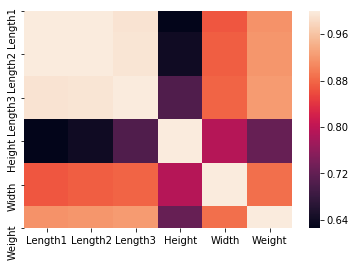

In [17]:
sns.heatmap(matrix)

In [38]:
data = pd.read_csv("1000_Companies.csv")

In [39]:
data.columns 

Index(['R&D Spend', 'Administration', 'Marketing Spend', 'State', 'Profit'], dtype='object')

In [40]:
data.head()

,R&D Spend,Administration,Marketing Spend,State,Profit
0,165349.20,136897.80,471784.10,New York,192261.83
1,162597.70,151377.59,443898.53,California,191792.06
2,153441.51,101145.55,407934.54,Florida,191050.39
3,144372.41,118671.85,383199.62,New York,182901.99
4,142107.34,91391.77,366168.42,Florida,166187.94


In [41]:
data.drop(labels=["State"], axis = 1, inplace= True)


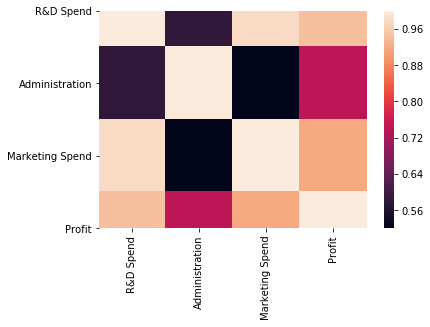

In [42]:
sns.heatmap(data.corr())

In [43]:
data.drop(labels=["Marketing Spend"], axis = 1, inplace= True)

In [44]:
data.head() 

,R&D Spend,Administration,Profit
0,165349.20,136897.80,192261.83
1,162597.70,151377.59,191792.06
2,153441.51,101145.55,191050.39
3,144372.41,118671.85,182901.99
4,142107.34,91391.77,166187.94


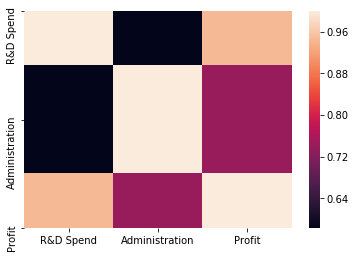

In [49]:
sns.heatmap(data.corr())

In [53]:
bu =  np.array([[-8.50300021e+02],
 [-7.52025307e+07],
 [-1.05445910e+08]])

In [55]:
bu.shape

(3, 1)

In [56]:
h2 = hipothesis(bu,X_train)

In [57]:
costo(h2, y_train)

1.9040402167722846e+26

In [68]:
data.head()

,R&D Spend,Administration,Profit
0,165349.20,136897.80,192261.83
1,162597.70,151377.59,191792.06
2,153441.51,101145.55,191050.39
3,144372.41,118671.85,182901.99
4,142107.34,91391.77,166187.94
